# Latency Model for the RADOS Simulator
The latency model `latModel` has two components: one for converting request size into latency and another one to add compaction delays drawn from a heavy-tailed distribution (e.g. `random.lognormvariate(mu, sigma)`). See `scripts/radossim.py` for more details.

In [8]:
# Basic parameters
runs = 11

# latModel parameters (Fit those to an actual BlueStore deployment!)

# Log fitting for IO sizes > 64KB
lgMult = 820.28
lgAdd = -1114.3

# Linear fitting for IO sizes <= 64KB
smMult = 62.36
smAdd = 8.33

# Lognormal fitting to "In each second, at least 10 x 60ms are spent
# with the drive being blocked [skourtis:inflow13, Fig 4]"
# A rough example approximation would be an average around 10ms (i.e. 100 reqs/sec)
# with a 90%-tile around 60ms (so 10 of the 100 req/sec are at least 60ms)
# with the 99%-tile not too much higher. It all depends on the minimum throughput
mu = 9.9
sigma = 0.64

# Test for larger parameters
test_list = []


In [9]:
# Parameters
lgMult = 820.28
lgAdd = -1114.3
smMult = 62.36
smAdd = 8.33
mu = 6.0
sigma = 2.0


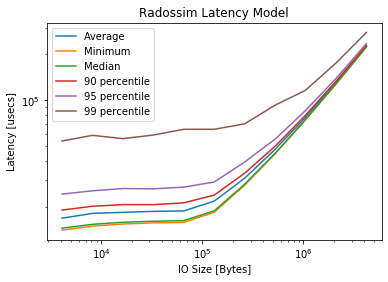

In [11]:
import matplotlib
import matplotlib.pyplot as plt

# Add path for modules in scripts/ so this notebook works
# without the context created by main.workflow
import sys
sys.path.append('../..')

import scripts.radossim as sim


x = []
y_min = []
y_avg = []
y_med = []
y_p90 = []
y_p95 = []
y_p99 = []
for i in range(runs):
    s = (2**i) * 4096
    x.append(s)
    msmts = []
    for j in range(10000):
        msmts.append(sim.latModel(s, lgMult, lgAdd, smMult, smAdd, mu, sigma))
    msmts.sort()
    avg = sum(msmts) / len(msmts)
    median = msmts[int(.5 * len(msmts))]
    pct90 = msmts[int(.90 * len(msmts))]
    pct95 = msmts[int(.95 * len(msmts))]
    pct99 = msmts[int(.99 * len(msmts))]
    y_min.append(msmts[0])
    y_avg.append(avg)
    y_med.append(median)
    y_p90.append(pct90)
    y_p95.append(pct95)
    y_p99.append(pct99)
    
fig, ax = plt.subplots()
ax.set_xscale('log')
ax.set_yscale('log')
ax.plot(x, y_avg, label='Average')
ax.plot(x, y_min, label='Minimum')
ax.plot(x, y_med, label='Median')
ax.plot(x, y_p90, label='90 percentile')
ax.plot(x, y_p95, label='95 percentile')
ax.plot(x, y_p99, label='99 percentile')
ax.set(xlabel='IO Size [Bytes]', ylabel='Latency [usecs]', title='Radossim Latency Model')

plt.legend()
plt.show()

MainProcess pypet.storageservice.HDF5StorageService INFO     I will use the hdf5 file `./HDF/ks-test.hdf5`.
MainProcess pypet.storageservice.HDF5StorageService INFO     You specified ``overwrite_file=True``, so I deleted the file `./HDF/ks-test.hdf5`.
MainProcess pypet.environment.Environment INFO     Environment initialized.
MainProcess pypet.environment.Environment INFO     I am preparing the Trajectory for the experiment and initialise the store.
MainProcess pypet.environment.Environment INFO     Initialising the storage for the trajectory.
MainProcess pypet.storageservice.HDF5StorageService INFO     Initialising storage or updating meta data of Trajectory `ks-test`.
MainProcess pypet.storageservice.HDF5StorageService INFO     Finished init or meta data update for `ks-test`.
MainProcess pypet.environment.Environment INFO     
************************************************************
STARTING runs of trajectory
`ks-test`.
***********************************************************

minimum predicted latency: 218.774613
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3907, pvalue=0.0)


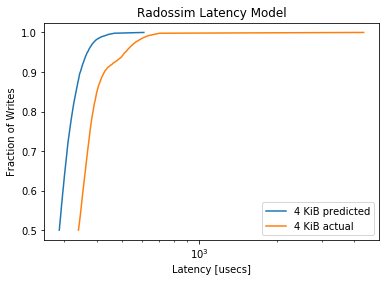

MainProcess pypet INFO     
 Finished single run #0 of 1680 

MainProcess pypet INFO     
 Starting single run #1 of 1680 



minimum predicted latency: 207.575624
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3318, pvalue=1e-323)


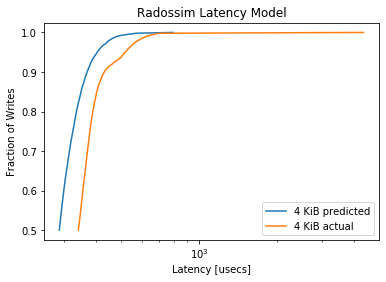

MainProcess pypet INFO     
 Finished single run #1 of 1680 

MainProcess pypet INFO     
 Starting single run #2 of 1680 



minimum predicted latency: 214.612139
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3196, pvalue=1e-323)


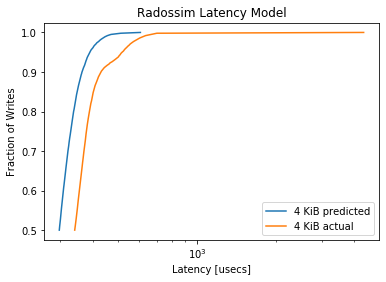

MainProcess pypet INFO     
 Finished single run #2 of 1680 

MainProcess pypet INFO     
 Starting single run #3 of 1680 



minimum predicted latency: 212.220700
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2772, pvalue=1e-323)


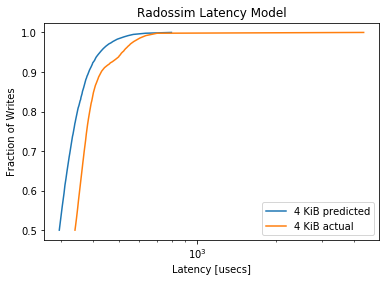

MainProcess pypet INFO     
 Finished single run #3 of 1680 

MainProcess pypet INFO     
 Starting single run #4 of 1680 



minimum predicted latency: 216.537082
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2469, pvalue=6.499305443751384e-268)


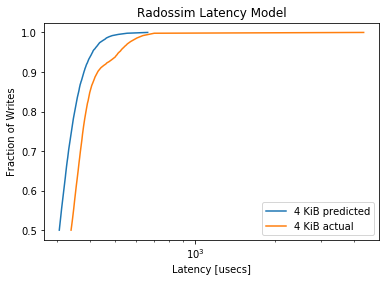

MainProcess pypet INFO     
 Finished single run #4 of 1680 

MainProcess pypet INFO     
 Starting single run #5 of 1680 



minimum predicted latency: 212.456623
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2071, pvalue=4.8410980268733504e-188)


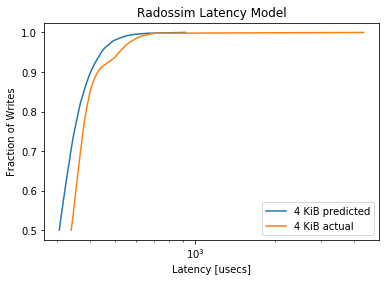

MainProcess pypet INFO     
 Finished single run #5 of 1680 

MainProcess pypet INFO     
 Starting single run #6 of 1680 



minimum predicted latency: 225.615601
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1715, pvalue=8.671265533150649e-129)


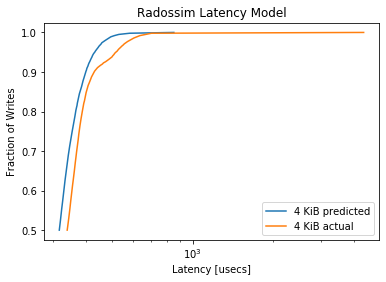

MainProcess pypet INFO     
 Finished single run #6 of 1680 

MainProcess pypet INFO     
 Starting single run #7 of 1680 



minimum predicted latency: 211.353700
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1349, pvalue=1.0729895687366785e-79)


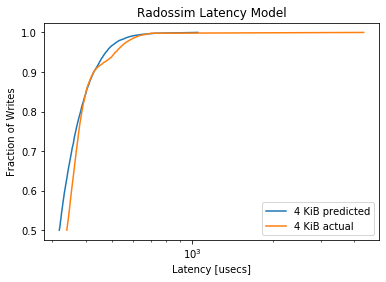

MainProcess pypet INFO     
 Finished single run #7 of 1680 

MainProcess pypet INFO     
 Starting single run #8 of 1680 



minimum predicted latency: 232.054993
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1141, pvalue=4.370973165867622e-57)


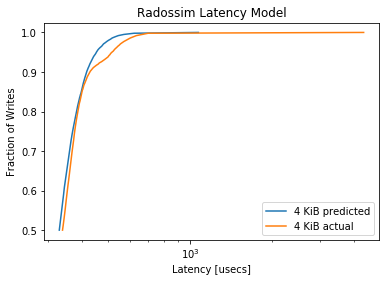

MainProcess pypet INFO     
 Finished single run #8 of 1680 

MainProcess pypet INFO     
 Starting single run #9 of 1680 



minimum predicted latency: 216.900343
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0613, pvalue=9.379316706833986e-17)


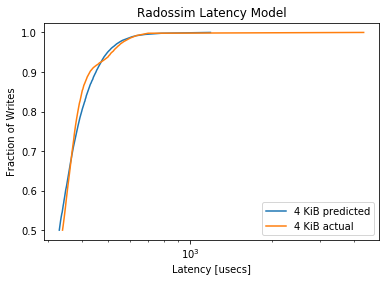

MainProcess pypet INFO     
 Finished single run #9 of 1680 

MainProcess pypet INFO     
 Starting single run #10 of 1680 



minimum predicted latency: 225.583902
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.167, pvalue=4.144003287490495e-122)


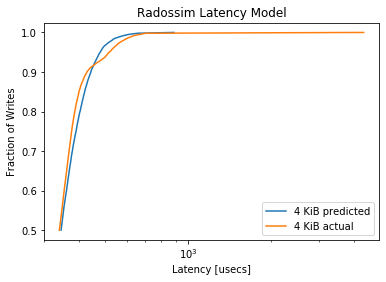

MainProcess pypet INFO     
 Finished single run #10 of 1680 

MainProcess pypet INFO     
 Starting single run #11 of 1680 



minimum predicted latency: 217.580338
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1165, pvalue=1.6842344649918124e-59)


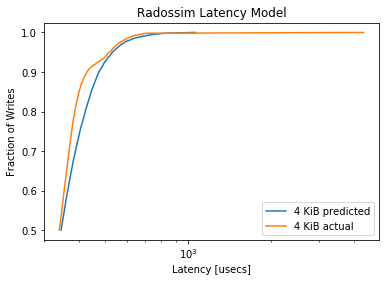

MainProcess pypet INFO     
 Finished single run #11 of 1680 

MainProcess pypet INFO     
 Starting single run #12 of 1680 



minimum predicted latency: 235.169067
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2322, pvalue=1.0099318242388413e-236)


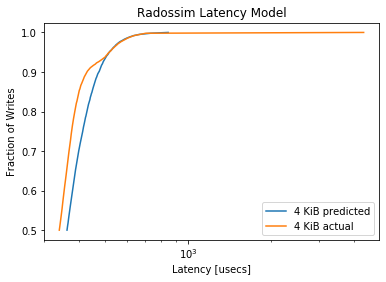

MainProcess pypet INFO     
 Finished single run #12 of 1680 

MainProcess pypet INFO     
 Starting single run #13 of 1680 



minimum predicted latency: 219.507462
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1731, pvalue=3.307899996088094e-131)


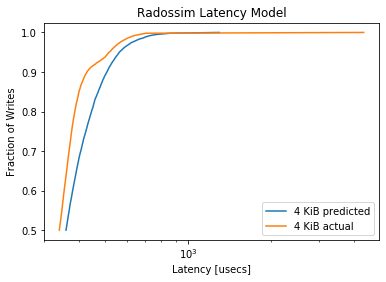

MainProcess pypet INFO     
 Finished single run #13 of 1680 

MainProcess pypet INFO     
 Starting single run #14 of 1680 



minimum predicted latency: 237.014993
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2739, pvalue=1e-323)


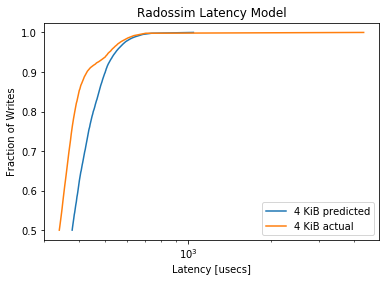

MainProcess pypet INFO     
 Finished single run #14 of 1680 

MainProcess pypet INFO     
 Starting single run #15 of 1680 



minimum predicted latency: 230.014156
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2651, pvalue=2.65407387105964e-309)


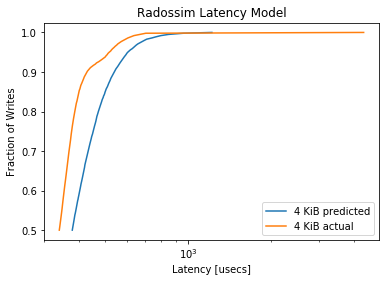

MainProcess pypet INFO     
 Finished single run #15 of 1680 

MainProcess pypet INFO     
 Starting single run #16 of 1680 



minimum predicted latency: 234.757902
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3559, pvalue=0.0)


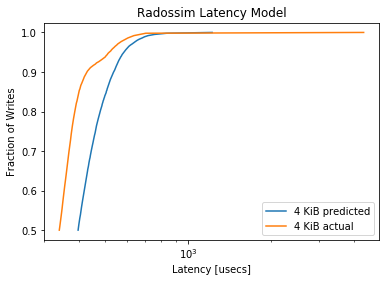

MainProcess pypet INFO     
 Finished single run #16 of 1680 

MainProcess pypet INFO     
 Starting single run #17 of 1680 



minimum predicted latency: 230.725119
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3458, pvalue=0.0)


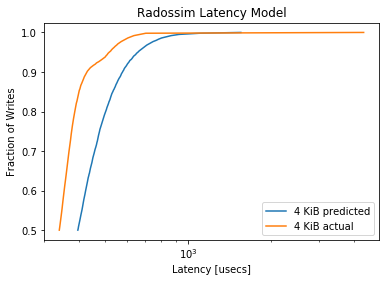

MainProcess pypet INFO     
 Finished single run #17 of 1680 

MainProcess pypet INFO     
 Starting single run #18 of 1680 



minimum predicted latency: 243.582661
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4535, pvalue=0.0)


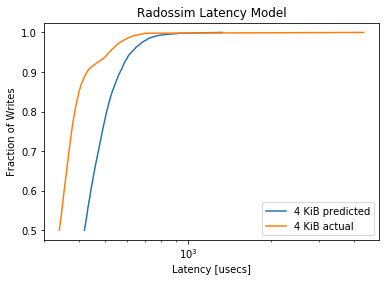

MainProcess pypet INFO     
 Finished single run #18 of 1680 

MainProcess pypet INFO     
 Starting single run #19 of 1680 



minimum predicted latency: 229.745501
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4075, pvalue=0.0)


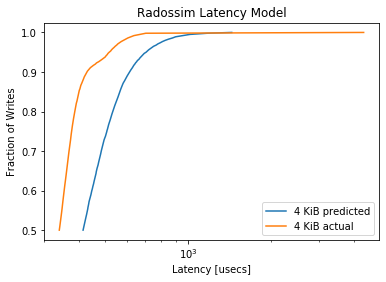

MainProcess pypet INFO     
 Finished single run #19 of 1680 

MainProcess pypet INFO     
 Starting single run #20 of 1680 



minimum predicted latency: 218.093312
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3812, pvalue=0.0)


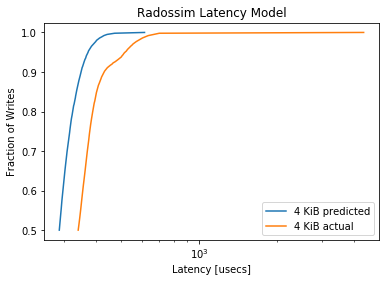

MainProcess pypet INFO     
 Finished single run #20 of 1680 

MainProcess pypet INFO     
 Starting single run #21 of 1680 



minimum predicted latency: 212.739249
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3375, pvalue=0.0)


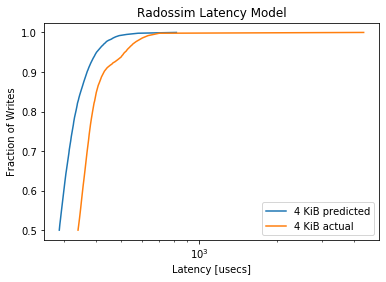

MainProcess pypet INFO     
 Finished single run #21 of 1680 

MainProcess pypet INFO     
 Starting single run #22 of 1680 



minimum predicted latency: 217.806434
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3291, pvalue=1e-323)


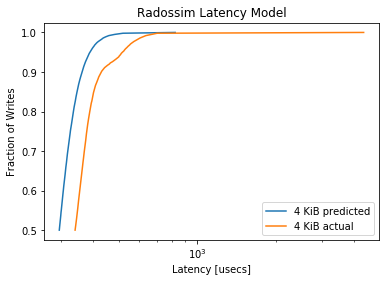

MainProcess pypet INFO     
 Finished single run #22 of 1680 

MainProcess pypet INFO     
 Starting single run #23 of 1680 



minimum predicted latency: 206.783451
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2781, pvalue=1e-323)


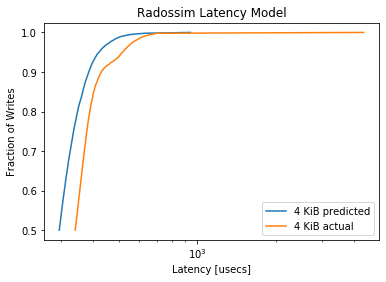

MainProcess pypet INFO     
 Finished single run #23 of 1680 

MainProcess pypet INFO     
 Starting single run #24 of 1680 



minimum predicted latency: 216.647133
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2483, pvalue=5.473368026943985e-271)


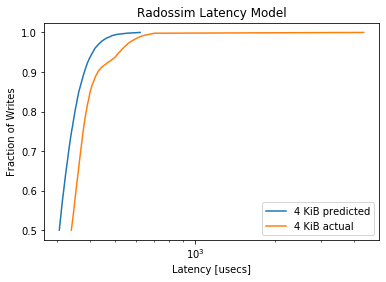

MainProcess pypet INFO     
 Finished single run #24 of 1680 

MainProcess pypet INFO     
 Starting single run #25 of 1680 



minimum predicted latency: 213.741603
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2081, pvalue=7.165583393576404e-190)


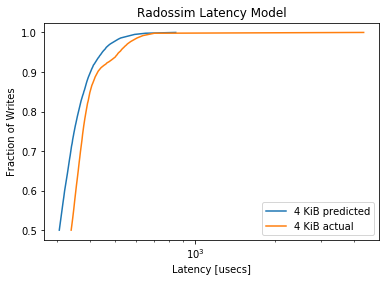

MainProcess pypet INFO     
 Finished single run #25 of 1680 

MainProcess pypet INFO     
 Starting single run #26 of 1680 



minimum predicted latency: 223.792205
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1708, pvalue=9.749559592872821e-128)


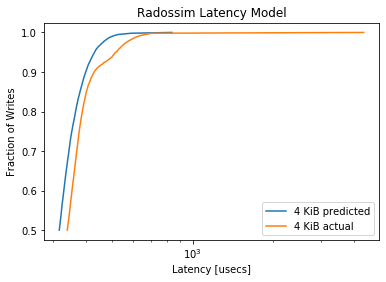

MainProcess pypet INFO     
 Finished single run #26 of 1680 

MainProcess pypet INFO     
 Starting single run #27 of 1680 



minimum predicted latency: 215.556497
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1289, pvalue=8.801674492710776e-73)


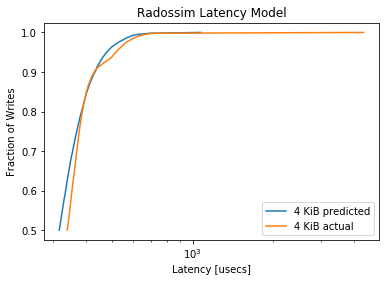

MainProcess pypet INFO     
 Finished single run #27 of 1680 

MainProcess pypet INFO     
 Starting single run #28 of 1680 



minimum predicted latency: 224.527168
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1161, pvalue=4.2883117996909605e-59)


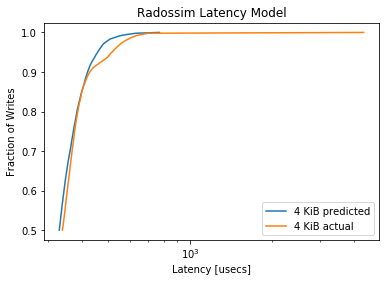

MainProcess pypet INFO     
 Finished single run #28 of 1680 

MainProcess pypet INFO     
 Starting single run #29 of 1680 



minimum predicted latency: 215.425709
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0562, pvalue=3.7805627315956485e-14)


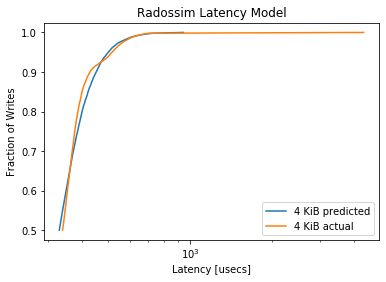

MainProcess pypet INFO     
 Finished single run #29 of 1680 

MainProcess pypet INFO     
 Starting single run #30 of 1680 



minimum predicted latency: 222.529451
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.165, pvalue=3.3722738655256357e-119)


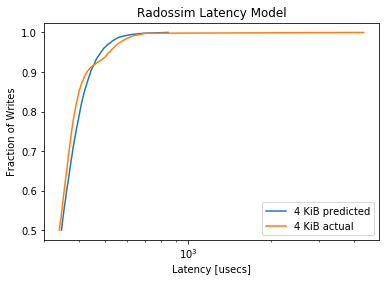

MainProcess pypet INFO     
 Finished single run #30 of 1680 

MainProcess pypet INFO     
 Starting single run #31 of 1680 



minimum predicted latency: 222.795878
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1254, pvalue=6.774018951624728e-69)


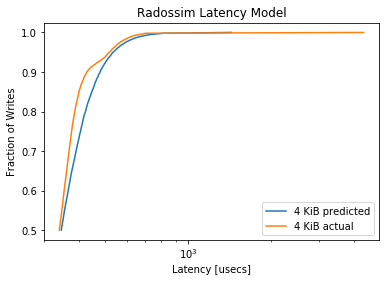

MainProcess pypet INFO     
 Finished single run #31 of 1680 

MainProcess pypet INFO     
 Starting single run #32 of 1680 



minimum predicted latency: 232.433100
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2265, pvalue=3.667530486756235e-225)


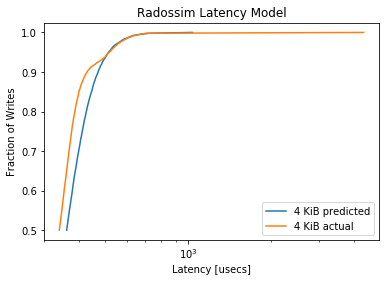

MainProcess pypet INFO     
 Finished single run #32 of 1680 

MainProcess pypet INFO     
 Starting single run #33 of 1680 



minimum predicted latency: 220.981003
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1916, pvalue=7.71134249851073e-161)


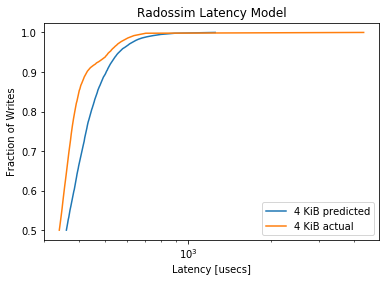

MainProcess pypet INFO     
 Finished single run #33 of 1680 

MainProcess pypet INFO     
 Starting single run #34 of 1680 



minimum predicted latency: 242.931539
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2656, pvalue=1.75115274154943e-310)


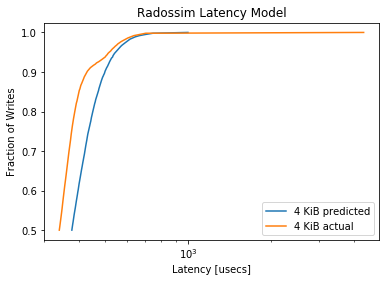

MainProcess pypet INFO     
 Finished single run #34 of 1680 

MainProcess pypet INFO     
 Starting single run #35 of 1680 



minimum predicted latency: 229.885227
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2613, pvalue=2.0898416868534058e-300)


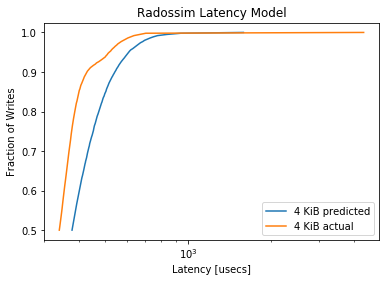

MainProcess pypet INFO     
 Finished single run #35 of 1680 

MainProcess pypet INFO     
 Starting single run #36 of 1680 



minimum predicted latency: 231.672993
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3598, pvalue=0.0)


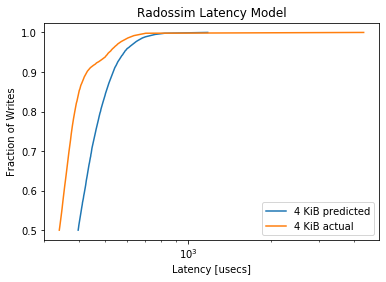

MainProcess pypet INFO     
 Finished single run #36 of 1680 

MainProcess pypet INFO     
 Starting single run #37 of 1680 



minimum predicted latency: 223.168033
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3435, pvalue=0.0)


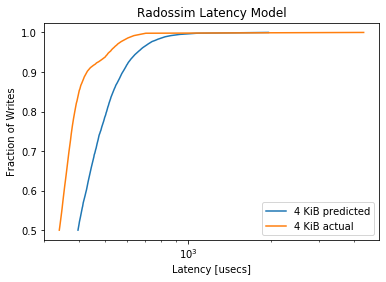

MainProcess pypet INFO     
 Finished single run #37 of 1680 

MainProcess pypet INFO     
 Starting single run #38 of 1680 



minimum predicted latency: 238.777720
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4496, pvalue=0.0)


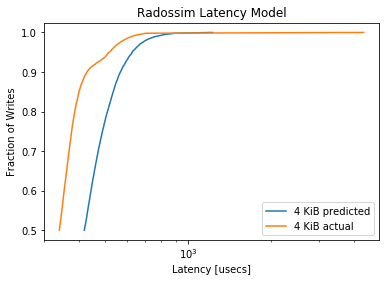

MainProcess pypet INFO     
 Finished single run #38 of 1680 

MainProcess pypet INFO     
 Starting single run #39 of 1680 



minimum predicted latency: 229.785693
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.434, pvalue=0.0)


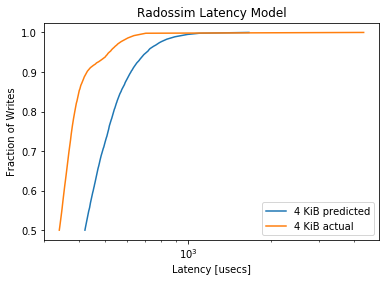

MainProcess pypet INFO     
 Finished single run #39 of 1680 

MainProcess pypet INFO     
 Starting single run #40 of 1680 



minimum predicted latency: 216.127827
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3921, pvalue=0.0)


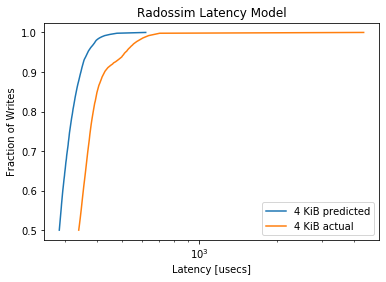

MainProcess pypet INFO     
 Finished single run #40 of 1680 

MainProcess pypet INFO     
 Starting single run #41 of 1680 



minimum predicted latency: 209.450758
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3369, pvalue=0.0)


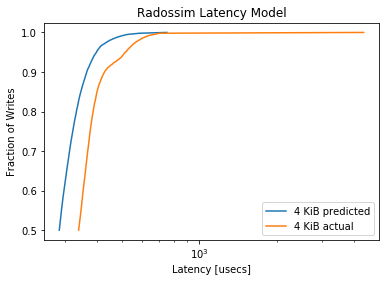

MainProcess pypet INFO     
 Finished single run #41 of 1680 

MainProcess pypet INFO     
 Starting single run #42 of 1680 



minimum predicted latency: 215.966081
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3244, pvalue=1e-323)


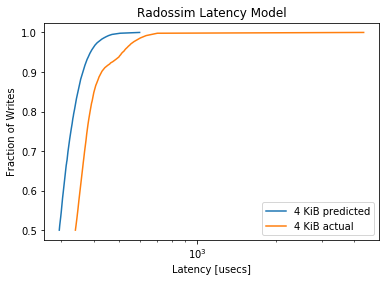

MainProcess pypet INFO     
 Finished single run #42 of 1680 

MainProcess pypet INFO     
 Starting single run #43 of 1680 



minimum predicted latency: 207.550968
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2731, pvalue=1e-323)


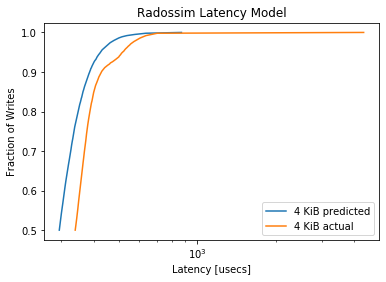

MainProcess pypet INFO     
 Finished single run #43 of 1680 

MainProcess pypet INFO     
 Starting single run #44 of 1680 



minimum predicted latency: 222.366769
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.252, pvalue=3.350634127771703e-279)


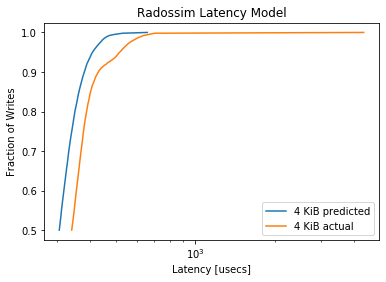

MainProcess pypet INFO     
 Finished single run #44 of 1680 

MainProcess pypet INFO     
 Starting single run #45 of 1680 



minimum predicted latency: 213.818745
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2107, pvalue=1.1364593665360968e-194)


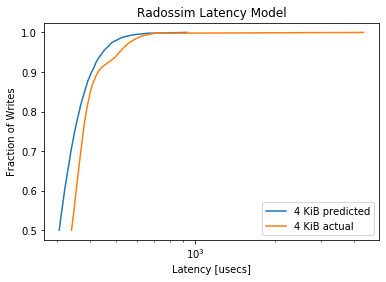

MainProcess pypet INFO     
 Finished single run #45 of 1680 

MainProcess pypet INFO     
 Starting single run #46 of 1680 



minimum predicted latency: 225.835163
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1678, pvalue=2.7746844590776557e-123)


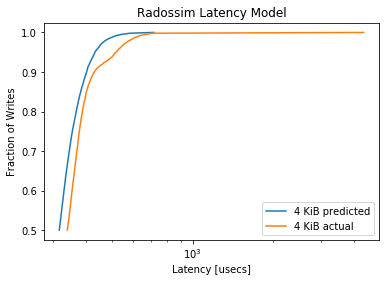

MainProcess pypet INFO     
 Finished single run #46 of 1680 

MainProcess pypet INFO     
 Starting single run #47 of 1680 



minimum predicted latency: 214.771158
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1451, pvalue=3.512880485455654e-92)


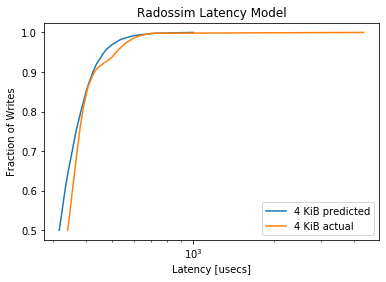

MainProcess pypet INFO     
 Finished single run #47 of 1680 

MainProcess pypet INFO     
 Starting single run #48 of 1680 



minimum predicted latency: 229.057802
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.102, pvalue=1.0980601173981406e-45)


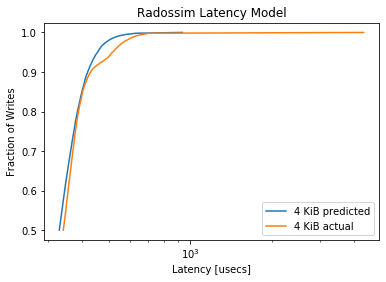

MainProcess pypet INFO     
 Finished single run #48 of 1680 

MainProcess pypet INFO     
 Starting single run #49 of 1680 



minimum predicted latency: 218.784242
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0587, pvalue=2.1317304083353323e-15)


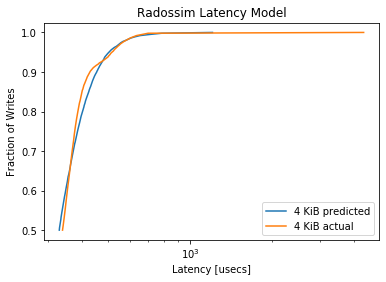

MainProcess pypet INFO     
 Finished single run #49 of 1680 

MainProcess pypet INFO     
 Starting single run #50 of 1680 



minimum predicted latency: 227.089655
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1715, pvalue=8.671265533150649e-129)


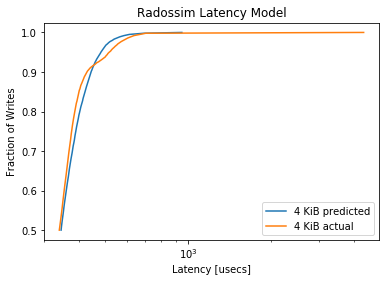

MainProcess pypet INFO     
 Finished single run #50 of 1680 

MainProcess pypet INFO     
 Starting single run #51 of 1680 



minimum predicted latency: 223.044576
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1101, pvalue=3.5610465160063985e-53)


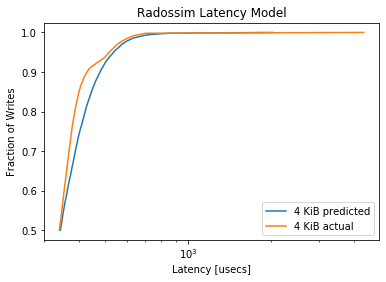

MainProcess pypet INFO     
 Finished single run #51 of 1680 

MainProcess pypet INFO     
 Starting single run #52 of 1680 



minimum predicted latency: 232.375318
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2243, pvalue=8.842136544726553e-221)


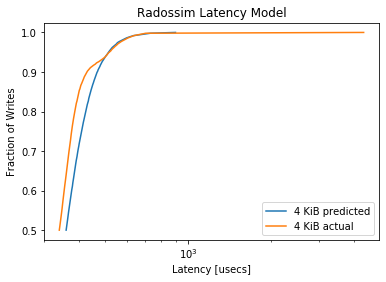

MainProcess pypet INFO     
 Finished single run #52 of 1680 

MainProcess pypet INFO     
 Starting single run #53 of 1680 



minimum predicted latency: 226.663918
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1766, pvalue=1.4095732379947654e-136)


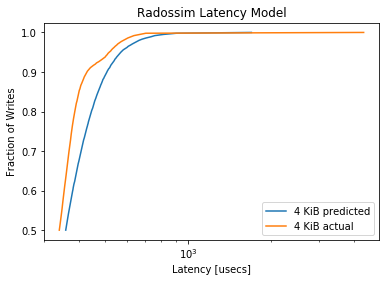

MainProcess pypet INFO     
 Finished single run #53 of 1680 

MainProcess pypet INFO     
 Starting single run #54 of 1680 



minimum predicted latency: 234.613532
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2653, pvalue=8.9527758283885e-310)


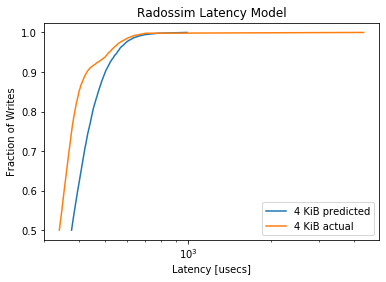

MainProcess pypet INFO     
 Finished single run #54 of 1680 

MainProcess pypet INFO     
 Starting single run #55 of 1680 



minimum predicted latency: 221.070688
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2443, pvalue=2.9838383186945055e-262)


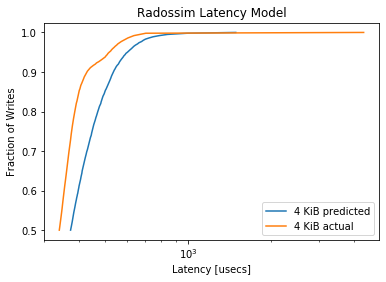

MainProcess pypet INFO     
 Finished single run #55 of 1680 

MainProcess pypet INFO     
 Starting single run #56 of 1680 



minimum predicted latency: 238.572459
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3553, pvalue=0.0)


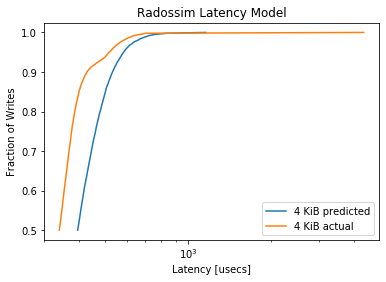

MainProcess pypet INFO     
 Finished single run #56 of 1680 

MainProcess pypet INFO     
 Starting single run #57 of 1680 



minimum predicted latency: 224.357374
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3482, pvalue=0.0)


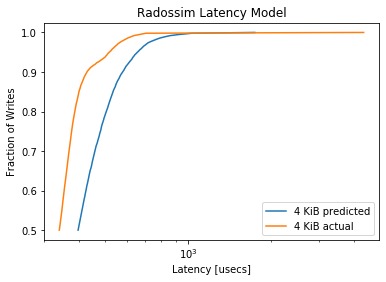

MainProcess pypet INFO     
 Finished single run #57 of 1680 

MainProcess pypet INFO     
 Starting single run #58 of 1680 



minimum predicted latency: 248.905092
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4489, pvalue=0.0)


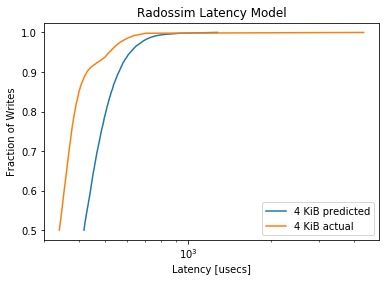

MainProcess pypet INFO     
 Finished single run #58 of 1680 

MainProcess pypet INFO     
 Starting single run #59 of 1680 



minimum predicted latency: 229.044172
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4218, pvalue=0.0)


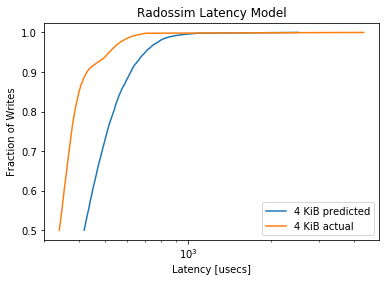

MainProcess pypet INFO     
 Finished single run #59 of 1680 

MainProcess pypet INFO     
 Starting single run #60 of 1680 



minimum predicted latency: 215.443796
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.392, pvalue=0.0)


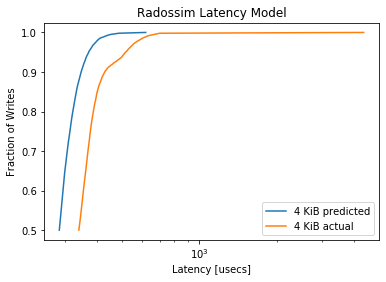

MainProcess pypet INFO     
 Finished single run #60 of 1680 

MainProcess pypet INFO     
 Starting single run #61 of 1680 



minimum predicted latency: 209.409623
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3439, pvalue=0.0)


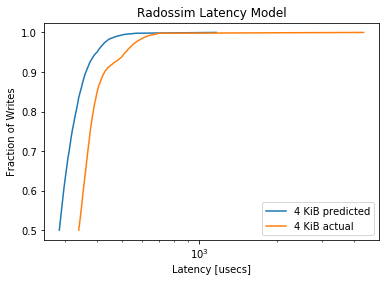

MainProcess pypet INFO     
 Finished single run #61 of 1680 

MainProcess pypet INFO     
 Starting single run #62 of 1680 



minimum predicted latency: 218.425909
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.33, pvalue=1e-323)


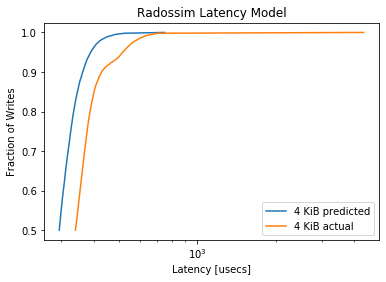

MainProcess pypet INFO     
 Finished single run #62 of 1680 

MainProcess pypet INFO     
 Starting single run #63 of 1680 



minimum predicted latency: 214.901571
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2776, pvalue=1e-323)


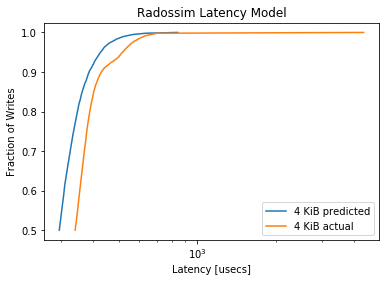

MainProcess pypet INFO     
 Finished single run #63 of 1680 

MainProcess pypet INFO     
 Starting single run #64 of 1680 



minimum predicted latency: 216.962241
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2527, pvalue=9.057684509553072e-281)


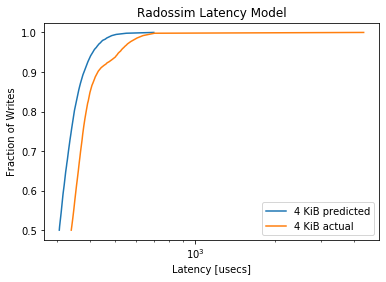

MainProcess pypet INFO     
 Finished single run #64 of 1680 

MainProcess pypet INFO     
 Starting single run #65 of 1680 



minimum predicted latency: 212.324710
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2085, pvalue=1.3207871875523273e-190)


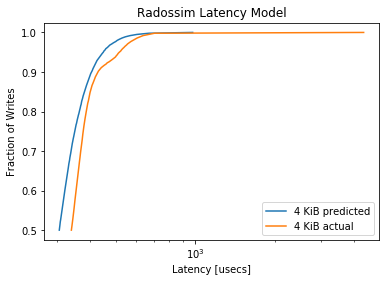

MainProcess pypet INFO     
 Finished single run #65 of 1680 

MainProcess pypet INFO     
 Starting single run #66 of 1680 



minimum predicted latency: 224.935093
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1647, pvalue=9.149920458362166e-119)


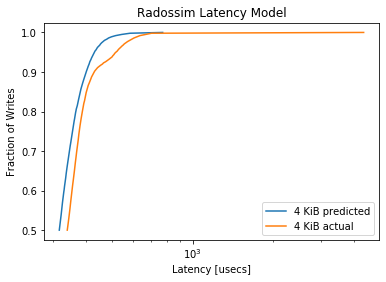

MainProcess pypet INFO     
 Finished single run #66 of 1680 

MainProcess pypet INFO     
 Starting single run #67 of 1680 



minimum predicted latency: 208.356095
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1271, pvalue=9.051721886200864e-71)


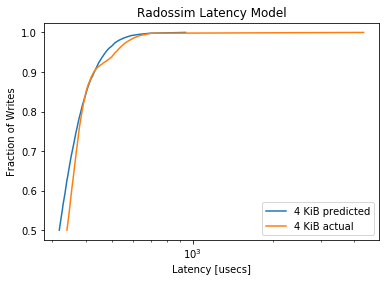

MainProcess pypet INFO     
 Finished single run #67 of 1680 

MainProcess pypet INFO     
 Starting single run #68 of 1680 



minimum predicted latency: 218.982603
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1023, pvalue=5.9364772884695e-46)


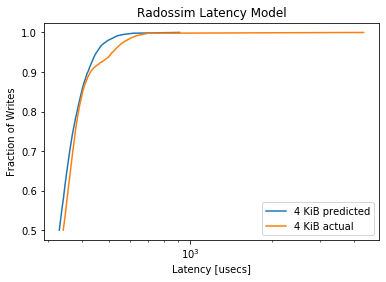

MainProcess pypet INFO     
 Finished single run #68 of 1680 

MainProcess pypet INFO     
 Starting single run #69 of 1680 



minimum predicted latency: 217.153739
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.06, pvalue=4.547968691838038e-16)


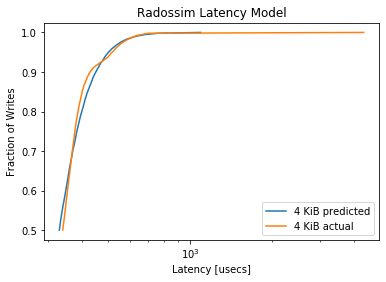

MainProcess pypet INFO     
 Finished single run #69 of 1680 

MainProcess pypet INFO     
 Starting single run #70 of 1680 



minimum predicted latency: 225.181232
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1698, pvalue=3.0385760576140476e-126)


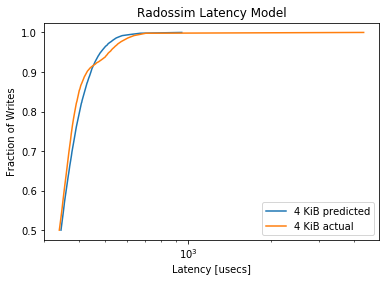

MainProcess pypet INFO     
 Finished single run #70 of 1680 

MainProcess pypet INFO     
 Starting single run #71 of 1680 



minimum predicted latency: 217.165400
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1164, pvalue=2.1281663424211843e-59)


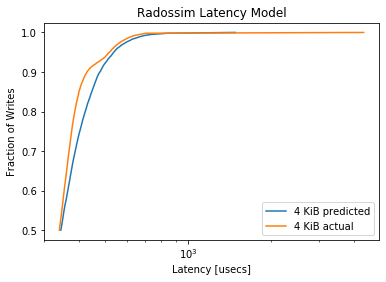

MainProcess pypet INFO     
 Finished single run #71 of 1680 

MainProcess pypet INFO     
 Starting single run #72 of 1680 



minimum predicted latency: 235.630375
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2284, pvalue=5.5475769856039835e-229)


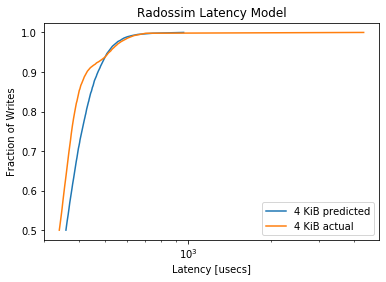

MainProcess pypet INFO     
 Finished single run #72 of 1680 

MainProcess pypet INFO     
 Starting single run #73 of 1680 



minimum predicted latency: 221.181764
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1745, pvalue=2.4240197906594528e-133)


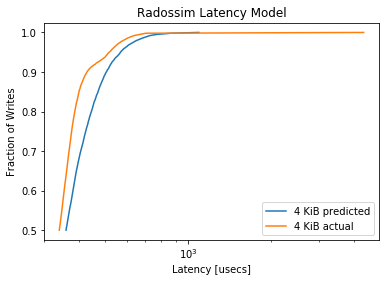

MainProcess pypet INFO     
 Finished single run #73 of 1680 

MainProcess pypet INFO     
 Starting single run #74 of 1680 



minimum predicted latency: 230.546376
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.264, pvalue=1.0303595557756915e-306)


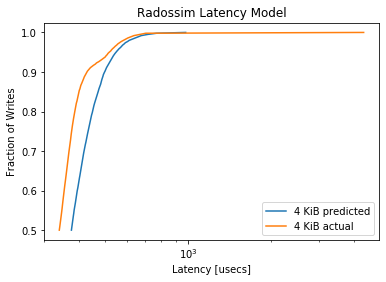

MainProcess pypet INFO     
 Finished single run #74 of 1680 

MainProcess pypet INFO     
 Starting single run #75 of 1680 



minimum predicted latency: 219.954610
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2671, pvalue=4.870096159e-314)


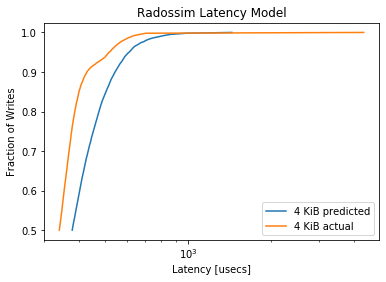

MainProcess pypet INFO     
 Finished single run #75 of 1680 

MainProcess pypet INFO     
 Starting single run #76 of 1680 



minimum predicted latency: 237.968642
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3533, pvalue=0.0)


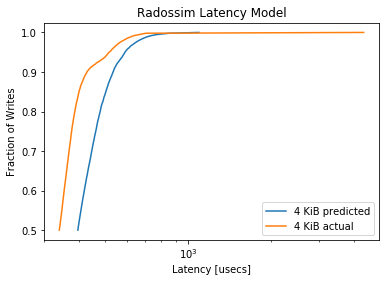

MainProcess pypet INFO     
 Finished single run #76 of 1680 

MainProcess pypet INFO     
 Starting single run #77 of 1680 



minimum predicted latency: 229.148953
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.336, pvalue=0.0)


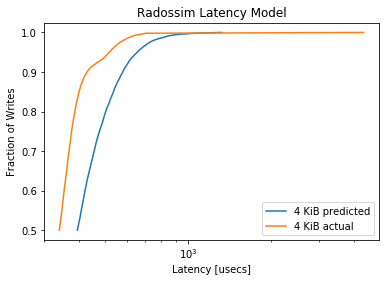

MainProcess pypet INFO     
 Finished single run #77 of 1680 

MainProcess pypet INFO     
 Starting single run #78 of 1680 



minimum predicted latency: 246.231975
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4441, pvalue=0.0)


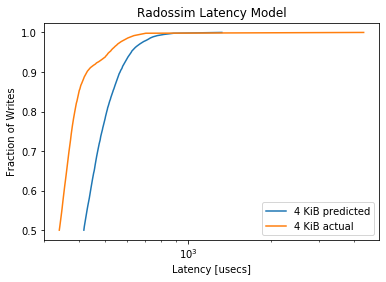

MainProcess pypet INFO     
 Finished single run #78 of 1680 

MainProcess pypet INFO     
 Starting single run #79 of 1680 



minimum predicted latency: 225.467087
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4148, pvalue=0.0)


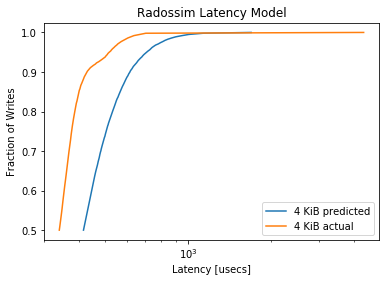

MainProcess pypet INFO     
 Finished single run #79 of 1680 

MainProcess pypet INFO     
 Starting single run #80 of 1680 



minimum predicted latency: 216.654302
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3989, pvalue=0.0)


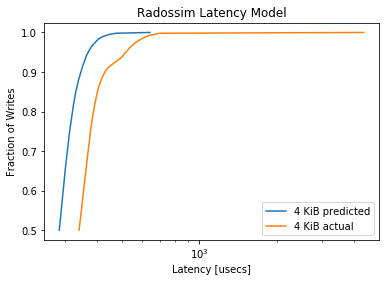

MainProcess pypet INFO     
 Finished single run #80 of 1680 

MainProcess pypet INFO     
 Starting single run #81 of 1680 



minimum predicted latency: 212.086340
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3368, pvalue=0.0)


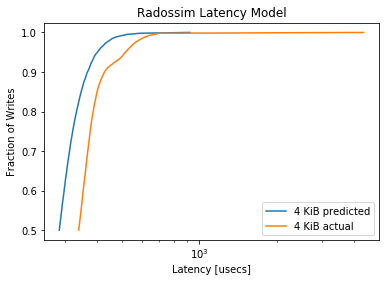

MainProcess pypet INFO     
 Finished single run #81 of 1680 

MainProcess pypet INFO     
 Starting single run #82 of 1680 



minimum predicted latency: 215.897110
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3229, pvalue=1e-323)


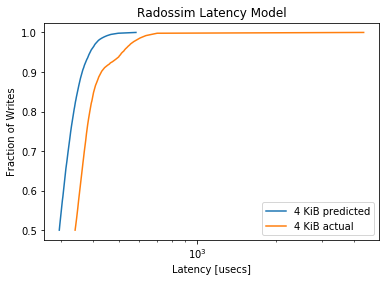

MainProcess pypet INFO     
 Finished single run #82 of 1680 

MainProcess pypet INFO     
 Starting single run #83 of 1680 



minimum predicted latency: 213.817749
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2784, pvalue=1e-323)


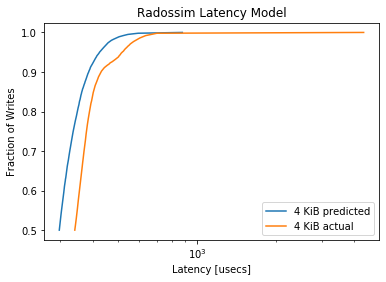

MainProcess pypet INFO     
 Finished single run #83 of 1680 

MainProcess pypet INFO     PROGRESS: Finished   84/1680 runs [=                   ]  5.0%, remaining: 0:08:36
MainProcess pypet INFO     
 Starting single run #84 of 1680 



minimum predicted latency: 223.703165
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2578, pvalue=2.4824942896785948e-292)


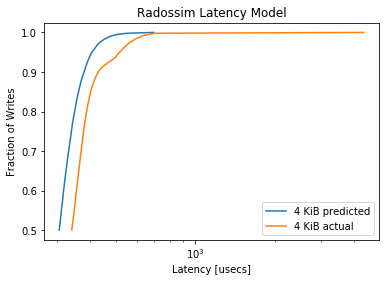

MainProcess pypet INFO     
 Finished single run #84 of 1680 

MainProcess pypet INFO     
 Starting single run #85 of 1680 



minimum predicted latency: 216.080960
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2082, pvalue=4.696594511979105e-190)


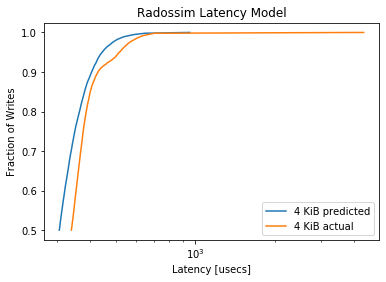

MainProcess pypet INFO     
 Finished single run #85 of 1680 

MainProcess pypet INFO     
 Starting single run #86 of 1680 



minimum predicted latency: 221.300564
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1693, pvalue=1.6832892164751832e-125)


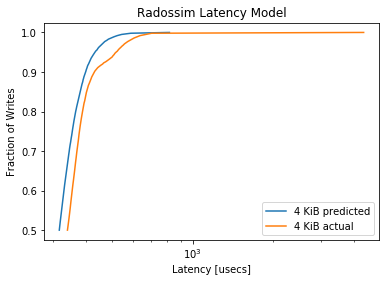

MainProcess pypet INFO     
 Finished single run #86 of 1680 

MainProcess pypet INFO     
 Starting single run #87 of 1680 



minimum predicted latency: 217.788588
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1247, pvalue=3.9366602985332064e-68)


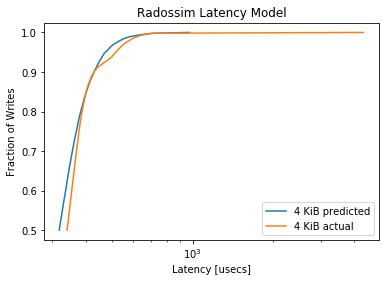

MainProcess pypet INFO     
 Finished single run #87 of 1680 

MainProcess pypet INFO     
 Starting single run #88 of 1680 



minimum predicted latency: 221.889684
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1092, pvalue=2.5832213271606204e-52)


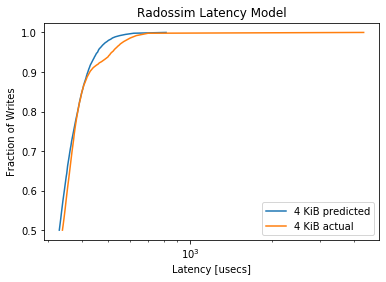

MainProcess pypet INFO     
 Finished single run #88 of 1680 

MainProcess pypet INFO     
 Starting single run #89 of 1680 



minimum predicted latency: 212.194972
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0685, pvalue=8.089130963316147e-21)


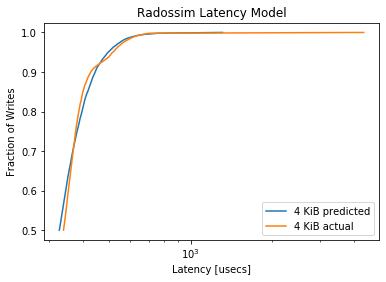

MainProcess pypet INFO     
 Finished single run #89 of 1680 

MainProcess pypet INFO     
 Starting single run #90 of 1680 



minimum predicted latency: 232.139130
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1631, pvalue=1.8189464709249053e-116)


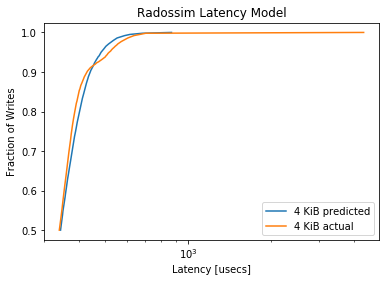

MainProcess pypet INFO     
 Finished single run #90 of 1680 

MainProcess pypet INFO     
 Starting single run #91 of 1680 



minimum predicted latency: 218.942225
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1246, pvalue=5.057758553530154e-68)


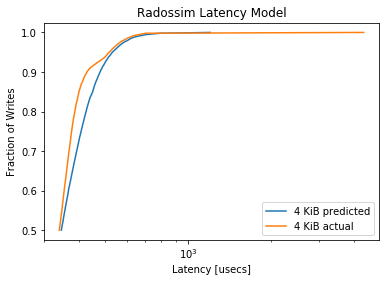

MainProcess pypet INFO     
 Finished single run #91 of 1680 

MainProcess pypet INFO     
 Starting single run #92 of 1680 



minimum predicted latency: 233.744594
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2181, pvalue=1.1437893276844604e-208)


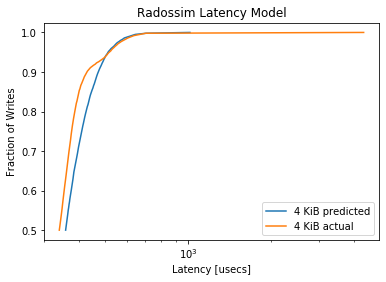

MainProcess pypet INFO     
 Finished single run #92 of 1680 

MainProcess pypet INFO     
 Starting single run #93 of 1680 



minimum predicted latency: 217.244024
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1768, pvalue=6.90062155765087e-137)


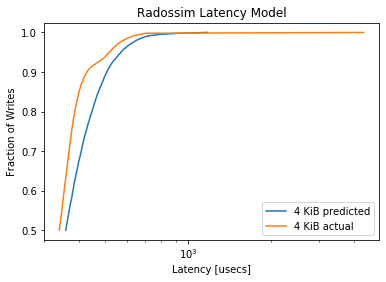

MainProcess pypet INFO     
 Finished single run #93 of 1680 

MainProcess pypet INFO     
 Starting single run #94 of 1680 



minimum predicted latency: 236.265601
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2616, pvalue=4.194493523049377e-301)


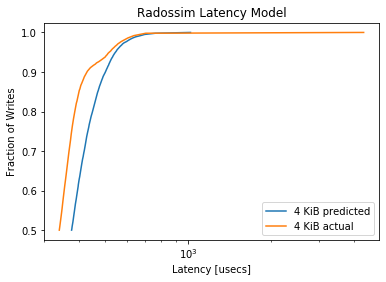

MainProcess pypet INFO     
 Finished single run #94 of 1680 

MainProcess pypet INFO     
 Starting single run #95 of 1680 



minimum predicted latency: 217.037690
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2662, pvalue=6.660908712163e-312)


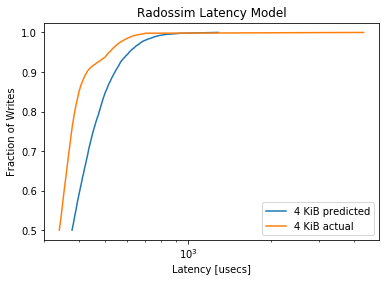

MainProcess pypet INFO     
 Finished single run #95 of 1680 

MainProcess pypet INFO     
 Starting single run #96 of 1680 



minimum predicted latency: 247.202591
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3512, pvalue=0.0)


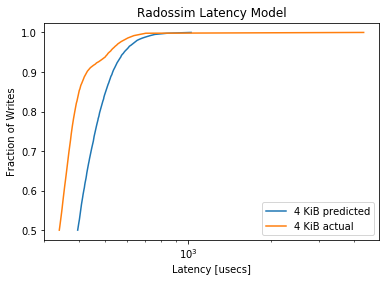

MainProcess pypet INFO     
 Finished single run #96 of 1680 

MainProcess pypet INFO     
 Starting single run #97 of 1680 



minimum predicted latency: 222.409006
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3323, pvalue=1e-323)


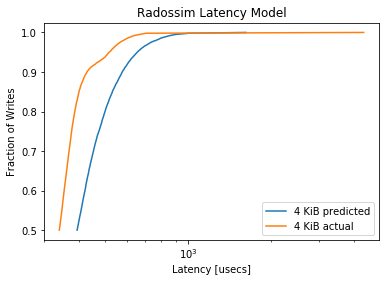

MainProcess pypet INFO     
 Finished single run #97 of 1680 

MainProcess pypet INFO     
 Starting single run #98 of 1680 



minimum predicted latency: 245.752284
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4478, pvalue=0.0)


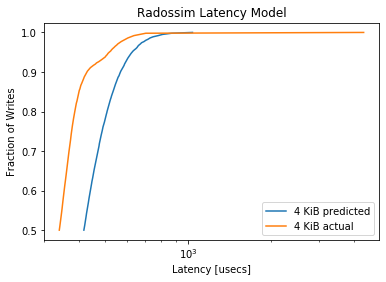

MainProcess pypet INFO     
 Finished single run #98 of 1680 

MainProcess pypet INFO     
 Starting single run #99 of 1680 



minimum predicted latency: 238.860481
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4161, pvalue=0.0)


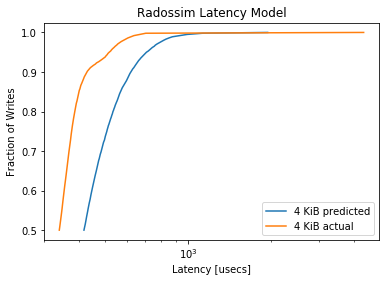

MainProcess pypet INFO     
 Finished single run #99 of 1680 

MainProcess pypet INFO     
 Starting single run #100 of 1680 



minimum predicted latency: 214.268668
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3893, pvalue=0.0)


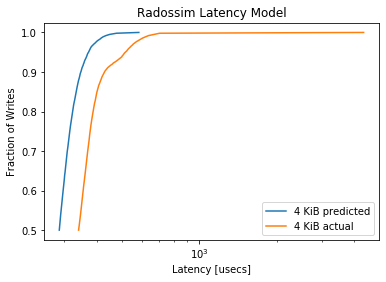

MainProcess pypet INFO     
 Finished single run #100 of 1680 

MainProcess pypet INFO     
 Starting single run #101 of 1680 



minimum predicted latency: 212.105825
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3369, pvalue=0.0)


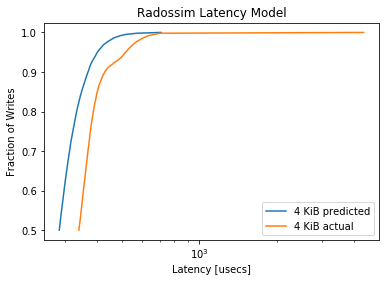

MainProcess pypet INFO     
 Finished single run #101 of 1680 

MainProcess pypet INFO     
 Starting single run #102 of 1680 



minimum predicted latency: 220.533261
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3323, pvalue=1e-323)


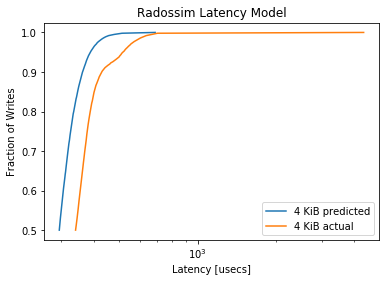

MainProcess pypet INFO     
 Finished single run #102 of 1680 

MainProcess pypet INFO     
 Starting single run #103 of 1680 



minimum predicted latency: 204.305553
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.287, pvalue=1e-323)


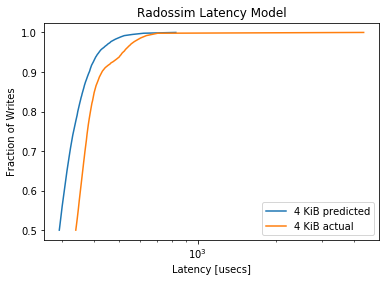

MainProcess pypet INFO     
 Finished single run #103 of 1680 

MainProcess pypet INFO     
 Starting single run #104 of 1680 



minimum predicted latency: 216.456009
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2647, pvalue=2.326497611566801e-308)


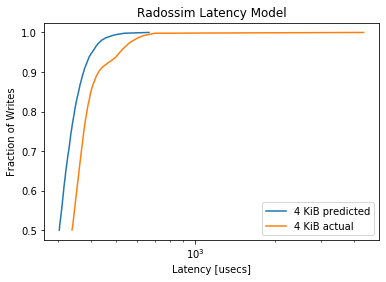

MainProcess pypet INFO     
 Finished single run #104 of 1680 

MainProcess pypet INFO     
 Starting single run #105 of 1680 



minimum predicted latency: 211.714316
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2219, pvalue=4.749405512054818e-216)


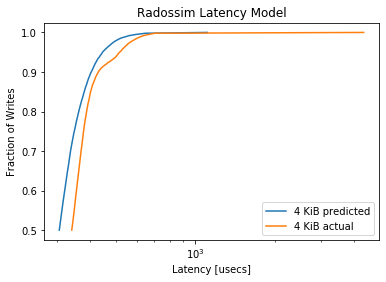

MainProcess pypet INFO     
 Finished single run #105 of 1680 

MainProcess pypet INFO     
 Starting single run #106 of 1680 



minimum predicted latency: 219.086482
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1784, pvalue=2.209937278195473e-139)


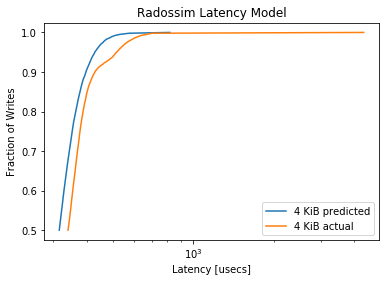

MainProcess pypet INFO     
 Finished single run #106 of 1680 

MainProcess pypet INFO     
 Starting single run #107 of 1680 



minimum predicted latency: 216.232223
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1423, pvalue=1.1606473712552198e-88)


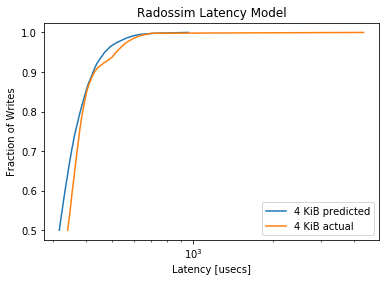

MainProcess pypet INFO     
 Finished single run #107 of 1680 

MainProcess pypet INFO     
 Starting single run #108 of 1680 



minimum predicted latency: 228.293771
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1018, pvalue=1.6529211940364096e-45)


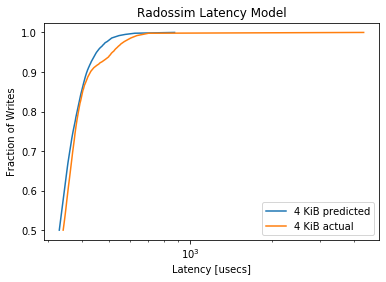

MainProcess pypet INFO     
 Finished single run #108 of 1680 

MainProcess pypet INFO     
 Starting single run #109 of 1680 



minimum predicted latency: 218.609767
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0674, pvalue=3.614915285051308e-20)


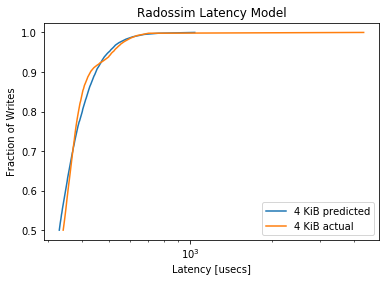

MainProcess pypet INFO     
 Finished single run #109 of 1680 

MainProcess pypet INFO     
 Starting single run #110 of 1680 



minimum predicted latency: 225.601516
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1596, pvalue=1.61419666550704e-111)


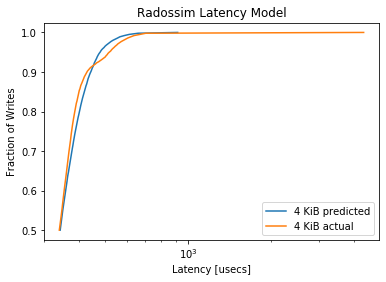

MainProcess pypet INFO     
 Finished single run #110 of 1680 

MainProcess pypet INFO     
 Starting single run #111 of 1680 



minimum predicted latency: 217.180005
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1072, pvalue=1.9910433863701831e-50)


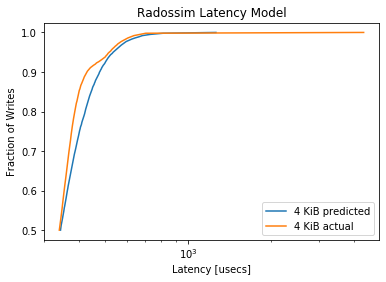

MainProcess pypet INFO     
 Finished single run #111 of 1680 

MainProcess pypet INFO     
 Starting single run #112 of 1680 



minimum predicted latency: 219.104924
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2129, pvalue=8.836587783886384e-199)


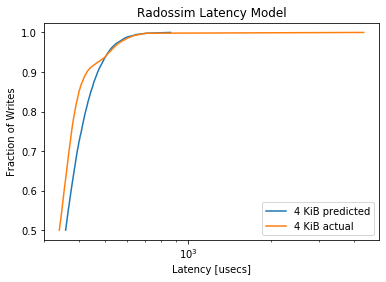

MainProcess pypet INFO     
 Finished single run #112 of 1680 

MainProcess pypet INFO     
 Starting single run #113 of 1680 



minimum predicted latency: 220.210655
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1727, pvalue=1.3376216259387205e-130)


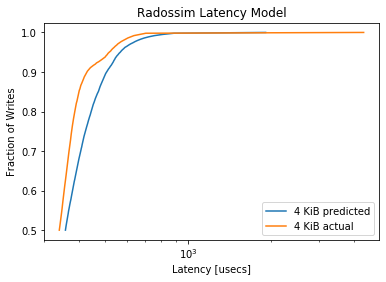

MainProcess pypet INFO     
 Finished single run #113 of 1680 

MainProcess pypet INFO     
 Starting single run #114 of 1680 



minimum predicted latency: 227.633680
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2594, pvalue=5.220566246964788e-296)


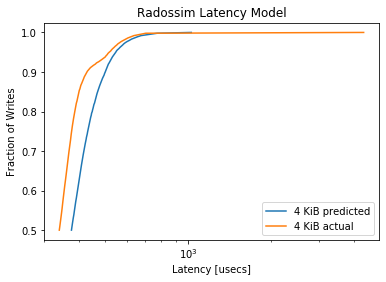

MainProcess pypet INFO     
 Finished single run #114 of 1680 

MainProcess pypet INFO     
 Starting single run #115 of 1680 



minimum predicted latency: 222.951347
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2566, pvalue=1.3713074128340343e-289)


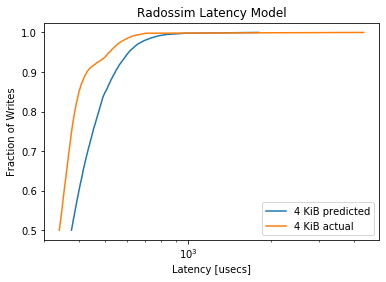

MainProcess pypet INFO     
 Finished single run #115 of 1680 

MainProcess pypet INFO     
 Starting single run #116 of 1680 



minimum predicted latency: 234.029219
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3457, pvalue=0.0)


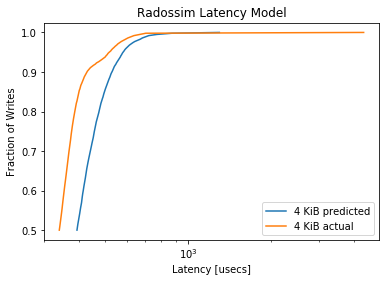

MainProcess pypet INFO     
 Finished single run #116 of 1680 

MainProcess pypet INFO     
 Starting single run #117 of 1680 



minimum predicted latency: 232.562107
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3326, pvalue=1e-323)


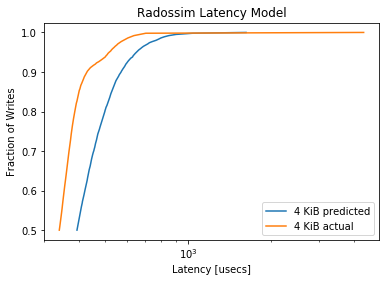

MainProcess pypet INFO     
 Finished single run #117 of 1680 

MainProcess pypet INFO     
 Starting single run #118 of 1680 



minimum predicted latency: 241.603192
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4359, pvalue=0.0)


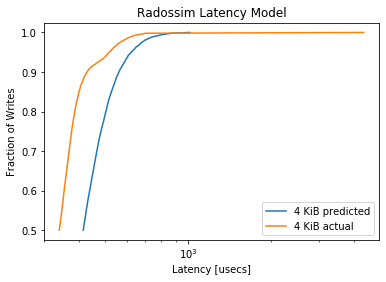

MainProcess pypet INFO     
 Finished single run #118 of 1680 

MainProcess pypet INFO     
 Starting single run #119 of 1680 



minimum predicted latency: 233.270492
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4192, pvalue=0.0)


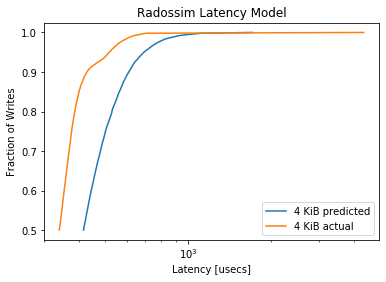

MainProcess pypet INFO     
 Finished single run #119 of 1680 

MainProcess pypet INFO     
 Starting single run #120 of 1680 



minimum predicted latency: 217.840807
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3992, pvalue=0.0)


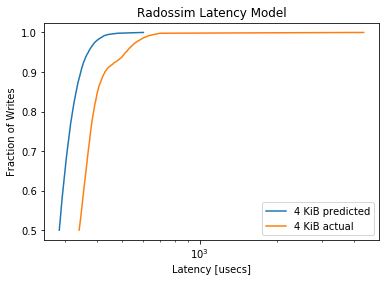

MainProcess pypet INFO     
 Finished single run #120 of 1680 

MainProcess pypet INFO     
 Starting single run #121 of 1680 



minimum predicted latency: 207.359209
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.352, pvalue=0.0)


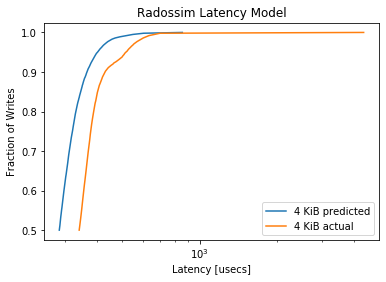

MainProcess pypet INFO     
 Finished single run #121 of 1680 

MainProcess pypet INFO     
 Starting single run #122 of 1680 



minimum predicted latency: 216.559183
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3347, pvalue=0.0)


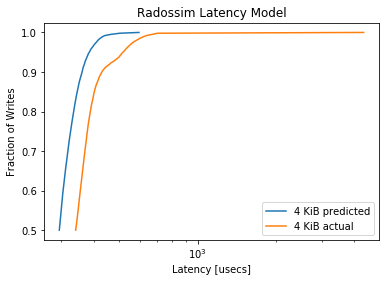

MainProcess pypet INFO     
 Finished single run #122 of 1680 

MainProcess pypet INFO     
 Starting single run #123 of 1680 



minimum predicted latency: 211.477664
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2867, pvalue=1e-323)


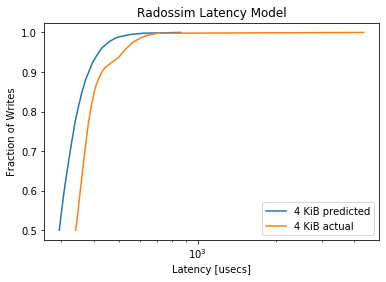

MainProcess pypet INFO     
 Finished single run #123 of 1680 

MainProcess pypet INFO     
 Starting single run #124 of 1680 



minimum predicted latency: 211.606780
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2622, pvalue=1.6799421971907378e-302)


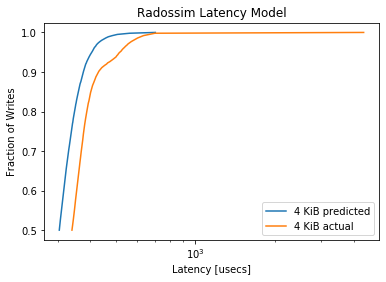

MainProcess pypet INFO     
 Finished single run #124 of 1680 

MainProcess pypet INFO     
 Starting single run #125 of 1680 



minimum predicted latency: 211.779787
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2141, pvalue=4.856330494468741e-201)


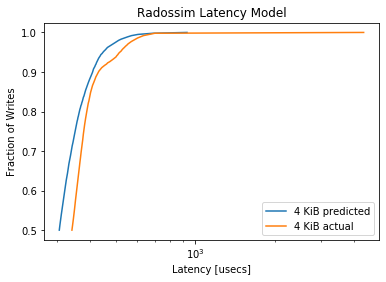

MainProcess pypet INFO     
 Finished single run #125 of 1680 

MainProcess pypet INFO     
 Starting single run #126 of 1680 



minimum predicted latency: 223.145008
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1791, pvalue=1.761212548053232e-140)


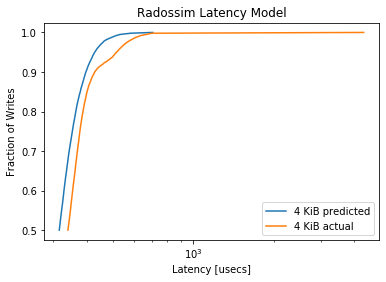

MainProcess pypet INFO     
 Finished single run #126 of 1680 

MainProcess pypet INFO     
 Starting single run #127 of 1680 



minimum predicted latency: 212.330825
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1428, pvalue=2.7631204949011182e-89)


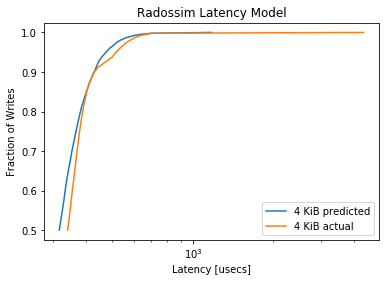

MainProcess pypet INFO     
 Finished single run #127 of 1680 

MainProcess pypet INFO     
 Starting single run #128 of 1680 



minimum predicted latency: 226.376736
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0968, pvalue=3.506281702057064e-41)


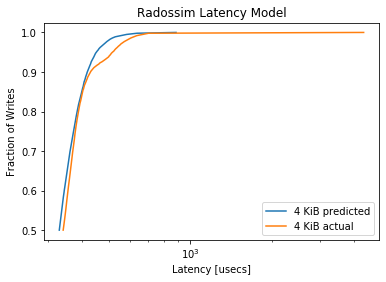

MainProcess pypet INFO     
 Finished single run #128 of 1680 

MainProcess pypet INFO     
 Starting single run #129 of 1680 



minimum predicted latency: 219.839928
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0692, pvalue=3.0806551184546733e-21)


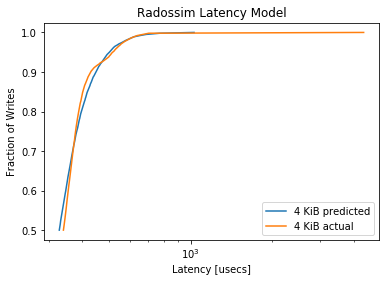

MainProcess pypet INFO     
 Finished single run #129 of 1680 

MainProcess pypet INFO     
 Starting single run #130 of 1680 



minimum predicted latency: 226.255782
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1576, pvalue=9.692513928369928e-109)


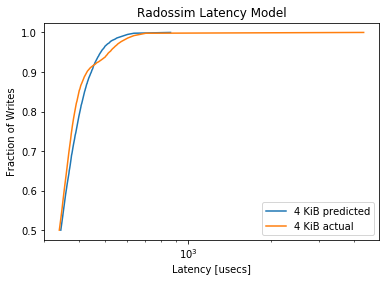

MainProcess pypet INFO     
 Finished single run #130 of 1680 

MainProcess pypet INFO     
 Starting single run #131 of 1680 



minimum predicted latency: 219.266652
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1082, pvalue=2.290948558382432e-51)


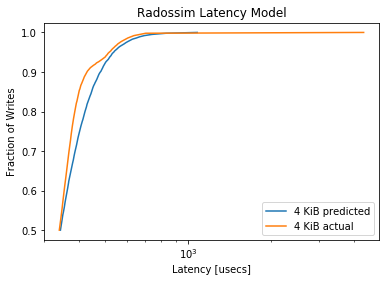

MainProcess pypet INFO     
 Finished single run #131 of 1680 

MainProcess pypet INFO     
 Starting single run #132 of 1680 



minimum predicted latency: 237.837543
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2148, pvalue=2.3011019840360224e-202)


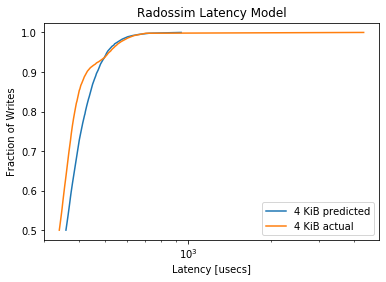

MainProcess pypet INFO     
 Finished single run #132 of 1680 

MainProcess pypet INFO     
 Starting single run #133 of 1680 



minimum predicted latency: 222.227686
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1801, pvalue=4.664457138438061e-142)


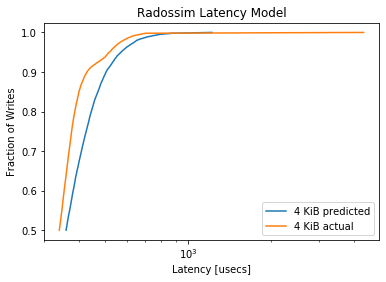

MainProcess pypet INFO     
 Finished single run #133 of 1680 

MainProcess pypet INFO     
 Starting single run #134 of 1680 



minimum predicted latency: 227.248027
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2622, pvalue=1.6799421971907378e-302)


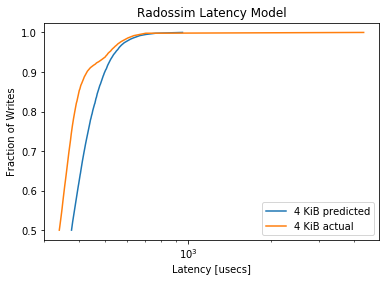

MainProcess pypet INFO     
 Finished single run #134 of 1680 

MainProcess pypet INFO     
 Starting single run #135 of 1680 



minimum predicted latency: 224.134669
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2564, pvalue=3.916282554464941e-289)


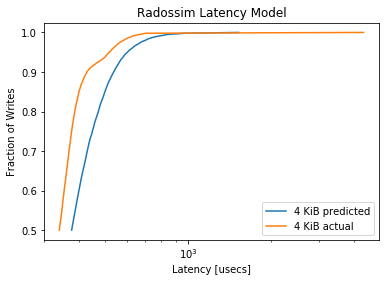

MainProcess pypet INFO     
 Finished single run #135 of 1680 

MainProcess pypet INFO     
 Starting single run #136 of 1680 



minimum predicted latency: 239.711658
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.349, pvalue=0.0)


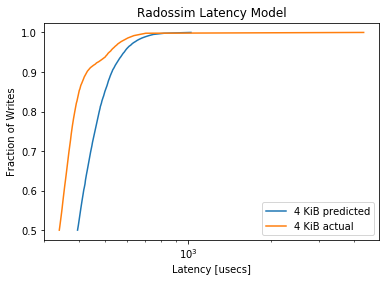

MainProcess pypet INFO     
 Finished single run #136 of 1680 

MainProcess pypet INFO     
 Starting single run #137 of 1680 



minimum predicted latency: 230.767541
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3369, pvalue=0.0)


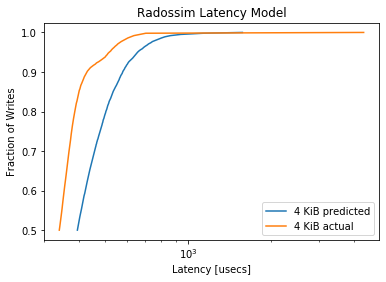

MainProcess pypet INFO     
 Finished single run #137 of 1680 

MainProcess pypet INFO     
 Starting single run #138 of 1680 



minimum predicted latency: 244.982273
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4405, pvalue=0.0)


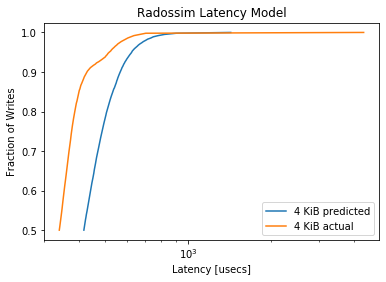

MainProcess pypet INFO     
 Finished single run #138 of 1680 

MainProcess pypet INFO     
 Starting single run #139 of 1680 



minimum predicted latency: 235.486259
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4157, pvalue=0.0)


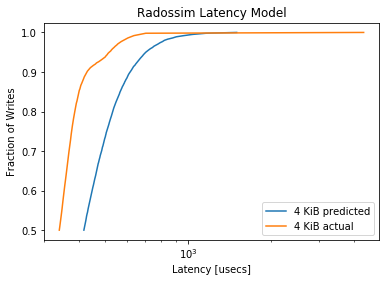

MainProcess pypet INFO     
 Finished single run #139 of 1680 

MainProcess pypet INFO     
 Starting single run #140 of 1680 



minimum predicted latency: 211.966427
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.401, pvalue=0.0)


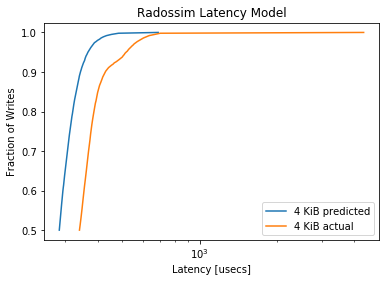

MainProcess pypet INFO     
 Finished single run #140 of 1680 

MainProcess pypet INFO     
 Starting single run #141 of 1680 



minimum predicted latency: 206.913034
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3479, pvalue=0.0)


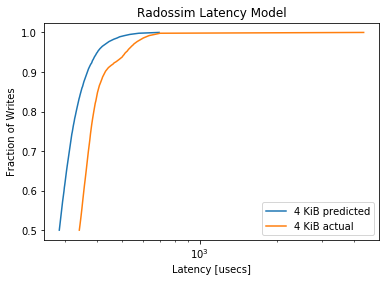

MainProcess pypet INFO     
 Finished single run #141 of 1680 

MainProcess pypet INFO     
 Starting single run #142 of 1680 



minimum predicted latency: 218.255101
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3407, pvalue=0.0)


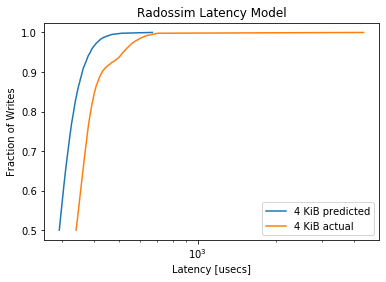

MainProcess pypet INFO     
 Finished single run #142 of 1680 

MainProcess pypet INFO     
 Starting single run #143 of 1680 



minimum predicted latency: 209.759829
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2872, pvalue=1e-323)


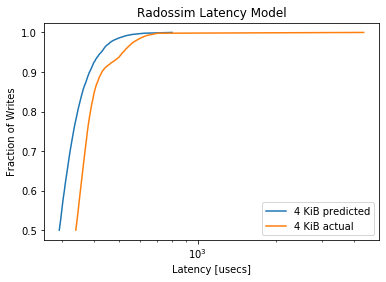

MainProcess pypet INFO     
 Finished single run #143 of 1680 

MainProcess pypet INFO     
 Starting single run #144 of 1680 



minimum predicted latency: 220.166388
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2621, pvalue=2.873591328491868e-302)


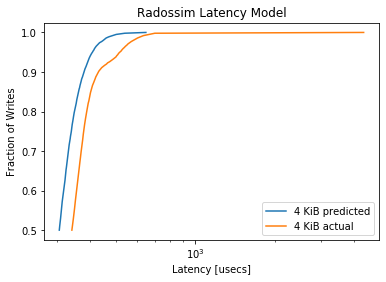

MainProcess pypet INFO     
 Finished single run #144 of 1680 

MainProcess pypet INFO     
 Starting single run #145 of 1680 



minimum predicted latency: 208.547848
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2239, pvalue=5.4772280776151526e-220)


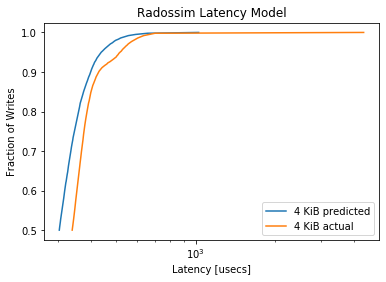

MainProcess pypet INFO     
 Finished single run #145 of 1680 

MainProcess pypet INFO     
 Starting single run #146 of 1680 



minimum predicted latency: 220.970827
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1762, pvalue=5.866927737003814e-136)


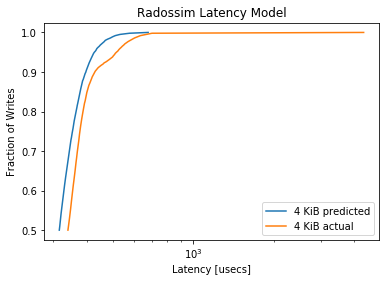

MainProcess pypet INFO     
 Finished single run #146 of 1680 

MainProcess pypet INFO     
 Starting single run #147 of 1680 



minimum predicted latency: 210.810043
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1499, pvalue=2.244743032268575e-98)


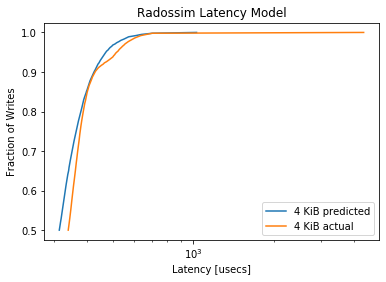

MainProcess pypet INFO     
 Finished single run #147 of 1680 

MainProcess pypet INFO     
 Starting single run #148 of 1680 



minimum predicted latency: 222.860852
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0911, pvalue=1.6210915397608417e-36)


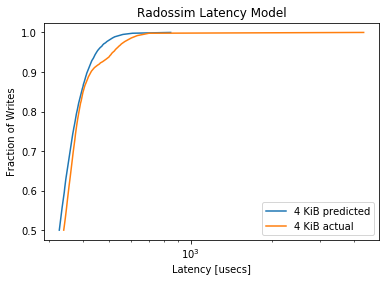

MainProcess pypet INFO     
 Finished single run #148 of 1680 

MainProcess pypet INFO     
 Starting single run #149 of 1680 



minimum predicted latency: 213.179644
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0708, pvalue=3.267973187618262e-22)


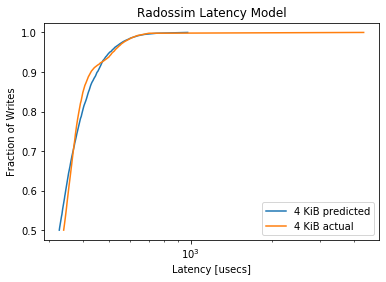

MainProcess pypet INFO     
 Finished single run #149 of 1680 

MainProcess pypet INFO     
 Starting single run #150 of 1680 



minimum predicted latency: 230.867159
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1558, pvalue=2.861587216469746e-106)


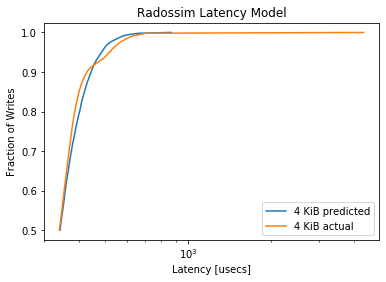

MainProcess pypet INFO     
 Finished single run #150 of 1680 

MainProcess pypet INFO     
 Starting single run #151 of 1680 



minimum predicted latency: 219.367915
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.108, pvalue=3.536156032214428e-51)


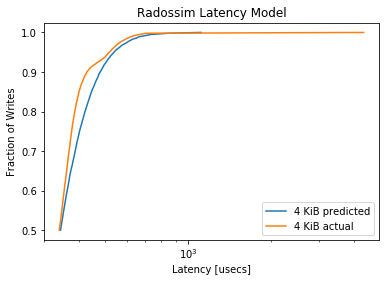

MainProcess pypet INFO     
 Finished single run #151 of 1680 

MainProcess pypet INFO     
 Starting single run #152 of 1680 



minimum predicted latency: 222.736872
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2078, pvalue=2.5416299627118363e-189)


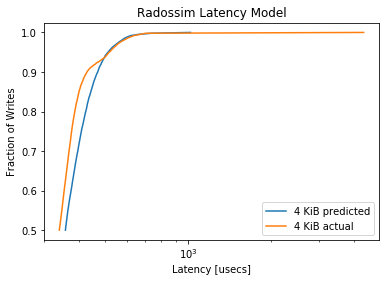

MainProcess pypet INFO     
 Finished single run #152 of 1680 

MainProcess pypet INFO     
 Starting single run #153 of 1680 



minimum predicted latency: 219.501787
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1734, pvalue=1.15751482022406e-131)


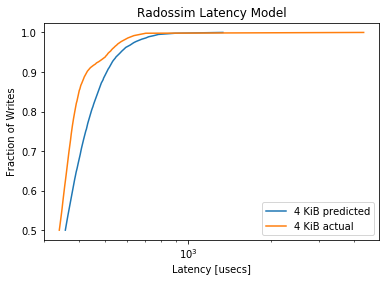

MainProcess pypet INFO     
 Finished single run #153 of 1680 

MainProcess pypet INFO     
 Starting single run #154 of 1680 



minimum predicted latency: 234.524275
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2572, pvalue=5.857140714902907e-291)


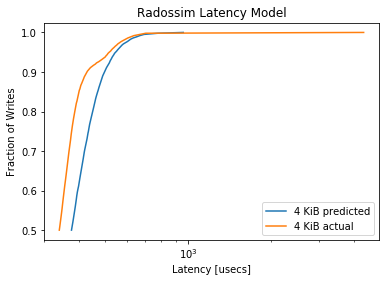

MainProcess pypet INFO     
 Finished single run #154 of 1680 

MainProcess pypet INFO     
 Starting single run #155 of 1680 



minimum predicted latency: 223.221585
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2523, pvalue=7.138985568015044e-280)


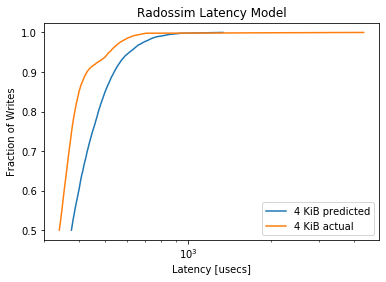

MainProcess pypet INFO     
 Finished single run #155 of 1680 

MainProcess pypet INFO     
 Starting single run #156 of 1680 



minimum predicted latency: 242.311158
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3422, pvalue=0.0)


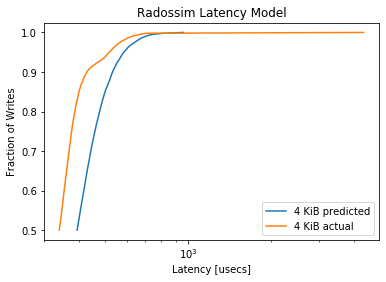

MainProcess pypet INFO     
 Finished single run #156 of 1680 

MainProcess pypet INFO     
 Starting single run #157 of 1680 



minimum predicted latency: 226.764902
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3288, pvalue=1e-323)


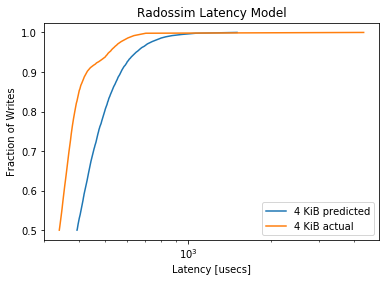

MainProcess pypet INFO     
 Finished single run #157 of 1680 

MainProcess pypet INFO     
 Starting single run #158 of 1680 



minimum predicted latency: 237.936193
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4279, pvalue=0.0)


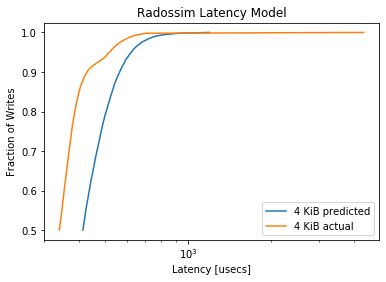

MainProcess pypet INFO     
 Finished single run #158 of 1680 

MainProcess pypet INFO     
 Starting single run #159 of 1680 



minimum predicted latency: 231.426443
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4041, pvalue=0.0)


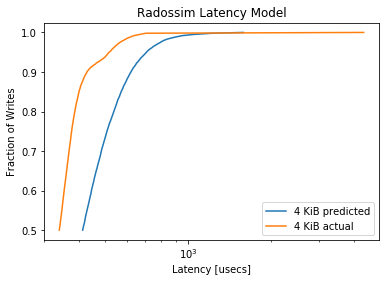

MainProcess pypet INFO     
 Finished single run #159 of 1680 

MainProcess pypet INFO     
 Starting single run #160 of 1680 



minimum predicted latency: 207.734329
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3978, pvalue=0.0)


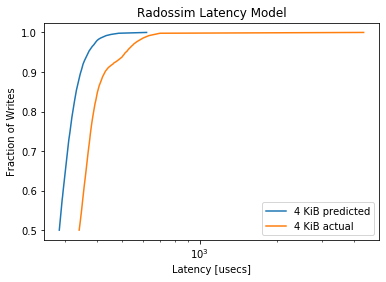

MainProcess pypet INFO     
 Finished single run #160 of 1680 

MainProcess pypet INFO     
 Starting single run #161 of 1680 



minimum predicted latency: 208.021837
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.352, pvalue=0.0)


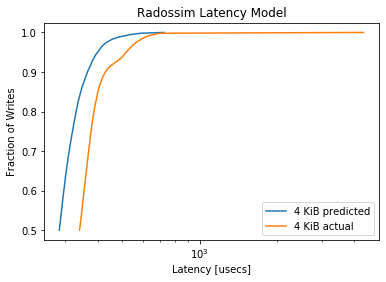

MainProcess pypet INFO     
 Finished single run #161 of 1680 

MainProcess pypet INFO     
 Starting single run #162 of 1680 



minimum predicted latency: 214.242155
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3419, pvalue=0.0)


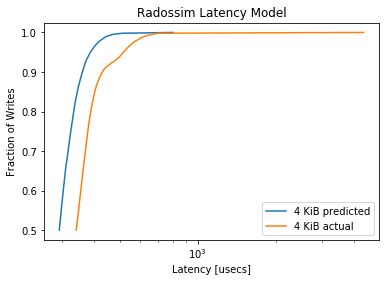

MainProcess pypet INFO     
 Finished single run #162 of 1680 

MainProcess pypet INFO     
 Starting single run #163 of 1680 



minimum predicted latency: 207.734856
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2854, pvalue=1e-323)


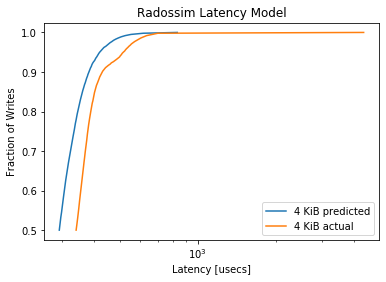

MainProcess pypet INFO     
 Finished single run #163 of 1680 

MainProcess pypet INFO     
 Starting single run #164 of 1680 



minimum predicted latency: 222.849701
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2637, pvalue=5.213621641085791e-306)


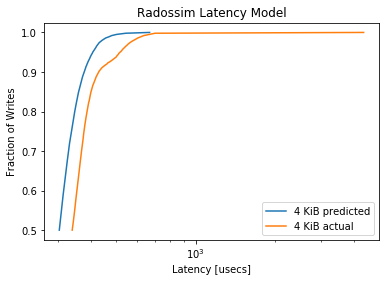

MainProcess pypet INFO     
 Finished single run #164 of 1680 

MainProcess pypet INFO     
 Starting single run #165 of 1680 



minimum predicted latency: 208.901522
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2214, pvalue=4.523223071175197e-215)


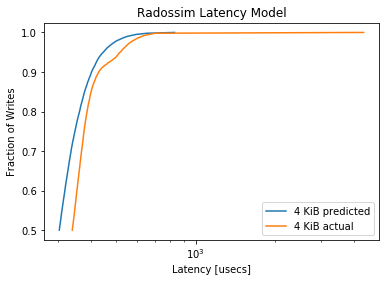

MainProcess pypet INFO     
 Finished single run #165 of 1680 

MainProcess pypet INFO     
 Starting single run #166 of 1680 



minimum predicted latency: 222.304858
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1799, pvalue=9.658757447044667e-142)


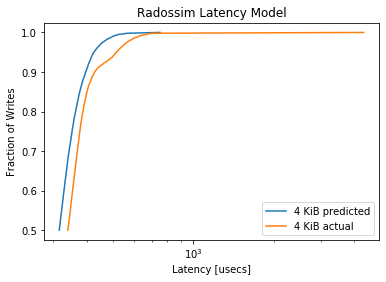

MainProcess pypet INFO     
 Finished single run #166 of 1680 

MainProcess pypet INFO     
 Starting single run #167 of 1680 



minimum predicted latency: 211.775788
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.145, pvalue=4.7047946712225374e-92)


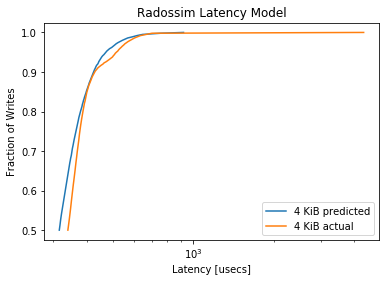

MainProcess pypet INFO     
 Finished single run #167 of 1680 

MainProcess pypet INFO     PROGRESS: Finished  168/1680 runs [==                  ] 10.0%, remaining: 0:09:11
MainProcess pypet INFO     
 Starting single run #168 of 1680 



minimum predicted latency: 214.435552
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.091, pvalue=1.945844861422502e-36)


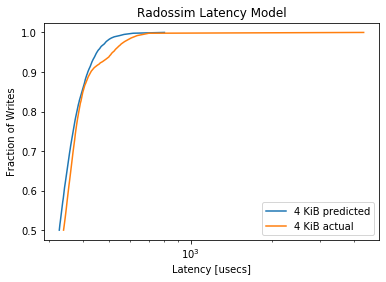

MainProcess pypet INFO     
 Finished single run #168 of 1680 

MainProcess pypet INFO     
 Starting single run #169 of 1680 



minimum predicted latency: 213.482052
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0793, pvalue=9.186260963571572e-28)


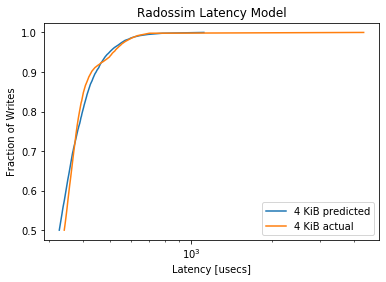

MainProcess pypet INFO     
 Finished single run #169 of 1680 

MainProcess pypet INFO     
 Starting single run #170 of 1680 



minimum predicted latency: 226.848078
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1583, pvalue=1.0423705891595202e-109)


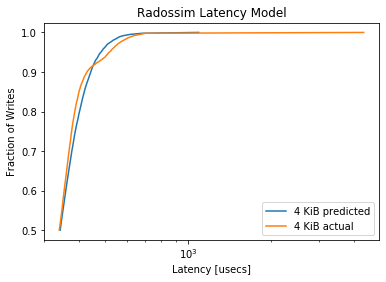

MainProcess pypet INFO     
 Finished single run #170 of 1680 

MainProcess pypet INFO     
 Starting single run #171 of 1680 



minimum predicted latency: 216.361016
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1082, pvalue=2.290948558382432e-51)


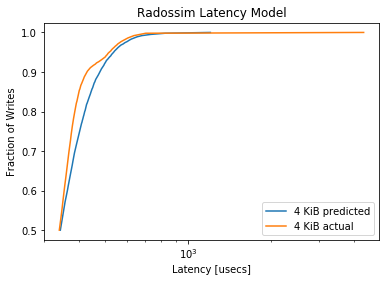

MainProcess pypet INFO     
 Finished single run #171 of 1680 

MainProcess pypet INFO     
 Starting single run #172 of 1680 



minimum predicted latency: 233.865836
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2076, pvalue=5.9051684456633185e-189)


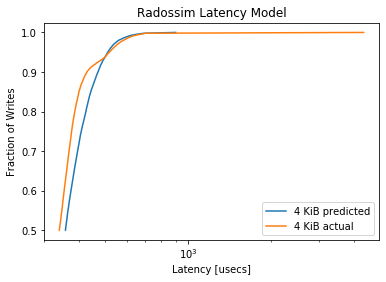

MainProcess pypet INFO     
 Finished single run #172 of 1680 

MainProcess pypet INFO     
 Starting single run #173 of 1680 



minimum predicted latency: 220.197300
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.183, pvalue=1.1083974705889038e-146)


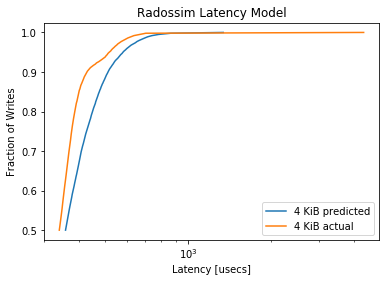

MainProcess pypet INFO     
 Finished single run #173 of 1680 

MainProcess pypet INFO     
 Starting single run #174 of 1680 



minimum predicted latency: 240.883046
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2576, pvalue=7.126224266500231e-292)


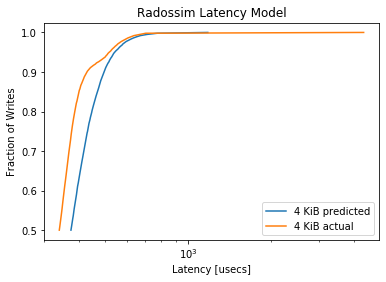

MainProcess pypet INFO     
 Finished single run #174 of 1680 

MainProcess pypet INFO     
 Starting single run #175 of 1680 



minimum predicted latency: 226.253586
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.247, pvalue=3.925121836158113e-268)


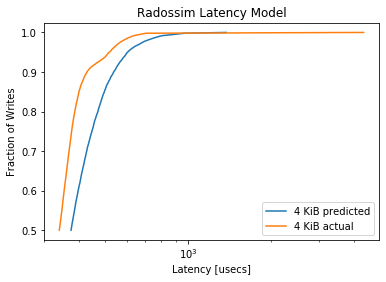

MainProcess pypet INFO     
 Finished single run #175 of 1680 

MainProcess pypet INFO     
 Starting single run #176 of 1680 



minimum predicted latency: 235.139133
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3345, pvalue=0.0)


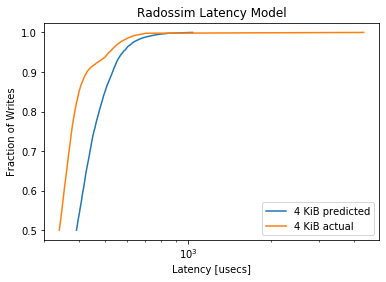

MainProcess pypet INFO     
 Finished single run #176 of 1680 

MainProcess pypet INFO     
 Starting single run #177 of 1680 



minimum predicted latency: 224.233855
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3331, pvalue=1e-323)


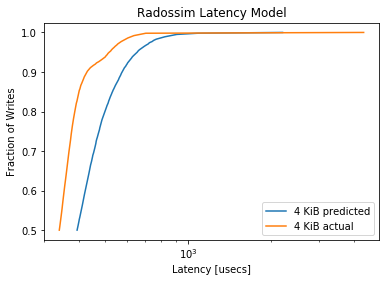

MainProcess pypet INFO     
 Finished single run #177 of 1680 

MainProcess pypet INFO     
 Starting single run #178 of 1680 



minimum predicted latency: 233.285416
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4379, pvalue=0.0)


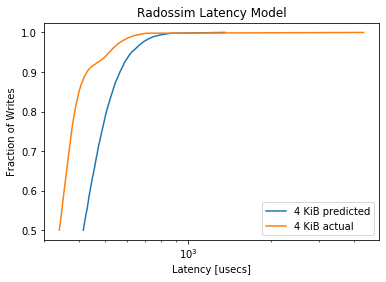

MainProcess pypet INFO     
 Finished single run #178 of 1680 

MainProcess pypet INFO     
 Starting single run #179 of 1680 



minimum predicted latency: 222.593459
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4186, pvalue=0.0)


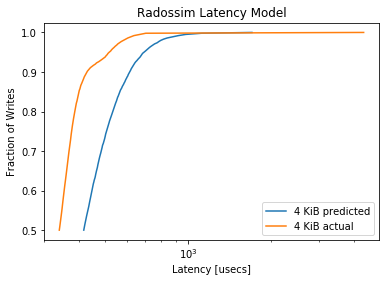

MainProcess pypet INFO     
 Finished single run #179 of 1680 

MainProcess pypet INFO     
 Starting single run #180 of 1680 



minimum predicted latency: 213.584779
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3982, pvalue=0.0)


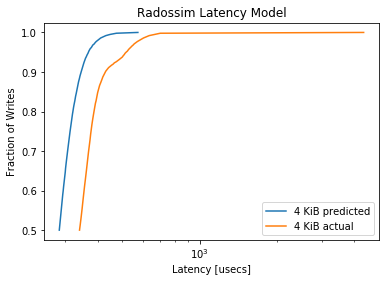

MainProcess pypet INFO     
 Finished single run #180 of 1680 

MainProcess pypet INFO     
 Starting single run #181 of 1680 



minimum predicted latency: 208.047155
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3487, pvalue=0.0)


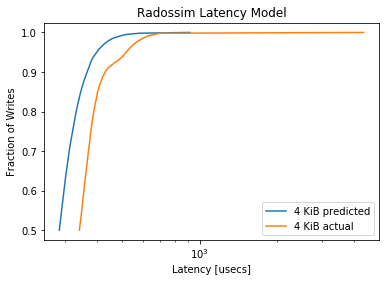

MainProcess pypet INFO     
 Finished single run #181 of 1680 

MainProcess pypet INFO     
 Starting single run #182 of 1680 



minimum predicted latency: 211.850524
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3409, pvalue=0.0)


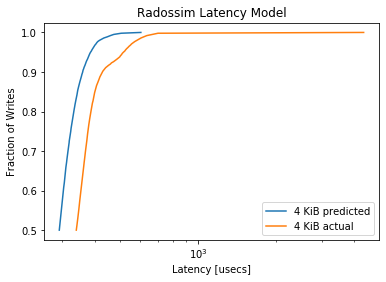

MainProcess pypet INFO     
 Finished single run #182 of 1680 

MainProcess pypet INFO     
 Starting single run #183 of 1680 



minimum predicted latency: 208.633572
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2843, pvalue=1e-323)


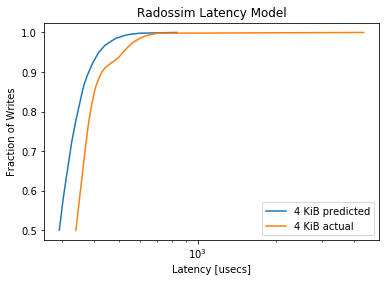

MainProcess pypet INFO     
 Finished single run #183 of 1680 

MainProcess pypet INFO     
 Starting single run #184 of 1680 



minimum predicted latency: 219.132373
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.264, pvalue=1.0303595557756915e-306)


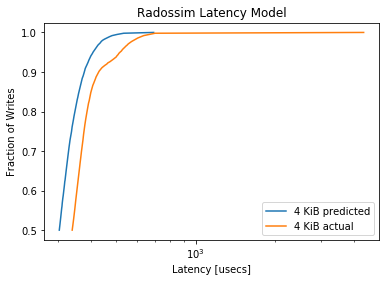

MainProcess pypet INFO     
 Finished single run #184 of 1680 

MainProcess pypet INFO     
 Starting single run #185 of 1680 



minimum predicted latency: 210.727860
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2214, pvalue=4.523223071175197e-215)


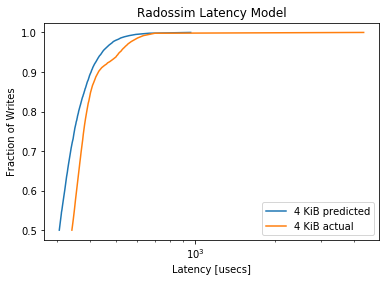

MainProcess pypet INFO     
 Finished single run #185 of 1680 

MainProcess pypet INFO     
 Starting single run #186 of 1680 



minimum predicted latency: 214.047455
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1781, pvalue=6.514021286355296e-139)


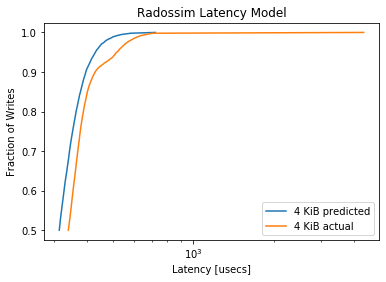

MainProcess pypet INFO     
 Finished single run #186 of 1680 

MainProcess pypet INFO     
 Starting single run #187 of 1680 



minimum predicted latency: 212.236081
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1427, pvalue=3.683301179952173e-89)


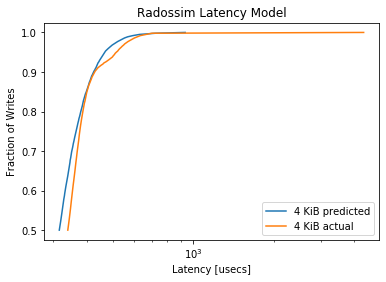

MainProcess pypet INFO     
 Finished single run #187 of 1680 

MainProcess pypet INFO     
 Starting single run #188 of 1680 



minimum predicted latency: 221.598627
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0902, pvalue=8.324551735181689e-36)


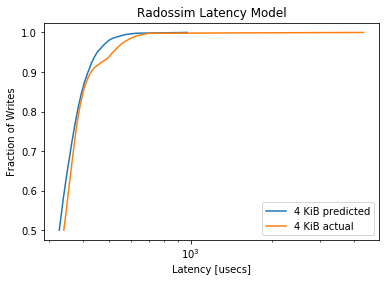

MainProcess pypet INFO     
 Finished single run #188 of 1680 

MainProcess pypet INFO     
 Starting single run #189 of 1680 



minimum predicted latency: 212.853457
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0626, pvalue=1.8697827631822935e-17)


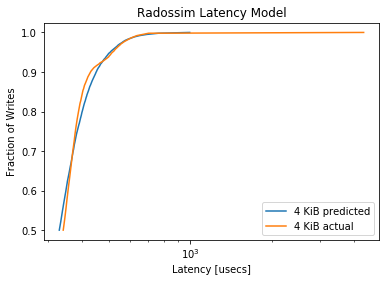

MainProcess pypet INFO     
 Finished single run #189 of 1680 

MainProcess pypet INFO     
 Starting single run #190 of 1680 



minimum predicted latency: 226.190611
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1509, pvalue=1.0836515400300532e-99)


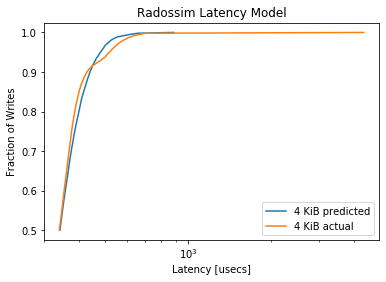

MainProcess pypet INFO     
 Finished single run #190 of 1680 

MainProcess pypet INFO     
 Starting single run #191 of 1680 



minimum predicted latency: 212.667955
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1081, pvalue=2.8465401865673404e-51)


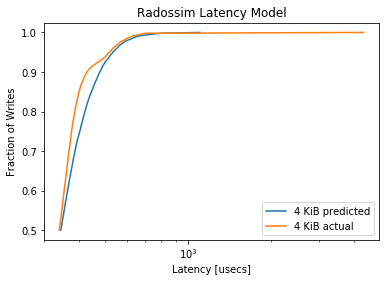

MainProcess pypet INFO     
 Finished single run #191 of 1680 

MainProcess pypet INFO     
 Starting single run #192 of 1680 



minimum predicted latency: 224.707692
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2079, pvalue=1.6669254544749703e-189)


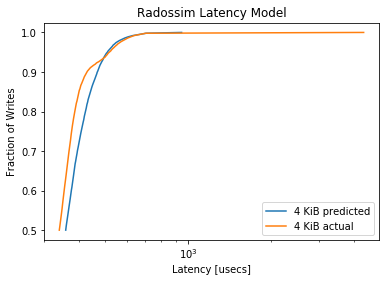

MainProcess pypet INFO     
 Finished single run #192 of 1680 

MainProcess pypet INFO     
 Starting single run #193 of 1680 



minimum predicted latency: 208.737473
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1813, pvalue=5.814855306609551e-144)


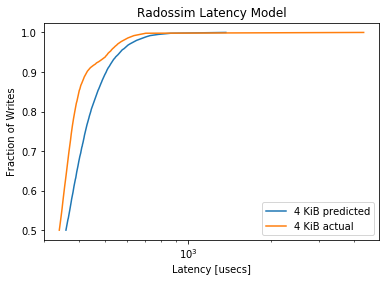

MainProcess pypet INFO     
 Finished single run #193 of 1680 

MainProcess pypet INFO     
 Starting single run #194 of 1680 



minimum predicted latency: 231.818444
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2583, pvalue=1.771462434323279e-293)


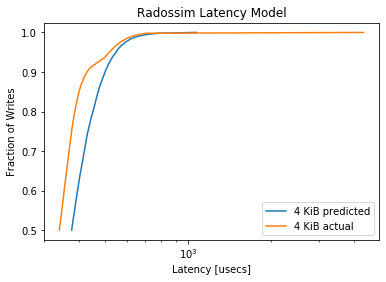

MainProcess pypet INFO     
 Finished single run #194 of 1680 

MainProcess pypet INFO     
 Starting single run #195 of 1680 



minimum predicted latency: 219.848952
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2457, pvalue=2.7153111869143866e-265)


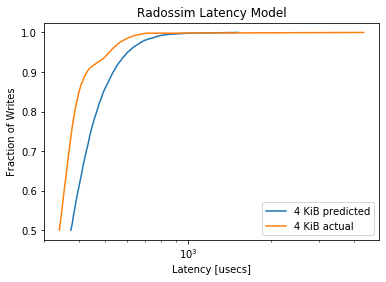

MainProcess pypet INFO     
 Finished single run #195 of 1680 

MainProcess pypet INFO     
 Starting single run #196 of 1680 



minimum predicted latency: 243.565486
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3482, pvalue=0.0)


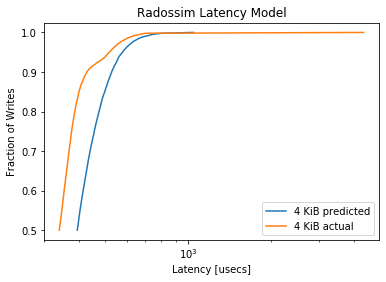

MainProcess pypet INFO     
 Finished single run #196 of 1680 

MainProcess pypet INFO     
 Starting single run #197 of 1680 



minimum predicted latency: 229.951361
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3253, pvalue=1e-323)


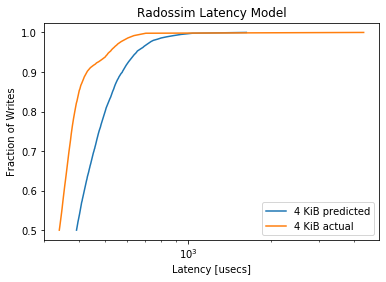

MainProcess pypet INFO     
 Finished single run #197 of 1680 

MainProcess pypet INFO     
 Starting single run #198 of 1680 



minimum predicted latency: 231.144765
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4337, pvalue=0.0)


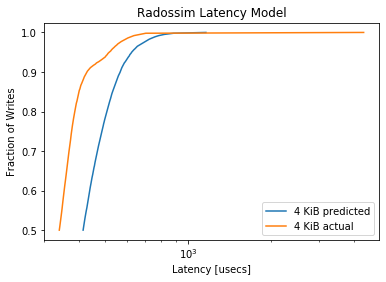

MainProcess pypet INFO     
 Finished single run #198 of 1680 

MainProcess pypet INFO     
 Starting single run #199 of 1680 



minimum predicted latency: 226.162327
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4051, pvalue=0.0)


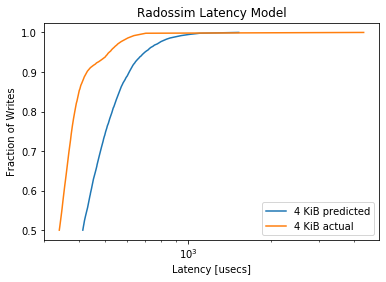

MainProcess pypet INFO     
 Finished single run #199 of 1680 

MainProcess pypet INFO     
 Starting single run #200 of 1680 



minimum predicted latency: 212.252009
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4034, pvalue=0.0)


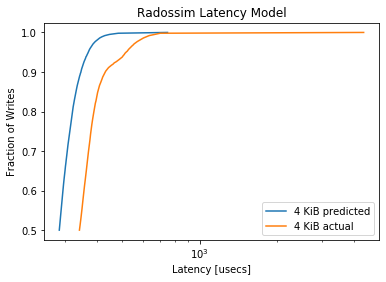

MainProcess pypet INFO     
 Finished single run #200 of 1680 

MainProcess pypet INFO     
 Starting single run #201 of 1680 



minimum predicted latency: 203.933088
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3493, pvalue=0.0)


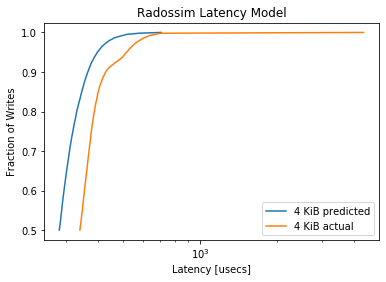

MainProcess pypet INFO     
 Finished single run #201 of 1680 

MainProcess pypet INFO     
 Starting single run #202 of 1680 



minimum predicted latency: 217.315086
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3476, pvalue=0.0)


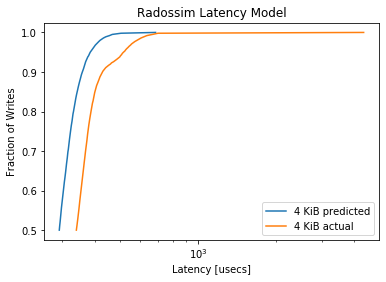

MainProcess pypet INFO     
 Finished single run #202 of 1680 

MainProcess pypet INFO     
 Starting single run #203 of 1680 



minimum predicted latency: 205.456298
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2923, pvalue=1e-323)


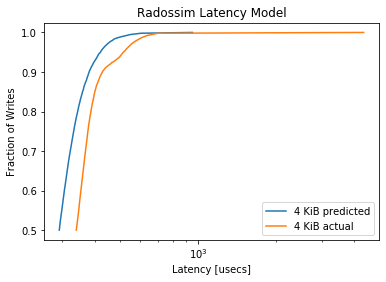

MainProcess pypet INFO     
 Finished single run #203 of 1680 

MainProcess pypet INFO     
 Starting single run #204 of 1680 



minimum predicted latency: 219.783146
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.28, pvalue=1e-323)


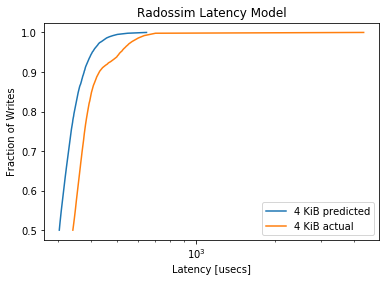

MainProcess pypet INFO     
 Finished single run #204 of 1680 

MainProcess pypet INFO     
 Starting single run #205 of 1680 



minimum predicted latency: 210.229558
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2232, pvalue=1.3214384633841424e-218)


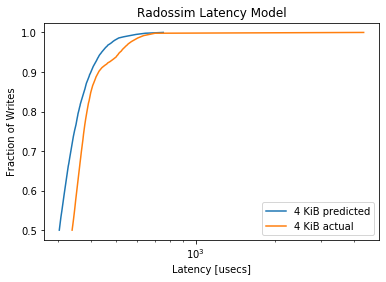

MainProcess pypet INFO     
 Finished single run #205 of 1680 

MainProcess pypet INFO     
 Starting single run #206 of 1680 



minimum predicted latency: 216.845342
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1783, pvalue=3.1692711313442197e-139)


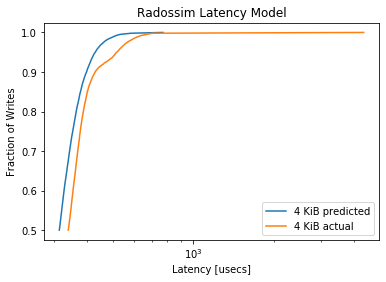

MainProcess pypet INFO     
 Finished single run #206 of 1680 

MainProcess pypet INFO     
 Starting single run #207 of 1680 



minimum predicted latency: 214.125036
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1605, pvalue=8.831024536322577e-113)


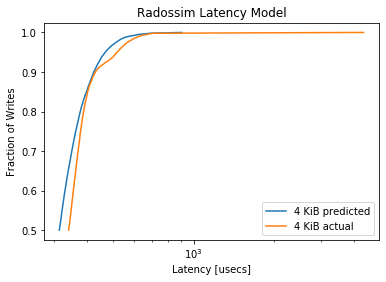

MainProcess pypet INFO     
 Finished single run #207 of 1680 

MainProcess pypet INFO     
 Starting single run #208 of 1680 



minimum predicted latency: 226.300406
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0949, pvalue=1.3535345596543116e-39)


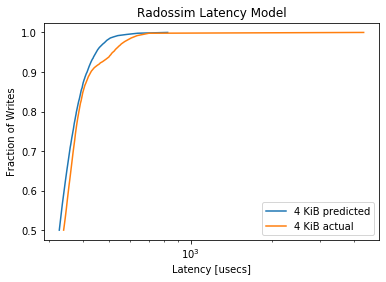

MainProcess pypet INFO     
 Finished single run #208 of 1680 

MainProcess pypet INFO     
 Starting single run #209 of 1680 



minimum predicted latency: 217.150303
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0857, pvalue=2.3267864623988028e-32)


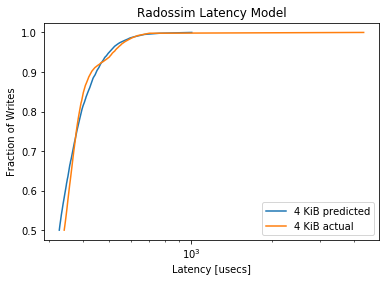

MainProcess pypet INFO     
 Finished single run #209 of 1680 

MainProcess pypet INFO     
 Starting single run #210 of 1680 



minimum predicted latency: 224.915904
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1488, pvalue=6.149065813876127e-97)


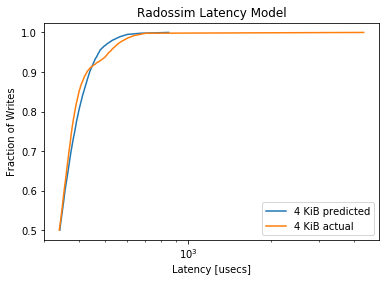

MainProcess pypet INFO     
 Finished single run #210 of 1680 

MainProcess pypet INFO     
 Starting single run #211 of 1680 



minimum predicted latency: 220.524629
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.098, pvalue=3.360952740954835e-42)


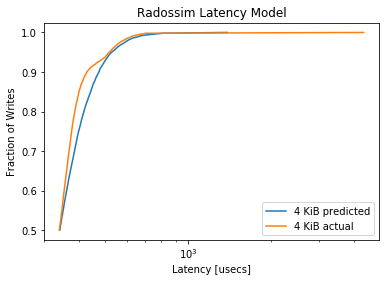

MainProcess pypet INFO     
 Finished single run #211 of 1680 

MainProcess pypet INFO     
 Starting single run #212 of 1680 



minimum predicted latency: 229.554711
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2106, pvalue=1.742983728230621e-194)


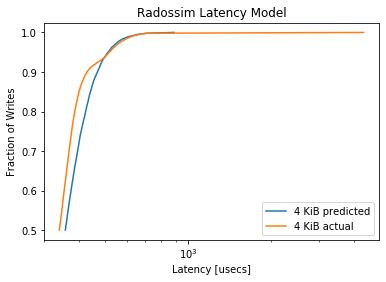

MainProcess pypet INFO     
 Finished single run #212 of 1680 

MainProcess pypet INFO     
 Starting single run #213 of 1680 



minimum predicted latency: 220.032370
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1804, pvalue=1.5629591378608912e-142)


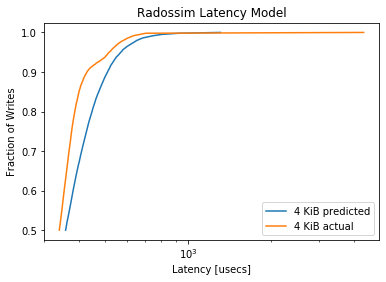

MainProcess pypet INFO     
 Finished single run #213 of 1680 

MainProcess pypet INFO     
 Starting single run #214 of 1680 



minimum predicted latency: 227.313746
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2537, pvalue=5.116508535167985e-283)


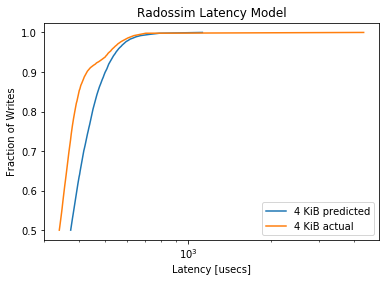

MainProcess pypet INFO     
 Finished single run #214 of 1680 

MainProcess pypet INFO     
 Starting single run #215 of 1680 



minimum predicted latency: 218.110661
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2534, pvalue=2.423043562659258e-282)


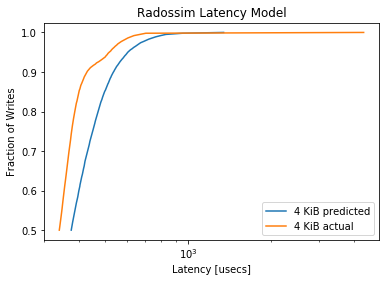

MainProcess pypet INFO     
 Finished single run #215 of 1680 

MainProcess pypet INFO     
 Starting single run #216 of 1680 



minimum predicted latency: 235.481003
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3354, pvalue=0.0)


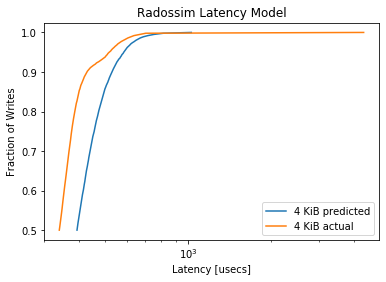

MainProcess pypet INFO     
 Finished single run #216 of 1680 

MainProcess pypet INFO     
 Starting single run #217 of 1680 



minimum predicted latency: 222.736619
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3248, pvalue=1e-323)


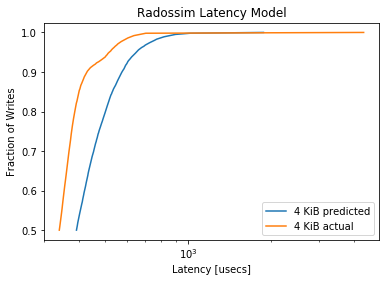

MainProcess pypet INFO     
 Finished single run #217 of 1680 

MainProcess pypet INFO     
 Starting single run #218 of 1680 



minimum predicted latency: 224.743944
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4297, pvalue=0.0)


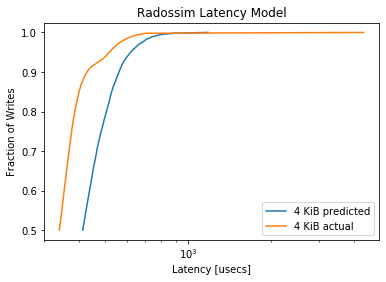

MainProcess pypet INFO     
 Finished single run #218 of 1680 

MainProcess pypet INFO     
 Starting single run #219 of 1680 



minimum predicted latency: 228.295831
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4057, pvalue=0.0)


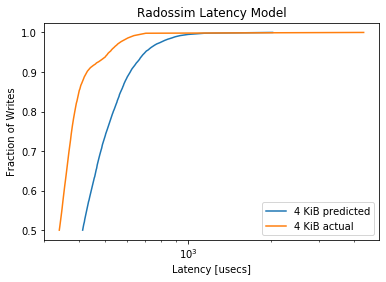

MainProcess pypet INFO     
 Finished single run #219 of 1680 

MainProcess pypet INFO     
 Starting single run #220 of 1680 



minimum predicted latency: 213.320329
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.408, pvalue=0.0)


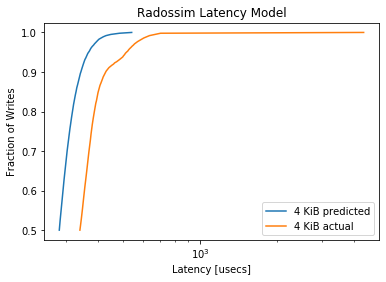

MainProcess pypet INFO     
 Finished single run #220 of 1680 

MainProcess pypet INFO     
 Starting single run #221 of 1680 



minimum predicted latency: 204.818593
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3465, pvalue=0.0)


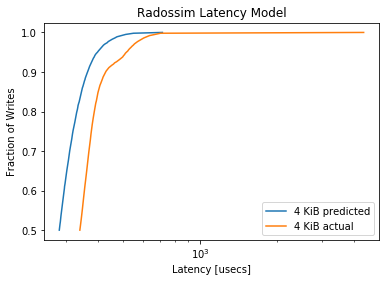

MainProcess pypet INFO     
 Finished single run #221 of 1680 

MainProcess pypet INFO     
 Starting single run #222 of 1680 



minimum predicted latency: 213.386721
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3402, pvalue=0.0)


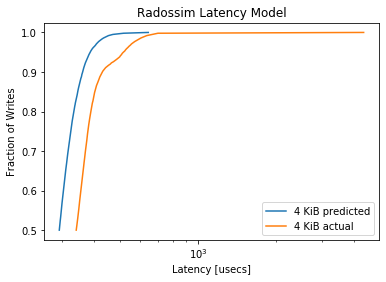

MainProcess pypet INFO     
 Finished single run #222 of 1680 

MainProcess pypet INFO     
 Starting single run #223 of 1680 



minimum predicted latency: 207.062737
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2952, pvalue=1e-323)


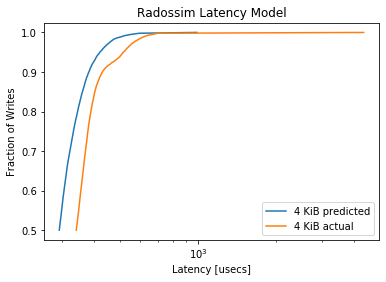

MainProcess pypet INFO     
 Finished single run #223 of 1680 

MainProcess pypet INFO     
 Starting single run #224 of 1680 



minimum predicted latency: 218.286894
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2716, pvalue=1e-323)


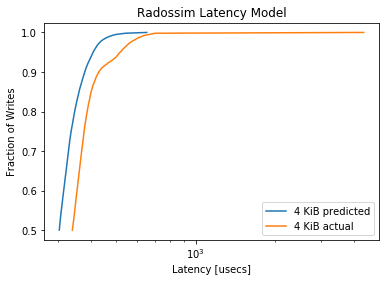

MainProcess pypet INFO     
 Finished single run #224 of 1680 

MainProcess pypet INFO     
 Starting single run #225 of 1680 



minimum predicted latency: 211.069617
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2288, pvalue=8.622272024247672e-230)


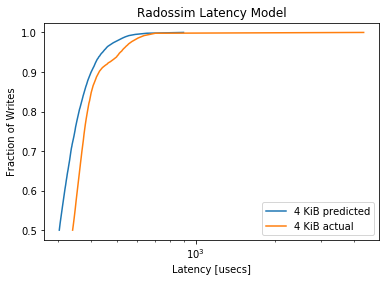

MainProcess pypet INFO     
 Finished single run #225 of 1680 

MainProcess pypet INFO     
 Starting single run #226 of 1680 



minimum predicted latency: 219.721744
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.184, pvalue=2.70805274589503e-148)


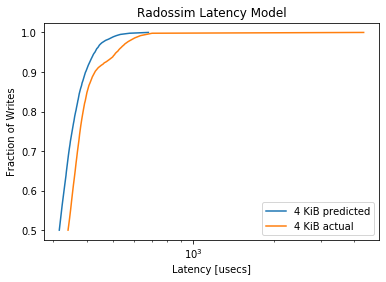

MainProcess pypet INFO     
 Finished single run #226 of 1680 

MainProcess pypet INFO     
 Starting single run #227 of 1680 



minimum predicted latency: 211.852911
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.158, pvalue=2.713884153949142e-109)


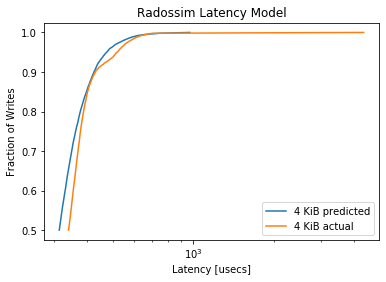

MainProcess pypet INFO     
 Finished single run #227 of 1680 

MainProcess pypet INFO     
 Starting single run #228 of 1680 



minimum predicted latency: 220.361106
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0987, pvalue=8.444485601896779e-43)


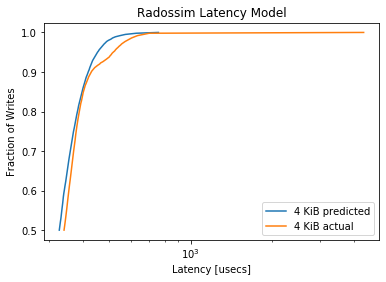

MainProcess pypet INFO     
 Finished single run #228 of 1680 

MainProcess pypet INFO     
 Starting single run #229 of 1680 



minimum predicted latency: 209.418038
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0748, pvalue=9.562876283968222e-25)


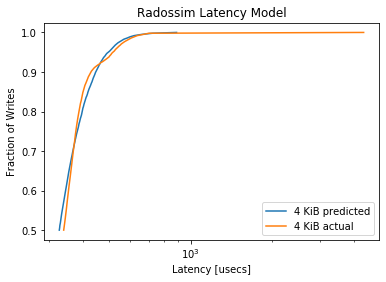

MainProcess pypet INFO     
 Finished single run #229 of 1680 

MainProcess pypet INFO     
 Starting single run #230 of 1680 



minimum predicted latency: 231.008145
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1499, pvalue=2.244743032268575e-98)


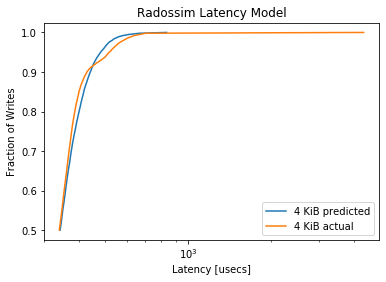

MainProcess pypet INFO     
 Finished single run #230 of 1680 

MainProcess pypet INFO     
 Starting single run #231 of 1680 



minimum predicted latency: 214.588604
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0999, pvalue=7.730232465171774e-44)


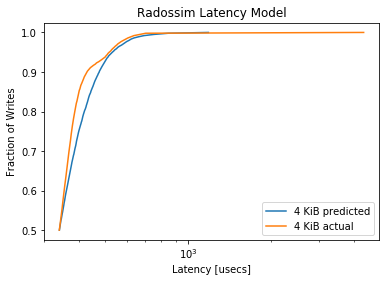

MainProcess pypet INFO     
 Finished single run #231 of 1680 

MainProcess pypet INFO     
 Starting single run #232 of 1680 



minimum predicted latency: 225.203963
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2034, pvalue=2.3764687169088517e-181)


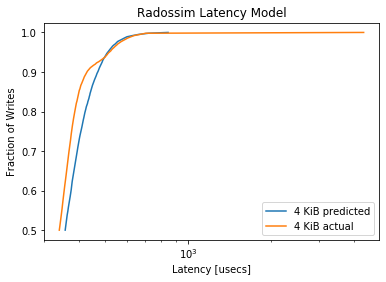

MainProcess pypet INFO     
 Finished single run #232 of 1680 

MainProcess pypet INFO     
 Starting single run #233 of 1680 



minimum predicted latency: 216.875062
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1728, pvalue=9.4356614183075e-131)


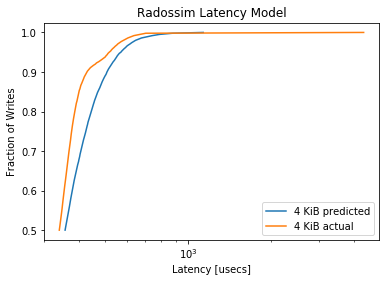

MainProcess pypet INFO     
 Finished single run #233 of 1680 

MainProcess pypet INFO     
 Starting single run #234 of 1680 



minimum predicted latency: 226.691012
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2557, pvalue=1.531203981762233e-287)


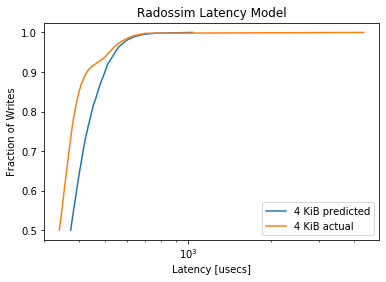

MainProcess pypet INFO     
 Finished single run #234 of 1680 

MainProcess pypet INFO     
 Starting single run #235 of 1680 



minimum predicted latency: 210.835046
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2526, pvalue=1.5181377288088217e-280)


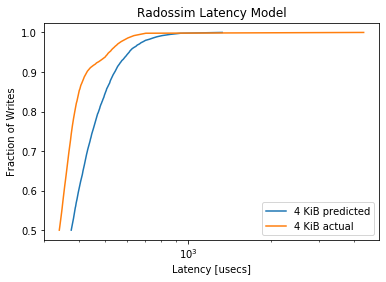

MainProcess pypet INFO     
 Finished single run #235 of 1680 

MainProcess pypet INFO     
 Starting single run #236 of 1680 



minimum predicted latency: 230.976345
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3309, pvalue=1e-323)


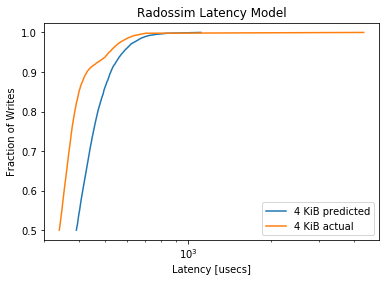

MainProcess pypet INFO     
 Finished single run #236 of 1680 

MainProcess pypet INFO     
 Starting single run #237 of 1680 



minimum predicted latency: 224.257464
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3165, pvalue=1e-323)


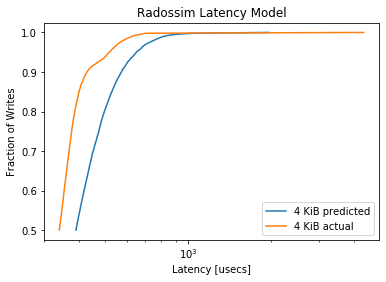

MainProcess pypet INFO     
 Finished single run #237 of 1680 

MainProcess pypet INFO     
 Starting single run #238 of 1680 



minimum predicted latency: 243.334012
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4336, pvalue=0.0)


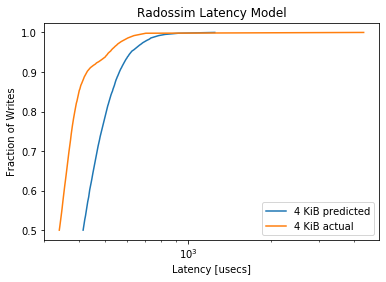

MainProcess pypet INFO     
 Finished single run #238 of 1680 

MainProcess pypet INFO     
 Starting single run #239 of 1680 



minimum predicted latency: 225.619583
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4086, pvalue=0.0)


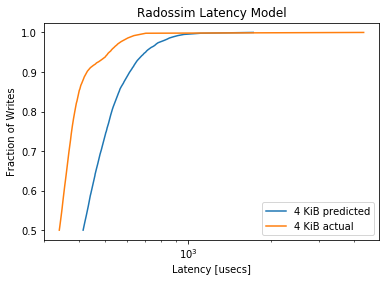

MainProcess pypet INFO     
 Finished single run #239 of 1680 

MainProcess pypet INFO     
 Starting single run #240 of 1680 



minimum predicted latency: 211.368580
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4113, pvalue=0.0)


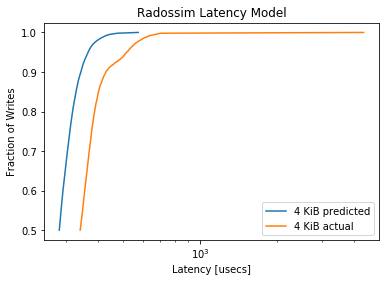

MainProcess pypet INFO     
 Finished single run #240 of 1680 

MainProcess pypet INFO     
 Starting single run #241 of 1680 



minimum predicted latency: 204.757605
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3504, pvalue=0.0)


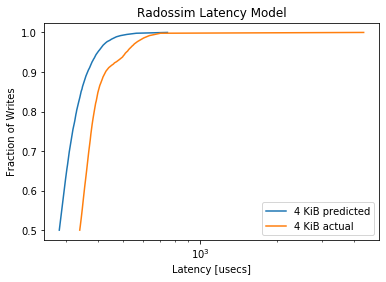

MainProcess pypet INFO     
 Finished single run #241 of 1680 

MainProcess pypet INFO     
 Starting single run #242 of 1680 



minimum predicted latency: 213.433652
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3467, pvalue=0.0)


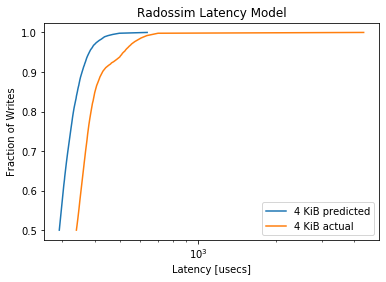

MainProcess pypet INFO     
 Finished single run #242 of 1680 

MainProcess pypet INFO     
 Starting single run #243 of 1680 



minimum predicted latency: 206.903086
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2886, pvalue=1e-323)


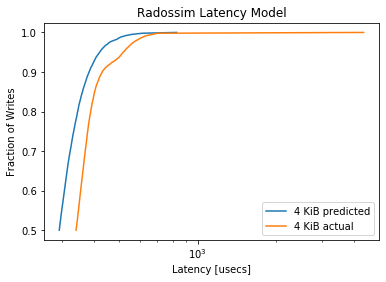

MainProcess pypet INFO     
 Finished single run #243 of 1680 

MainProcess pypet INFO     
 Starting single run #244 of 1680 



minimum predicted latency: 214.738229
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2685, pvalue=2.2377834e-317)


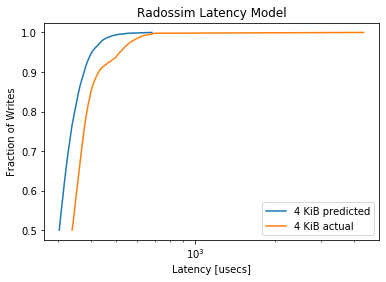

MainProcess pypet INFO     
 Finished single run #244 of 1680 

MainProcess pypet INFO     
 Starting single run #245 of 1680 



minimum predicted latency: 210.674449
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2247, pvalue=1.4226246338039502e-221)


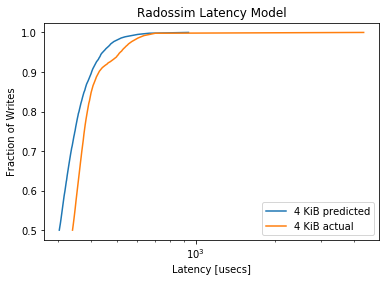

MainProcess pypet INFO     
 Finished single run #245 of 1680 

MainProcess pypet INFO     
 Starting single run #246 of 1680 



minimum predicted latency: 220.649138
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1852, pvalue=3.0643912448425967e-150)


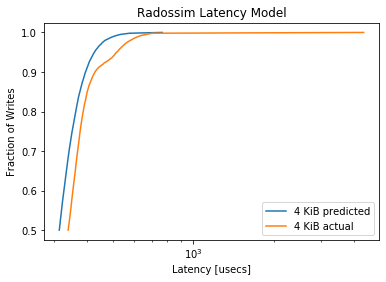

MainProcess pypet INFO     
 Finished single run #246 of 1680 

MainProcess pypet INFO     
 Starting single run #247 of 1680 



minimum predicted latency: 212.470930
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1542, pvalue=4.2471883520576865e-104)


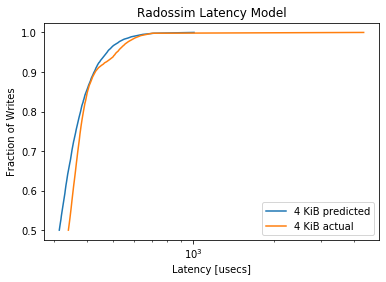

MainProcess pypet INFO     
 Finished single run #247 of 1680 

MainProcess pypet INFO     
 Starting single run #248 of 1680 



minimum predicted latency: 224.830733
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0946, pvalue=2.39384571183979e-39)


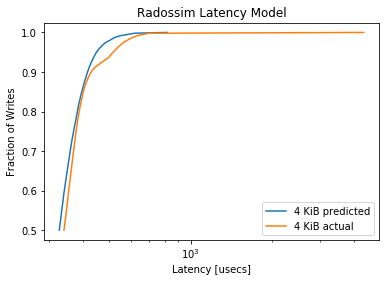

MainProcess pypet INFO     
 Finished single run #248 of 1680 

MainProcess pypet INFO     
 Starting single run #249 of 1680 



minimum predicted latency: 212.345414
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0721, pvalue=5.083384050378214e-23)


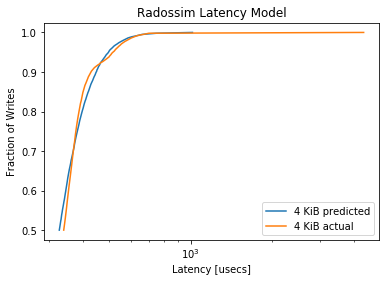

MainProcess pypet INFO     
 Finished single run #249 of 1680 

MainProcess pypet INFO     
 Starting single run #250 of 1680 



minimum predicted latency: 219.377910
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1431, pvalue=1.1650796473826724e-89)


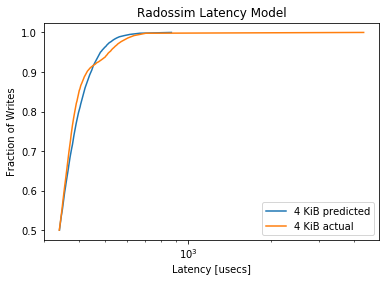

MainProcess pypet INFO     
 Finished single run #250 of 1680 

MainProcess pypet INFO     
 Starting single run #251 of 1680 



minimum predicted latency: 213.681721
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1036, pvalue=4.0455550895732605e-47)


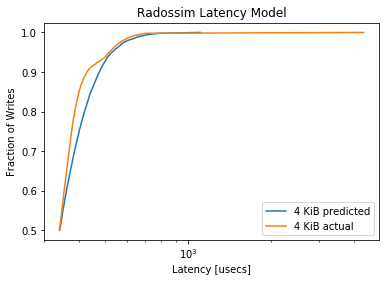

MainProcess pypet INFO     
 Finished single run #251 of 1680 

MainProcess pypet INFO     PROGRESS: Finished  252/1680 runs [===                 ] 15.0%, remaining: 0:09:07
MainProcess pypet INFO     
 Starting single run #252 of 1680 



minimum predicted latency: 232.086469
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.206, pvalue=4.8654653137977486e-186)


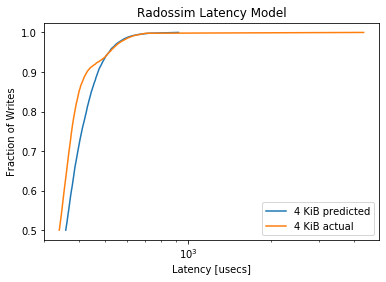

MainProcess pypet INFO     
 Finished single run #252 of 1680 

MainProcess pypet INFO     
 Starting single run #253 of 1680 



minimum predicted latency: 216.304406
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1758, pvalue=2.4338826638695804e-135)


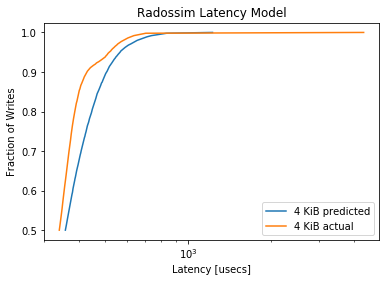

MainProcess pypet INFO     
 Finished single run #253 of 1680 

MainProcess pypet INFO     
 Starting single run #254 of 1680 



minimum predicted latency: 236.908878
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2539, pvalue=1.8123881809899555e-283)


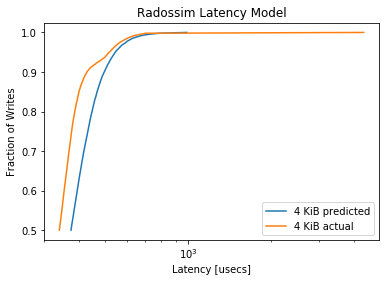

MainProcess pypet INFO     
 Finished single run #254 of 1680 

MainProcess pypet INFO     
 Starting single run #255 of 1680 



minimum predicted latency: 224.545245
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2432, pvalue=7.102259281319174e-260)


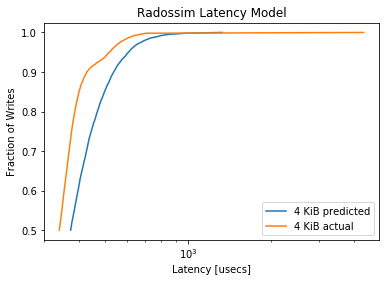

MainProcess pypet INFO     
 Finished single run #255 of 1680 

MainProcess pypet INFO     
 Starting single run #256 of 1680 



minimum predicted latency: 227.609884
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3408, pvalue=0.0)


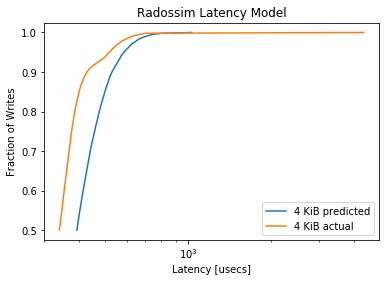

MainProcess pypet INFO     
 Finished single run #256 of 1680 

MainProcess pypet INFO     
 Starting single run #257 of 1680 



minimum predicted latency: 220.018645
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3156, pvalue=1e-323)


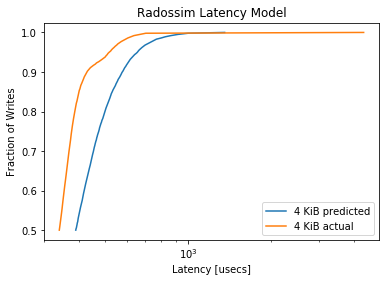

MainProcess pypet INFO     
 Finished single run #257 of 1680 

MainProcess pypet INFO     
 Starting single run #258 of 1680 



minimum predicted latency: 239.102138
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4295, pvalue=0.0)


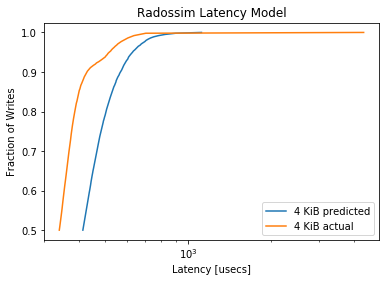

MainProcess pypet INFO     
 Finished single run #258 of 1680 

MainProcess pypet INFO     
 Starting single run #259 of 1680 



minimum predicted latency: 230.813521
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4119, pvalue=0.0)


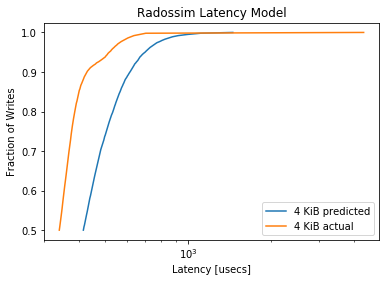

MainProcess pypet INFO     
 Finished single run #259 of 1680 

MainProcess pypet INFO     
 Starting single run #260 of 1680 



minimum predicted latency: 211.551031
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.408, pvalue=0.0)


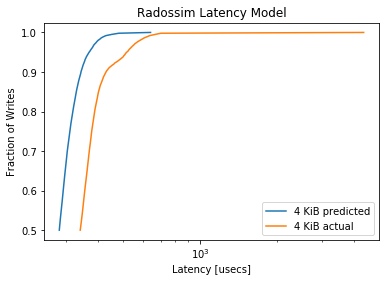

MainProcess pypet INFO     
 Finished single run #260 of 1680 

MainProcess pypet INFO     
 Starting single run #261 of 1680 



minimum predicted latency: 205.825633
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3612, pvalue=0.0)


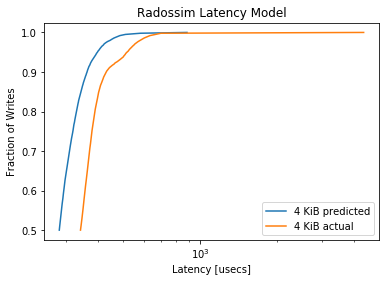

MainProcess pypet INFO     
 Finished single run #261 of 1680 

MainProcess pypet INFO     
 Starting single run #262 of 1680 



minimum predicted latency: 214.156625
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3483, pvalue=0.0)


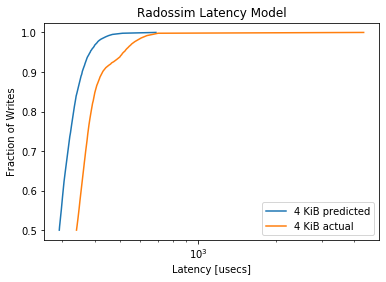

MainProcess pypet INFO     
 Finished single run #262 of 1680 

MainProcess pypet INFO     
 Starting single run #263 of 1680 



minimum predicted latency: 207.540951
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3023, pvalue=1e-323)


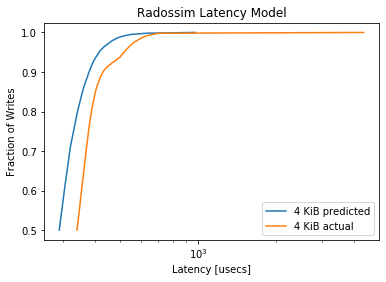

MainProcess pypet INFO     
 Finished single run #263 of 1680 

MainProcess pypet INFO     
 Starting single run #264 of 1680 



minimum predicted latency: 219.037023
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2774, pvalue=1e-323)


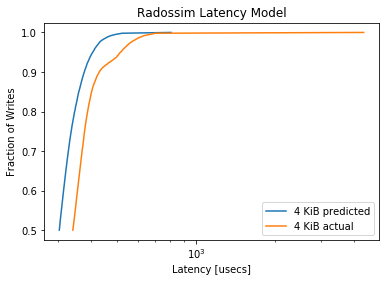

MainProcess pypet INFO     
 Finished single run #264 of 1680 

MainProcess pypet INFO     
 Starting single run #265 of 1680 



minimum predicted latency: 209.502611
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2298, pvalue=8.090985365265901e-232)


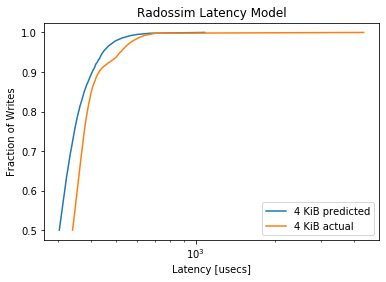

MainProcess pypet INFO     
 Finished single run #265 of 1680 

MainProcess pypet INFO     
 Starting single run #266 of 1680 



minimum predicted latency: 219.154049
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1985, pvalue=1.1119944867956573e-172)


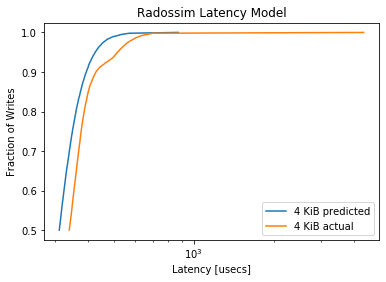

MainProcess pypet INFO     
 Finished single run #266 of 1680 

MainProcess pypet INFO     
 Starting single run #267 of 1680 



minimum predicted latency: 208.846188
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1516, pvalue=1.2829439338748125e-100)


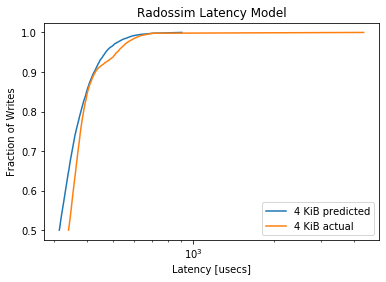

MainProcess pypet INFO     
 Finished single run #267 of 1680 

MainProcess pypet INFO     
 Starting single run #268 of 1680 



minimum predicted latency: 223.765667
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1046, pvalue=5.006509140421456e-48)


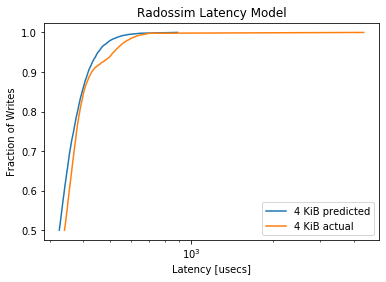

MainProcess pypet INFO     
 Finished single run #268 of 1680 

MainProcess pypet INFO     
 Starting single run #269 of 1680 



minimum predicted latency: 207.444081
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0717, pvalue=9.044370890233839e-23)


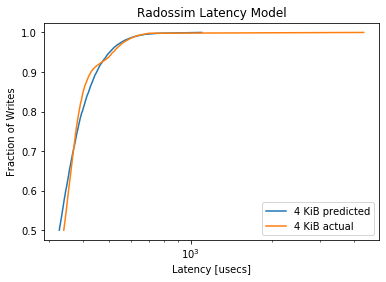

MainProcess pypet INFO     
 Finished single run #269 of 1680 

MainProcess pypet INFO     
 Starting single run #270 of 1680 



minimum predicted latency: 221.739223
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.144, pvalue=8.638424129899764e-91)


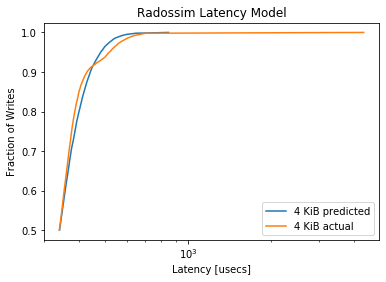

MainProcess pypet INFO     
 Finished single run #270 of 1680 

MainProcess pypet INFO     
 Starting single run #271 of 1680 



minimum predicted latency: 211.844964
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0962, pvalue=1.1202225589368676e-40)


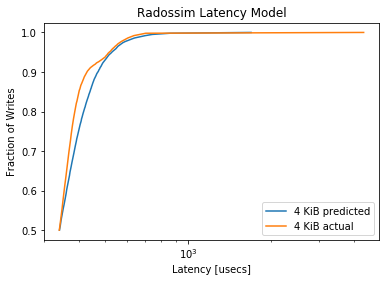

MainProcess pypet INFO     
 Finished single run #271 of 1680 

MainProcess pypet INFO     
 Starting single run #272 of 1680 



minimum predicted latency: 223.794820
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2094, pvalue=2.904547486620701e-192)


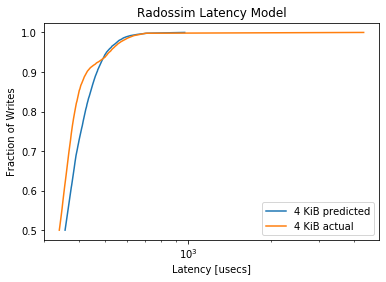

MainProcess pypet INFO     
 Finished single run #272 of 1680 

MainProcess pypet INFO     
 Starting single run #273 of 1680 



minimum predicted latency: 212.343814
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1668, pvalue=8.129768732768208e-122)


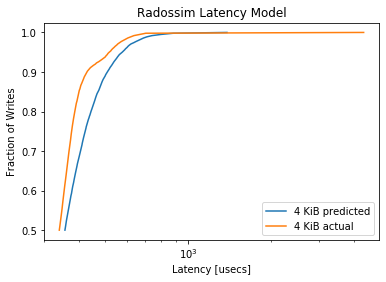

MainProcess pypet INFO     
 Finished single run #273 of 1680 

MainProcess pypet INFO     
 Starting single run #274 of 1680 



minimum predicted latency: 228.408436
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.249, pvalue=1.5636737129863648e-272)


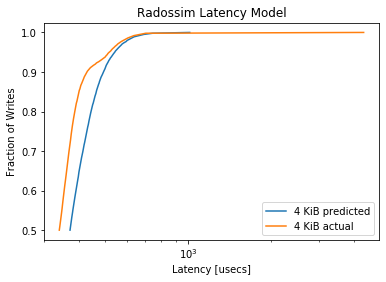

MainProcess pypet INFO     
 Finished single run #274 of 1680 

MainProcess pypet INFO     
 Starting single run #275 of 1680 



minimum predicted latency: 216.683524
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2383, pvalue=2.007014329182936e-249)


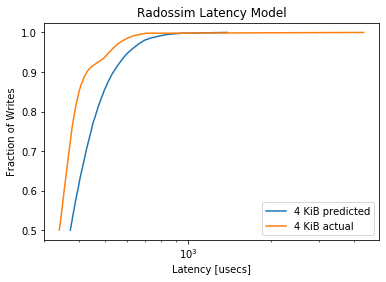

MainProcess pypet INFO     
 Finished single run #275 of 1680 

MainProcess pypet INFO     
 Starting single run #276 of 1680 



minimum predicted latency: 225.091667
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3321, pvalue=1e-323)


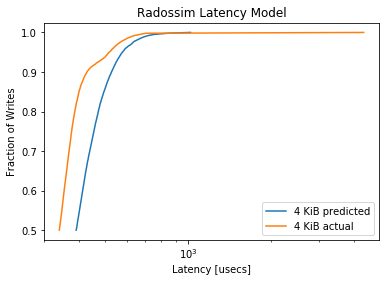

MainProcess pypet INFO     
 Finished single run #276 of 1680 

MainProcess pypet INFO     
 Starting single run #277 of 1680 



minimum predicted latency: 225.898834
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3164, pvalue=1e-323)


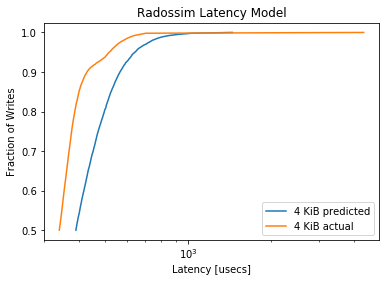

MainProcess pypet INFO     
 Finished single run #277 of 1680 

MainProcess pypet INFO     
 Starting single run #278 of 1680 



minimum predicted latency: 226.177974
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4258, pvalue=0.0)


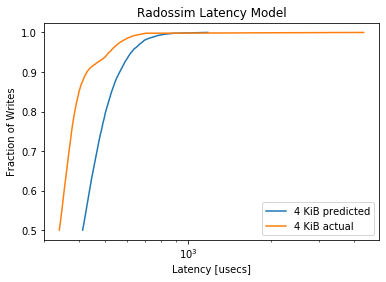

MainProcess pypet INFO     
 Finished single run #278 of 1680 

MainProcess pypet INFO     
 Starting single run #279 of 1680 



minimum predicted latency: 223.232047
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3988, pvalue=0.0)


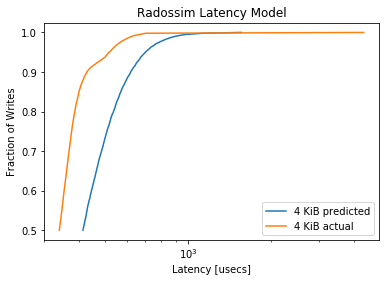

MainProcess pypet INFO     
 Finished single run #279 of 1680 

MainProcess pypet INFO     
 Starting single run #280 of 1680 



minimum predicted latency: 214.081121
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4094, pvalue=0.0)


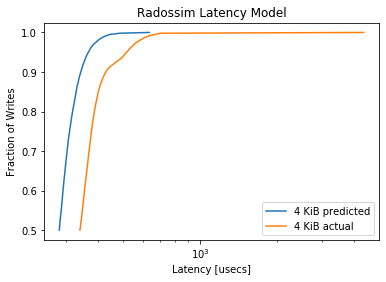

MainProcess pypet INFO     
 Finished single run #280 of 1680 

MainProcess pypet INFO     
 Starting single run #281 of 1680 



minimum predicted latency: 205.696350
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3565, pvalue=0.0)


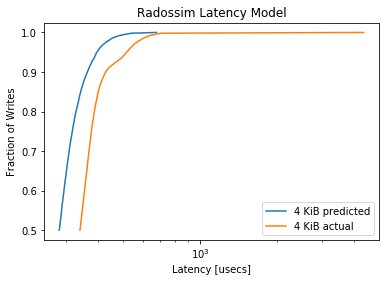

MainProcess pypet INFO     
 Finished single run #281 of 1680 

MainProcess pypet INFO     
 Starting single run #282 of 1680 



minimum predicted latency: 213.101176
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3465, pvalue=0.0)


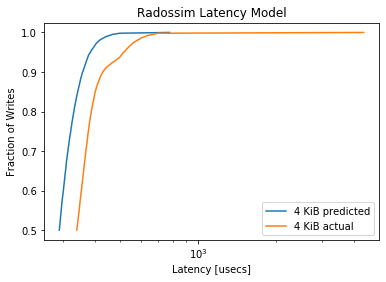

MainProcess pypet INFO     
 Finished single run #282 of 1680 

MainProcess pypet INFO     
 Starting single run #283 of 1680 



minimum predicted latency: 210.049740
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2918, pvalue=1e-323)


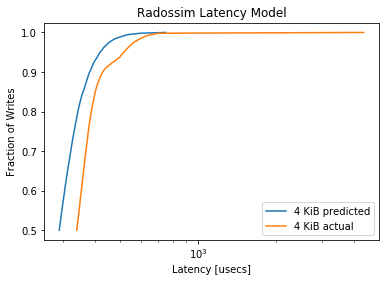

MainProcess pypet INFO     
 Finished single run #283 of 1680 

MainProcess pypet INFO     
 Starting single run #284 of 1680 



minimum predicted latency: 212.820155
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2806, pvalue=1e-323)


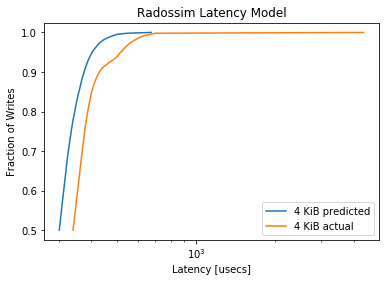

MainProcess pypet INFO     
 Finished single run #284 of 1680 

MainProcess pypet INFO     
 Starting single run #285 of 1680 



minimum predicted latency: 203.059343
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.231, pvalue=2.902369715354082e-234)


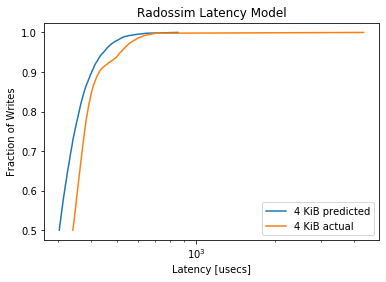

MainProcess pypet INFO     
 Finished single run #285 of 1680 

MainProcess pypet INFO     
 Starting single run #286 of 1680 



minimum predicted latency: 215.209158
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1924, pvalue=3.437795331154224e-162)


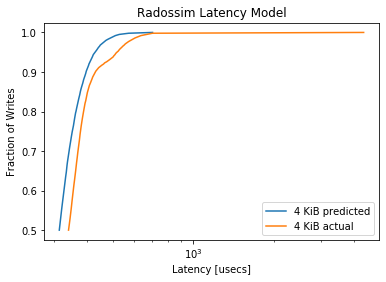

MainProcess pypet INFO     
 Finished single run #286 of 1680 

MainProcess pypet INFO     
 Starting single run #287 of 1680 



minimum predicted latency: 210.737568
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1649, pvalue=4.7044653973624306e-119)


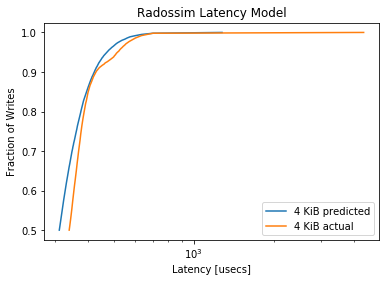

MainProcess pypet INFO     
 Finished single run #287 of 1680 

MainProcess pypet INFO     
 Starting single run #288 of 1680 



minimum predicted latency: 218.149929
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1046, pvalue=5.006509140421456e-48)


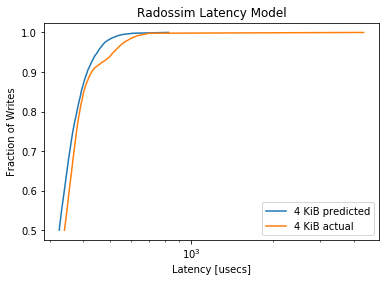

MainProcess pypet INFO     
 Finished single run #288 of 1680 

MainProcess pypet INFO     
 Starting single run #289 of 1680 



minimum predicted latency: 213.248449
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0798, pvalue=4.1394568181010795e-28)


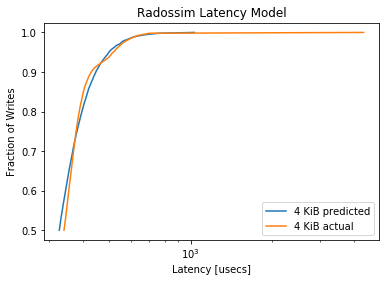

MainProcess pypet INFO     
 Finished single run #289 of 1680 

MainProcess pypet INFO     
 Starting single run #290 of 1680 



minimum predicted latency: 223.095463
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1479, pvalue=9.058745349732794e-96)


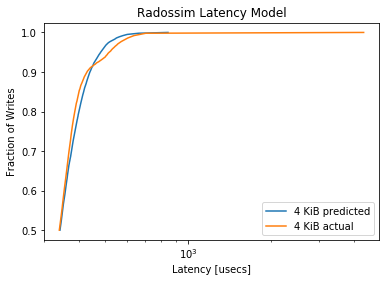

MainProcess pypet INFO     
 Finished single run #290 of 1680 

MainProcess pypet INFO     
 Starting single run #291 of 1680 



minimum predicted latency: 216.003944
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0948, pvalue=1.637190664345455e-39)


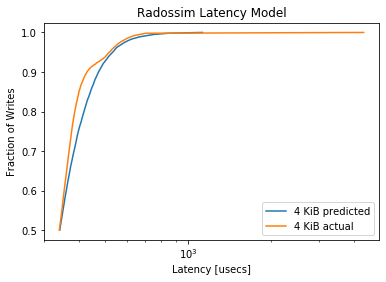

MainProcess pypet INFO     
 Finished single run #291 of 1680 

MainProcess pypet INFO     
 Starting single run #292 of 1680 



minimum predicted latency: 231.783208
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2047, pvalue=1.0944310303141385e-183)


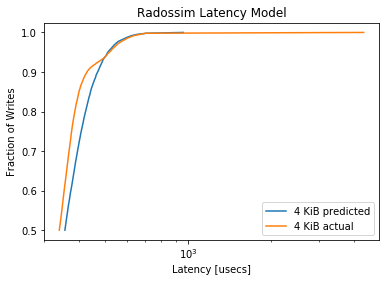

MainProcess pypet INFO     
 Finished single run #292 of 1680 

MainProcess pypet INFO     
 Starting single run #293 of 1680 



minimum predicted latency: 212.798809
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1676, pvalue=5.461367312561842e-123)


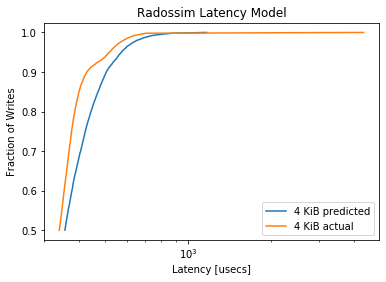

MainProcess pypet INFO     
 Finished single run #293 of 1680 

MainProcess pypet INFO     
 Starting single run #294 of 1680 



minimum predicted latency: 237.693182
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2476, pvalue=1.8959535627316808e-269)


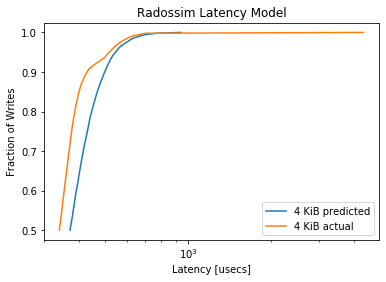

MainProcess pypet INFO     
 Finished single run #294 of 1680 

MainProcess pypet INFO     
 Starting single run #295 of 1680 



minimum predicted latency: 220.395833
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.238, pvalue=8.614477799807102e-249)


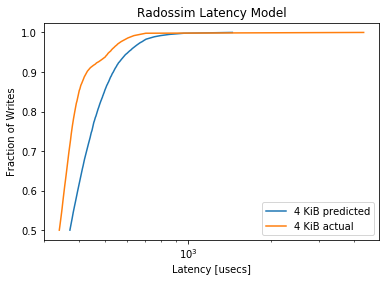

MainProcess pypet INFO     
 Finished single run #295 of 1680 

MainProcess pypet INFO     
 Starting single run #296 of 1680 



minimum predicted latency: 234.842894
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3267, pvalue=1e-323)


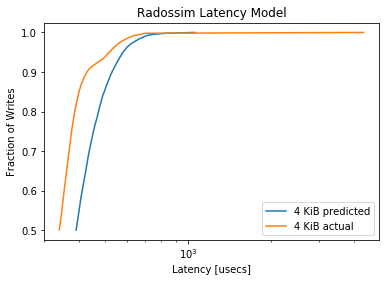

MainProcess pypet INFO     
 Finished single run #296 of 1680 

MainProcess pypet INFO     
 Starting single run #297 of 1680 



minimum predicted latency: 219.769884
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.324, pvalue=1e-323)


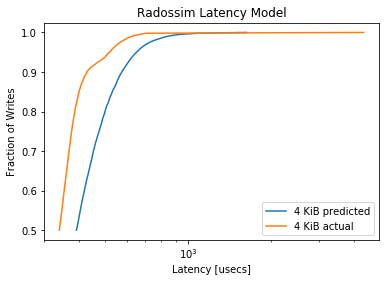

MainProcess pypet INFO     
 Finished single run #297 of 1680 

MainProcess pypet INFO     
 Starting single run #298 of 1680 



minimum predicted latency: 228.000490
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4147, pvalue=0.0)


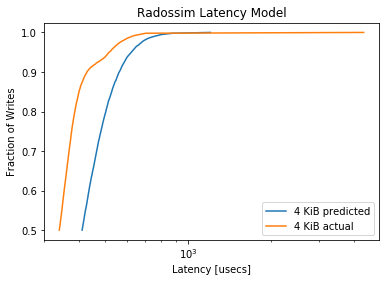

MainProcess pypet INFO     
 Finished single run #298 of 1680 

MainProcess pypet INFO     
 Starting single run #299 of 1680 



minimum predicted latency: 227.947633
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4018, pvalue=0.0)


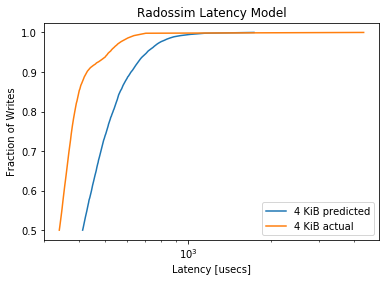

MainProcess pypet INFO     
 Finished single run #299 of 1680 

MainProcess pypet INFO     
 Starting single run #300 of 1680 



minimum predicted latency: 209.423927
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4131, pvalue=0.0)


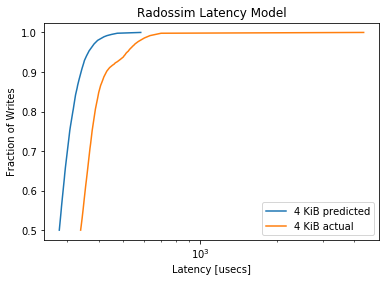

MainProcess pypet INFO     
 Finished single run #300 of 1680 

MainProcess pypet INFO     
 Starting single run #301 of 1680 



minimum predicted latency: 205.532188
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3564, pvalue=0.0)


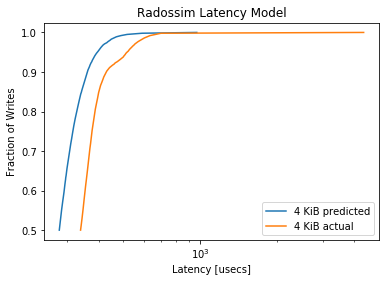

MainProcess pypet INFO     
 Finished single run #301 of 1680 

MainProcess pypet INFO     
 Starting single run #302 of 1680 



minimum predicted latency: 212.777004
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3517, pvalue=0.0)


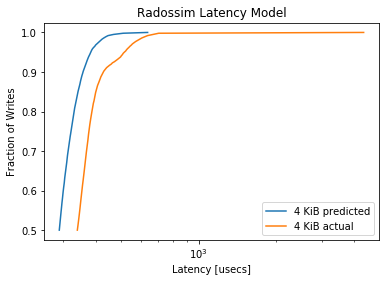

MainProcess pypet INFO     
 Finished single run #302 of 1680 

MainProcess pypet INFO     
 Starting single run #303 of 1680 



minimum predicted latency: 205.081864
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3005, pvalue=1e-323)


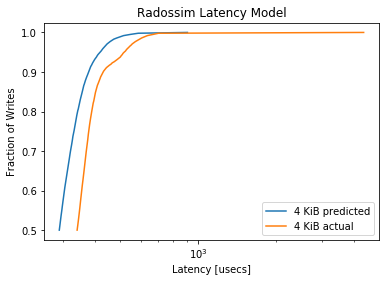

MainProcess pypet INFO     
 Finished single run #303 of 1680 

MainProcess pypet INFO     
 Starting single run #304 of 1680 



minimum predicted latency: 209.669519
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2772, pvalue=1e-323)


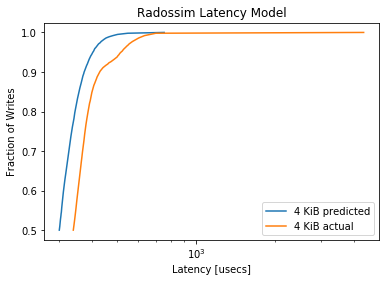

MainProcess pypet INFO     
 Finished single run #304 of 1680 

MainProcess pypet INFO     
 Starting single run #305 of 1680 



minimum predicted latency: 207.073250
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2342, pvalue=7.541825974988167e-241)


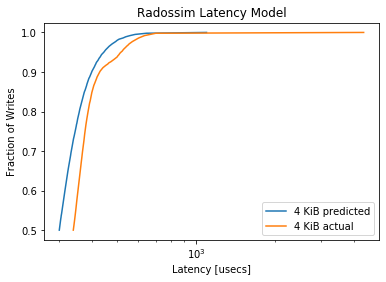

MainProcess pypet INFO     
 Finished single run #305 of 1680 

MainProcess pypet INFO     
 Starting single run #306 of 1680 



minimum predicted latency: 220.213033
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1997, pvalue=8.767688124838234e-175)


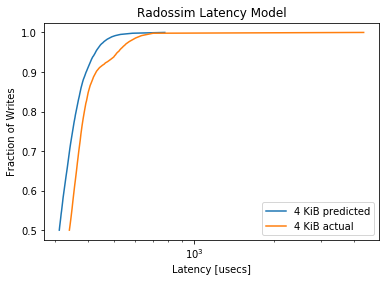

MainProcess pypet INFO     
 Finished single run #306 of 1680 

MainProcess pypet INFO     
 Starting single run #307 of 1680 



minimum predicted latency: 209.638457
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1581, pvalue=1.9731374299500712e-109)


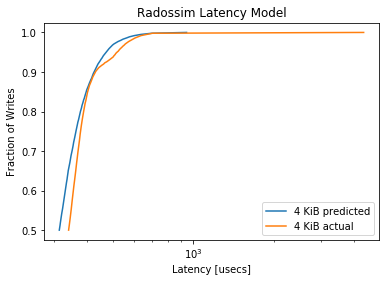

MainProcess pypet INFO     
 Finished single run #307 of 1680 

MainProcess pypet INFO     
 Starting single run #308 of 1680 



minimum predicted latency: 222.379649
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.104, pvalue=1.7581443997718148e-47)


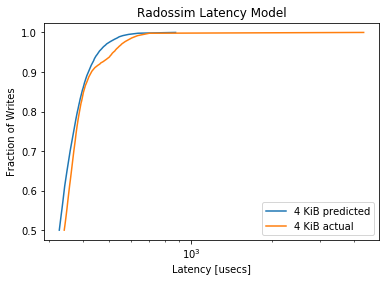

MainProcess pypet INFO     
 Finished single run #308 of 1680 

MainProcess pypet INFO     
 Starting single run #309 of 1680 



minimum predicted latency: 208.274960
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0885, pvalue=1.7505147017185854e-34)


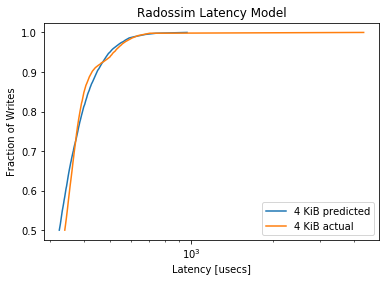

MainProcess pypet INFO     
 Finished single run #309 of 1680 

MainProcess pypet INFO     
 Starting single run #310 of 1680 



minimum predicted latency: 224.513297
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1308, pvalue=6.159805144899801e-75)


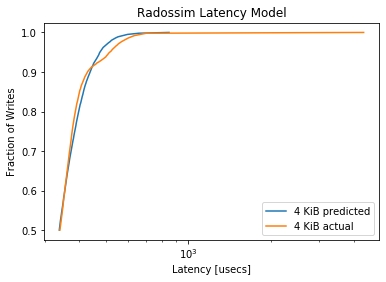

MainProcess pypet INFO     
 Finished single run #310 of 1680 

MainProcess pypet INFO     
 Starting single run #311 of 1680 



minimum predicted latency: 213.995400
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0845, pvalue=1.8024598302549427e-31)


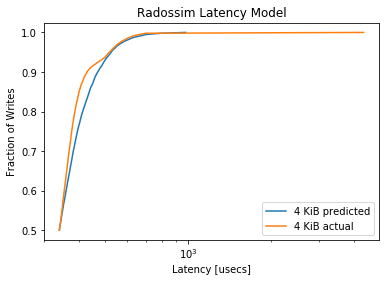

MainProcess pypet INFO     
 Finished single run #311 of 1680 

MainProcess pypet INFO     
 Starting single run #312 of 1680 



minimum predicted latency: 232.065691
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2022, pvalue=3.3062501651831954e-179)


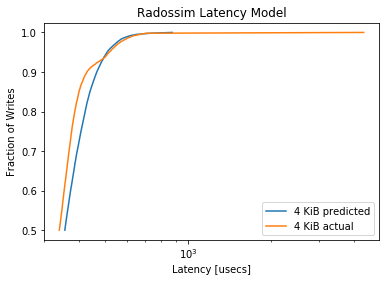

MainProcess pypet INFO     
 Finished single run #312 of 1680 

MainProcess pypet INFO     
 Starting single run #313 of 1680 



minimum predicted latency: 218.875194
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1607, pvalue=4.619534406491951e-113)


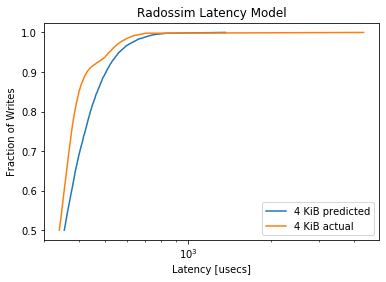

MainProcess pypet INFO     
 Finished single run #313 of 1680 

MainProcess pypet INFO     
 Starting single run #314 of 1680 



minimum predicted latency: 230.419142
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2426, pvalue=1.3900389082500624e-258)


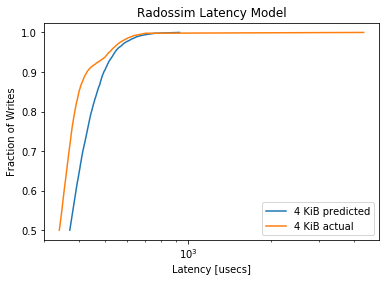

MainProcess pypet INFO     
 Finished single run #314 of 1680 

MainProcess pypet INFO     
 Starting single run #315 of 1680 



minimum predicted latency: 216.021978
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2388, pvalue=1.7629687325793552e-250)


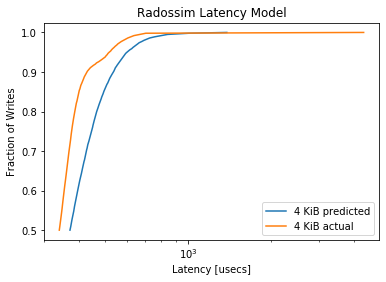

MainProcess pypet INFO     
 Finished single run #315 of 1680 

MainProcess pypet INFO     
 Starting single run #316 of 1680 



minimum predicted latency: 241.593199
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.324, pvalue=1e-323)


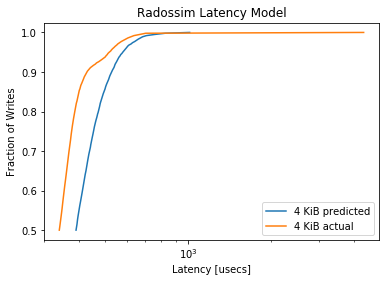

MainProcess pypet INFO     
 Finished single run #316 of 1680 

MainProcess pypet INFO     
 Starting single run #317 of 1680 



minimum predicted latency: 225.003206
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3215, pvalue=1e-323)


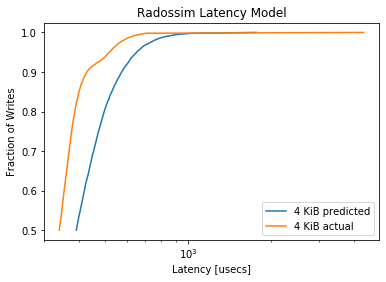

MainProcess pypet INFO     
 Finished single run #317 of 1680 

MainProcess pypet INFO     
 Starting single run #318 of 1680 



minimum predicted latency: 223.487245
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.426, pvalue=0.0)


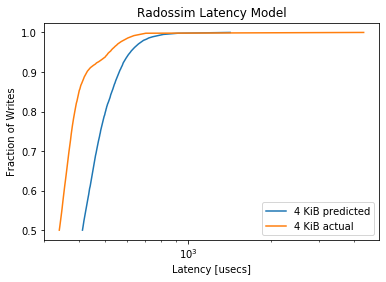

MainProcess pypet INFO     
 Finished single run #318 of 1680 

MainProcess pypet INFO     
 Starting single run #319 of 1680 



minimum predicted latency: 223.116272
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4018, pvalue=0.0)


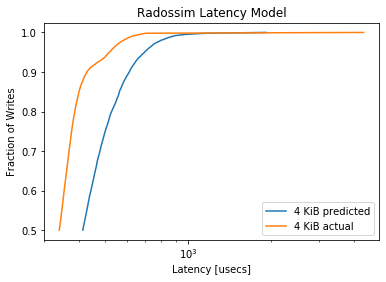

MainProcess pypet INFO     
 Finished single run #319 of 1680 

MainProcess pypet INFO     
 Starting single run #320 of 1680 



minimum predicted latency: 208.594292
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4128, pvalue=0.0)


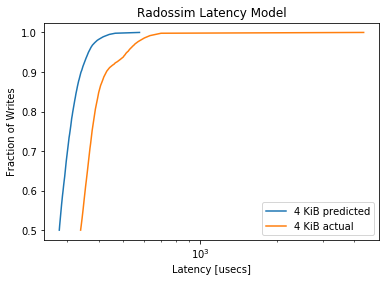

MainProcess pypet INFO     
 Finished single run #320 of 1680 

MainProcess pypet INFO     
 Starting single run #321 of 1680 



minimum predicted latency: 203.174191
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3549, pvalue=0.0)


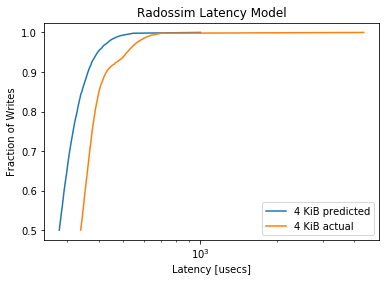

MainProcess pypet INFO     
 Finished single run #321 of 1680 

MainProcess pypet INFO     
 Starting single run #322 of 1680 



minimum predicted latency: 212.513908
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3505, pvalue=0.0)


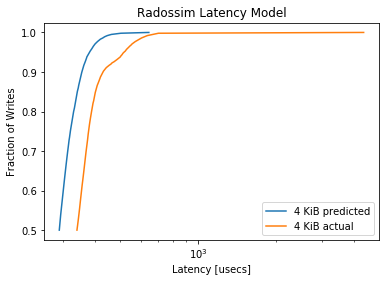

MainProcess pypet INFO     
 Finished single run #322 of 1680 

MainProcess pypet INFO     
 Starting single run #323 of 1680 



minimum predicted latency: 208.168237
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.308, pvalue=1e-323)


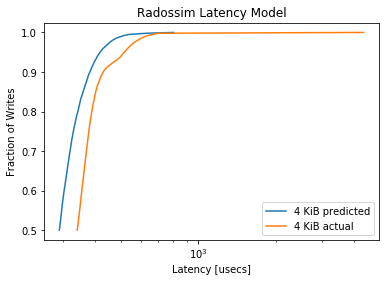

MainProcess pypet INFO     
 Finished single run #323 of 1680 

MainProcess pypet INFO     
 Starting single run #324 of 1680 



minimum predicted latency: 219.226141
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2803, pvalue=1e-323)


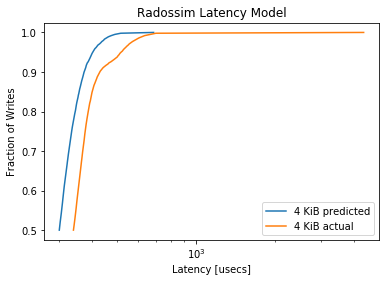

MainProcess pypet INFO     
 Finished single run #324 of 1680 

MainProcess pypet INFO     
 Starting single run #325 of 1680 



minimum predicted latency: 208.330995
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.242, pvalue=2.6998218879161325e-257)


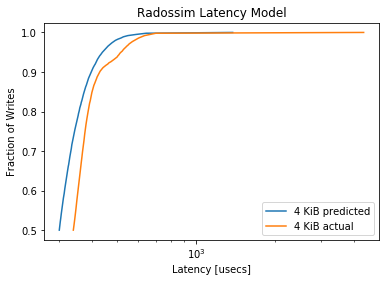

MainProcess pypet INFO     
 Finished single run #325 of 1680 

MainProcess pypet INFO     
 Starting single run #326 of 1680 



minimum predicted latency: 219.045003
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2013, pvalue=1.3131987448748916e-177)


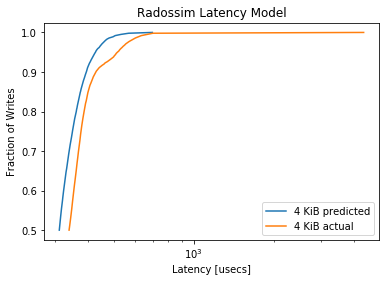

MainProcess pypet INFO     
 Finished single run #326 of 1680 

MainProcess pypet INFO     
 Starting single run #327 of 1680 



minimum predicted latency: 211.722804
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1616, pvalue=2.4764332286799345e-114)


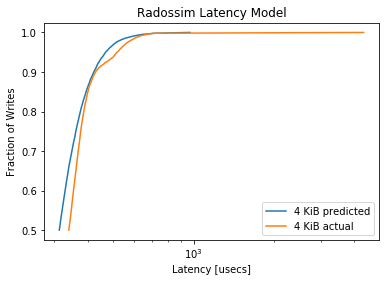

MainProcess pypet INFO     
 Finished single run #327 of 1680 

MainProcess pypet INFO     
 Starting single run #328 of 1680 



minimum predicted latency: 224.517171
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1057, pvalue=4.911394967593853e-49)


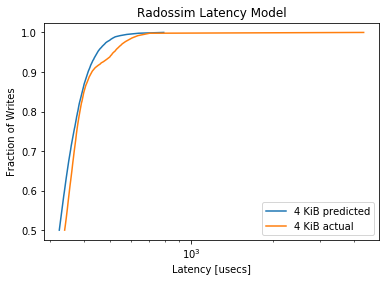

MainProcess pypet INFO     
 Finished single run #328 of 1680 

MainProcess pypet INFO     
 Starting single run #329 of 1680 



minimum predicted latency: 206.987505
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0864, pvalue=6.954904667155652e-33)


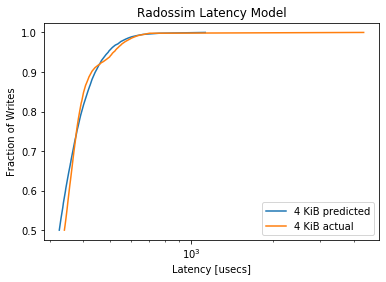

MainProcess pypet INFO     
 Finished single run #329 of 1680 

MainProcess pypet INFO     
 Starting single run #330 of 1680 



minimum predicted latency: 226.653818
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1377, pvalue=4.955867531883539e-83)


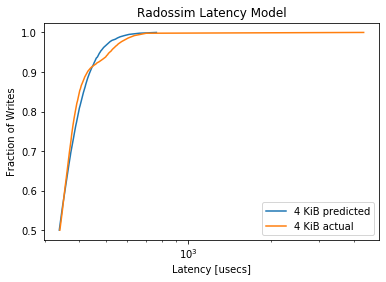

MainProcess pypet INFO     
 Finished single run #330 of 1680 

MainProcess pypet INFO     
 Starting single run #331 of 1680 



minimum predicted latency: 212.190410
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1023, pvalue=5.9364772884695e-46)


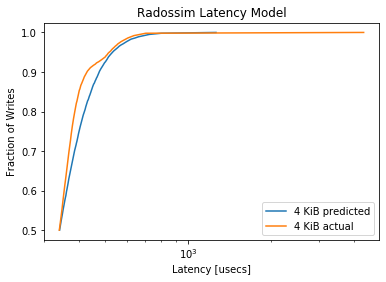

MainProcess pypet INFO     
 Finished single run #331 of 1680 

MainProcess pypet INFO     
 Starting single run #332 of 1680 



minimum predicted latency: 221.920187
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1931, pvalue=2.236408947595521e-163)


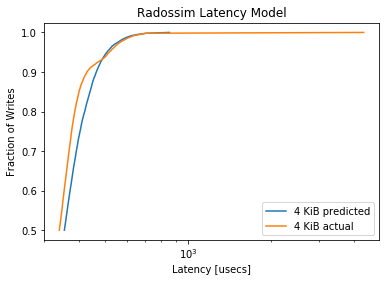

MainProcess pypet INFO     
 Finished single run #332 of 1680 

MainProcess pypet INFO     
 Starting single run #333 of 1680 



minimum predicted latency: 217.409427
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1623, pvalue=2.5145169611113846e-115)


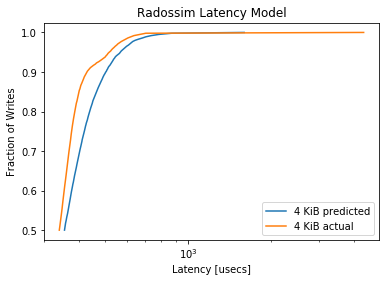

MainProcess pypet INFO     
 Finished single run #333 of 1680 

MainProcess pypet INFO     
 Starting single run #334 of 1680 



minimum predicted latency: 231.952474
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2457, pvalue=2.7153111869143866e-265)


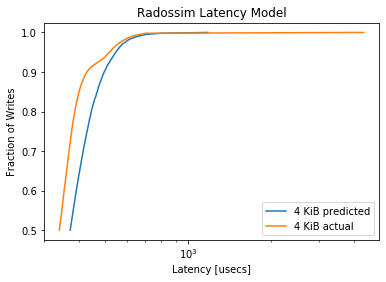

MainProcess pypet INFO     
 Finished single run #334 of 1680 

MainProcess pypet INFO     
 Starting single run #335 of 1680 



minimum predicted latency: 215.494650
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2438, pvalue=3.6011630366377918e-261)


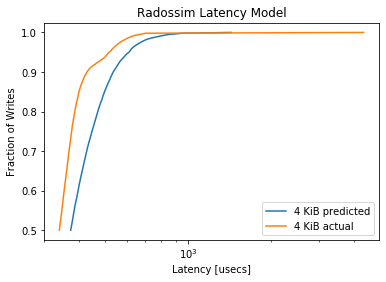

MainProcess pypet INFO     
 Finished single run #335 of 1680 

MainProcess pypet INFO     PROGRESS: Finished  336/1680 runs [====                ] 20.0%, remaining: 0:08:36
MainProcess pypet INFO     
 Starting single run #336 of 1680 



minimum predicted latency: 235.420749
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3267, pvalue=1e-323)


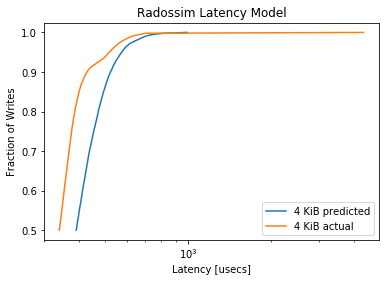

MainProcess pypet INFO     
 Finished single run #336 of 1680 

MainProcess pypet INFO     
 Starting single run #337 of 1680 



minimum predicted latency: 219.890210
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3107, pvalue=1e-323)


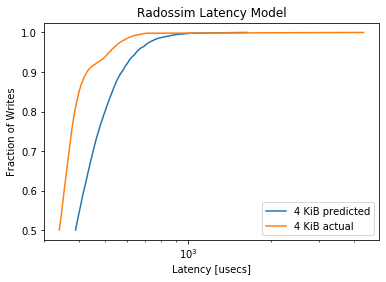

MainProcess pypet INFO     
 Finished single run #337 of 1680 

MainProcess pypet INFO     
 Starting single run #338 of 1680 



minimum predicted latency: 244.188352
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4186, pvalue=0.0)


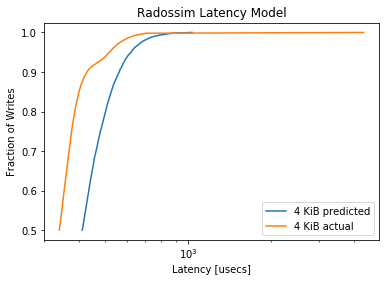

MainProcess pypet INFO     
 Finished single run #338 of 1680 

MainProcess pypet INFO     
 Starting single run #339 of 1680 



minimum predicted latency: 226.908536
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.395, pvalue=0.0)


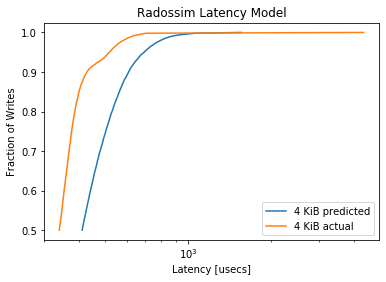

MainProcess pypet INFO     
 Finished single run #339 of 1680 

MainProcess pypet INFO     
 Starting single run #340 of 1680 



minimum predicted latency: 208.306701
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4134, pvalue=0.0)


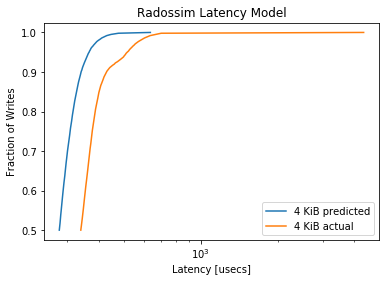

MainProcess pypet INFO     
 Finished single run #340 of 1680 

MainProcess pypet INFO     
 Starting single run #341 of 1680 



minimum predicted latency: 204.968953
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3631, pvalue=0.0)


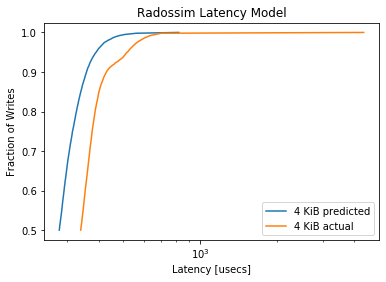

MainProcess pypet INFO     
 Finished single run #341 of 1680 

MainProcess pypet INFO     
 Starting single run #342 of 1680 



minimum predicted latency: 211.746818
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3592, pvalue=0.0)


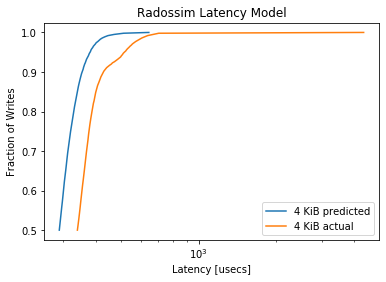

MainProcess pypet INFO     
 Finished single run #342 of 1680 

MainProcess pypet INFO     
 Starting single run #343 of 1680 



minimum predicted latency: 208.446532
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2966, pvalue=1e-323)


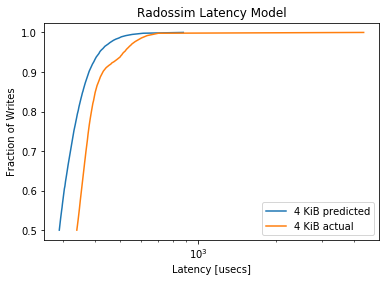

MainProcess pypet INFO     
 Finished single run #343 of 1680 

MainProcess pypet INFO     
 Starting single run #344 of 1680 



minimum predicted latency: 216.324102
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2797, pvalue=1e-323)


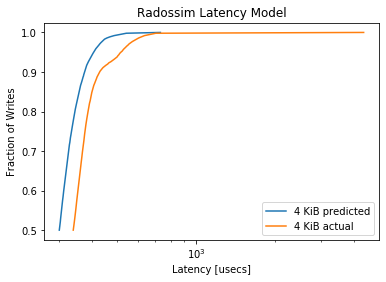

MainProcess pypet INFO     
 Finished single run #344 of 1680 

MainProcess pypet INFO     
 Starting single run #345 of 1680 



minimum predicted latency: 205.797305
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2286, pvalue=2.1879924313785613e-229)


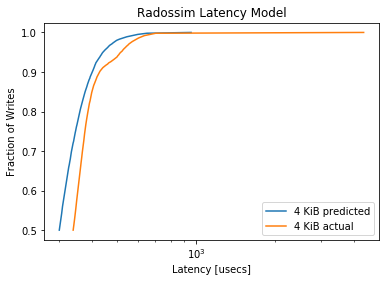

MainProcess pypet INFO     
 Finished single run #345 of 1680 

MainProcess pypet INFO     
 Starting single run #346 of 1680 



minimum predicted latency: 216.459100
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1997, pvalue=8.767688124838234e-175)


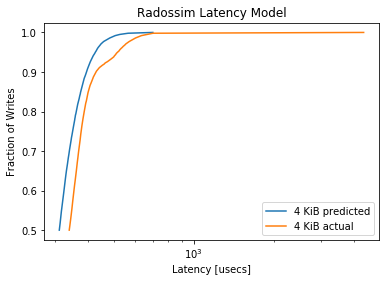

MainProcess pypet INFO     
 Finished single run #346 of 1680 

MainProcess pypet INFO     
 Starting single run #347 of 1680 



minimum predicted latency: 205.092363
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1648, pvalue=6.561580150128706e-119)


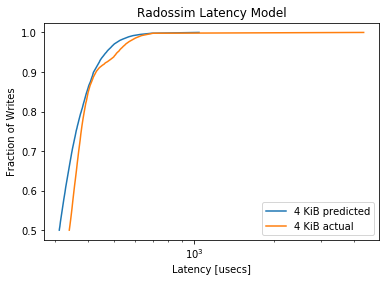

MainProcess pypet INFO     
 Finished single run #347 of 1680 

MainProcess pypet INFO     
 Starting single run #348 of 1680 



minimum predicted latency: 217.970486
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1048, pvalue=3.288460793386185e-48)


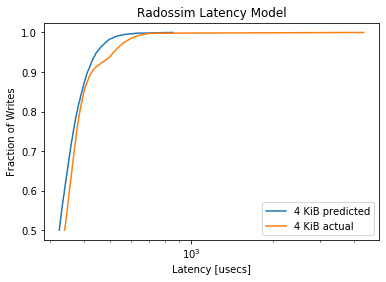

MainProcess pypet INFO     
 Finished single run #348 of 1680 

MainProcess pypet INFO     
 Starting single run #349 of 1680 



minimum predicted latency: 208.219721
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0895, pvalue=2.938391295282813e-35)


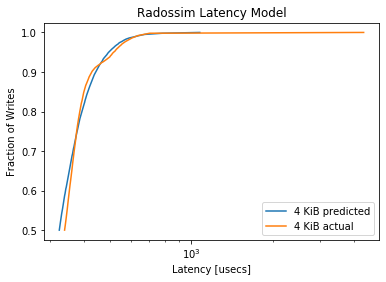

MainProcess pypet INFO     
 Finished single run #349 of 1680 

MainProcess pypet INFO     
 Starting single run #350 of 1680 



minimum predicted latency: 222.970129
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.134, pvalue=1.2245621866705983e-78)


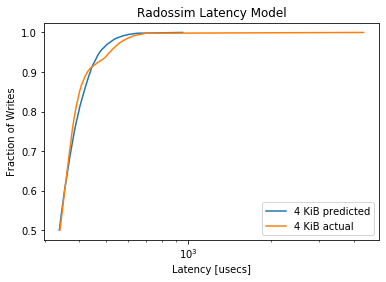

MainProcess pypet INFO     
 Finished single run #350 of 1680 

MainProcess pypet INFO     
 Starting single run #351 of 1680 



minimum predicted latency: 213.031941
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0943, pvalue=4.226045938558998e-39)


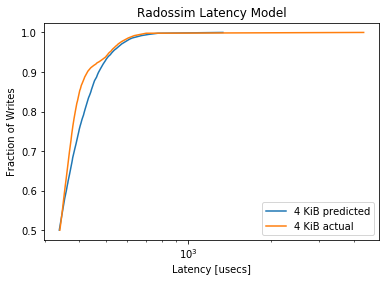

MainProcess pypet INFO     
 Finished single run #351 of 1680 

MainProcess pypet INFO     
 Starting single run #352 of 1680 



minimum predicted latency: 228.661108
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1945, pvalue=9.179738339390887e-166)


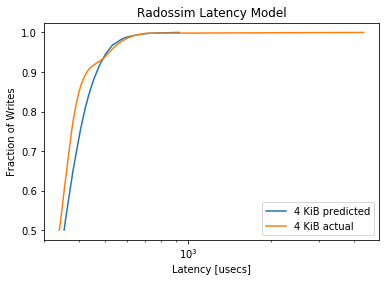

MainProcess pypet INFO     
 Finished single run #352 of 1680 

MainProcess pypet INFO     
 Starting single run #353 of 1680 



minimum predicted latency: 214.881319
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1615, pvalue=3.430679592647122e-114)


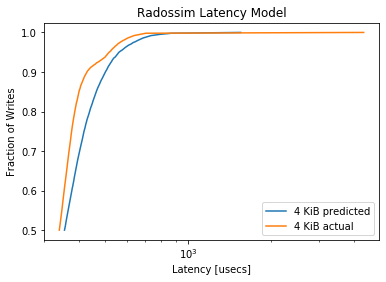

MainProcess pypet INFO     
 Finished single run #353 of 1680 

MainProcess pypet INFO     
 Starting single run #354 of 1680 



minimum predicted latency: 228.093726
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2417, pvalue=1.1864342068812095e-256)


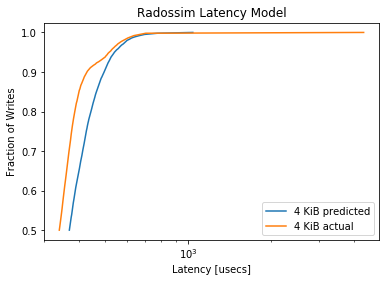

MainProcess pypet INFO     
 Finished single run #354 of 1680 

MainProcess pypet INFO     
 Starting single run #355 of 1680 



minimum predicted latency: 209.107090
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.241, pvalue=3.7250776034339265e-255)


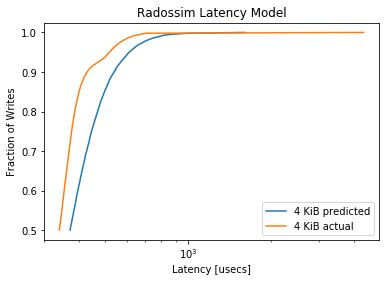

MainProcess pypet INFO     
 Finished single run #355 of 1680 

MainProcess pypet INFO     
 Starting single run #356 of 1680 



minimum predicted latency: 227.753301
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3266, pvalue=1e-323)


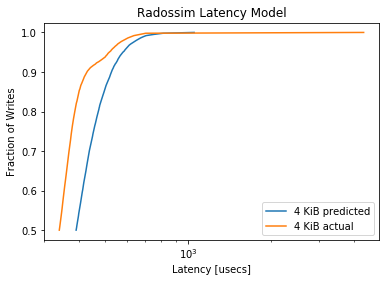

MainProcess pypet INFO     
 Finished single run #356 of 1680 

MainProcess pypet INFO     
 Starting single run #357 of 1680 



minimum predicted latency: 219.802031
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3244, pvalue=1e-323)


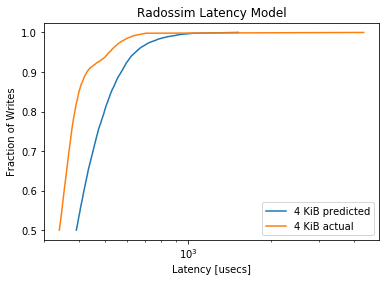

MainProcess pypet INFO     
 Finished single run #357 of 1680 

MainProcess pypet INFO     
 Starting single run #358 of 1680 



minimum predicted latency: 238.666286
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4223, pvalue=0.0)


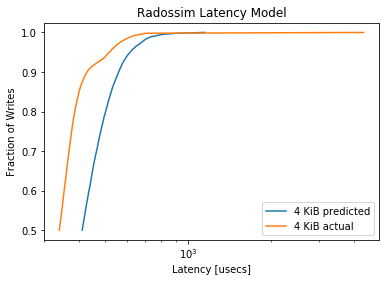

MainProcess pypet INFO     
 Finished single run #358 of 1680 

MainProcess pypet INFO     
 Starting single run #359 of 1680 



minimum predicted latency: 222.041033
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4002, pvalue=0.0)


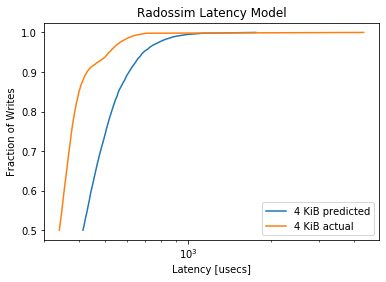

MainProcess pypet INFO     
 Finished single run #359 of 1680 

MainProcess pypet INFO     
 Starting single run #360 of 1680 



minimum predicted latency: 208.893303
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4135, pvalue=0.0)


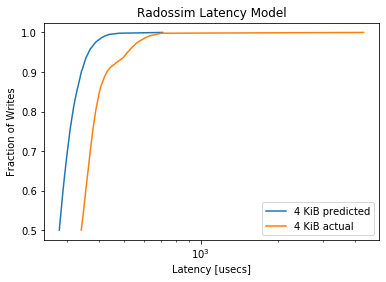

MainProcess pypet INFO     
 Finished single run #360 of 1680 

MainProcess pypet INFO     
 Starting single run #361 of 1680 



minimum predicted latency: 202.217118
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3691, pvalue=0.0)


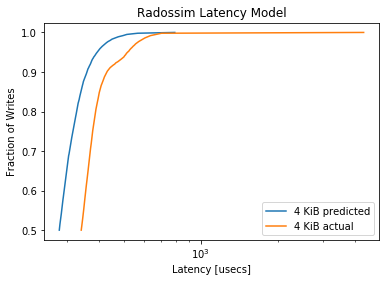

MainProcess pypet INFO     
 Finished single run #361 of 1680 

MainProcess pypet INFO     
 Starting single run #362 of 1680 



minimum predicted latency: 209.624966
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3565, pvalue=0.0)


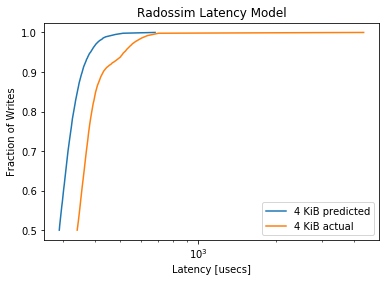

MainProcess pypet INFO     
 Finished single run #362 of 1680 

MainProcess pypet INFO     
 Starting single run #363 of 1680 



minimum predicted latency: 204.205181
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3094, pvalue=1e-323)


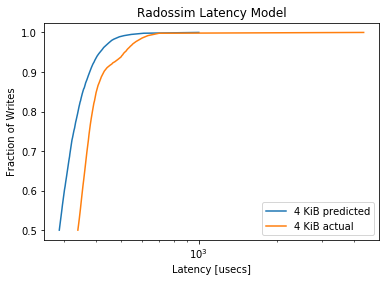

MainProcess pypet INFO     
 Finished single run #363 of 1680 

MainProcess pypet INFO     
 Starting single run #364 of 1680 



minimum predicted latency: 214.268730
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2884, pvalue=1e-323)


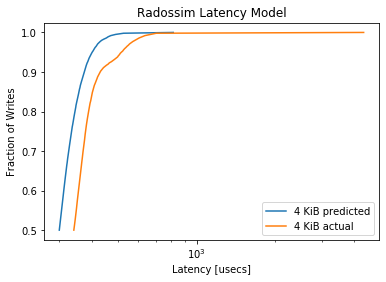

MainProcess pypet INFO     
 Finished single run #364 of 1680 

MainProcess pypet INFO     
 Starting single run #365 of 1680 



minimum predicted latency: 206.037520
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2402, pvalue=1.889453338237023e-253)


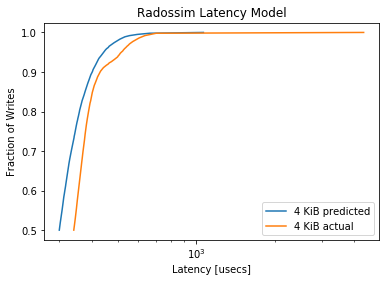

MainProcess pypet INFO     
 Finished single run #365 of 1680 

MainProcess pypet INFO     
 Starting single run #366 of 1680 



minimum predicted latency: 218.182359
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2147, pvalue=3.559631593285318e-202)


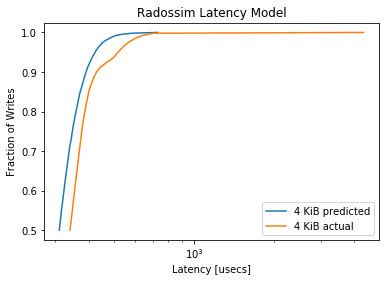

MainProcess pypet INFO     
 Finished single run #366 of 1680 

MainProcess pypet INFO     
 Starting single run #367 of 1680 



minimum predicted latency: 208.898298
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1726, pvalue=1.8958531311800065e-130)


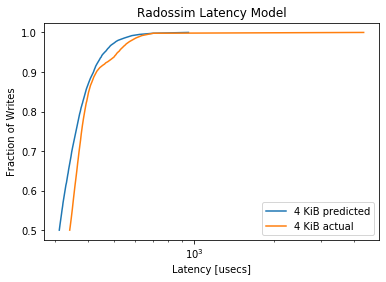

MainProcess pypet INFO     
 Finished single run #367 of 1680 

MainProcess pypet INFO     
 Starting single run #368 of 1680 



minimum predicted latency: 225.493869
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1093, pvalue=2.0744014768184268e-52)


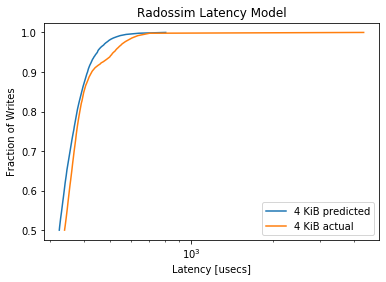

MainProcess pypet INFO     
 Finished single run #368 of 1680 

MainProcess pypet INFO     
 Starting single run #369 of 1680 



minimum predicted latency: 211.961628
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0983, pvalue=1.861629476080814e-42)


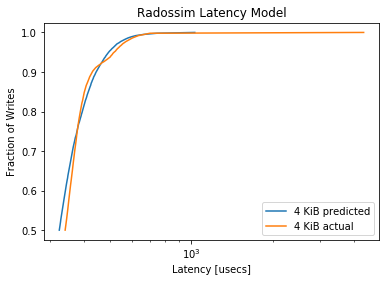

MainProcess pypet INFO     
 Finished single run #369 of 1680 

MainProcess pypet INFO     
 Starting single run #370 of 1680 



minimum predicted latency: 220.547610
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1301, pvalue=3.865665365452361e-74)


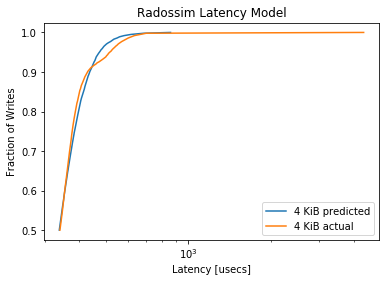

MainProcess pypet INFO     
 Finished single run #370 of 1680 

MainProcess pypet INFO     
 Starting single run #371 of 1680 



minimum predicted latency: 207.420488
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0922, pvalue=2.146443285936436e-37)


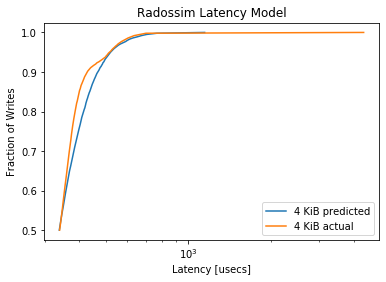

MainProcess pypet INFO     
 Finished single run #371 of 1680 

MainProcess pypet INFO     
 Starting single run #372 of 1680 



minimum predicted latency: 225.408289
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1922, pvalue=7.490893058442336e-162)


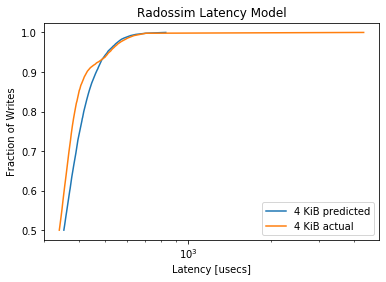

MainProcess pypet INFO     
 Finished single run #372 of 1680 

MainProcess pypet INFO     
 Starting single run #373 of 1680 



minimum predicted latency: 212.565819
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1621, pvalue=4.8386157177326225e-115)


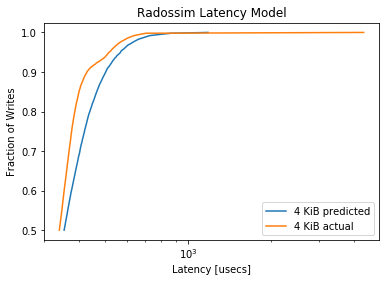

MainProcess pypet INFO     
 Finished single run #373 of 1680 

MainProcess pypet INFO     
 Starting single run #374 of 1680 



minimum predicted latency: 228.217157
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.244, pvalue=1.3306163228373026e-261)


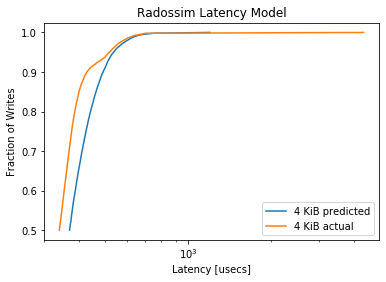

MainProcess pypet INFO     
 Finished single run #374 of 1680 

MainProcess pypet INFO     
 Starting single run #375 of 1680 



minimum predicted latency: 210.080740
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2368, pvalue=2.868520196949364e-246)


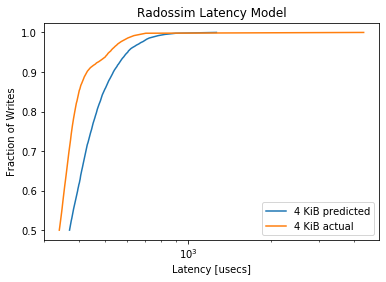

MainProcess pypet INFO     
 Finished single run #375 of 1680 

MainProcess pypet INFO     
 Starting single run #376 of 1680 



minimum predicted latency: 226.361453
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3128, pvalue=1e-323)


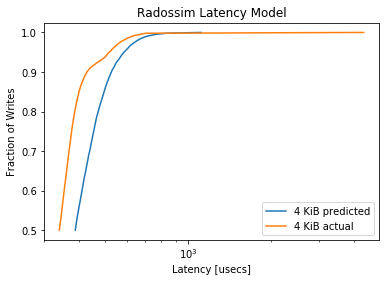

MainProcess pypet INFO     
 Finished single run #376 of 1680 

MainProcess pypet INFO     
 Starting single run #377 of 1680 



minimum predicted latency: 224.999665
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3097, pvalue=1e-323)


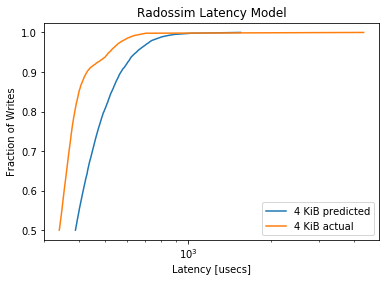

MainProcess pypet INFO     
 Finished single run #377 of 1680 

MainProcess pypet INFO     
 Starting single run #378 of 1680 



minimum predicted latency: 243.800127
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4216, pvalue=0.0)


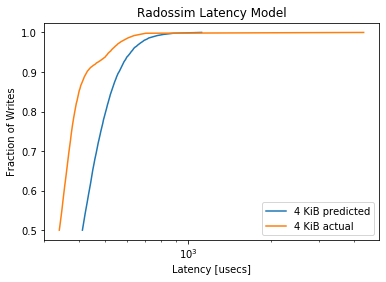

MainProcess pypet INFO     
 Finished single run #378 of 1680 

MainProcess pypet INFO     
 Starting single run #379 of 1680 



minimum predicted latency: 221.474903
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3866, pvalue=0.0)


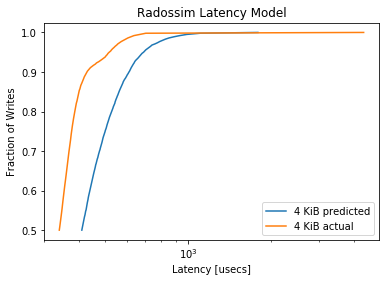

MainProcess pypet INFO     
 Finished single run #379 of 1680 

MainProcess pypet INFO     
 Starting single run #380 of 1680 



minimum predicted latency: 210.103469
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4136, pvalue=0.0)


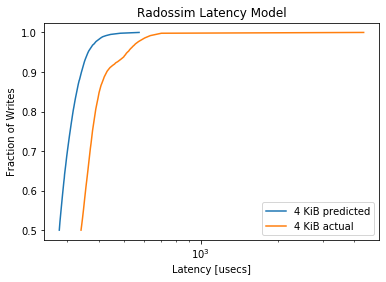

MainProcess pypet INFO     
 Finished single run #380 of 1680 

MainProcess pypet INFO     
 Starting single run #381 of 1680 



minimum predicted latency: 203.641930
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3674, pvalue=0.0)


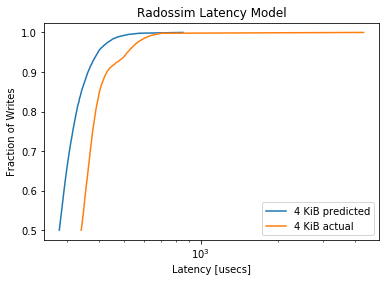

MainProcess pypet INFO     
 Finished single run #381 of 1680 

MainProcess pypet INFO     
 Starting single run #382 of 1680 



minimum predicted latency: 212.331140
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3624, pvalue=0.0)


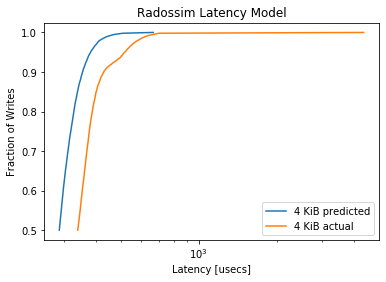

MainProcess pypet INFO     
 Finished single run #382 of 1680 

MainProcess pypet INFO     
 Starting single run #383 of 1680 



minimum predicted latency: 206.487863
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3133, pvalue=1e-323)


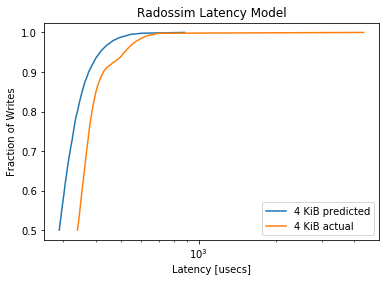

MainProcess pypet INFO     
 Finished single run #383 of 1680 

MainProcess pypet INFO     
 Starting single run #384 of 1680 



minimum predicted latency: 215.452717
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2838, pvalue=1e-323)


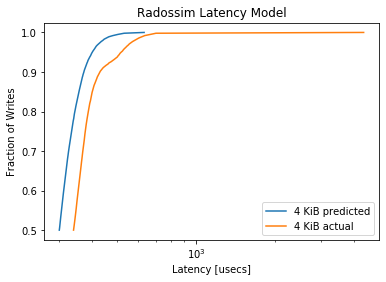

MainProcess pypet INFO     
 Finished single run #384 of 1680 

MainProcess pypet INFO     
 Starting single run #385 of 1680 



minimum predicted latency: 202.874951
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2413, pvalue=8.514588771749293e-256)


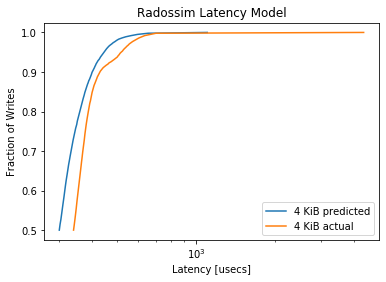

MainProcess pypet INFO     
 Finished single run #385 of 1680 

MainProcess pypet INFO     
 Starting single run #386 of 1680 



minimum predicted latency: 215.703558
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2077, pvalue=3.874518072653485e-189)


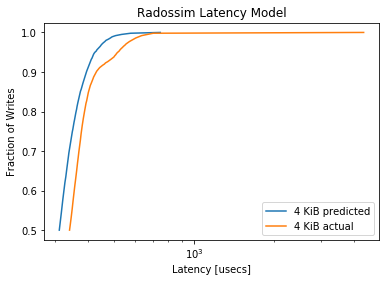

MainProcess pypet INFO     
 Finished single run #386 of 1680 

MainProcess pypet INFO     
 Starting single run #387 of 1680 



minimum predicted latency: 211.735622
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1767, pvalue=9.86353874534622e-137)


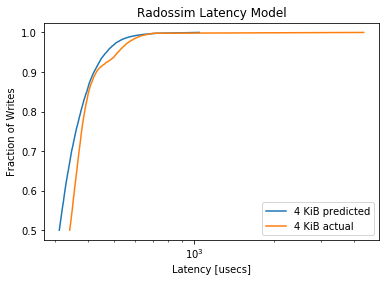

MainProcess pypet INFO     
 Finished single run #387 of 1680 

MainProcess pypet INFO     
 Starting single run #388 of 1680 



minimum predicted latency: 213.250199
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1142, pvalue=3.475359116533949e-57)


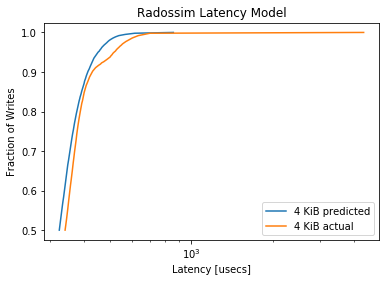

MainProcess pypet INFO     
 Finished single run #388 of 1680 

MainProcess pypet INFO     
 Starting single run #389 of 1680 



minimum predicted latency: 210.293631
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0869, pvalue=2.917748636524854e-33)


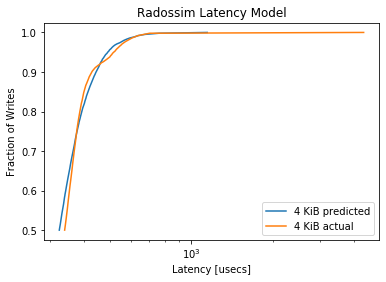

MainProcess pypet INFO     
 Finished single run #389 of 1680 

MainProcess pypet INFO     
 Starting single run #390 of 1680 



minimum predicted latency: 224.479816
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1278, pvalue=1.505295545597952e-71)


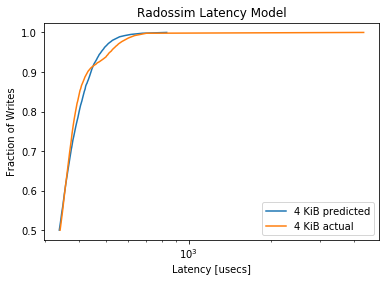

MainProcess pypet INFO     
 Finished single run #390 of 1680 

MainProcess pypet INFO     
 Starting single run #391 of 1680 



minimum predicted latency: 210.768101
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0909, pvalue=2.3351850663424812e-36)


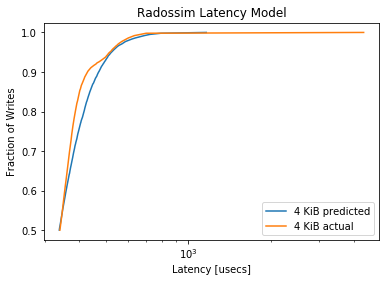

MainProcess pypet INFO     
 Finished single run #391 of 1680 

MainProcess pypet INFO     
 Starting single run #392 of 1680 



minimum predicted latency: 225.505611
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1911, pvalue=5.351564619716922e-160)


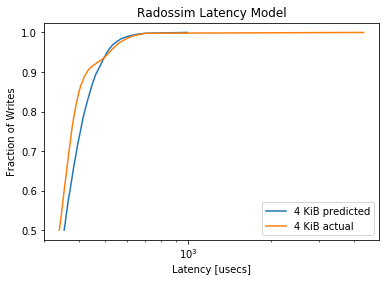

MainProcess pypet INFO     
 Finished single run #392 of 1680 

MainProcess pypet INFO     
 Starting single run #393 of 1680 



minimum predicted latency: 214.709750
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1706, pvalue=1.942842673251215e-127)


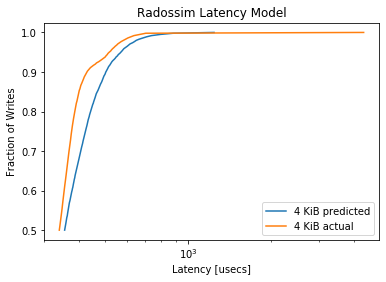

MainProcess pypet INFO     
 Finished single run #393 of 1680 

MainProcess pypet INFO     
 Starting single run #394 of 1680 



minimum predicted latency: 228.672368
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2465, pvalue=4.875254557808692e-267)


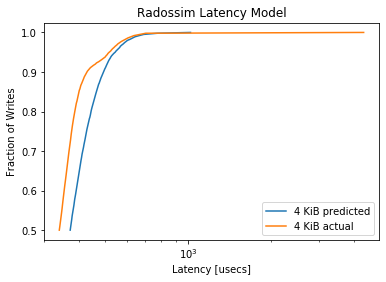

MainProcess pypet INFO     
 Finished single run #394 of 1680 

MainProcess pypet INFO     
 Starting single run #395 of 1680 



minimum predicted latency: 217.191476
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2337, pvalue=8.177584049556318e-240)


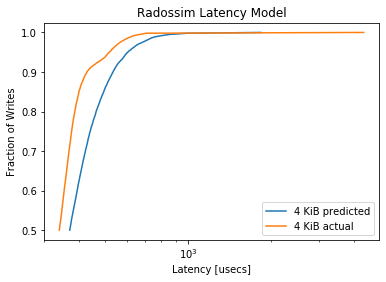

MainProcess pypet INFO     
 Finished single run #395 of 1680 

MainProcess pypet INFO     
 Starting single run #396 of 1680 



minimum predicted latency: 237.736717
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3238, pvalue=1e-323)


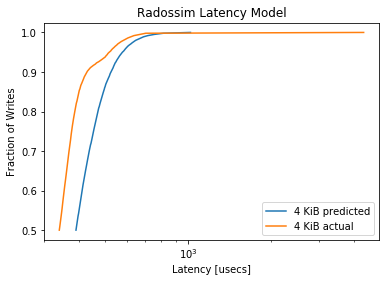

MainProcess pypet INFO     
 Finished single run #396 of 1680 

MainProcess pypet INFO     
 Starting single run #397 of 1680 



minimum predicted latency: 216.395621
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.32, pvalue=1e-323)


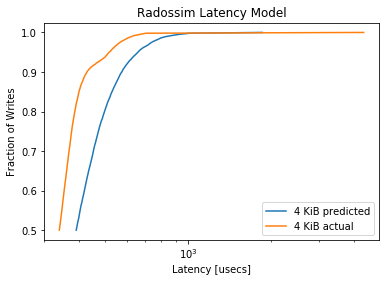

MainProcess pypet INFO     
 Finished single run #397 of 1680 

MainProcess pypet INFO     
 Starting single run #398 of 1680 



minimum predicted latency: 241.264463
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4164, pvalue=0.0)


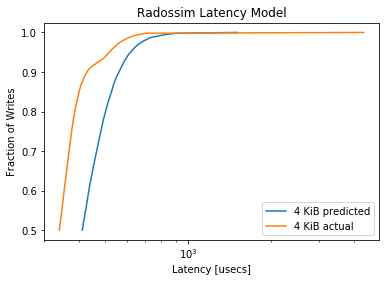

MainProcess pypet INFO     
 Finished single run #398 of 1680 

MainProcess pypet INFO     
 Starting single run #399 of 1680 



minimum predicted latency: 223.044811
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3925, pvalue=0.0)


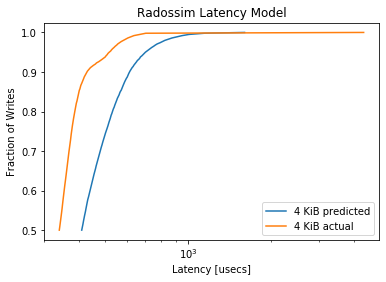

MainProcess pypet INFO     
 Finished single run #399 of 1680 

MainProcess pypet INFO     
 Starting single run #400 of 1680 



minimum predicted latency: 206.629951
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4197, pvalue=0.0)


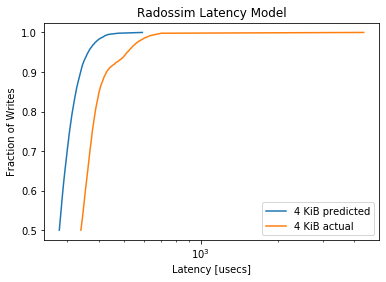

MainProcess pypet INFO     
 Finished single run #400 of 1680 

MainProcess pypet INFO     
 Starting single run #401 of 1680 



minimum predicted latency: 203.859062
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3601, pvalue=0.0)


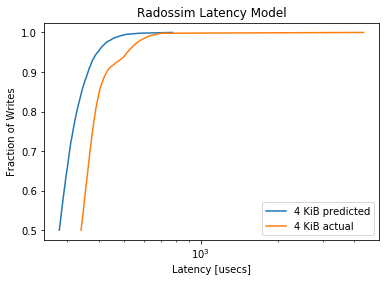

MainProcess pypet INFO     
 Finished single run #401 of 1680 

MainProcess pypet INFO     
 Starting single run #402 of 1680 



minimum predicted latency: 213.633159
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3525, pvalue=0.0)


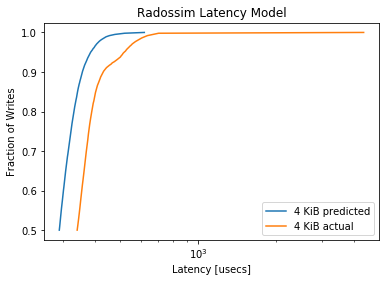

MainProcess pypet INFO     
 Finished single run #402 of 1680 

MainProcess pypet INFO     
 Starting single run #403 of 1680 



minimum predicted latency: 208.077835
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3109, pvalue=1e-323)


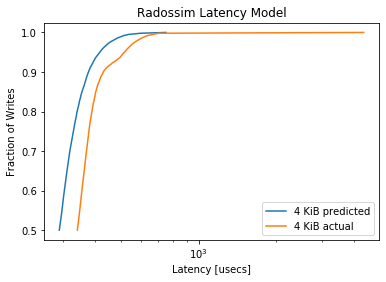

MainProcess pypet INFO     
 Finished single run #403 of 1680 

MainProcess pypet INFO     
 Starting single run #404 of 1680 



minimum predicted latency: 218.290281
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2879, pvalue=1e-323)


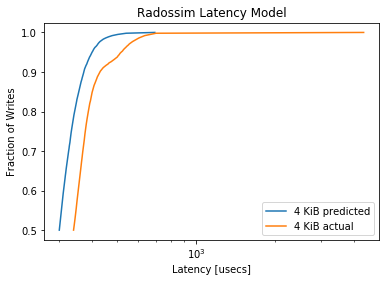

MainProcess pypet INFO     
 Finished single run #404 of 1680 

MainProcess pypet INFO     
 Starting single run #405 of 1680 



minimum predicted latency: 206.535597
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2481, pvalue=1.5086739567182236e-270)


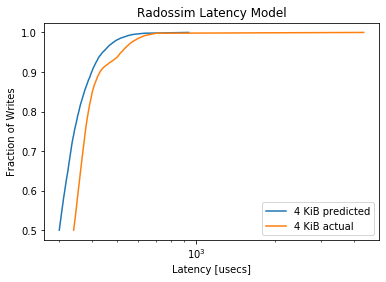

MainProcess pypet INFO     
 Finished single run #405 of 1680 

MainProcess pypet INFO     
 Starting single run #406 of 1680 



minimum predicted latency: 213.427258
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2094, pvalue=2.904547486620701e-192)


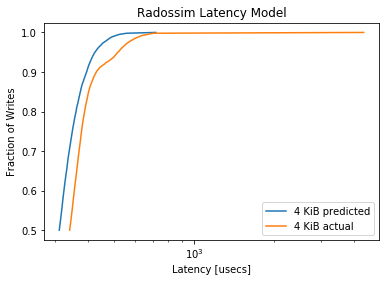

MainProcess pypet INFO     
 Finished single run #406 of 1680 

MainProcess pypet INFO     
 Starting single run #407 of 1680 



minimum predicted latency: 205.948138
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1666, pvalue=1.5935985715067937e-121)


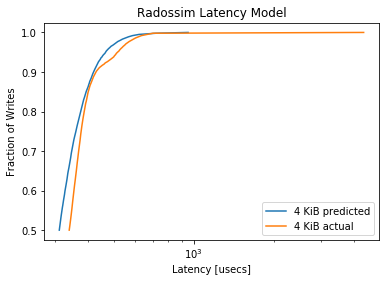

MainProcess pypet INFO     
 Finished single run #407 of 1680 

MainProcess pypet INFO     
 Starting single run #408 of 1680 



minimum predicted latency: 217.483134
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1056, pvalue=6.071701046141015e-49)


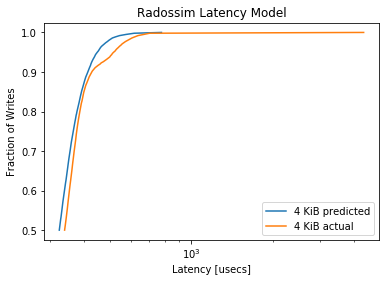

MainProcess pypet INFO     
 Finished single run #408 of 1680 

MainProcess pypet INFO     
 Starting single run #409 of 1680 



minimum predicted latency: 216.497719
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0816, pvalue=2.2518759573503394e-29)


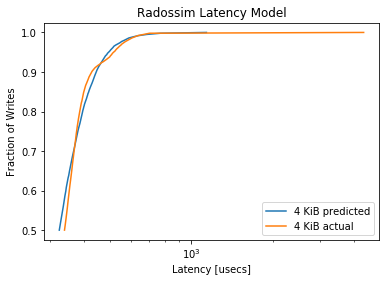

MainProcess pypet INFO     
 Finished single run #409 of 1680 

MainProcess pypet INFO     
 Starting single run #410 of 1680 



minimum predicted latency: 223.974231
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1282, pvalue=5.376181436992945e-72)


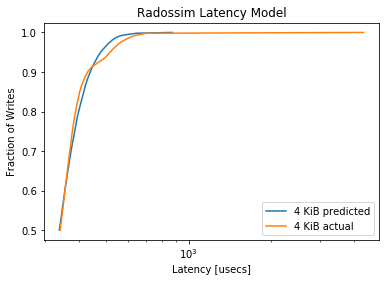

MainProcess pypet INFO     
 Finished single run #410 of 1680 

MainProcess pypet INFO     
 Starting single run #411 of 1680 



minimum predicted latency: 214.467317
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0903, pvalue=6.946415820112171e-36)


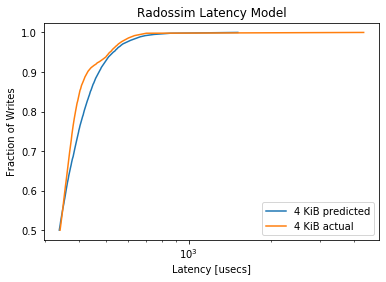

MainProcess pypet INFO     
 Finished single run #411 of 1680 

MainProcess pypet INFO     
 Starting single run #412 of 1680 



minimum predicted latency: 227.939264
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1889, pvalue=2.533125796328862e-156)


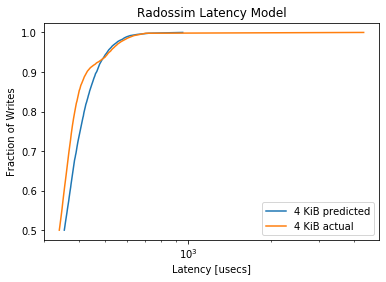

MainProcess pypet INFO     
 Finished single run #412 of 1680 

MainProcess pypet INFO     
 Starting single run #413 of 1680 



minimum predicted latency: 208.990304
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1532, pvalue=9.412799147824342e-103)


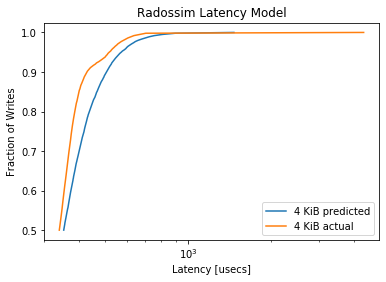

MainProcess pypet INFO     
 Finished single run #413 of 1680 

MainProcess pypet INFO     
 Starting single run #414 of 1680 



minimum predicted latency: 229.998801
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2428, pvalue=5.1624121156963856e-259)


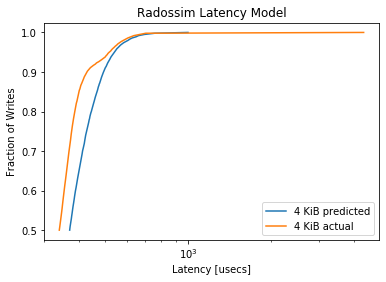

MainProcess pypet INFO     
 Finished single run #414 of 1680 

MainProcess pypet INFO     
 Starting single run #415 of 1680 



minimum predicted latency: 215.083568
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2329, pvalue=3.6650975617016064e-238)


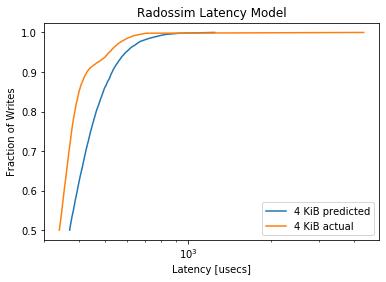

MainProcess pypet INFO     
 Finished single run #415 of 1680 

MainProcess pypet INFO     
 Starting single run #416 of 1680 



minimum predicted latency: 230.205636
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.325, pvalue=1e-323)


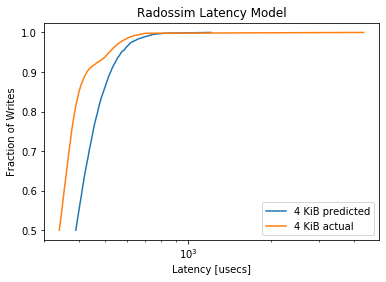

MainProcess pypet INFO     
 Finished single run #416 of 1680 

MainProcess pypet INFO     
 Starting single run #417 of 1680 



minimum predicted latency: 219.658149
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3162, pvalue=1e-323)


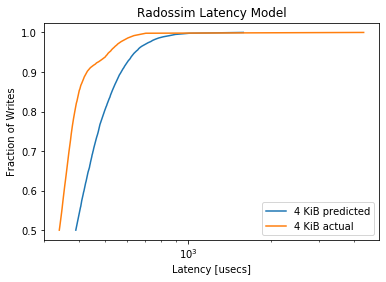

MainProcess pypet INFO     
 Finished single run #417 of 1680 

MainProcess pypet INFO     
 Starting single run #418 of 1680 



minimum predicted latency: 244.272920
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4116, pvalue=0.0)


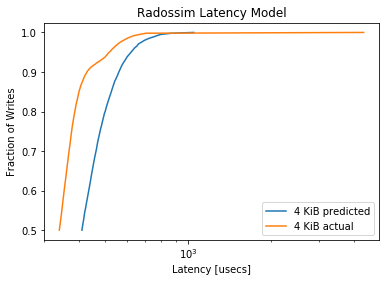

MainProcess pypet INFO     
 Finished single run #418 of 1680 

MainProcess pypet INFO     
 Starting single run #419 of 1680 



minimum predicted latency: 224.397825
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3976, pvalue=0.0)


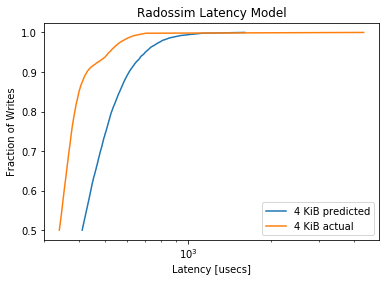

MainProcess pypet INFO     
 Finished single run #419 of 1680 

MainProcess pypet INFO     PROGRESS: Finished  420/1680 runs [=====               ] 25.0%, remaining: 0:08:53
MainProcess pypet INFO     
 Starting single run #420 of 1680 



minimum predicted latency: 210.024771
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4273, pvalue=0.0)


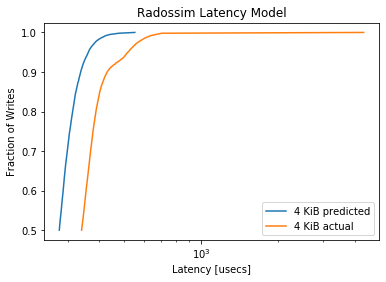

MainProcess pypet INFO     
 Finished single run #420 of 1680 

MainProcess pypet INFO     
 Starting single run #421 of 1680 



minimum predicted latency: 199.976648
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3592, pvalue=0.0)


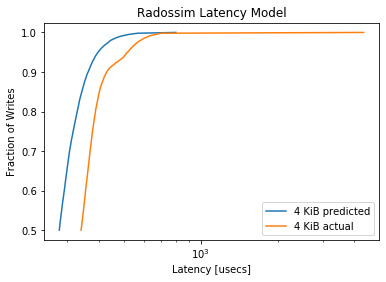

MainProcess pypet INFO     
 Finished single run #421 of 1680 

MainProcess pypet INFO     
 Starting single run #422 of 1680 



minimum predicted latency: 213.238984
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3635, pvalue=0.0)


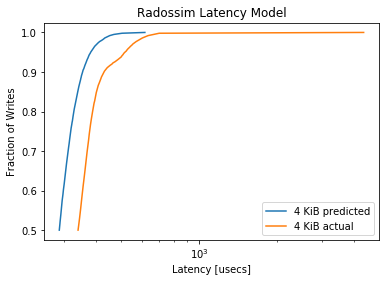

MainProcess pypet INFO     
 Finished single run #422 of 1680 

MainProcess pypet INFO     
 Starting single run #423 of 1680 



minimum predicted latency: 203.635693
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3099, pvalue=1e-323)


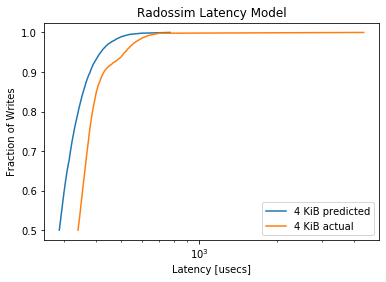

MainProcess pypet INFO     
 Finished single run #423 of 1680 

MainProcess pypet INFO     
 Starting single run #424 of 1680 



minimum predicted latency: 215.207600
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2908, pvalue=1e-323)


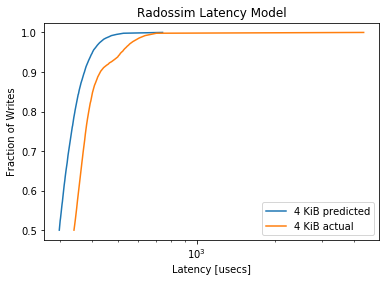

MainProcess pypet INFO     
 Finished single run #424 of 1680 

MainProcess pypet INFO     
 Starting single run #425 of 1680 



minimum predicted latency: 202.854976
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2456, pvalue=4.4836467994952966e-265)


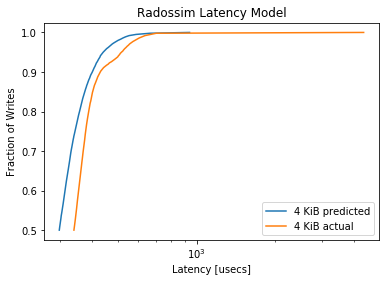

MainProcess pypet INFO     
 Finished single run #425 of 1680 

MainProcess pypet INFO     
 Starting single run #426 of 1680 



minimum predicted latency: 217.390379
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2171, pvalue=9.528071201348462e-207)


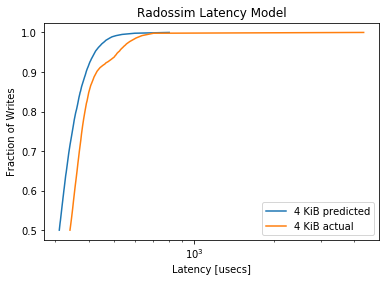

MainProcess pypet INFO     
 Finished single run #426 of 1680 

MainProcess pypet INFO     
 Starting single run #427 of 1680 



minimum predicted latency: 209.055033
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1813, pvalue=5.814855306609551e-144)


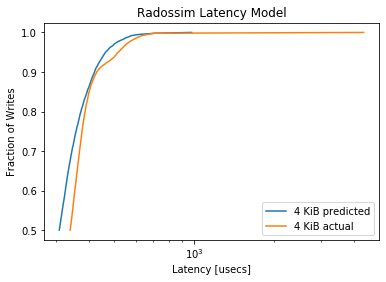

MainProcess pypet INFO     
 Finished single run #427 of 1680 

MainProcess pypet INFO     
 Starting single run #428 of 1680 



minimum predicted latency: 222.725474
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1168, pvalue=8.338063235579694e-60)


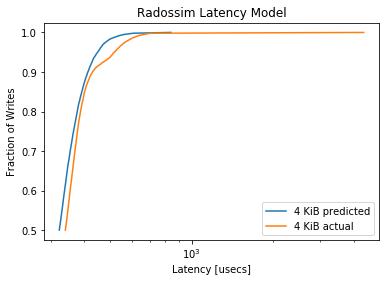

MainProcess pypet INFO     
 Finished single run #428 of 1680 

MainProcess pypet INFO     
 Starting single run #429 of 1680 



minimum predicted latency: 207.385690
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0973, pvalue=1.324507656019873e-41)


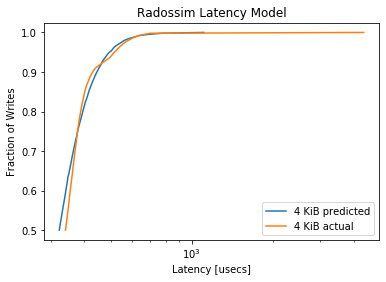

MainProcess pypet INFO     
 Finished single run #429 of 1680 

MainProcess pypet INFO     
 Starting single run #430 of 1680 



minimum predicted latency: 221.788341
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1161, pvalue=4.2883117996909605e-59)


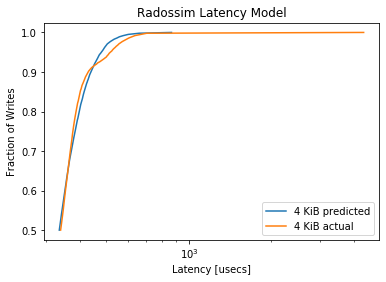

MainProcess pypet INFO     
 Finished single run #430 of 1680 

MainProcess pypet INFO     
 Starting single run #431 of 1680 



minimum predicted latency: 206.513892
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0824, pvalue=6.046394483866949e-30)


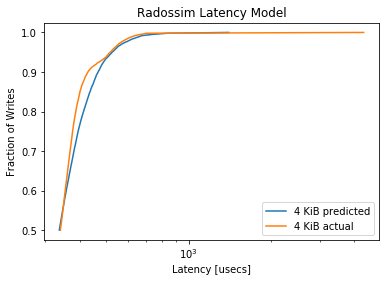

MainProcess pypet INFO     
 Finished single run #431 of 1680 

MainProcess pypet INFO     
 Starting single run #432 of 1680 



minimum predicted latency: 230.074911
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1772, pvalue=1.6497321299211134e-137)


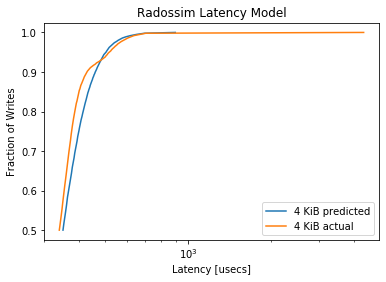

MainProcess pypet INFO     
 Finished single run #432 of 1680 

MainProcess pypet INFO     
 Starting single run #433 of 1680 



minimum predicted latency: 217.454060
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1534, pvalue=5.073491787801503e-103)


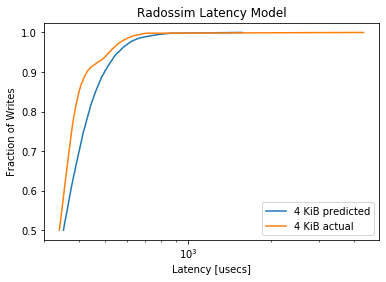

MainProcess pypet INFO     
 Finished single run #433 of 1680 

MainProcess pypet INFO     
 Starting single run #434 of 1680 



minimum predicted latency: 223.865576
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2391, pvalue=4.086540918791131e-251)


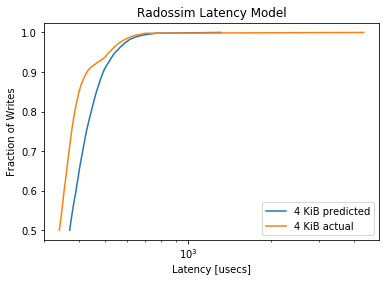

MainProcess pypet INFO     
 Finished single run #434 of 1680 

MainProcess pypet INFO     
 Starting single run #435 of 1680 



minimum predicted latency: 219.931874
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2325, pvalue=2.4412463443705523e-237)


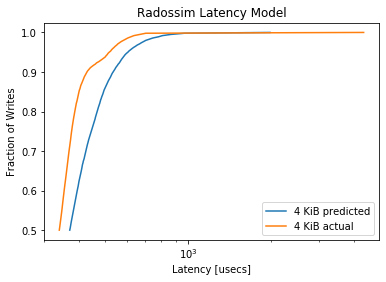

MainProcess pypet INFO     
 Finished single run #435 of 1680 

MainProcess pypet INFO     
 Starting single run #436 of 1680 



minimum predicted latency: 226.083518
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3102, pvalue=1e-323)


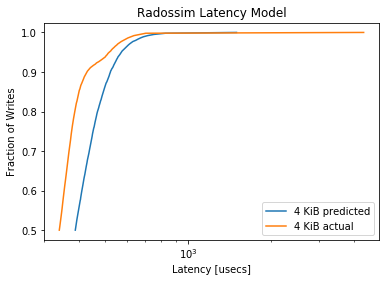

MainProcess pypet INFO     
 Finished single run #436 of 1680 

MainProcess pypet INFO     
 Starting single run #437 of 1680 



minimum predicted latency: 211.643288
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.308, pvalue=1e-323)


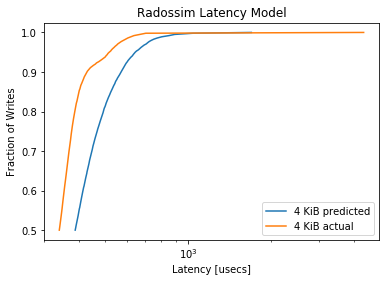

MainProcess pypet INFO     
 Finished single run #437 of 1680 

MainProcess pypet INFO     
 Starting single run #438 of 1680 



minimum predicted latency: 238.862834
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4088, pvalue=0.0)


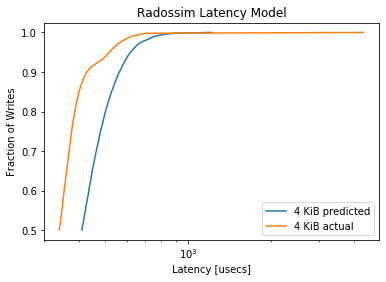

MainProcess pypet INFO     
 Finished single run #438 of 1680 

MainProcess pypet INFO     
 Starting single run #439 of 1680 



minimum predicted latency: 216.430488
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3929, pvalue=0.0)


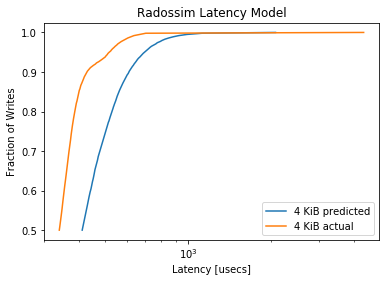

MainProcess pypet INFO     
 Finished single run #439 of 1680 

MainProcess pypet INFO     
 Starting single run #440 of 1680 



minimum predicted latency: 203.933208
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.425, pvalue=0.0)


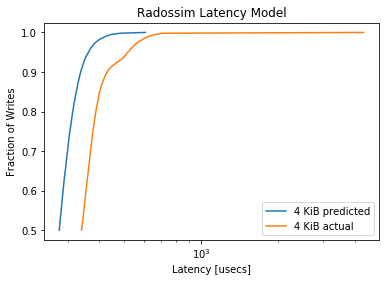

MainProcess pypet INFO     
 Finished single run #440 of 1680 

MainProcess pypet INFO     
 Starting single run #441 of 1680 



minimum predicted latency: 203.165592
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3632, pvalue=0.0)


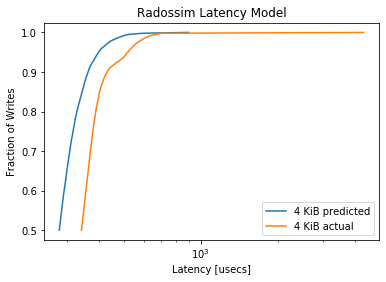

MainProcess pypet INFO     
 Finished single run #441 of 1680 

MainProcess pypet INFO     
 Starting single run #442 of 1680 



minimum predicted latency: 210.715665
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3555, pvalue=0.0)


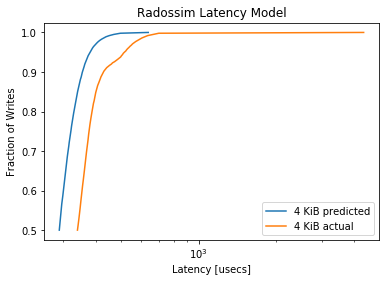

MainProcess pypet INFO     
 Finished single run #442 of 1680 

MainProcess pypet INFO     
 Starting single run #443 of 1680 



minimum predicted latency: 203.181407
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3104, pvalue=1e-323)


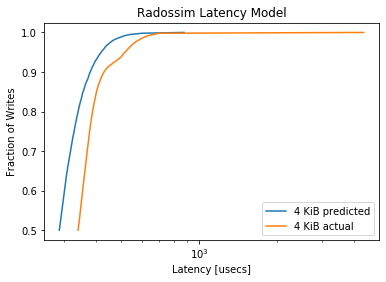

MainProcess pypet INFO     
 Finished single run #443 of 1680 

MainProcess pypet INFO     
 Starting single run #444 of 1680 



minimum predicted latency: 213.727157
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2926, pvalue=1e-323)


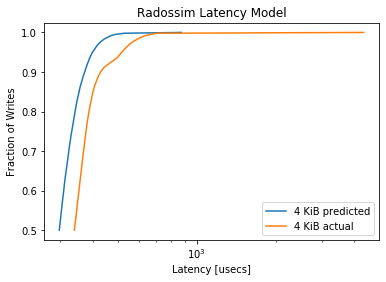

MainProcess pypet INFO     
 Finished single run #444 of 1680 

MainProcess pypet INFO     
 Starting single run #445 of 1680 



minimum predicted latency: 207.672655
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2495, pvalue=1.2258398361829145e-273)


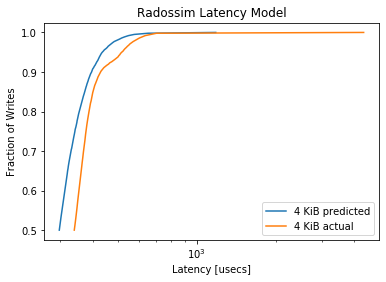

MainProcess pypet INFO     
 Finished single run #445 of 1680 

MainProcess pypet INFO     
 Starting single run #446 of 1680 



minimum predicted latency: 216.503812
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2077, pvalue=3.874518072653485e-189)


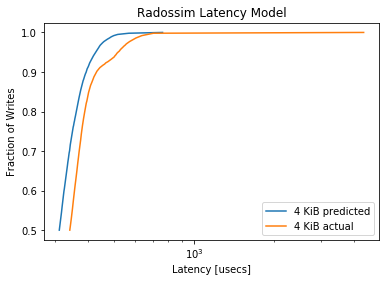

MainProcess pypet INFO     
 Finished single run #446 of 1680 

MainProcess pypet INFO     
 Starting single run #447 of 1680 



minimum predicted latency: 208.811048
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1691, pvalue=3.3337133237429686e-125)


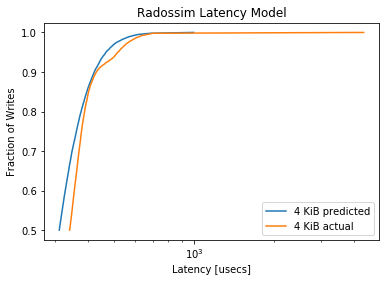

MainProcess pypet INFO     
 Finished single run #447 of 1680 

MainProcess pypet INFO     
 Starting single run #448 of 1680 



minimum predicted latency: 225.553818
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1104, pvalue=1.8328791440187334e-53)


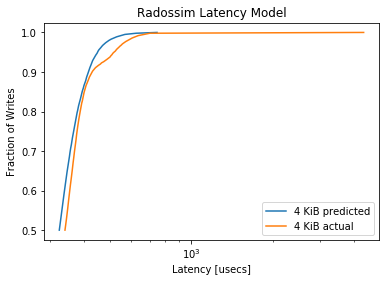

MainProcess pypet INFO     
 Finished single run #448 of 1680 

MainProcess pypet INFO     
 Starting single run #449 of 1680 



minimum predicted latency: 203.568377
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0903, pvalue=6.946415820112171e-36)


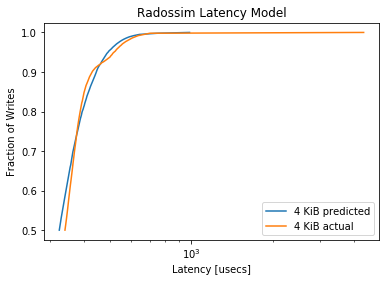

MainProcess pypet INFO     
 Finished single run #449 of 1680 

MainProcess pypet INFO     
 Starting single run #450 of 1680 



minimum predicted latency: 214.459227
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1218, pvalue=5.192679227584594e-65)


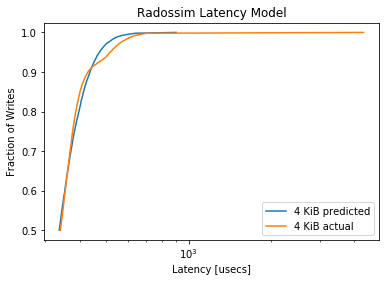

MainProcess pypet INFO     
 Finished single run #450 of 1680 

MainProcess pypet INFO     
 Starting single run #451 of 1680 



minimum predicted latency: 216.727940
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0883, pvalue=2.495321207956586e-34)


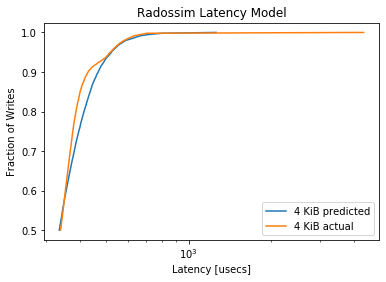

MainProcess pypet INFO     
 Finished single run #451 of 1680 

MainProcess pypet INFO     
 Starting single run #452 of 1680 



minimum predicted latency: 222.502697
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1831, pvalue=7.654135182749848e-147)


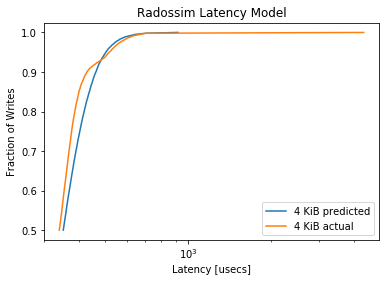

MainProcess pypet INFO     
 Finished single run #452 of 1680 

MainProcess pypet INFO     
 Starting single run #453 of 1680 



minimum predicted latency: 214.662661
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1578, pvalue=5.130881849372382e-109)


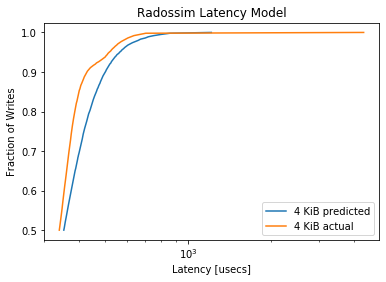

MainProcess pypet INFO     
 Finished single run #453 of 1680 

MainProcess pypet INFO     
 Starting single run #454 of 1680 



minimum predicted latency: 227.337698
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2346, pvalue=1.1161013333222865e-241)


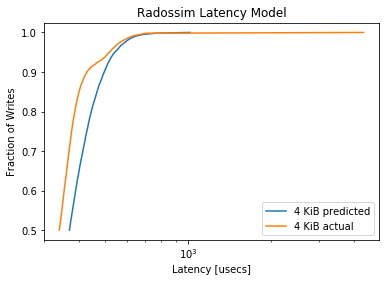

MainProcess pypet INFO     
 Finished single run #454 of 1680 

MainProcess pypet INFO     
 Starting single run #455 of 1680 



minimum predicted latency: 213.711094
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2351, pvalue=1.0195756567141838e-242)


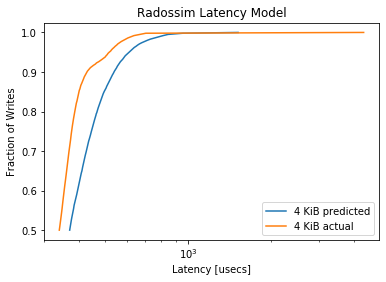

MainProcess pypet INFO     
 Finished single run #455 of 1680 

MainProcess pypet INFO     
 Starting single run #456 of 1680 



minimum predicted latency: 233.744338
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3099, pvalue=1e-323)


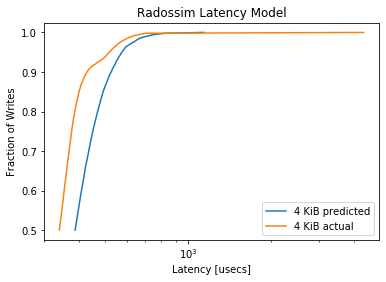

MainProcess pypet INFO     
 Finished single run #456 of 1680 

MainProcess pypet INFO     
 Starting single run #457 of 1680 



minimum predicted latency: 215.140660
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3105, pvalue=1e-323)


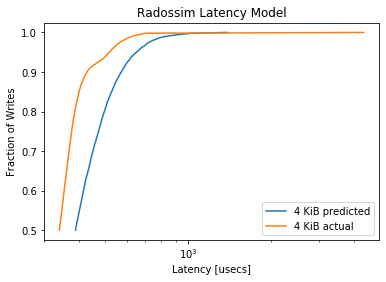

MainProcess pypet INFO     
 Finished single run #457 of 1680 

MainProcess pypet INFO     
 Starting single run #458 of 1680 



minimum predicted latency: 239.279959
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4185, pvalue=0.0)


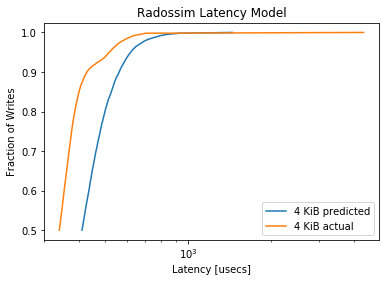

MainProcess pypet INFO     
 Finished single run #458 of 1680 

MainProcess pypet INFO     
 Starting single run #459 of 1680 



minimum predicted latency: 224.766889
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3975, pvalue=0.0)


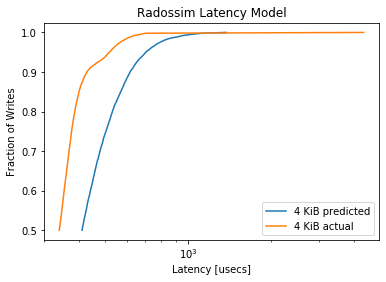

MainProcess pypet INFO     
 Finished single run #459 of 1680 

MainProcess pypet INFO     
 Starting single run #460 of 1680 



minimum predicted latency: 209.802098
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4148, pvalue=0.0)


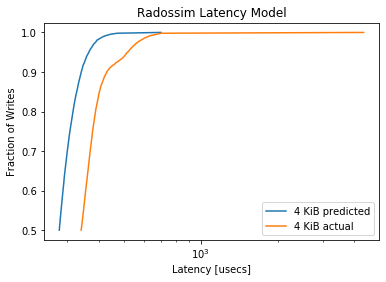

MainProcess pypet INFO     
 Finished single run #460 of 1680 

MainProcess pypet INFO     
 Starting single run #461 of 1680 



minimum predicted latency: 200.238223
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3693, pvalue=0.0)


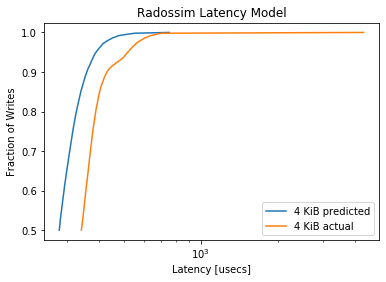

MainProcess pypet INFO     
 Finished single run #461 of 1680 

MainProcess pypet INFO     
 Starting single run #462 of 1680 



minimum predicted latency: 211.610352
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3666, pvalue=0.0)


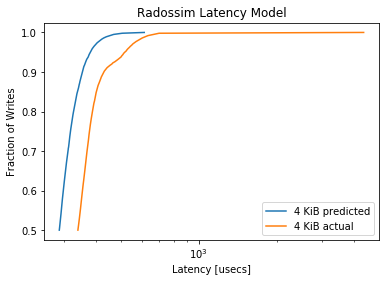

MainProcess pypet INFO     
 Finished single run #462 of 1680 

MainProcess pypet INFO     
 Starting single run #463 of 1680 



minimum predicted latency: 203.539356
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3093, pvalue=1e-323)


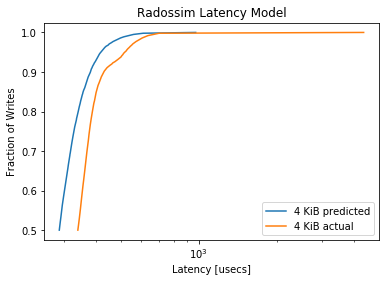

MainProcess pypet INFO     
 Finished single run #463 of 1680 

MainProcess pypet INFO     
 Starting single run #464 of 1680 



minimum predicted latency: 213.365454
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2888, pvalue=1e-323)


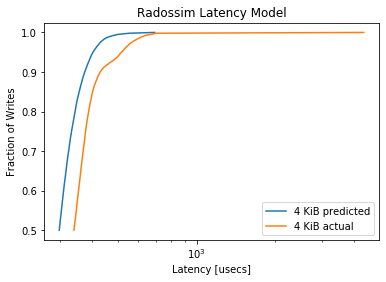

MainProcess pypet INFO     
 Finished single run #464 of 1680 

MainProcess pypet INFO     
 Starting single run #465 of 1680 



minimum predicted latency: 206.123494
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2442, pvalue=4.9123974860433625e-262)


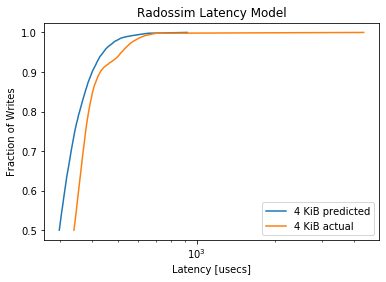

MainProcess pypet INFO     
 Finished single run #465 of 1680 

MainProcess pypet INFO     
 Starting single run #466 of 1680 



minimum predicted latency: 212.047554
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2137, pvalue=2.761148520262686e-200)


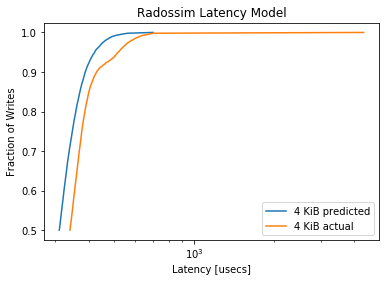

MainProcess pypet INFO     
 Finished single run #466 of 1680 

MainProcess pypet INFO     
 Starting single run #467 of 1680 



minimum predicted latency: 208.803323
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1694, pvalue=1.1957485480810113e-125)


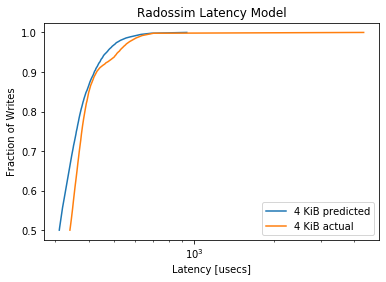

MainProcess pypet INFO     
 Finished single run #467 of 1680 

MainProcess pypet INFO     
 Starting single run #468 of 1680 



minimum predicted latency: 213.971035
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1174, pvalue=2.0324173441500688e-60)


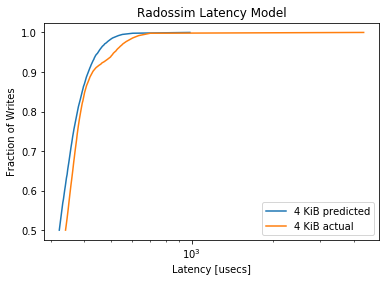

MainProcess pypet INFO     
 Finished single run #468 of 1680 

MainProcess pypet INFO     
 Starting single run #469 of 1680 



minimum predicted latency: 211.387383
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0986, pvalue=1.0292829299760363e-42)


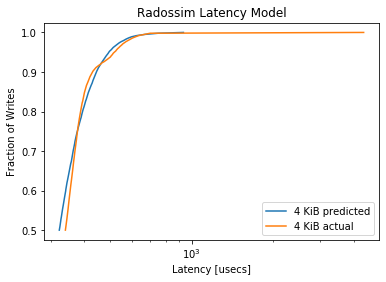

MainProcess pypet INFO     
 Finished single run #469 of 1680 

MainProcess pypet INFO     
 Starting single run #470 of 1680 



minimum predicted latency: 217.855637
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1281, pvalue=6.956540769830762e-72)


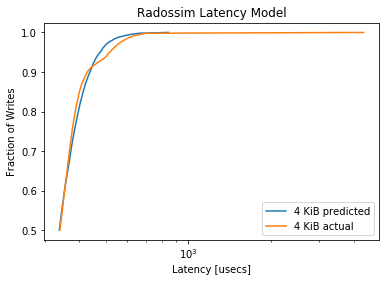

MainProcess pypet INFO     
 Finished single run #470 of 1680 

MainProcess pypet INFO     
 Starting single run #471 of 1680 



minimum predicted latency: 213.196717
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0881, pvalue=3.554160245950495e-34)


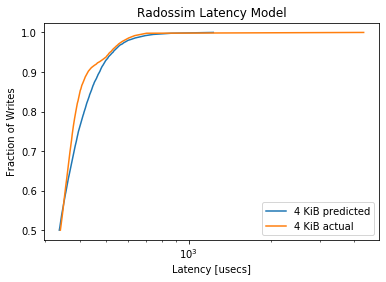

MainProcess pypet INFO     
 Finished single run #471 of 1680 

MainProcess pypet INFO     
 Starting single run #472 of 1680 



minimum predicted latency: 226.476763
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.187, pvalue=3.4881040410967845e-153)


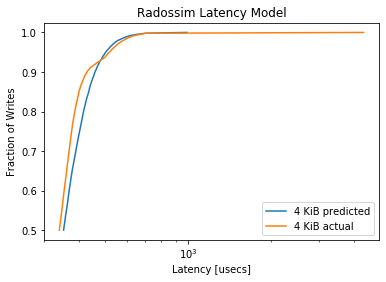

MainProcess pypet INFO     
 Finished single run #472 of 1680 

MainProcess pypet INFO     
 Starting single run #473 of 1680 



minimum predicted latency: 212.392898
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.16, pvalue=4.446140841067589e-112)


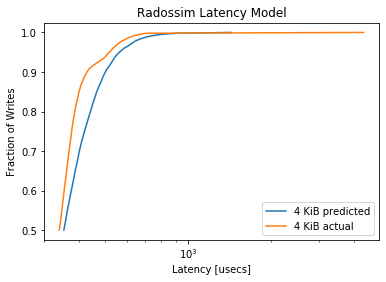

MainProcess pypet INFO     
 Finished single run #473 of 1680 

MainProcess pypet INFO     
 Starting single run #474 of 1680 



minimum predicted latency: 230.061747
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2359, pvalue=2.191714103594311e-244)


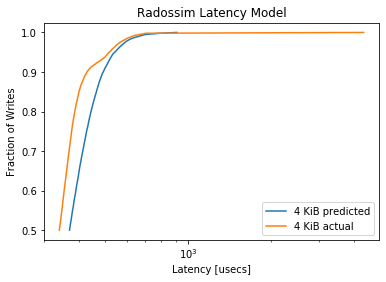

MainProcess pypet INFO     
 Finished single run #474 of 1680 

MainProcess pypet INFO     
 Starting single run #475 of 1680 



minimum predicted latency: 214.900896
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2319, pvalue=4.1700981288702795e-236)


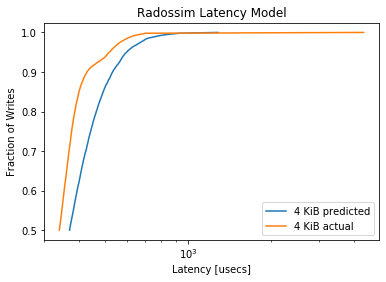

MainProcess pypet INFO     
 Finished single run #475 of 1680 

MainProcess pypet INFO     
 Starting single run #476 of 1680 



minimum predicted latency: 232.718731
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3089, pvalue=1e-323)


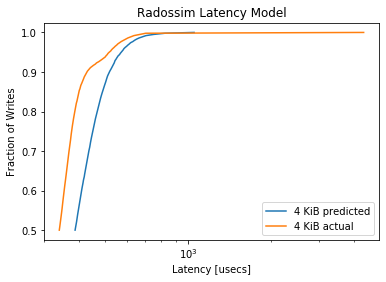

MainProcess pypet INFO     
 Finished single run #476 of 1680 

MainProcess pypet INFO     
 Starting single run #477 of 1680 



minimum predicted latency: 212.667236
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3137, pvalue=1e-323)


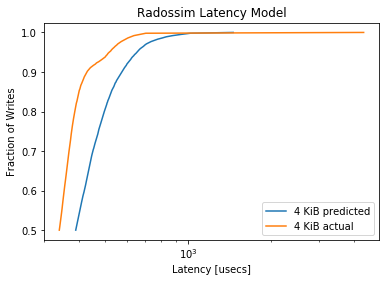

MainProcess pypet INFO     
 Finished single run #477 of 1680 

MainProcess pypet INFO     
 Starting single run #478 of 1680 



minimum predicted latency: 234.475752
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4117, pvalue=0.0)


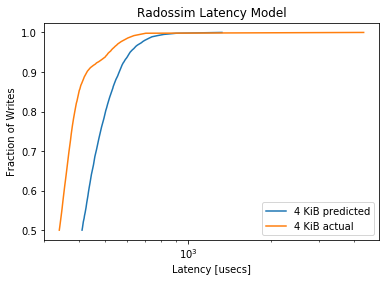

MainProcess pypet INFO     
 Finished single run #478 of 1680 

MainProcess pypet INFO     
 Starting single run #479 of 1680 



minimum predicted latency: 215.323558
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3835, pvalue=0.0)


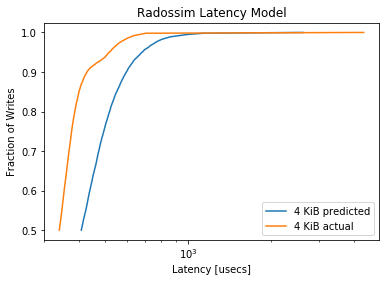

MainProcess pypet INFO     
 Finished single run #479 of 1680 

MainProcess pypet INFO     
 Starting single run #480 of 1680 



minimum predicted latency: 211.333188
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.42, pvalue=0.0)


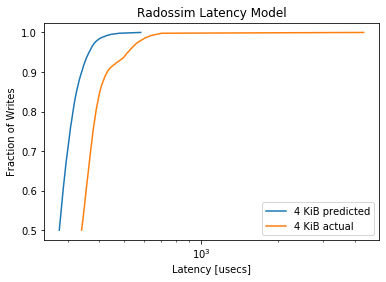

MainProcess pypet INFO     
 Finished single run #480 of 1680 

MainProcess pypet INFO     
 Starting single run #481 of 1680 



minimum predicted latency: 201.848856
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.375, pvalue=0.0)


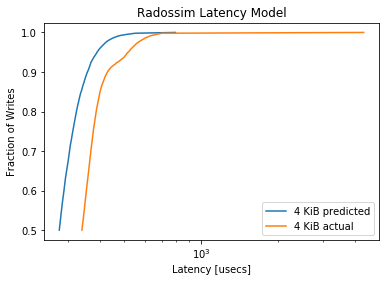

MainProcess pypet INFO     
 Finished single run #481 of 1680 

MainProcess pypet INFO     
 Starting single run #482 of 1680 



minimum predicted latency: 208.324836
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3699, pvalue=0.0)


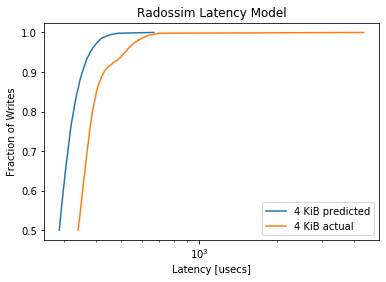

MainProcess pypet INFO     
 Finished single run #482 of 1680 

MainProcess pypet INFO     
 Starting single run #483 of 1680 



minimum predicted latency: 203.503478
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3144, pvalue=1e-323)


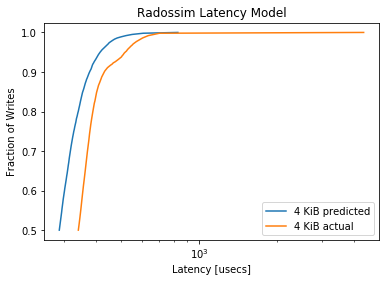

MainProcess pypet INFO     
 Finished single run #483 of 1680 

MainProcess pypet INFO     
 Starting single run #484 of 1680 



minimum predicted latency: 213.445671
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2992, pvalue=1e-323)


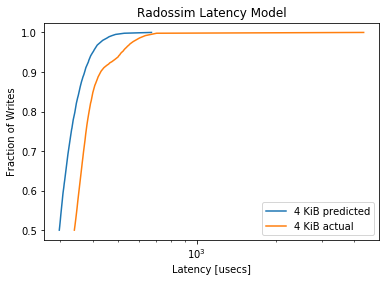

MainProcess pypet INFO     
 Finished single run #484 of 1680 

MainProcess pypet INFO     
 Starting single run #485 of 1680 



minimum predicted latency: 205.212835
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2538, pvalue=3.0455019299695864e-283)


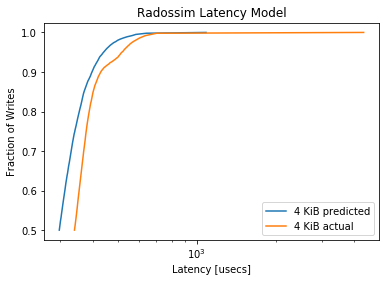

MainProcess pypet INFO     
 Finished single run #485 of 1680 

MainProcess pypet INFO     
 Starting single run #486 of 1680 



minimum predicted latency: 209.549467
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.221, pvalue=2.7343306263911727e-214)


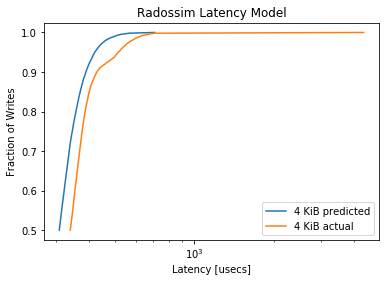

MainProcess pypet INFO     
 Finished single run #486 of 1680 

MainProcess pypet INFO     
 Starting single run #487 of 1680 



minimum predicted latency: 206.801953
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1823, pvalue=1.4715509980964205e-145)


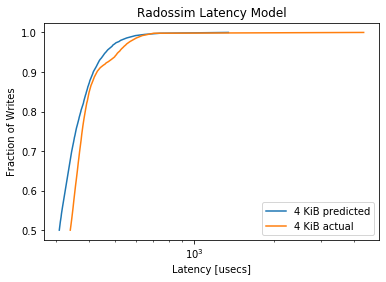

MainProcess pypet INFO     
 Finished single run #487 of 1680 

MainProcess pypet INFO     
 Starting single run #488 of 1680 



minimum predicted latency: 215.771213
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1298, pvalue=8.467439125406339e-74)


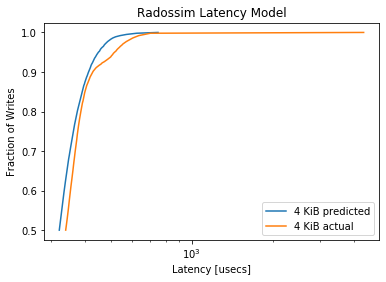

MainProcess pypet INFO     
 Finished single run #488 of 1680 

MainProcess pypet INFO     
 Starting single run #489 of 1680 



minimum predicted latency: 207.347118
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1076, pvalue=8.404445133463005e-51)


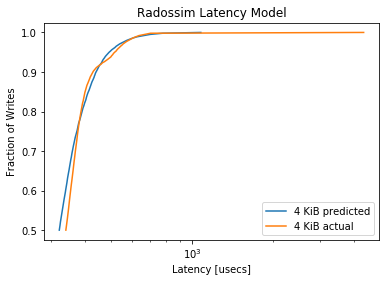

MainProcess pypet INFO     
 Finished single run #489 of 1680 

MainProcess pypet INFO     
 Starting single run #490 of 1680 



minimum predicted latency: 217.840722
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1161, pvalue=4.2883117996909605e-59)


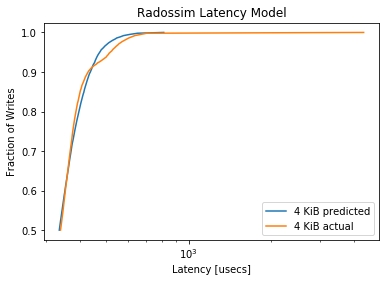

MainProcess pypet INFO     
 Finished single run #490 of 1680 

MainProcess pypet INFO     
 Starting single run #491 of 1680 



minimum predicted latency: 210.112251
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0933, pvalue=2.773523165873862e-38)


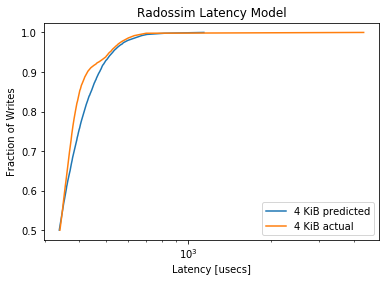

MainProcess pypet INFO     
 Finished single run #491 of 1680 

MainProcess pypet INFO     
 Starting single run #492 of 1680 



minimum predicted latency: 225.255342
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1783, pvalue=3.1692711313442197e-139)


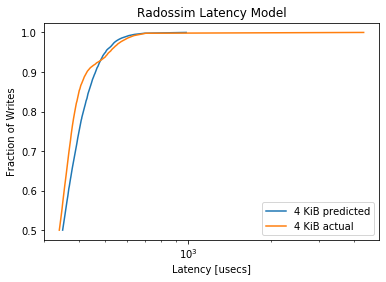

MainProcess pypet INFO     
 Finished single run #492 of 1680 

MainProcess pypet INFO     
 Starting single run #493 of 1680 



minimum predicted latency: 207.062104
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.151, pvalue=7.994166139352894e-100)


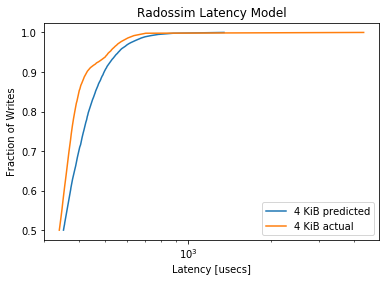

MainProcess pypet INFO     
 Finished single run #493 of 1680 

MainProcess pypet INFO     
 Starting single run #494 of 1680 



minimum predicted latency: 215.533622
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2312, pvalue=1.1322100259961776e-234)


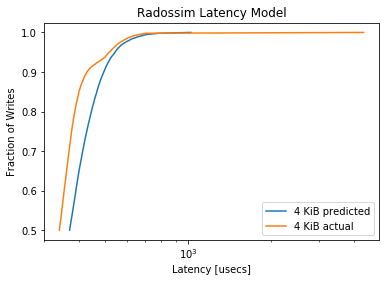

MainProcess pypet INFO     
 Finished single run #494 of 1680 

MainProcess pypet INFO     
 Starting single run #495 of 1680 



minimum predicted latency: 214.091093
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2236, pvalue=2.1458700492543286e-219)


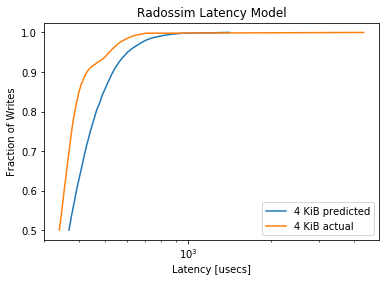

MainProcess pypet INFO     
 Finished single run #495 of 1680 

MainProcess pypet INFO     
 Starting single run #496 of 1680 



minimum predicted latency: 221.301281
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3182, pvalue=1e-323)


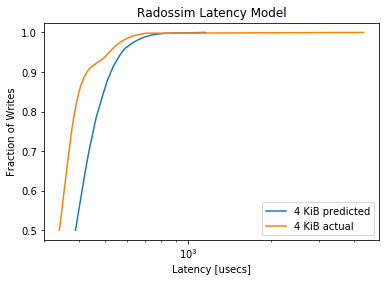

MainProcess pypet INFO     
 Finished single run #496 of 1680 

MainProcess pypet INFO     
 Starting single run #497 of 1680 



minimum predicted latency: 223.126189
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3011, pvalue=1e-323)


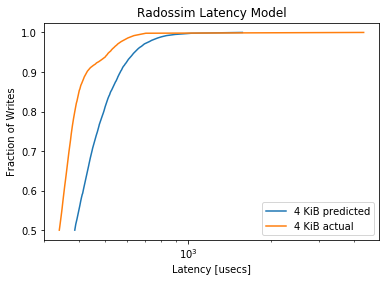

MainProcess pypet INFO     
 Finished single run #497 of 1680 

MainProcess pypet INFO     
 Starting single run #498 of 1680 



minimum predicted latency: 235.651747
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4076, pvalue=0.0)


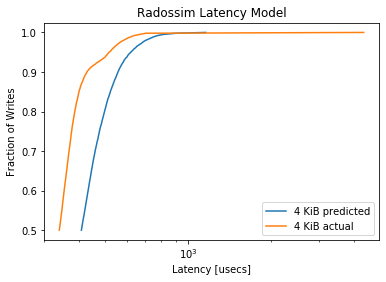

MainProcess pypet INFO     
 Finished single run #498 of 1680 

MainProcess pypet INFO     
 Starting single run #499 of 1680 



minimum predicted latency: 222.597390
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3891, pvalue=0.0)


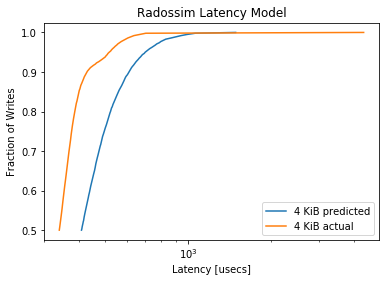

MainProcess pypet INFO     
 Finished single run #499 of 1680 

MainProcess pypet INFO     
 Starting single run #500 of 1680 



minimum predicted latency: 204.979254
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4233, pvalue=0.0)


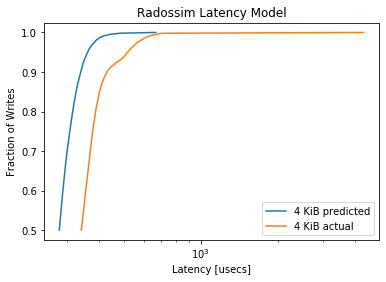

MainProcess pypet INFO     
 Finished single run #500 of 1680 

MainProcess pypet INFO     
 Starting single run #501 of 1680 



minimum predicted latency: 202.961922
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3708, pvalue=0.0)


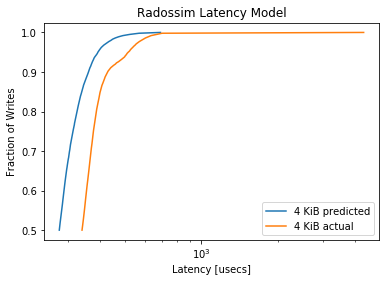

MainProcess pypet INFO     
 Finished single run #501 of 1680 

MainProcess pypet INFO     
 Starting single run #502 of 1680 



minimum predicted latency: 211.397586
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3738, pvalue=0.0)


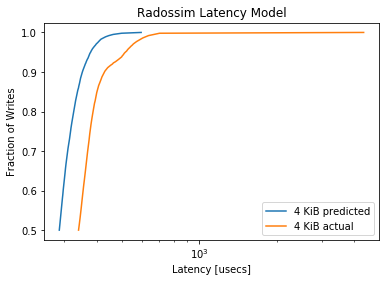

MainProcess pypet INFO     
 Finished single run #502 of 1680 

MainProcess pypet INFO     
 Starting single run #503 of 1680 



minimum predicted latency: 203.842131
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3168, pvalue=1e-323)


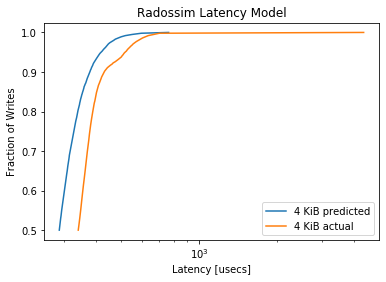

MainProcess pypet INFO     
 Finished single run #503 of 1680 

MainProcess pypet INFO     PROGRESS: Finished  504/1680 runs [======              ] 30.0%, remaining: 0:08:04
MainProcess pypet INFO     
 Starting single run #504 of 1680 



minimum predicted latency: 211.613652
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2918, pvalue=1e-323)


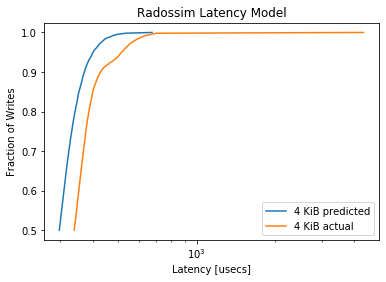

MainProcess pypet INFO     
 Finished single run #504 of 1680 

MainProcess pypet INFO     
 Starting single run #505 of 1680 



minimum predicted latency: 203.475727
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.256, pvalue=3.1859346290105348e-288)


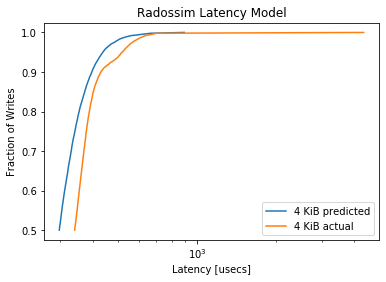

MainProcess pypet INFO     
 Finished single run #505 of 1680 

MainProcess pypet INFO     
 Starting single run #506 of 1680 



minimum predicted latency: 217.268044
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2089, pvalue=2.4263939580157533e-191)


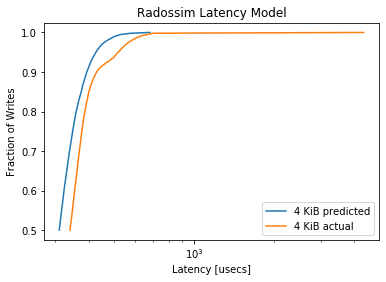

MainProcess pypet INFO     
 Finished single run #506 of 1680 

MainProcess pypet INFO     
 Starting single run #507 of 1680 



minimum predicted latency: 207.123810
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1833, pvalue=3.647772356433493e-147)


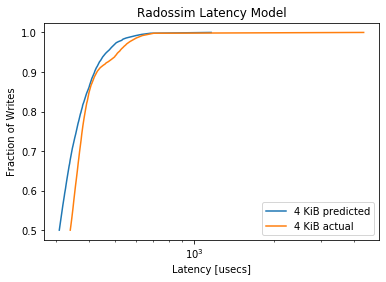

MainProcess pypet INFO     
 Finished single run #507 of 1680 

MainProcess pypet INFO     
 Starting single run #508 of 1680 



minimum predicted latency: 220.685904
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1241, pvalue=1.7651659466444193e-67)


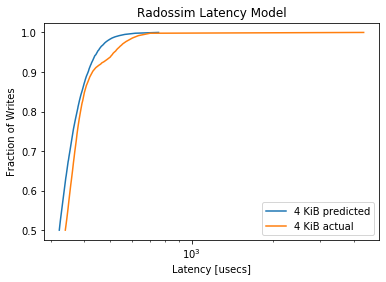

MainProcess pypet INFO     
 Finished single run #508 of 1680 

MainProcess pypet INFO     
 Starting single run #509 of 1680 



minimum predicted latency: 213.206522
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1078, pvalue=5.453759524020573e-51)


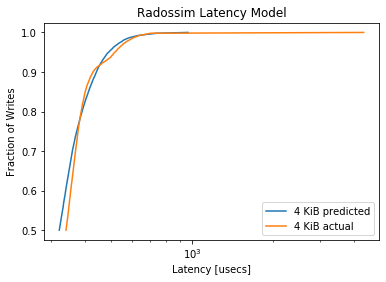

MainProcess pypet INFO     
 Finished single run #509 of 1680 

MainProcess pypet INFO     
 Starting single run #510 of 1680 



minimum predicted latency: 217.694045
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.116, pvalue=5.414236198682219e-59)


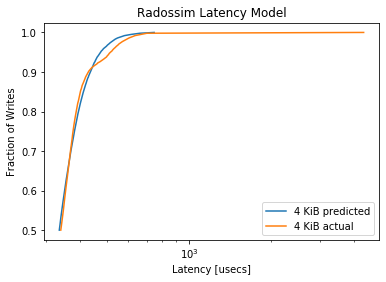

MainProcess pypet INFO     
 Finished single run #510 of 1680 

MainProcess pypet INFO     
 Starting single run #511 of 1680 



minimum predicted latency: 209.568961
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0872, pvalue=1.728429693391271e-33)


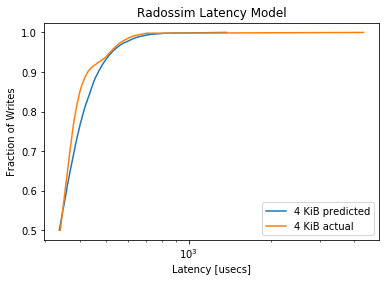

MainProcess pypet INFO     
 Finished single run #511 of 1680 

MainProcess pypet INFO     
 Starting single run #512 of 1680 



minimum predicted latency: 219.596046
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1771, pvalue=2.360025110393893e-137)


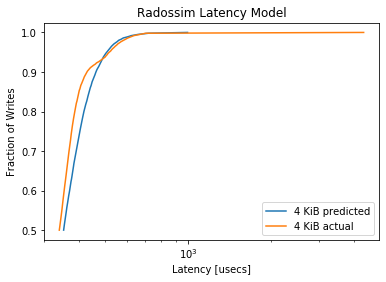

MainProcess pypet INFO     
 Finished single run #512 of 1680 

MainProcess pypet INFO     
 Starting single run #513 of 1680 



minimum predicted latency: 212.483713
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1512, pvalue=4.3478400503775873e-100)


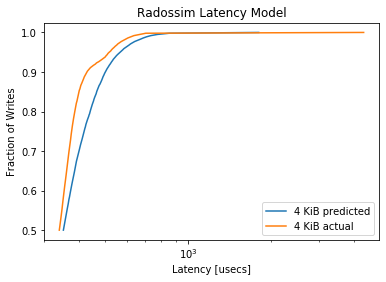

MainProcess pypet INFO     
 Finished single run #513 of 1680 

MainProcess pypet INFO     
 Starting single run #514 of 1680 



minimum predicted latency: 228.807340
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2351, pvalue=1.0195756567141838e-242)


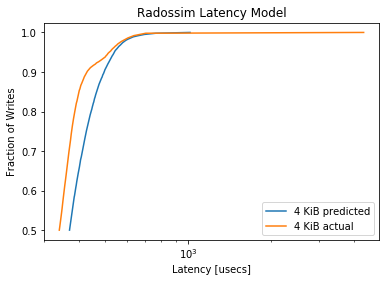

MainProcess pypet INFO     
 Finished single run #514 of 1680 

MainProcess pypet INFO     
 Starting single run #515 of 1680 



minimum predicted latency: 215.957661
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2319, pvalue=4.1700981288702795e-236)


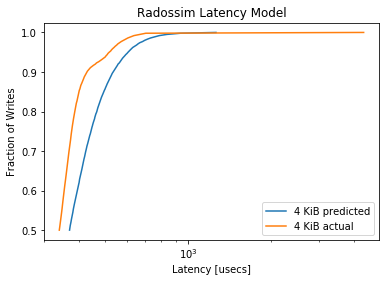

MainProcess pypet INFO     
 Finished single run #515 of 1680 

MainProcess pypet INFO     
 Starting single run #516 of 1680 



minimum predicted latency: 227.867525
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3071, pvalue=1e-323)


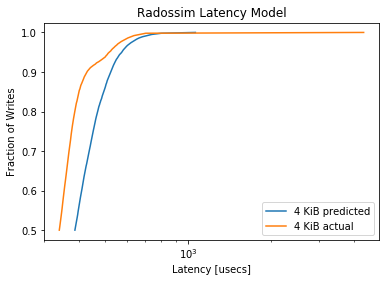

MainProcess pypet INFO     
 Finished single run #516 of 1680 

MainProcess pypet INFO     
 Starting single run #517 of 1680 



minimum predicted latency: 218.719895
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3008, pvalue=1e-323)


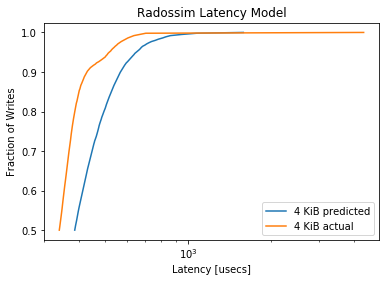

MainProcess pypet INFO     
 Finished single run #517 of 1680 

MainProcess pypet INFO     
 Starting single run #518 of 1680 



minimum predicted latency: 237.708351
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4033, pvalue=0.0)


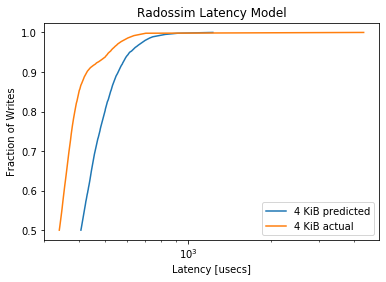

MainProcess pypet INFO     
 Finished single run #518 of 1680 

MainProcess pypet INFO     
 Starting single run #519 of 1680 



minimum predicted latency: 217.703576
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3831, pvalue=0.0)


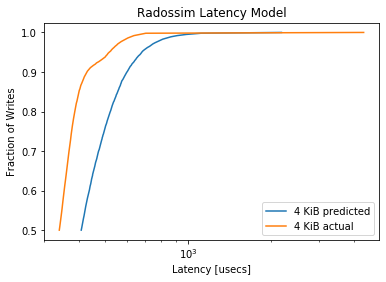

MainProcess pypet INFO     
 Finished single run #519 of 1680 

MainProcess pypet INFO     
 Starting single run #520 of 1680 



minimum predicted latency: 204.513991
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4334, pvalue=0.0)


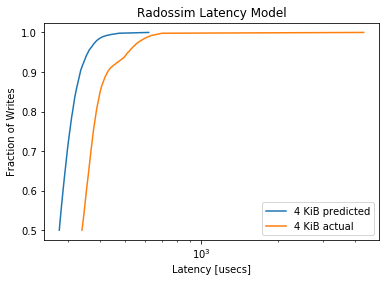

MainProcess pypet INFO     
 Finished single run #520 of 1680 

MainProcess pypet INFO     
 Starting single run #521 of 1680 



minimum predicted latency: 201.508188
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.372, pvalue=0.0)


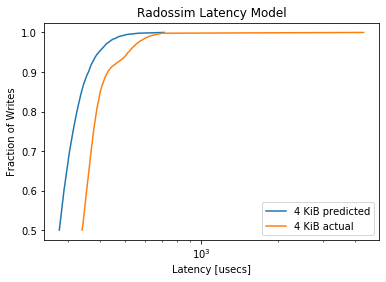

MainProcess pypet INFO     
 Finished single run #521 of 1680 

MainProcess pypet INFO     
 Starting single run #522 of 1680 



minimum predicted latency: 208.840781
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3684, pvalue=0.0)


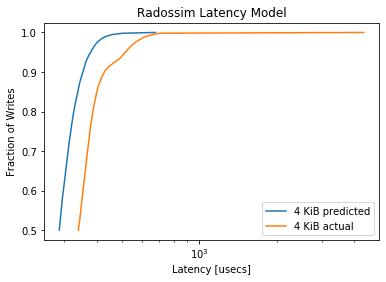

MainProcess pypet INFO     
 Finished single run #522 of 1680 

MainProcess pypet INFO     
 Starting single run #523 of 1680 



minimum predicted latency: 203.279449
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3192, pvalue=1e-323)


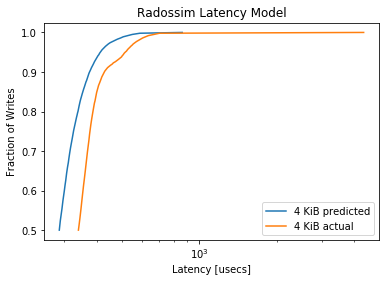

MainProcess pypet INFO     
 Finished single run #523 of 1680 

MainProcess pypet INFO     
 Starting single run #524 of 1680 



minimum predicted latency: 215.771295
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2987, pvalue=1e-323)


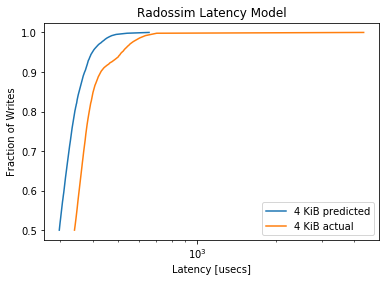

MainProcess pypet INFO     
 Finished single run #524 of 1680 

MainProcess pypet INFO     
 Starting single run #525 of 1680 



minimum predicted latency: 201.417443
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2544, pvalue=1.348404675438394e-284)


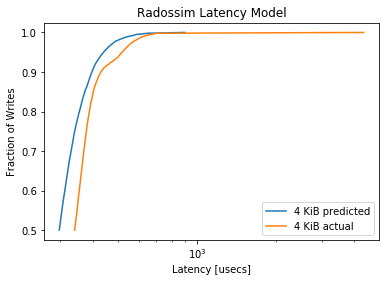

MainProcess pypet INFO     
 Finished single run #525 of 1680 

MainProcess pypet INFO     
 Starting single run #526 of 1680 



minimum predicted latency: 215.996153
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2206, pvalue=1.6473770970532808e-213)


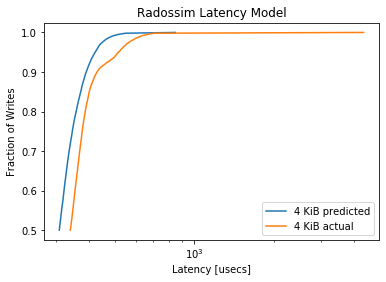

MainProcess pypet INFO     
 Finished single run #526 of 1680 

MainProcess pypet INFO     
 Starting single run #527 of 1680 



minimum predicted latency: 205.366053
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1841, pvalue=1.8662030577234562e-148)


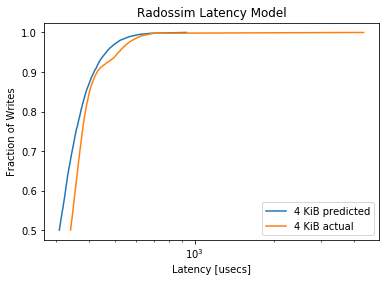

MainProcess pypet INFO     
 Finished single run #527 of 1680 

MainProcess pypet INFO     
 Starting single run #528 of 1680 



minimum predicted latency: 216.367371
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1373, pvalue=1.4992172019381947e-82)


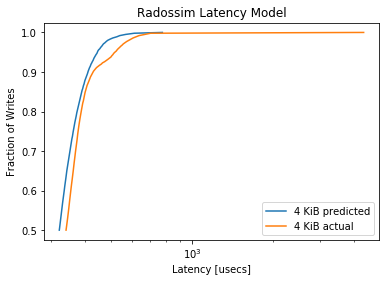

MainProcess pypet INFO     
 Finished single run #528 of 1680 

MainProcess pypet INFO     
 Starting single run #529 of 1680 



minimum predicted latency: 208.021176
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1098, pvalue=6.906057371123849e-53)


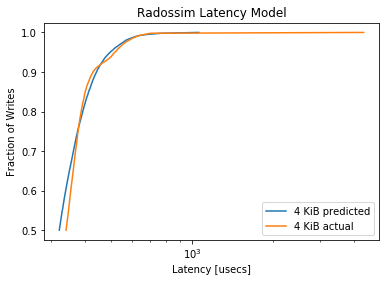

MainProcess pypet INFO     
 Finished single run #529 of 1680 

MainProcess pypet INFO     
 Starting single run #530 of 1680 



minimum predicted latency: 222.867877
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1151, pvalue=4.373541734564478e-58)


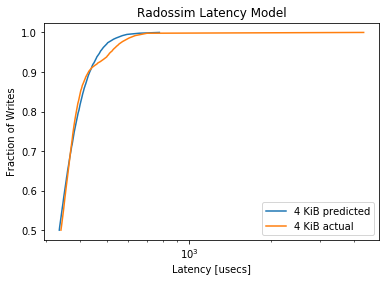

MainProcess pypet INFO     
 Finished single run #530 of 1680 

MainProcess pypet INFO     
 Starting single run #531 of 1680 



minimum predicted latency: 207.106100
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0767, pvalue=5.347305622662554e-26)


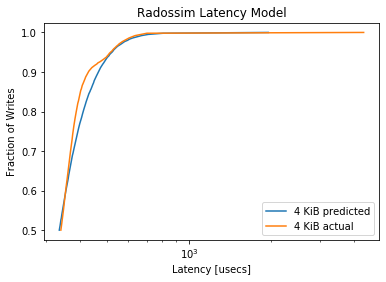

MainProcess pypet INFO     
 Finished single run #531 of 1680 

MainProcess pypet INFO     
 Starting single run #532 of 1680 



minimum predicted latency: 230.742384
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1783, pvalue=3.1692711313442197e-139)


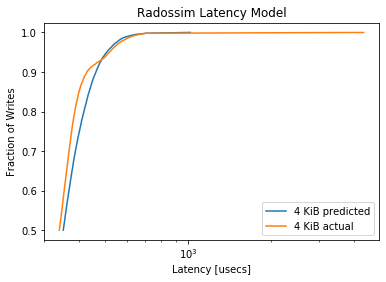

MainProcess pypet INFO     
 Finished single run #532 of 1680 

MainProcess pypet INFO     
 Starting single run #533 of 1680 



minimum predicted latency: 212.201344
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1432, pvalue=8.73300166062117e-90)


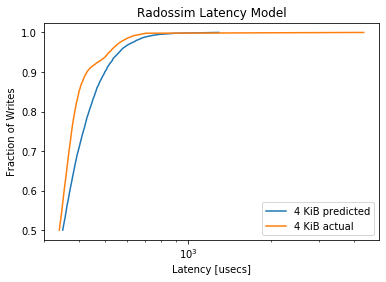

MainProcess pypet INFO     
 Finished single run #533 of 1680 

MainProcess pypet INFO     
 Starting single run #534 of 1680 



minimum predicted latency: 221.924870
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2227, pvalue=1.2758355687206396e-217)


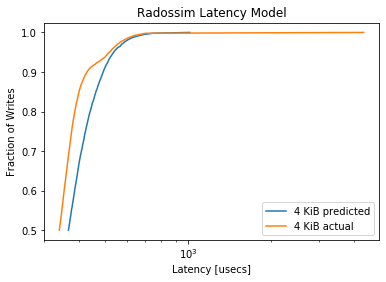

MainProcess pypet INFO     
 Finished single run #534 of 1680 

MainProcess pypet INFO     
 Starting single run #535 of 1680 



minimum predicted latency: 211.643133
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2239, pvalue=5.4772280776151526e-220)


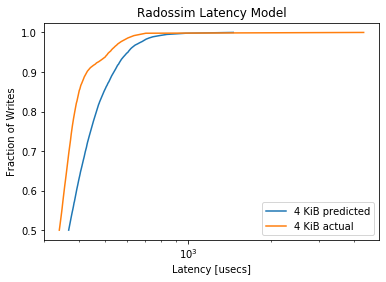

MainProcess pypet INFO     
 Finished single run #535 of 1680 

MainProcess pypet INFO     
 Starting single run #536 of 1680 



minimum predicted latency: 225.813655
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2998, pvalue=1e-323)


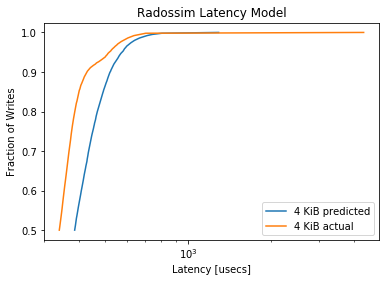

MainProcess pypet INFO     
 Finished single run #536 of 1680 

MainProcess pypet INFO     
 Starting single run #537 of 1680 



minimum predicted latency: 218.809336
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2974, pvalue=1e-323)


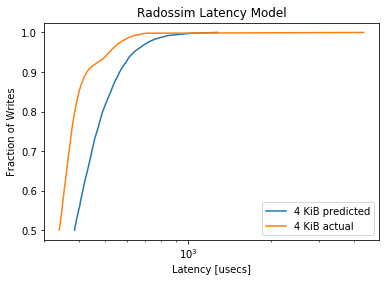

MainProcess pypet INFO     
 Finished single run #537 of 1680 

MainProcess pypet INFO     
 Starting single run #538 of 1680 



minimum predicted latency: 240.863111
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4055, pvalue=0.0)


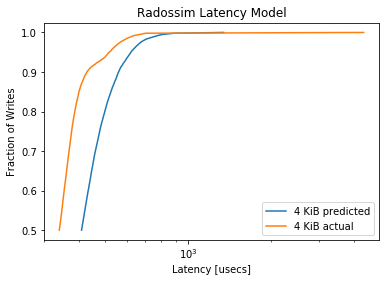

MainProcess pypet INFO     
 Finished single run #538 of 1680 

MainProcess pypet INFO     
 Starting single run #539 of 1680 



minimum predicted latency: 225.230255
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3673, pvalue=0.0)


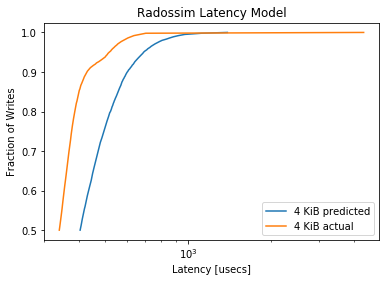

MainProcess pypet INFO     
 Finished single run #539 of 1680 

MainProcess pypet INFO     
 Starting single run #540 of 1680 



minimum predicted latency: 202.762928
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.428, pvalue=0.0)


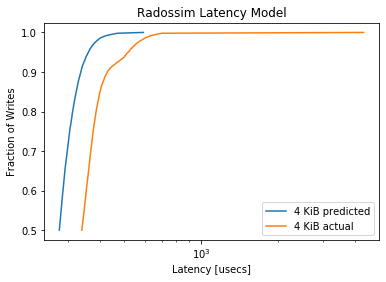

MainProcess pypet INFO     
 Finished single run #540 of 1680 

MainProcess pypet INFO     
 Starting single run #541 of 1680 



minimum predicted latency: 202.348270
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3737, pvalue=0.0)


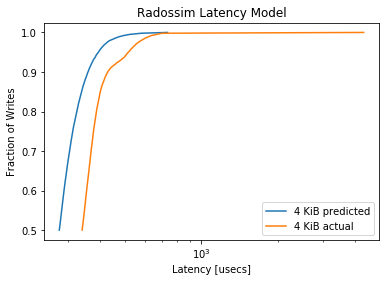

MainProcess pypet INFO     
 Finished single run #541 of 1680 

MainProcess pypet INFO     
 Starting single run #542 of 1680 



minimum predicted latency: 212.607588
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3692, pvalue=0.0)


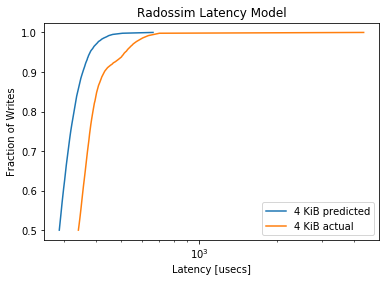

MainProcess pypet INFO     
 Finished single run #542 of 1680 

MainProcess pypet INFO     
 Starting single run #543 of 1680 



minimum predicted latency: 200.493759
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3159, pvalue=1e-323)


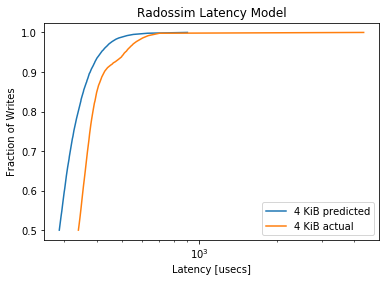

MainProcess pypet INFO     
 Finished single run #543 of 1680 

MainProcess pypet INFO     
 Starting single run #544 of 1680 



minimum predicted latency: 209.871216
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2954, pvalue=1e-323)


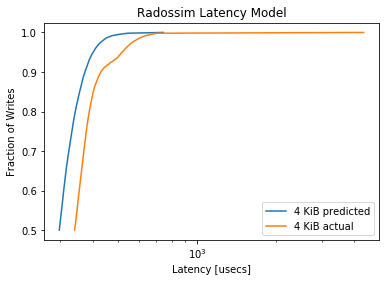

MainProcess pypet INFO     
 Finished single run #544 of 1680 

MainProcess pypet INFO     
 Starting single run #545 of 1680 



minimum predicted latency: 199.912997
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2603, pvalue=4.353459402528541e-298)


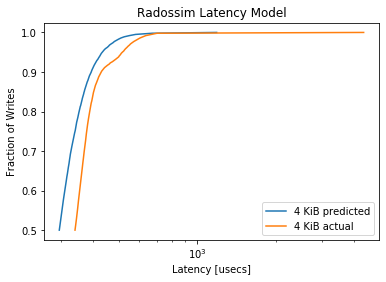

MainProcess pypet INFO     
 Finished single run #545 of 1680 

MainProcess pypet INFO     
 Starting single run #546 of 1680 



minimum predicted latency: 218.916615
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2242, pvalue=1.395388988361526e-220)


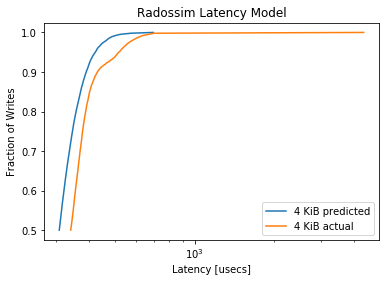

MainProcess pypet INFO     
 Finished single run #546 of 1680 

MainProcess pypet INFO     
 Starting single run #547 of 1680 



minimum predicted latency: 204.370174
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.183, pvalue=1.1083974705889038e-146)


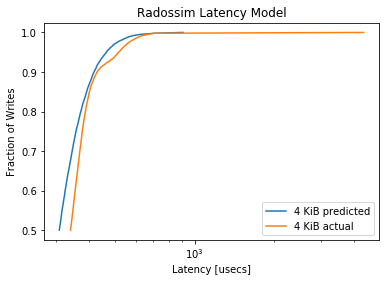

MainProcess pypet INFO     
 Finished single run #547 of 1680 

MainProcess pypet INFO     
 Starting single run #548 of 1680 



minimum predicted latency: 218.052486
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1277, pvalue=1.946202357360278e-71)


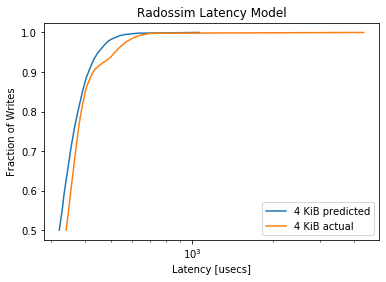

MainProcess pypet INFO     
 Finished single run #548 of 1680 

MainProcess pypet INFO     
 Starting single run #549 of 1680 



minimum predicted latency: 206.131166
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1047, pvalue=4.0579598844332145e-48)


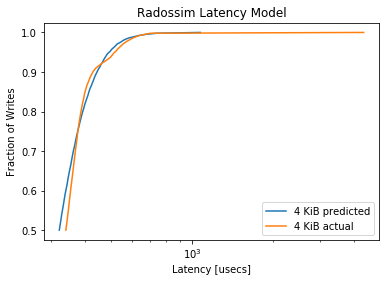

MainProcess pypet INFO     
 Finished single run #549 of 1680 

MainProcess pypet INFO     
 Starting single run #550 of 1680 



minimum predicted latency: 214.028447
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1106, pvalue=1.175975636161241e-53)


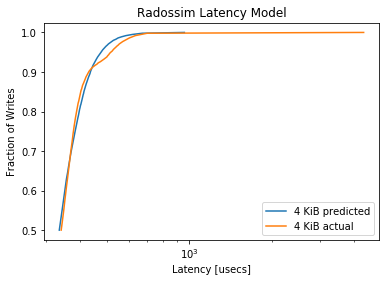

MainProcess pypet INFO     
 Finished single run #550 of 1680 

MainProcess pypet INFO     
 Starting single run #551 of 1680 



minimum predicted latency: 210.912237
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0814, pvalue=3.1219940048185115e-29)


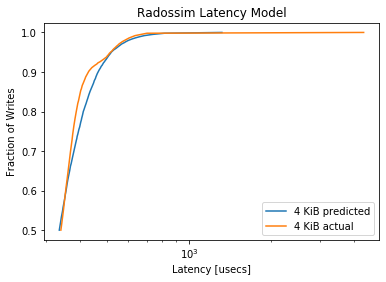

MainProcess pypet INFO     
 Finished single run #551 of 1680 

MainProcess pypet INFO     
 Starting single run #552 of 1680 



minimum predicted latency: 226.537245
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1761, pvalue=8.37562860087861e-136)


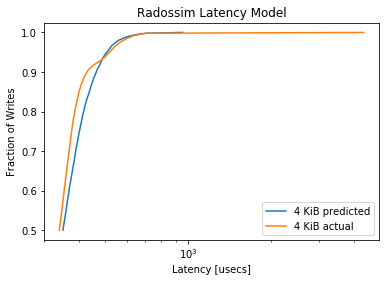

MainProcess pypet INFO     
 Finished single run #552 of 1680 

MainProcess pypet INFO     
 Starting single run #553 of 1680 



minimum predicted latency: 207.054829
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1462, pvalue=1.3936599565868847e-93)


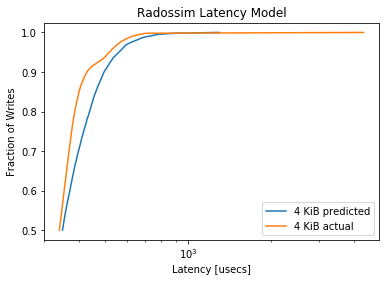

MainProcess pypet INFO     
 Finished single run #553 of 1680 

MainProcess pypet INFO     
 Starting single run #554 of 1680 



minimum predicted latency: 229.570334
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2325, pvalue=2.4412463443705523e-237)


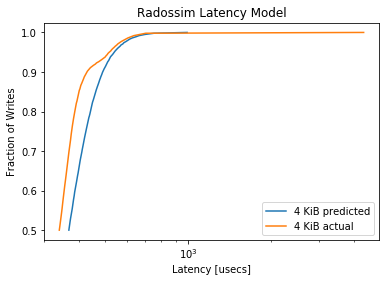

MainProcess pypet INFO     
 Finished single run #554 of 1680 

MainProcess pypet INFO     
 Starting single run #555 of 1680 



minimum predicted latency: 216.951869
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2159, pvalue=1.869667019440696e-204)


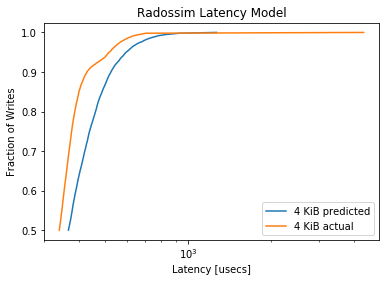

MainProcess pypet INFO     
 Finished single run #555 of 1680 

MainProcess pypet INFO     
 Starting single run #556 of 1680 



minimum predicted latency: 220.832458
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3071, pvalue=1e-323)


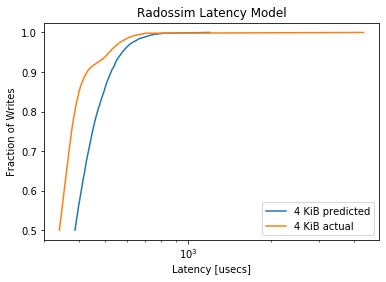

MainProcess pypet INFO     
 Finished single run #556 of 1680 

MainProcess pypet INFO     
 Starting single run #557 of 1680 



minimum predicted latency: 210.330253
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3047, pvalue=1e-323)


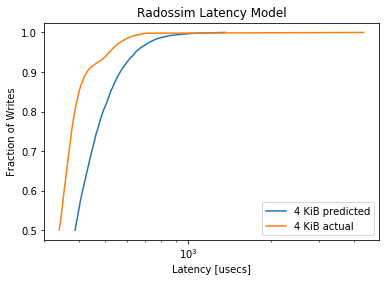

MainProcess pypet INFO     
 Finished single run #557 of 1680 

MainProcess pypet INFO     
 Starting single run #558 of 1680 



minimum predicted latency: 229.900084
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3941, pvalue=0.0)


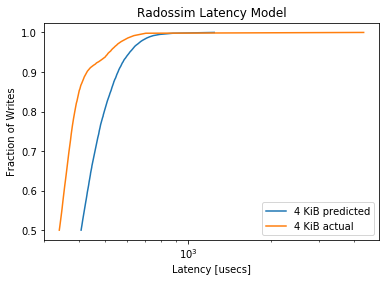

MainProcess pypet INFO     
 Finished single run #558 of 1680 

MainProcess pypet INFO     
 Starting single run #559 of 1680 



minimum predicted latency: 221.419255
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3824, pvalue=0.0)


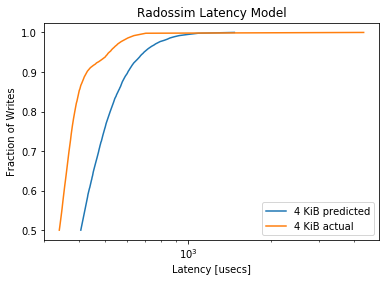

MainProcess pypet INFO     
 Finished single run #559 of 1680 

MainProcess pypet INFO     
 Starting single run #560 of 1680 



minimum predicted latency: 209.297301
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4239, pvalue=0.0)


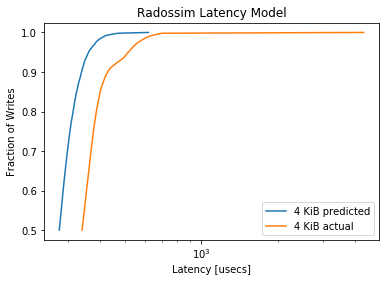

MainProcess pypet INFO     
 Finished single run #560 of 1680 

MainProcess pypet INFO     
 Starting single run #561 of 1680 



minimum predicted latency: 202.311010
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3724, pvalue=0.0)


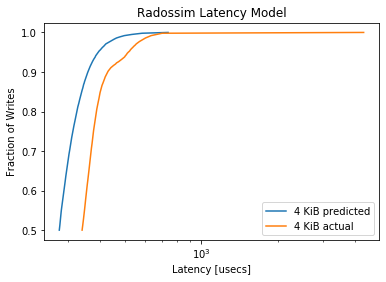

MainProcess pypet INFO     
 Finished single run #561 of 1680 

MainProcess pypet INFO     
 Starting single run #562 of 1680 



minimum predicted latency: 210.922737
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3759, pvalue=0.0)


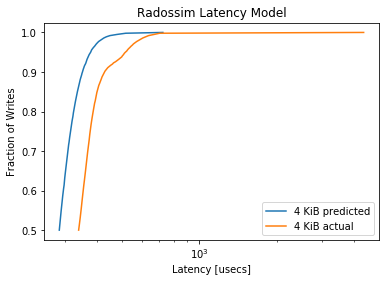

MainProcess pypet INFO     
 Finished single run #562 of 1680 

MainProcess pypet INFO     
 Starting single run #563 of 1680 



minimum predicted latency: 199.145897
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3259, pvalue=1e-323)


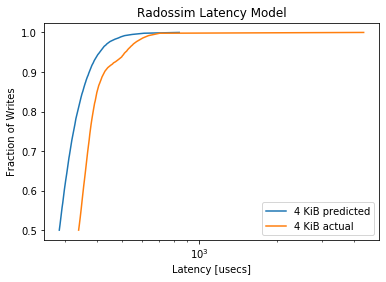

MainProcess pypet INFO     
 Finished single run #563 of 1680 

MainProcess pypet INFO     
 Starting single run #564 of 1680 



minimum predicted latency: 206.096162
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3, pvalue=1e-323)


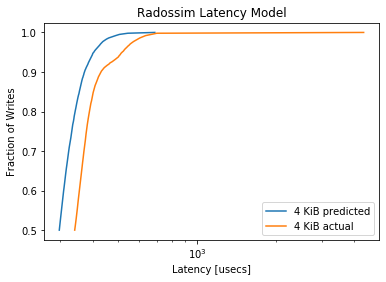

MainProcess pypet INFO     
 Finished single run #564 of 1680 

MainProcess pypet INFO     
 Starting single run #565 of 1680 



minimum predicted latency: 204.016825
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2539, pvalue=1.8123881809899555e-283)


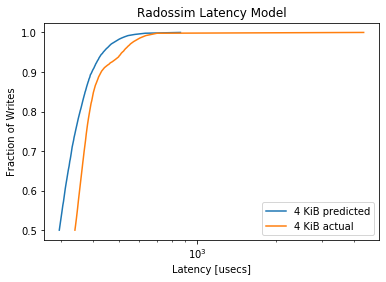

MainProcess pypet INFO     
 Finished single run #565 of 1680 

MainProcess pypet INFO     
 Starting single run #566 of 1680 



minimum predicted latency: 213.310360
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2186, pvalue=1.2433606744916355e-209)


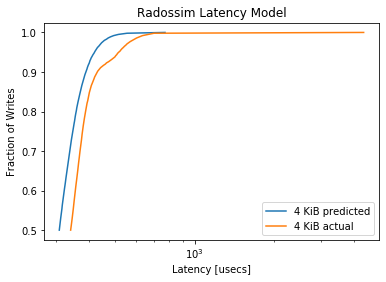

MainProcess pypet INFO     
 Finished single run #566 of 1680 

MainProcess pypet INFO     
 Starting single run #567 of 1680 



minimum predicted latency: 207.025506
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1912, pvalue=3.6340502190136153e-160)


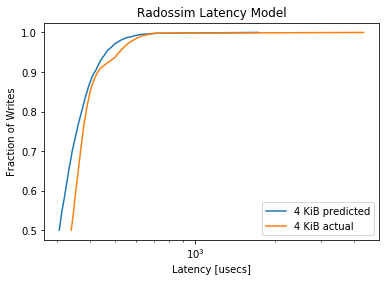

MainProcess pypet INFO     
 Finished single run #567 of 1680 

MainProcess pypet INFO     
 Starting single run #568 of 1680 



minimum predicted latency: 216.294395
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1269, pvalue=1.5084792330805564e-70)


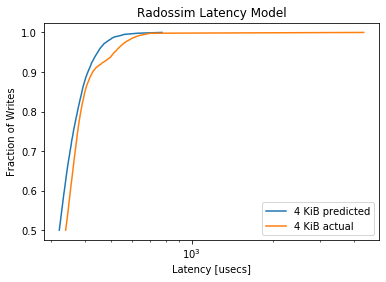

MainProcess pypet INFO     
 Finished single run #568 of 1680 

MainProcess pypet INFO     
 Starting single run #569 of 1680 



minimum predicted latency: 210.411522
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1008, pvalue=1.2621667926911265e-44)


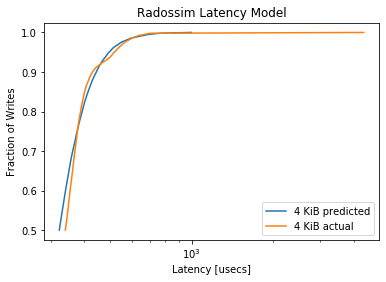

MainProcess pypet INFO     
 Finished single run #569 of 1680 

MainProcess pypet INFO     
 Starting single run #570 of 1680 



minimum predicted latency: 221.938470
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1118, pvalue=8.064893112148982e-55)


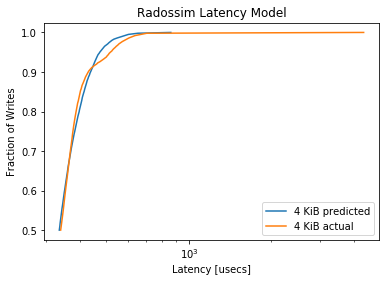

MainProcess pypet INFO     
 Finished single run #570 of 1680 

MainProcess pypet INFO     
 Starting single run #571 of 1680 



minimum predicted latency: 210.468813
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0801, pvalue=2.5596299356192165e-28)


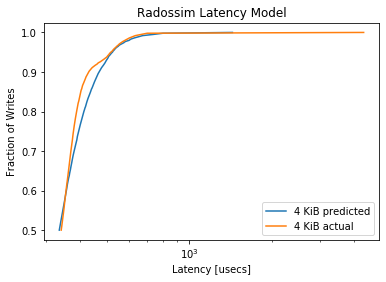

MainProcess pypet INFO     
 Finished single run #571 of 1680 

MainProcess pypet INFO     
 Starting single run #572 of 1680 



minimum predicted latency: 222.457070
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1727, pvalue=1.3376216259387205e-130)


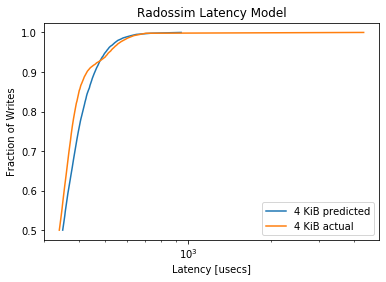

MainProcess pypet INFO     
 Finished single run #572 of 1680 

MainProcess pypet INFO     
 Starting single run #573 of 1680 



minimum predicted latency: 207.236085
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1452, pvalue=2.622390435745755e-92)


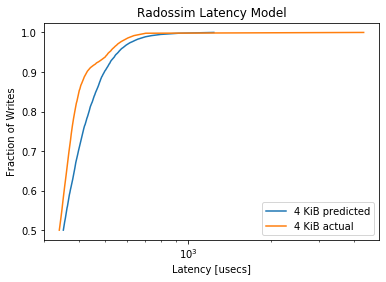

MainProcess pypet INFO     
 Finished single run #573 of 1680 

MainProcess pypet INFO     
 Starting single run #574 of 1680 



minimum predicted latency: 224.858864
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2235, pvalue=3.381437981027169e-219)


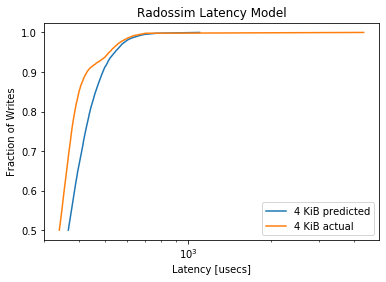

MainProcess pypet INFO     
 Finished single run #574 of 1680 

MainProcess pypet INFO     
 Starting single run #575 of 1680 



minimum predicted latency: 211.179150
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2224, pvalue=4.960742576107605e-217)


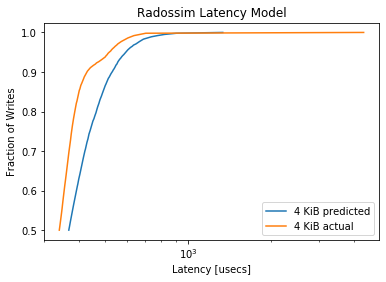

MainProcess pypet INFO     
 Finished single run #575 of 1680 

MainProcess pypet INFO     
 Starting single run #576 of 1680 



minimum predicted latency: 234.877569
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3001, pvalue=1e-323)


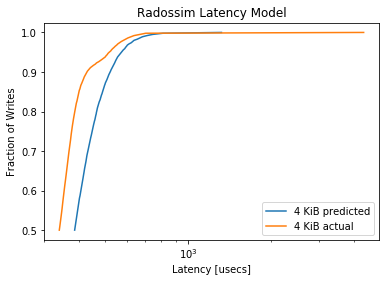

MainProcess pypet INFO     
 Finished single run #576 of 1680 

MainProcess pypet INFO     
 Starting single run #577 of 1680 



minimum predicted latency: 216.764731
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3058, pvalue=1e-323)


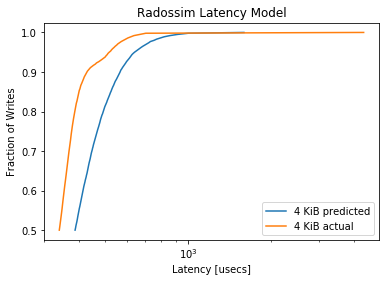

MainProcess pypet INFO     
 Finished single run #577 of 1680 

MainProcess pypet INFO     
 Starting single run #578 of 1680 



minimum predicted latency: 244.605801
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4036, pvalue=0.0)


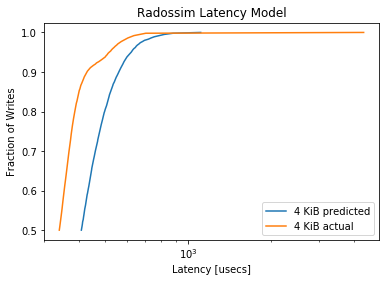

MainProcess pypet INFO     
 Finished single run #578 of 1680 

MainProcess pypet INFO     
 Starting single run #579 of 1680 



minimum predicted latency: 224.315489
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3847, pvalue=0.0)


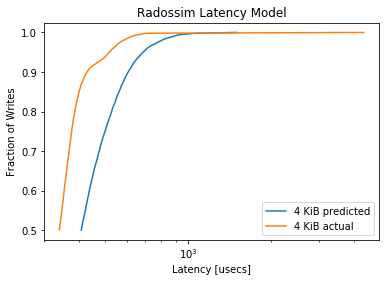

MainProcess pypet INFO     
 Finished single run #579 of 1680 

MainProcess pypet INFO     
 Starting single run #580 of 1680 



minimum predicted latency: 201.268727
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4305, pvalue=0.0)


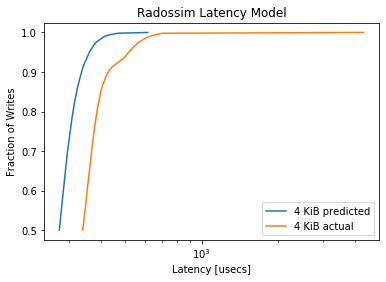

MainProcess pypet INFO     
 Finished single run #580 of 1680 

MainProcess pypet INFO     
 Starting single run #581 of 1680 



minimum predicted latency: 198.914463
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.382, pvalue=0.0)


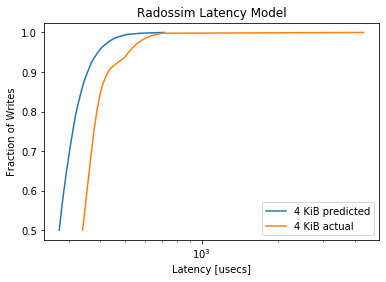

MainProcess pypet INFO     
 Finished single run #581 of 1680 

MainProcess pypet INFO     
 Starting single run #582 of 1680 



minimum predicted latency: 205.537866
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3722, pvalue=0.0)


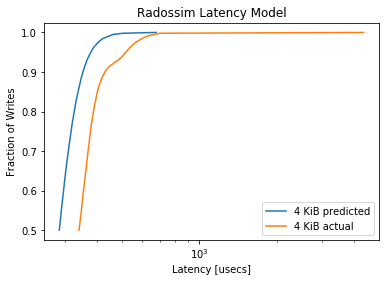

MainProcess pypet INFO     
 Finished single run #582 of 1680 

MainProcess pypet INFO     
 Starting single run #583 of 1680 



minimum predicted latency: 203.613832
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3292, pvalue=1e-323)


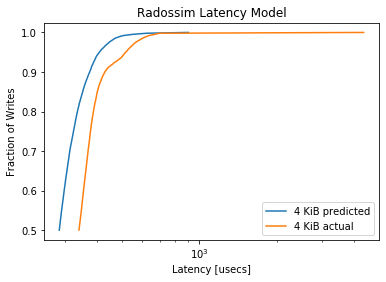

MainProcess pypet INFO     
 Finished single run #583 of 1680 

MainProcess pypet INFO     
 Starting single run #584 of 1680 



minimum predicted latency: 210.602755
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3024, pvalue=1e-323)


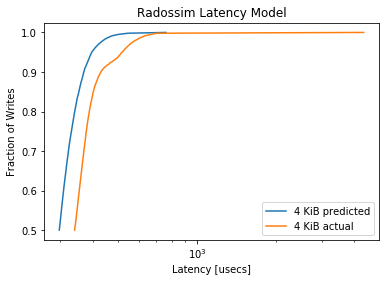

MainProcess pypet INFO     
 Finished single run #584 of 1680 

MainProcess pypet INFO     
 Starting single run #585 of 1680 



minimum predicted latency: 196.698721
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2509, pvalue=9.552534705890676e-277)


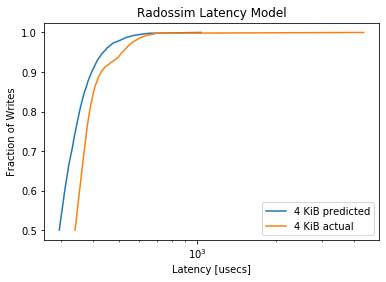

MainProcess pypet INFO     
 Finished single run #585 of 1680 

MainProcess pypet INFO     
 Starting single run #586 of 1680 



minimum predicted latency: 213.334354
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2231, pvalue=2.0805554491073277e-218)


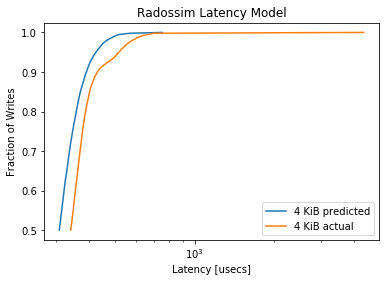

MainProcess pypet INFO     
 Finished single run #586 of 1680 

MainProcess pypet INFO     
 Starting single run #587 of 1680 



minimum predicted latency: 198.348901
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1879, pvalue=1.14756718942223e-154)


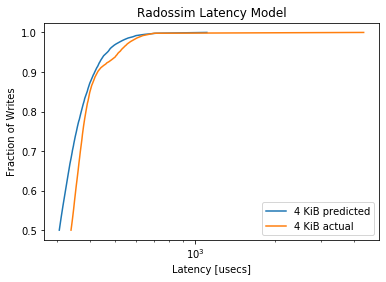

MainProcess pypet INFO     
 Finished single run #587 of 1680 

MainProcess pypet INFO     PROGRESS: Finished  588/1680 runs [=======             ] 35.0%, remaining: 0:07:33
MainProcess pypet INFO     
 Starting single run #588 of 1680 



minimum predicted latency: 216.322969
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1438, pvalue=1.542229077543766e-90)


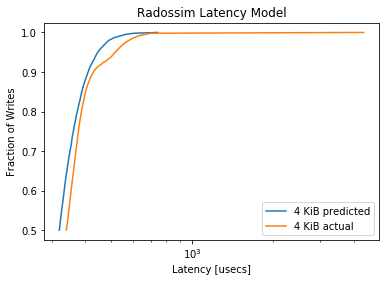

MainProcess pypet INFO     
 Finished single run #588 of 1680 

MainProcess pypet INFO     
 Starting single run #589 of 1680 



minimum predicted latency: 206.346456
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.105, pvalue=2.15823657145067e-48)


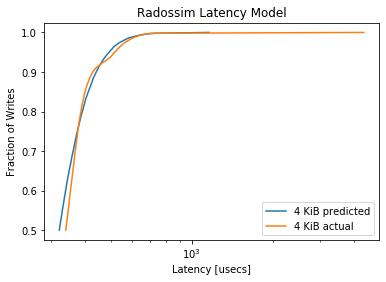

MainProcess pypet INFO     
 Finished single run #589 of 1680 

MainProcess pypet INFO     
 Starting single run #590 of 1680 



minimum predicted latency: 214.897414
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1022, pvalue=7.288682240008833e-46)


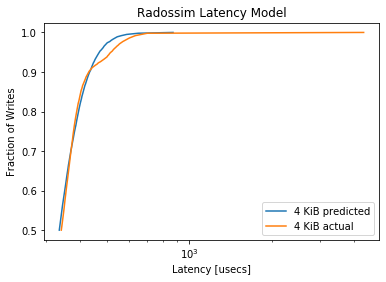

MainProcess pypet INFO     
 Finished single run #590 of 1680 

MainProcess pypet INFO     
 Starting single run #591 of 1680 



minimum predicted latency: 209.101164
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0747, pvalue=1.1107942753711278e-24)


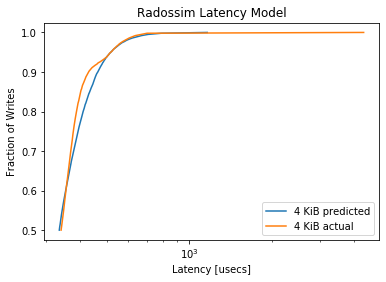

MainProcess pypet INFO     
 Finished single run #591 of 1680 

MainProcess pypet INFO     
 Starting single run #592 of 1680 



minimum predicted latency: 218.440359
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1657, pvalue=3.2606981162594595e-120)


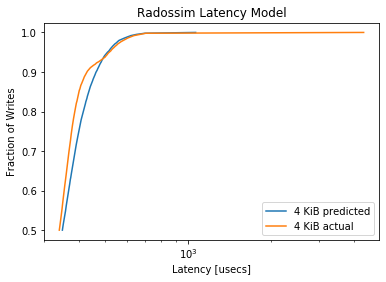

MainProcess pypet INFO     
 Finished single run #592 of 1680 

MainProcess pypet INFO     
 Starting single run #593 of 1680 



minimum predicted latency: 198.350298
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1423, pvalue=1.1606473712552198e-88)


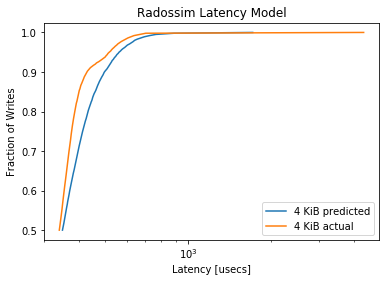

MainProcess pypet INFO     
 Finished single run #593 of 1680 

MainProcess pypet INFO     
 Starting single run #594 of 1680 



minimum predicted latency: 224.046693
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2258, pvalue=9.1940963288919e-224)


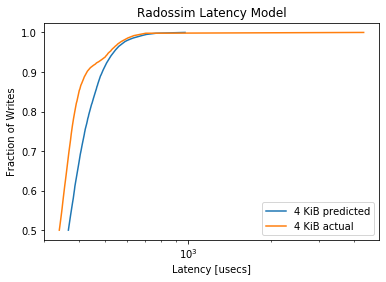

MainProcess pypet INFO     
 Finished single run #594 of 1680 

MainProcess pypet INFO     
 Starting single run #595 of 1680 



minimum predicted latency: 211.605903
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2244, pvalue=5.601801141574965e-221)


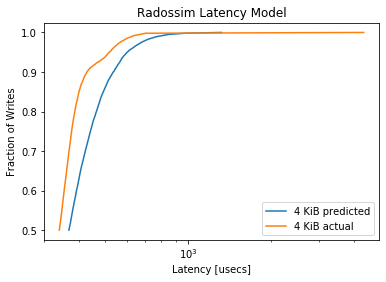

MainProcess pypet INFO     
 Finished single run #595 of 1680 

MainProcess pypet INFO     
 Starting single run #596 of 1680 



minimum predicted latency: 225.401348
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3026, pvalue=1e-323)


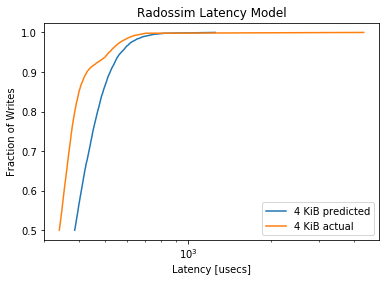

MainProcess pypet INFO     
 Finished single run #596 of 1680 

MainProcess pypet INFO     
 Starting single run #597 of 1680 



minimum predicted latency: 224.472477
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2921, pvalue=1e-323)


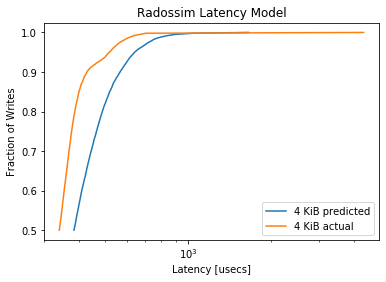

MainProcess pypet INFO     
 Finished single run #597 of 1680 

MainProcess pypet INFO     
 Starting single run #598 of 1680 



minimum predicted latency: 237.820348
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3949, pvalue=0.0)


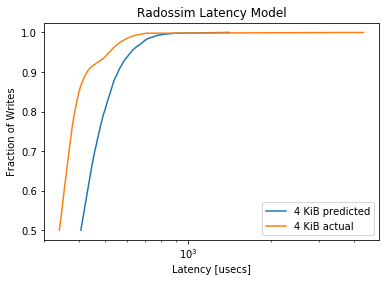

MainProcess pypet INFO     
 Finished single run #598 of 1680 

MainProcess pypet INFO     
 Starting single run #599 of 1680 



minimum predicted latency: 219.347198
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.375, pvalue=0.0)


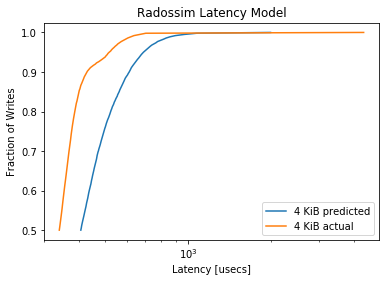

MainProcess pypet INFO     
 Finished single run #599 of 1680 

MainProcess pypet INFO     
 Starting single run #600 of 1680 



minimum predicted latency: 208.190316
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4345, pvalue=0.0)


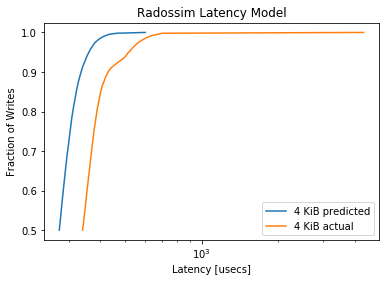

MainProcess pypet INFO     
 Finished single run #600 of 1680 

MainProcess pypet INFO     
 Starting single run #601 of 1680 



minimum predicted latency: 200.195107
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3762, pvalue=0.0)


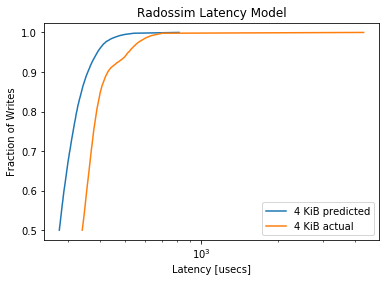

MainProcess pypet INFO     
 Finished single run #601 of 1680 

MainProcess pypet INFO     
 Starting single run #602 of 1680 



minimum predicted latency: 205.725003
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3737, pvalue=0.0)


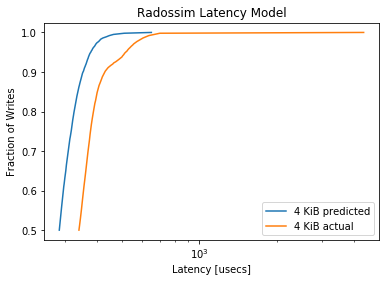

MainProcess pypet INFO     
 Finished single run #602 of 1680 

MainProcess pypet INFO     
 Starting single run #603 of 1680 



minimum predicted latency: 203.930617
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3276, pvalue=1e-323)


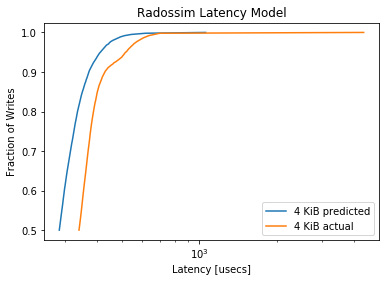

MainProcess pypet INFO     
 Finished single run #603 of 1680 

MainProcess pypet INFO     
 Starting single run #604 of 1680 



minimum predicted latency: 207.382569
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3091, pvalue=1e-323)


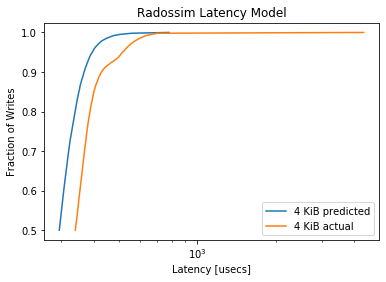

MainProcess pypet INFO     
 Finished single run #604 of 1680 

MainProcess pypet INFO     
 Starting single run #605 of 1680 



minimum predicted latency: 200.105317
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2584, pvalue=1.0440986073884107e-293)


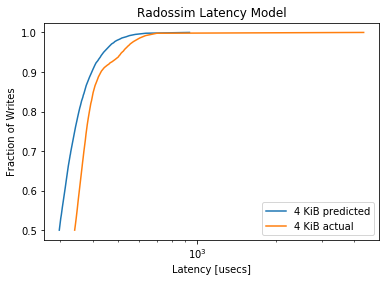

MainProcess pypet INFO     
 Finished single run #605 of 1680 

MainProcess pypet INFO     
 Starting single run #606 of 1680 



minimum predicted latency: 209.560752
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2318, pvalue=6.687247962711921e-236)


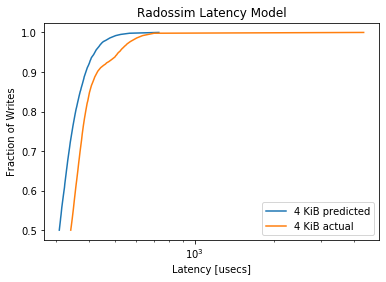

MainProcess pypet INFO     
 Finished single run #606 of 1680 

MainProcess pypet INFO     
 Starting single run #607 of 1680 



minimum predicted latency: 200.498227
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1877, pvalue=2.454267449999112e-154)


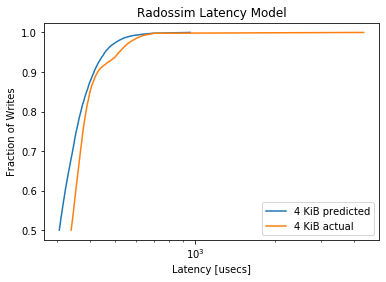

MainProcess pypet INFO     
 Finished single run #607 of 1680 

MainProcess pypet INFO     
 Starting single run #608 of 1680 



minimum predicted latency: 211.648357
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1283, pvalue=4.1539971432867586e-72)


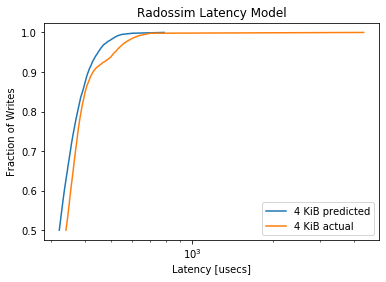

MainProcess pypet INFO     
 Finished single run #608 of 1680 

MainProcess pypet INFO     
 Starting single run #609 of 1680 



minimum predicted latency: 201.898895
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.115, pvalue=5.510662585551242e-58)


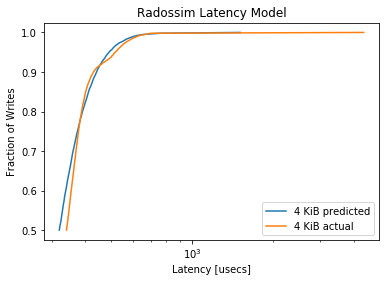

MainProcess pypet INFO     
 Finished single run #609 of 1680 

MainProcess pypet INFO     
 Starting single run #610 of 1680 



minimum predicted latency: 216.975930
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.11, pvalue=4.441705322942362e-53)


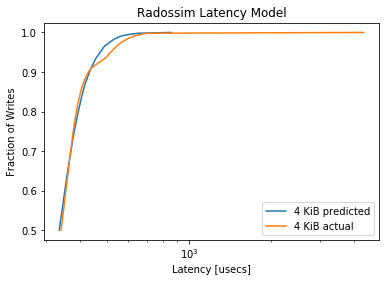

MainProcess pypet INFO     
 Finished single run #610 of 1680 

MainProcess pypet INFO     
 Starting single run #611 of 1680 



minimum predicted latency: 209.190004
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0832, pvalue=1.602698403145652e-30)


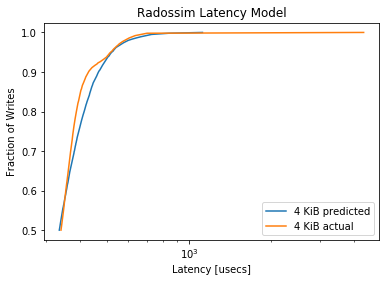

MainProcess pypet INFO     
 Finished single run #611 of 1680 

MainProcess pypet INFO     
 Starting single run #612 of 1680 



minimum predicted latency: 221.815506
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1698, pvalue=3.0385760576140476e-126)


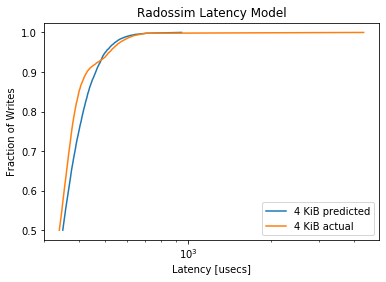

MainProcess pypet INFO     
 Finished single run #612 of 1680 

MainProcess pypet INFO     
 Starting single run #613 of 1680 



minimum predicted latency: 209.675089
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1497, pvalue=4.1054023894591765e-98)


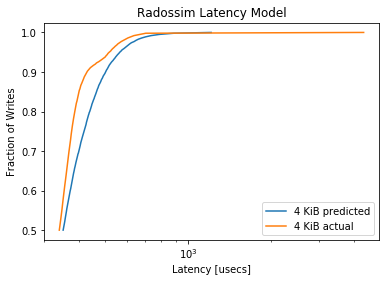

MainProcess pypet INFO     
 Finished single run #613 of 1680 

MainProcess pypet INFO     
 Starting single run #614 of 1680 



minimum predicted latency: 222.068548
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2251, pvalue=2.2811816586125503e-222)


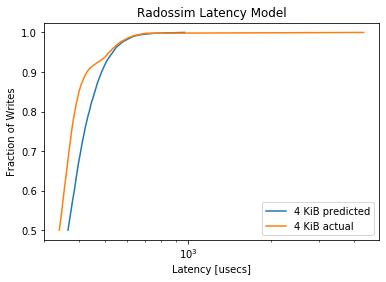

MainProcess pypet INFO     
 Finished single run #614 of 1680 

MainProcess pypet INFO     
 Starting single run #615 of 1680 



minimum predicted latency: 214.879090
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2256, pvalue=2.303765388506349e-223)


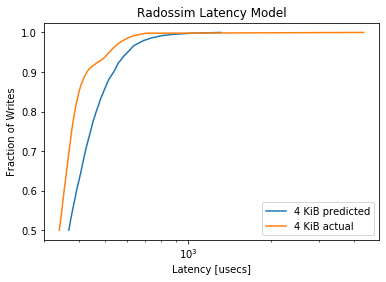

MainProcess pypet INFO     
 Finished single run #615 of 1680 

MainProcess pypet INFO     
 Starting single run #616 of 1680 



minimum predicted latency: 238.199375
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2928, pvalue=1e-323)


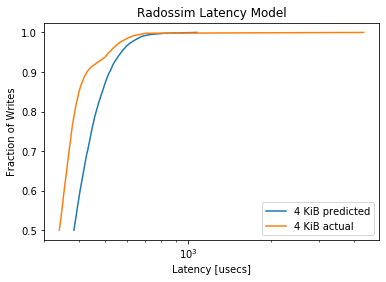

MainProcess pypet INFO     
 Finished single run #616 of 1680 

MainProcess pypet INFO     
 Starting single run #617 of 1680 



minimum predicted latency: 213.413537
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3043, pvalue=1e-323)


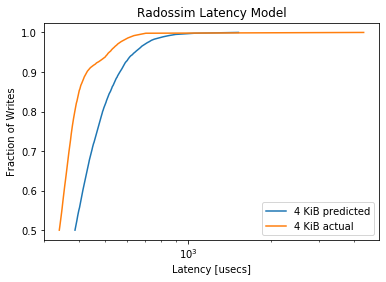

MainProcess pypet INFO     
 Finished single run #617 of 1680 

MainProcess pypet INFO     
 Starting single run #618 of 1680 



minimum predicted latency: 236.025923
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3917, pvalue=0.0)


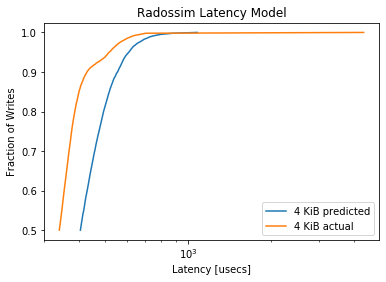

MainProcess pypet INFO     
 Finished single run #618 of 1680 

MainProcess pypet INFO     
 Starting single run #619 of 1680 



minimum predicted latency: 210.543712
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3832, pvalue=0.0)


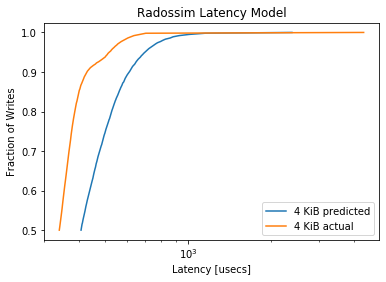

MainProcess pypet INFO     
 Finished single run #619 of 1680 

MainProcess pypet INFO     
 Starting single run #620 of 1680 



minimum predicted latency: 199.874161
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4357, pvalue=0.0)


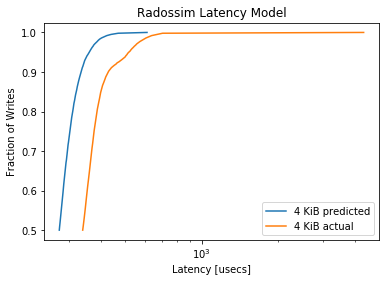

MainProcess pypet INFO     
 Finished single run #620 of 1680 

MainProcess pypet INFO     
 Starting single run #621 of 1680 



minimum predicted latency: 199.753144
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3705, pvalue=0.0)


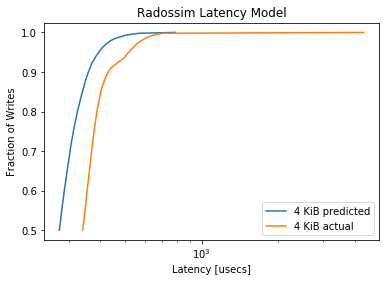

MainProcess pypet INFO     
 Finished single run #621 of 1680 

MainProcess pypet INFO     
 Starting single run #622 of 1680 



minimum predicted latency: 205.665742
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.374, pvalue=0.0)


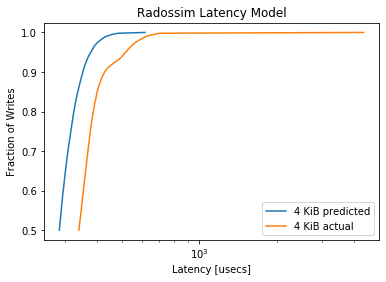

MainProcess pypet INFO     
 Finished single run #622 of 1680 

MainProcess pypet INFO     
 Starting single run #623 of 1680 



minimum predicted latency: 202.195635
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.326, pvalue=1e-323)


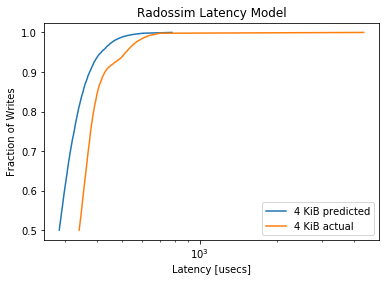

MainProcess pypet INFO     
 Finished single run #623 of 1680 

MainProcess pypet INFO     
 Starting single run #624 of 1680 



minimum predicted latency: 211.118236
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3044, pvalue=1e-323)


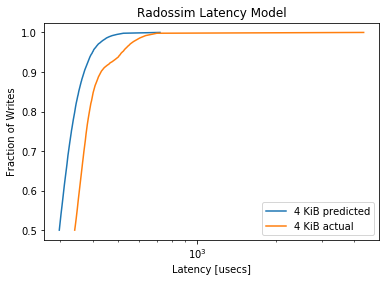

MainProcess pypet INFO     
 Finished single run #624 of 1680 

MainProcess pypet INFO     
 Starting single run #625 of 1680 



minimum predicted latency: 201.438864
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2582, pvalue=3.0048950945119737e-293)


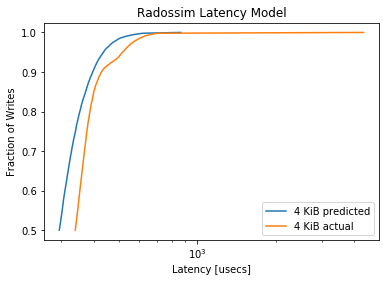

MainProcess pypet INFO     
 Finished single run #625 of 1680 

MainProcess pypet INFO     
 Starting single run #626 of 1680 



minimum predicted latency: 213.957135
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2296, pvalue=2.061858727576009e-231)


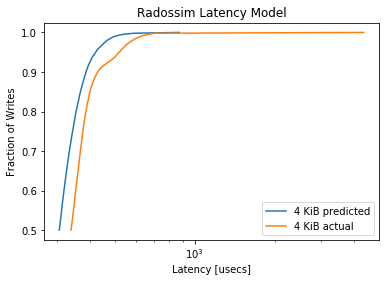

MainProcess pypet INFO     
 Finished single run #626 of 1680 

MainProcess pypet INFO     
 Starting single run #627 of 1680 



minimum predicted latency: 198.963197
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1873, pvalue=1.1197707880974246e-153)


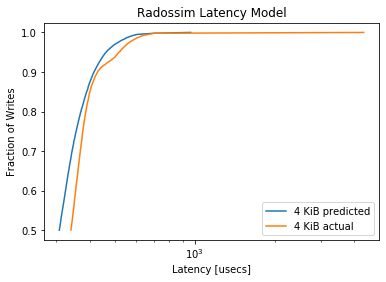

MainProcess pypet INFO     
 Finished single run #627 of 1680 

MainProcess pypet INFO     
 Starting single run #628 of 1680 



minimum predicted latency: 213.791397
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1369, pvalue=4.520568487582714e-82)


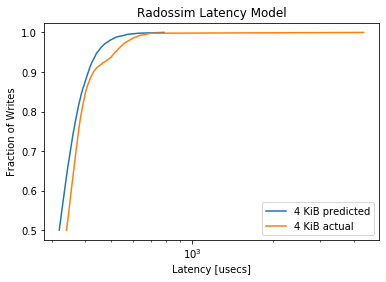

MainProcess pypet INFO     
 Finished single run #628 of 1680 

MainProcess pypet INFO     
 Starting single run #629 of 1680 



minimum predicted latency: 206.150591
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1173, pvalue=2.572814252127888e-60)


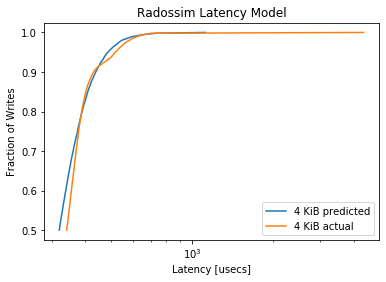

MainProcess pypet INFO     
 Finished single run #629 of 1680 

MainProcess pypet INFO     
 Starting single run #630 of 1680 



minimum predicted latency: 220.369016
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1016, pvalue=2.4861488259360158e-45)


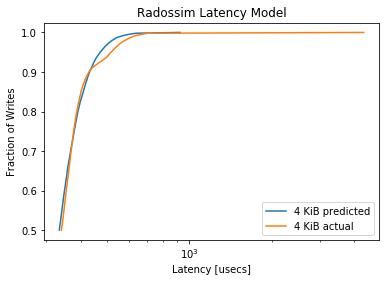

MainProcess pypet INFO     
 Finished single run #630 of 1680 

MainProcess pypet INFO     
 Starting single run #631 of 1680 



minimum predicted latency: 212.841442
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0779, pvalue=8.3341586601822e-27)


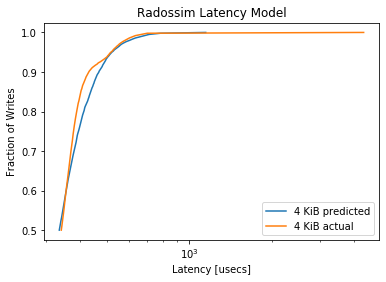

MainProcess pypet INFO     
 Finished single run #631 of 1680 

MainProcess pypet INFO     
 Starting single run #632 of 1680 



minimum predicted latency: 225.126539
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1675, pvalue=7.659690659636285e-123)


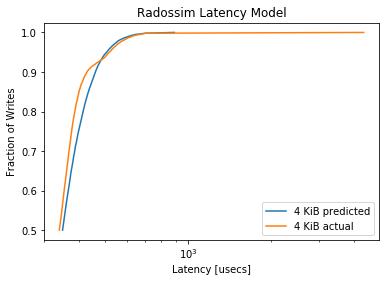

MainProcess pypet INFO     
 Finished single run #632 of 1680 

MainProcess pypet INFO     
 Starting single run #633 of 1680 



minimum predicted latency: 202.402246
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1467, pvalue=3.188295346590668e-94)


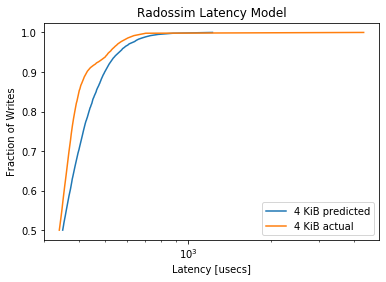

MainProcess pypet INFO     
 Finished single run #633 of 1680 

MainProcess pypet INFO     
 Starting single run #634 of 1680 



minimum predicted latency: 220.399767
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2277, pvalue=1.4302712755952321e-227)


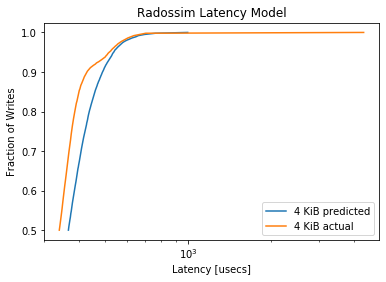

MainProcess pypet INFO     
 Finished single run #634 of 1680 

MainProcess pypet INFO     
 Starting single run #635 of 1680 



minimum predicted latency: 209.981337
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2369, pvalue=1.7699527967594425e-246)


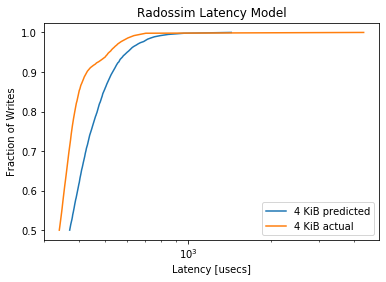

MainProcess pypet INFO     
 Finished single run #635 of 1680 

MainProcess pypet INFO     
 Starting single run #636 of 1680 



minimum predicted latency: 236.119802
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2987, pvalue=1e-323)


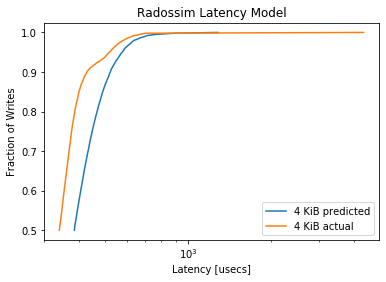

MainProcess pypet INFO     
 Finished single run #636 of 1680 

MainProcess pypet INFO     
 Starting single run #637 of 1680 



minimum predicted latency: 212.955036
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3024, pvalue=1e-323)


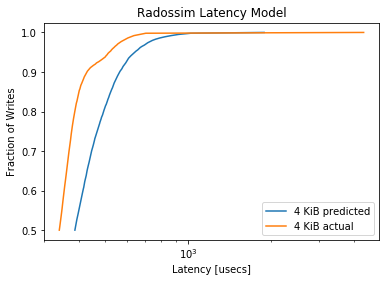

MainProcess pypet INFO     
 Finished single run #637 of 1680 

MainProcess pypet INFO     
 Starting single run #638 of 1680 



minimum predicted latency: 244.487696
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4034, pvalue=0.0)


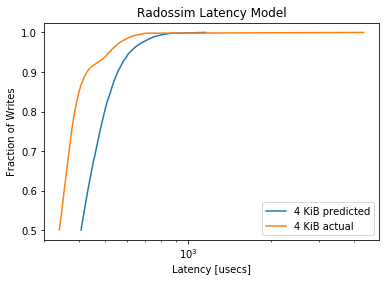

MainProcess pypet INFO     
 Finished single run #638 of 1680 

MainProcess pypet INFO     
 Starting single run #639 of 1680 



minimum predicted latency: 209.111342
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3778, pvalue=0.0)


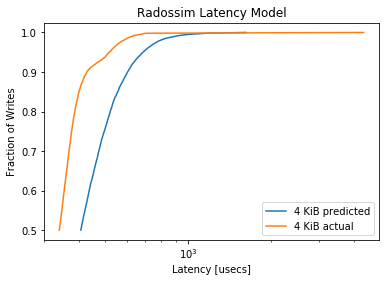

MainProcess pypet INFO     
 Finished single run #639 of 1680 

MainProcess pypet INFO     
 Starting single run #640 of 1680 



minimum predicted latency: 208.322292
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4328, pvalue=0.0)


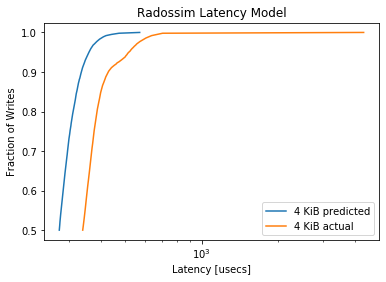

MainProcess pypet INFO     
 Finished single run #640 of 1680 

MainProcess pypet INFO     
 Starting single run #641 of 1680 



minimum predicted latency: 195.424031
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3908, pvalue=0.0)


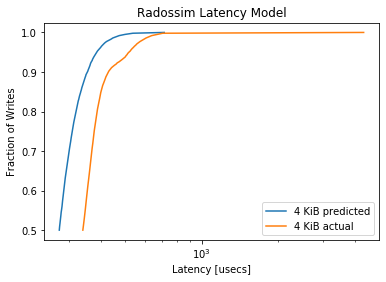

MainProcess pypet INFO     
 Finished single run #641 of 1680 

MainProcess pypet INFO     
 Starting single run #642 of 1680 



minimum predicted latency: 204.989296
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.381, pvalue=0.0)


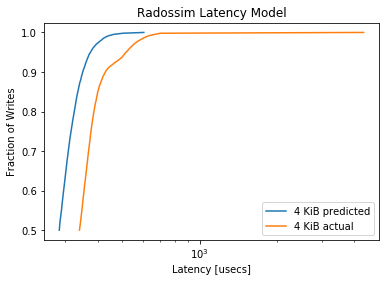

MainProcess pypet INFO     
 Finished single run #642 of 1680 

MainProcess pypet INFO     
 Starting single run #643 of 1680 



minimum predicted latency: 197.147765
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3306, pvalue=1e-323)


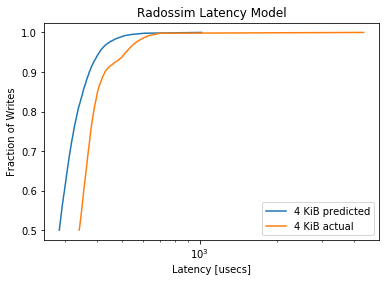

MainProcess pypet INFO     
 Finished single run #643 of 1680 

MainProcess pypet INFO     
 Starting single run #644 of 1680 



minimum predicted latency: 211.476783
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3159, pvalue=1e-323)


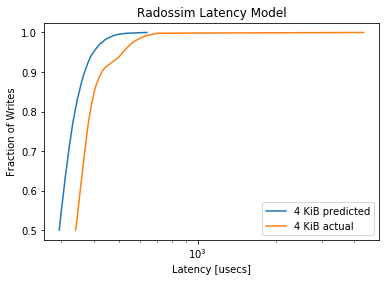

MainProcess pypet INFO     
 Finished single run #644 of 1680 

MainProcess pypet INFO     
 Starting single run #645 of 1680 



minimum predicted latency: 201.808577
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2697, pvalue=2.981e-320)


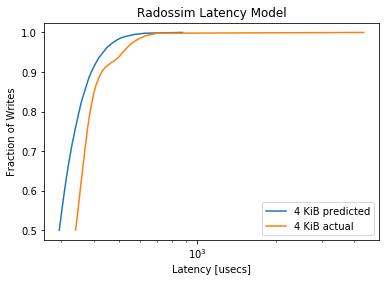

MainProcess pypet INFO     
 Finished single run #645 of 1680 

MainProcess pypet INFO     
 Starting single run #646 of 1680 



minimum predicted latency: 207.743956
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2293, pvalue=8.374473160598733e-231)


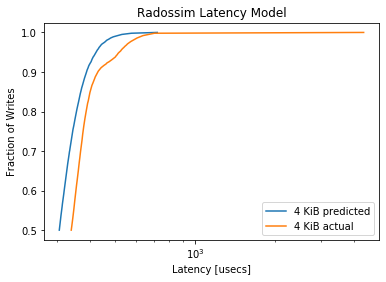

MainProcess pypet INFO     
 Finished single run #646 of 1680 

MainProcess pypet INFO     
 Starting single run #647 of 1680 



minimum predicted latency: 202.837754
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1817, pvalue=1.3394032157827832e-144)


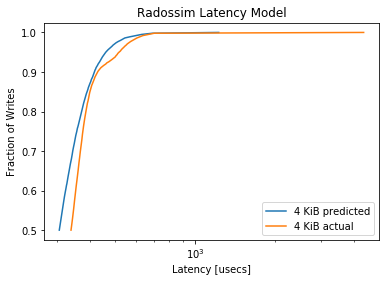

MainProcess pypet INFO     
 Finished single run #647 of 1680 

MainProcess pypet INFO     
 Starting single run #648 of 1680 



minimum predicted latency: 215.175947
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1428, pvalue=2.7631204949011182e-89)


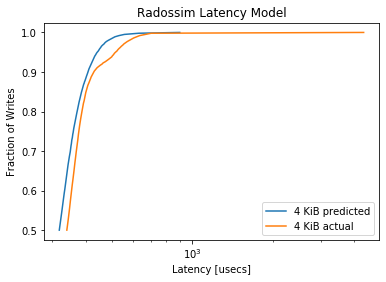

MainProcess pypet INFO     
 Finished single run #648 of 1680 

MainProcess pypet INFO     
 Starting single run #649 of 1680 



minimum predicted latency: 203.172131
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1246, pvalue=5.057758553530154e-68)


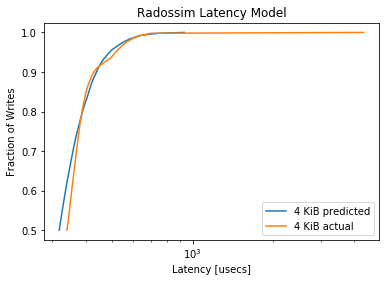

MainProcess pypet INFO     
 Finished single run #649 of 1680 

MainProcess pypet INFO     
 Starting single run #650 of 1680 



minimum predicted latency: 217.417801
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1012, pvalue=5.610789321962591e-45)


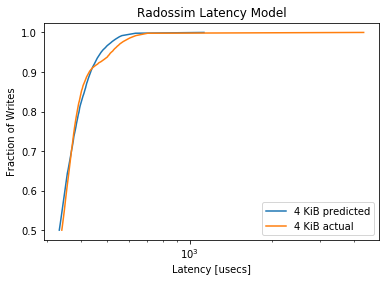

MainProcess pypet INFO     
 Finished single run #650 of 1680 

MainProcess pypet INFO     
 Starting single run #651 of 1680 



minimum predicted latency: 207.904432
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0753, pvalue=4.508716049367898e-25)


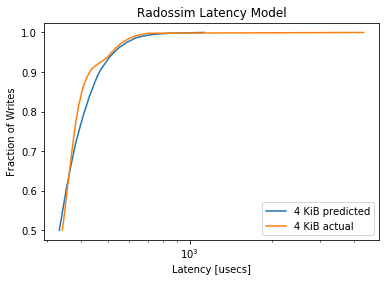

MainProcess pypet INFO     
 Finished single run #651 of 1680 

MainProcess pypet INFO     
 Starting single run #652 of 1680 



minimum predicted latency: 222.169552
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1601, pvalue=3.2193417002816786e-112)


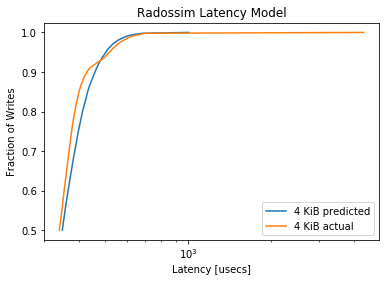

MainProcess pypet INFO     
 Finished single run #652 of 1680 

MainProcess pypet INFO     
 Starting single run #653 of 1680 



minimum predicted latency: 206.112662
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1464, pvalue=7.730076358088175e-94)


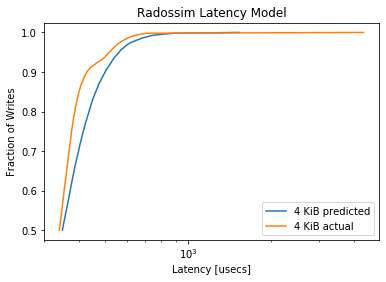

MainProcess pypet INFO     
 Finished single run #653 of 1680 

MainProcess pypet INFO     
 Starting single run #654 of 1680 



minimum predicted latency: 225.977068
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2163, pvalue=3.2282647063727514e-205)


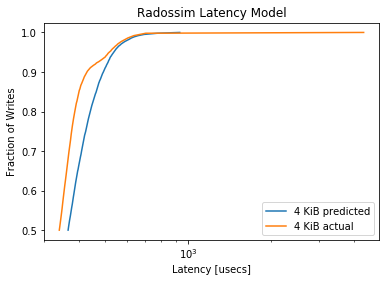

MainProcess pypet INFO     
 Finished single run #654 of 1680 

MainProcess pypet INFO     
 Starting single run #655 of 1680 



minimum predicted latency: 215.919028
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2155, pvalue=1.0791996279833284e-203)


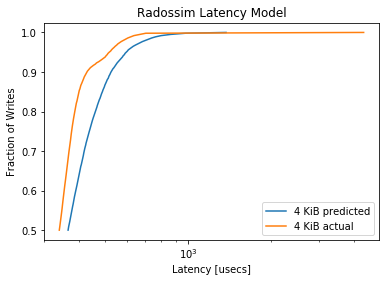

MainProcess pypet INFO     
 Finished single run #655 of 1680 

MainProcess pypet INFO     
 Starting single run #656 of 1680 



minimum predicted latency: 221.635768
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2948, pvalue=1e-323)


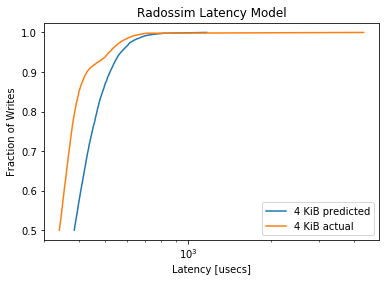

MainProcess pypet INFO     
 Finished single run #656 of 1680 

MainProcess pypet INFO     
 Starting single run #657 of 1680 



minimum predicted latency: 212.288323
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3007, pvalue=1e-323)


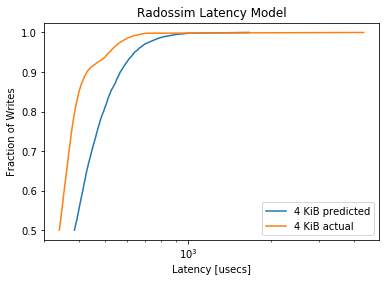

MainProcess pypet INFO     
 Finished single run #657 of 1680 

MainProcess pypet INFO     
 Starting single run #658 of 1680 



minimum predicted latency: 232.931569
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3891, pvalue=0.0)


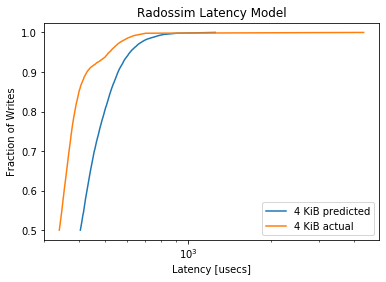

MainProcess pypet INFO     
 Finished single run #658 of 1680 

MainProcess pypet INFO     
 Starting single run #659 of 1680 



minimum predicted latency: 218.188153
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3809, pvalue=0.0)


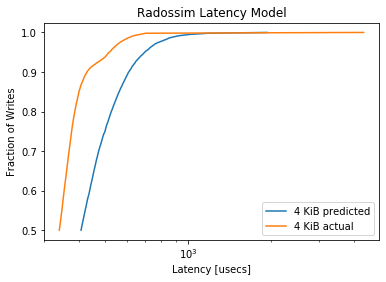

MainProcess pypet INFO     
 Finished single run #659 of 1680 

MainProcess pypet INFO     
 Starting single run #660 of 1680 



minimum predicted latency: 205.690202
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4339, pvalue=0.0)


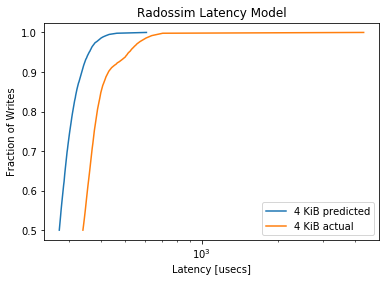

MainProcess pypet INFO     
 Finished single run #660 of 1680 

MainProcess pypet INFO     
 Starting single run #661 of 1680 



minimum predicted latency: 194.171897
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3823, pvalue=0.0)


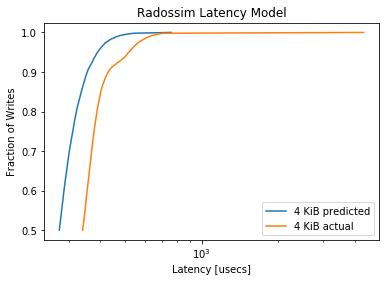

MainProcess pypet INFO     
 Finished single run #661 of 1680 

MainProcess pypet INFO     
 Starting single run #662 of 1680 



minimum predicted latency: 205.745899
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3812, pvalue=0.0)


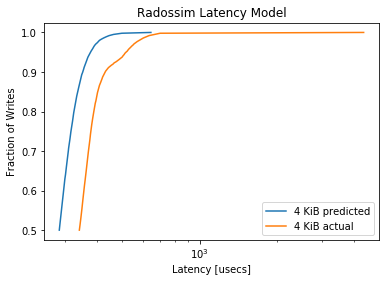

MainProcess pypet INFO     
 Finished single run #662 of 1680 

MainProcess pypet INFO     
 Starting single run #663 of 1680 



minimum predicted latency: 200.551482
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3278, pvalue=1e-323)


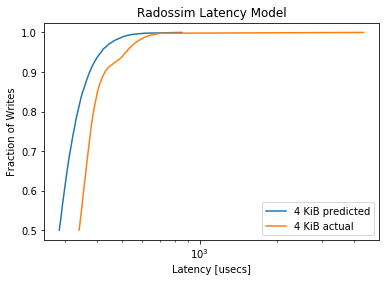

MainProcess pypet INFO     
 Finished single run #663 of 1680 

MainProcess pypet INFO     
 Starting single run #664 of 1680 



minimum predicted latency: 214.086276
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3133, pvalue=1e-323)


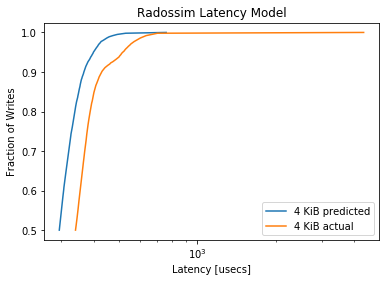

MainProcess pypet INFO     
 Finished single run #664 of 1680 

MainProcess pypet INFO     
 Starting single run #665 of 1680 



minimum predicted latency: 200.266719
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2621, pvalue=2.873591328491868e-302)


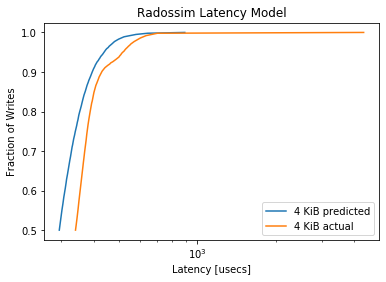

MainProcess pypet INFO     
 Finished single run #665 of 1680 

MainProcess pypet INFO     
 Starting single run #666 of 1680 



minimum predicted latency: 215.507928
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2358, pvalue=3.5445426074747564e-244)


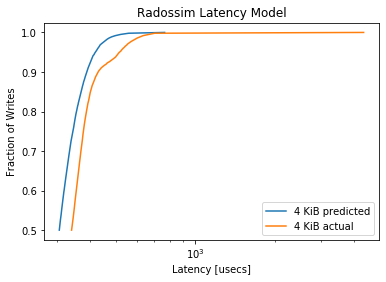

MainProcess pypet INFO     
 Finished single run #666 of 1680 

MainProcess pypet INFO     
 Starting single run #667 of 1680 



minimum predicted latency: 202.454626
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1883, pvalue=2.5027079263911247e-155)


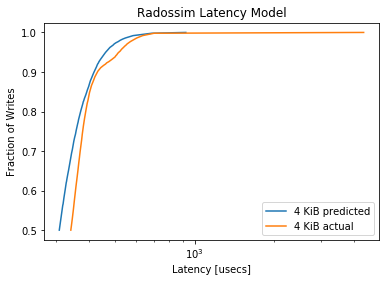

MainProcess pypet INFO     
 Finished single run #667 of 1680 

MainProcess pypet INFO     
 Starting single run #668 of 1680 



minimum predicted latency: 212.865673
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.142, pvalue=2.7391559486243423e-88)


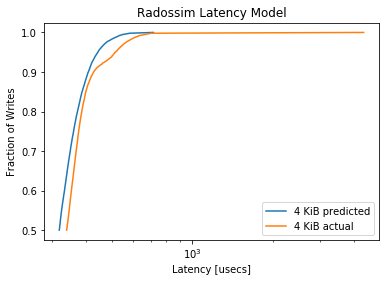

MainProcess pypet INFO     
 Finished single run #668 of 1680 

MainProcess pypet INFO     
 Starting single run #669 of 1680 



minimum predicted latency: 206.967775
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1308, pvalue=6.159805144899801e-75)


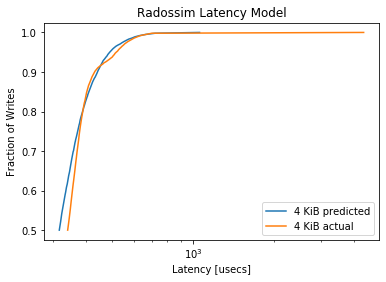

MainProcess pypet INFO     
 Finished single run #669 of 1680 

MainProcess pypet INFO     
 Starting single run #670 of 1680 



minimum predicted latency: 215.269143
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0929, pvalue=5.853524732646717e-38)


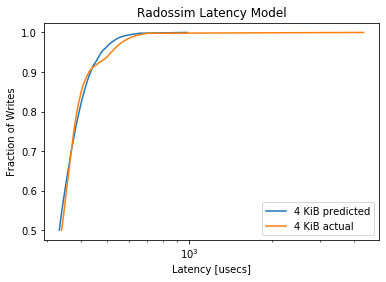

MainProcess pypet INFO     
 Finished single run #670 of 1680 

MainProcess pypet INFO     
 Starting single run #671 of 1680 



minimum predicted latency: 208.215000
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0831, pvalue=1.893383040993969e-30)


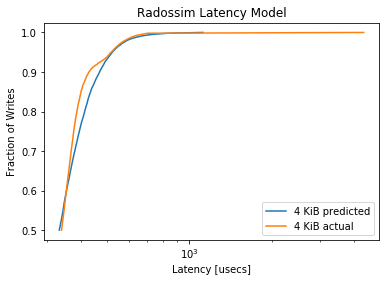

MainProcess pypet INFO     
 Finished single run #671 of 1680 

MainProcess pypet INFO     PROGRESS: Finished  672/1680 runs [========            ] 40.0%, remaining: 0:06:54
MainProcess pypet INFO     
 Starting single run #672 of 1680 



minimum predicted latency: 220.900699
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.164, pvalue=9.32781497930044e-118)


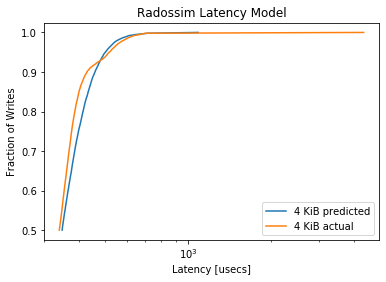

MainProcess pypet INFO     
 Finished single run #672 of 1680 

MainProcess pypet INFO     
 Starting single run #673 of 1680 



minimum predicted latency: 204.567796
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1367, pvalue=7.840183222116839e-82)


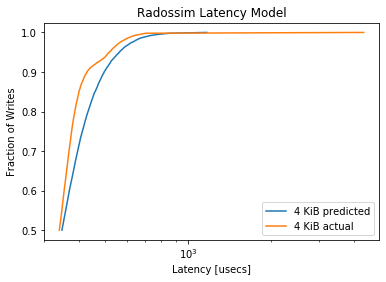

MainProcess pypet INFO     
 Finished single run #673 of 1680 

MainProcess pypet INFO     
 Starting single run #674 of 1680 



minimum predicted latency: 231.054783
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2213, pvalue=7.094727955738263e-215)


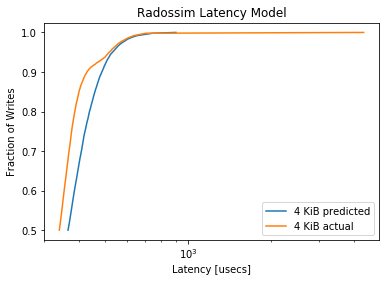

MainProcess pypet INFO     
 Finished single run #674 of 1680 

MainProcess pypet INFO     
 Starting single run #675 of 1680 



minimum predicted latency: 208.168138
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2129, pvalue=8.836587783886384e-199)


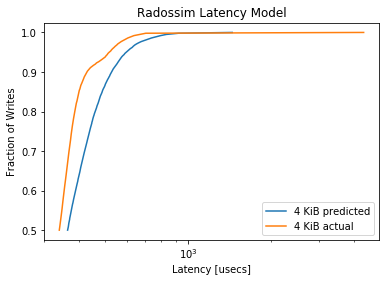

MainProcess pypet INFO     
 Finished single run #675 of 1680 

MainProcess pypet INFO     
 Starting single run #676 of 1680 



minimum predicted latency: 231.880178
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2986, pvalue=1e-323)


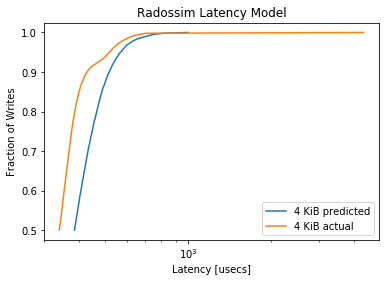

MainProcess pypet INFO     
 Finished single run #676 of 1680 

MainProcess pypet INFO     
 Starting single run #677 of 1680 



minimum predicted latency: 209.710048
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.296, pvalue=1e-323)


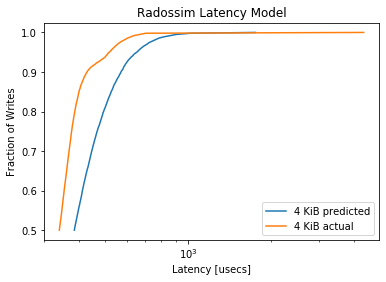

MainProcess pypet INFO     
 Finished single run #677 of 1680 

MainProcess pypet INFO     
 Starting single run #678 of 1680 



minimum predicted latency: 240.226473
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3905, pvalue=0.0)


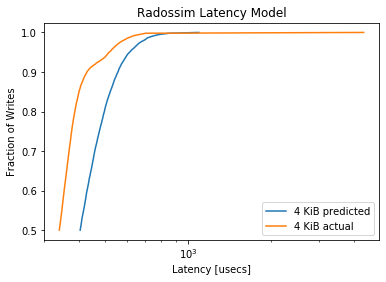

MainProcess pypet INFO     
 Finished single run #678 of 1680 

MainProcess pypet INFO     
 Starting single run #679 of 1680 



minimum predicted latency: 220.560358
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3736, pvalue=0.0)


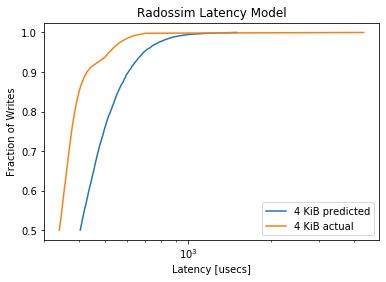

MainProcess pypet INFO     
 Finished single run #679 of 1680 

MainProcess pypet INFO     
 Starting single run #680 of 1680 



minimum predicted latency: 200.443933
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4369, pvalue=0.0)


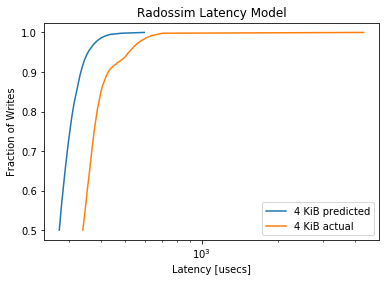

MainProcess pypet INFO     
 Finished single run #680 of 1680 

MainProcess pypet INFO     
 Starting single run #681 of 1680 



minimum predicted latency: 202.445751
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3866, pvalue=0.0)


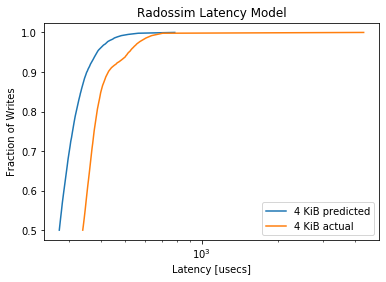

MainProcess pypet INFO     
 Finished single run #681 of 1680 

MainProcess pypet INFO     
 Starting single run #682 of 1680 



minimum predicted latency: 203.543280
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3867, pvalue=0.0)


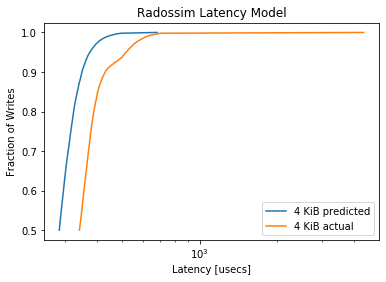

MainProcess pypet INFO     
 Finished single run #682 of 1680 

MainProcess pypet INFO     
 Starting single run #683 of 1680 



minimum predicted latency: 197.901803
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3263, pvalue=1e-323)


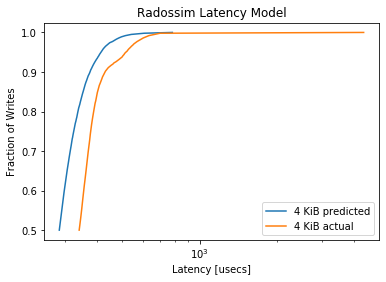

MainProcess pypet INFO     
 Finished single run #683 of 1680 

MainProcess pypet INFO     
 Starting single run #684 of 1680 



minimum predicted latency: 211.037314
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3168, pvalue=1e-323)


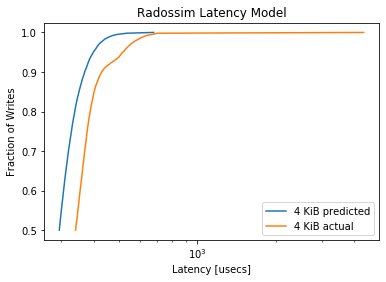

MainProcess pypet INFO     
 Finished single run #684 of 1680 

MainProcess pypet INFO     
 Starting single run #685 of 1680 



minimum predicted latency: 201.931265
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2633, pvalue=4.515442505587443e-305)


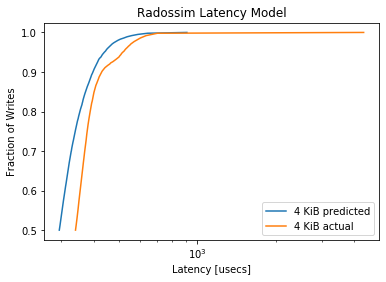

MainProcess pypet INFO     
 Finished single run #685 of 1680 

MainProcess pypet INFO     
 Starting single run #686 of 1680 



minimum predicted latency: 211.405422
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2335, pvalue=2.1185625292238565e-239)


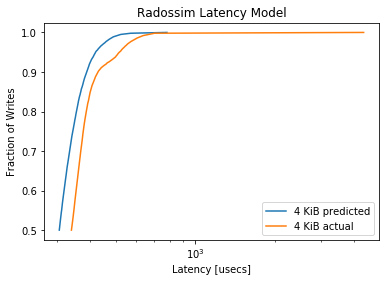

MainProcess pypet INFO     
 Finished single run #686 of 1680 

MainProcess pypet INFO     
 Starting single run #687 of 1680 



minimum predicted latency: 199.681612
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1965, pvalue=3.3306959526163735e-169)


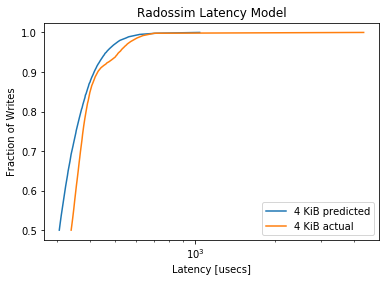

MainProcess pypet INFO     
 Finished single run #687 of 1680 

MainProcess pypet INFO     
 Starting single run #688 of 1680 



minimum predicted latency: 212.791202
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1431, pvalue=1.1650796473826724e-89)


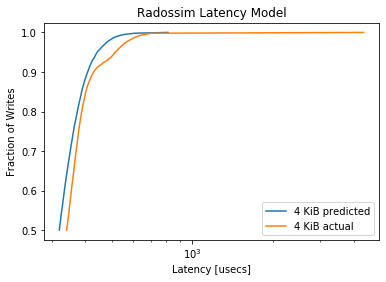

MainProcess pypet INFO     
 Finished single run #688 of 1680 

MainProcess pypet INFO     
 Starting single run #689 of 1680 



minimum predicted latency: 203.898100
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1186, pvalue=1.1813986819187217e-61)


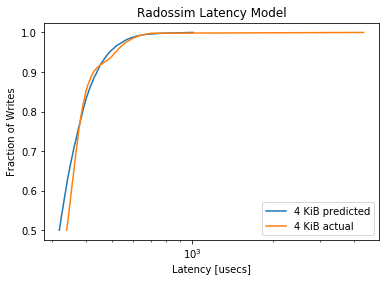

MainProcess pypet INFO     
 Finished single run #689 of 1680 

MainProcess pypet INFO     
 Starting single run #690 of 1680 



minimum predicted latency: 218.886685
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.103, pvalue=1.4035555941391563e-46)


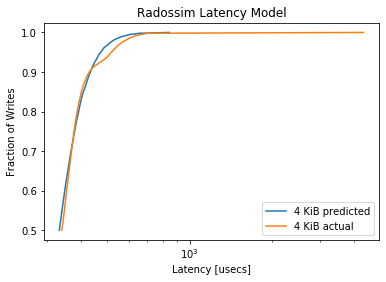

MainProcess pypet INFO     
 Finished single run #690 of 1680 

MainProcess pypet INFO     
 Starting single run #691 of 1680 



minimum predicted latency: 208.125630
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0753, pvalue=4.508716049367898e-25)


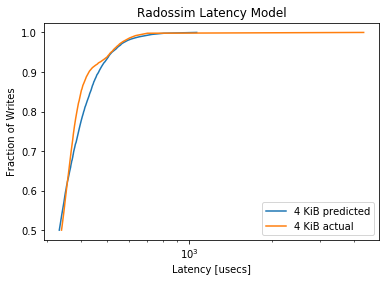

MainProcess pypet INFO     
 Finished single run #691 of 1680 

MainProcess pypet INFO     
 Starting single run #692 of 1680 



minimum predicted latency: 220.833698
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1688, pvalue=9.277093644177091e-125)


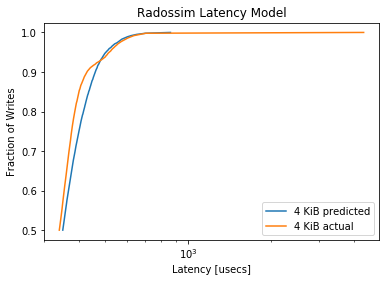

MainProcess pypet INFO     
 Finished single run #692 of 1680 

MainProcess pypet INFO     
 Starting single run #693 of 1680 



minimum predicted latency: 216.330589
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1411, pvalue=3.5610640166084617e-87)


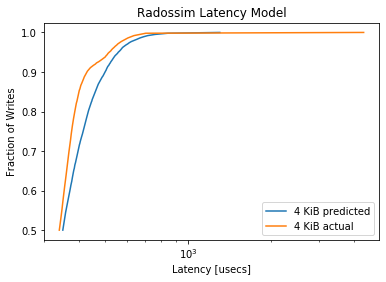

MainProcess pypet INFO     
 Finished single run #693 of 1680 

MainProcess pypet INFO     
 Starting single run #694 of 1680 



minimum predicted latency: 223.493132
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2241, pvalue=2.201617733666942e-220)


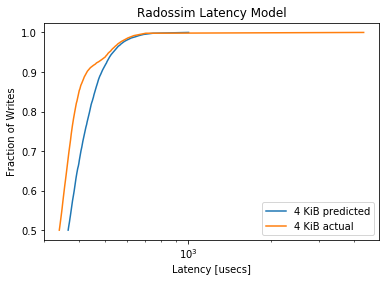

MainProcess pypet INFO     
 Finished single run #694 of 1680 

MainProcess pypet INFO     
 Starting single run #695 of 1680 



minimum predicted latency: 208.597479
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2146, pvalue=5.5053278537861935e-202)


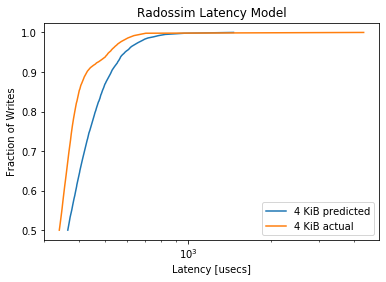

MainProcess pypet INFO     
 Finished single run #695 of 1680 

MainProcess pypet INFO     
 Starting single run #696 of 1680 



minimum predicted latency: 224.193998
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2976, pvalue=1e-323)


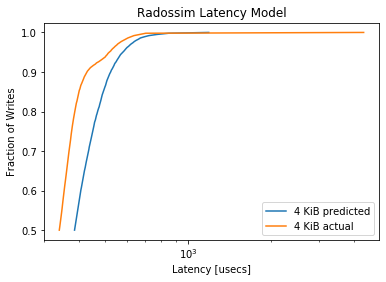

MainProcess pypet INFO     
 Finished single run #696 of 1680 

MainProcess pypet INFO     
 Starting single run #697 of 1680 



minimum predicted latency: 214.873095
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.289, pvalue=1e-323)


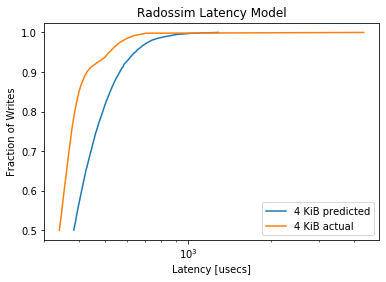

MainProcess pypet INFO     
 Finished single run #697 of 1680 

MainProcess pypet INFO     
 Starting single run #698 of 1680 



minimum predicted latency: 240.606052
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3907, pvalue=0.0)


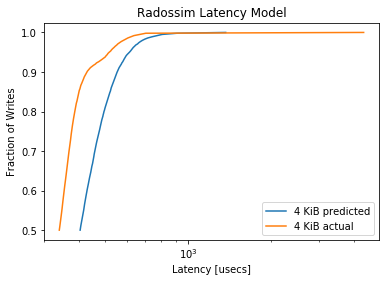

MainProcess pypet INFO     
 Finished single run #698 of 1680 

MainProcess pypet INFO     
 Starting single run #699 of 1680 



minimum predicted latency: 217.636119
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3719, pvalue=0.0)


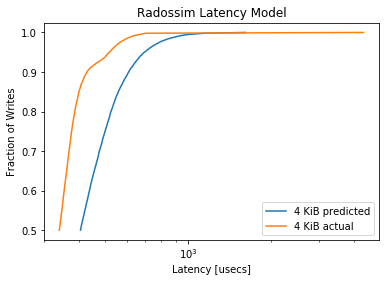

MainProcess pypet INFO     
 Finished single run #699 of 1680 

MainProcess pypet INFO     
 Starting single run #700 of 1680 



minimum predicted latency: 201.622194
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4406, pvalue=0.0)


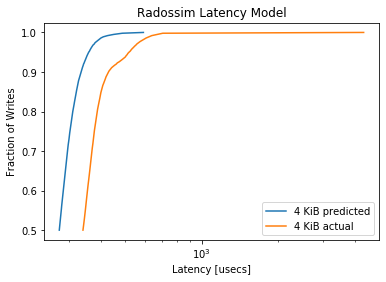

MainProcess pypet INFO     
 Finished single run #700 of 1680 

MainProcess pypet INFO     
 Starting single run #701 of 1680 



minimum predicted latency: 198.893476
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3905, pvalue=0.0)


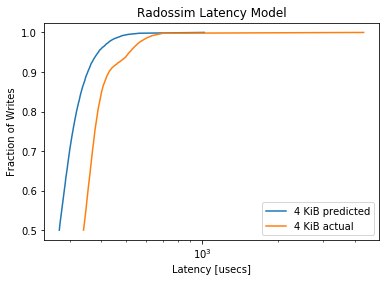

MainProcess pypet INFO     
 Finished single run #701 of 1680 

MainProcess pypet INFO     
 Starting single run #702 of 1680 



minimum predicted latency: 201.433278
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3884, pvalue=0.0)


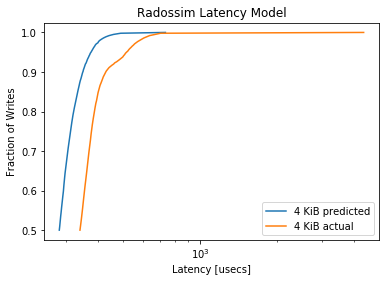

MainProcess pypet INFO     
 Finished single run #702 of 1680 

MainProcess pypet INFO     
 Starting single run #703 of 1680 



minimum predicted latency: 198.441607
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3259, pvalue=1e-323)


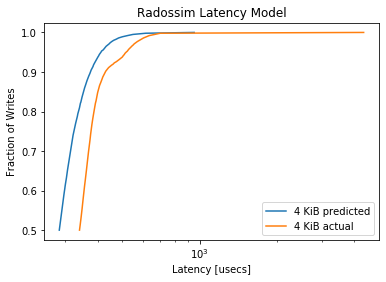

MainProcess pypet INFO     
 Finished single run #703 of 1680 

MainProcess pypet INFO     
 Starting single run #704 of 1680 



minimum predicted latency: 212.170391
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3124, pvalue=1e-323)


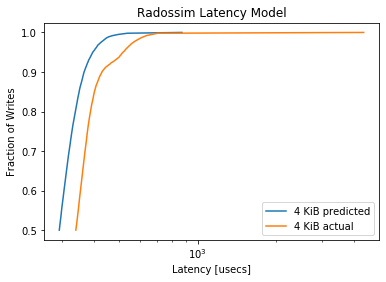

MainProcess pypet INFO     
 Finished single run #704 of 1680 

MainProcess pypet INFO     
 Starting single run #705 of 1680 



minimum predicted latency: 198.958412
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2661, pvalue=1.1492086948273e-311)


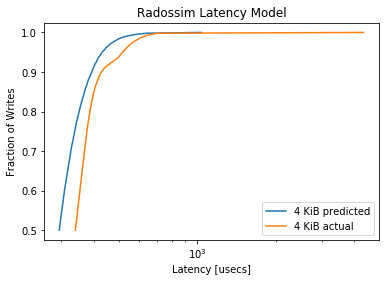

MainProcess pypet INFO     
 Finished single run #705 of 1680 

MainProcess pypet INFO     
 Starting single run #706 of 1680 



minimum predicted latency: 207.843071
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.234, pvalue=1.9579949269024177e-240)


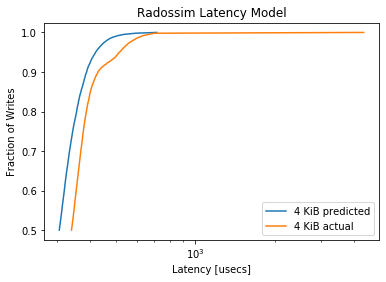

MainProcess pypet INFO     
 Finished single run #706 of 1680 

MainProcess pypet INFO     
 Starting single run #707 of 1680 



minimum predicted latency: 205.887920
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1972, pvalue=2.041247976612352e-170)


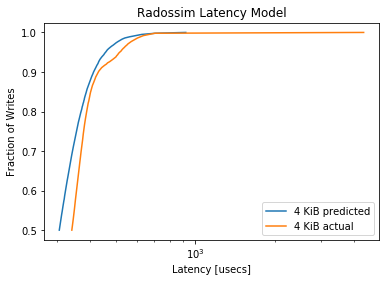

MainProcess pypet INFO     
 Finished single run #707 of 1680 

MainProcess pypet INFO     
 Starting single run #708 of 1680 



minimum predicted latency: 210.210346
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1498, pvalue=3.036026832281386e-98)


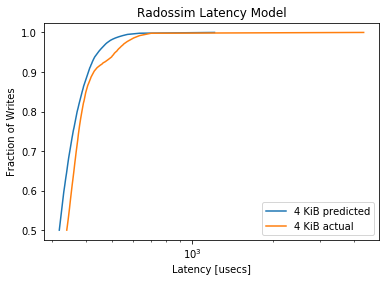

MainProcess pypet INFO     
 Finished single run #708 of 1680 

MainProcess pypet INFO     
 Starting single run #709 of 1680 



minimum predicted latency: 205.202831
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1254, pvalue=6.774018951624728e-69)


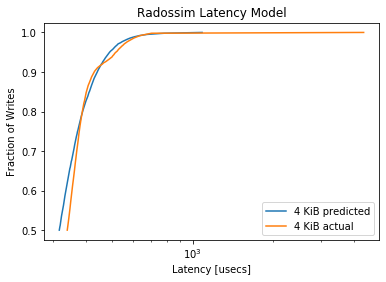

MainProcess pypet INFO     
 Finished single run #709 of 1680 

MainProcess pypet INFO     
 Starting single run #710 of 1680 



minimum predicted latency: 221.986847
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0897, pvalue=2.0513878668029795e-35)


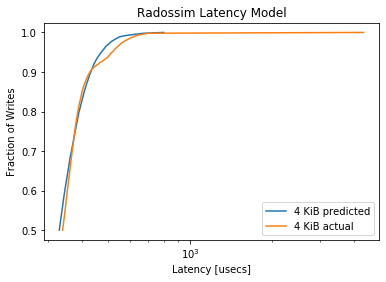

MainProcess pypet INFO     
 Finished single run #710 of 1680 

MainProcess pypet INFO     
 Starting single run #711 of 1680 



minimum predicted latency: 206.273973
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0794, pvalue=7.835640605114273e-28)


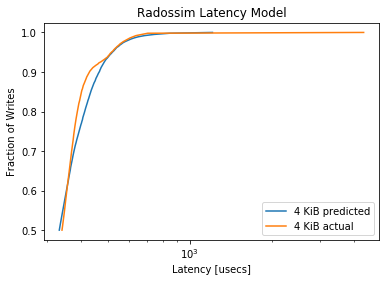

MainProcess pypet INFO     
 Finished single run #711 of 1680 

MainProcess pypet INFO     
 Starting single run #712 of 1680 



minimum predicted latency: 213.605903
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1582, pvalue=1.4342811278492186e-109)


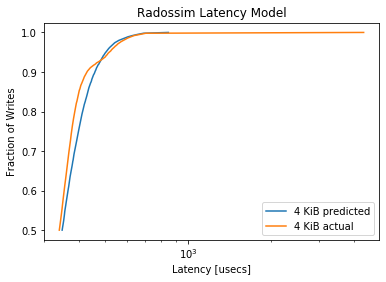

MainProcess pypet INFO     
 Finished single run #712 of 1680 

MainProcess pypet INFO     
 Starting single run #713 of 1680 



minimum predicted latency: 212.970815
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.143, pvalue=1.5540286405170744e-89)


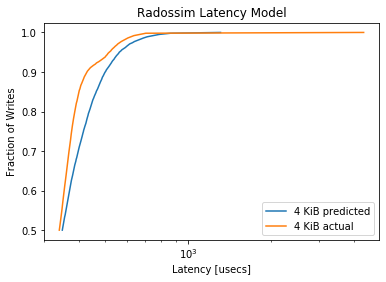

MainProcess pypet INFO     
 Finished single run #713 of 1680 

MainProcess pypet INFO     
 Starting single run #714 of 1680 



minimum predicted latency: 222.245620
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2121, pvalue=2.7903381835098426e-197)


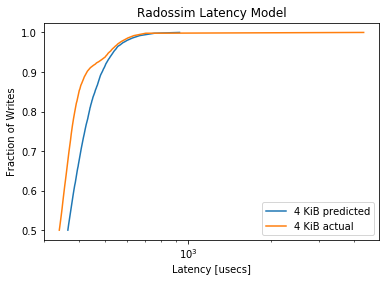

MainProcess pypet INFO     
 Finished single run #714 of 1680 

MainProcess pypet INFO     
 Starting single run #715 of 1680 



minimum predicted latency: 212.996683
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2122, pvalue=1.8136507629000206e-197)


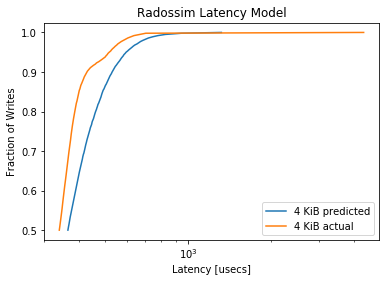

MainProcess pypet INFO     
 Finished single run #715 of 1680 

MainProcess pypet INFO     
 Starting single run #716 of 1680 



minimum predicted latency: 231.853969
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2937, pvalue=1e-323)


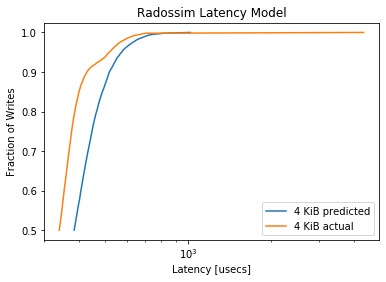

MainProcess pypet INFO     
 Finished single run #716 of 1680 

MainProcess pypet INFO     
 Starting single run #717 of 1680 



minimum predicted latency: 206.084566
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2843, pvalue=1e-323)


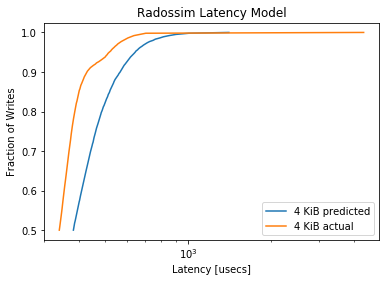

MainProcess pypet INFO     
 Finished single run #717 of 1680 

MainProcess pypet INFO     
 Starting single run #718 of 1680 



minimum predicted latency: 233.941273
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3945, pvalue=0.0)


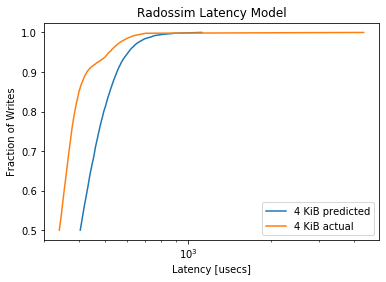

MainProcess pypet INFO     
 Finished single run #718 of 1680 

MainProcess pypet INFO     
 Starting single run #719 of 1680 



minimum predicted latency: 215.620671
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3619, pvalue=0.0)


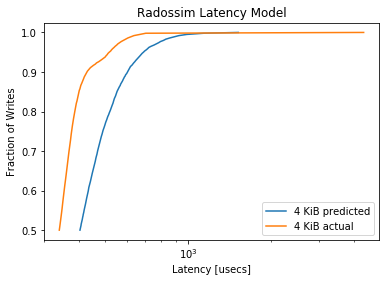

MainProcess pypet INFO     
 Finished single run #719 of 1680 

MainProcess pypet INFO     
 Starting single run #720 of 1680 



minimum predicted latency: 202.697420
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.436, pvalue=0.0)


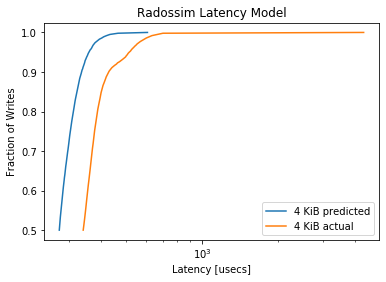

MainProcess pypet INFO     
 Finished single run #720 of 1680 

MainProcess pypet INFO     
 Starting single run #721 of 1680 



minimum predicted latency: 199.076514
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3835, pvalue=0.0)


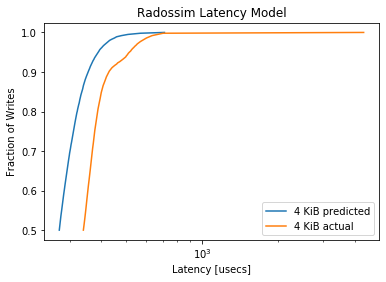

MainProcess pypet INFO     
 Finished single run #721 of 1680 

MainProcess pypet INFO     
 Starting single run #722 of 1680 



minimum predicted latency: 208.055018
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.386, pvalue=0.0)


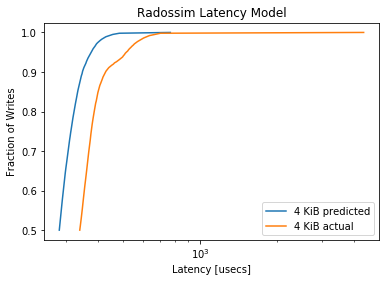

MainProcess pypet INFO     
 Finished single run #722 of 1680 

MainProcess pypet INFO     
 Starting single run #723 of 1680 



minimum predicted latency: 200.577072
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3288, pvalue=1e-323)


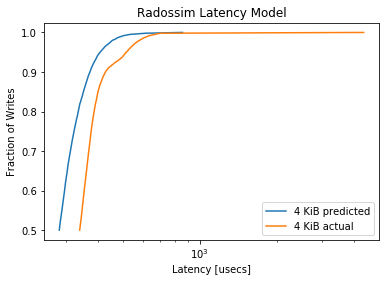

MainProcess pypet INFO     
 Finished single run #723 of 1680 

MainProcess pypet INFO     
 Starting single run #724 of 1680 



minimum predicted latency: 209.352962
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3178, pvalue=1e-323)


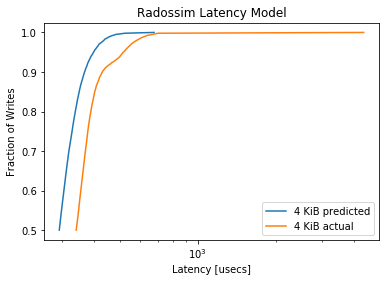

MainProcess pypet INFO     
 Finished single run #724 of 1680 

MainProcess pypet INFO     
 Starting single run #725 of 1680 



minimum predicted latency: 199.281098
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2645, pvalue=6.879185245291027e-308)


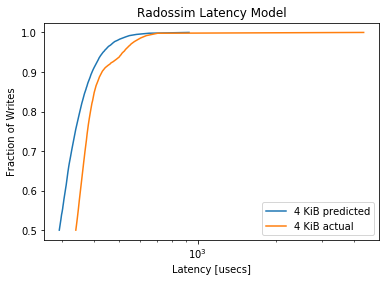

MainProcess pypet INFO     
 Finished single run #725 of 1680 

MainProcess pypet INFO     
 Starting single run #726 of 1680 



minimum predicted latency: 202.153126
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2432, pvalue=7.102259281319174e-260)


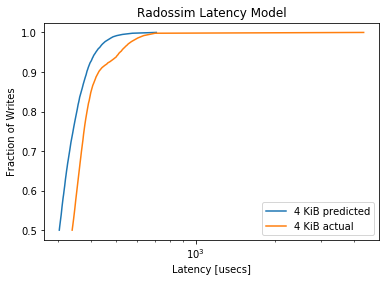

MainProcess pypet INFO     
 Finished single run #726 of 1680 

MainProcess pypet INFO     
 Starting single run #727 of 1680 



minimum predicted latency: 200.810670
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1916, pvalue=7.71134249851073e-161)


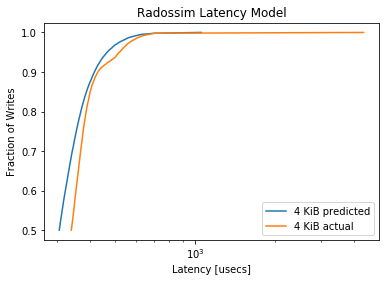

MainProcess pypet INFO     
 Finished single run #727 of 1680 

MainProcess pypet INFO     
 Starting single run #728 of 1680 



minimum predicted latency: 210.749592
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1589, pvalue=1.5292497441698822e-110)


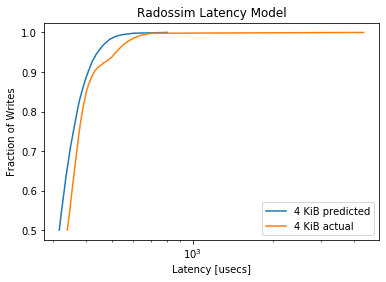

MainProcess pypet INFO     
 Finished single run #728 of 1680 

MainProcess pypet INFO     
 Starting single run #729 of 1680 



minimum predicted latency: 198.792720
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.126, pvalue=1.4869848372428608e-69)


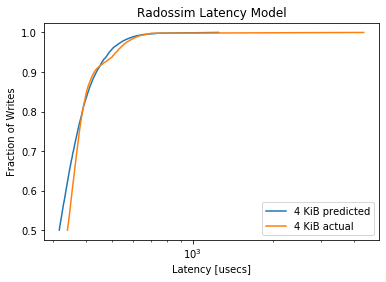

MainProcess pypet INFO     
 Finished single run #729 of 1680 

MainProcess pypet INFO     
 Starting single run #730 of 1680 



minimum predicted latency: 221.240619
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0878, pvalue=6.032486036954906e-34)


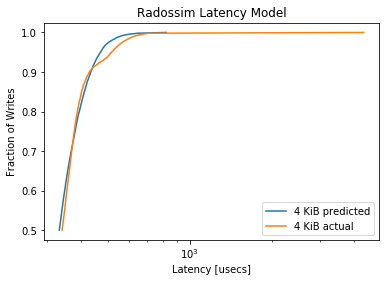

MainProcess pypet INFO     
 Finished single run #730 of 1680 

MainProcess pypet INFO     
 Starting single run #731 of 1680 



minimum predicted latency: 205.762730
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0735, pvalue=6.597243091950528e-24)


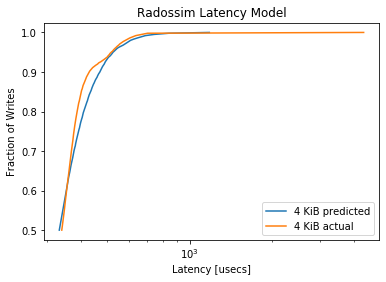

MainProcess pypet INFO     
 Finished single run #731 of 1680 

MainProcess pypet INFO     
 Starting single run #732 of 1680 



minimum predicted latency: 214.868365
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1518, pvalue=6.960514835227332e-101)


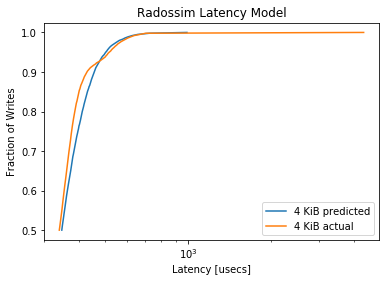

MainProcess pypet INFO     
 Finished single run #732 of 1680 

MainProcess pypet INFO     
 Starting single run #733 of 1680 



minimum predicted latency: 207.357654
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1465, pvalue=5.755249175110394e-94)


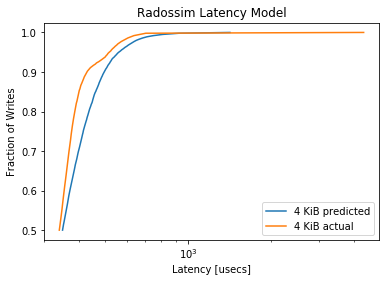

MainProcess pypet INFO     
 Finished single run #733 of 1680 

MainProcess pypet INFO     
 Starting single run #734 of 1680 



minimum predicted latency: 225.874768
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2113, pvalue=8.693778643720441e-196)


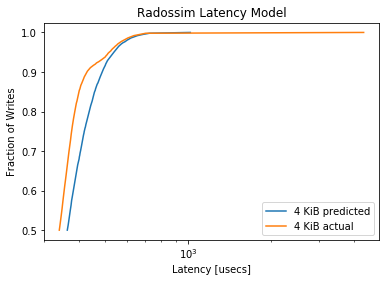

MainProcess pypet INFO     
 Finished single run #734 of 1680 

MainProcess pypet INFO     
 Starting single run #735 of 1680 



minimum predicted latency: 209.869328
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2085, pvalue=1.3207871875523273e-190)


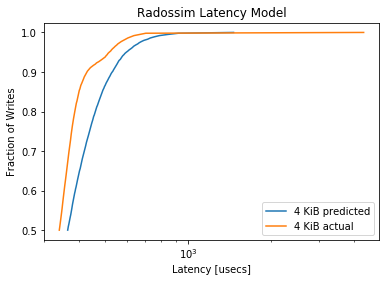

MainProcess pypet INFO     
 Finished single run #735 of 1680 

MainProcess pypet INFO     
 Starting single run #736 of 1680 



minimum predicted latency: 224.745331
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2815, pvalue=1e-323)


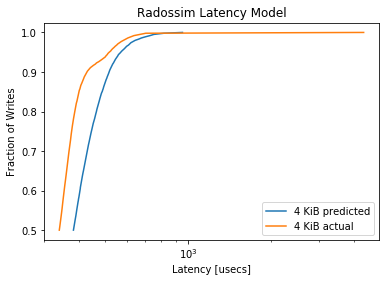

MainProcess pypet INFO     
 Finished single run #736 of 1680 

MainProcess pypet INFO     
 Starting single run #737 of 1680 



minimum predicted latency: 203.615043
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2968, pvalue=1e-323)


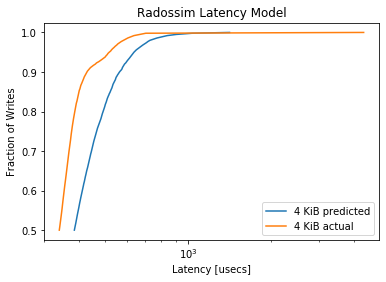

MainProcess pypet INFO     
 Finished single run #737 of 1680 

MainProcess pypet INFO     
 Starting single run #738 of 1680 



minimum predicted latency: 232.534089
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3893, pvalue=0.0)


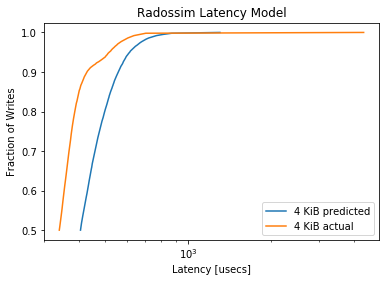

MainProcess pypet INFO     
 Finished single run #738 of 1680 

MainProcess pypet INFO     
 Starting single run #739 of 1680 



minimum predicted latency: 212.202732
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3716, pvalue=0.0)


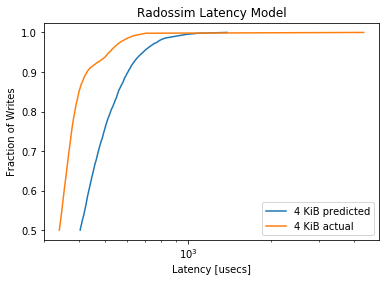

MainProcess pypet INFO     
 Finished single run #739 of 1680 

MainProcess pypet INFO     
 Starting single run #740 of 1680 



minimum predicted latency: 200.984302
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4389, pvalue=0.0)


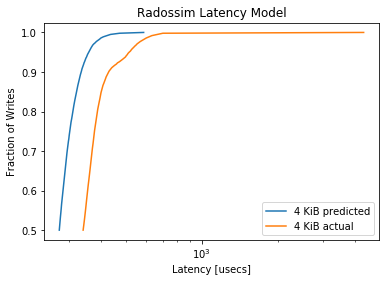

MainProcess pypet INFO     
 Finished single run #740 of 1680 

MainProcess pypet INFO     
 Starting single run #741 of 1680 



minimum predicted latency: 197.019167
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3895, pvalue=0.0)


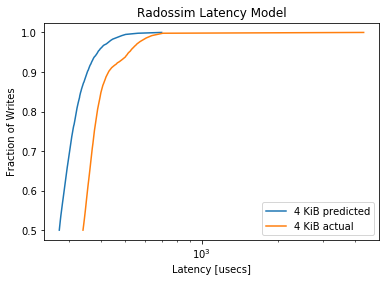

MainProcess pypet INFO     
 Finished single run #741 of 1680 

MainProcess pypet INFO     
 Starting single run #742 of 1680 



minimum predicted latency: 205.951867
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3818, pvalue=0.0)


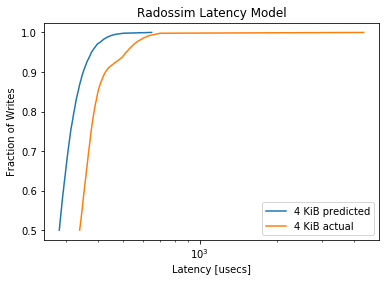

MainProcess pypet INFO     
 Finished single run #742 of 1680 

MainProcess pypet INFO     
 Starting single run #743 of 1680 



minimum predicted latency: 201.682602
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3251, pvalue=1e-323)


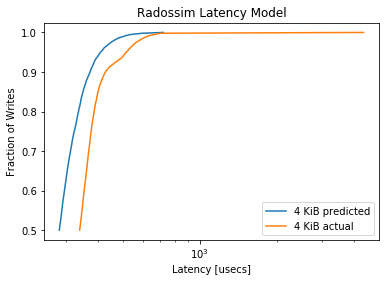

MainProcess pypet INFO     
 Finished single run #743 of 1680 

MainProcess pypet INFO     
 Starting single run #744 of 1680 



minimum predicted latency: 209.289149
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3148, pvalue=1e-323)


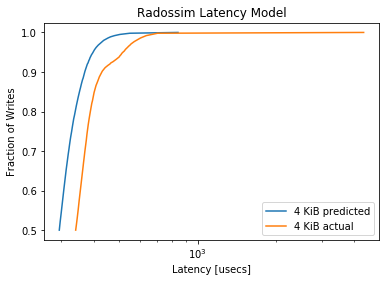

MainProcess pypet INFO     
 Finished single run #744 of 1680 

MainProcess pypet INFO     
 Starting single run #745 of 1680 



minimum predicted latency: 202.222018
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2703, pvalue=1.077e-321)


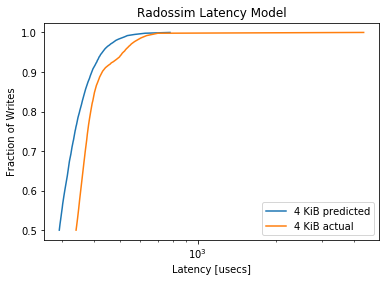

MainProcess pypet INFO     
 Finished single run #745 of 1680 

MainProcess pypet INFO     
 Starting single run #746 of 1680 



minimum predicted latency: 212.581579
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2307, pvalue=1.1893323354837773e-233)


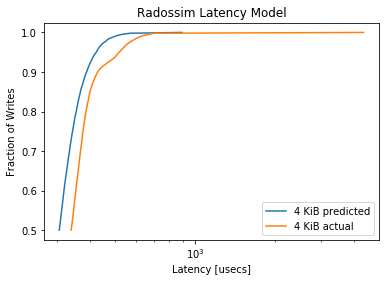

MainProcess pypet INFO     
 Finished single run #746 of 1680 

MainProcess pypet INFO     
 Starting single run #747 of 1680 



minimum predicted latency: 197.811974
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1981, pvalue=5.549853125161596e-172)


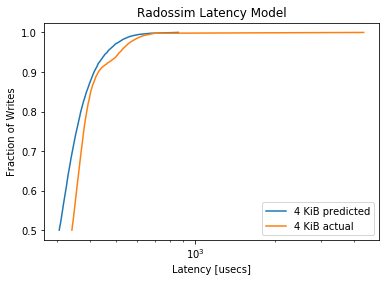

MainProcess pypet INFO     
 Finished single run #747 of 1680 

MainProcess pypet INFO     
 Starting single run #748 of 1680 



minimum predicted latency: 210.517958
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1443, pvalue=3.615744793262508e-91)


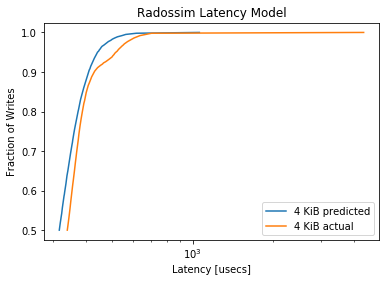

MainProcess pypet INFO     
 Finished single run #748 of 1680 

MainProcess pypet INFO     
 Starting single run #749 of 1680 



minimum predicted latency: 198.559374
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.124, pvalue=2.265094795231726e-67)


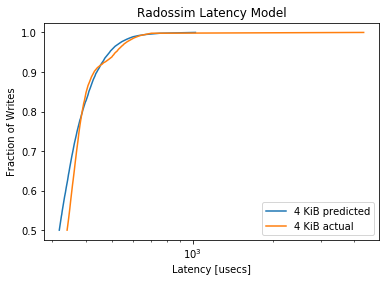

MainProcess pypet INFO     
 Finished single run #749 of 1680 

MainProcess pypet INFO     
 Starting single run #750 of 1680 



minimum predicted latency: 218.883765
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0886, pvalue=1.4657304341507354e-34)


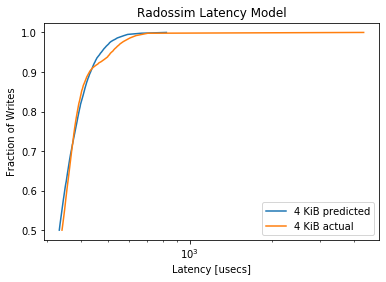

MainProcess pypet INFO     
 Finished single run #750 of 1680 

MainProcess pypet INFO     
 Starting single run #751 of 1680 



minimum predicted latency: 203.176213
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0802, pvalue=2.179784834082686e-28)


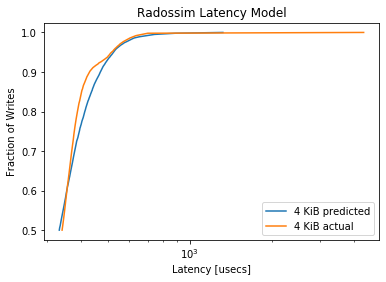

MainProcess pypet INFO     
 Finished single run #751 of 1680 

MainProcess pypet INFO     
 Starting single run #752 of 1680 



minimum predicted latency: 208.877719
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1557, pvalue=3.917354618969243e-106)


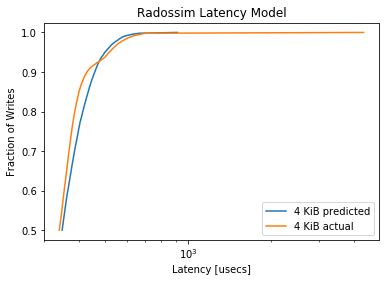

MainProcess pypet INFO     
 Finished single run #752 of 1680 

MainProcess pypet INFO     
 Starting single run #753 of 1680 



minimum predicted latency: 211.224875
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1449, pvalue=6.299836157817571e-92)


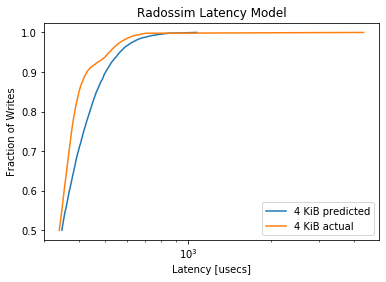

MainProcess pypet INFO     
 Finished single run #753 of 1680 

MainProcess pypet INFO     
 Starting single run #754 of 1680 



minimum predicted latency: 228.876066
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2134, pvalue=1.0144258188273733e-199)


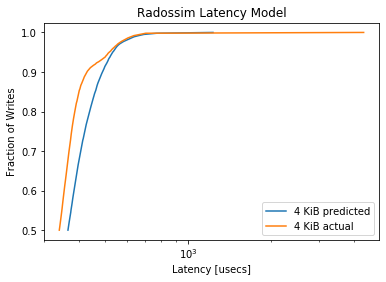

MainProcess pypet INFO     
 Finished single run #754 of 1680 

MainProcess pypet INFO     
 Starting single run #755 of 1680 



minimum predicted latency: 207.320072
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2079, pvalue=1.6669254544749703e-189)


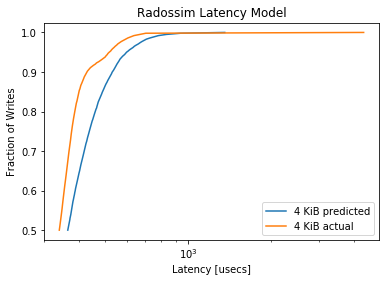

MainProcess pypet INFO     
 Finished single run #755 of 1680 

MainProcess pypet INFO     PROGRESS: Finished  756/1680 runs [=========           ] 45.0%, remaining: 0:06:10
MainProcess pypet INFO     
 Starting single run #756 of 1680 



minimum predicted latency: 234.271734
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2887, pvalue=1e-323)


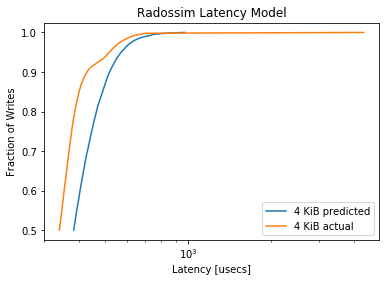

MainProcess pypet INFO     
 Finished single run #756 of 1680 

MainProcess pypet INFO     
 Starting single run #757 of 1680 



minimum predicted latency: 213.215405
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2801, pvalue=1e-323)


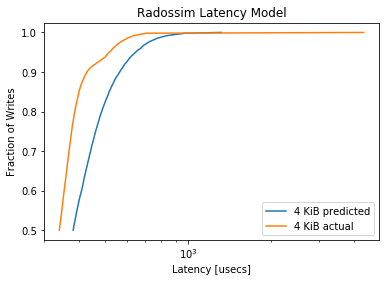

MainProcess pypet INFO     
 Finished single run #757 of 1680 

MainProcess pypet INFO     
 Starting single run #758 of 1680 



minimum predicted latency: 228.166376
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.393, pvalue=0.0)


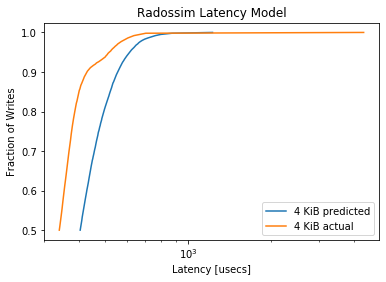

MainProcess pypet INFO     
 Finished single run #758 of 1680 

MainProcess pypet INFO     
 Starting single run #759 of 1680 



minimum predicted latency: 200.319962
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.37, pvalue=0.0)


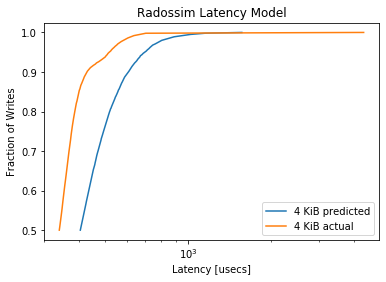

MainProcess pypet INFO     
 Finished single run #759 of 1680 

MainProcess pypet INFO     
 Starting single run #760 of 1680 



minimum predicted latency: 202.759269
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4412, pvalue=0.0)


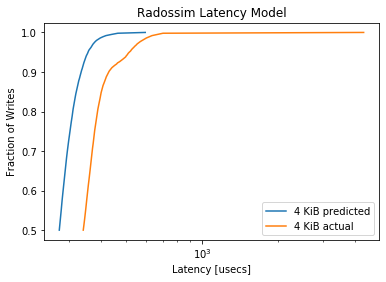

MainProcess pypet INFO     
 Finished single run #760 of 1680 

MainProcess pypet INFO     
 Starting single run #761 of 1680 



minimum predicted latency: 197.798765
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3776, pvalue=0.0)


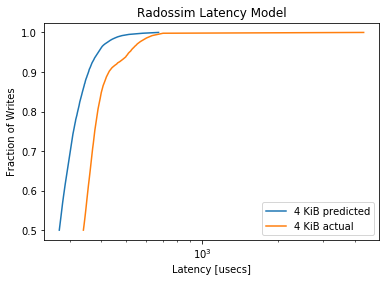

MainProcess pypet INFO     
 Finished single run #761 of 1680 

MainProcess pypet INFO     
 Starting single run #762 of 1680 



minimum predicted latency: 203.056434
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3878, pvalue=0.0)


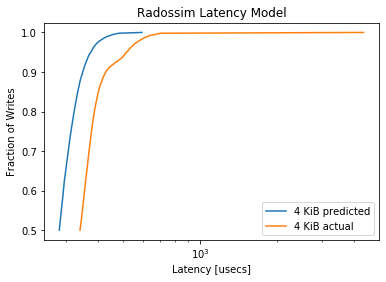

MainProcess pypet INFO     
 Finished single run #762 of 1680 

MainProcess pypet INFO     
 Starting single run #763 of 1680 



minimum predicted latency: 199.294786
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3344, pvalue=0.0)


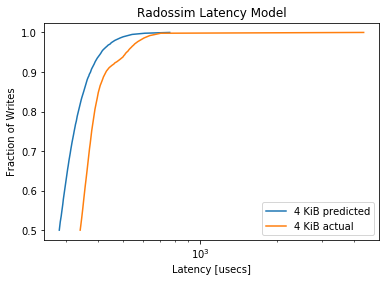

MainProcess pypet INFO     
 Finished single run #763 of 1680 

MainProcess pypet INFO     
 Starting single run #764 of 1680 



minimum predicted latency: 206.289379
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.327, pvalue=1e-323)


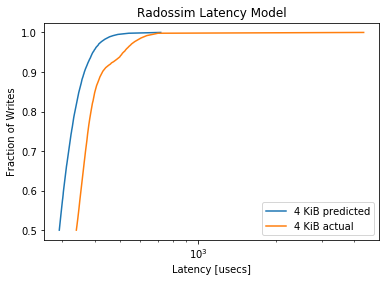

MainProcess pypet INFO     
 Finished single run #764 of 1680 

MainProcess pypet INFO     
 Starting single run #765 of 1680 



minimum predicted latency: 198.998042
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2708, pvalue=7e-323)


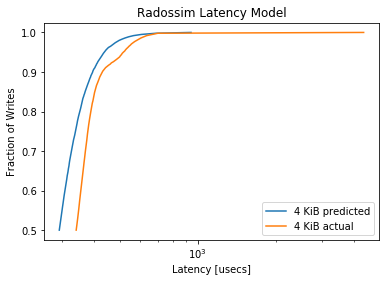

MainProcess pypet INFO     
 Finished single run #765 of 1680 

MainProcess pypet INFO     
 Starting single run #766 of 1680 



minimum predicted latency: 215.183142
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2449, pvalue=1.491853362038266e-263)


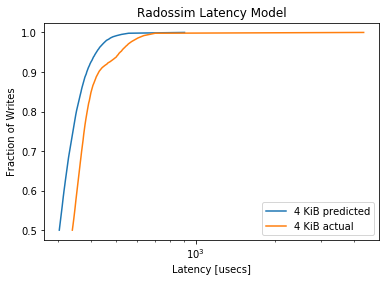

MainProcess pypet INFO     
 Finished single run #766 of 1680 

MainProcess pypet INFO     
 Starting single run #767 of 1680 



minimum predicted latency: 198.632485
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2089, pvalue=2.4263939580157533e-191)


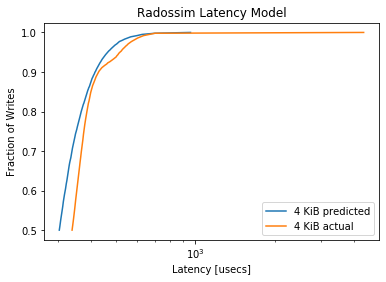

MainProcess pypet INFO     
 Finished single run #767 of 1680 

MainProcess pypet INFO     
 Starting single run #768 of 1680 



minimum predicted latency: 213.853825
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1559, pvalue=2.0899315928227007e-106)


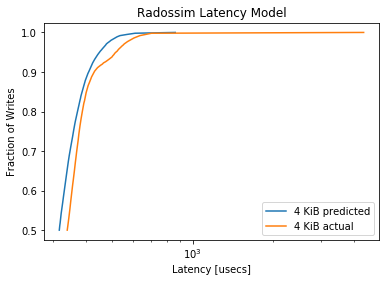

MainProcess pypet INFO     
 Finished single run #768 of 1680 

MainProcess pypet INFO     
 Starting single run #769 of 1680 



minimum predicted latency: 203.600359
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1328, pvalue=3.0667934135073556e-77)


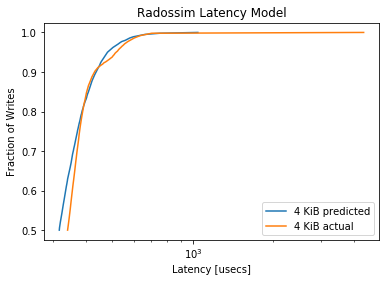

MainProcess pypet INFO     
 Finished single run #769 of 1680 

MainProcess pypet INFO     
 Starting single run #770 of 1680 



minimum predicted latency: 218.371693
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0811, pvalue=5.088710163676831e-29)


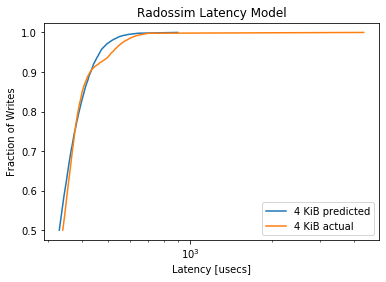

MainProcess pypet INFO     
 Finished single run #770 of 1680 

MainProcess pypet INFO     
 Starting single run #771 of 1680 



minimum predicted latency: 203.293898
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0727, pvalue=2.129097171413371e-23)


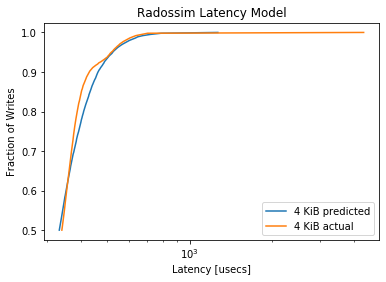

MainProcess pypet INFO     
 Finished single run #771 of 1680 

MainProcess pypet INFO     
 Starting single run #772 of 1680 



minimum predicted latency: 225.796889
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1507, pvalue=1.9900133332484954e-99)


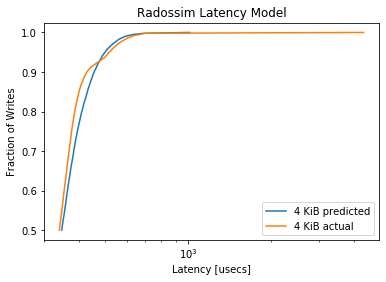

MainProcess pypet INFO     
 Finished single run #772 of 1680 

MainProcess pypet INFO     
 Starting single run #773 of 1680 



minimum predicted latency: 199.380164
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1399, pvalue=1.0609579535436868e-85)


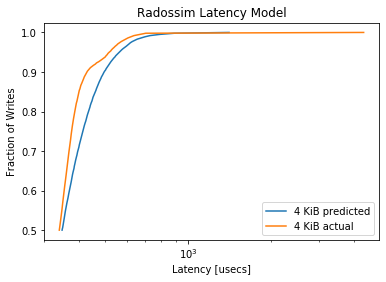

MainProcess pypet INFO     
 Finished single run #773 of 1680 

MainProcess pypet INFO     
 Starting single run #774 of 1680 



minimum predicted latency: 213.194050
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2118, pvalue=1.0148940890876293e-196)


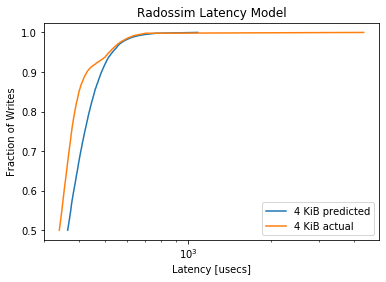

MainProcess pypet INFO     
 Finished single run #774 of 1680 

MainProcess pypet INFO     
 Starting single run #775 of 1680 



minimum predicted latency: 205.116644
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2015, pvalue=5.802725766067459e-178)


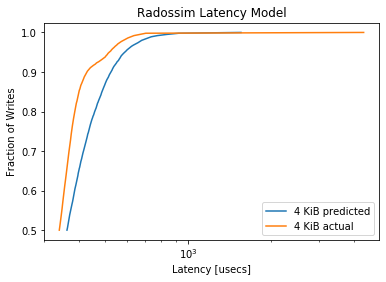

MainProcess pypet INFO     
 Finished single run #775 of 1680 

MainProcess pypet INFO     
 Starting single run #776 of 1680 



minimum predicted latency: 224.100850
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2825, pvalue=1e-323)


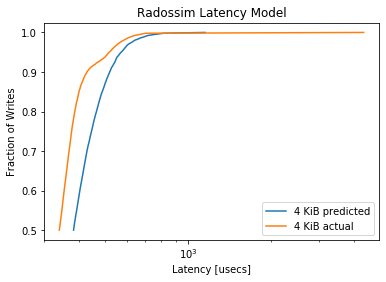

MainProcess pypet INFO     
 Finished single run #776 of 1680 

MainProcess pypet INFO     
 Starting single run #777 of 1680 



minimum predicted latency: 203.542087
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2921, pvalue=1e-323)


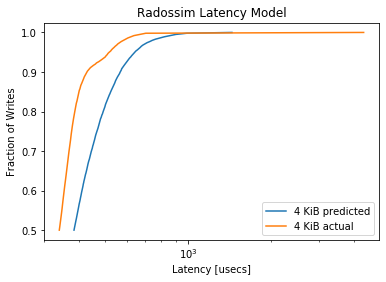

MainProcess pypet INFO     
 Finished single run #777 of 1680 

MainProcess pypet INFO     
 Starting single run #778 of 1680 



minimum predicted latency: 229.680129
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3871, pvalue=0.0)


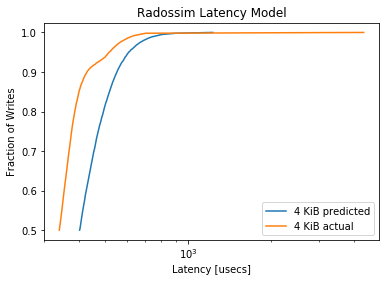

MainProcess pypet INFO     
 Finished single run #778 of 1680 

MainProcess pypet INFO     
 Starting single run #779 of 1680 



minimum predicted latency: 222.954757
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.366, pvalue=0.0)


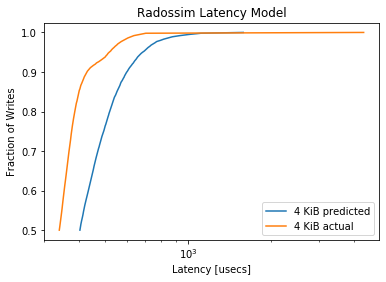

MainProcess pypet INFO     
 Finished single run #779 of 1680 

MainProcess pypet INFO     
 Starting single run #780 of 1680 



minimum predicted latency: 201.885877
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4409, pvalue=0.0)


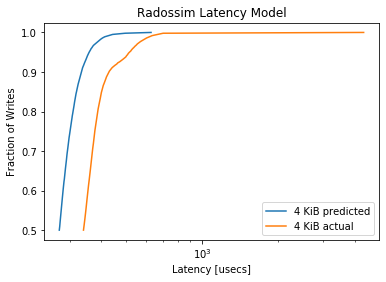

MainProcess pypet INFO     
 Finished single run #780 of 1680 

MainProcess pypet INFO     
 Starting single run #781 of 1680 



minimum predicted latency: 198.291966
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3904, pvalue=0.0)


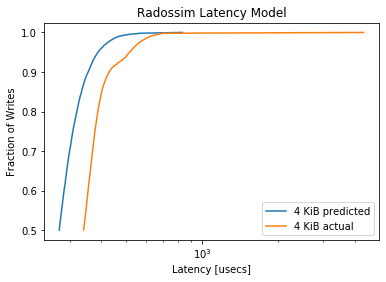

MainProcess pypet INFO     
 Finished single run #781 of 1680 

MainProcess pypet INFO     
 Starting single run #782 of 1680 



minimum predicted latency: 204.174909
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3884, pvalue=0.0)


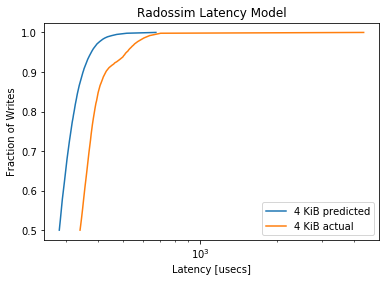

MainProcess pypet INFO     
 Finished single run #782 of 1680 

MainProcess pypet INFO     
 Starting single run #783 of 1680 



minimum predicted latency: 197.694775
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3393, pvalue=0.0)


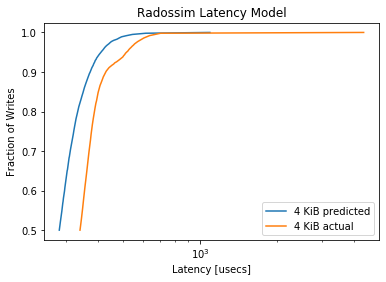

MainProcess pypet INFO     
 Finished single run #783 of 1680 

MainProcess pypet INFO     
 Starting single run #784 of 1680 



minimum predicted latency: 208.837535
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3188, pvalue=1e-323)


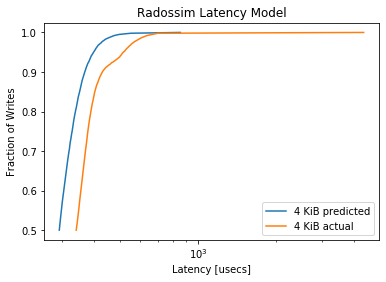

MainProcess pypet INFO     
 Finished single run #784 of 1680 

MainProcess pypet INFO     
 Starting single run #785 of 1680 



minimum predicted latency: 199.510357
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2739, pvalue=1e-323)


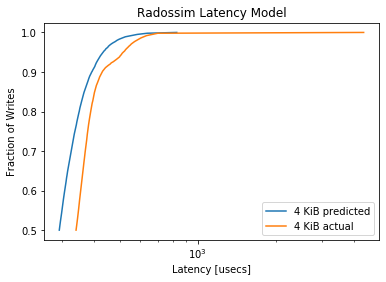

MainProcess pypet INFO     
 Finished single run #785 of 1680 

MainProcess pypet INFO     
 Starting single run #786 of 1680 



minimum predicted latency: 210.404298
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2376, pvalue=5.991165539643632e-248)


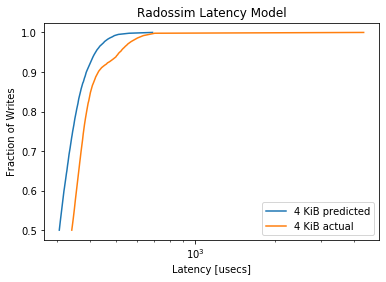

MainProcess pypet INFO     
 Finished single run #786 of 1680 

MainProcess pypet INFO     
 Starting single run #787 of 1680 



minimum predicted latency: 200.952089
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2158, pvalue=2.8989137068833746e-204)


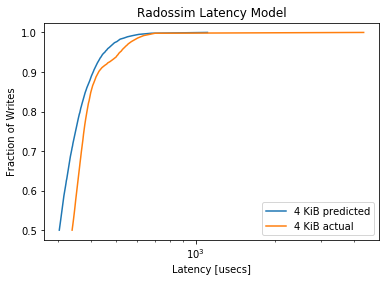

MainProcess pypet INFO     
 Finished single run #787 of 1680 

MainProcess pypet INFO     
 Starting single run #788 of 1680 



minimum predicted latency: 212.196922
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1637, pvalue=2.515338516330496e-117)


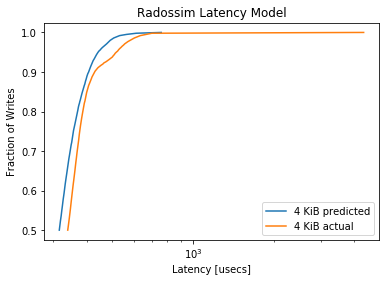

MainProcess pypet INFO     
 Finished single run #788 of 1680 

MainProcess pypet INFO     
 Starting single run #789 of 1680 



minimum predicted latency: 206.929331
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1252, pvalue=1.1211242232501435e-68)


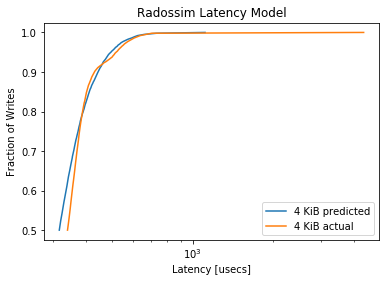

MainProcess pypet INFO     
 Finished single run #789 of 1680 

MainProcess pypet INFO     
 Starting single run #790 of 1680 



minimum predicted latency: 213.146825
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0891, pvalue=6.014266440293131e-35)


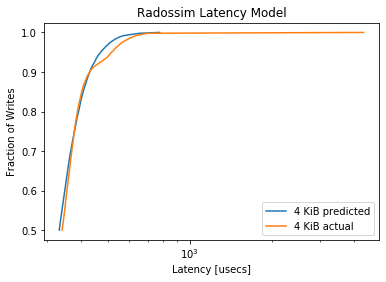

MainProcess pypet INFO     
 Finished single run #790 of 1680 

MainProcess pypet INFO     
 Starting single run #791 of 1680 



minimum predicted latency: 196.867886
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0652, pvalue=6.711508192196644e-19)


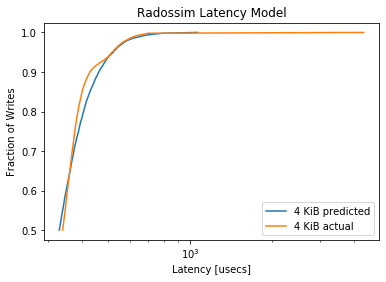

MainProcess pypet INFO     
 Finished single run #791 of 1680 

MainProcess pypet INFO     
 Starting single run #792 of 1680 



minimum predicted latency: 222.521497
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1552, pvalue=1.877531645455597e-105)


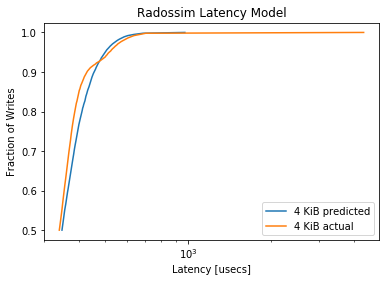

MainProcess pypet INFO     
 Finished single run #792 of 1680 

MainProcess pypet INFO     
 Starting single run #793 of 1680 



minimum predicted latency: 203.761918
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1342, pvalue=7.138804405266538e-79)


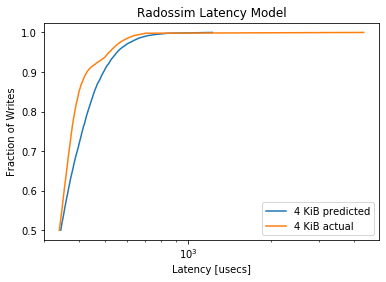

MainProcess pypet INFO     
 Finished single run #793 of 1680 

MainProcess pypet INFO     
 Starting single run #794 of 1680 



minimum predicted latency: 221.602470
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2162, pvalue=5.009617711611607e-205)


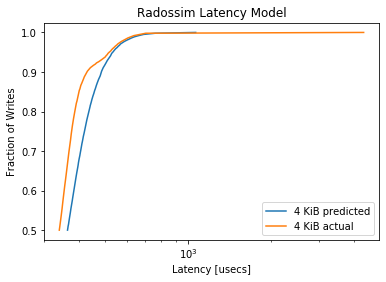

MainProcess pypet INFO     
 Finished single run #794 of 1680 

MainProcess pypet INFO     
 Starting single run #795 of 1680 



minimum predicted latency: 213.293487
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2034, pvalue=2.3764687169088517e-181)


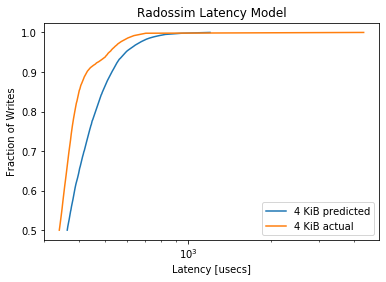

MainProcess pypet INFO     
 Finished single run #795 of 1680 

MainProcess pypet INFO     
 Starting single run #796 of 1680 



minimum predicted latency: 224.530641
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2832, pvalue=1e-323)


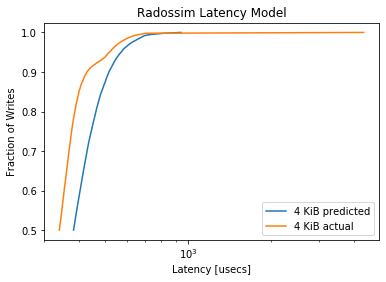

MainProcess pypet INFO     
 Finished single run #796 of 1680 

MainProcess pypet INFO     
 Starting single run #797 of 1680 



minimum predicted latency: 217.400456
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2883, pvalue=1e-323)


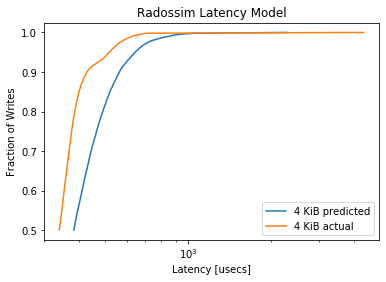

MainProcess pypet INFO     
 Finished single run #797 of 1680 

MainProcess pypet INFO     
 Starting single run #798 of 1680 



minimum predicted latency: 228.487487
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3859, pvalue=0.0)


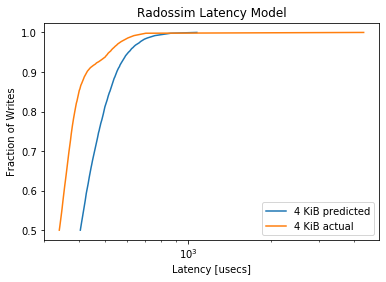

MainProcess pypet INFO     
 Finished single run #798 of 1680 

MainProcess pypet INFO     
 Starting single run #799 of 1680 



minimum predicted latency: 219.636800
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.36, pvalue=0.0)


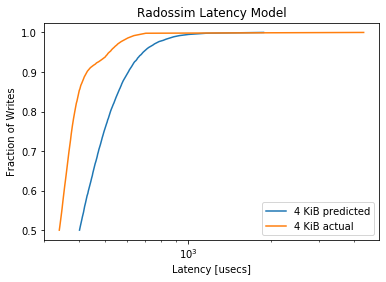

MainProcess pypet INFO     
 Finished single run #799 of 1680 

MainProcess pypet INFO     
 Starting single run #800 of 1680 



minimum predicted latency: 204.877136
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4453, pvalue=0.0)


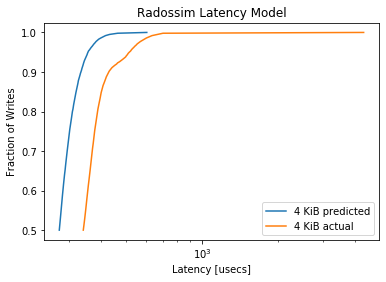

MainProcess pypet INFO     
 Finished single run #800 of 1680 

MainProcess pypet INFO     
 Starting single run #801 of 1680 



minimum predicted latency: 196.891696
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3862, pvalue=0.0)


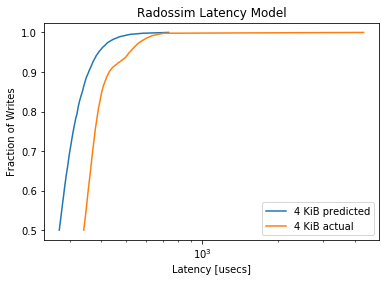

MainProcess pypet INFO     
 Finished single run #801 of 1680 

MainProcess pypet INFO     
 Starting single run #802 of 1680 



minimum predicted latency: 205.220482
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3928, pvalue=0.0)


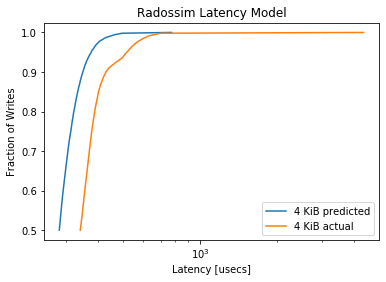

MainProcess pypet INFO     
 Finished single run #802 of 1680 

MainProcess pypet INFO     
 Starting single run #803 of 1680 



minimum predicted latency: 199.072424
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3398, pvalue=0.0)


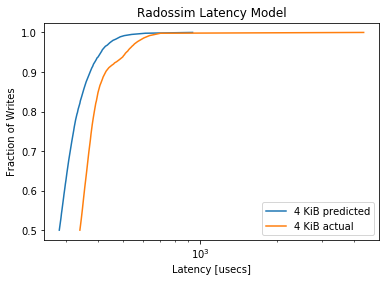

MainProcess pypet INFO     
 Finished single run #803 of 1680 

MainProcess pypet INFO     
 Starting single run #804 of 1680 



minimum predicted latency: 207.123545
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3257, pvalue=1e-323)


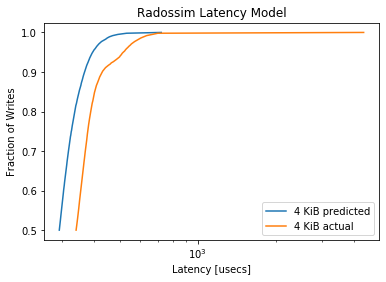

MainProcess pypet INFO     
 Finished single run #804 of 1680 

MainProcess pypet INFO     
 Starting single run #805 of 1680 



minimum predicted latency: 201.045917
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2778, pvalue=1e-323)


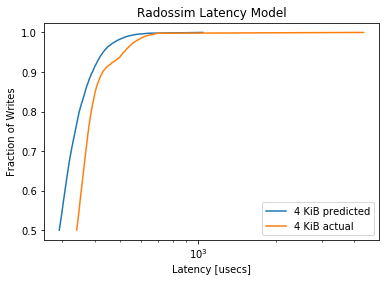

MainProcess pypet INFO     
 Finished single run #805 of 1680 

MainProcess pypet INFO     
 Starting single run #806 of 1680 



minimum predicted latency: 206.058559
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2434, pvalue=2.6309620498141225e-260)


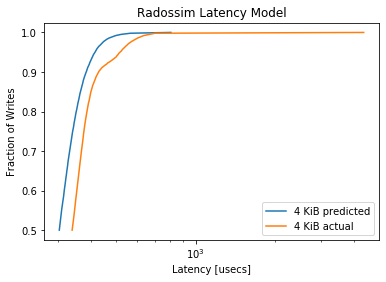

MainProcess pypet INFO     
 Finished single run #806 of 1680 

MainProcess pypet INFO     
 Starting single run #807 of 1680 



minimum predicted latency: 201.684297
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2064, pvalue=9.127017055602901e-187)


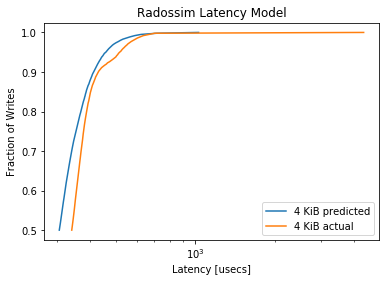

MainProcess pypet INFO     
 Finished single run #807 of 1680 

MainProcess pypet INFO     
 Starting single run #808 of 1680 



minimum predicted latency: 205.614837
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1444, pvalue=2.70359386542706e-91)


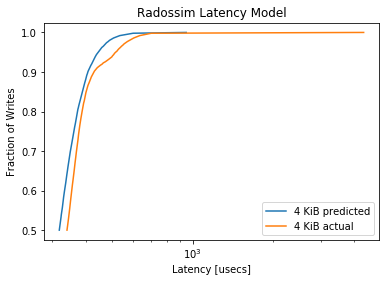

MainProcess pypet INFO     
 Finished single run #808 of 1680 

MainProcess pypet INFO     
 Starting single run #809 of 1680 



minimum predicted latency: 204.834637
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1315, pvalue=9.718063814704159e-76)


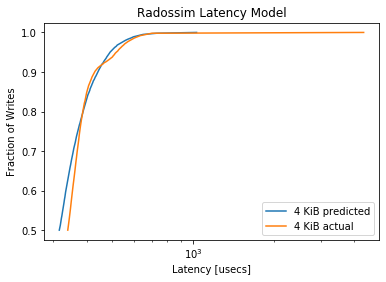

MainProcess pypet INFO     
 Finished single run #809 of 1680 

MainProcess pypet INFO     
 Starting single run #810 of 1680 



minimum predicted latency: 218.264469
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0841, pvalue=3.5435276374921538e-31)


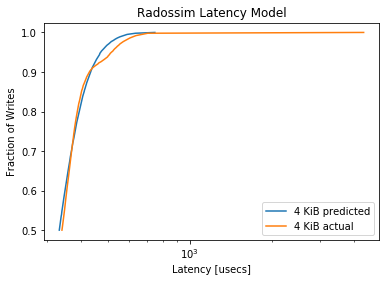

MainProcess pypet INFO     
 Finished single run #810 of 1680 

MainProcess pypet INFO     
 Starting single run #811 of 1680 



minimum predicted latency: 198.555849
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0723, pvalue=3.806416926907379e-23)


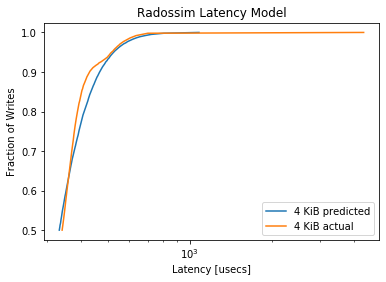

MainProcess pypet INFO     
 Finished single run #811 of 1680 

MainProcess pypet INFO     
 Starting single run #812 of 1680 



minimum predicted latency: 217.628276
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1557, pvalue=3.917354618969243e-106)


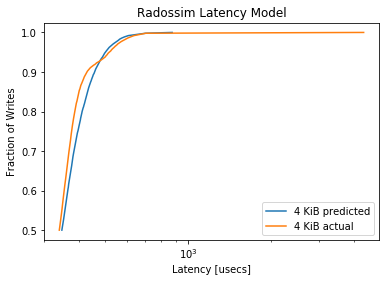

MainProcess pypet INFO     
 Finished single run #812 of 1680 

MainProcess pypet INFO     
 Starting single run #813 of 1680 



minimum predicted latency: 206.264768
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1273, pvalue=5.427126514757291e-71)


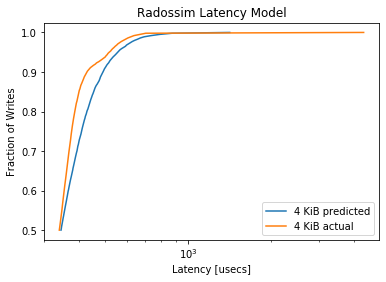

MainProcess pypet INFO     
 Finished single run #813 of 1680 

MainProcess pypet INFO     
 Starting single run #814 of 1680 



minimum predicted latency: 214.179669
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2042, pvalue=8.704594947411303e-183)


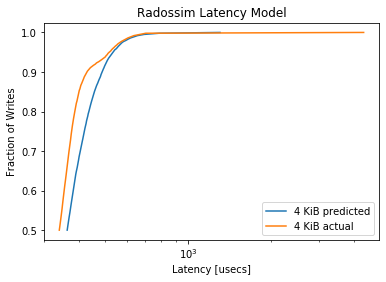

MainProcess pypet INFO     
 Finished single run #814 of 1680 

MainProcess pypet INFO     
 Starting single run #815 of 1680 



minimum predicted latency: 204.512205
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2049, pvalue=4.767929099263341e-184)


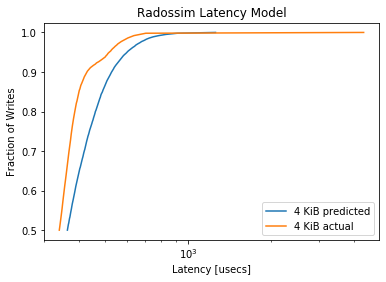

MainProcess pypet INFO     
 Finished single run #815 of 1680 

MainProcess pypet INFO     
 Starting single run #816 of 1680 



minimum predicted latency: 223.276435
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2855, pvalue=1e-323)


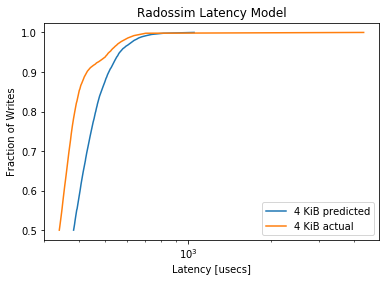

MainProcess pypet INFO     
 Finished single run #816 of 1680 

MainProcess pypet INFO     
 Starting single run #817 of 1680 



minimum predicted latency: 208.549940
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2875, pvalue=1e-323)


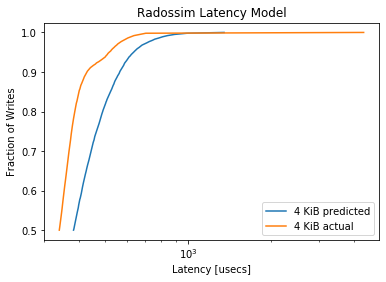

MainProcess pypet INFO     
 Finished single run #817 of 1680 

MainProcess pypet INFO     
 Starting single run #818 of 1680 



minimum predicted latency: 229.527600
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3869, pvalue=0.0)


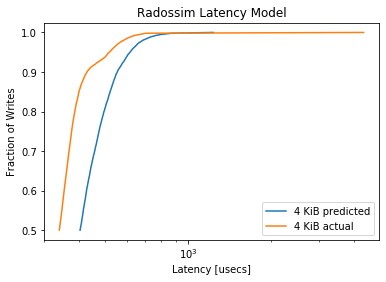

MainProcess pypet INFO     
 Finished single run #818 of 1680 

MainProcess pypet INFO     
 Starting single run #819 of 1680 



minimum predicted latency: 212.272583
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3675, pvalue=0.0)


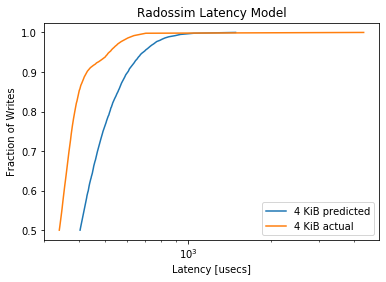

MainProcess pypet INFO     
 Finished single run #819 of 1680 

MainProcess pypet INFO     
 Starting single run #820 of 1680 



minimum predicted latency: 204.099022
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4489, pvalue=0.0)


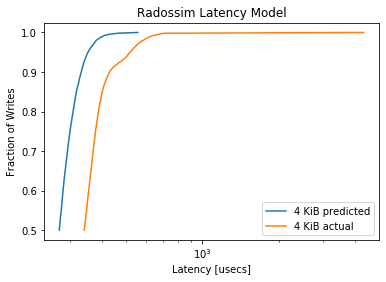

MainProcess pypet INFO     
 Finished single run #820 of 1680 

MainProcess pypet INFO     
 Starting single run #821 of 1680 



minimum predicted latency: 195.614550
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3962, pvalue=0.0)


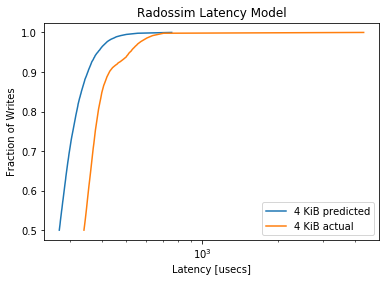

MainProcess pypet INFO     
 Finished single run #821 of 1680 

MainProcess pypet INFO     
 Starting single run #822 of 1680 



minimum predicted latency: 208.746882
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.395, pvalue=0.0)


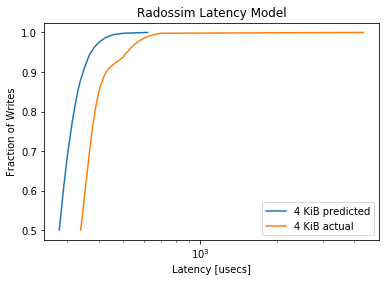

MainProcess pypet INFO     
 Finished single run #822 of 1680 

MainProcess pypet INFO     
 Starting single run #823 of 1680 



minimum predicted latency: 196.581677
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3447, pvalue=0.0)


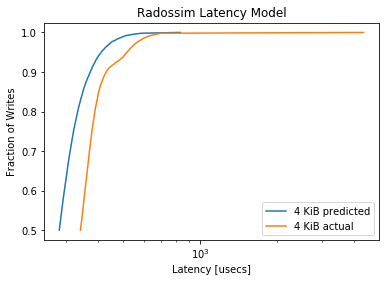

MainProcess pypet INFO     
 Finished single run #823 of 1680 

MainProcess pypet INFO     
 Starting single run #824 of 1680 



minimum predicted latency: 208.513233
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3285, pvalue=1e-323)


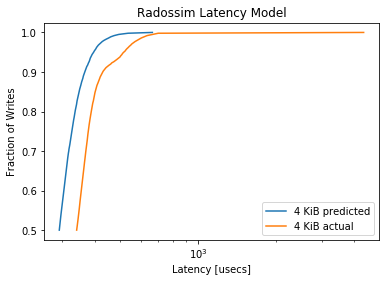

MainProcess pypet INFO     
 Finished single run #824 of 1680 

MainProcess pypet INFO     
 Starting single run #825 of 1680 



minimum predicted latency: 200.395443
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2754, pvalue=1e-323)


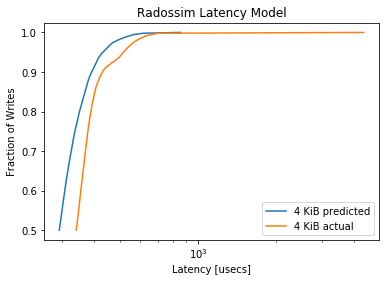

MainProcess pypet INFO     
 Finished single run #825 of 1680 

MainProcess pypet INFO     
 Starting single run #826 of 1680 



minimum predicted latency: 211.413223
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2534, pvalue=2.423043562659258e-282)


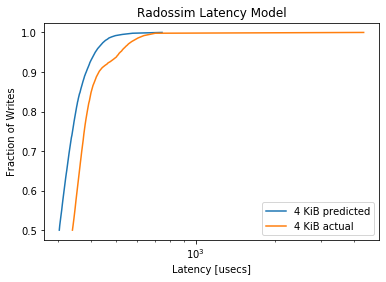

MainProcess pypet INFO     
 Finished single run #826 of 1680 

MainProcess pypet INFO     
 Starting single run #827 of 1680 



minimum predicted latency: 201.410269
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1979, pvalue=1.2383074661322037e-171)


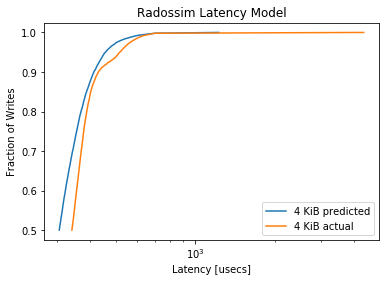

MainProcess pypet INFO     
 Finished single run #827 of 1680 

MainProcess pypet INFO     
 Starting single run #828 of 1680 



minimum predicted latency: 209.405120
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.162, pvalue=6.7099705555812415e-115)


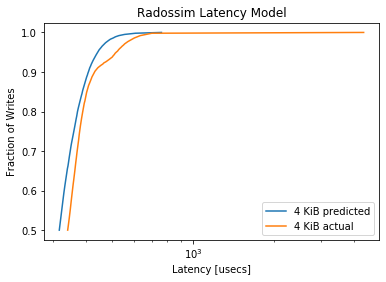

MainProcess pypet INFO     
 Finished single run #828 of 1680 

MainProcess pypet INFO     
 Starting single run #829 of 1680 



minimum predicted latency: 206.530729
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1279, pvalue=1.1640382789879722e-71)


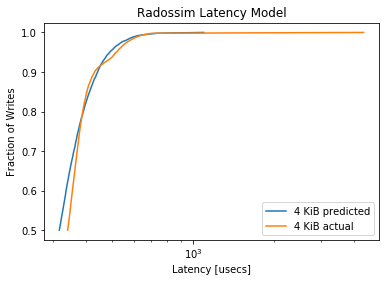

MainProcess pypet INFO     
 Finished single run #829 of 1680 

MainProcess pypet INFO     
 Starting single run #830 of 1680 



minimum predicted latency: 213.962052
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0797, pvalue=4.856878704971798e-28)


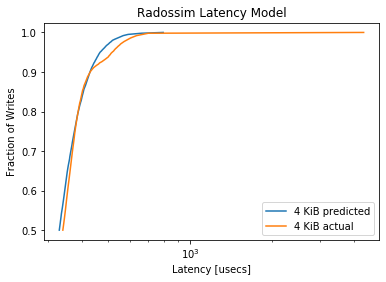

MainProcess pypet INFO     
 Finished single run #830 of 1680 

MainProcess pypet INFO     
 Starting single run #831 of 1680 



minimum predicted latency: 204.555081
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0818, pvalue=1.6229573858276633e-29)


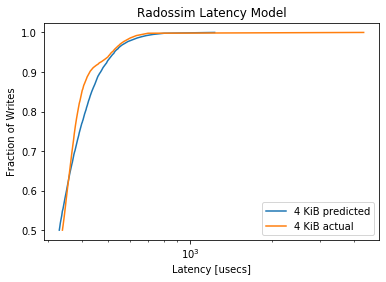

MainProcess pypet INFO     
 Finished single run #831 of 1680 

MainProcess pypet INFO     
 Starting single run #832 of 1680 



minimum predicted latency: 222.077565
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1469, pvalue=1.7648097754333257e-94)


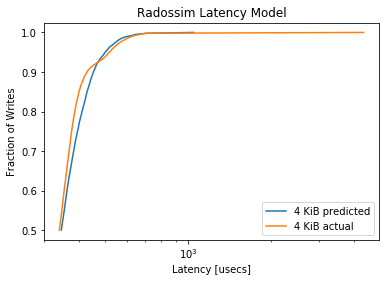

MainProcess pypet INFO     
 Finished single run #832 of 1680 

MainProcess pypet INFO     
 Starting single run #833 of 1680 



minimum predicted latency: 202.639308
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1348, pvalue=1.4074616985197138e-79)


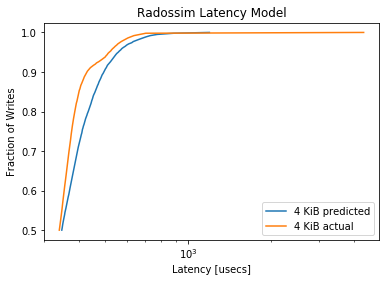

MainProcess pypet INFO     
 Finished single run #833 of 1680 

MainProcess pypet INFO     
 Starting single run #834 of 1680 



minimum predicted latency: 224.704144
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2054, pvalue=5.951091656639207e-185)


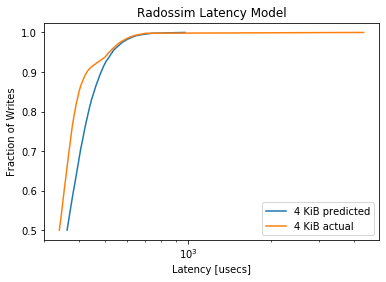

MainProcess pypet INFO     
 Finished single run #834 of 1680 

MainProcess pypet INFO     
 Starting single run #835 of 1680 



minimum predicted latency: 211.049399
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2088, pvalue=3.707365591310976e-191)


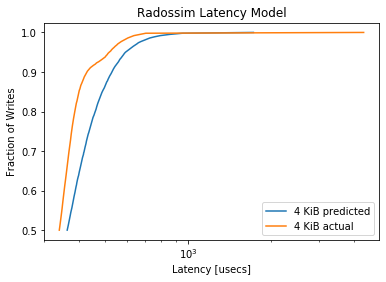

MainProcess pypet INFO     
 Finished single run #835 of 1680 

MainProcess pypet INFO     
 Starting single run #836 of 1680 



minimum predicted latency: 226.728053
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2714, pvalue=1e-323)


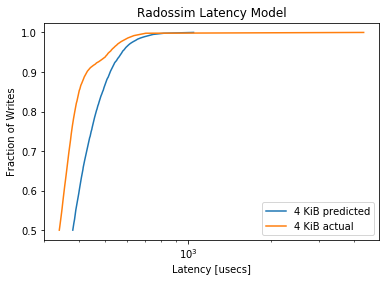

MainProcess pypet INFO     
 Finished single run #836 of 1680 

MainProcess pypet INFO     
 Starting single run #837 of 1680 



minimum predicted latency: 200.631564
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2857, pvalue=1e-323)


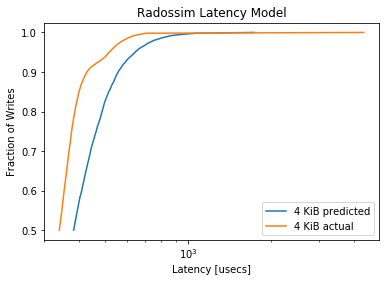

MainProcess pypet INFO     
 Finished single run #837 of 1680 

MainProcess pypet INFO     
 Starting single run #838 of 1680 



minimum predicted latency: 231.699927
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3801, pvalue=0.0)


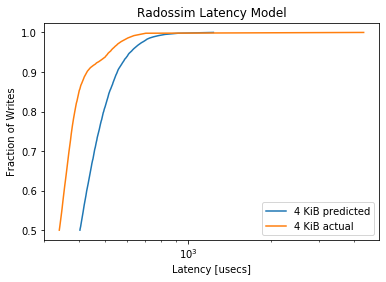

MainProcess pypet INFO     
 Finished single run #838 of 1680 

MainProcess pypet INFO     
 Starting single run #839 of 1680 



minimum predicted latency: 218.732397
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.355, pvalue=0.0)


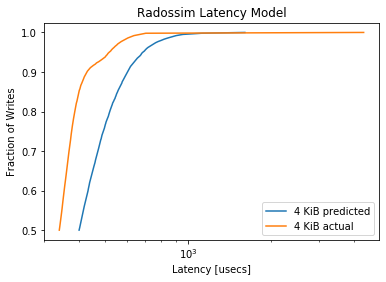

MainProcess pypet INFO     
 Finished single run #839 of 1680 

MainProcess pypet INFO     PROGRESS: Finished  840/1680 runs [==========          ] 50.0%, remaining: 0:05:28
MainProcess pypet INFO     
 Starting single run #840 of 1680 



minimum predicted latency: 202.843049
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4473, pvalue=0.0)


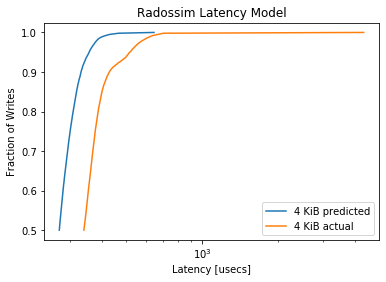

MainProcess pypet INFO     
 Finished single run #840 of 1680 

MainProcess pypet INFO     
 Starting single run #841 of 1680 



minimum predicted latency: 192.795120
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3931, pvalue=0.0)


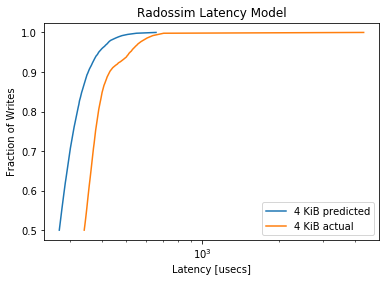

MainProcess pypet INFO     
 Finished single run #841 of 1680 

MainProcess pypet INFO     
 Starting single run #842 of 1680 



minimum predicted latency: 203.921569
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3942, pvalue=0.0)


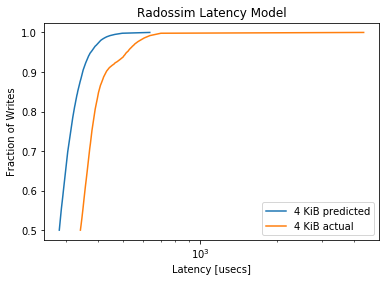

MainProcess pypet INFO     
 Finished single run #842 of 1680 

MainProcess pypet INFO     
 Starting single run #843 of 1680 



minimum predicted latency: 199.508285
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3426, pvalue=0.0)


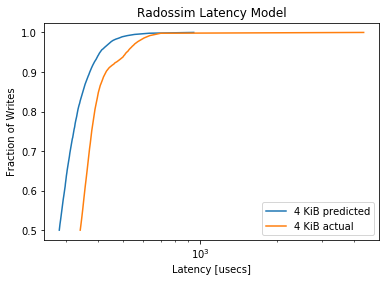

MainProcess pypet INFO     
 Finished single run #843 of 1680 

MainProcess pypet INFO     
 Starting single run #844 of 1680 



minimum predicted latency: 203.169966
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.328, pvalue=1e-323)


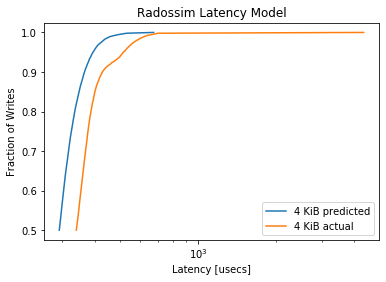

MainProcess pypet INFO     
 Finished single run #844 of 1680 

MainProcess pypet INFO     
 Starting single run #845 of 1680 



minimum predicted latency: 198.284860
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2802, pvalue=1e-323)


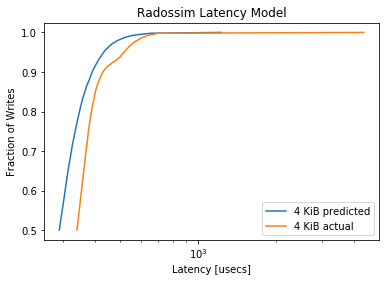

MainProcess pypet INFO     
 Finished single run #845 of 1680 

MainProcess pypet INFO     
 Starting single run #846 of 1680 



minimum predicted latency: 210.087194
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2555, pvalue=4.3561134758549585e-287)


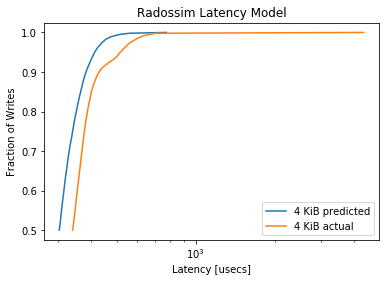

MainProcess pypet INFO     
 Finished single run #846 of 1680 

MainProcess pypet INFO     
 Starting single run #847 of 1680 



minimum predicted latency: 198.895596
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2138, pvalue=1.7886728303530644e-200)


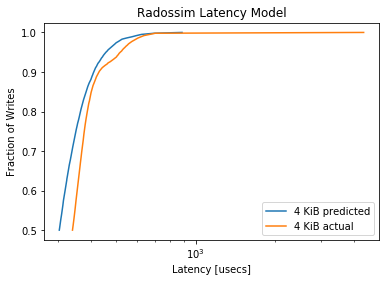

MainProcess pypet INFO     
 Finished single run #847 of 1680 

MainProcess pypet INFO     
 Starting single run #848 of 1680 



minimum predicted latency: 212.966903
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1696, pvalue=6.030229487050681e-126)


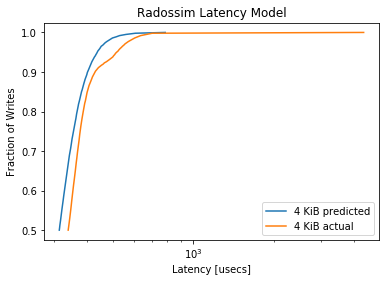

MainProcess pypet INFO     
 Finished single run #848 of 1680 

MainProcess pypet INFO     
 Starting single run #849 of 1680 



minimum predicted latency: 197.307026
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1304, pvalue=1.7615755794997778e-74)


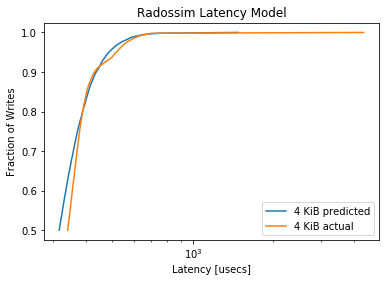

MainProcess pypet INFO     
 Finished single run #849 of 1680 

MainProcess pypet INFO     
 Starting single run #850 of 1680 



minimum predicted latency: 214.022721
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.08, pvalue=3.0050611885459956e-28)


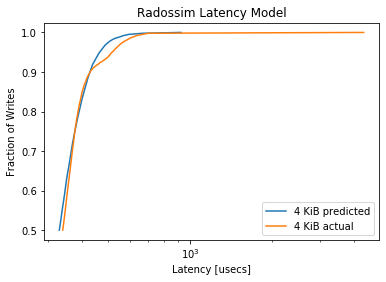

MainProcess pypet INFO     
 Finished single run #850 of 1680 

MainProcess pypet INFO     
 Starting single run #851 of 1680 



minimum predicted latency: 201.707283
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0602, pvalue=3.5751340894516995e-16)


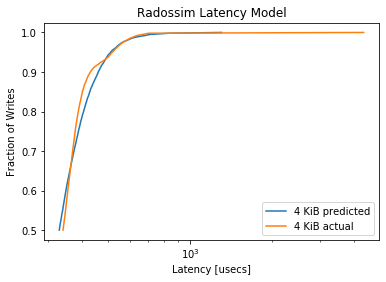

MainProcess pypet INFO     
 Finished single run #851 of 1680 

MainProcess pypet INFO     
 Starting single run #852 of 1680 



minimum predicted latency: 211.379529
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1447, pvalue=1.1288604733407856e-91)


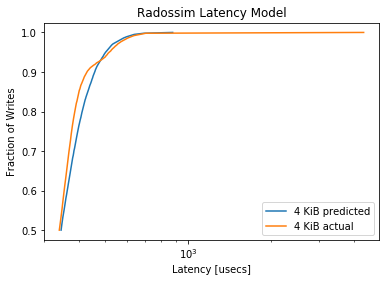

MainProcess pypet INFO     
 Finished single run #852 of 1680 

MainProcess pypet INFO     
 Starting single run #853 of 1680 



minimum predicted latency: 206.614138
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1313, pvalue=1.6487728702744148e-75)


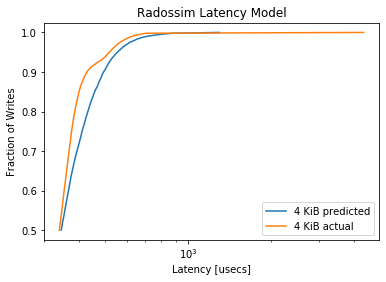

MainProcess pypet INFO     
 Finished single run #853 of 1680 

MainProcess pypet INFO     
 Starting single run #854 of 1680 



minimum predicted latency: 210.648646
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2127, pvalue=2.0973622339217016e-198)


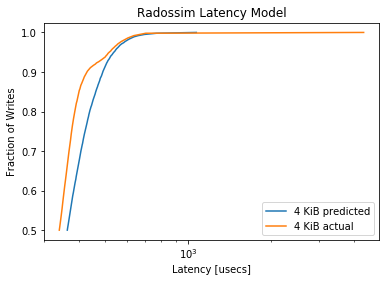

MainProcess pypet INFO     
 Finished single run #854 of 1680 

MainProcess pypet INFO     
 Starting single run #855 of 1680 



minimum predicted latency: 201.667055
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2032, pvalue=5.420906080723826e-181)


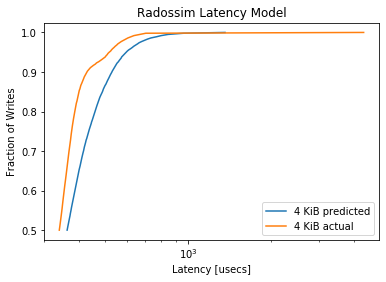

MainProcess pypet INFO     
 Finished single run #855 of 1680 

MainProcess pypet INFO     
 Starting single run #856 of 1680 



minimum predicted latency: 221.198931
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.285, pvalue=1e-323)


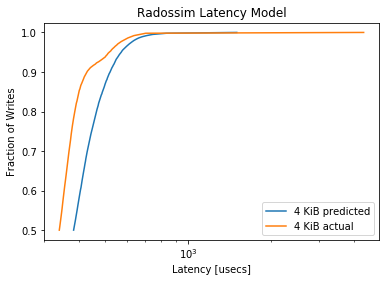

MainProcess pypet INFO     
 Finished single run #856 of 1680 

MainProcess pypet INFO     
 Starting single run #857 of 1680 



minimum predicted latency: 215.198741
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2923, pvalue=1e-323)


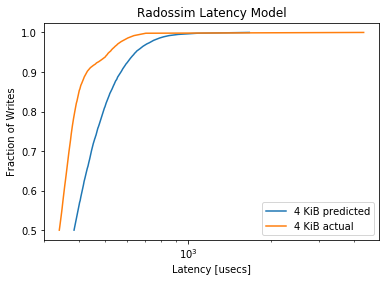

MainProcess pypet INFO     
 Finished single run #857 of 1680 

MainProcess pypet INFO     
 Starting single run #858 of 1680 



minimum predicted latency: 212.869515
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3853, pvalue=0.0)


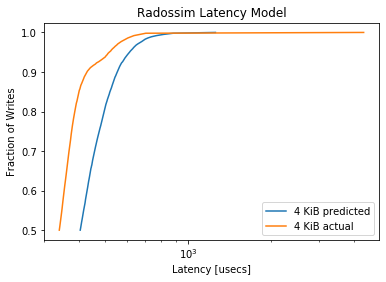

MainProcess pypet INFO     
 Finished single run #858 of 1680 

MainProcess pypet INFO     
 Starting single run #859 of 1680 



minimum predicted latency: 216.783742
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3699, pvalue=0.0)


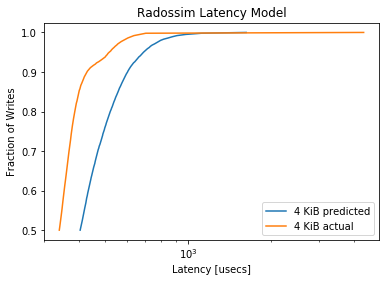

MainProcess pypet INFO     
 Finished single run #859 of 1680 

MainProcess pypet INFO     
 Starting single run #860 of 1680 



minimum predicted latency: 202.243975
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4458, pvalue=0.0)


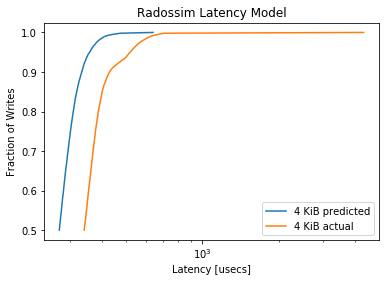

MainProcess pypet INFO     
 Finished single run #860 of 1680 

MainProcess pypet INFO     
 Starting single run #861 of 1680 



minimum predicted latency: 195.622637
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3825, pvalue=0.0)


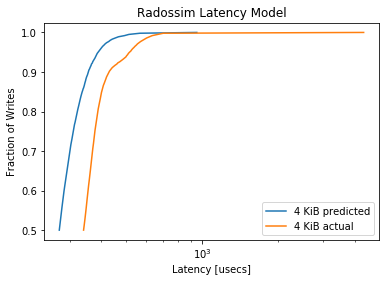

MainProcess pypet INFO     
 Finished single run #861 of 1680 

MainProcess pypet INFO     
 Starting single run #862 of 1680 



minimum predicted latency: 197.778840
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3894, pvalue=0.0)


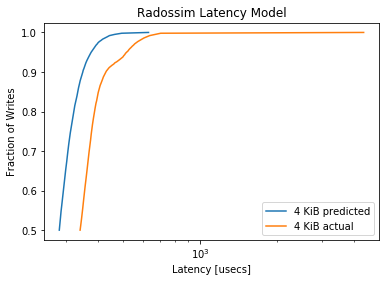

MainProcess pypet INFO     
 Finished single run #862 of 1680 

MainProcess pypet INFO     
 Starting single run #863 of 1680 



minimum predicted latency: 197.233907
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.34, pvalue=0.0)


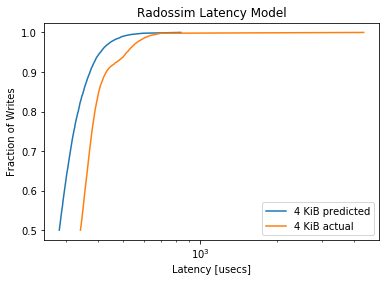

MainProcess pypet INFO     
 Finished single run #863 of 1680 

MainProcess pypet INFO     
 Starting single run #864 of 1680 



minimum predicted latency: 206.447586
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3232, pvalue=1e-323)


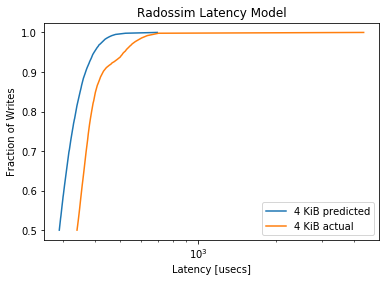

MainProcess pypet INFO     
 Finished single run #864 of 1680 

MainProcess pypet INFO     
 Starting single run #865 of 1680 



minimum predicted latency: 198.508201
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2762, pvalue=1e-323)


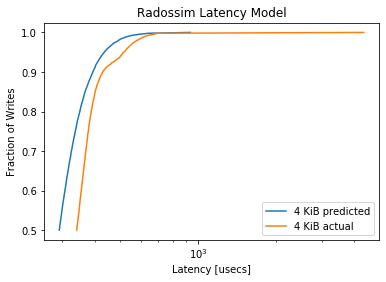

MainProcess pypet INFO     
 Finished single run #865 of 1680 

MainProcess pypet INFO     
 Starting single run #866 of 1680 



minimum predicted latency: 205.120156
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2406, pvalue=2.657500006601587e-254)


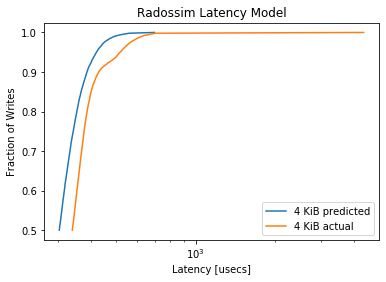

MainProcess pypet INFO     
 Finished single run #866 of 1680 

MainProcess pypet INFO     
 Starting single run #867 of 1680 



minimum predicted latency: 201.141738
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2111, pvalue=2.0496858341156716e-195)


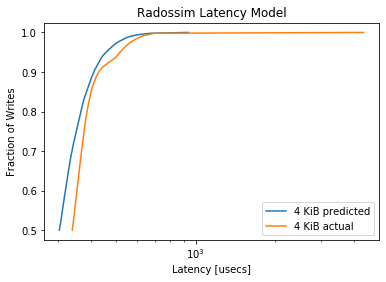

MainProcess pypet INFO     
 Finished single run #867 of 1680 

MainProcess pypet INFO     
 Starting single run #868 of 1680 



minimum predicted latency: 210.513906
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1652, pvalue=1.7317296593216406e-119)


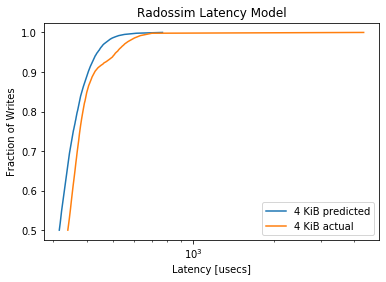

MainProcess pypet INFO     
 Finished single run #868 of 1680 

MainProcess pypet INFO     
 Starting single run #869 of 1680 



minimum predicted latency: 204.238124
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1417, pvalue=6.452610485455141e-88)


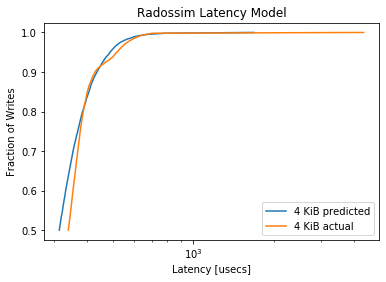

MainProcess pypet INFO     
 Finished single run #869 of 1680 

MainProcess pypet INFO     
 Starting single run #870 of 1680 



minimum predicted latency: 220.447648
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0777, pvalue=1.1383638313332442e-26)


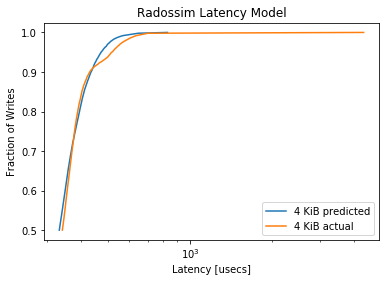

MainProcess pypet INFO     
 Finished single run #870 of 1680 

MainProcess pypet INFO     
 Starting single run #871 of 1680 



minimum predicted latency: 205.369137
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0742, pvalue=2.3417957249669973e-24)


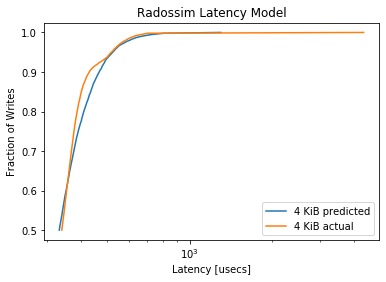

MainProcess pypet INFO     
 Finished single run #871 of 1680 

MainProcess pypet INFO     
 Starting single run #872 of 1680 



minimum predicted latency: 209.200006
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1525, pvalue=8.135020942100927e-102)


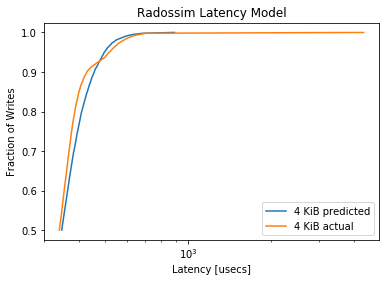

MainProcess pypet INFO     
 Finished single run #872 of 1680 

MainProcess pypet INFO     
 Starting single run #873 of 1680 



minimum predicted latency: 198.040944
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1317, pvalue=5.723281792984541e-76)


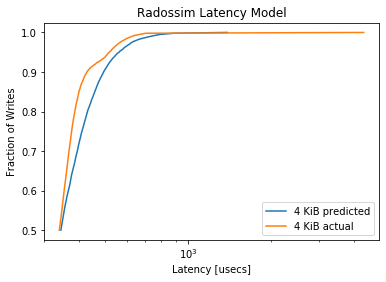

MainProcess pypet INFO     
 Finished single run #873 of 1680 

MainProcess pypet INFO     
 Starting single run #874 of 1680 



minimum predicted latency: 222.103129
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2069, pvalue=1.1214844585438845e-187)


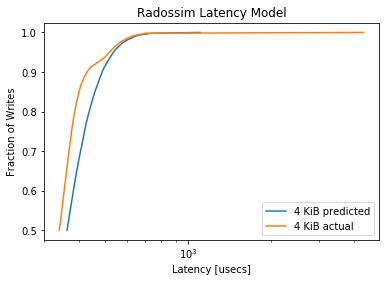

MainProcess pypet INFO     
 Finished single run #874 of 1680 

MainProcess pypet INFO     
 Starting single run #875 of 1680 



minimum predicted latency: 213.557028
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2039, pvalue=3.01298546536844e-182)


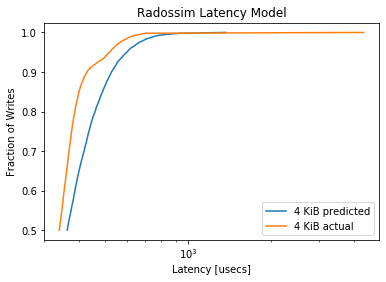

MainProcess pypet INFO     
 Finished single run #875 of 1680 

MainProcess pypet INFO     
 Starting single run #876 of 1680 



minimum predicted latency: 217.086323
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2824, pvalue=1e-323)


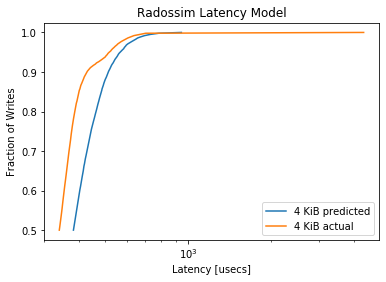

MainProcess pypet INFO     
 Finished single run #876 of 1680 

MainProcess pypet INFO     
 Starting single run #877 of 1680 



minimum predicted latency: 210.497115
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2851, pvalue=1e-323)


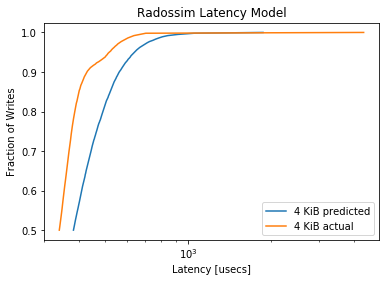

MainProcess pypet INFO     
 Finished single run #877 of 1680 

MainProcess pypet INFO     
 Starting single run #878 of 1680 



minimum predicted latency: 232.941793
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.376, pvalue=0.0)


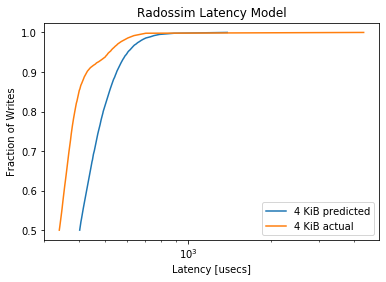

MainProcess pypet INFO     
 Finished single run #878 of 1680 

MainProcess pypet INFO     
 Starting single run #879 of 1680 



minimum predicted latency: 211.063067
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3603, pvalue=0.0)


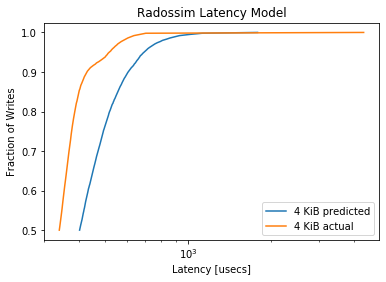

MainProcess pypet INFO     
 Finished single run #879 of 1680 

MainProcess pypet INFO     
 Starting single run #880 of 1680 



minimum predicted latency: 197.087980
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4515, pvalue=0.0)


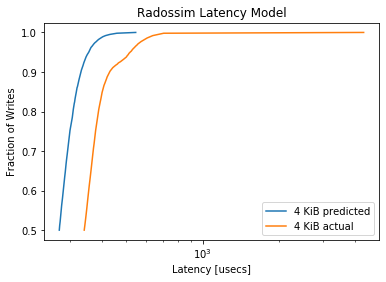

MainProcess pypet INFO     
 Finished single run #880 of 1680 

MainProcess pypet INFO     
 Starting single run #881 of 1680 



minimum predicted latency: 195.051483
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3983, pvalue=0.0)


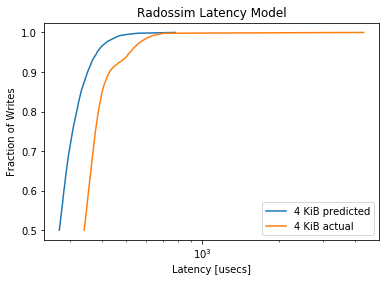

MainProcess pypet INFO     
 Finished single run #881 of 1680 

MainProcess pypet INFO     
 Starting single run #882 of 1680 



minimum predicted latency: 204.357583
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.393, pvalue=0.0)


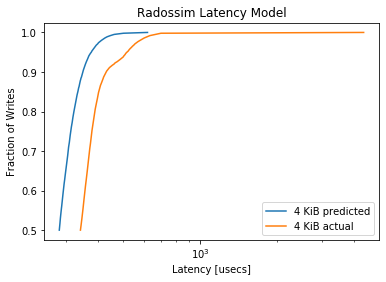

MainProcess pypet INFO     
 Finished single run #882 of 1680 

MainProcess pypet INFO     
 Starting single run #883 of 1680 



minimum predicted latency: 198.149553
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3413, pvalue=0.0)


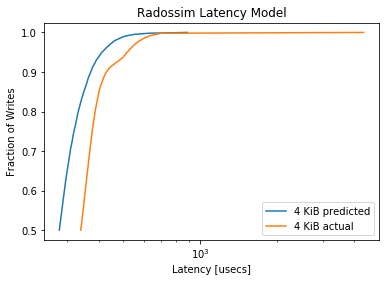

MainProcess pypet INFO     
 Finished single run #883 of 1680 

MainProcess pypet INFO     
 Starting single run #884 of 1680 



minimum predicted latency: 201.995695
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3368, pvalue=0.0)


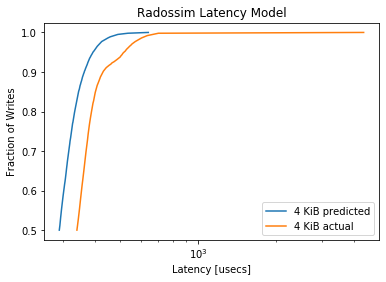

MainProcess pypet INFO     
 Finished single run #884 of 1680 

MainProcess pypet INFO     
 Starting single run #885 of 1680 



minimum predicted latency: 192.942154
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.286, pvalue=1e-323)


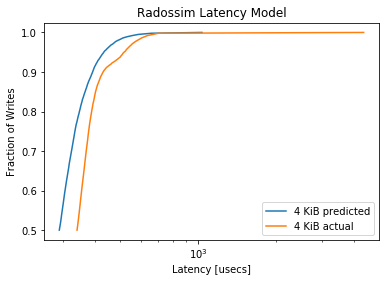

MainProcess pypet INFO     
 Finished single run #885 of 1680 

MainProcess pypet INFO     
 Starting single run #886 of 1680 



minimum predicted latency: 208.853346
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2519, pvalue=5.6075309824491e-279)


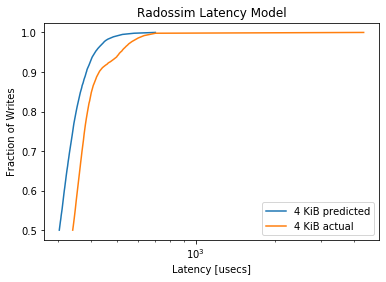

MainProcess pypet INFO     
 Finished single run #886 of 1680 

MainProcess pypet INFO     
 Starting single run #887 of 1680 



minimum predicted latency: 198.390031
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2131, pvalue=3.7199049008862096e-199)


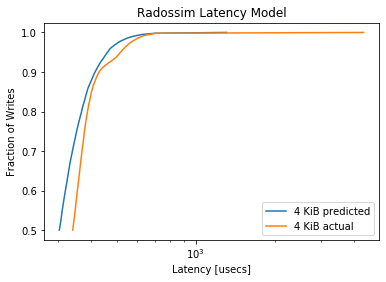

MainProcess pypet INFO     
 Finished single run #887 of 1680 

MainProcess pypet INFO     
 Starting single run #888 of 1680 



minimum predicted latency: 214.107246
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1676, pvalue=5.461367312561842e-123)


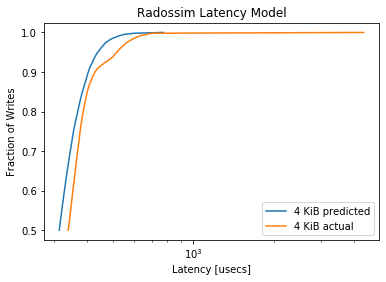

MainProcess pypet INFO     
 Finished single run #888 of 1680 

MainProcess pypet INFO     
 Starting single run #889 of 1680 



minimum predicted latency: 201.355120
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1426, pvalue=4.9089202919656496e-89)


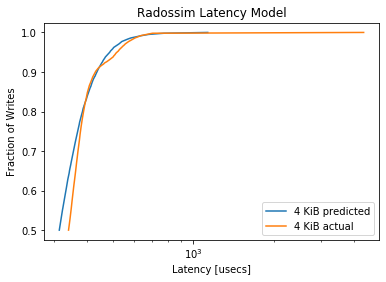

MainProcess pypet INFO     
 Finished single run #889 of 1680 

MainProcess pypet INFO     
 Starting single run #890 of 1680 



minimum predicted latency: 215.193411
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0751, pvalue=6.094375172737131e-25)


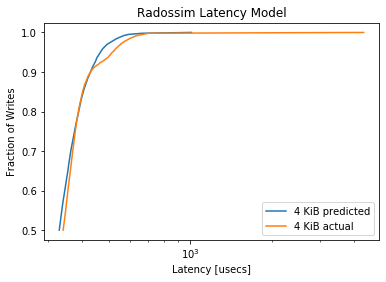

MainProcess pypet INFO     
 Finished single run #890 of 1680 

MainProcess pypet INFO     
 Starting single run #891 of 1680 



minimum predicted latency: 207.853657
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0661, pvalue=2.0554213629700198e-19)


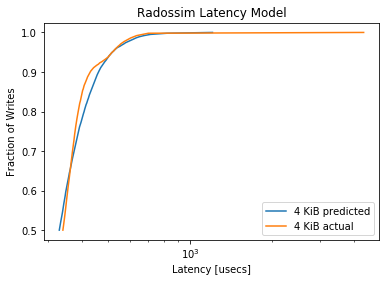

MainProcess pypet INFO     
 Finished single run #891 of 1680 

MainProcess pypet INFO     
 Starting single run #892 of 1680 



minimum predicted latency: 220.314837
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1362, pvalue=3.09464086687786e-81)


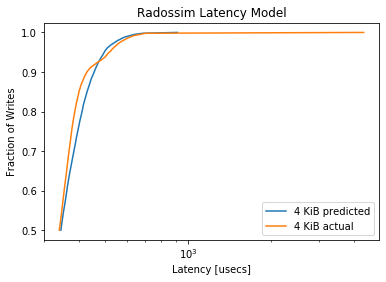

MainProcess pypet INFO     
 Finished single run #892 of 1680 

MainProcess pypet INFO     
 Starting single run #893 of 1680 



minimum predicted latency: 199.639156
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1276, pvalue=2.5157409426813224e-71)


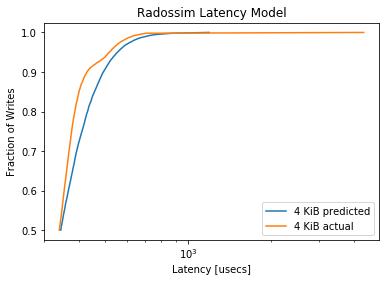

MainProcess pypet INFO     
 Finished single run #893 of 1680 

MainProcess pypet INFO     
 Starting single run #894 of 1680 



minimum predicted latency: 219.164297
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2047, pvalue=1.0944310303141385e-183)


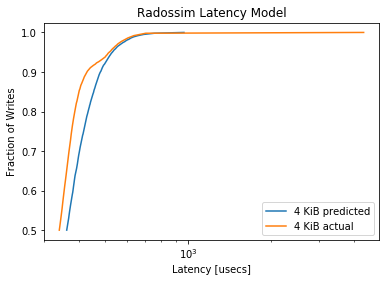

MainProcess pypet INFO     
 Finished single run #894 of 1680 

MainProcess pypet INFO     
 Starting single run #895 of 1680 



minimum predicted latency: 209.309972
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2022, pvalue=3.3062501651831954e-179)


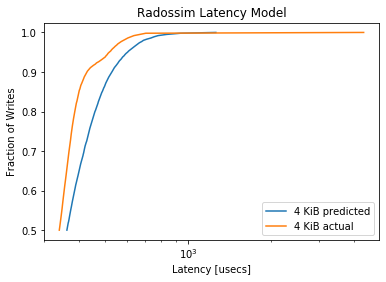

MainProcess pypet INFO     
 Finished single run #895 of 1680 

MainProcess pypet INFO     
 Starting single run #896 of 1680 



minimum predicted latency: 225.593611
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2837, pvalue=1e-323)


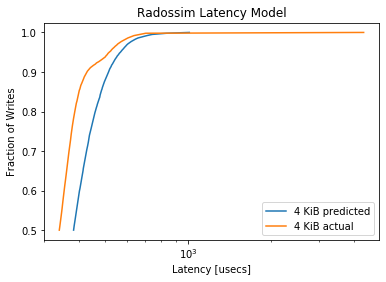

MainProcess pypet INFO     
 Finished single run #896 of 1680 

MainProcess pypet INFO     
 Starting single run #897 of 1680 



minimum predicted latency: 209.890439
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2844, pvalue=1e-323)


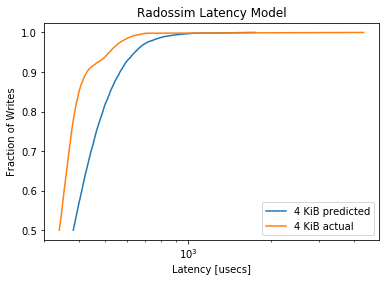

MainProcess pypet INFO     
 Finished single run #897 of 1680 

MainProcess pypet INFO     
 Starting single run #898 of 1680 



minimum predicted latency: 232.853518
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.375, pvalue=0.0)


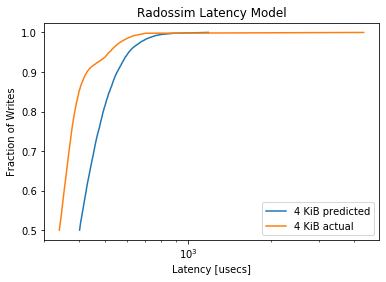

MainProcess pypet INFO     
 Finished single run #898 of 1680 

MainProcess pypet INFO     
 Starting single run #899 of 1680 



minimum predicted latency: 200.657734
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3553, pvalue=0.0)


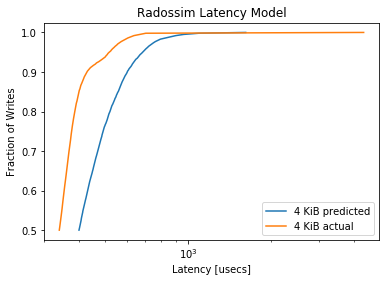

MainProcess pypet INFO     
 Finished single run #899 of 1680 

MainProcess pypet INFO     
 Starting single run #900 of 1680 



minimum predicted latency: 201.574749
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4478, pvalue=0.0)


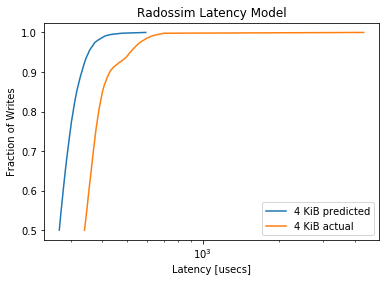

MainProcess pypet INFO     
 Finished single run #900 of 1680 

MainProcess pypet INFO     
 Starting single run #901 of 1680 



minimum predicted latency: 197.031370
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3967, pvalue=0.0)


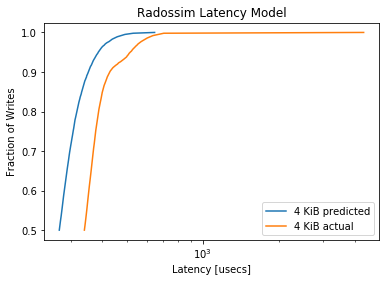

MainProcess pypet INFO     
 Finished single run #901 of 1680 

MainProcess pypet INFO     
 Starting single run #902 of 1680 



minimum predicted latency: 203.453750
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3932, pvalue=0.0)


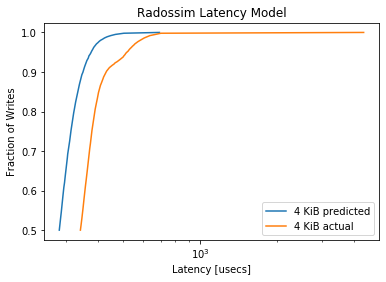

MainProcess pypet INFO     
 Finished single run #902 of 1680 

MainProcess pypet INFO     
 Starting single run #903 of 1680 



minimum predicted latency: 196.900384
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3404, pvalue=0.0)


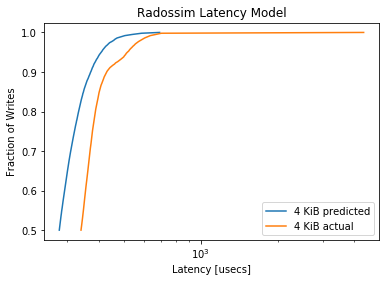

MainProcess pypet INFO     
 Finished single run #903 of 1680 

MainProcess pypet INFO     
 Starting single run #904 of 1680 



minimum predicted latency: 203.969708
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3353, pvalue=0.0)


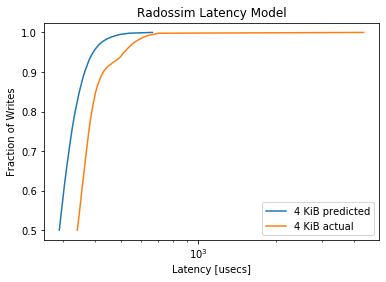

MainProcess pypet INFO     
 Finished single run #904 of 1680 

MainProcess pypet INFO     
 Starting single run #905 of 1680 



minimum predicted latency: 198.720253
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2808, pvalue=1e-323)


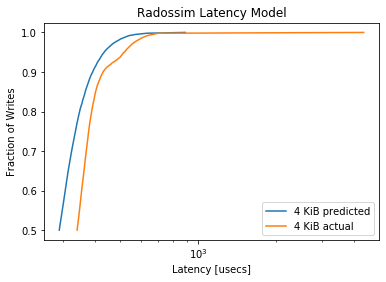

MainProcess pypet INFO     
 Finished single run #905 of 1680 

MainProcess pypet INFO     
 Starting single run #906 of 1680 



minimum predicted latency: 209.010335
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2492, pvalue=5.651178075894295e-273)


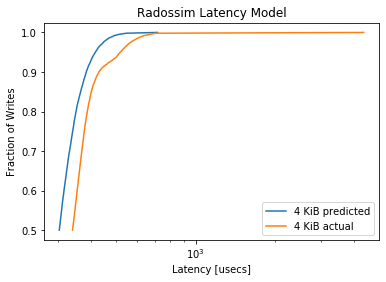

MainProcess pypet INFO     
 Finished single run #906 of 1680 

MainProcess pypet INFO     
 Starting single run #907 of 1680 



minimum predicted latency: 200.804669
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2095, pvalue=1.89858225954719e-192)


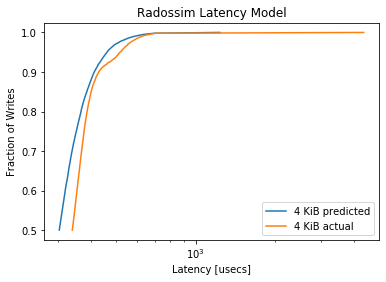

MainProcess pypet INFO     
 Finished single run #907 of 1680 

MainProcess pypet INFO     
 Starting single run #908 of 1680 



minimum predicted latency: 212.018846
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1667, pvalue=1.1383432326165781e-121)


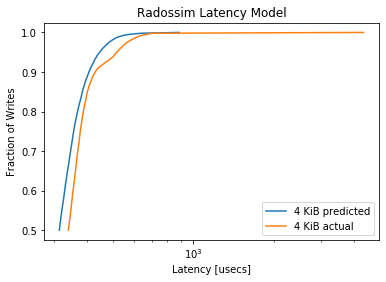

MainProcess pypet INFO     
 Finished single run #908 of 1680 

MainProcess pypet INFO     
 Starting single run #909 of 1680 



minimum predicted latency: 201.213876
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1349, pvalue=1.0729895687366785e-79)


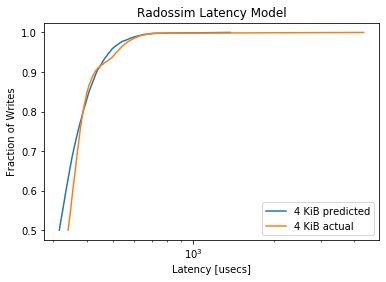

MainProcess pypet INFO     
 Finished single run #909 of 1680 

MainProcess pypet INFO     
 Starting single run #910 of 1680 



minimum predicted latency: 213.348984
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0721, pvalue=5.083384050378214e-23)


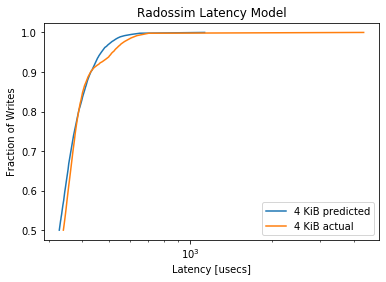

MainProcess pypet INFO     
 Finished single run #910 of 1680 

MainProcess pypet INFO     
 Starting single run #911 of 1680 



minimum predicted latency: 202.051651
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0736, pvalue=5.693317552805668e-24)


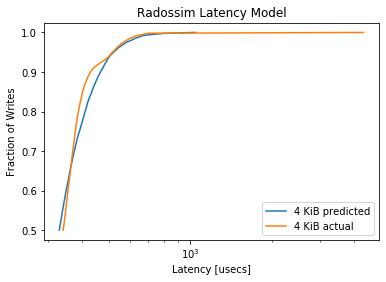

MainProcess pypet INFO     
 Finished single run #911 of 1680 

MainProcess pypet INFO     
 Starting single run #912 of 1680 



minimum predicted latency: 212.922343
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1357, pvalue=1.2152955281334563e-80)


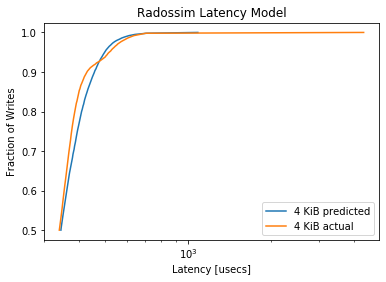

MainProcess pypet INFO     
 Finished single run #912 of 1680 

MainProcess pypet INFO     
 Starting single run #913 of 1680 



minimum predicted latency: 208.777700
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1292, pvalue=4.040383080185128e-73)


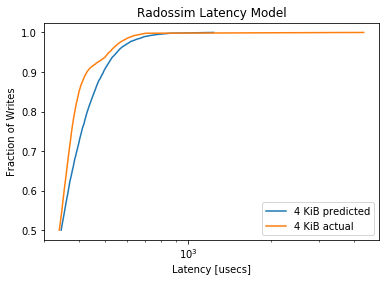

MainProcess pypet INFO     
 Finished single run #913 of 1680 

MainProcess pypet INFO     
 Starting single run #914 of 1680 



minimum predicted latency: 224.234212
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2054, pvalue=5.951091656639207e-185)


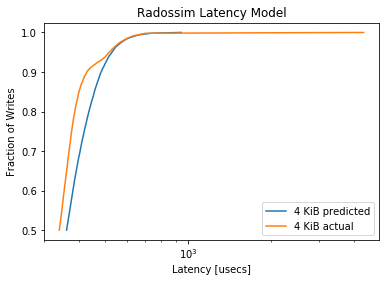

MainProcess pypet INFO     
 Finished single run #914 of 1680 

MainProcess pypet INFO     
 Starting single run #915 of 1680 



minimum predicted latency: 207.909450
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1951, pvalue=8.600710779767528e-167)


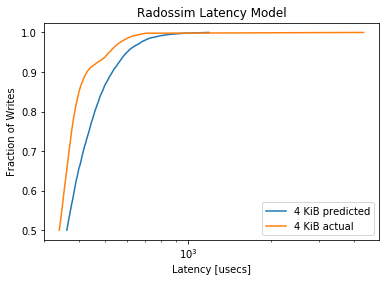

MainProcess pypet INFO     
 Finished single run #915 of 1680 

MainProcess pypet INFO     
 Starting single run #916 of 1680 



minimum predicted latency: 226.327575
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.278, pvalue=1e-323)


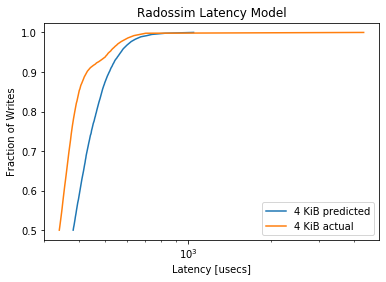

MainProcess pypet INFO     
 Finished single run #916 of 1680 

MainProcess pypet INFO     
 Starting single run #917 of 1680 



minimum predicted latency: 215.686634
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2818, pvalue=1e-323)


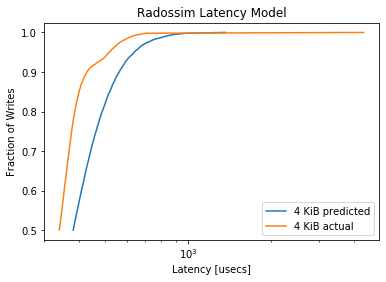

MainProcess pypet INFO     
 Finished single run #917 of 1680 

MainProcess pypet INFO     
 Starting single run #918 of 1680 



minimum predicted latency: 228.590273
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3679, pvalue=0.0)


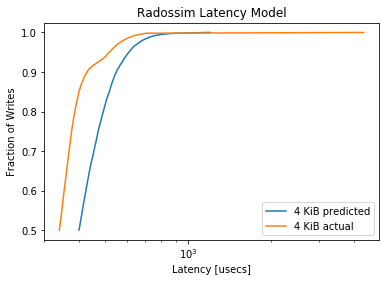

MainProcess pypet INFO     
 Finished single run #918 of 1680 

MainProcess pypet INFO     
 Starting single run #919 of 1680 



minimum predicted latency: 211.962899
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3518, pvalue=0.0)


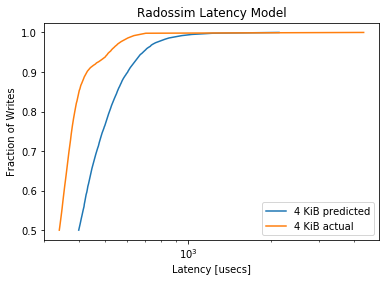

MainProcess pypet INFO     
 Finished single run #919 of 1680 

MainProcess pypet INFO     
 Starting single run #920 of 1680 



minimum predicted latency: 201.554080
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4497, pvalue=0.0)


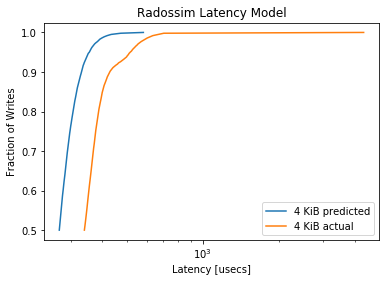

MainProcess pypet INFO     
 Finished single run #920 of 1680 

MainProcess pypet INFO     
 Starting single run #921 of 1680 



minimum predicted latency: 196.919314
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3932, pvalue=0.0)


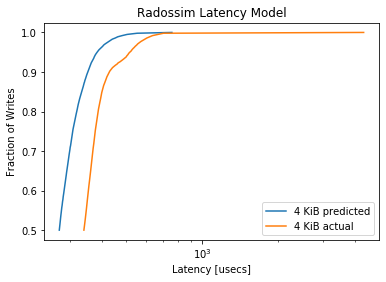

MainProcess pypet INFO     
 Finished single run #921 of 1680 

MainProcess pypet INFO     
 Starting single run #922 of 1680 



minimum predicted latency: 204.469995
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4017, pvalue=0.0)


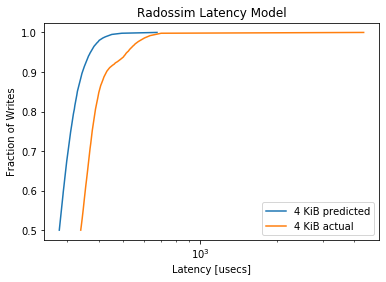

MainProcess pypet INFO     
 Finished single run #922 of 1680 

MainProcess pypet INFO     
 Starting single run #923 of 1680 



minimum predicted latency: 195.143620
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3433, pvalue=0.0)


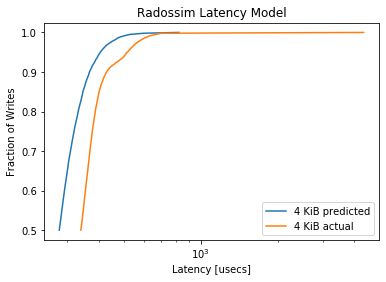

MainProcess pypet INFO     
 Finished single run #923 of 1680 

MainProcess pypet INFO     PROGRESS: Finished  924/1680 runs [===========         ] 55.0%, remaining: 0:04:50
MainProcess pypet INFO     
 Starting single run #924 of 1680 



minimum predicted latency: 205.274950
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3301, pvalue=1e-323)


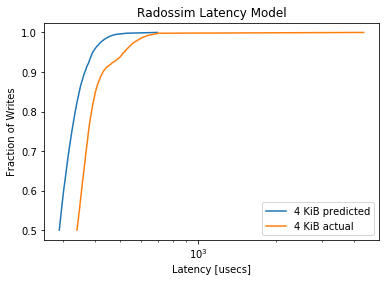

MainProcess pypet INFO     
 Finished single run #924 of 1680 

MainProcess pypet INFO     
 Starting single run #925 of 1680 



minimum predicted latency: 198.121532
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2716, pvalue=1e-323)


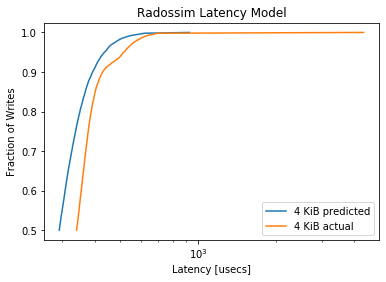

MainProcess pypet INFO     
 Finished single run #925 of 1680 

MainProcess pypet INFO     
 Starting single run #926 of 1680 



minimum predicted latency: 210.259670
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2554, pvalue=7.34501808882071e-287)


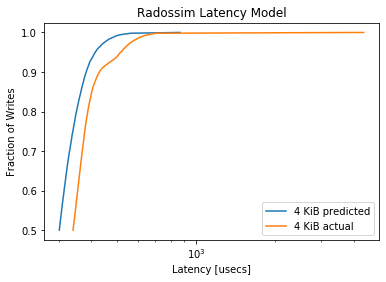

MainProcess pypet INFO     
 Finished single run #926 of 1680 

MainProcess pypet INFO     
 Starting single run #927 of 1680 



minimum predicted latency: 197.490158
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2144, pvalue=1.316031604529685e-201)


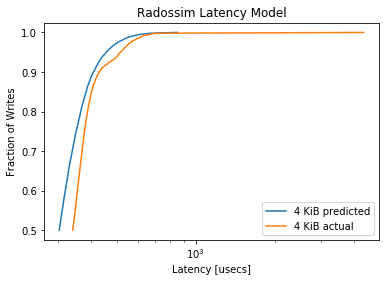

MainProcess pypet INFO     
 Finished single run #927 of 1680 

MainProcess pypet INFO     
 Starting single run #928 of 1680 



minimum predicted latency: 212.896570
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1684, pvalue=3.620805957893773e-124)


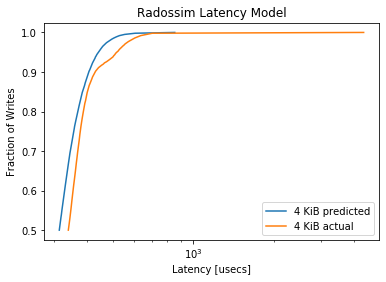

MainProcess pypet INFO     
 Finished single run #928 of 1680 

MainProcess pypet INFO     
 Starting single run #929 of 1680 



minimum predicted latency: 197.258553
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1452, pvalue=2.622390435745755e-92)


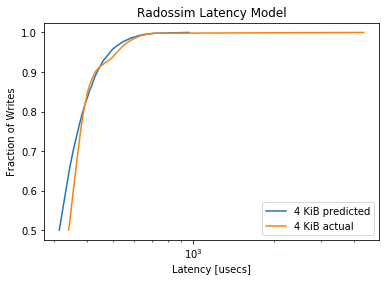

MainProcess pypet INFO     
 Finished single run #929 of 1680 

MainProcess pypet INFO     
 Starting single run #930 of 1680 



minimum predicted latency: 214.881233
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0781, pvalue=6.096672975932883e-27)


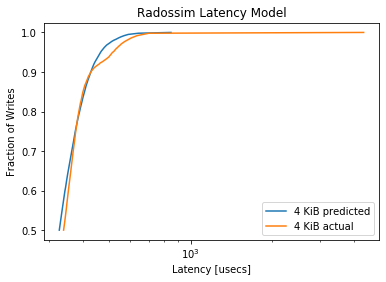

MainProcess pypet INFO     
 Finished single run #930 of 1680 

MainProcess pypet INFO     
 Starting single run #931 of 1680 



minimum predicted latency: 198.072110
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0694, pvalue=2.3338311030341645e-21)


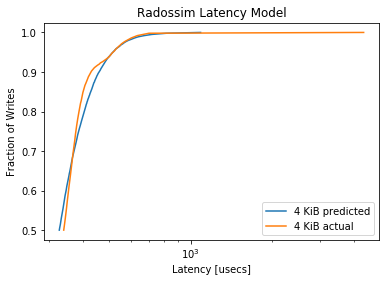

MainProcess pypet INFO     
 Finished single run #931 of 1680 

MainProcess pypet INFO     
 Starting single run #932 of 1680 



minimum predicted latency: 219.918806
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1379, pvalue=2.845876615758425e-83)


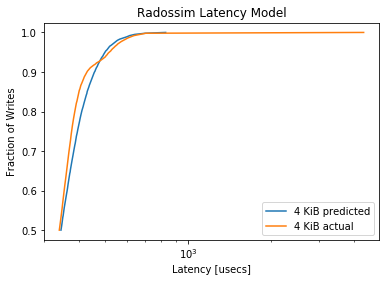

MainProcess pypet INFO     
 Finished single run #932 of 1680 

MainProcess pypet INFO     
 Starting single run #933 of 1680 



minimum predicted latency: 204.202093
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1258, pvalue=2.4670208918635897e-69)


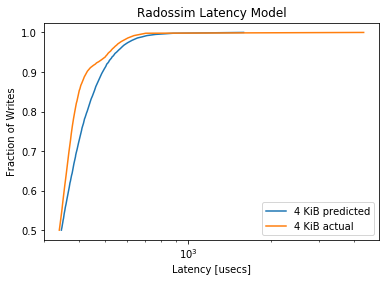

MainProcess pypet INFO     
 Finished single run #933 of 1680 

MainProcess pypet INFO     
 Starting single run #934 of 1680 



minimum predicted latency: 219.371768
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2012, pvalue=1.974894406883084e-177)


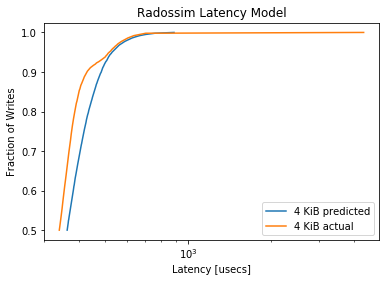

MainProcess pypet INFO     
 Finished single run #934 of 1680 

MainProcess pypet INFO     
 Starting single run #935 of 1680 



minimum predicted latency: 200.301670
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.204, pvalue=1.992224027391873e-182)


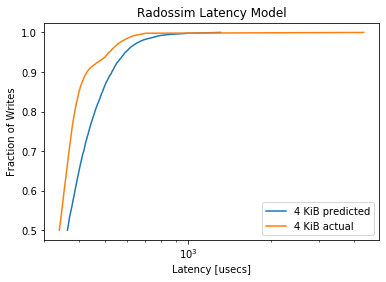

MainProcess pypet INFO     
 Finished single run #935 of 1680 

MainProcess pypet INFO     
 Starting single run #936 of 1680 



minimum predicted latency: 227.486214
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2739, pvalue=1e-323)


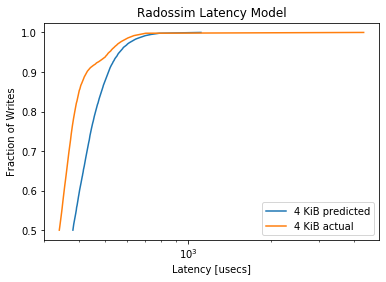

MainProcess pypet INFO     
 Finished single run #936 of 1680 

MainProcess pypet INFO     
 Starting single run #937 of 1680 



minimum predicted latency: 202.768942
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2801, pvalue=1e-323)


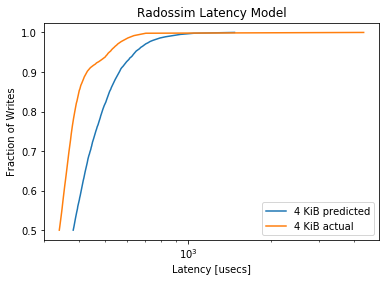

MainProcess pypet INFO     
 Finished single run #937 of 1680 

MainProcess pypet INFO     
 Starting single run #938 of 1680 



minimum predicted latency: 228.910518
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3709, pvalue=0.0)


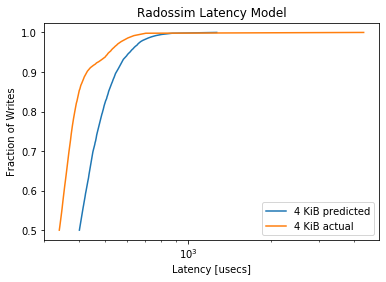

MainProcess pypet INFO     
 Finished single run #938 of 1680 

MainProcess pypet INFO     
 Starting single run #939 of 1680 



minimum predicted latency: 215.624671
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3612, pvalue=0.0)


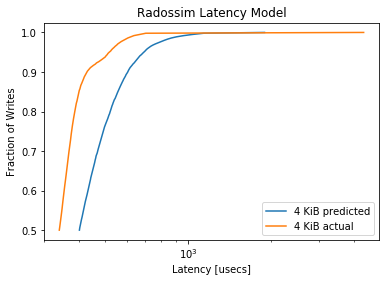

MainProcess pypet INFO     
 Finished single run #939 of 1680 

MainProcess pypet INFO     
 Starting single run #940 of 1680 



minimum predicted latency: 199.306450
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4536, pvalue=0.0)


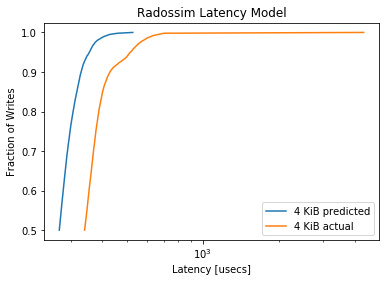

MainProcess pypet INFO     
 Finished single run #940 of 1680 

MainProcess pypet INFO     
 Starting single run #941 of 1680 



minimum predicted latency: 190.727620
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3974, pvalue=0.0)


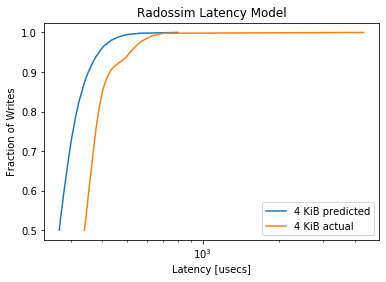

MainProcess pypet INFO     
 Finished single run #941 of 1680 

MainProcess pypet INFO     
 Starting single run #942 of 1680 



minimum predicted latency: 203.849943
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4052, pvalue=0.0)


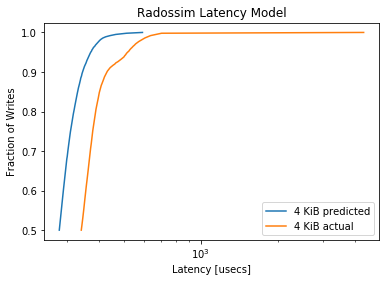

MainProcess pypet INFO     
 Finished single run #942 of 1680 

MainProcess pypet INFO     
 Starting single run #943 of 1680 



minimum predicted latency: 189.563553
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3541, pvalue=0.0)


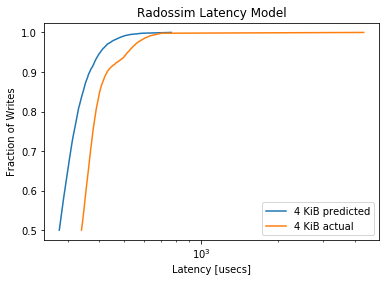

MainProcess pypet INFO     
 Finished single run #943 of 1680 

MainProcess pypet INFO     
 Starting single run #944 of 1680 



minimum predicted latency: 200.714371
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3333, pvalue=1e-323)


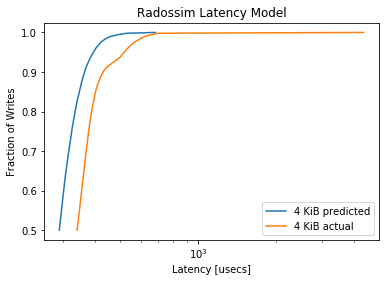

MainProcess pypet INFO     
 Finished single run #944 of 1680 

MainProcess pypet INFO     
 Starting single run #945 of 1680 



minimum predicted latency: 198.120125
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2843, pvalue=1e-323)


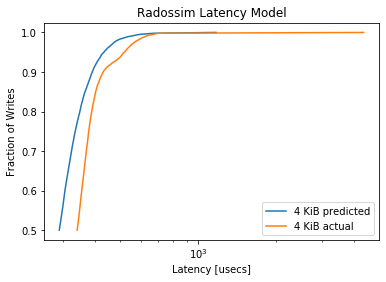

MainProcess pypet INFO     
 Finished single run #945 of 1680 

MainProcess pypet INFO     
 Starting single run #946 of 1680 



minimum predicted latency: 200.837562
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.263, pvalue=2.274526513046955e-304)


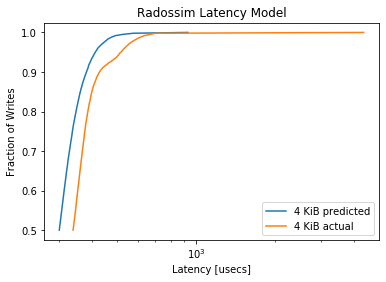

MainProcess pypet INFO     
 Finished single run #946 of 1680 

MainProcess pypet INFO     
 Starting single run #947 of 1680 



minimum predicted latency: 198.968606
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2256, pvalue=2.303765388506349e-223)


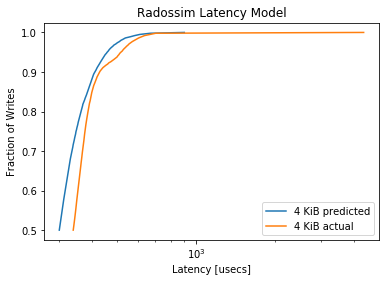

MainProcess pypet INFO     
 Finished single run #947 of 1680 

MainProcess pypet INFO     
 Starting single run #948 of 1680 



minimum predicted latency: 206.387926
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1771, pvalue=2.360025110393893e-137)


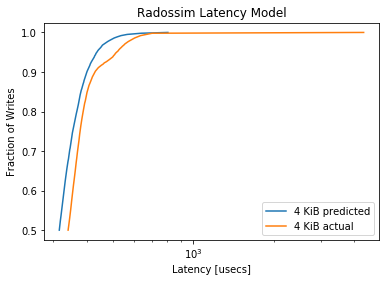

MainProcess pypet INFO     
 Finished single run #948 of 1680 

MainProcess pypet INFO     
 Starting single run #949 of 1680 



minimum predicted latency: 192.053692
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1387, pvalue=3.0694450029607063e-84)


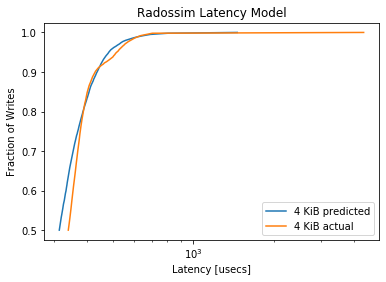

MainProcess pypet INFO     
 Finished single run #949 of 1680 

MainProcess pypet INFO     
 Starting single run #950 of 1680 



minimum predicted latency: 210.343407
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0777, pvalue=1.1383638313332442e-26)


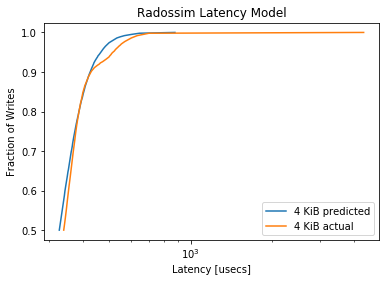

MainProcess pypet INFO     
 Finished single run #950 of 1680 

MainProcess pypet INFO     
 Starting single run #951 of 1680 



minimum predicted latency: 201.403702
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0719, pvalue=6.783287968885309e-23)


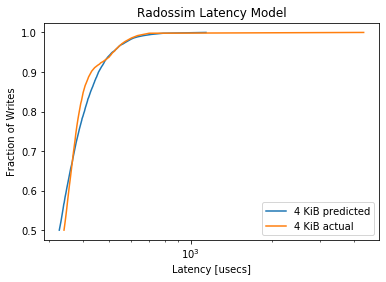

MainProcess pypet INFO     
 Finished single run #951 of 1680 

MainProcess pypet INFO     
 Starting single run #952 of 1680 



minimum predicted latency: 217.226110
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1309, pvalue=4.734373182374133e-75)


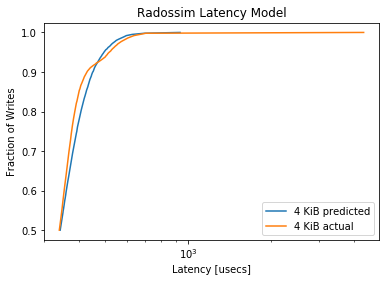

MainProcess pypet INFO     
 Finished single run #952 of 1680 

MainProcess pypet INFO     
 Starting single run #953 of 1680 



minimum predicted latency: 208.182574
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1242, pvalue=1.3752969691032261e-67)


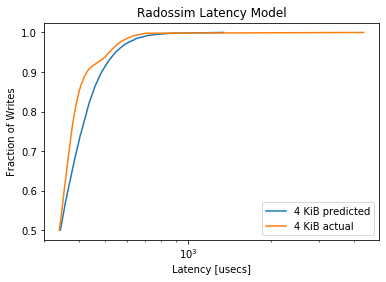

MainProcess pypet INFO     
 Finished single run #953 of 1680 

MainProcess pypet INFO     
 Starting single run #954 of 1680 



minimum predicted latency: 214.946341
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1942, pvalue=2.990608745874961e-165)


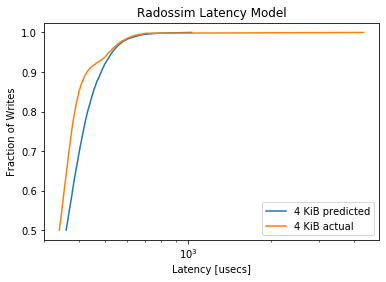

MainProcess pypet INFO     
 Finished single run #954 of 1680 

MainProcess pypet INFO     
 Starting single run #955 of 1680 



minimum predicted latency: 208.979903
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.194, pvalue=6.565399634733456e-165)


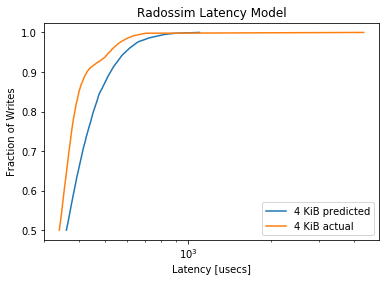

MainProcess pypet INFO     
 Finished single run #955 of 1680 

MainProcess pypet INFO     
 Starting single run #956 of 1680 



minimum predicted latency: 221.069754
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2704, pvalue=6.23e-322)


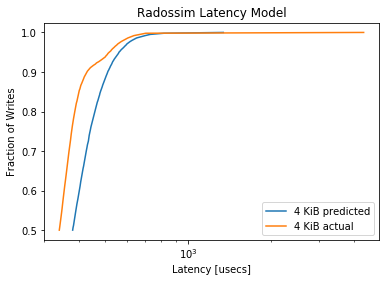

MainProcess pypet INFO     
 Finished single run #956 of 1680 

MainProcess pypet INFO     
 Starting single run #957 of 1680 



minimum predicted latency: 214.047527
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2713, pvalue=1e-323)


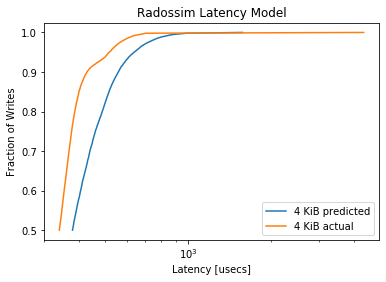

MainProcess pypet INFO     
 Finished single run #957 of 1680 

MainProcess pypet INFO     
 Starting single run #958 of 1680 



minimum predicted latency: 236.892450
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3673, pvalue=0.0)


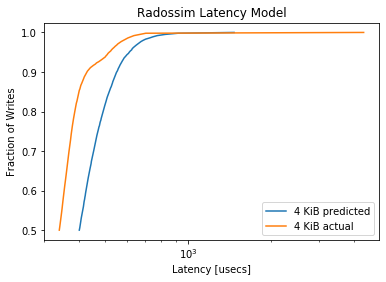

MainProcess pypet INFO     
 Finished single run #958 of 1680 

MainProcess pypet INFO     
 Starting single run #959 of 1680 



minimum predicted latency: 206.407696
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3558, pvalue=0.0)


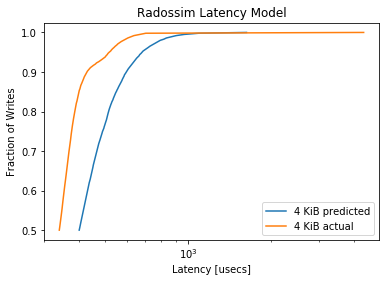

MainProcess pypet INFO     
 Finished single run #959 of 1680 

MainProcess pypet INFO     
 Starting single run #960 of 1680 



minimum predicted latency: 200.562092
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4502, pvalue=0.0)


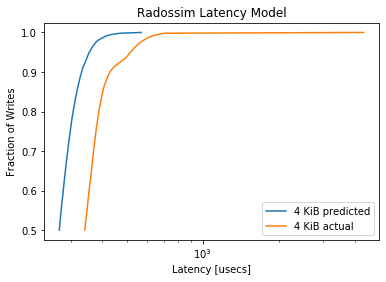

MainProcess pypet INFO     
 Finished single run #960 of 1680 

MainProcess pypet INFO     
 Starting single run #961 of 1680 



minimum predicted latency: 189.423756
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4009, pvalue=0.0)


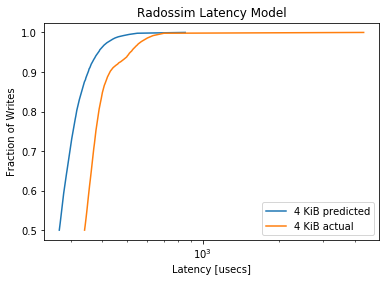

MainProcess pypet INFO     
 Finished single run #961 of 1680 

MainProcess pypet INFO     
 Starting single run #962 of 1680 



minimum predicted latency: 198.742526
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3965, pvalue=0.0)


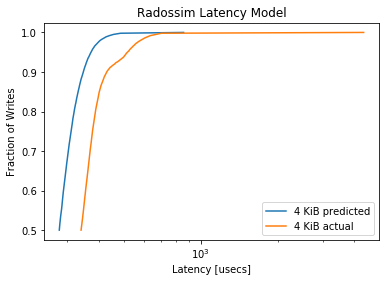

MainProcess pypet INFO     
 Finished single run #962 of 1680 

MainProcess pypet INFO     
 Starting single run #963 of 1680 



minimum predicted latency: 194.302562
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3493, pvalue=0.0)


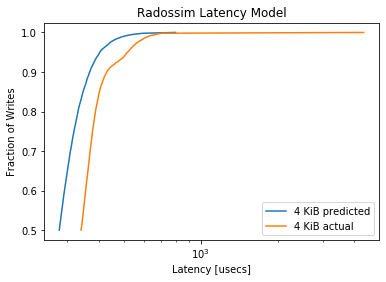

MainProcess pypet INFO     
 Finished single run #963 of 1680 

MainProcess pypet INFO     
 Starting single run #964 of 1680 



minimum predicted latency: 198.419855
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3384, pvalue=0.0)


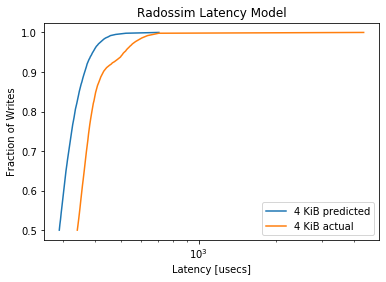

MainProcess pypet INFO     
 Finished single run #964 of 1680 

MainProcess pypet INFO     
 Starting single run #965 of 1680 



minimum predicted latency: 198.928060
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2851, pvalue=1e-323)


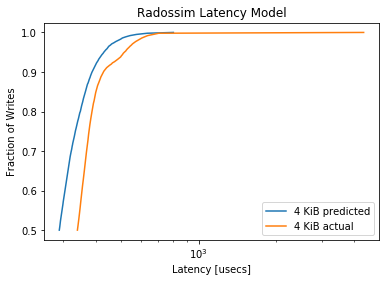

MainProcess pypet INFO     
 Finished single run #965 of 1680 

MainProcess pypet INFO     
 Starting single run #966 of 1680 



minimum predicted latency: 207.482896
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.255, pvalue=5.924320073564327e-286)


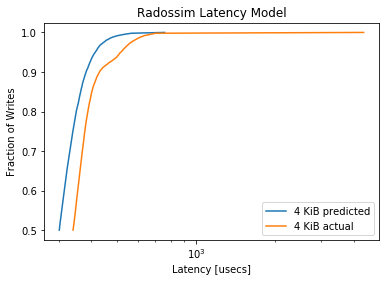

MainProcess pypet INFO     
 Finished single run #966 of 1680 

MainProcess pypet INFO     
 Starting single run #967 of 1680 



minimum predicted latency: 197.148344
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2098, pvalue=5.29586818974004e-193)


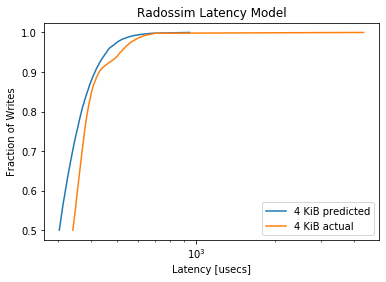

MainProcess pypet INFO     
 Finished single run #967 of 1680 

MainProcess pypet INFO     
 Starting single run #968 of 1680 



minimum predicted latency: 210.529174
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1744, pvalue=3.4484147821336328e-133)


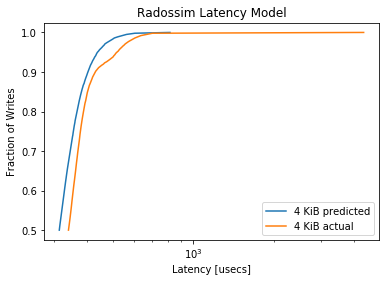

MainProcess pypet INFO     
 Finished single run #968 of 1680 

MainProcess pypet INFO     
 Starting single run #969 of 1680 



minimum predicted latency: 197.049250
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1455, pvalue=1.0895995750776009e-92)


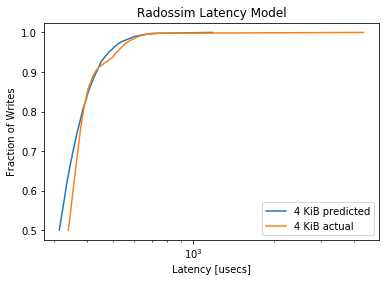

MainProcess pypet INFO     
 Finished single run #969 of 1680 

MainProcess pypet INFO     
 Starting single run #970 of 1680 



minimum predicted latency: 209.423234
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0842, pvalue=2.993467038534462e-31)


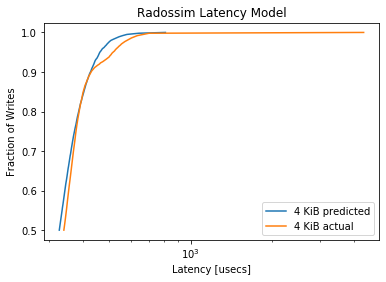

MainProcess pypet INFO     
 Finished single run #970 of 1680 

MainProcess pypet INFO     
 Starting single run #971 of 1680 



minimum predicted latency: 206.529918
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0654, pvalue=5.166857113828859e-19)


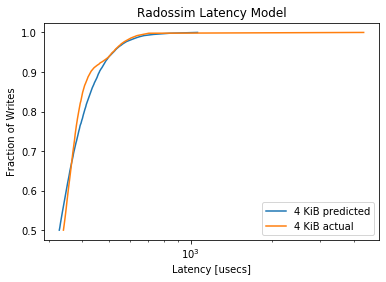

MainProcess pypet INFO     
 Finished single run #971 of 1680 

MainProcess pypet INFO     
 Starting single run #972 of 1680 



minimum predicted latency: 213.758394
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1321, pvalue=1.98022813485775e-76)


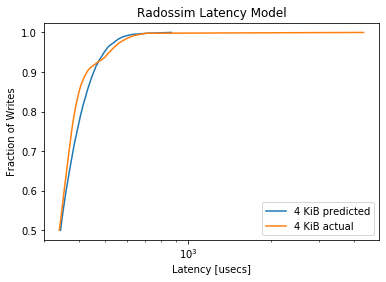

MainProcess pypet INFO     
 Finished single run #972 of 1680 

MainProcess pypet INFO     
 Starting single run #973 of 1680 



minimum predicted latency: 207.675448
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1251, pvalue=1.4418664715979672e-68)


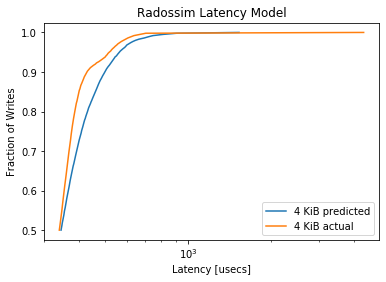

MainProcess pypet INFO     
 Finished single run #973 of 1680 

MainProcess pypet INFO     
 Starting single run #974 of 1680 



minimum predicted latency: 221.139584
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2011, pvalue=2.969386858865891e-177)


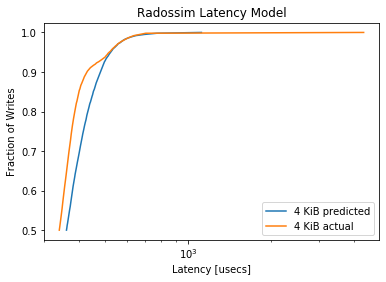

MainProcess pypet INFO     
 Finished single run #974 of 1680 

MainProcess pypet INFO     
 Starting single run #975 of 1680 



minimum predicted latency: 210.701100
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1935, pvalue=4.671278479132142e-164)


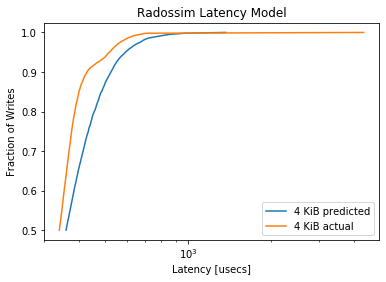

MainProcess pypet INFO     
 Finished single run #975 of 1680 

MainProcess pypet INFO     
 Starting single run #976 of 1680 



minimum predicted latency: 228.731384
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2763, pvalue=1e-323)


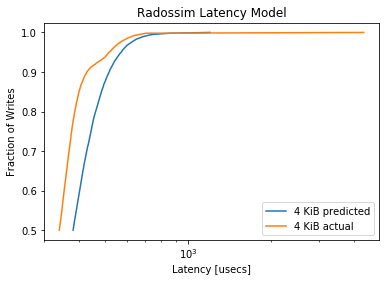

MainProcess pypet INFO     
 Finished single run #976 of 1680 

MainProcess pypet INFO     
 Starting single run #977 of 1680 



minimum predicted latency: 209.826714
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2714, pvalue=1e-323)


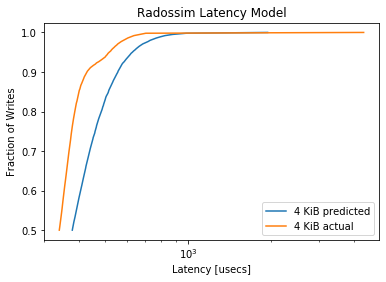

MainProcess pypet INFO     
 Finished single run #977 of 1680 

MainProcess pypet INFO     
 Starting single run #978 of 1680 



minimum predicted latency: 218.172836
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.368, pvalue=0.0)


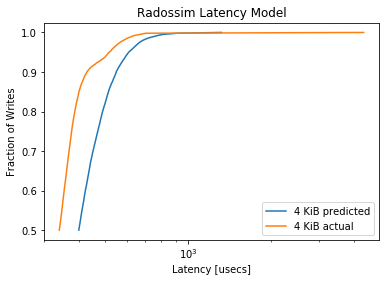

MainProcess pypet INFO     
 Finished single run #978 of 1680 

MainProcess pypet INFO     
 Starting single run #979 of 1680 



minimum predicted latency: 201.265497
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3465, pvalue=0.0)


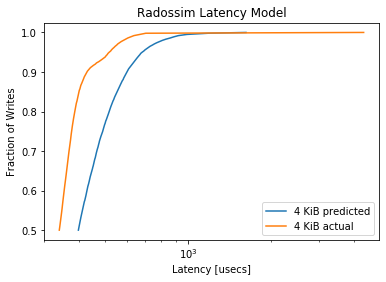

MainProcess pypet INFO     
 Finished single run #979 of 1680 

MainProcess pypet INFO     
 Starting single run #980 of 1680 



minimum predicted latency: 201.813286
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4532, pvalue=0.0)


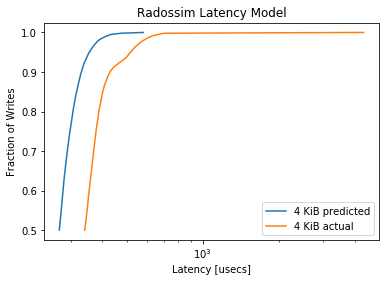

MainProcess pypet INFO     
 Finished single run #980 of 1680 

MainProcess pypet INFO     
 Starting single run #981 of 1680 



minimum predicted latency: 193.540359
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4011, pvalue=0.0)


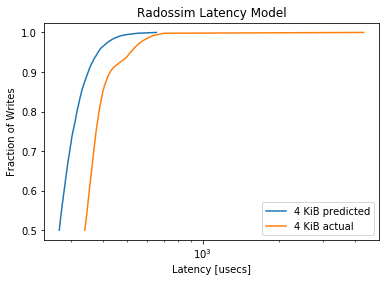

MainProcess pypet INFO     
 Finished single run #981 of 1680 

MainProcess pypet INFO     
 Starting single run #982 of 1680 



minimum predicted latency: 202.656462
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4017, pvalue=0.0)


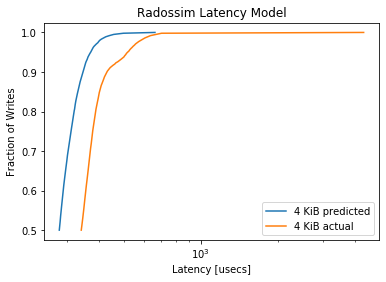

MainProcess pypet INFO     
 Finished single run #982 of 1680 

MainProcess pypet INFO     
 Starting single run #983 of 1680 



minimum predicted latency: 194.083345
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3423, pvalue=0.0)


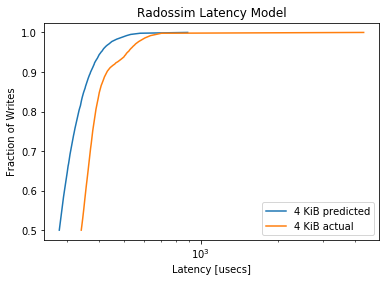

MainProcess pypet INFO     
 Finished single run #983 of 1680 

MainProcess pypet INFO     
 Starting single run #984 of 1680 



minimum predicted latency: 200.786065
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3355, pvalue=0.0)


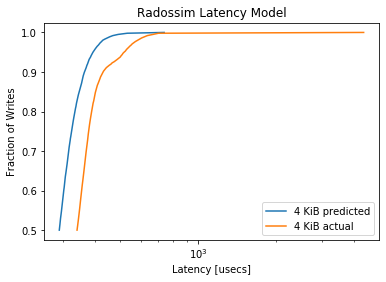

MainProcess pypet INFO     
 Finished single run #984 of 1680 

MainProcess pypet INFO     
 Starting single run #985 of 1680 



minimum predicted latency: 195.976881
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2894, pvalue=1e-323)


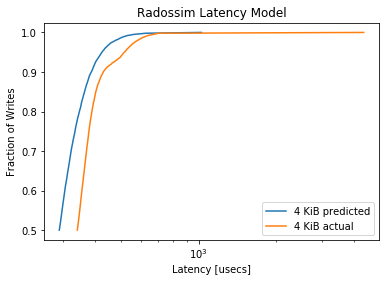

MainProcess pypet INFO     
 Finished single run #985 of 1680 

MainProcess pypet INFO     
 Starting single run #986 of 1680 



minimum predicted latency: 199.832365
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2587, pvalue=2.1350684116535676e-294)


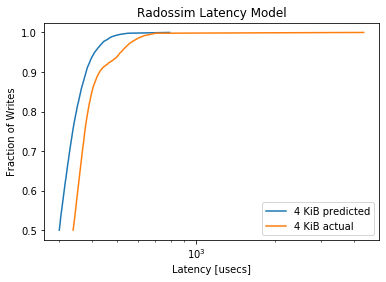

MainProcess pypet INFO     
 Finished single run #986 of 1680 

MainProcess pypet INFO     
 Starting single run #987 of 1680 



minimum predicted latency: 198.431145
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2227, pvalue=1.2758355687206396e-217)


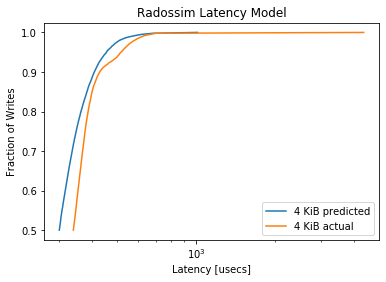

MainProcess pypet INFO     
 Finished single run #987 of 1680 

MainProcess pypet INFO     
 Starting single run #988 of 1680 



minimum predicted latency: 206.721522
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1741, pvalue=9.915897945105362e-133)


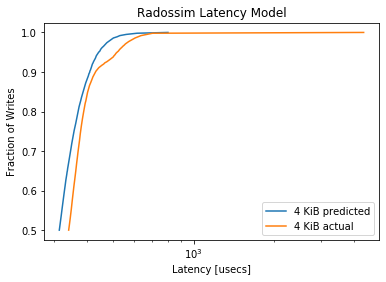

MainProcess pypet INFO     
 Finished single run #988 of 1680 

MainProcess pypet INFO     
 Starting single run #989 of 1680 



minimum predicted latency: 201.174230
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1469, pvalue=1.7648097754333257e-94)


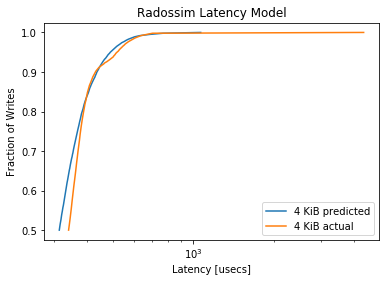

MainProcess pypet INFO     
 Finished single run #989 of 1680 

MainProcess pypet INFO     
 Starting single run #990 of 1680 



minimum predicted latency: 206.061420
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0777, pvalue=1.1383638313332442e-26)


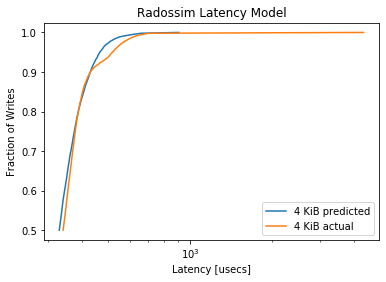

MainProcess pypet INFO     
 Finished single run #990 of 1680 

MainProcess pypet INFO     
 Starting single run #991 of 1680 



minimum predicted latency: 199.514185
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0668, pvalue=8.096563615176503e-20)


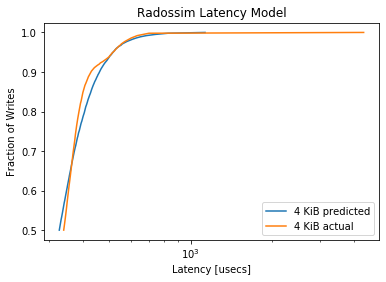

MainProcess pypet INFO     
 Finished single run #991 of 1680 

MainProcess pypet INFO     
 Starting single run #992 of 1680 



minimum predicted latency: 220.786366
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1425, pvalue=6.54102895113697e-89)


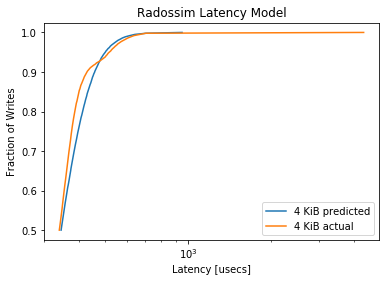

MainProcess pypet INFO     
 Finished single run #992 of 1680 

MainProcess pypet INFO     
 Starting single run #993 of 1680 



minimum predicted latency: 195.836308
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1225, pvalue=9.311399438482841e-66)


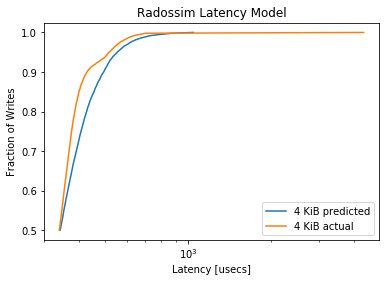

MainProcess pypet INFO     
 Finished single run #993 of 1680 

MainProcess pypet INFO     
 Starting single run #994 of 1680 



minimum predicted latency: 220.146478
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1994, pvalue=2.9506008242344797e-174)


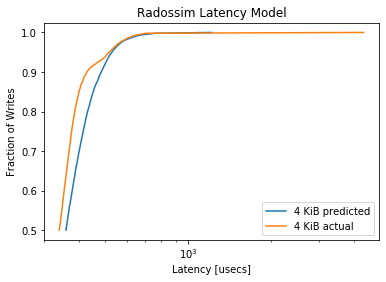

MainProcess pypet INFO     
 Finished single run #994 of 1680 

MainProcess pypet INFO     
 Starting single run #995 of 1680 



minimum predicted latency: 202.697237
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1915, pvalue=1.1365288461626946e-160)


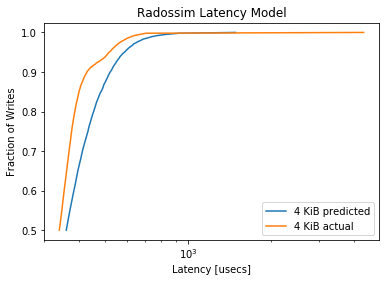

MainProcess pypet INFO     
 Finished single run #995 of 1680 

MainProcess pypet INFO     
 Starting single run #996 of 1680 



minimum predicted latency: 219.387603
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2633, pvalue=4.515442505587443e-305)


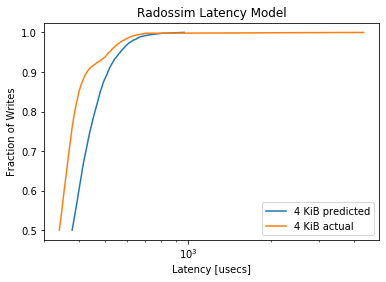

MainProcess pypet INFO     
 Finished single run #996 of 1680 

MainProcess pypet INFO     
 Starting single run #997 of 1680 



minimum predicted latency: 209.157147
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2668, pvalue=2.51407209636e-313)


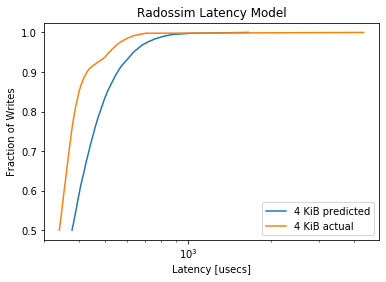

MainProcess pypet INFO     
 Finished single run #997 of 1680 

MainProcess pypet INFO     
 Starting single run #998 of 1680 



minimum predicted latency: 218.512316
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3701, pvalue=0.0)


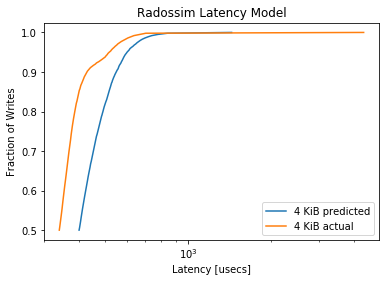

MainProcess pypet INFO     
 Finished single run #998 of 1680 

MainProcess pypet INFO     
 Starting single run #999 of 1680 



minimum predicted latency: 218.053164
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3492, pvalue=0.0)


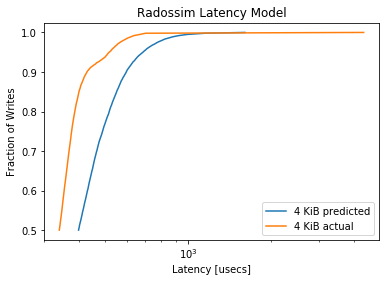

MainProcess pypet INFO     
 Finished single run #999 of 1680 

MainProcess pypet INFO     
 Starting single run #1000 of 1680 



minimum predicted latency: 197.624927
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.453, pvalue=0.0)


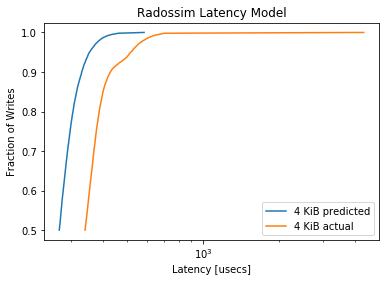

MainProcess pypet INFO     
 Finished single run #1000 of 1680 

MainProcess pypet INFO     
 Starting single run #1001 of 1680 



minimum predicted latency: 194.563030
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3981, pvalue=0.0)


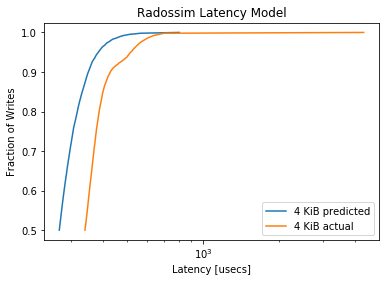

MainProcess pypet INFO     
 Finished single run #1001 of 1680 

MainProcess pypet INFO     
 Starting single run #1002 of 1680 



minimum predicted latency: 199.225102
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4042, pvalue=0.0)


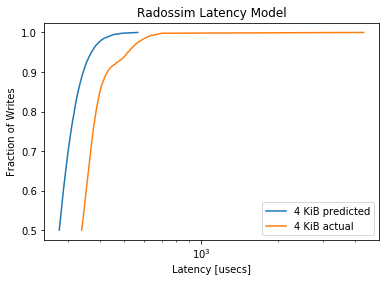

MainProcess pypet INFO     
 Finished single run #1002 of 1680 

MainProcess pypet INFO     
 Starting single run #1003 of 1680 



minimum predicted latency: 195.544697
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3453, pvalue=0.0)


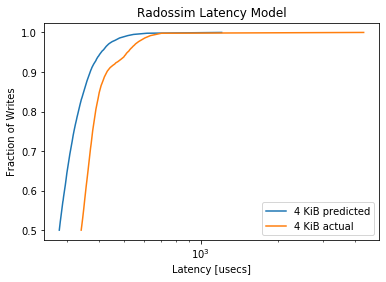

MainProcess pypet INFO     
 Finished single run #1003 of 1680 

MainProcess pypet INFO     
 Starting single run #1004 of 1680 



minimum predicted latency: 203.795125
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3466, pvalue=0.0)


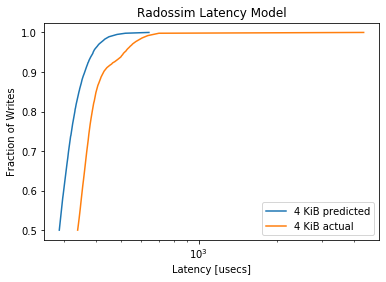

MainProcess pypet INFO     
 Finished single run #1004 of 1680 

MainProcess pypet INFO     
 Starting single run #1005 of 1680 



minimum predicted latency: 194.621463
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2882, pvalue=1e-323)


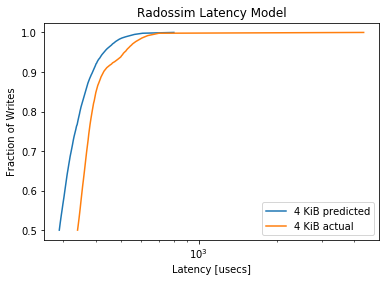

MainProcess pypet INFO     
 Finished single run #1005 of 1680 

MainProcess pypet INFO     
 Starting single run #1006 of 1680 



minimum predicted latency: 204.382946
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2732, pvalue=1e-323)


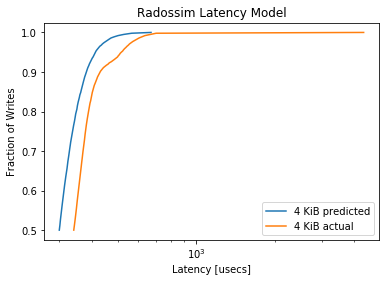

MainProcess pypet INFO     
 Finished single run #1006 of 1680 

MainProcess pypet INFO     
 Starting single run #1007 of 1680 



minimum predicted latency: 195.355665
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2282, pvalue=1.4053817932088466e-228)


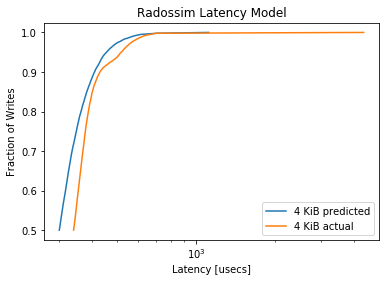

MainProcess pypet INFO     
 Finished single run #1007 of 1680 

MainProcess pypet INFO     PROGRESS: Finished 1008/1680 runs [============        ] 60.0%, remaining: 0:04:16
MainProcess pypet INFO     
 Starting single run #1008 of 1680 



minimum predicted latency: 208.550137
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1853, pvalue=2.1065266061737517e-150)


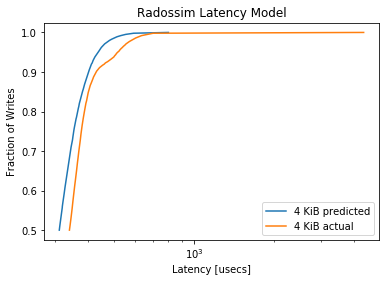

MainProcess pypet INFO     
 Finished single run #1008 of 1680 

MainProcess pypet INFO     
 Starting single run #1009 of 1680 



minimum predicted latency: 202.297593
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1549, pvalue=4.795963765274749e-105)


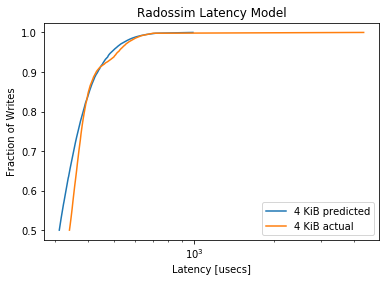

MainProcess pypet INFO     
 Finished single run #1009 of 1680 

MainProcess pypet INFO     
 Starting single run #1010 of 1680 



minimum predicted latency: 208.901050
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0931, pvalue=4.0308798712512307e-38)


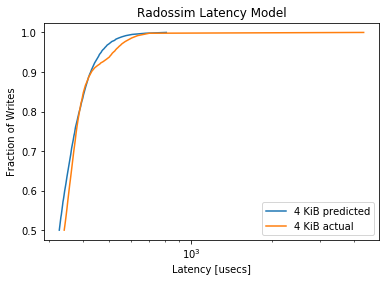

MainProcess pypet INFO     
 Finished single run #1010 of 1680 

MainProcess pypet INFO     
 Starting single run #1011 of 1680 



minimum predicted latency: 202.158376
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0742, pvalue=2.3417957249669973e-24)


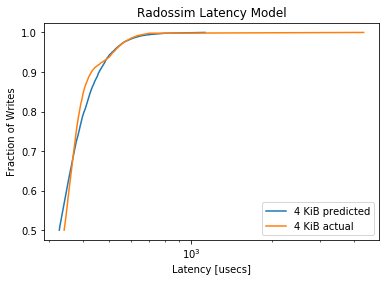

MainProcess pypet INFO     
 Finished single run #1011 of 1680 

MainProcess pypet INFO     
 Starting single run #1012 of 1680 



minimum predicted latency: 216.679991
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1295, pvalue=1.8513342025826677e-73)


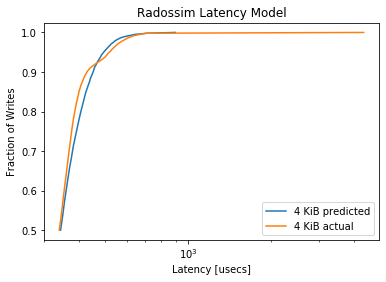

MainProcess pypet INFO     
 Finished single run #1012 of 1680 

MainProcess pypet INFO     
 Starting single run #1013 of 1680 



minimum predicted latency: 206.557041
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1224, pvalue=1.1909806141404957e-65)


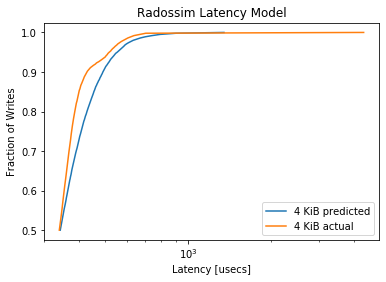

MainProcess pypet INFO     
 Finished single run #1013 of 1680 

MainProcess pypet INFO     
 Starting single run #1014 of 1680 



minimum predicted latency: 215.610673
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1909, pvalue=1.1598185144425434e-159)


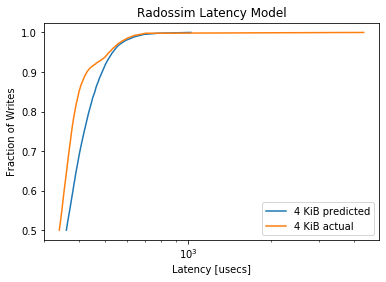

MainProcess pypet INFO     
 Finished single run #1014 of 1680 

MainProcess pypet INFO     
 Starting single run #1015 of 1680 



minimum predicted latency: 210.012122
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1979, pvalue=1.2383074661322037e-171)


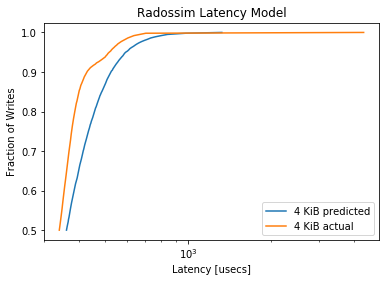

MainProcess pypet INFO     
 Finished single run #1015 of 1680 

MainProcess pypet INFO     
 Starting single run #1016 of 1680 



minimum predicted latency: 215.496776
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2641, pvalue=5.999087358997777e-307)


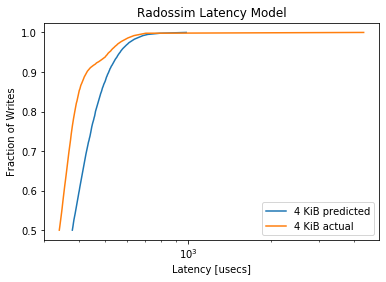

MainProcess pypet INFO     
 Finished single run #1016 of 1680 

MainProcess pypet INFO     
 Starting single run #1017 of 1680 



minimum predicted latency: 202.908098
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2638, pvalue=3.0374977166731034e-306)


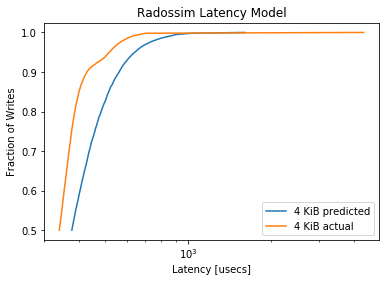

MainProcess pypet INFO     
 Finished single run #1017 of 1680 

MainProcess pypet INFO     
 Starting single run #1018 of 1680 



minimum predicted latency: 236.140917
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3607, pvalue=0.0)


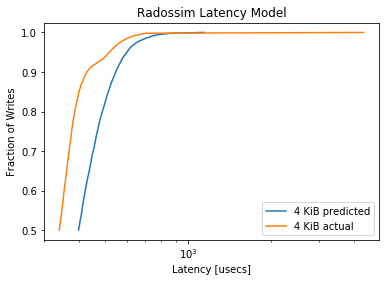

MainProcess pypet INFO     
 Finished single run #1018 of 1680 

MainProcess pypet INFO     
 Starting single run #1019 of 1680 



minimum predicted latency: 210.643138
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3527, pvalue=0.0)


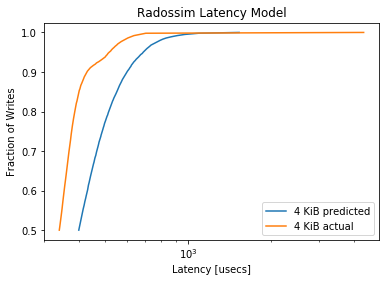

MainProcess pypet INFO     
 Finished single run #1019 of 1680 

MainProcess pypet INFO     
 Starting single run #1020 of 1680 



minimum predicted latency: 199.468132
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4564, pvalue=0.0)


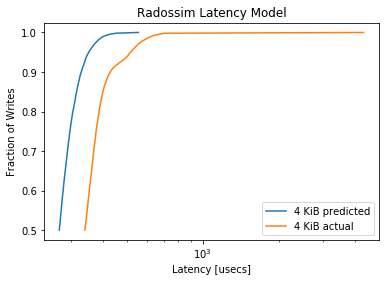

MainProcess pypet INFO     
 Finished single run #1020 of 1680 

MainProcess pypet INFO     
 Starting single run #1021 of 1680 



minimum predicted latency: 192.285428
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4068, pvalue=0.0)


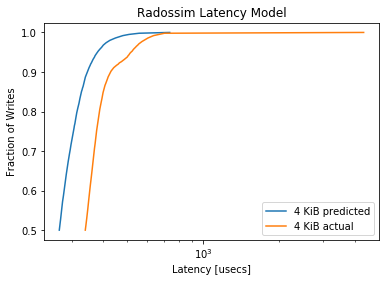

MainProcess pypet INFO     
 Finished single run #1021 of 1680 

MainProcess pypet INFO     
 Starting single run #1022 of 1680 



minimum predicted latency: 203.384213
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4012, pvalue=0.0)


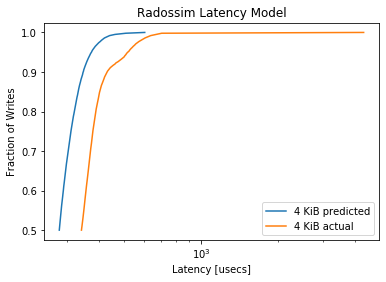

MainProcess pypet INFO     
 Finished single run #1022 of 1680 

MainProcess pypet INFO     
 Starting single run #1023 of 1680 



minimum predicted latency: 196.590839
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3539, pvalue=0.0)


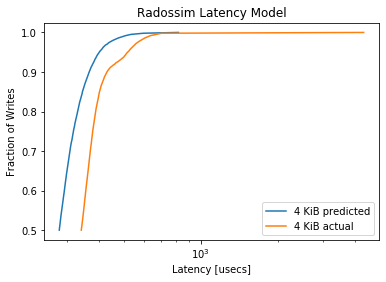

MainProcess pypet INFO     
 Finished single run #1023 of 1680 

MainProcess pypet INFO     
 Starting single run #1024 of 1680 



minimum predicted latency: 205.577374
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3406, pvalue=0.0)


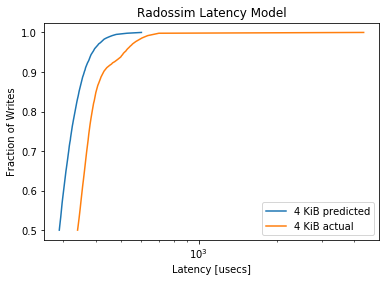

MainProcess pypet INFO     
 Finished single run #1024 of 1680 

MainProcess pypet INFO     
 Starting single run #1025 of 1680 



minimum predicted latency: 189.223226
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2924, pvalue=1e-323)


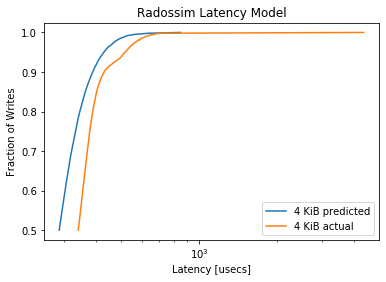

MainProcess pypet INFO     
 Finished single run #1025 of 1680 

MainProcess pypet INFO     
 Starting single run #1026 of 1680 



minimum predicted latency: 204.002741
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2614, pvalue=1.2238513192314975e-300)


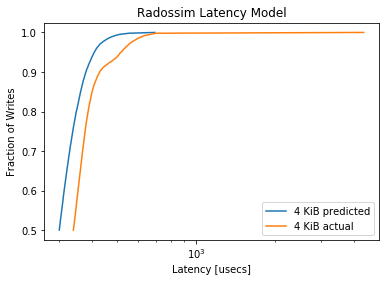

MainProcess pypet INFO     
 Finished single run #1026 of 1680 

MainProcess pypet INFO     
 Starting single run #1027 of 1680 



minimum predicted latency: 195.639088
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2204, pvalue=4.03846406905842e-213)


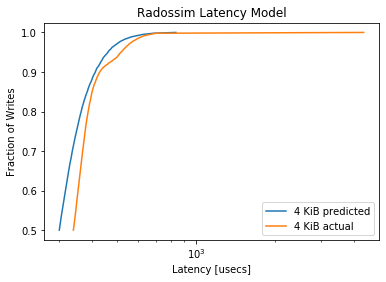

MainProcess pypet INFO     
 Finished single run #1027 of 1680 

MainProcess pypet INFO     
 Starting single run #1028 of 1680 



minimum predicted latency: 208.522359
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1824, pvalue=1.017665131210625e-145)


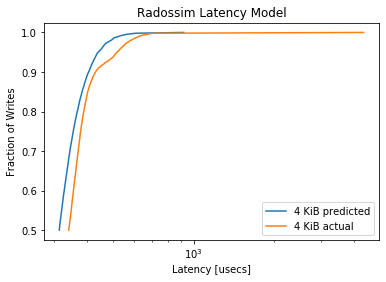

MainProcess pypet INFO     
 Finished single run #1028 of 1680 

MainProcess pypet INFO     
 Starting single run #1029 of 1680 



minimum predicted latency: 202.095955
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1518, pvalue=6.960514835227332e-101)


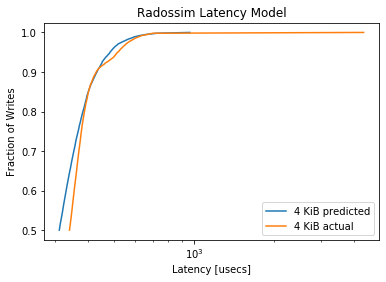

MainProcess pypet INFO     
 Finished single run #1029 of 1680 

MainProcess pypet INFO     
 Starting single run #1030 of 1680 



minimum predicted latency: 209.975146
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0875, pvalue=1.0220399750147786e-33)


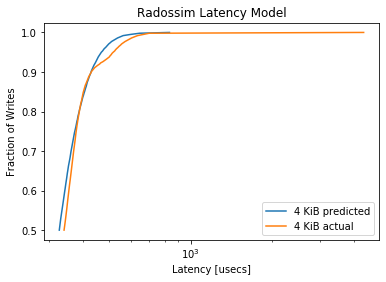

MainProcess pypet INFO     
 Finished single run #1030 of 1680 

MainProcess pypet INFO     
 Starting single run #1031 of 1680 



minimum predicted latency: 204.233929
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0761, pvalue=1.3398419879754772e-25)


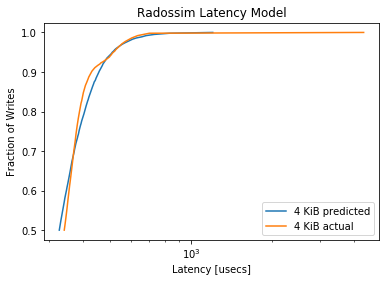

MainProcess pypet INFO     
 Finished single run #1031 of 1680 

MainProcess pypet INFO     
 Starting single run #1032 of 1680 



minimum predicted latency: 212.521637
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1285, pvalue=2.478482291121194e-72)


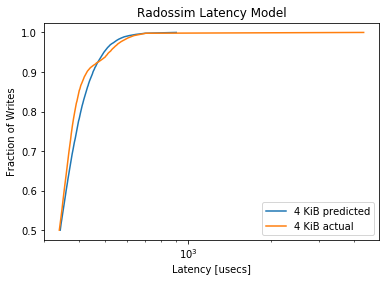

MainProcess pypet INFO     
 Finished single run #1032 of 1680 

MainProcess pypet INFO     
 Starting single run #1033 of 1680 



minimum predicted latency: 202.152897
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1256, pvalue=4.089649703754082e-69)


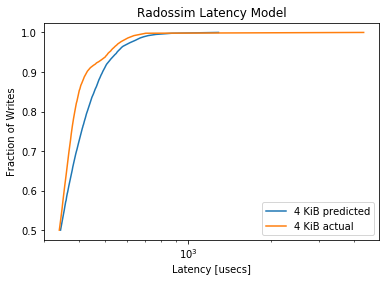

MainProcess pypet INFO     
 Finished single run #1033 of 1680 

MainProcess pypet INFO     
 Starting single run #1034 of 1680 



minimum predicted latency: 225.382923
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1939, pvalue=9.724708055913343e-165)


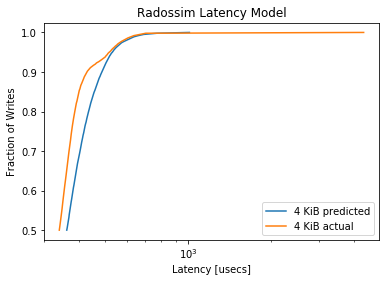

MainProcess pypet INFO     
 Finished single run #1034 of 1680 

MainProcess pypet INFO     
 Starting single run #1035 of 1680 



minimum predicted latency: 203.569944
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1943, pvalue=2.017778219397173e-165)


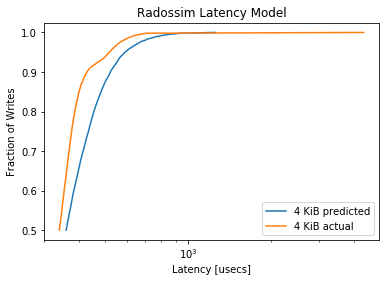

MainProcess pypet INFO     
 Finished single run #1035 of 1680 

MainProcess pypet INFO     
 Starting single run #1036 of 1680 



minimum predicted latency: 208.972734
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2658, pvalue=5.8943287342924e-311)


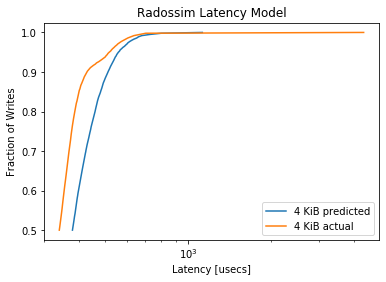

MainProcess pypet INFO     
 Finished single run #1036 of 1680 

MainProcess pypet INFO     
 Starting single run #1037 of 1680 



minimum predicted latency: 215.603411
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.265, pvalue=4.568256944595316e-309)


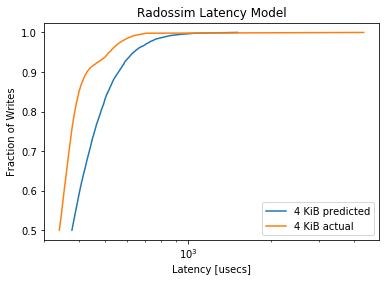

MainProcess pypet INFO     
 Finished single run #1037 of 1680 

MainProcess pypet INFO     
 Starting single run #1038 of 1680 



minimum predicted latency: 222.103216
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3641, pvalue=0.0)


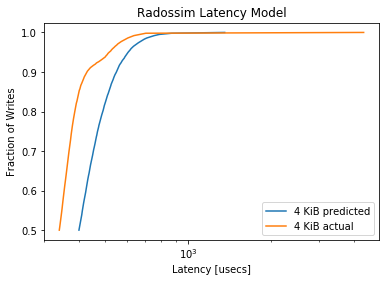

MainProcess pypet INFO     
 Finished single run #1038 of 1680 

MainProcess pypet INFO     
 Starting single run #1039 of 1680 



minimum predicted latency: 212.996558
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3556, pvalue=0.0)


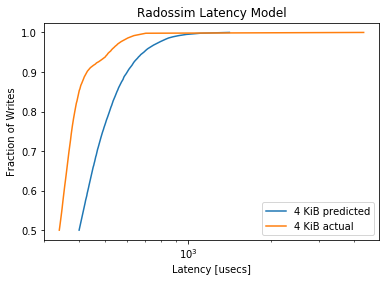

MainProcess pypet INFO     
 Finished single run #1039 of 1680 

MainProcess pypet INFO     
 Starting single run #1040 of 1680 



minimum predicted latency: 197.228678
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4561, pvalue=0.0)


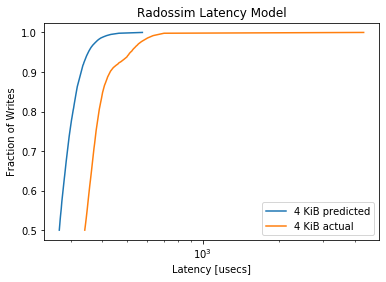

MainProcess pypet INFO     
 Finished single run #1040 of 1680 

MainProcess pypet INFO     
 Starting single run #1041 of 1680 



minimum predicted latency: 194.870090
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4072, pvalue=0.0)


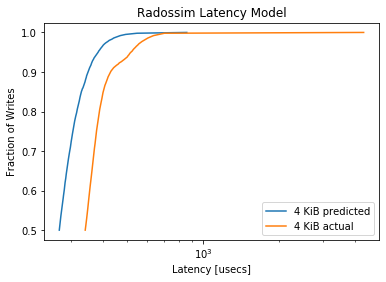

MainProcess pypet INFO     
 Finished single run #1041 of 1680 

MainProcess pypet INFO     
 Starting single run #1042 of 1680 



minimum predicted latency: 203.283280
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4031, pvalue=0.0)


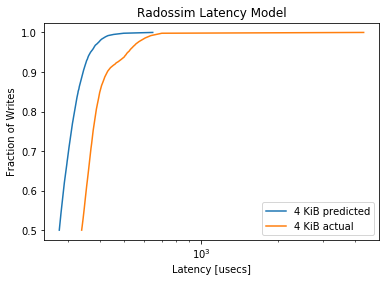

MainProcess pypet INFO     
 Finished single run #1042 of 1680 

MainProcess pypet INFO     
 Starting single run #1043 of 1680 



minimum predicted latency: 194.101676
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3467, pvalue=0.0)


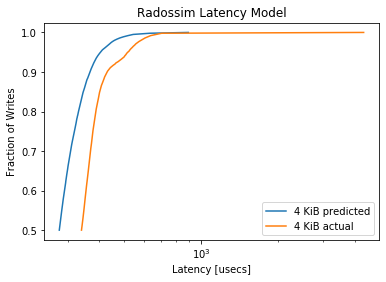

MainProcess pypet INFO     
 Finished single run #1043 of 1680 

MainProcess pypet INFO     
 Starting single run #1044 of 1680 



minimum predicted latency: 200.833296
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3355, pvalue=0.0)


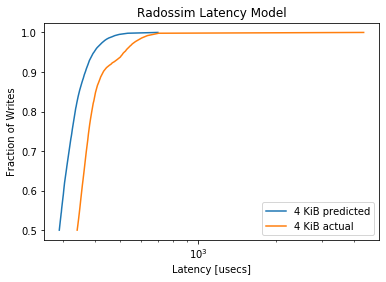

MainProcess pypet INFO     
 Finished single run #1044 of 1680 

MainProcess pypet INFO     
 Starting single run #1045 of 1680 



minimum predicted latency: 193.004362
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2882, pvalue=1e-323)


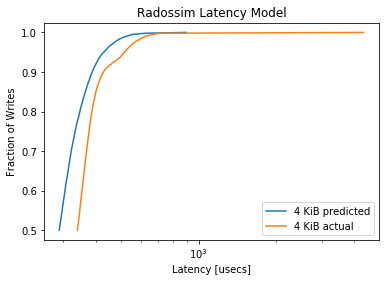

MainProcess pypet INFO     
 Finished single run #1045 of 1680 

MainProcess pypet INFO     
 Starting single run #1046 of 1680 



minimum predicted latency: 206.120468
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2692, pvalue=4.7215e-319)


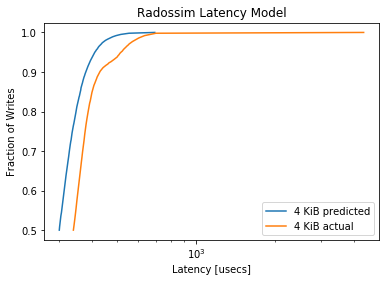

MainProcess pypet INFO     
 Finished single run #1046 of 1680 

MainProcess pypet INFO     
 Starting single run #1047 of 1680 



minimum predicted latency: 199.964270
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2171, pvalue=9.528071201348462e-207)


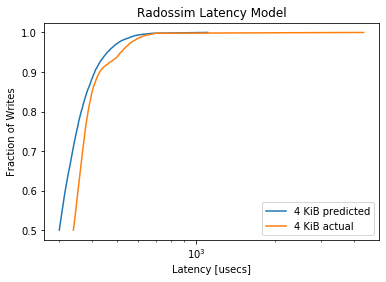

MainProcess pypet INFO     
 Finished single run #1047 of 1680 

MainProcess pypet INFO     
 Starting single run #1048 of 1680 



minimum predicted latency: 207.315508
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1781, pvalue=6.514021286355296e-139)


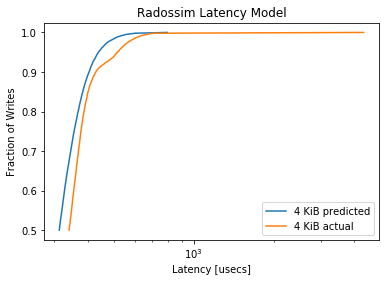

MainProcess pypet INFO     
 Finished single run #1048 of 1680 

MainProcess pypet INFO     
 Starting single run #1049 of 1680 



minimum predicted latency: 199.450519
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.146, pvalue=2.510584563663586e-93)


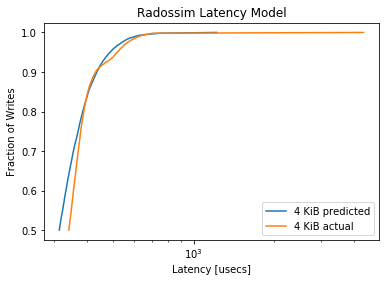

MainProcess pypet INFO     
 Finished single run #1049 of 1680 

MainProcess pypet INFO     
 Starting single run #1050 of 1680 



minimum predicted latency: 212.956471
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0809, pvalue=7.040783648697654e-29)


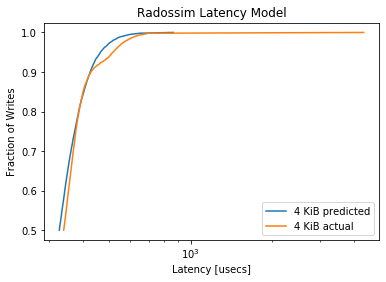

MainProcess pypet INFO     
 Finished single run #1050 of 1680 

MainProcess pypet INFO     
 Starting single run #1051 of 1680 



minimum predicted latency: 203.393318
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0684, pvalue=9.277840740986801e-21)


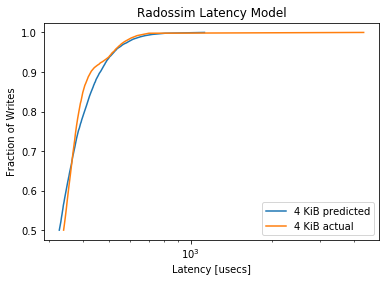

MainProcess pypet INFO     
 Finished single run #1051 of 1680 

MainProcess pypet INFO     
 Starting single run #1052 of 1680 



minimum predicted latency: 212.583375
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1288, pvalue=1.1405200108839757e-72)


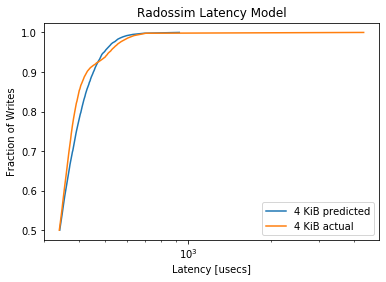

MainProcess pypet INFO     
 Finished single run #1052 of 1680 

MainProcess pypet INFO     
 Starting single run #1053 of 1680 



minimum predicted latency: 211.310109
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1283, pvalue=4.1539971432867586e-72)


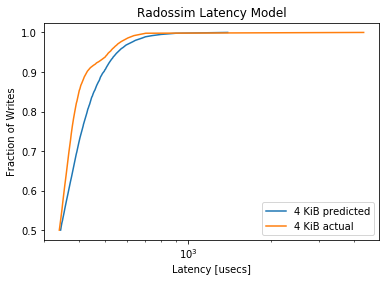

MainProcess pypet INFO     
 Finished single run #1053 of 1680 

MainProcess pypet INFO     
 Starting single run #1054 of 1680 



minimum predicted latency: 216.772568
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1939, pvalue=9.724708055913343e-165)


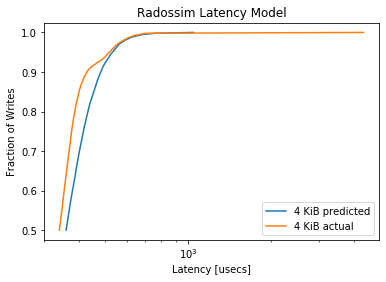

MainProcess pypet INFO     
 Finished single run #1054 of 1680 

MainProcess pypet INFO     
 Starting single run #1055 of 1680 



minimum predicted latency: 209.929432
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1902, pvalue=1.7267651020902887e-158)


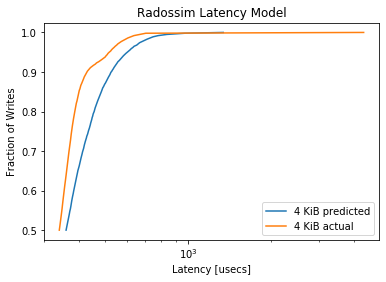

MainProcess pypet INFO     
 Finished single run #1055 of 1680 

MainProcess pypet INFO     
 Starting single run #1056 of 1680 



minimum predicted latency: 210.785551
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2645, pvalue=6.879185245291027e-308)


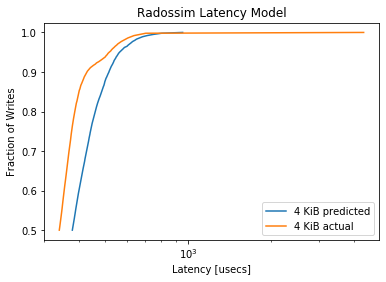

MainProcess pypet INFO     
 Finished single run #1056 of 1680 

MainProcess pypet INFO     
 Starting single run #1057 of 1680 



minimum predicted latency: 209.653082
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2775, pvalue=1e-323)


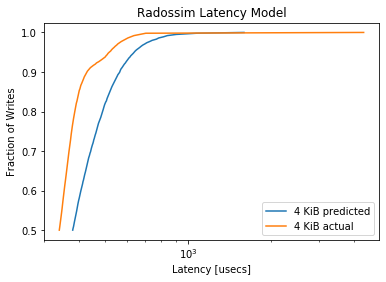

MainProcess pypet INFO     
 Finished single run #1057 of 1680 

MainProcess pypet INFO     
 Starting single run #1058 of 1680 



minimum predicted latency: 224.372138
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3613, pvalue=0.0)


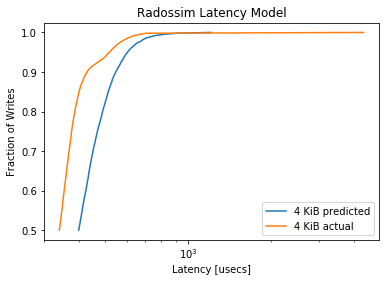

MainProcess pypet INFO     
 Finished single run #1058 of 1680 

MainProcess pypet INFO     
 Starting single run #1059 of 1680 



minimum predicted latency: 209.140918
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3525, pvalue=0.0)


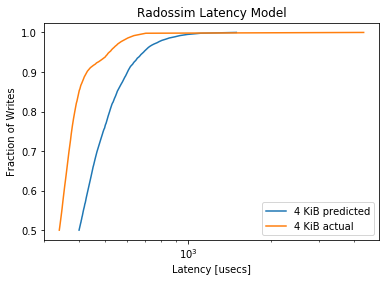

MainProcess pypet INFO     
 Finished single run #1059 of 1680 

MainProcess pypet INFO     
 Starting single run #1060 of 1680 



minimum predicted latency: 194.897652
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4597, pvalue=0.0)


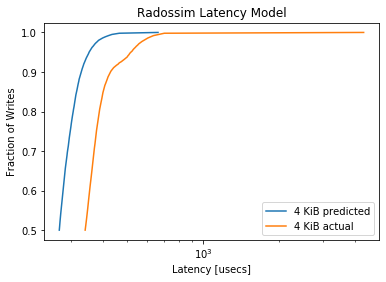

MainProcess pypet INFO     
 Finished single run #1060 of 1680 

MainProcess pypet INFO     
 Starting single run #1061 of 1680 



minimum predicted latency: 188.504781
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4094, pvalue=0.0)


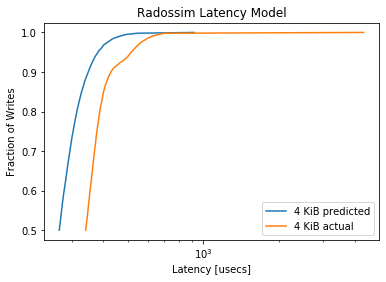

MainProcess pypet INFO     
 Finished single run #1061 of 1680 

MainProcess pypet INFO     
 Starting single run #1062 of 1680 



minimum predicted latency: 201.155593
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4033, pvalue=0.0)


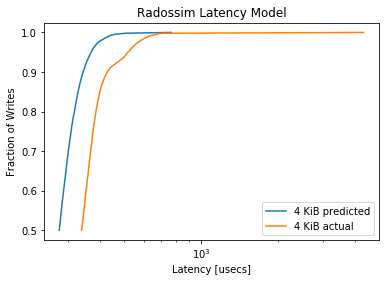

MainProcess pypet INFO     
 Finished single run #1062 of 1680 

MainProcess pypet INFO     
 Starting single run #1063 of 1680 



minimum predicted latency: 191.415984
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3544, pvalue=0.0)


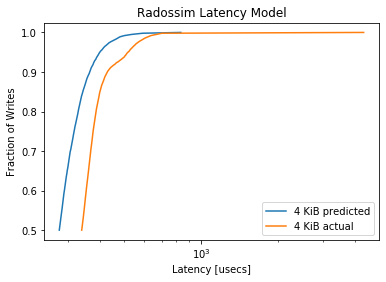

MainProcess pypet INFO     
 Finished single run #1063 of 1680 

MainProcess pypet INFO     
 Starting single run #1064 of 1680 



minimum predicted latency: 203.225355
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3403, pvalue=0.0)


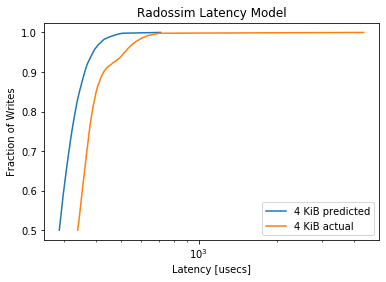

MainProcess pypet INFO     
 Finished single run #1064 of 1680 

MainProcess pypet INFO     
 Starting single run #1065 of 1680 



minimum predicted latency: 190.887752
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2909, pvalue=1e-323)


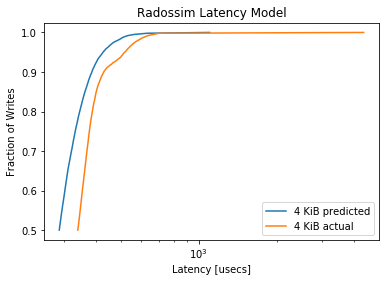

MainProcess pypet INFO     
 Finished single run #1065 of 1680 

MainProcess pypet INFO     
 Starting single run #1066 of 1680 



minimum predicted latency: 208.007524
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.267, pvalue=8.4186887357e-314)


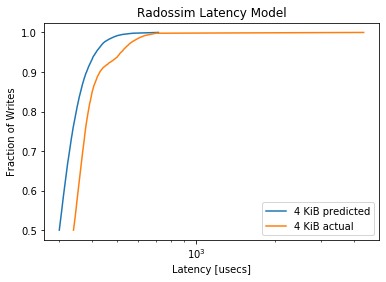

MainProcess pypet INFO     
 Finished single run #1066 of 1680 

MainProcess pypet INFO     
 Starting single run #1067 of 1680 



minimum predicted latency: 200.030967
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.231, pvalue=2.902369715354082e-234)


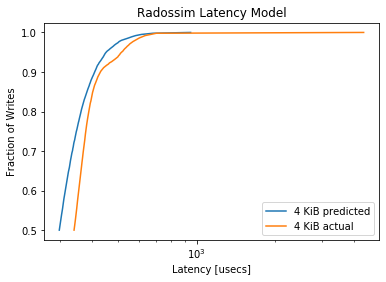

MainProcess pypet INFO     
 Finished single run #1067 of 1680 

MainProcess pypet INFO     
 Starting single run #1068 of 1680 



minimum predicted latency: 207.348233
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1818, pvalue=9.274273578228564e-145)


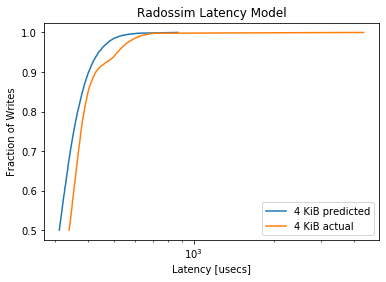

MainProcess pypet INFO     
 Finished single run #1068 of 1680 

MainProcess pypet INFO     
 Starting single run #1069 of 1680 



minimum predicted latency: 201.640096
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1528, pvalue=3.232028427783549e-102)


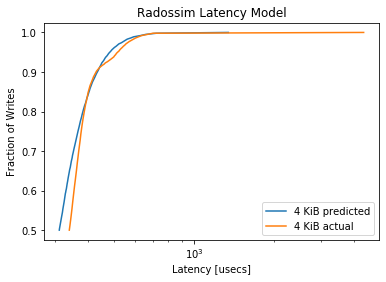

MainProcess pypet INFO     
 Finished single run #1069 of 1680 

MainProcess pypet INFO     
 Starting single run #1070 of 1680 



minimum predicted latency: 211.777241
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0934, pvalue=2.2999391389224717e-38)


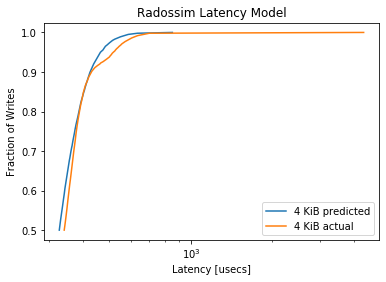

MainProcess pypet INFO     
 Finished single run #1070 of 1680 

MainProcess pypet INFO     
 Starting single run #1071 of 1680 



minimum predicted latency: 204.986056
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0765, pvalue=7.268709717186636e-26)


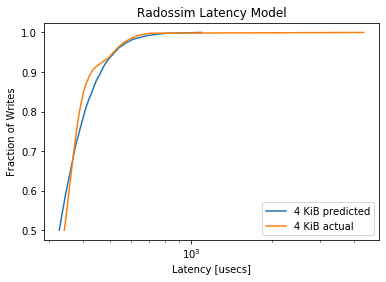

MainProcess pypet INFO     
 Finished single run #1071 of 1680 

MainProcess pypet INFO     
 Starting single run #1072 of 1680 



minimum predicted latency: 211.265723
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1258, pvalue=2.4670208918635897e-69)


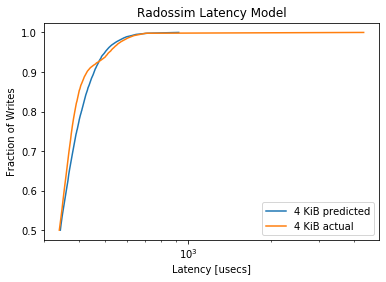

MainProcess pypet INFO     
 Finished single run #1072 of 1680 

MainProcess pypet INFO     
 Starting single run #1073 of 1680 



minimum predicted latency: 202.932022
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1207, pvalue=7.57776490723542e-64)


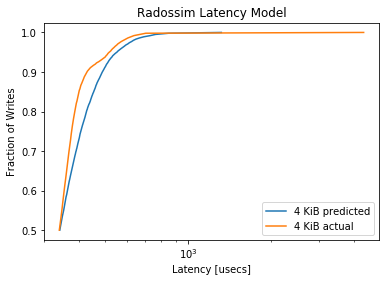

MainProcess pypet INFO     
 Finished single run #1073 of 1680 

MainProcess pypet INFO     
 Starting single run #1074 of 1680 



minimum predicted latency: 219.170488
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1819, pvalue=6.420349134196304e-145)


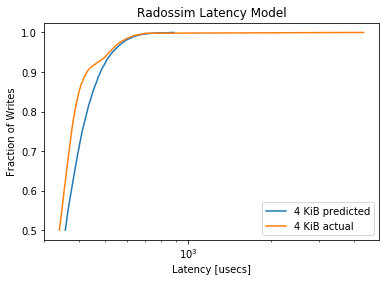

MainProcess pypet INFO     
 Finished single run #1074 of 1680 

MainProcess pypet INFO     
 Starting single run #1075 of 1680 



minimum predicted latency: 203.314943
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1906, pvalue=3.6946890845477517e-159)


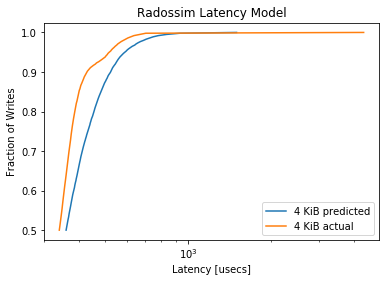

MainProcess pypet INFO     
 Finished single run #1075 of 1680 

MainProcess pypet INFO     
 Starting single run #1076 of 1680 



minimum predicted latency: 226.392633
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2669, pvalue=1.45498276194e-313)


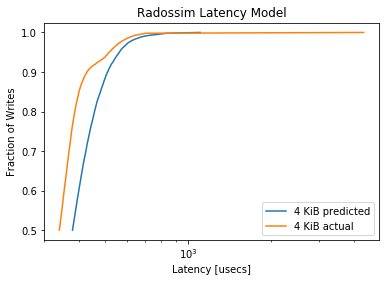

MainProcess pypet INFO     
 Finished single run #1076 of 1680 

MainProcess pypet INFO     
 Starting single run #1077 of 1680 



minimum predicted latency: 201.058188
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2735, pvalue=1e-323)


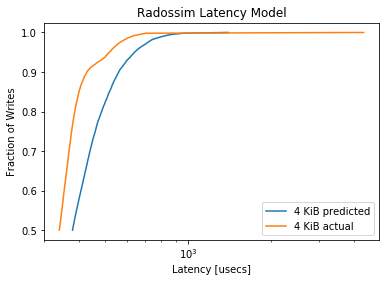

MainProcess pypet INFO     
 Finished single run #1077 of 1680 

MainProcess pypet INFO     
 Starting single run #1078 of 1680 



minimum predicted latency: 235.309367
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3569, pvalue=0.0)


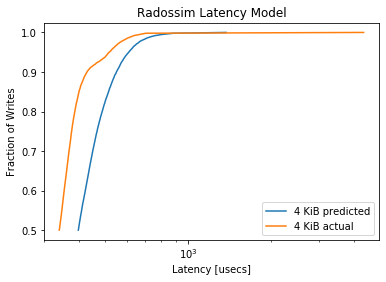

MainProcess pypet INFO     
 Finished single run #1078 of 1680 

MainProcess pypet INFO     
 Starting single run #1079 of 1680 



minimum predicted latency: 213.798854
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3458, pvalue=0.0)


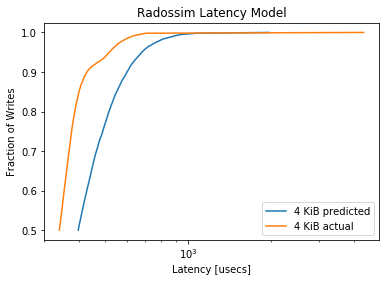

MainProcess pypet INFO     
 Finished single run #1079 of 1680 

MainProcess pypet INFO     
 Starting single run #1080 of 1680 



minimum predicted latency: 200.483599
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4598, pvalue=0.0)


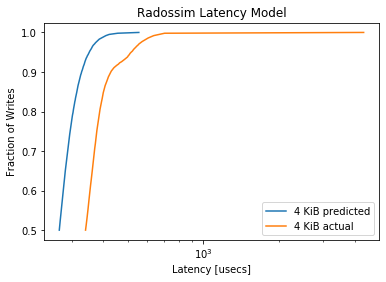

MainProcess pypet INFO     
 Finished single run #1080 of 1680 

MainProcess pypet INFO     
 Starting single run #1081 of 1680 



minimum predicted latency: 188.601673
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4088, pvalue=0.0)


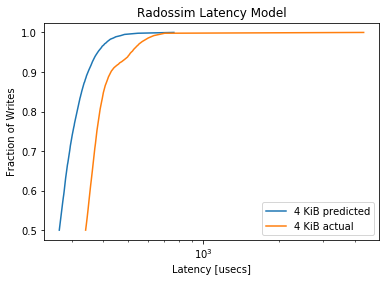

MainProcess pypet INFO     
 Finished single run #1081 of 1680 

MainProcess pypet INFO     
 Starting single run #1082 of 1680 



minimum predicted latency: 200.128618
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4094, pvalue=0.0)


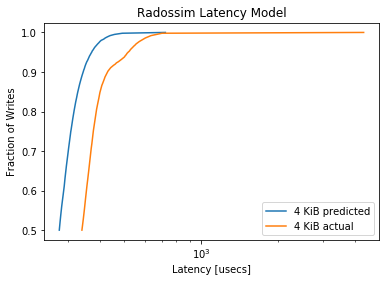

MainProcess pypet INFO     
 Finished single run #1082 of 1680 

MainProcess pypet INFO     
 Starting single run #1083 of 1680 



minimum predicted latency: 190.912563
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3529, pvalue=0.0)


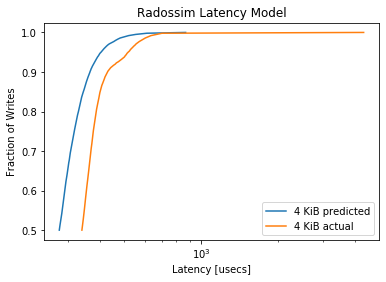

MainProcess pypet INFO     
 Finished single run #1083 of 1680 

MainProcess pypet INFO     
 Starting single run #1084 of 1680 



minimum predicted latency: 196.963688
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3526, pvalue=0.0)


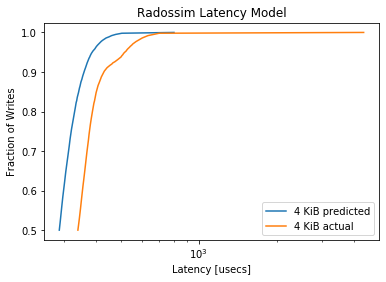

MainProcess pypet INFO     
 Finished single run #1084 of 1680 

MainProcess pypet INFO     
 Starting single run #1085 of 1680 



minimum predicted latency: 194.089976
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3, pvalue=1e-323)


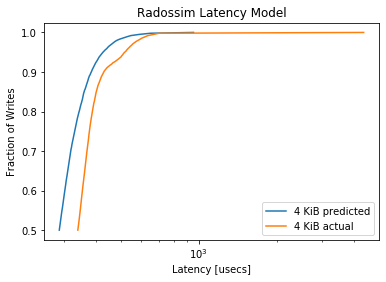

MainProcess pypet INFO     
 Finished single run #1085 of 1680 

MainProcess pypet INFO     
 Starting single run #1086 of 1680 



minimum predicted latency: 206.468266
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2624, pvalue=5.737903040246965e-303)


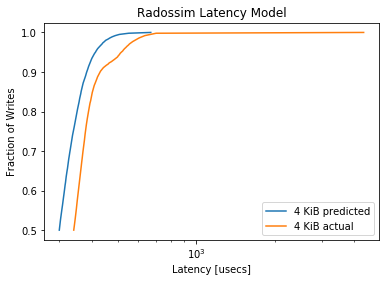

MainProcess pypet INFO     
 Finished single run #1086 of 1680 

MainProcess pypet INFO     
 Starting single run #1087 of 1680 



minimum predicted latency: 198.860819
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2352, pvalue=6.313742064610421e-243)


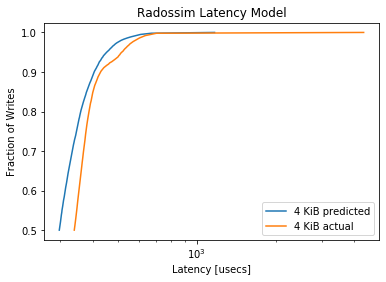

MainProcess pypet INFO     
 Finished single run #1087 of 1680 

MainProcess pypet INFO     
 Starting single run #1088 of 1680 



minimum predicted latency: 210.166186
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1836, pvalue=1.1982600064495492e-147)


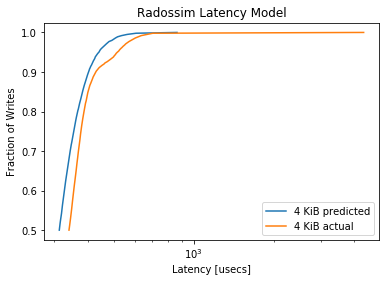

MainProcess pypet INFO     
 Finished single run #1088 of 1680 

MainProcess pypet INFO     
 Starting single run #1089 of 1680 



minimum predicted latency: 200.168415
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1548, pvalue=6.553311112773081e-105)


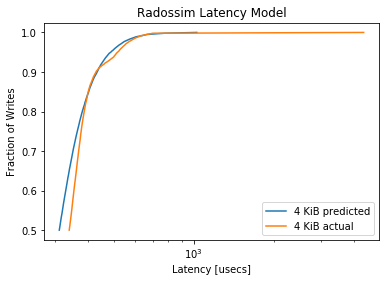

MainProcess pypet INFO     
 Finished single run #1089 of 1680 

MainProcess pypet INFO     
 Starting single run #1090 of 1680 



minimum predicted latency: 210.194030
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0909, pvalue=2.3351850663424812e-36)


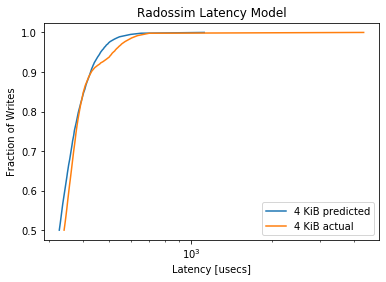

MainProcess pypet INFO     
 Finished single run #1090 of 1680 

MainProcess pypet INFO     
 Starting single run #1091 of 1680 



minimum predicted latency: 200.225715
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0761, pvalue=1.3398419879754772e-25)


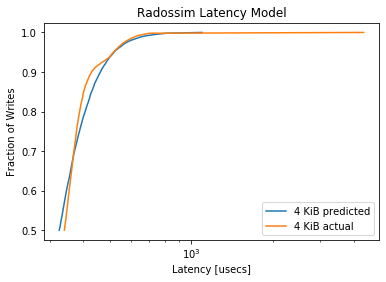

MainProcess pypet INFO     
 Finished single run #1091 of 1680 

MainProcess pypet INFO     PROGRESS: Finished 1092/1680 runs [=============       ] 65.0%, remaining: 0:03:41
MainProcess pypet INFO     
 Starting single run #1092 of 1680 



minimum predicted latency: 210.431766
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1311, pvalue=2.7950424414942666e-75)


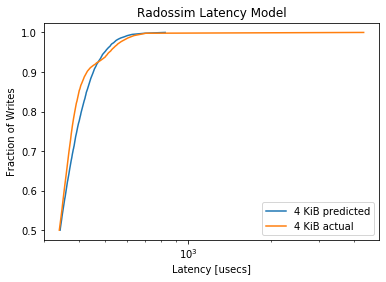

MainProcess pypet INFO     
 Finished single run #1092 of 1680 

MainProcess pypet INFO     
 Starting single run #1093 of 1680 



minimum predicted latency: 207.357614
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1352, pvalue=4.7483360666371624e-80)


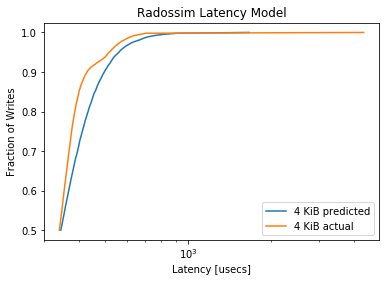

MainProcess pypet INFO     
 Finished single run #1093 of 1680 

MainProcess pypet INFO     
 Starting single run #1094 of 1680 



minimum predicted latency: 216.551044
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1918, pvalue=3.547795315220964e-161)


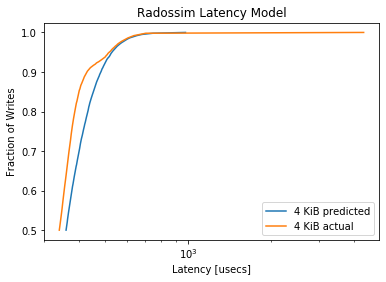

MainProcess pypet INFO     
 Finished single run #1094 of 1680 

MainProcess pypet INFO     
 Starting single run #1095 of 1680 



minimum predicted latency: 206.588885
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1888, pvalue=3.7125656549006217e-156)


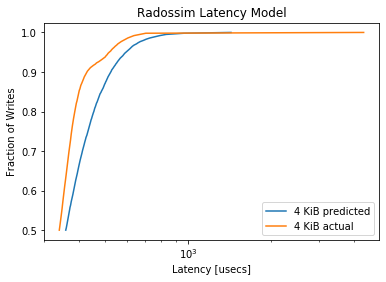

MainProcess pypet INFO     
 Finished single run #1095 of 1680 

MainProcess pypet INFO     
 Starting single run #1096 of 1680 



minimum predicted latency: 219.186315
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2663, pvalue=3.859886924884e-312)


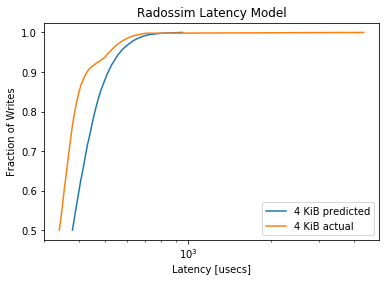

MainProcess pypet INFO     
 Finished single run #1096 of 1680 

MainProcess pypet INFO     
 Starting single run #1097 of 1680 



minimum predicted latency: 206.074177
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2658, pvalue=5.8943287342924e-311)


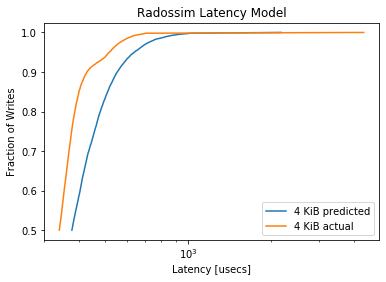

MainProcess pypet INFO     
 Finished single run #1097 of 1680 

MainProcess pypet INFO     
 Starting single run #1098 of 1680 



minimum predicted latency: 228.636199
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3578, pvalue=0.0)


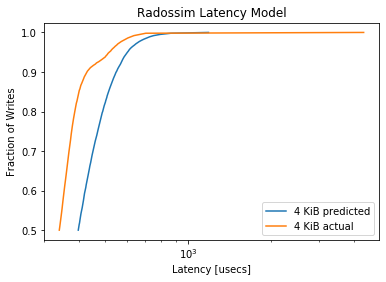

MainProcess pypet INFO     
 Finished single run #1098 of 1680 

MainProcess pypet INFO     
 Starting single run #1099 of 1680 



minimum predicted latency: 210.329204
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3549, pvalue=0.0)


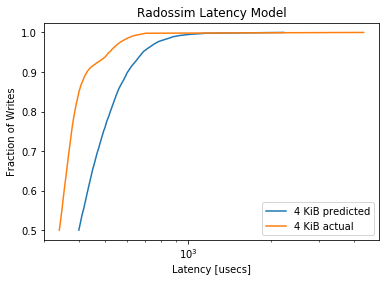

MainProcess pypet INFO     
 Finished single run #1099 of 1680 

MainProcess pypet INFO     
 Starting single run #1100 of 1680 



minimum predicted latency: 199.396962
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4571, pvalue=0.0)


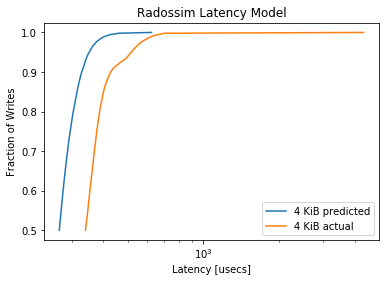

MainProcess pypet INFO     
 Finished single run #1100 of 1680 

MainProcess pypet INFO     
 Starting single run #1101 of 1680 



minimum predicted latency: 193.850405
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.407, pvalue=0.0)


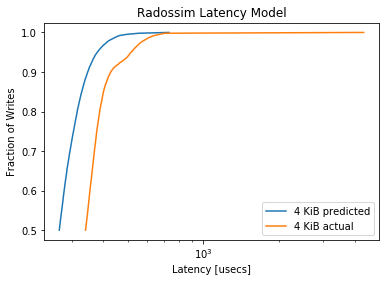

MainProcess pypet INFO     
 Finished single run #1101 of 1680 

MainProcess pypet INFO     
 Starting single run #1102 of 1680 



minimum predicted latency: 203.592159
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4129, pvalue=0.0)


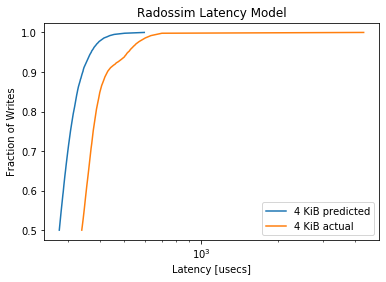

MainProcess pypet INFO     
 Finished single run #1102 of 1680 

MainProcess pypet INFO     
 Starting single run #1103 of 1680 



minimum predicted latency: 190.601633
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3566, pvalue=0.0)


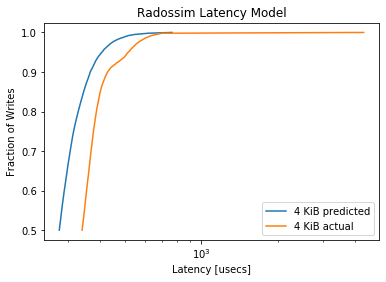

MainProcess pypet INFO     
 Finished single run #1103 of 1680 

MainProcess pypet INFO     
 Starting single run #1104 of 1680 



minimum predicted latency: 200.421862
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3393, pvalue=0.0)


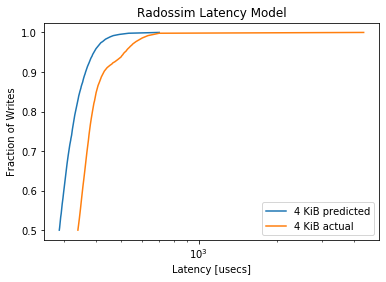

MainProcess pypet INFO     
 Finished single run #1104 of 1680 

MainProcess pypet INFO     
 Starting single run #1105 of 1680 



minimum predicted latency: 196.652792
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2996, pvalue=1e-323)


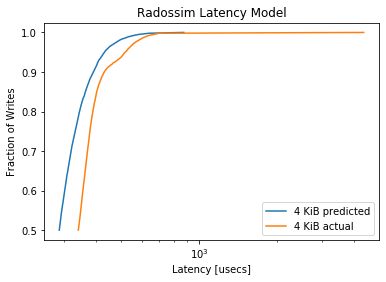

MainProcess pypet INFO     
 Finished single run #1105 of 1680 

MainProcess pypet INFO     
 Starting single run #1106 of 1680 



minimum predicted latency: 208.152496
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2726, pvalue=1e-323)


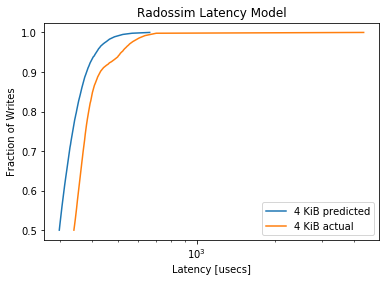

MainProcess pypet INFO     
 Finished single run #1106 of 1680 

MainProcess pypet INFO     
 Starting single run #1107 of 1680 



minimum predicted latency: 196.978943
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2303, pvalue=7.775940463053528e-233)


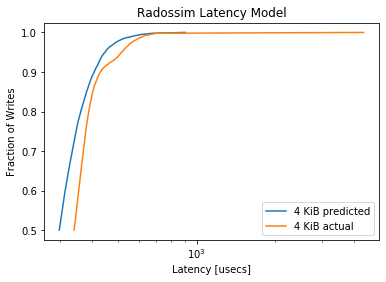

MainProcess pypet INFO     
 Finished single run #1107 of 1680 

MainProcess pypet INFO     
 Starting single run #1108 of 1680 



minimum predicted latency: 208.438809
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1852, pvalue=3.0643912448425967e-150)


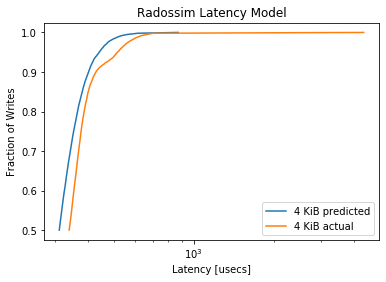

MainProcess pypet INFO     
 Finished single run #1108 of 1680 

MainProcess pypet INFO     
 Starting single run #1109 of 1680 



minimum predicted latency: 198.811472
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1582, pvalue=1.4342811278492186e-109)


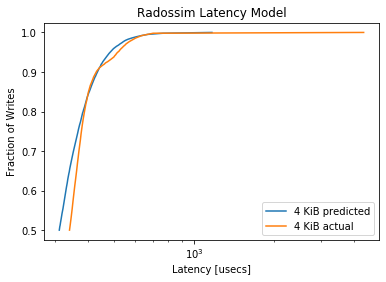

MainProcess pypet INFO     
 Finished single run #1109 of 1680 

MainProcess pypet INFO     
 Starting single run #1110 of 1680 



minimum predicted latency: 209.702798
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0911, pvalue=1.6210915397608417e-36)


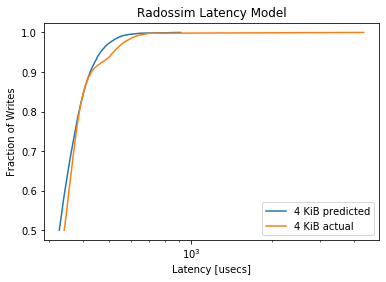

MainProcess pypet INFO     
 Finished single run #1110 of 1680 

MainProcess pypet INFO     
 Starting single run #1111 of 1680 



minimum predicted latency: 196.681359
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0785, pvalue=3.254666630482321e-27)


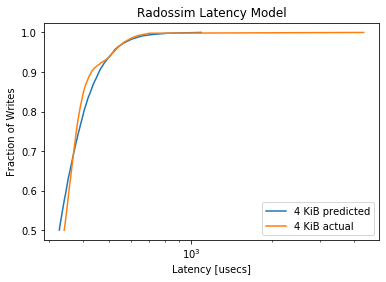

MainProcess pypet INFO     
 Finished single run #1111 of 1680 

MainProcess pypet INFO     
 Starting single run #1112 of 1680 



minimum predicted latency: 214.298870
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1262, pvalue=8.955446227978754e-70)


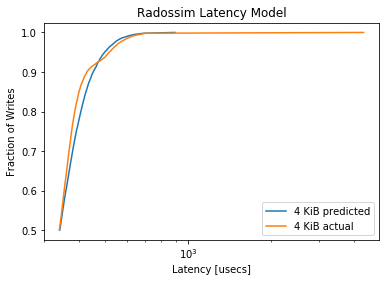

MainProcess pypet INFO     
 Finished single run #1112 of 1680 

MainProcess pypet INFO     
 Starting single run #1113 of 1680 



minimum predicted latency: 198.898502
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1171, pvalue=4.120361469634608e-60)


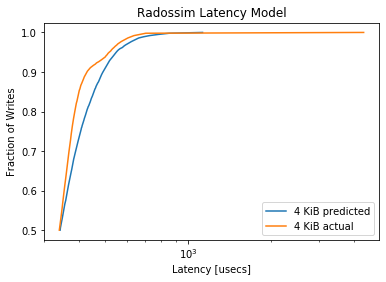

MainProcess pypet INFO     
 Finished single run #1113 of 1680 

MainProcess pypet INFO     
 Starting single run #1114 of 1680 



minimum predicted latency: 217.884508
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1861, pvalue=1.042582942477046e-151)


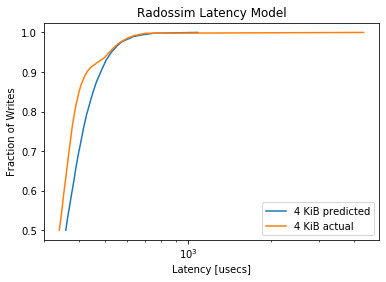

MainProcess pypet INFO     
 Finished single run #1114 of 1680 

MainProcess pypet INFO     
 Starting single run #1115 of 1680 



minimum predicted latency: 206.351849
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1936, pvalue=3.1563221292058246e-164)


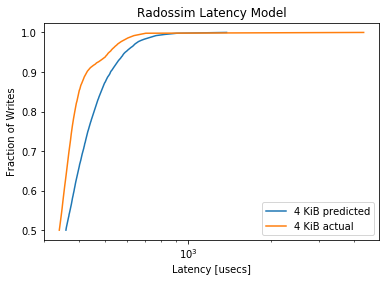

MainProcess pypet INFO     
 Finished single run #1115 of 1680 

MainProcess pypet INFO     
 Starting single run #1116 of 1680 



minimum predicted latency: 220.387225
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.261, pvalue=1.039221874850222e-299)


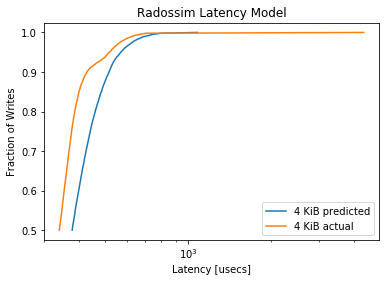

MainProcess pypet INFO     
 Finished single run #1116 of 1680 

MainProcess pypet INFO     
 Starting single run #1117 of 1680 



minimum predicted latency: 207.296435
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2679, pvalue=6.06058865e-316)


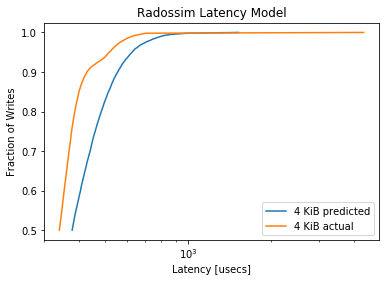

MainProcess pypet INFO     
 Finished single run #1117 of 1680 

MainProcess pypet INFO     
 Starting single run #1118 of 1680 



minimum predicted latency: 235.718043
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.366, pvalue=0.0)


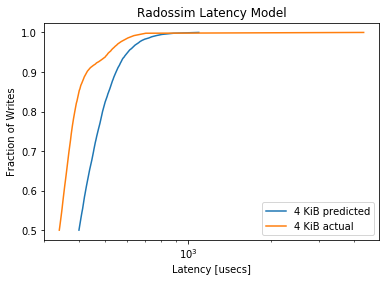

MainProcess pypet INFO     
 Finished single run #1118 of 1680 

MainProcess pypet INFO     
 Starting single run #1119 of 1680 



minimum predicted latency: 204.730310
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3504, pvalue=0.0)


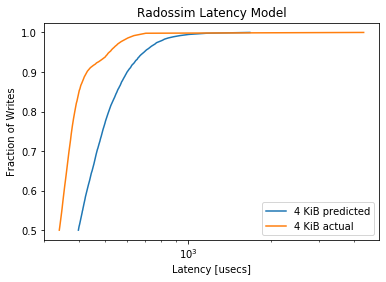

MainProcess pypet INFO     
 Finished single run #1119 of 1680 

MainProcess pypet INFO     
 Starting single run #1120 of 1680 



minimum predicted latency: 197.664364
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4636, pvalue=0.0)


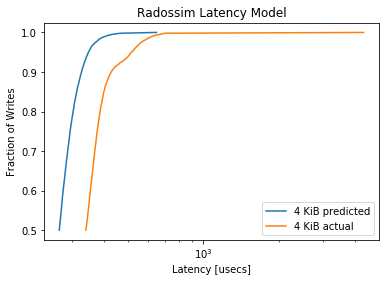

MainProcess pypet INFO     
 Finished single run #1120 of 1680 

MainProcess pypet INFO     
 Starting single run #1121 of 1680 



minimum predicted latency: 192.673604
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4091, pvalue=0.0)


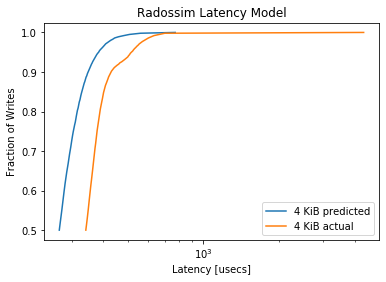

MainProcess pypet INFO     
 Finished single run #1121 of 1680 

MainProcess pypet INFO     
 Starting single run #1122 of 1680 



minimum predicted latency: 200.748045
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4159, pvalue=0.0)


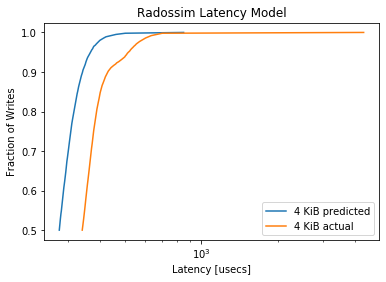

MainProcess pypet INFO     
 Finished single run #1122 of 1680 

MainProcess pypet INFO     
 Starting single run #1123 of 1680 



minimum predicted latency: 193.102786
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3616, pvalue=0.0)


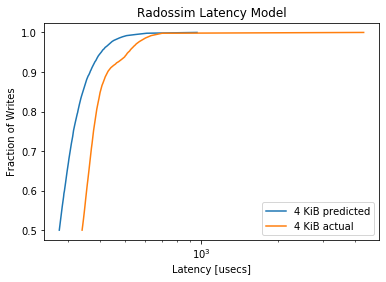

MainProcess pypet INFO     
 Finished single run #1123 of 1680 

MainProcess pypet INFO     
 Starting single run #1124 of 1680 



minimum predicted latency: 202.067590
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3511, pvalue=0.0)


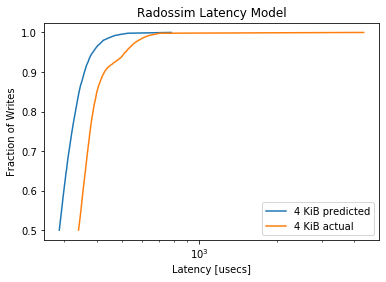

MainProcess pypet INFO     
 Finished single run #1124 of 1680 

MainProcess pypet INFO     
 Starting single run #1125 of 1680 



minimum predicted latency: 190.624757
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2995, pvalue=1e-323)


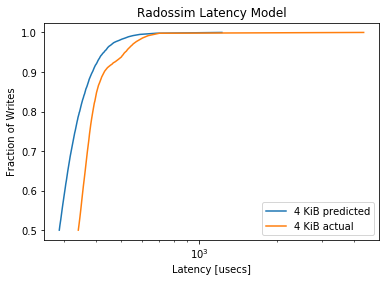

MainProcess pypet INFO     
 Finished single run #1125 of 1680 

MainProcess pypet INFO     
 Starting single run #1126 of 1680 



minimum predicted latency: 195.583841
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2774, pvalue=1e-323)


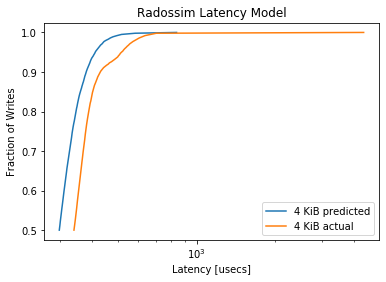

MainProcess pypet INFO     
 Finished single run #1126 of 1680 

MainProcess pypet INFO     
 Starting single run #1127 of 1680 



minimum predicted latency: 193.355893
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2384, pvalue=1.2344499471403768e-249)


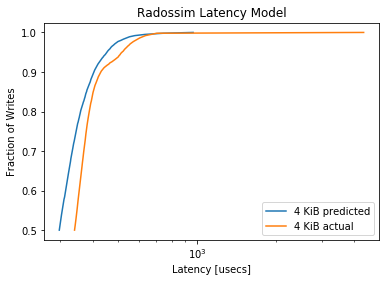

MainProcess pypet INFO     
 Finished single run #1127 of 1680 

MainProcess pypet INFO     
 Starting single run #1128 of 1680 



minimum predicted latency: 206.268827
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1897, pvalue=1.1810680652684967e-157)


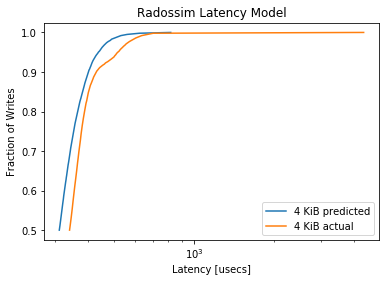

MainProcess pypet INFO     
 Finished single run #1128 of 1680 

MainProcess pypet INFO     
 Starting single run #1129 of 1680 



minimum predicted latency: 198.106113
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1623, pvalue=2.5145169611113846e-115)


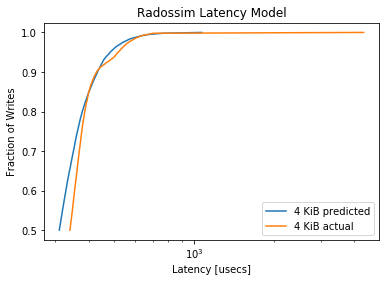

MainProcess pypet INFO     
 Finished single run #1129 of 1680 

MainProcess pypet INFO     
 Starting single run #1130 of 1680 



minimum predicted latency: 214.513889
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0922, pvalue=2.146443285936436e-37)


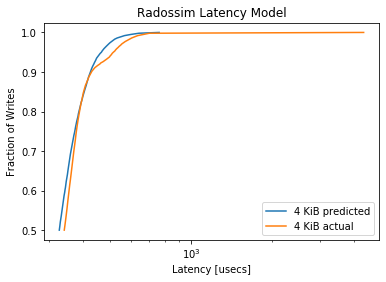

MainProcess pypet INFO     
 Finished single run #1130 of 1680 

MainProcess pypet INFO     
 Starting single run #1131 of 1680 



minimum predicted latency: 203.951020
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0829, pvalue=2.6408848561586672e-30)


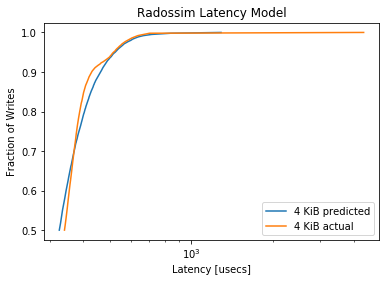

MainProcess pypet INFO     
 Finished single run #1131 of 1680 

MainProcess pypet INFO     
 Starting single run #1132 of 1680 



minimum predicted latency: 215.671559
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1181, pvalue=3.8795207636072686e-61)


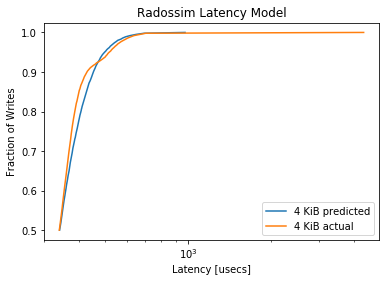

MainProcess pypet INFO     
 Finished single run #1132 of 1680 

MainProcess pypet INFO     
 Starting single run #1133 of 1680 



minimum predicted latency: 204.109361
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1201, pvalue=3.23620921283468e-63)


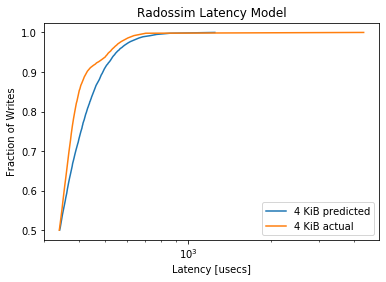

MainProcess pypet INFO     
 Finished single run #1133 of 1680 

MainProcess pypet INFO     
 Starting single run #1134 of 1680 



minimum predicted latency: 209.523573
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1771, pvalue=2.360025110393893e-137)


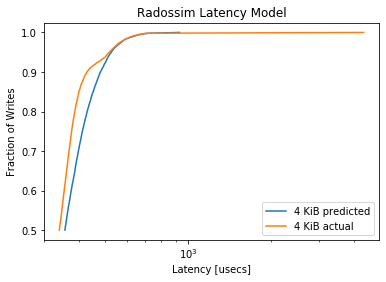

MainProcess pypet INFO     
 Finished single run #1134 of 1680 

MainProcess pypet INFO     
 Starting single run #1135 of 1680 



minimum predicted latency: 199.425351
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1959, pvalue=3.617567386094065e-168)


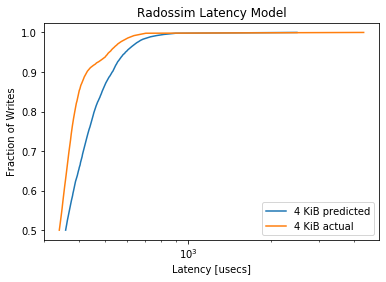

MainProcess pypet INFO     
 Finished single run #1135 of 1680 

MainProcess pypet INFO     
 Starting single run #1136 of 1680 



minimum predicted latency: 211.803887
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2574, pvalue=2.0438951131242388e-291)


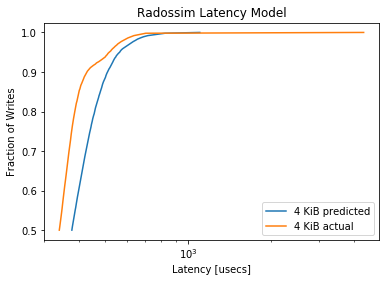

MainProcess pypet INFO     
 Finished single run #1136 of 1680 

MainProcess pypet INFO     
 Starting single run #1137 of 1680 



minimum predicted latency: 200.342159
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.252, pvalue=3.350634127771703e-279)


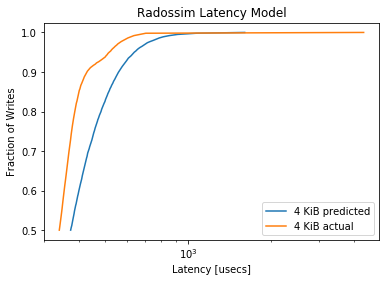

MainProcess pypet INFO     
 Finished single run #1137 of 1680 

MainProcess pypet INFO     
 Starting single run #1138 of 1680 



minimum predicted latency: 223.006486
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3592, pvalue=0.0)


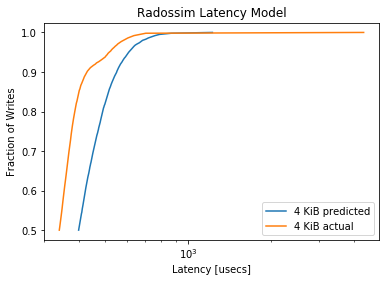

MainProcess pypet INFO     
 Finished single run #1138 of 1680 

MainProcess pypet INFO     
 Starting single run #1139 of 1680 



minimum predicted latency: 208.316928
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.346, pvalue=0.0)


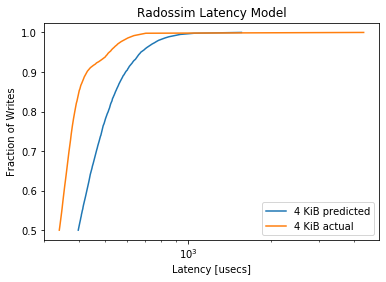

MainProcess pypet INFO     
 Finished single run #1139 of 1680 

MainProcess pypet INFO     
 Starting single run #1140 of 1680 



minimum predicted latency: 198.288121
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.462, pvalue=0.0)


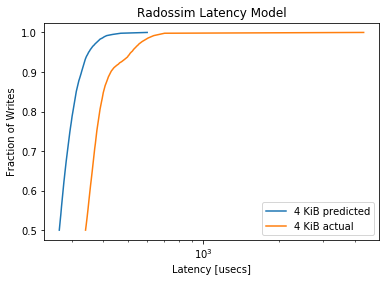

MainProcess pypet INFO     
 Finished single run #1140 of 1680 

MainProcess pypet INFO     
 Starting single run #1141 of 1680 



minimum predicted latency: 186.498565
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4117, pvalue=0.0)


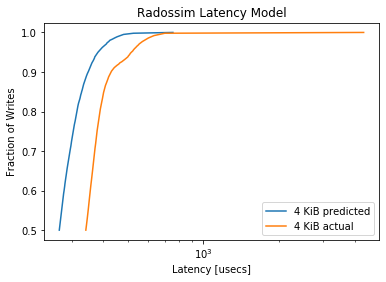

MainProcess pypet INFO     
 Finished single run #1141 of 1680 

MainProcess pypet INFO     
 Starting single run #1142 of 1680 



minimum predicted latency: 200.832014
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4117, pvalue=0.0)


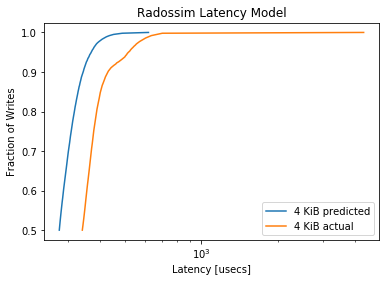

MainProcess pypet INFO     
 Finished single run #1142 of 1680 

MainProcess pypet INFO     
 Starting single run #1143 of 1680 



minimum predicted latency: 187.811454
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3611, pvalue=0.0)


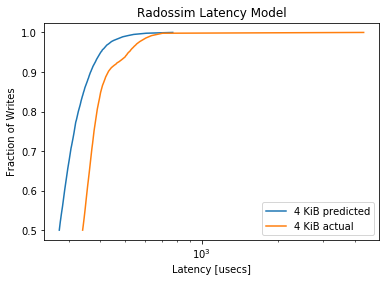

MainProcess pypet INFO     
 Finished single run #1143 of 1680 

MainProcess pypet INFO     
 Starting single run #1144 of 1680 



minimum predicted latency: 202.308619
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3439, pvalue=0.0)


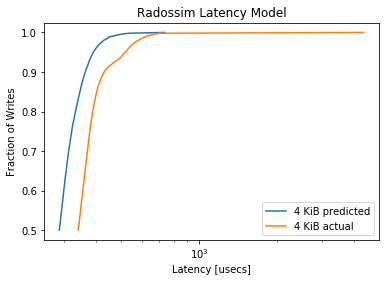

MainProcess pypet INFO     
 Finished single run #1144 of 1680 

MainProcess pypet INFO     
 Starting single run #1145 of 1680 



minimum predicted latency: 190.392758
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2999, pvalue=1e-323)


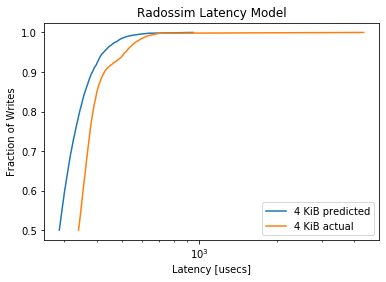

MainProcess pypet INFO     
 Finished single run #1145 of 1680 

MainProcess pypet INFO     
 Starting single run #1146 of 1680 



minimum predicted latency: 204.351264
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2745, pvalue=1e-323)


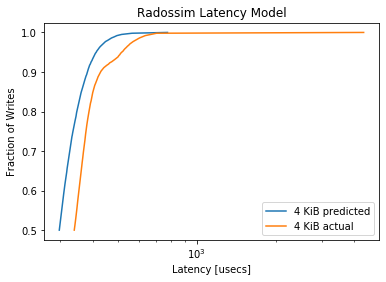

MainProcess pypet INFO     
 Finished single run #1146 of 1680 

MainProcess pypet INFO     
 Starting single run #1147 of 1680 



minimum predicted latency: 199.511048
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2271, pvalue=2.2990290709978433e-226)


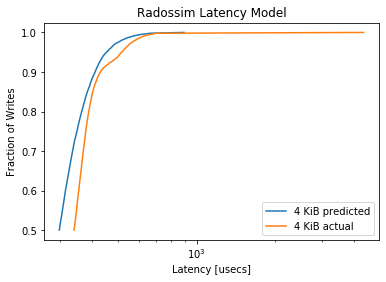

MainProcess pypet INFO     
 Finished single run #1147 of 1680 

MainProcess pypet INFO     
 Starting single run #1148 of 1680 



minimum predicted latency: 206.728805
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1974, pvalue=9.175170802947736e-171)


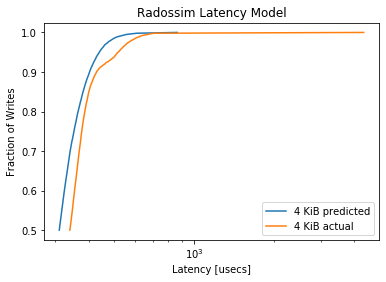

MainProcess pypet INFO     
 Finished single run #1148 of 1680 

MainProcess pypet INFO     
 Starting single run #1149 of 1680 



minimum predicted latency: 198.044579
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1592, pvalue=5.841221613639029e-111)


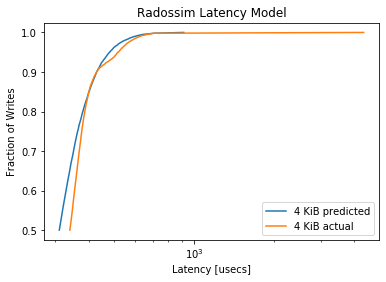

MainProcess pypet INFO     
 Finished single run #1149 of 1680 

MainProcess pypet INFO     
 Starting single run #1150 of 1680 



minimum predicted latency: 204.278966
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0962, pvalue=1.1202225589368676e-40)


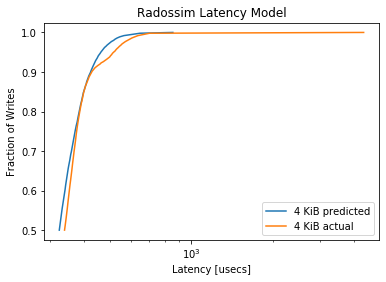

MainProcess pypet INFO     
 Finished single run #1150 of 1680 

MainProcess pypet INFO     
 Starting single run #1151 of 1680 



minimum predicted latency: 200.967476
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0813, pvalue=3.6748931281275044e-29)


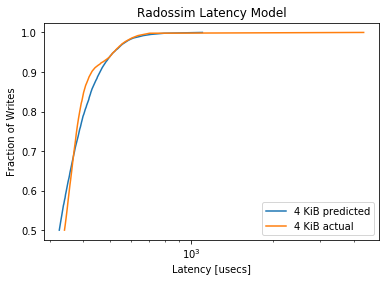

MainProcess pypet INFO     
 Finished single run #1151 of 1680 

MainProcess pypet INFO     
 Starting single run #1152 of 1680 



minimum predicted latency: 209.950408
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1148, pvalue=8.743410263654057e-58)


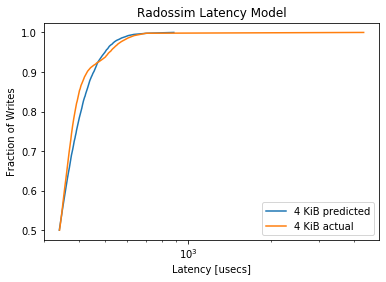

MainProcess pypet INFO     
 Finished single run #1152 of 1680 

MainProcess pypet INFO     
 Starting single run #1153 of 1680 



minimum predicted latency: 199.292195
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.126, pvalue=1.4869848372428608e-69)


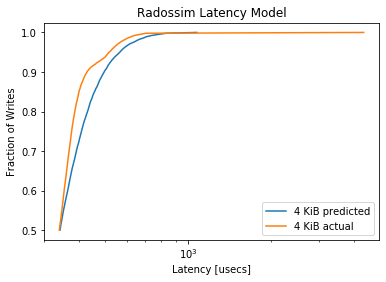

MainProcess pypet INFO     
 Finished single run #1153 of 1680 

MainProcess pypet INFO     
 Starting single run #1154 of 1680 



minimum predicted latency: 220.662487
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1854, pvalue=1.447770563564835e-150)


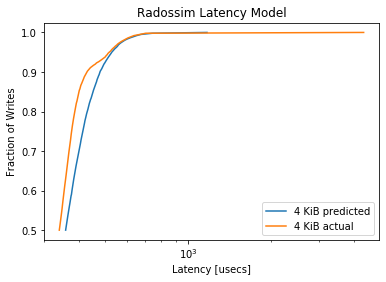

MainProcess pypet INFO     
 Finished single run #1154 of 1680 

MainProcess pypet INFO     
 Starting single run #1155 of 1680 



minimum predicted latency: 205.962748
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1887, pvalue=5.440032109633747e-156)


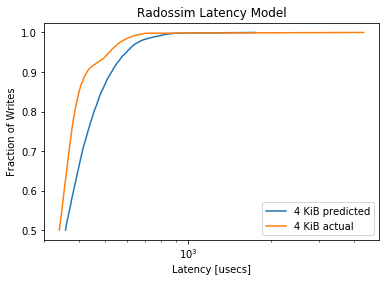

MainProcess pypet INFO     
 Finished single run #1155 of 1680 

MainProcess pypet INFO     
 Starting single run #1156 of 1680 



minimum predicted latency: 222.596060
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2559, pvalue=5.377682964705324e-288)


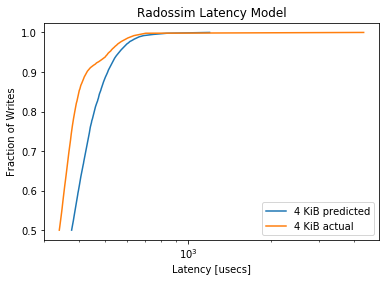

MainProcess pypet INFO     
 Finished single run #1156 of 1680 

MainProcess pypet INFO     
 Starting single run #1157 of 1680 



minimum predicted latency: 206.318647
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2574, pvalue=2.0438951131242388e-291)


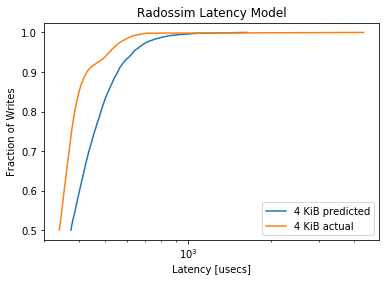

MainProcess pypet INFO     
 Finished single run #1157 of 1680 

MainProcess pypet INFO     
 Starting single run #1158 of 1680 



minimum predicted latency: 230.434222
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3608, pvalue=0.0)


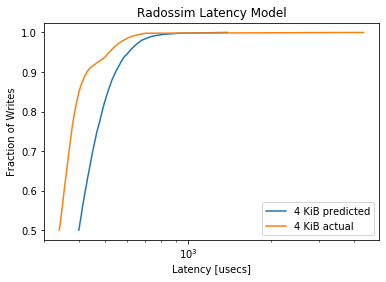

MainProcess pypet INFO     
 Finished single run #1158 of 1680 

MainProcess pypet INFO     
 Starting single run #1159 of 1680 



minimum predicted latency: 204.466842
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3369, pvalue=0.0)


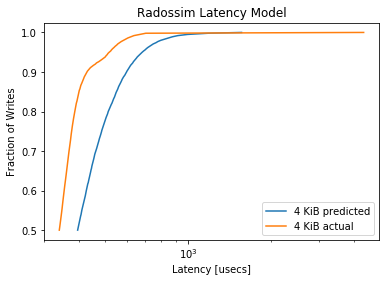

MainProcess pypet INFO     
 Finished single run #1159 of 1680 

MainProcess pypet INFO     
 Starting single run #1160 of 1680 



minimum predicted latency: 198.007112
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4598, pvalue=0.0)


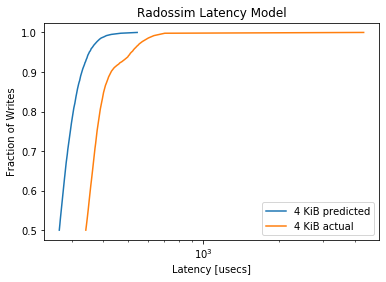

MainProcess pypet INFO     
 Finished single run #1160 of 1680 

MainProcess pypet INFO     
 Starting single run #1161 of 1680 



minimum predicted latency: 189.554439
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4106, pvalue=0.0)


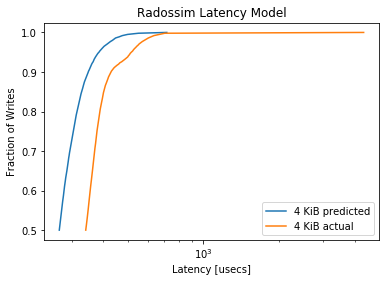

MainProcess pypet INFO     
 Finished single run #1161 of 1680 

MainProcess pypet INFO     
 Starting single run #1162 of 1680 



minimum predicted latency: 200.192457
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.414, pvalue=0.0)


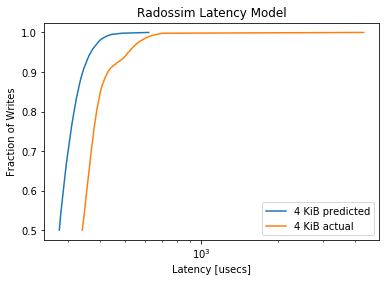

MainProcess pypet INFO     
 Finished single run #1162 of 1680 

MainProcess pypet INFO     
 Starting single run #1163 of 1680 



minimum predicted latency: 187.480108
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3592, pvalue=0.0)


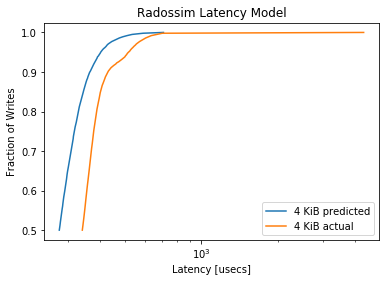

MainProcess pypet INFO     
 Finished single run #1163 of 1680 

MainProcess pypet INFO     
 Starting single run #1164 of 1680 



minimum predicted latency: 207.424613
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3479, pvalue=0.0)


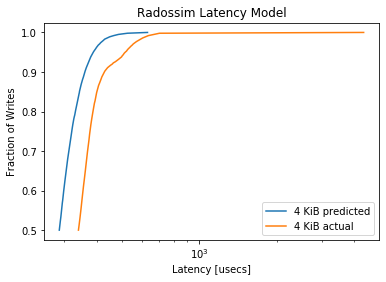

MainProcess pypet INFO     
 Finished single run #1164 of 1680 

MainProcess pypet INFO     
 Starting single run #1165 of 1680 



minimum predicted latency: 192.278268
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.295, pvalue=1e-323)


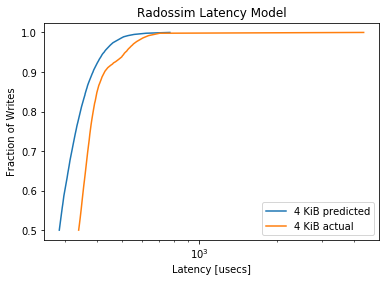

MainProcess pypet INFO     
 Finished single run #1165 of 1680 

MainProcess pypet INFO     
 Starting single run #1166 of 1680 



minimum predicted latency: 203.757000
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2711, pvalue=1e-323)


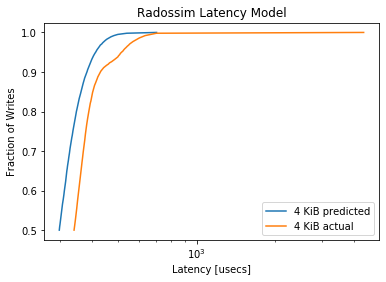

MainProcess pypet INFO     
 Finished single run #1166 of 1680 

MainProcess pypet INFO     
 Starting single run #1167 of 1680 



minimum predicted latency: 196.380937
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2292, pvalue=1.3355915745101223e-230)


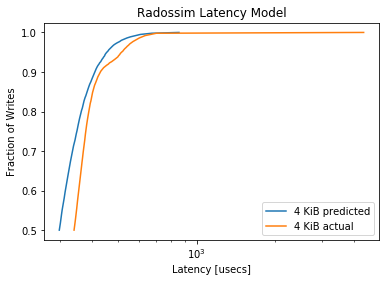

MainProcess pypet INFO     
 Finished single run #1167 of 1680 

MainProcess pypet INFO     
 Starting single run #1168 of 1680 



minimum predicted latency: 205.834711
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1908, pvalue=1.7069054236896008e-159)


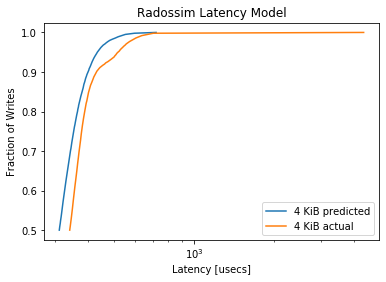

MainProcess pypet INFO     
 Finished single run #1168 of 1680 

MainProcess pypet INFO     
 Starting single run #1169 of 1680 



minimum predicted latency: 197.570258
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1579, pvalue=3.7319532719072634e-109)


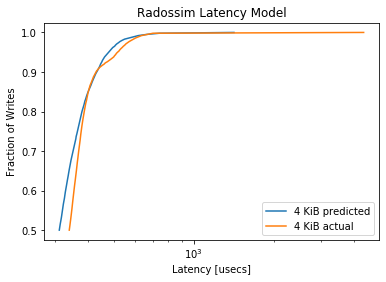

MainProcess pypet INFO     
 Finished single run #1169 of 1680 

MainProcess pypet INFO     
 Starting single run #1170 of 1680 



minimum predicted latency: 211.782314
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.101, pvalue=8.41871592012683e-45)


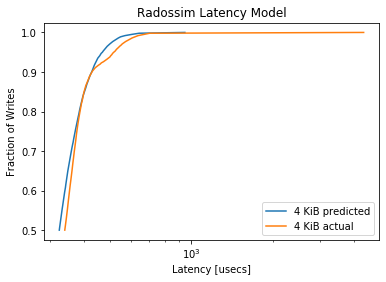

MainProcess pypet INFO     
 Finished single run #1170 of 1680 

MainProcess pypet INFO     
 Starting single run #1171 of 1680 



minimum predicted latency: 201.556036
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0822, pvalue=8.409750964239297e-30)


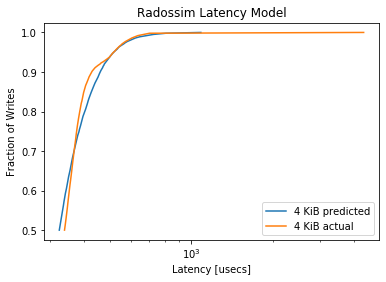

MainProcess pypet INFO     
 Finished single run #1171 of 1680 

MainProcess pypet INFO     
 Starting single run #1172 of 1680 



minimum predicted latency: 212.258099
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1208, pvalue=5.944975627169973e-64)


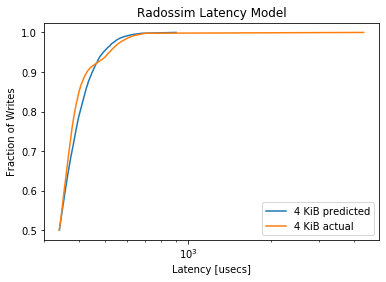

MainProcess pypet INFO     
 Finished single run #1172 of 1680 

MainProcess pypet INFO     
 Starting single run #1173 of 1680 



minimum predicted latency: 203.823215
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1192, pvalue=2.8172893466208245e-62)


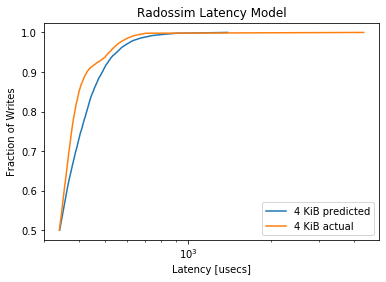

MainProcess pypet INFO     
 Finished single run #1173 of 1680 

MainProcess pypet INFO     
 Starting single run #1174 of 1680 



minimum predicted latency: 212.301191
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1822, pvalue=2.127433046037415e-145)


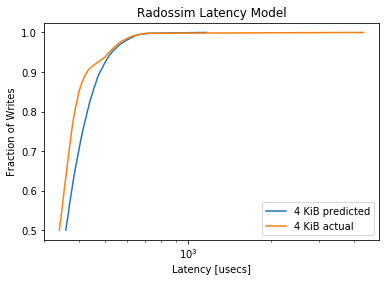

MainProcess pypet INFO     
 Finished single run #1174 of 1680 

MainProcess pypet INFO     
 Starting single run #1175 of 1680 



minimum predicted latency: 209.135825
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1841, pvalue=1.8662030577234562e-148)


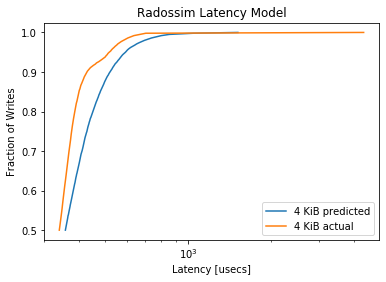

MainProcess pypet INFO     
 Finished single run #1175 of 1680 

MainProcess pypet INFO     PROGRESS: Finished 1176/1680 runs [==============      ] 70.0%, remaining: 0:03:07
MainProcess pypet INFO     
 Starting single run #1176 of 1680 



minimum predicted latency: 223.948380
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2607, pvalue=5.157798178948524e-299)


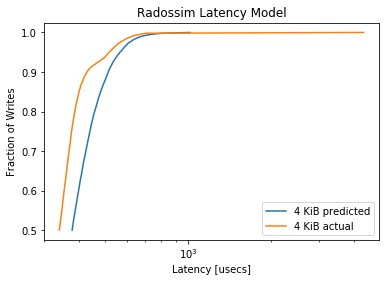

MainProcess pypet INFO     
 Finished single run #1176 of 1680 

MainProcess pypet INFO     
 Starting single run #1177 of 1680 



minimum predicted latency: 201.877174
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2624, pvalue=5.737903040246965e-303)


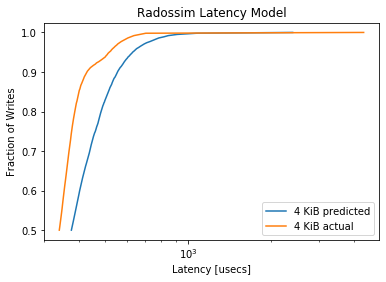

MainProcess pypet INFO     
 Finished single run #1177 of 1680 

MainProcess pypet INFO     
 Starting single run #1178 of 1680 



minimum predicted latency: 226.275355
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3595, pvalue=0.0)


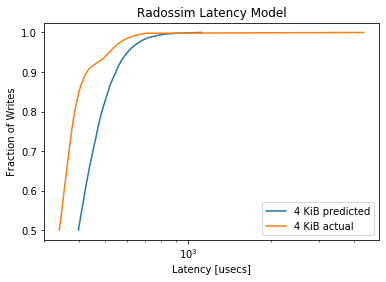

MainProcess pypet INFO     
 Finished single run #1178 of 1680 

MainProcess pypet INFO     
 Starting single run #1179 of 1680 



minimum predicted latency: 203.241268
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3471, pvalue=0.0)


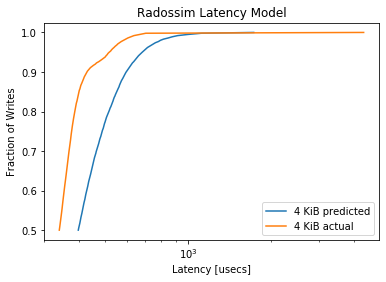

MainProcess pypet INFO     
 Finished single run #1179 of 1680 

MainProcess pypet INFO     
 Starting single run #1180 of 1680 



minimum predicted latency: 193.578456
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4647, pvalue=0.0)


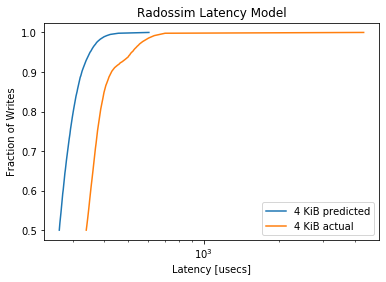

MainProcess pypet INFO     
 Finished single run #1180 of 1680 

MainProcess pypet INFO     
 Starting single run #1181 of 1680 



minimum predicted latency: 190.391591
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4087, pvalue=0.0)


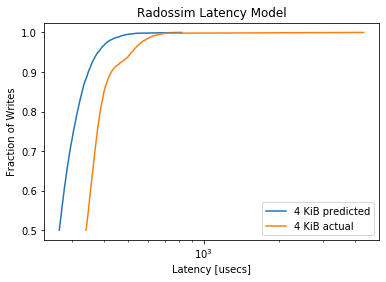

MainProcess pypet INFO     
 Finished single run #1181 of 1680 

MainProcess pypet INFO     
 Starting single run #1182 of 1680 



minimum predicted latency: 197.719805
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4144, pvalue=0.0)


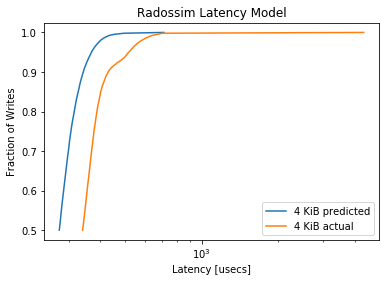

MainProcess pypet INFO     
 Finished single run #1182 of 1680 

MainProcess pypet INFO     
 Starting single run #1183 of 1680 



minimum predicted latency: 191.516073
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3605, pvalue=0.0)


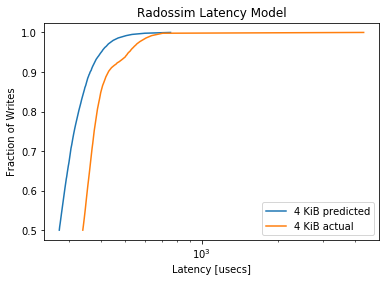

MainProcess pypet INFO     
 Finished single run #1183 of 1680 

MainProcess pypet INFO     
 Starting single run #1184 of 1680 



minimum predicted latency: 201.090896
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3605, pvalue=0.0)


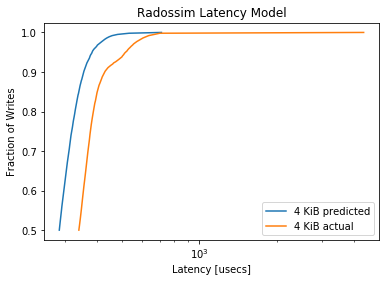

MainProcess pypet INFO     
 Finished single run #1184 of 1680 

MainProcess pypet INFO     
 Starting single run #1185 of 1680 



minimum predicted latency: 189.877562
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2955, pvalue=1e-323)


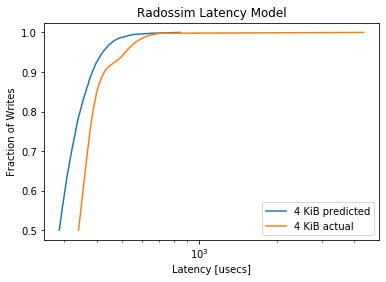

MainProcess pypet INFO     
 Finished single run #1185 of 1680 

MainProcess pypet INFO     
 Starting single run #1186 of 1680 



minimum predicted latency: 204.392424
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2826, pvalue=1e-323)


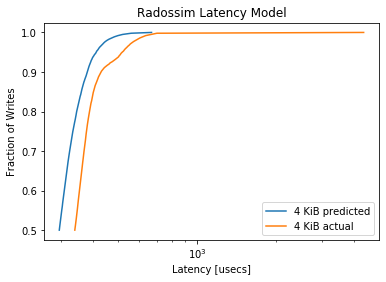

MainProcess pypet INFO     
 Finished single run #1186 of 1680 

MainProcess pypet INFO     
 Starting single run #1187 of 1680 



minimum predicted latency: 192.603758
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2393, pvalue=1.5404091351668781e-251)


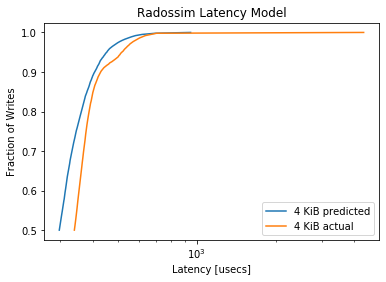

MainProcess pypet INFO     
 Finished single run #1187 of 1680 

MainProcess pypet INFO     
 Starting single run #1188 of 1680 



minimum predicted latency: 208.138627
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2011, pvalue=2.969386858865891e-177)


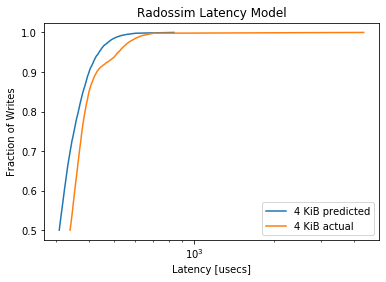

MainProcess pypet INFO     
 Finished single run #1188 of 1680 

MainProcess pypet INFO     
 Starting single run #1189 of 1680 



minimum predicted latency: 198.000545
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.163, pvalue=2.5276184472314907e-116)


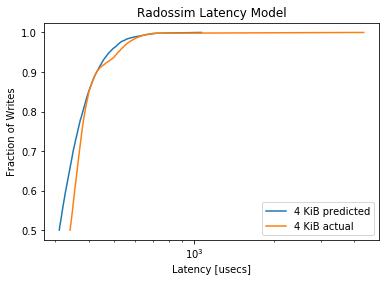

MainProcess pypet INFO     
 Finished single run #1189 of 1680 

MainProcess pypet INFO     
 Starting single run #1190 of 1680 



minimum predicted latency: 204.603806
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0986, pvalue=1.0292829299760363e-42)


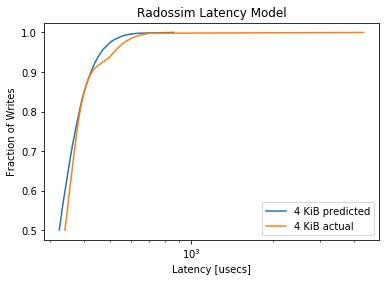

MainProcess pypet INFO     
 Finished single run #1190 of 1680 

MainProcess pypet INFO     
 Starting single run #1191 of 1680 



minimum predicted latency: 197.081990
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0808, pvalue=8.279354923713331e-29)


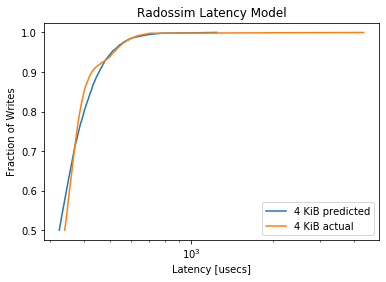

MainProcess pypet INFO     
 Finished single run #1191 of 1680 

MainProcess pypet INFO     
 Starting single run #1192 of 1680 



minimum predicted latency: 212.177791
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1081, pvalue=2.8465401865673404e-51)


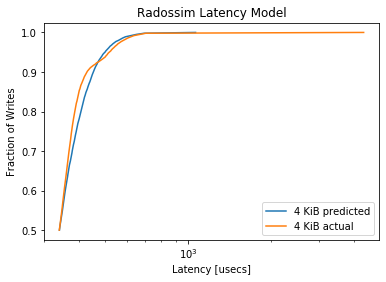

MainProcess pypet INFO     
 Finished single run #1192 of 1680 

MainProcess pypet INFO     
 Starting single run #1193 of 1680 



minimum predicted latency: 194.102665
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1074, pvalue=1.2941082951613566e-50)


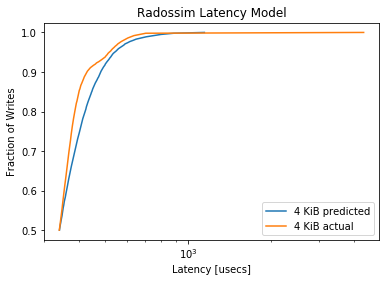

MainProcess pypet INFO     
 Finished single run #1193 of 1680 

MainProcess pypet INFO     
 Starting single run #1194 of 1680 



minimum predicted latency: 218.028887
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1694, pvalue=1.1957485480810113e-125)


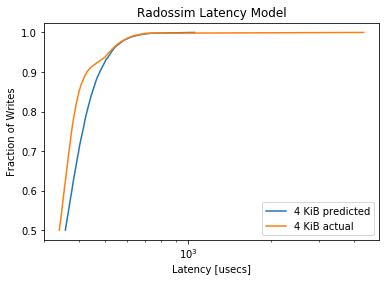

MainProcess pypet INFO     
 Finished single run #1194 of 1680 

MainProcess pypet INFO     
 Starting single run #1195 of 1680 



minimum predicted latency: 194.651630
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1759, pvalue=1.7059325551163434e-135)


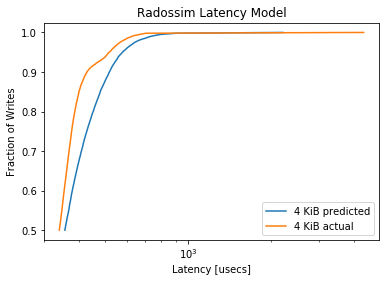

MainProcess pypet INFO     
 Finished single run #1195 of 1680 

MainProcess pypet INFO     
 Starting single run #1196 of 1680 



minimum predicted latency: 219.781421
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2464, pvalue=8.06396603809519e-267)


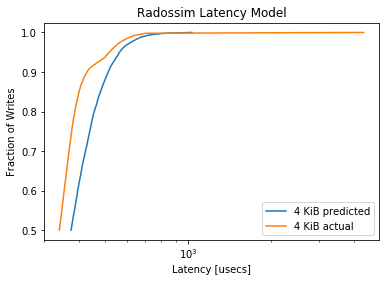

MainProcess pypet INFO     
 Finished single run #1196 of 1680 

MainProcess pypet INFO     
 Starting single run #1197 of 1680 



minimum predicted latency: 202.506509
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.253, pvalue=1.9212264034895982e-281)


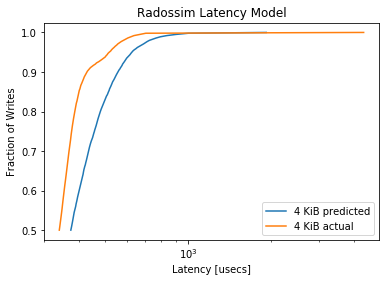

MainProcess pypet INFO     
 Finished single run #1197 of 1680 

MainProcess pypet INFO     
 Starting single run #1198 of 1680 



minimum predicted latency: 216.593407
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3406, pvalue=0.0)


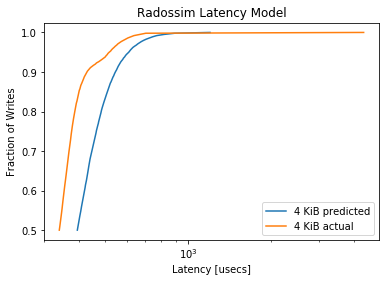

MainProcess pypet INFO     
 Finished single run #1198 of 1680 

MainProcess pypet INFO     
 Starting single run #1199 of 1680 



minimum predicted latency: 209.504182
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3493, pvalue=0.0)


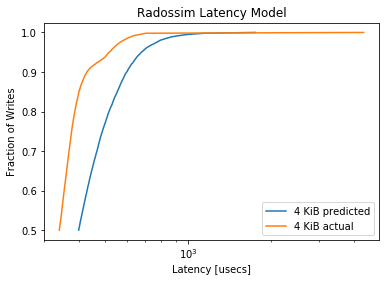

MainProcess pypet INFO     
 Finished single run #1199 of 1680 

MainProcess pypet INFO     
 Starting single run #1200 of 1680 



minimum predicted latency: 196.304674
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4656, pvalue=0.0)


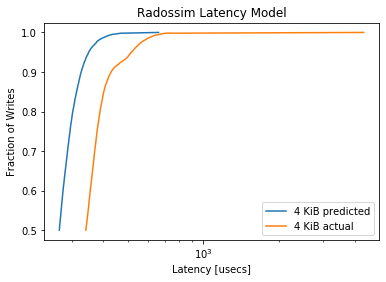

MainProcess pypet INFO     
 Finished single run #1200 of 1680 

MainProcess pypet INFO     
 Starting single run #1201 of 1680 



minimum predicted latency: 192.384783
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4156, pvalue=0.0)


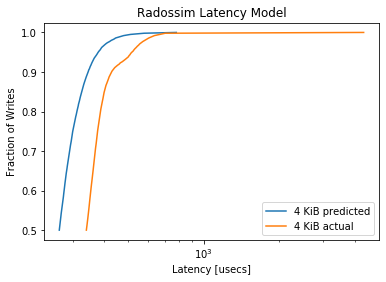

MainProcess pypet INFO     
 Finished single run #1201 of 1680 

MainProcess pypet INFO     
 Starting single run #1202 of 1680 



minimum predicted latency: 198.876505
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4184, pvalue=0.0)


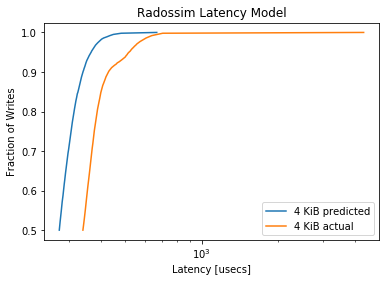

MainProcess pypet INFO     
 Finished single run #1202 of 1680 

MainProcess pypet INFO     
 Starting single run #1203 of 1680 



minimum predicted latency: 190.148816
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3611, pvalue=0.0)


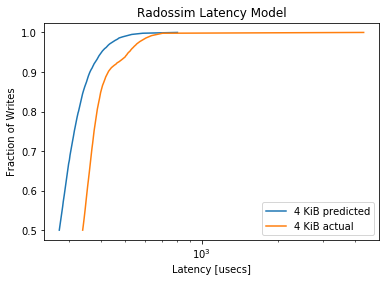

MainProcess pypet INFO     
 Finished single run #1203 of 1680 

MainProcess pypet INFO     
 Starting single run #1204 of 1680 



minimum predicted latency: 199.780916
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3465, pvalue=0.0)


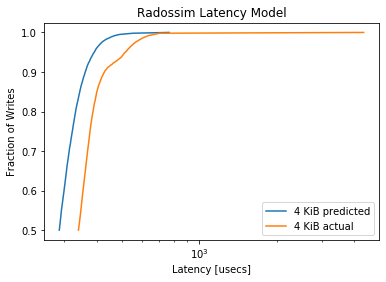

MainProcess pypet INFO     
 Finished single run #1204 of 1680 

MainProcess pypet INFO     
 Starting single run #1205 of 1680 



minimum predicted latency: 194.941716
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3053, pvalue=1e-323)


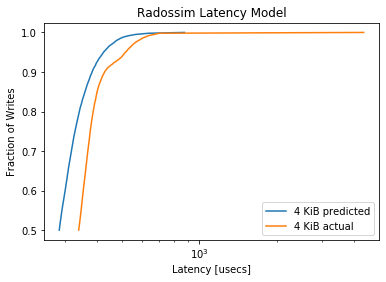

MainProcess pypet INFO     
 Finished single run #1205 of 1680 

MainProcess pypet INFO     
 Starting single run #1206 of 1680 



minimum predicted latency: 203.477544
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2836, pvalue=1e-323)


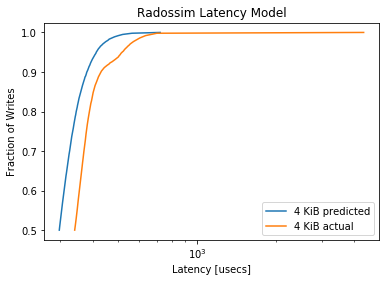

MainProcess pypet INFO     
 Finished single run #1206 of 1680 

MainProcess pypet INFO     
 Starting single run #1207 of 1680 



minimum predicted latency: 192.766729
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2436, pvalue=9.737856043654762e-261)


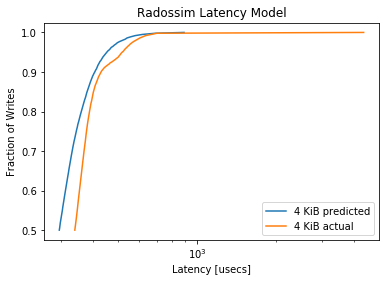

MainProcess pypet INFO     
 Finished single run #1207 of 1680 

MainProcess pypet INFO     
 Starting single run #1208 of 1680 



minimum predicted latency: 205.471191
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2039, pvalue=3.01298546536844e-182)


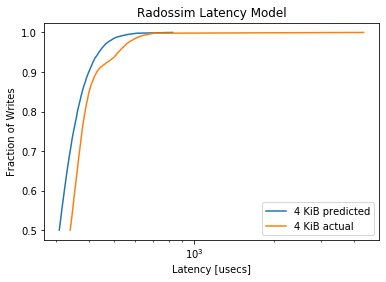

MainProcess pypet INFO     
 Finished single run #1208 of 1680 

MainProcess pypet INFO     
 Starting single run #1209 of 1680 



minimum predicted latency: 198.474373
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.164, pvalue=9.32781497930044e-118)


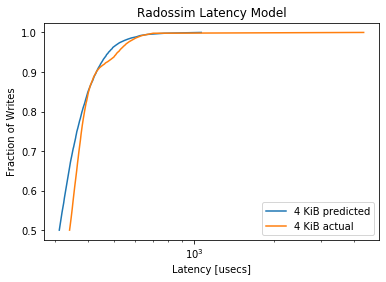

MainProcess pypet INFO     
 Finished single run #1209 of 1680 

MainProcess pypet INFO     
 Starting single run #1210 of 1680 



minimum predicted latency: 206.664676
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1107, pvalue=9.416698755755899e-54)


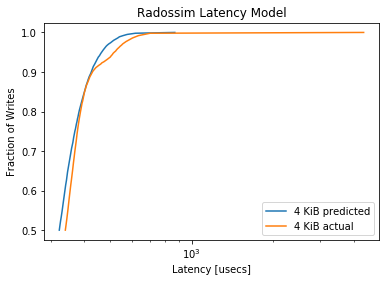

MainProcess pypet INFO     
 Finished single run #1210 of 1680 

MainProcess pypet INFO     
 Starting single run #1211 of 1680 



minimum predicted latency: 198.062872
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0783, pvalue=4.456300679483551e-27)


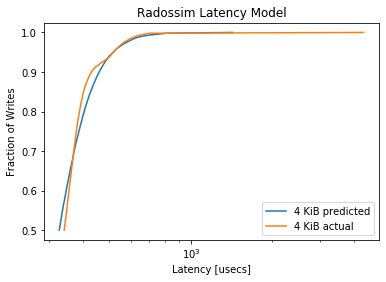

MainProcess pypet INFO     
 Finished single run #1211 of 1680 

MainProcess pypet INFO     
 Starting single run #1212 of 1680 



minimum predicted latency: 209.188020
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1114, pvalue=1.9766917210646647e-54)


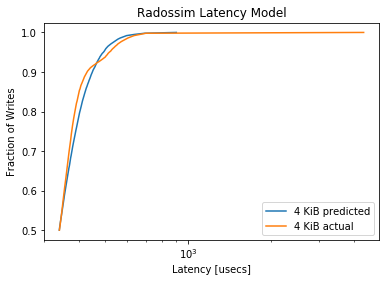

MainProcess pypet INFO     
 Finished single run #1212 of 1680 

MainProcess pypet INFO     
 Starting single run #1213 of 1680 



minimum predicted latency: 201.075105
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1228, pvalue=4.444436211507284e-66)


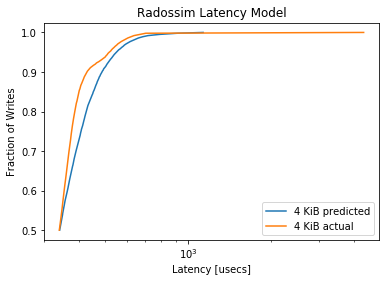

MainProcess pypet INFO     
 Finished single run #1213 of 1680 

MainProcess pypet INFO     
 Starting single run #1214 of 1680 



minimum predicted latency: 218.652371
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1794, pvalue=5.938146602440304e-141)


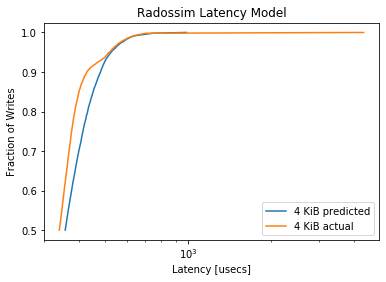

MainProcess pypet INFO     
 Finished single run #1214 of 1680 

MainProcess pypet INFO     
 Starting single run #1215 of 1680 



minimum predicted latency: 207.294668
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1892, pvalue=8.036448748329221e-157)


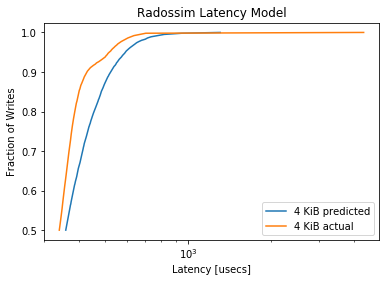

MainProcess pypet INFO     
 Finished single run #1215 of 1680 

MainProcess pypet INFO     
 Starting single run #1216 of 1680 



minimum predicted latency: 211.397303
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2477, pvalue=1.1433160700483423e-269)


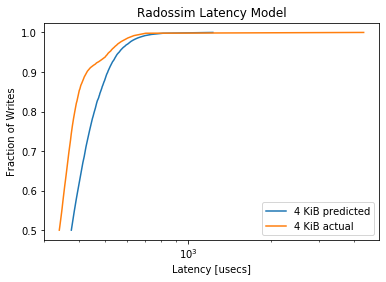

MainProcess pypet INFO     
 Finished single run #1216 of 1680 

MainProcess pypet INFO     
 Starting single run #1217 of 1680 



minimum predicted latency: 206.170734
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2572, pvalue=5.857140714902907e-291)


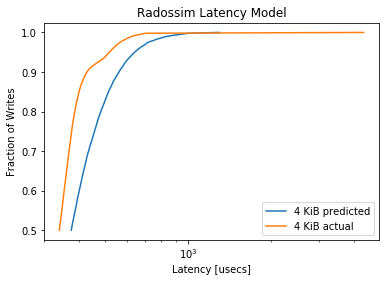

MainProcess pypet INFO     
 Finished single run #1217 of 1680 

MainProcess pypet INFO     
 Starting single run #1218 of 1680 



minimum predicted latency: 217.839091
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3542, pvalue=0.0)


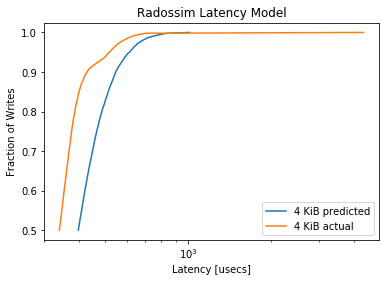

MainProcess pypet INFO     
 Finished single run #1218 of 1680 

MainProcess pypet INFO     
 Starting single run #1219 of 1680 



minimum predicted latency: 206.657564
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3392, pvalue=0.0)


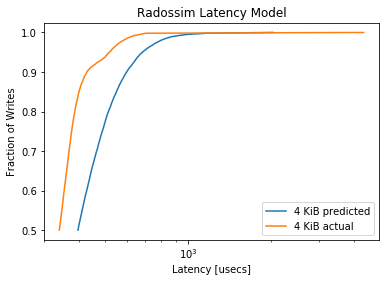

MainProcess pypet INFO     
 Finished single run #1219 of 1680 

MainProcess pypet INFO     
 Starting single run #1220 of 1680 



minimum predicted latency: 195.905358
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4611, pvalue=0.0)


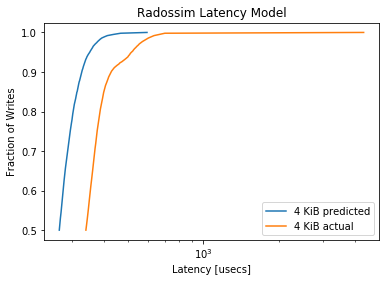

MainProcess pypet INFO     
 Finished single run #1220 of 1680 

MainProcess pypet INFO     
 Starting single run #1221 of 1680 



minimum predicted latency: 187.865255
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4164, pvalue=0.0)


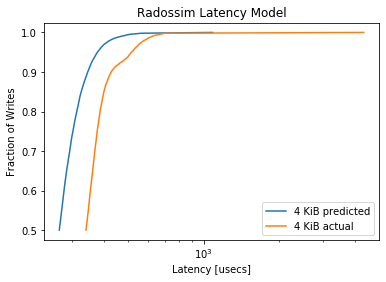

MainProcess pypet INFO     
 Finished single run #1221 of 1680 

MainProcess pypet INFO     
 Starting single run #1222 of 1680 



minimum predicted latency: 198.167335
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4191, pvalue=0.0)


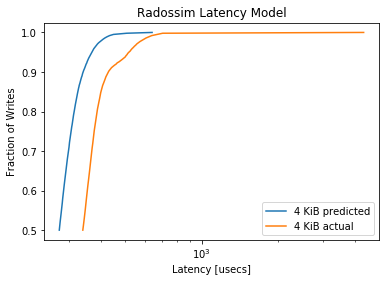

MainProcess pypet INFO     
 Finished single run #1222 of 1680 

MainProcess pypet INFO     
 Starting single run #1223 of 1680 



minimum predicted latency: 187.143264
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3618, pvalue=0.0)


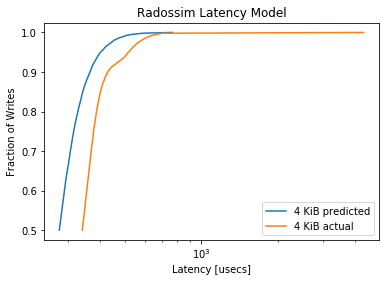

MainProcess pypet INFO     
 Finished single run #1223 of 1680 

MainProcess pypet INFO     
 Starting single run #1224 of 1680 



minimum predicted latency: 201.114517
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3542, pvalue=0.0)


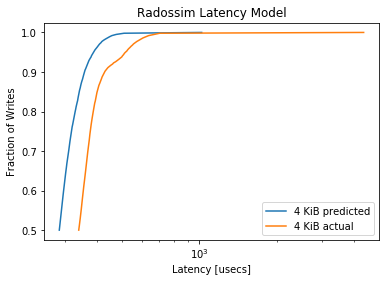

MainProcess pypet INFO     
 Finished single run #1224 of 1680 

MainProcess pypet INFO     
 Starting single run #1225 of 1680 



minimum predicted latency: 194.115422
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2971, pvalue=1e-323)


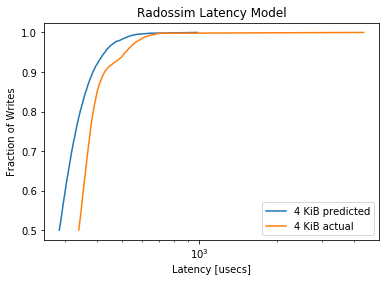

MainProcess pypet INFO     
 Finished single run #1225 of 1680 

MainProcess pypet INFO     
 Starting single run #1226 of 1680 



minimum predicted latency: 200.305589
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2805, pvalue=1e-323)


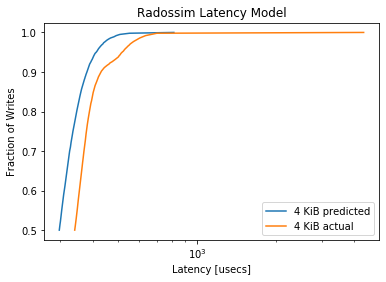

MainProcess pypet INFO     
 Finished single run #1226 of 1680 

MainProcess pypet INFO     
 Starting single run #1227 of 1680 



minimum predicted latency: 193.325776
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2299, pvalue=5.0668159430260974e-232)


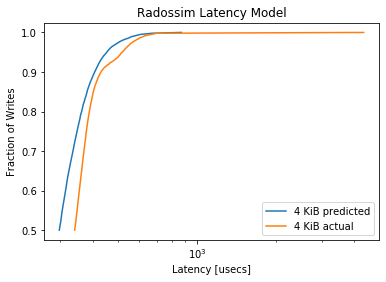

MainProcess pypet INFO     
 Finished single run #1227 of 1680 

MainProcess pypet INFO     
 Starting single run #1228 of 1680 



minimum predicted latency: 203.330499
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1936, pvalue=3.1563221292058246e-164)


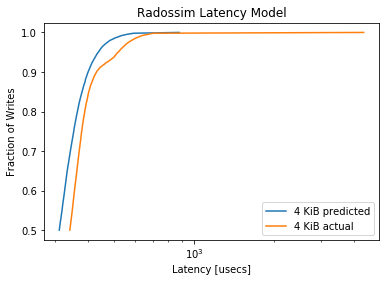

MainProcess pypet INFO     
 Finished single run #1228 of 1680 

MainProcess pypet INFO     
 Starting single run #1229 of 1680 



minimum predicted latency: 196.068516
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1772, pvalue=1.6497321299211134e-137)


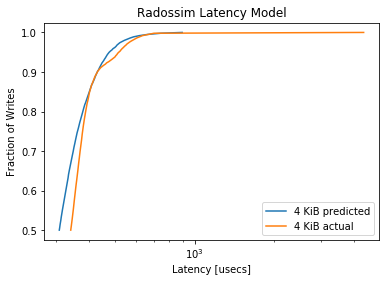

MainProcess pypet INFO     
 Finished single run #1229 of 1680 

MainProcess pypet INFO     
 Starting single run #1230 of 1680 



minimum predicted latency: 212.334864
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0974, pvalue=1.0895143622098955e-41)


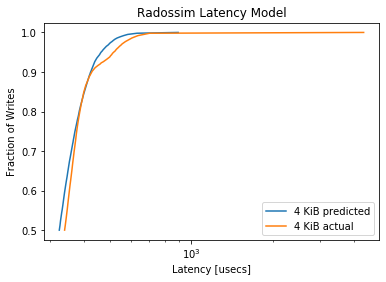

MainProcess pypet INFO     
 Finished single run #1230 of 1680 

MainProcess pypet INFO     
 Starting single run #1231 of 1680 



minimum predicted latency: 192.827272
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0852, pvalue=5.479610505139134e-32)


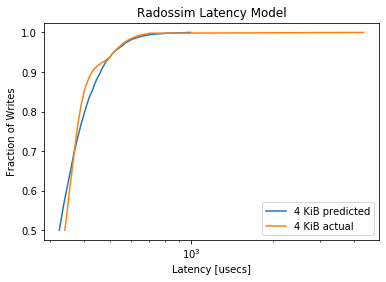

MainProcess pypet INFO     
 Finished single run #1231 of 1680 

MainProcess pypet INFO     
 Starting single run #1232 of 1680 



minimum predicted latency: 218.900386
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1068, pvalue=4.701609706686807e-50)


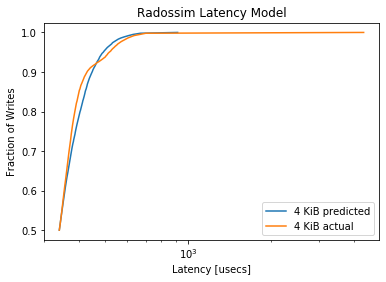

MainProcess pypet INFO     
 Finished single run #1232 of 1680 

MainProcess pypet INFO     
 Starting single run #1233 of 1680 



minimum predicted latency: 196.058983
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1161, pvalue=4.2883117996909605e-59)


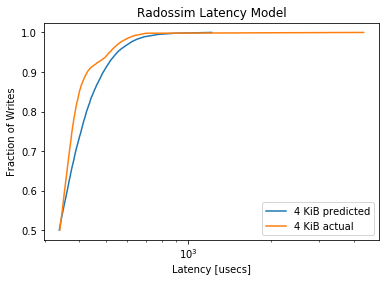

MainProcess pypet INFO     
 Finished single run #1233 of 1680 

MainProcess pypet INFO     
 Starting single run #1234 of 1680 



minimum predicted latency: 216.662866
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.176, pvalue=1.195458349210356e-135)


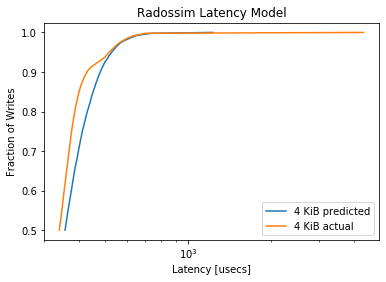

MainProcess pypet INFO     
 Finished single run #1234 of 1680 

MainProcess pypet INFO     
 Starting single run #1235 of 1680 



minimum predicted latency: 194.624209
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1775, pvalue=5.628152116504755e-138)


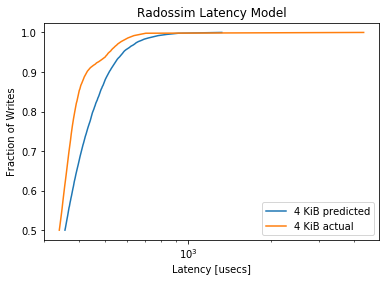

MainProcess pypet INFO     
 Finished single run #1235 of 1680 

MainProcess pypet INFO     
 Starting single run #1236 of 1680 



minimum predicted latency: 216.821616
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2502, pvalue=3.439903058634323e-275)


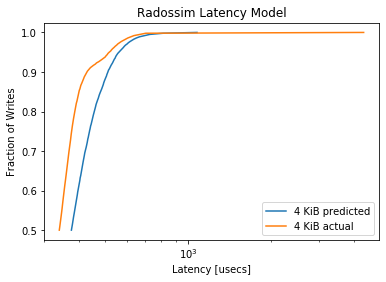

MainProcess pypet INFO     
 Finished single run #1236 of 1680 

MainProcess pypet INFO     
 Starting single run #1237 of 1680 



minimum predicted latency: 205.161733
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2556, pvalue=2.5829296613364263e-287)


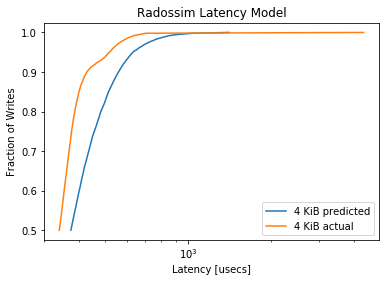

MainProcess pypet INFO     
 Finished single run #1237 of 1680 

MainProcess pypet INFO     
 Starting single run #1238 of 1680 



minimum predicted latency: 222.851829
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3599, pvalue=0.0)


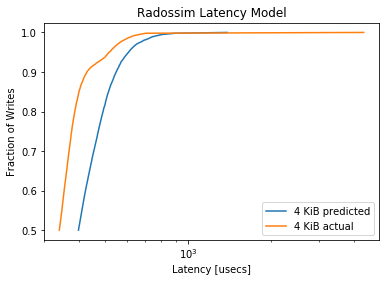

MainProcess pypet INFO     
 Finished single run #1238 of 1680 

MainProcess pypet INFO     
 Starting single run #1239 of 1680 



minimum predicted latency: 207.642777
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3279, pvalue=1e-323)


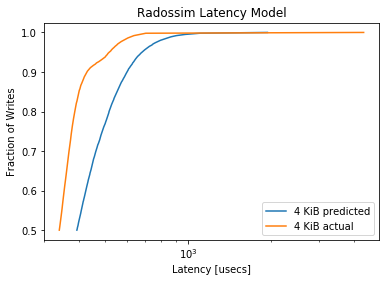

MainProcess pypet INFO     
 Finished single run #1239 of 1680 

MainProcess pypet INFO     
 Starting single run #1240 of 1680 



minimum predicted latency: 194.549451
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4642, pvalue=0.0)


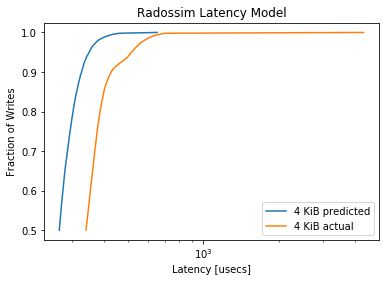

MainProcess pypet INFO     
 Finished single run #1240 of 1680 

MainProcess pypet INFO     
 Starting single run #1241 of 1680 



minimum predicted latency: 190.309310
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4172, pvalue=0.0)


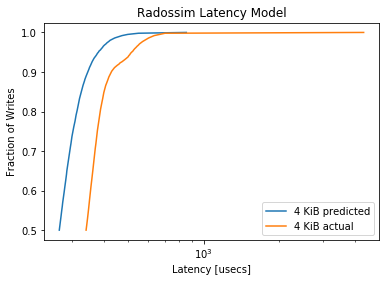

MainProcess pypet INFO     
 Finished single run #1241 of 1680 

MainProcess pypet INFO     
 Starting single run #1242 of 1680 



minimum predicted latency: 195.449655
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4109, pvalue=0.0)


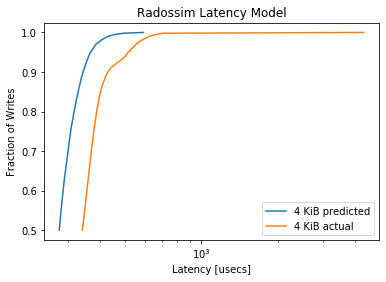

MainProcess pypet INFO     
 Finished single run #1242 of 1680 

MainProcess pypet INFO     
 Starting single run #1243 of 1680 



minimum predicted latency: 190.981876
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3612, pvalue=0.0)


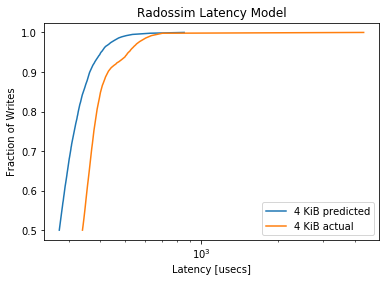

MainProcess pypet INFO     
 Finished single run #1243 of 1680 

MainProcess pypet INFO     
 Starting single run #1244 of 1680 



minimum predicted latency: 197.671577
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3539, pvalue=0.0)


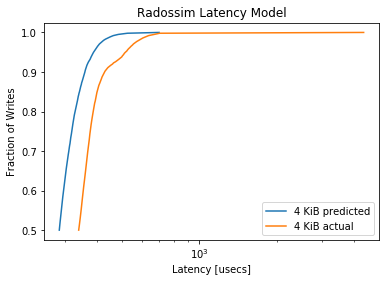

MainProcess pypet INFO     
 Finished single run #1244 of 1680 

MainProcess pypet INFO     
 Starting single run #1245 of 1680 



minimum predicted latency: 185.382039
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2964, pvalue=1e-323)


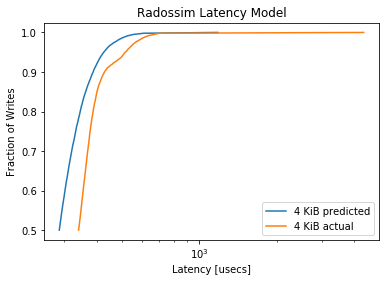

MainProcess pypet INFO     
 Finished single run #1245 of 1680 

MainProcess pypet INFO     
 Starting single run #1246 of 1680 



minimum predicted latency: 200.417219
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2818, pvalue=1e-323)


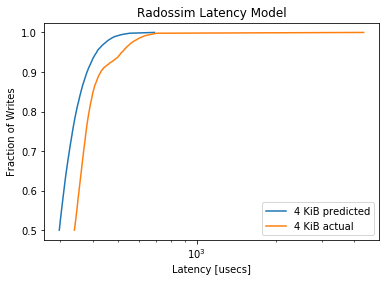

MainProcess pypet INFO     
 Finished single run #1246 of 1680 

MainProcess pypet INFO     
 Starting single run #1247 of 1680 



minimum predicted latency: 198.314700
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2339, pvalue=3.153851637903124e-240)


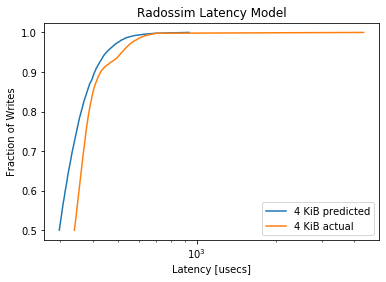

MainProcess pypet INFO     
 Finished single run #1247 of 1680 

MainProcess pypet INFO     
 Starting single run #1248 of 1680 



minimum predicted latency: 206.215074
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1962, pvalue=1.098708036276576e-168)


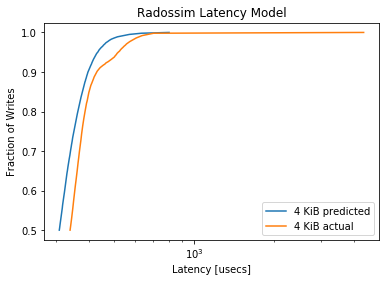

MainProcess pypet INFO     
 Finished single run #1248 of 1680 

MainProcess pypet INFO     
 Starting single run #1249 of 1680 



minimum predicted latency: 196.414527
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1581, pvalue=1.9731374299500712e-109)


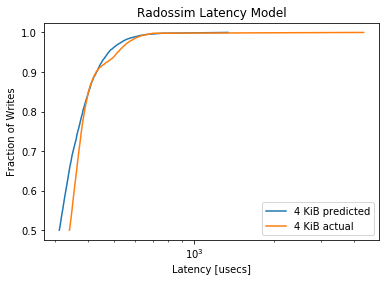

MainProcess pypet INFO     
 Finished single run #1249 of 1680 

MainProcess pypet INFO     
 Starting single run #1250 of 1680 



minimum predicted latency: 209.986880
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0964, pvalue=7.612065077083311e-41)


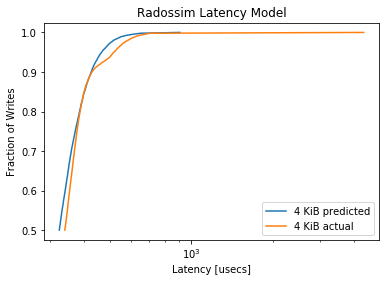

MainProcess pypet INFO     
 Finished single run #1250 of 1680 

MainProcess pypet INFO     
 Starting single run #1251 of 1680 



minimum predicted latency: 196.879768
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.086, pvalue=1.3883874467714262e-32)


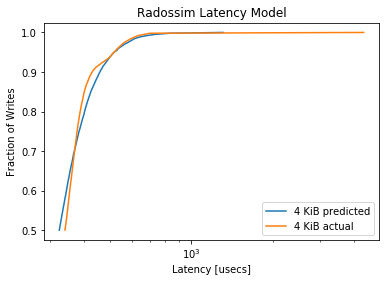

MainProcess pypet INFO     
 Finished single run #1251 of 1680 

MainProcess pypet INFO     
 Starting single run #1252 of 1680 



minimum predicted latency: 206.006378
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1121, pvalue=4.1083729612772456e-55)


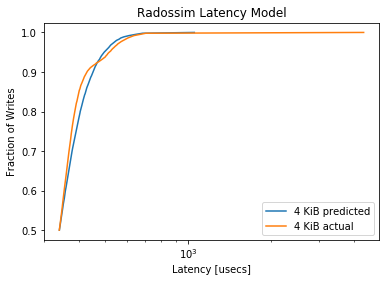

MainProcess pypet INFO     
 Finished single run #1252 of 1680 

MainProcess pypet INFO     
 Starting single run #1253 of 1680 



minimum predicted latency: 197.424802
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1123, pvalue=2.6178468215319457e-55)


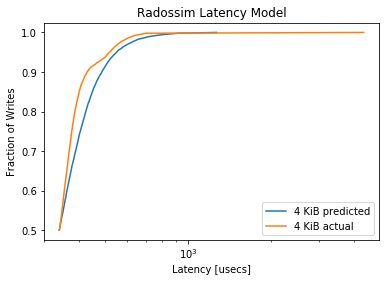

MainProcess pypet INFO     
 Finished single run #1253 of 1680 

MainProcess pypet INFO     
 Starting single run #1254 of 1680 



minimum predicted latency: 212.806960
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1775, pvalue=5.628152116504755e-138)


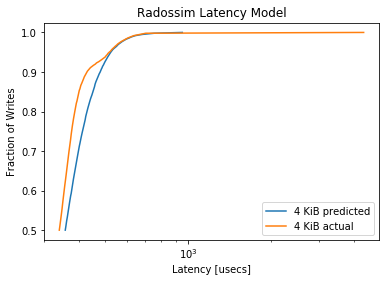

MainProcess pypet INFO     
 Finished single run #1254 of 1680 

MainProcess pypet INFO     
 Starting single run #1255 of 1680 



minimum predicted latency: 202.892948
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1811, pvalue=1.21007934960411e-143)


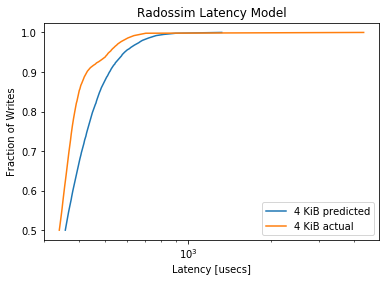

MainProcess pypet INFO     
 Finished single run #1255 of 1680 

MainProcess pypet INFO     
 Starting single run #1256 of 1680 



minimum predicted latency: 207.796304
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2555, pvalue=4.3561134758549585e-287)


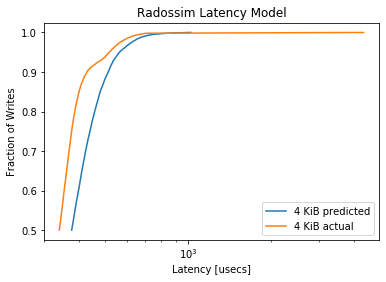

MainProcess pypet INFO     
 Finished single run #1256 of 1680 

MainProcess pypet INFO     
 Starting single run #1257 of 1680 



minimum predicted latency: 201.297372
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.258, pvalue=8.640619513491106e-293)


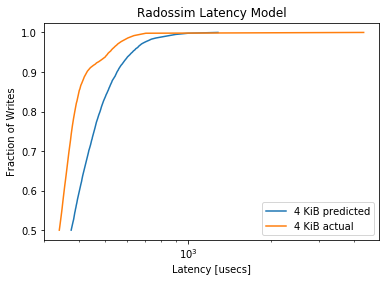

MainProcess pypet INFO     
 Finished single run #1257 of 1680 

MainProcess pypet INFO     
 Starting single run #1258 of 1680 



minimum predicted latency: 229.457570
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3566, pvalue=0.0)


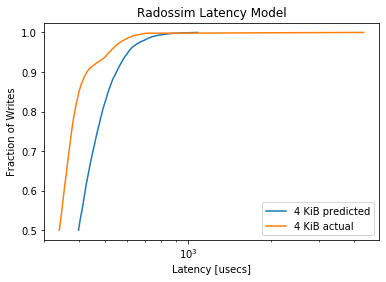

MainProcess pypet INFO     
 Finished single run #1258 of 1680 

MainProcess pypet INFO     
 Starting single run #1259 of 1680 



minimum predicted latency: 201.393321
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3407, pvalue=0.0)


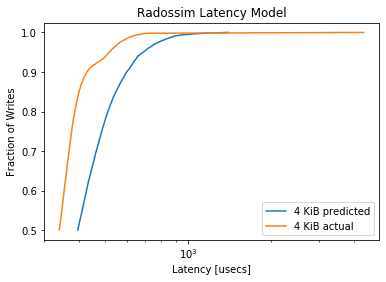

MainProcess pypet INFO     
 Finished single run #1259 of 1680 

MainProcess pypet INFO     PROGRESS: Finished 1260/1680 runs [===============     ] 75.0%, remaining: 0:02:34
MainProcess pypet INFO     
 Starting single run #1260 of 1680 



minimum predicted latency: 192.563136
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4662, pvalue=0.0)


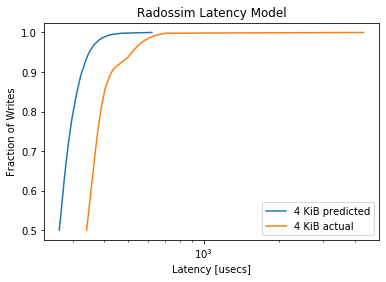

MainProcess pypet INFO     
 Finished single run #1260 of 1680 

MainProcess pypet INFO     
 Starting single run #1261 of 1680 



minimum predicted latency: 189.643440
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4205, pvalue=0.0)


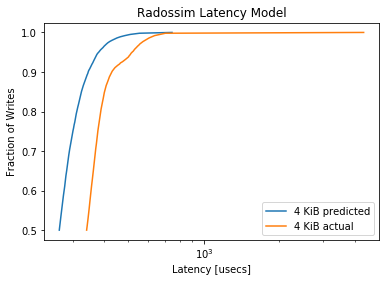

MainProcess pypet INFO     
 Finished single run #1261 of 1680 

MainProcess pypet INFO     
 Starting single run #1262 of 1680 



minimum predicted latency: 198.726607
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4168, pvalue=0.0)


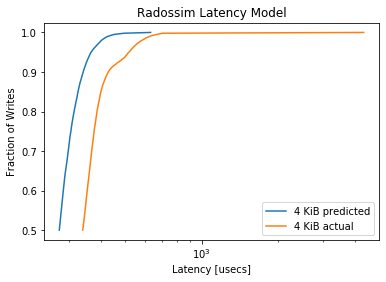

MainProcess pypet INFO     
 Finished single run #1262 of 1680 

MainProcess pypet INFO     
 Starting single run #1263 of 1680 



minimum predicted latency: 187.941745
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3593, pvalue=0.0)


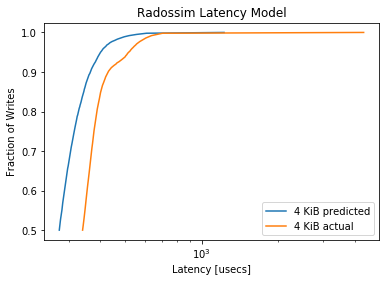

MainProcess pypet INFO     
 Finished single run #1263 of 1680 

MainProcess pypet INFO     
 Starting single run #1264 of 1680 



minimum predicted latency: 199.446089
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3633, pvalue=0.0)


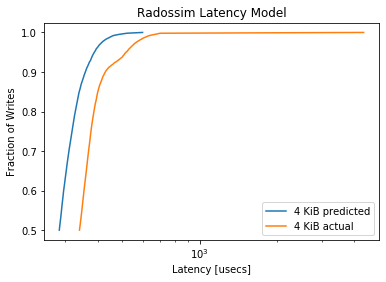

MainProcess pypet INFO     
 Finished single run #1264 of 1680 

MainProcess pypet INFO     
 Starting single run #1265 of 1680 



minimum predicted latency: 190.294592
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3024, pvalue=1e-323)


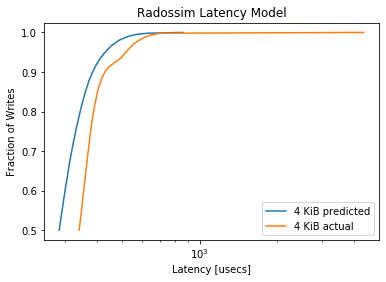

MainProcess pypet INFO     
 Finished single run #1265 of 1680 

MainProcess pypet INFO     
 Starting single run #1266 of 1680 



minimum predicted latency: 204.239826
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2804, pvalue=1e-323)


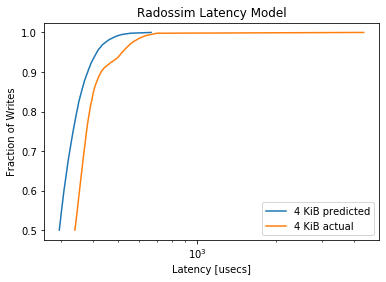

MainProcess pypet INFO     
 Finished single run #1266 of 1680 

MainProcess pypet INFO     
 Starting single run #1267 of 1680 



minimum predicted latency: 191.932139
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.24, pvalue=5.0316980200028694e-253)


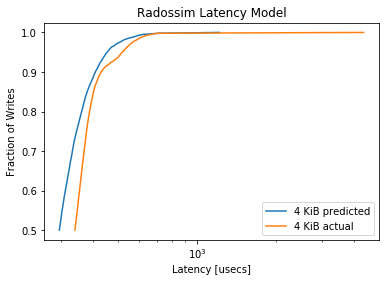

MainProcess pypet INFO     
 Finished single run #1267 of 1680 

MainProcess pypet INFO     
 Starting single run #1268 of 1680 



minimum predicted latency: 193.812318
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1959, pvalue=3.617567386094065e-168)


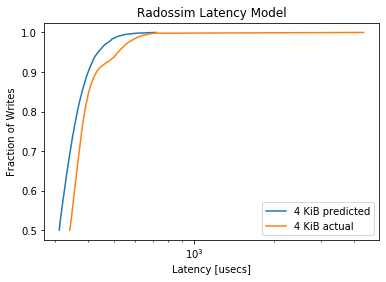

MainProcess pypet INFO     
 Finished single run #1268 of 1680 

MainProcess pypet INFO     
 Starting single run #1269 of 1680 



minimum predicted latency: 197.867054
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1691, pvalue=3.3337133237429686e-125)


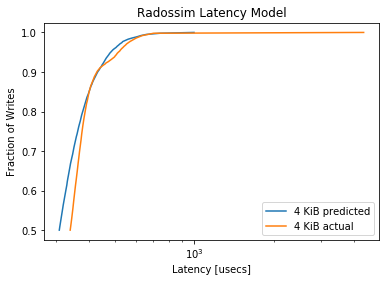

MainProcess pypet INFO     
 Finished single run #1269 of 1680 

MainProcess pypet INFO     
 Starting single run #1270 of 1680 



minimum predicted latency: 196.496452
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1085, pvalue=1.19283969822152e-51)


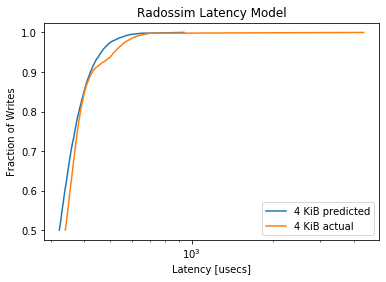

MainProcess pypet INFO     
 Finished single run #1270 of 1680 

MainProcess pypet INFO     
 Starting single run #1271 of 1680 



minimum predicted latency: 191.094202
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0933, pvalue=2.773523165873862e-38)


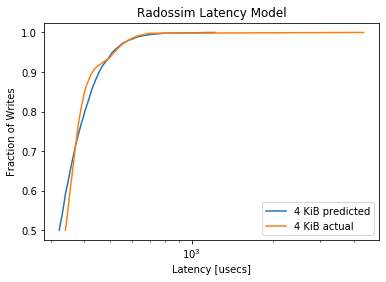

MainProcess pypet INFO     
 Finished single run #1271 of 1680 

MainProcess pypet INFO     
 Starting single run #1272 of 1680 



minimum predicted latency: 207.705869
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1045, pvalue=6.175533217766098e-48)


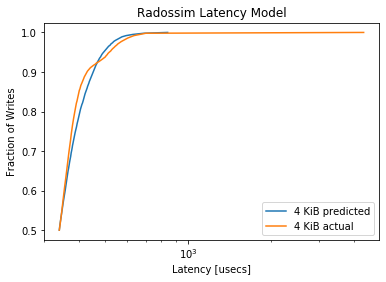

MainProcess pypet INFO     
 Finished single run #1272 of 1680 

MainProcess pypet INFO     
 Starting single run #1273 of 1680 



minimum predicted latency: 202.397361
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1143, pvalue=2.762696854909604e-57)


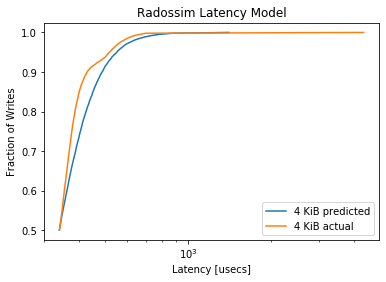

MainProcess pypet INFO     
 Finished single run #1273 of 1680 

MainProcess pypet INFO     
 Starting single run #1274 of 1680 



minimum predicted latency: 216.519441
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1765, pvalue=2.013969486125854e-136)


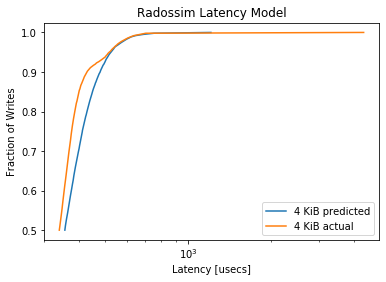

MainProcess pypet INFO     
 Finished single run #1274 of 1680 

MainProcess pypet INFO     
 Starting single run #1275 of 1680 



minimum predicted latency: 205.332930
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1946, pvalue=6.189753249940867e-166)


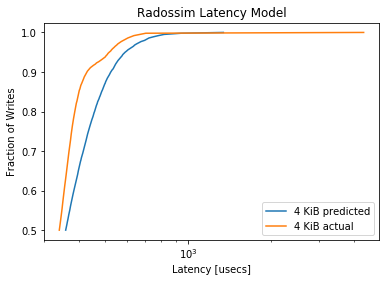

MainProcess pypet INFO     
 Finished single run #1275 of 1680 

MainProcess pypet INFO     
 Starting single run #1276 of 1680 



minimum predicted latency: 223.447011
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2405, pvalue=4.3408749284923355e-254)


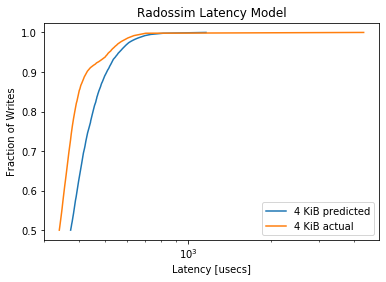

MainProcess pypet INFO     
 Finished single run #1276 of 1680 

MainProcess pypet INFO     
 Starting single run #1277 of 1680 



minimum predicted latency: 206.690030
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2561, pvalue=1.887059441114432e-288)


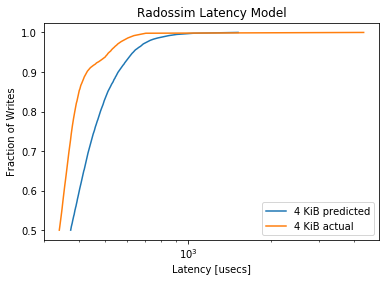

MainProcess pypet INFO     
 Finished single run #1277 of 1680 

MainProcess pypet INFO     
 Starting single run #1278 of 1680 



minimum predicted latency: 226.798974
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3453, pvalue=0.0)


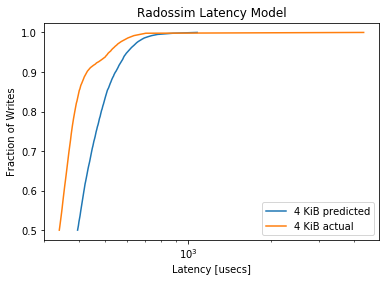

MainProcess pypet INFO     
 Finished single run #1278 of 1680 

MainProcess pypet INFO     
 Starting single run #1279 of 1680 



minimum predicted latency: 212.458595
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3454, pvalue=0.0)


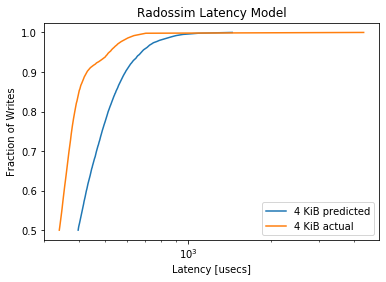

MainProcess pypet INFO     
 Finished single run #1279 of 1680 

MainProcess pypet INFO     
 Starting single run #1280 of 1680 



minimum predicted latency: 191.342388
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4681, pvalue=0.0)


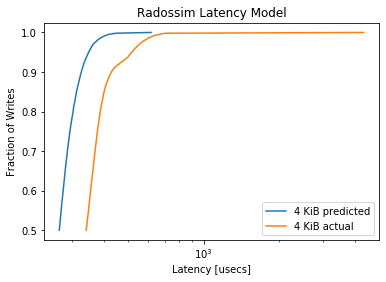

MainProcess pypet INFO     
 Finished single run #1280 of 1680 

MainProcess pypet INFO     
 Starting single run #1281 of 1680 



minimum predicted latency: 187.627398
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4088, pvalue=0.0)


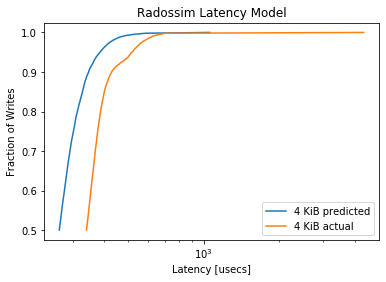

MainProcess pypet INFO     
 Finished single run #1281 of 1680 

MainProcess pypet INFO     
 Starting single run #1282 of 1680 



minimum predicted latency: 201.723979
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4147, pvalue=0.0)


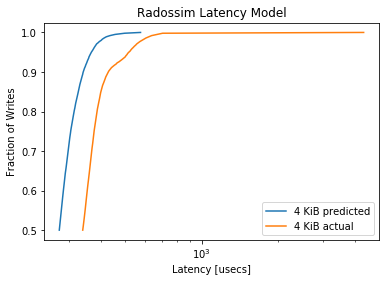

MainProcess pypet INFO     
 Finished single run #1282 of 1680 

MainProcess pypet INFO     
 Starting single run #1283 of 1680 



minimum predicted latency: 187.721177
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3653, pvalue=0.0)


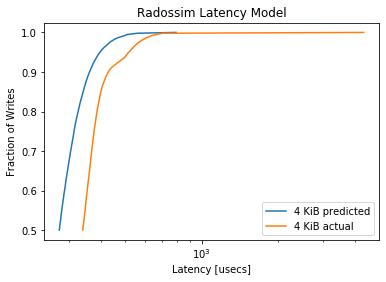

MainProcess pypet INFO     
 Finished single run #1283 of 1680 

MainProcess pypet INFO     
 Starting single run #1284 of 1680 



minimum predicted latency: 200.945342
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.359, pvalue=0.0)


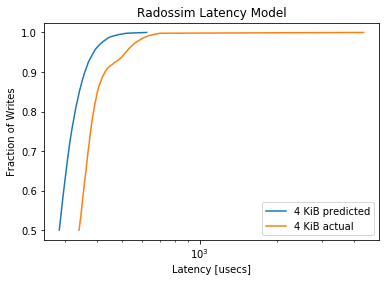

MainProcess pypet INFO     
 Finished single run #1284 of 1680 

MainProcess pypet INFO     
 Starting single run #1285 of 1680 



minimum predicted latency: 191.121809
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3121, pvalue=1e-323)


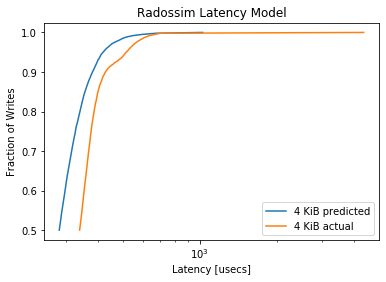

MainProcess pypet INFO     
 Finished single run #1285 of 1680 

MainProcess pypet INFO     
 Starting single run #1286 of 1680 



minimum predicted latency: 200.358135
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2875, pvalue=1e-323)


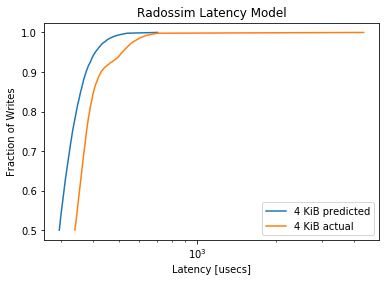

MainProcess pypet INFO     
 Finished single run #1286 of 1680 

MainProcess pypet INFO     
 Starting single run #1287 of 1680 



minimum predicted latency: 186.190020
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2366, pvalue=7.529642059666685e-246)


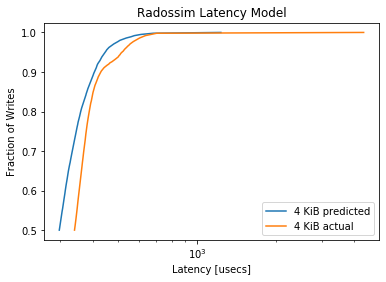

MainProcess pypet INFO     
 Finished single run #1287 of 1680 

MainProcess pypet INFO     
 Starting single run #1288 of 1680 



minimum predicted latency: 203.875863
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2024, pvalue=1.4554842841061212e-179)


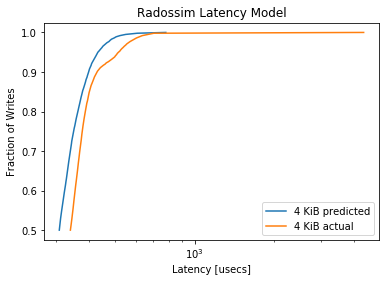

MainProcess pypet INFO     
 Finished single run #1288 of 1680 

MainProcess pypet INFO     
 Starting single run #1289 of 1680 



minimum predicted latency: 192.380925
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1587, pvalue=2.9019018073765587e-110)


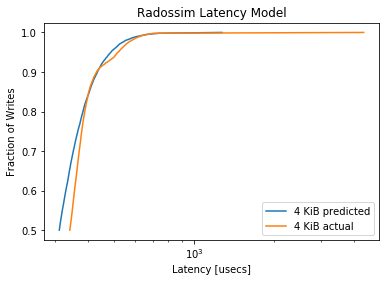

MainProcess pypet INFO     
 Finished single run #1289 of 1680 

MainProcess pypet INFO     
 Starting single run #1290 of 1680 



minimum predicted latency: 210.741247
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1104, pvalue=1.8328791440187334e-53)


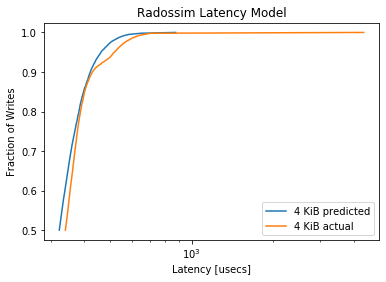

MainProcess pypet INFO     
 Finished single run #1290 of 1680 

MainProcess pypet INFO     
 Starting single run #1291 of 1680 



minimum predicted latency: 197.887087
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0857, pvalue=2.3267864623988028e-32)


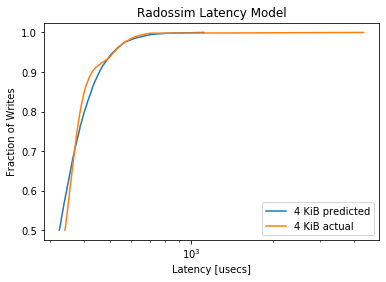

MainProcess pypet INFO     
 Finished single run #1291 of 1680 

MainProcess pypet INFO     
 Starting single run #1292 of 1680 



minimum predicted latency: 212.457980
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1069, pvalue=3.793908925840325e-50)


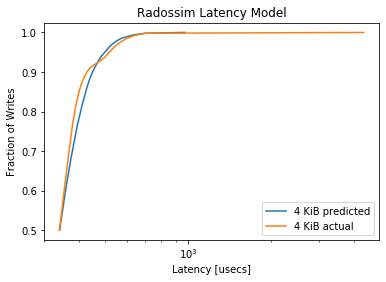

MainProcess pypet INFO     
 Finished single run #1292 of 1680 

MainProcess pypet INFO     
 Starting single run #1293 of 1680 



minimum predicted latency: 201.387976
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1222, pvalue=1.9472407007758132e-65)


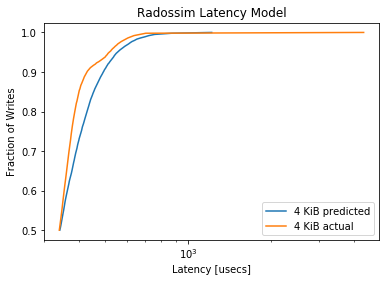

MainProcess pypet INFO     
 Finished single run #1293 of 1680 

MainProcess pypet INFO     
 Starting single run #1294 of 1680 



minimum predicted latency: 210.250938
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1749, pvalue=5.906183838732229e-134)


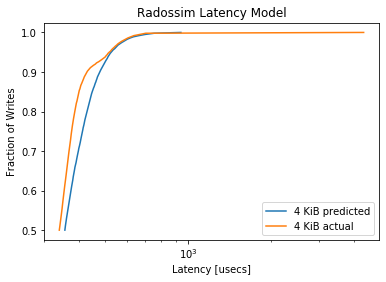

MainProcess pypet INFO     
 Finished single run #1294 of 1680 

MainProcess pypet INFO     
 Starting single run #1295 of 1680 



minimum predicted latency: 203.935563
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1841, pvalue=1.8662030577234562e-148)


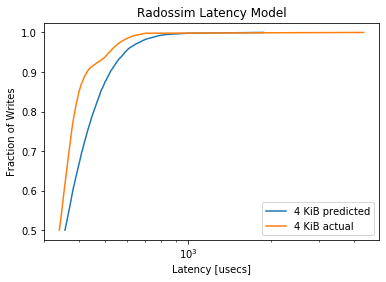

MainProcess pypet INFO     
 Finished single run #1295 of 1680 

MainProcess pypet INFO     
 Starting single run #1296 of 1680 



minimum predicted latency: 222.227744
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2551, pvalue=3.516547251060014e-286)


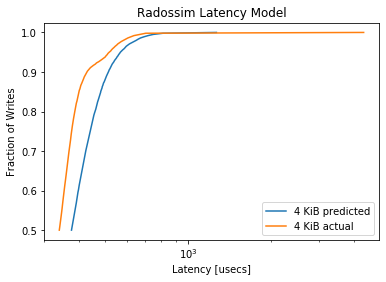

MainProcess pypet INFO     
 Finished single run #1296 of 1680 

MainProcess pypet INFO     
 Starting single run #1297 of 1680 



minimum predicted latency: 199.227931
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2513, pvalue=1.2265701494988556e-277)


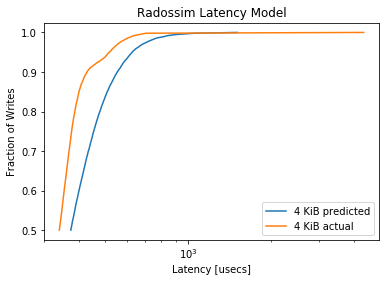

MainProcess pypet INFO     
 Finished single run #1297 of 1680 

MainProcess pypet INFO     
 Starting single run #1298 of 1680 



minimum predicted latency: 227.801338
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3469, pvalue=0.0)


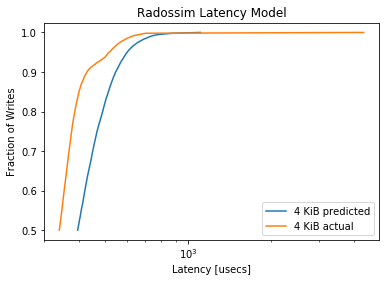

MainProcess pypet INFO     
 Finished single run #1298 of 1680 

MainProcess pypet INFO     
 Starting single run #1299 of 1680 



minimum predicted latency: 200.186624
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3467, pvalue=0.0)


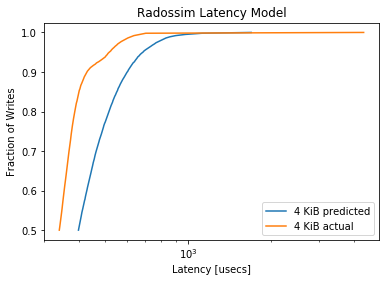

MainProcess pypet INFO     
 Finished single run #1299 of 1680 

MainProcess pypet INFO     
 Starting single run #1300 of 1680 



minimum predicted latency: 197.792352
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4705, pvalue=0.0)


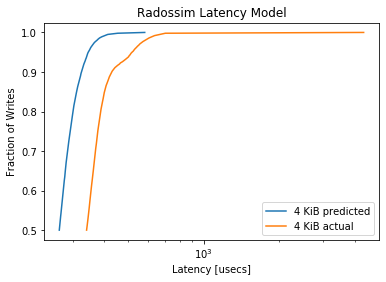

MainProcess pypet INFO     
 Finished single run #1300 of 1680 

MainProcess pypet INFO     
 Starting single run #1301 of 1680 



minimum predicted latency: 189.535065
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4179, pvalue=0.0)


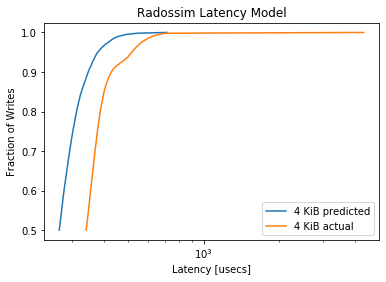

MainProcess pypet INFO     
 Finished single run #1301 of 1680 

MainProcess pypet INFO     
 Starting single run #1302 of 1680 



minimum predicted latency: 197.099906
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4131, pvalue=0.0)


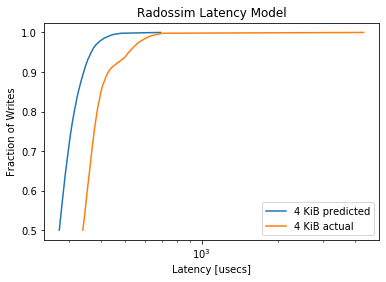

MainProcess pypet INFO     
 Finished single run #1302 of 1680 

MainProcess pypet INFO     
 Starting single run #1303 of 1680 



minimum predicted latency: 190.854975
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3628, pvalue=0.0)


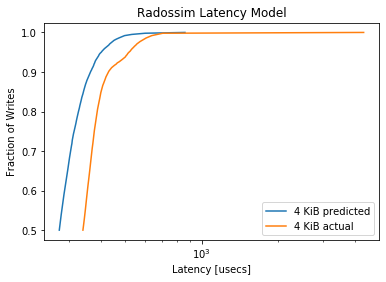

MainProcess pypet INFO     
 Finished single run #1303 of 1680 

MainProcess pypet INFO     
 Starting single run #1304 of 1680 



minimum predicted latency: 193.454778
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3611, pvalue=0.0)


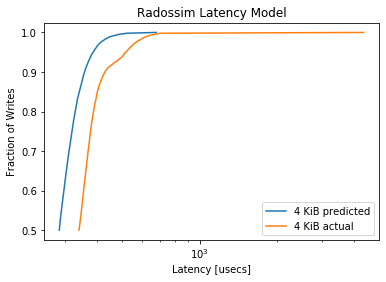

MainProcess pypet INFO     
 Finished single run #1304 of 1680 

MainProcess pypet INFO     
 Starting single run #1305 of 1680 



minimum predicted latency: 192.055542
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3017, pvalue=1e-323)


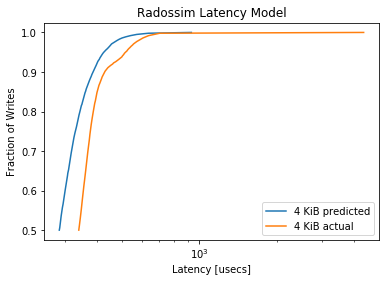

MainProcess pypet INFO     
 Finished single run #1305 of 1680 

MainProcess pypet INFO     
 Starting single run #1306 of 1680 



minimum predicted latency: 201.362130
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2799, pvalue=1e-323)


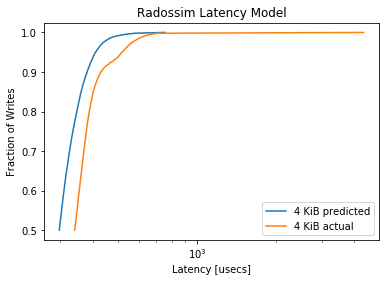

MainProcess pypet INFO     
 Finished single run #1306 of 1680 

MainProcess pypet INFO     
 Starting single run #1307 of 1680 



minimum predicted latency: 192.448830
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2435, pvalue=1.6007928322391355e-260)


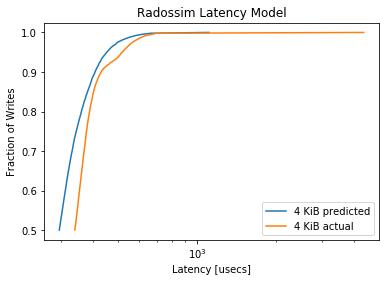

MainProcess pypet INFO     
 Finished single run #1307 of 1680 

MainProcess pypet INFO     
 Starting single run #1308 of 1680 



minimum predicted latency: 198.412189
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1904, pvalue=7.990718342591907e-159)


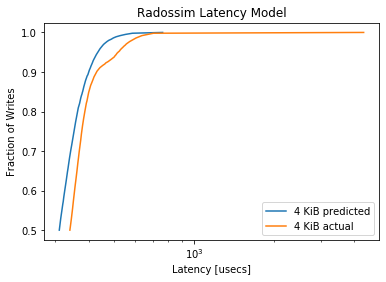

MainProcess pypet INFO     
 Finished single run #1308 of 1680 

MainProcess pypet INFO     
 Starting single run #1309 of 1680 



minimum predicted latency: 195.803978
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1663, pvalue=4.366767268593729e-121)


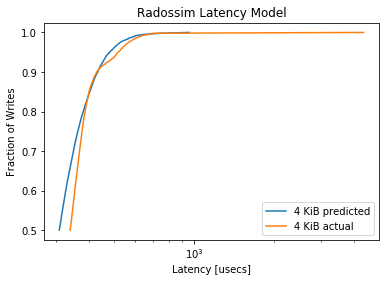

MainProcess pypet INFO     
 Finished single run #1309 of 1680 

MainProcess pypet INFO     
 Starting single run #1310 of 1680 



minimum predicted latency: 205.181114
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1007, pvalue=1.544971873006107e-44)


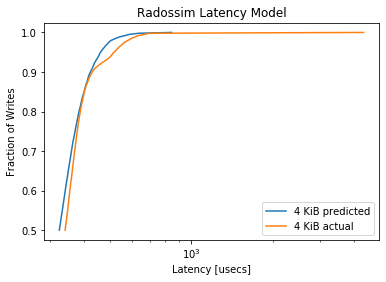

MainProcess pypet INFO     
 Finished single run #1310 of 1680 

MainProcess pypet INFO     
 Starting single run #1311 of 1680 



minimum predicted latency: 198.951999
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0886, pvalue=1.4657304341507354e-34)


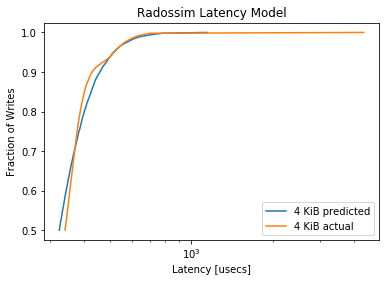

MainProcess pypet INFO     
 Finished single run #1311 of 1680 

MainProcess pypet INFO     
 Starting single run #1312 of 1680 



minimum predicted latency: 214.178921
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1091, pvalue=3.2161960894450104e-52)


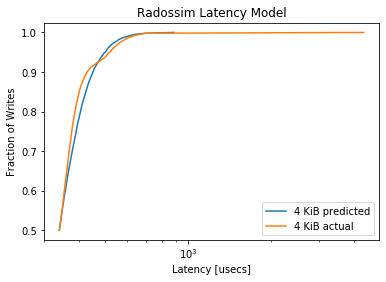

MainProcess pypet INFO     
 Finished single run #1312 of 1680 

MainProcess pypet INFO     
 Starting single run #1313 of 1680 



minimum predicted latency: 191.686388
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1051, pvalue=1.7479157826878558e-48)


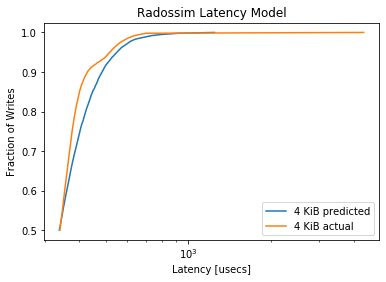

MainProcess pypet INFO     
 Finished single run #1313 of 1680 

MainProcess pypet INFO     
 Starting single run #1314 of 1680 



minimum predicted latency: 210.828880
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1718, pvalue=3.064456516172909e-129)


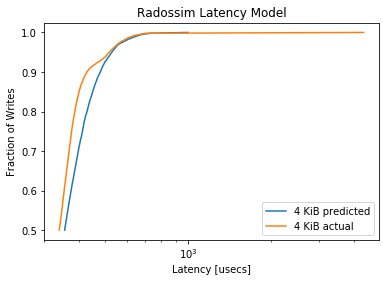

MainProcess pypet INFO     
 Finished single run #1314 of 1680 

MainProcess pypet INFO     
 Starting single run #1315 of 1680 



minimum predicted latency: 197.132316
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1798, pvalue=1.3894620716615462e-141)


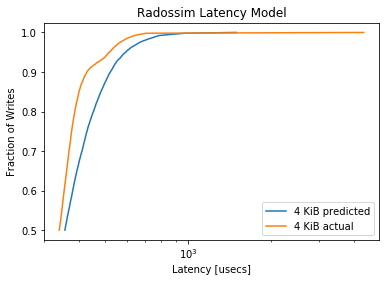

MainProcess pypet INFO     
 Finished single run #1315 of 1680 

MainProcess pypet INFO     
 Starting single run #1316 of 1680 



minimum predicted latency: 226.040476
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2495, pvalue=1.2258398361829145e-273)


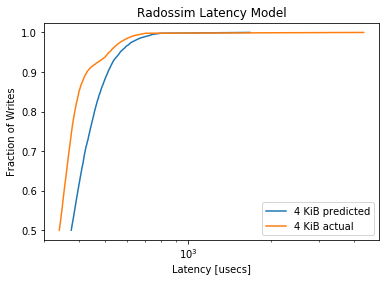

MainProcess pypet INFO     
 Finished single run #1316 of 1680 

MainProcess pypet INFO     
 Starting single run #1317 of 1680 



minimum predicted latency: 198.220330
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2584, pvalue=1.0440986073884107e-293)


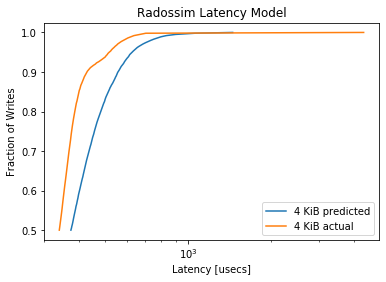

MainProcess pypet INFO     
 Finished single run #1317 of 1680 

MainProcess pypet INFO     
 Starting single run #1318 of 1680 



minimum predicted latency: 222.757970
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.347, pvalue=0.0)


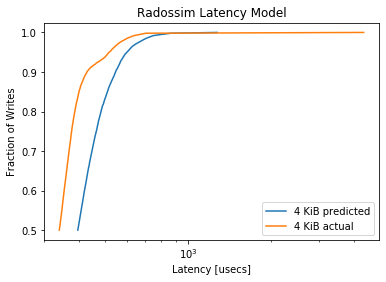

MainProcess pypet INFO     
 Finished single run #1318 of 1680 

MainProcess pypet INFO     
 Starting single run #1319 of 1680 



minimum predicted latency: 210.473606
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3424, pvalue=0.0)


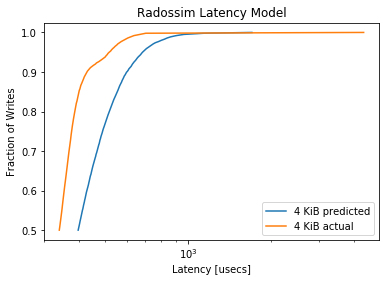

MainProcess pypet INFO     
 Finished single run #1319 of 1680 

MainProcess pypet INFO     
 Starting single run #1320 of 1680 



minimum predicted latency: 193.175160
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4732, pvalue=0.0)


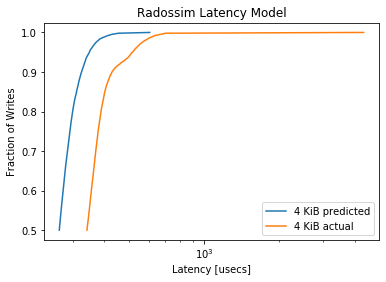

MainProcess pypet INFO     
 Finished single run #1320 of 1680 

MainProcess pypet INFO     
 Starting single run #1321 of 1680 



minimum predicted latency: 187.512503
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4164, pvalue=0.0)


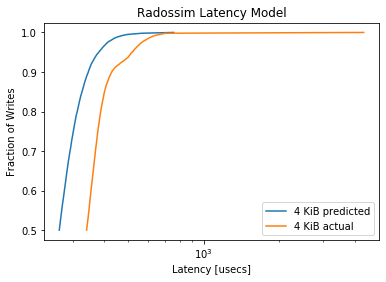

MainProcess pypet INFO     
 Finished single run #1321 of 1680 

MainProcess pypet INFO     
 Starting single run #1322 of 1680 



minimum predicted latency: 192.411433
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4189, pvalue=0.0)


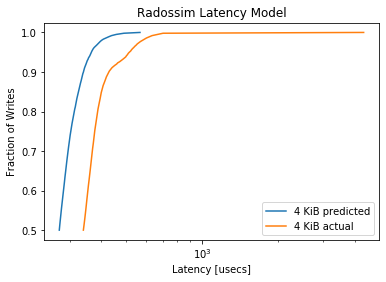

MainProcess pypet INFO     
 Finished single run #1322 of 1680 

MainProcess pypet INFO     
 Starting single run #1323 of 1680 



minimum predicted latency: 190.776294
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3654, pvalue=0.0)


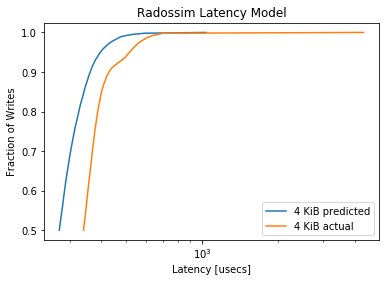

MainProcess pypet INFO     
 Finished single run #1323 of 1680 

MainProcess pypet INFO     
 Starting single run #1324 of 1680 



minimum predicted latency: 194.216117
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3518, pvalue=0.0)


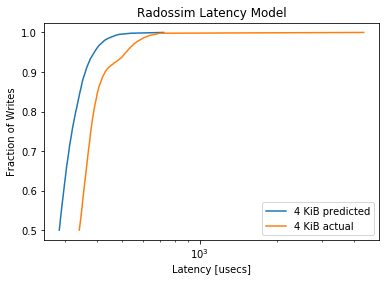

MainProcess pypet INFO     
 Finished single run #1324 of 1680 

MainProcess pypet INFO     
 Starting single run #1325 of 1680 



minimum predicted latency: 189.499513
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3075, pvalue=1e-323)


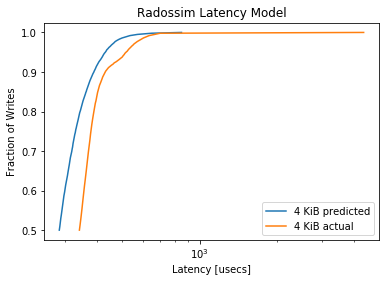

MainProcess pypet INFO     
 Finished single run #1325 of 1680 

MainProcess pypet INFO     
 Starting single run #1326 of 1680 



minimum predicted latency: 197.170254
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2914, pvalue=1e-323)


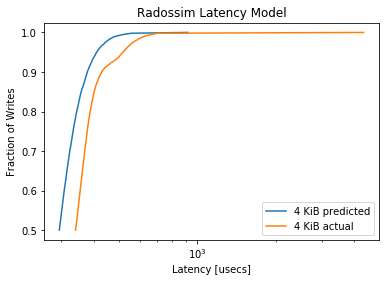

MainProcess pypet INFO     
 Finished single run #1326 of 1680 

MainProcess pypet INFO     
 Starting single run #1327 of 1680 



minimum predicted latency: 189.603520
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2535, pvalue=1.4431945144646207e-282)


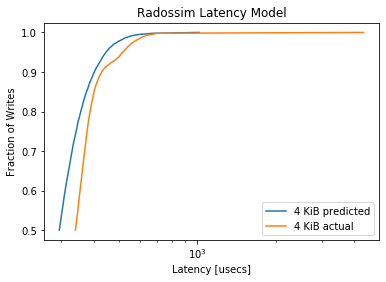

MainProcess pypet INFO     
 Finished single run #1327 of 1680 

MainProcess pypet INFO     
 Starting single run #1328 of 1680 



minimum predicted latency: 203.930036
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2045, pvalue=2.5100616975477324e-183)


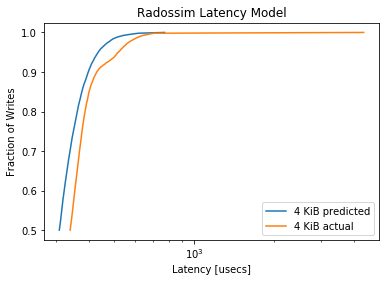

MainProcess pypet INFO     
 Finished single run #1328 of 1680 

MainProcess pypet INFO     
 Starting single run #1329 of 1680 



minimum predicted latency: 194.334697
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1785, pvalue=1.5406741347182014e-139)


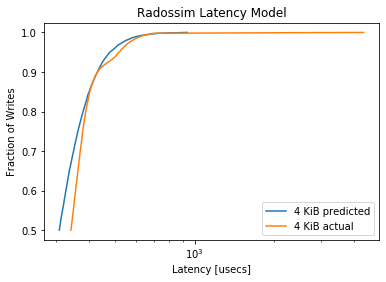

MainProcess pypet INFO     
 Finished single run #1329 of 1680 

MainProcess pypet INFO     
 Starting single run #1330 of 1680 



minimum predicted latency: 211.057683
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1121, pvalue=4.1083729612772456e-55)


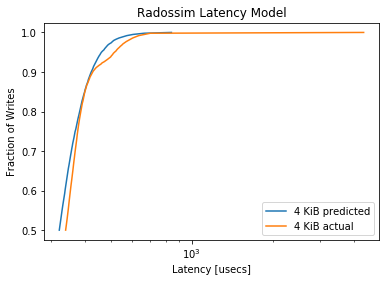

MainProcess pypet INFO     
 Finished single run #1330 of 1680 

MainProcess pypet INFO     
 Starting single run #1331 of 1680 



minimum predicted latency: 196.416381
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.089, pvalue=7.190052228455816e-35)


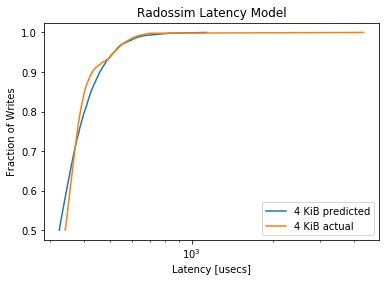

MainProcess pypet INFO     
 Finished single run #1331 of 1680 

MainProcess pypet INFO     
 Starting single run #1332 of 1680 



minimum predicted latency: 211.410313
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1034, pvalue=6.12933163958351e-47)


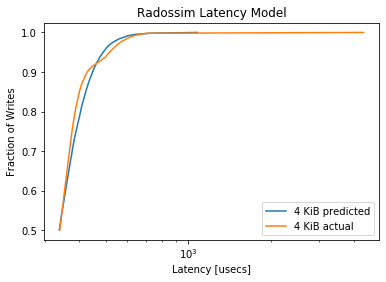

MainProcess pypet INFO     
 Finished single run #1332 of 1680 

MainProcess pypet INFO     
 Starting single run #1333 of 1680 



minimum predicted latency: 203.017646
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1149, pvalue=6.942027774138103e-58)


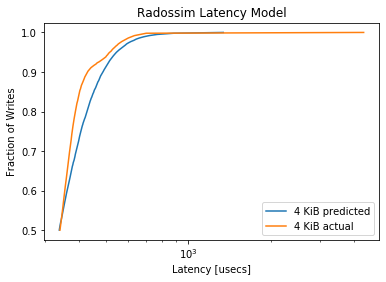

MainProcess pypet INFO     
 Finished single run #1333 of 1680 

MainProcess pypet INFO     
 Starting single run #1334 of 1680 



minimum predicted latency: 213.879373
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1681, pvalue=1.0032557010543709e-123)


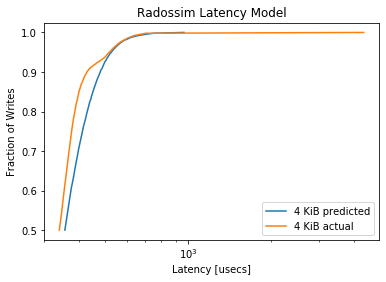

MainProcess pypet INFO     
 Finished single run #1334 of 1680 

MainProcess pypet INFO     
 Starting single run #1335 of 1680 



minimum predicted latency: 195.914577
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1755, pvalue=7.059521184653964e-135)


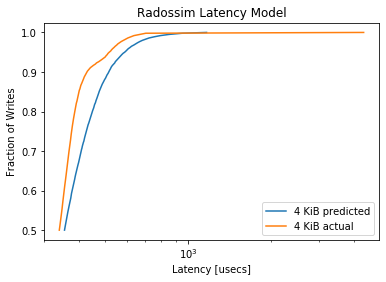

MainProcess pypet INFO     
 Finished single run #1335 of 1680 

MainProcess pypet INFO     
 Starting single run #1336 of 1680 



minimum predicted latency: 220.835019
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2429, pvalue=3.1450466280515753e-259)


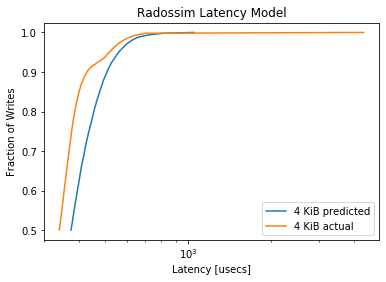

MainProcess pypet INFO     
 Finished single run #1336 of 1680 

MainProcess pypet INFO     
 Starting single run #1337 of 1680 



minimum predicted latency: 201.677275
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2524, pvalue=4.2620724283015394e-280)


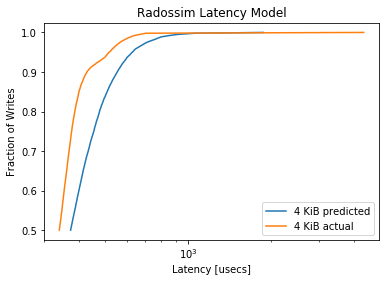

MainProcess pypet INFO     
 Finished single run #1337 of 1680 

MainProcess pypet INFO     
 Starting single run #1338 of 1680 



minimum predicted latency: 225.937519
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.335, pvalue=0.0)


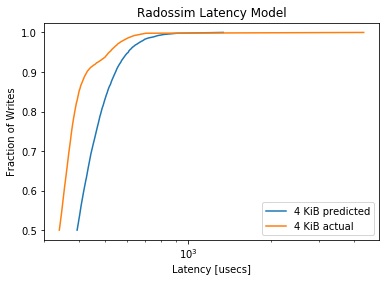

MainProcess pypet INFO     
 Finished single run #1338 of 1680 

MainProcess pypet INFO     
 Starting single run #1339 of 1680 



minimum predicted latency: 208.631326
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3297, pvalue=1e-323)


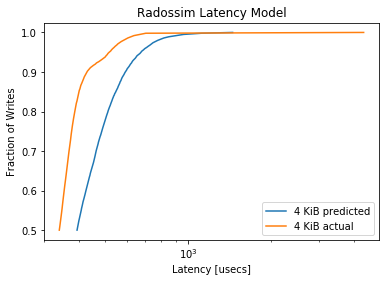

MainProcess pypet INFO     
 Finished single run #1339 of 1680 

MainProcess pypet INFO     
 Starting single run #1340 of 1680 



minimum predicted latency: 197.875308
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4698, pvalue=0.0)


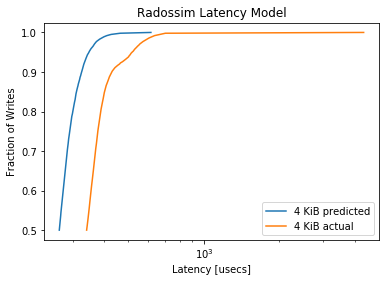

MainProcess pypet INFO     
 Finished single run #1340 of 1680 

MainProcess pypet INFO     
 Starting single run #1341 of 1680 



minimum predicted latency: 188.751551
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4216, pvalue=0.0)


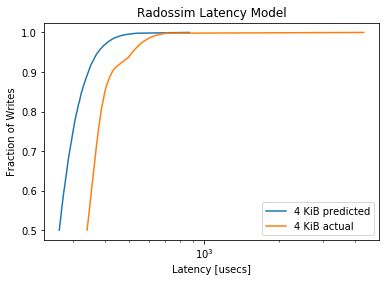

MainProcess pypet INFO     
 Finished single run #1341 of 1680 

MainProcess pypet INFO     
 Starting single run #1342 of 1680 



minimum predicted latency: 195.254407
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4218, pvalue=0.0)


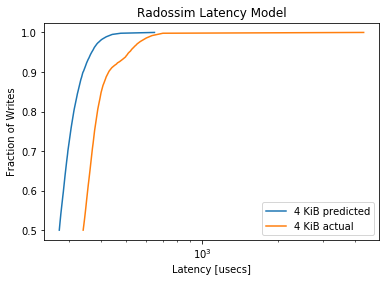

MainProcess pypet INFO     
 Finished single run #1342 of 1680 

MainProcess pypet INFO     
 Starting single run #1343 of 1680 



minimum predicted latency: 190.716116
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3723, pvalue=0.0)


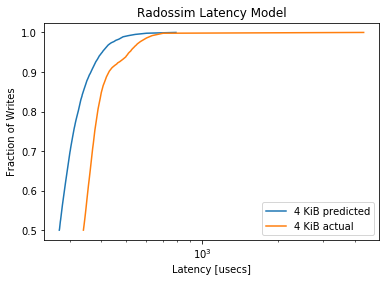

MainProcess pypet INFO     
 Finished single run #1343 of 1680 

MainProcess pypet INFO     PROGRESS: Finished 1344/1680 runs [================    ] 80.0%, remaining: 0:02:02
MainProcess pypet INFO     
 Starting single run #1344 of 1680 



minimum predicted latency: 197.177610
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.361, pvalue=0.0)


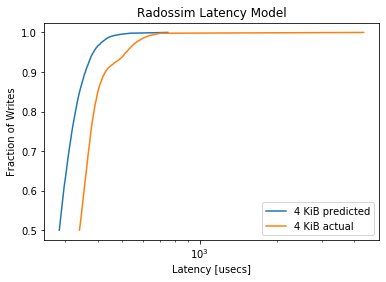

MainProcess pypet INFO     
 Finished single run #1344 of 1680 

MainProcess pypet INFO     
 Starting single run #1345 of 1680 



minimum predicted latency: 187.634608
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3116, pvalue=1e-323)


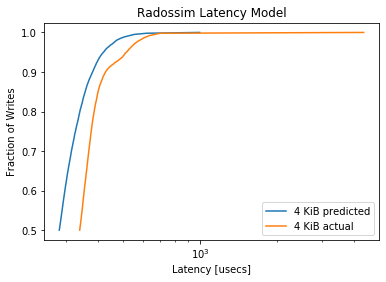

MainProcess pypet INFO     
 Finished single run #1345 of 1680 

MainProcess pypet INFO     
 Starting single run #1346 of 1680 



minimum predicted latency: 198.665366
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2959, pvalue=1e-323)


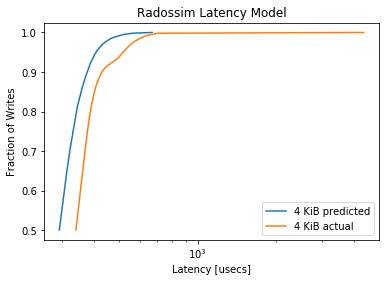

MainProcess pypet INFO     
 Finished single run #1346 of 1680 

MainProcess pypet INFO     
 Starting single run #1347 of 1680 



minimum predicted latency: 189.771681
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2458, pvalue=1.6440513953198924e-265)


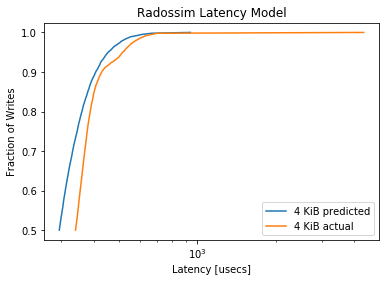

MainProcess pypet INFO     
 Finished single run #1347 of 1680 

MainProcess pypet INFO     
 Starting single run #1348 of 1680 



minimum predicted latency: 200.936880
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2055, pvalue=3.9226357779888126e-185)


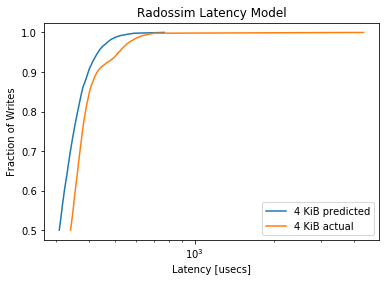

MainProcess pypet INFO     
 Finished single run #1348 of 1680 

MainProcess pypet INFO     
 Starting single run #1349 of 1680 



minimum predicted latency: 184.413497
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1714, pvalue=1.2259700183545722e-128)


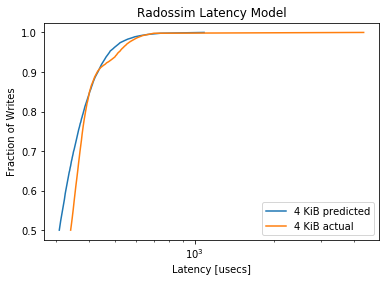

MainProcess pypet INFO     
 Finished single run #1349 of 1680 

MainProcess pypet INFO     
 Starting single run #1350 of 1680 



minimum predicted latency: 197.185320
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1152, pvalue=3.470361442715303e-58)


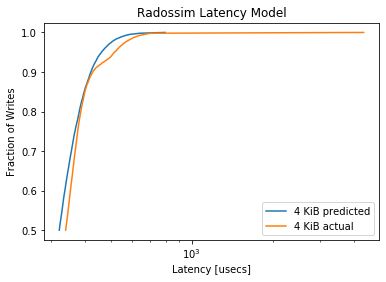

MainProcess pypet INFO     
 Finished single run #1350 of 1680 

MainProcess pypet INFO     
 Starting single run #1351 of 1680 



minimum predicted latency: 193.753905
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0945, pvalue=2.8937642365321192e-39)


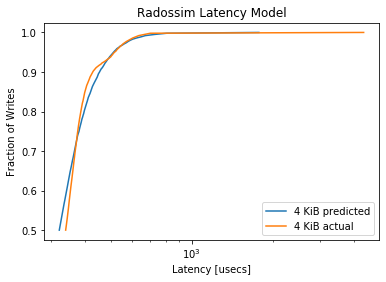

MainProcess pypet INFO     
 Finished single run #1351 of 1680 

MainProcess pypet INFO     
 Starting single run #1352 of 1680 



minimum predicted latency: 204.793289
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1018, pvalue=1.6529211940364096e-45)


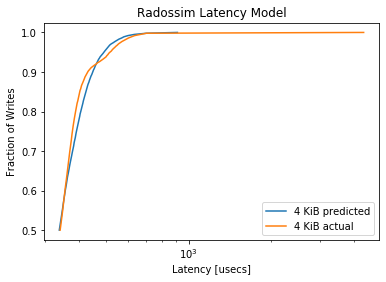

MainProcess pypet INFO     
 Finished single run #1352 of 1680 

MainProcess pypet INFO     
 Starting single run #1353 of 1680 



minimum predicted latency: 199.974359
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1167, pvalue=1.0542226900821242e-59)


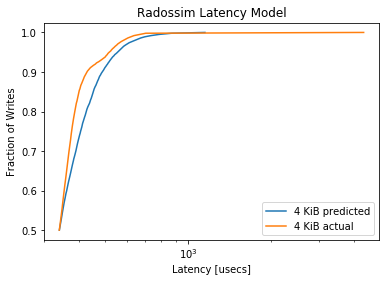

MainProcess pypet INFO     
 Finished single run #1353 of 1680 

MainProcess pypet INFO     
 Starting single run #1354 of 1680 



minimum predicted latency: 216.919710
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1693, pvalue=1.6832892164751832e-125)


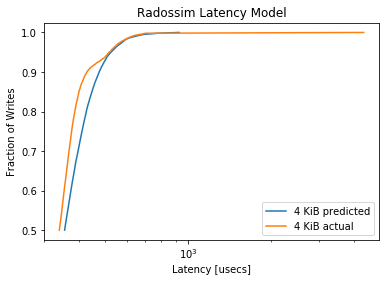

MainProcess pypet INFO     
 Finished single run #1354 of 1680 

MainProcess pypet INFO     
 Starting single run #1355 of 1680 



minimum predicted latency: 200.023949
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1796, pvalue=2.8736131626086614e-141)


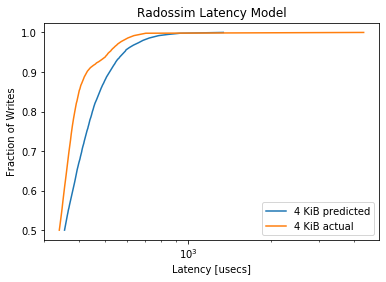

MainProcess pypet INFO     
 Finished single run #1355 of 1680 

MainProcess pypet INFO     
 Starting single run #1356 of 1680 



minimum predicted latency: 206.502843
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2344, pvalue=2.9025109982424582e-241)


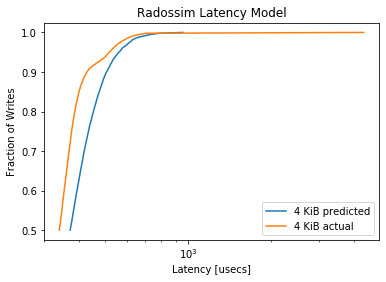

MainProcess pypet INFO     
 Finished single run #1356 of 1680 

MainProcess pypet INFO     
 Starting single run #1357 of 1680 



minimum predicted latency: 209.998103
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2579, pvalue=1.4647485982983171e-292)


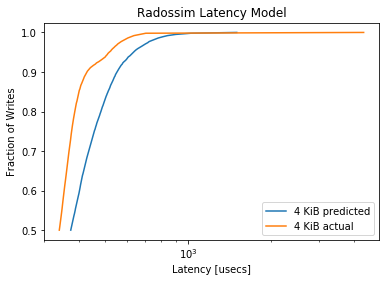

MainProcess pypet INFO     
 Finished single run #1357 of 1680 

MainProcess pypet INFO     
 Starting single run #1358 of 1680 



minimum predicted latency: 228.021578
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3352, pvalue=0.0)


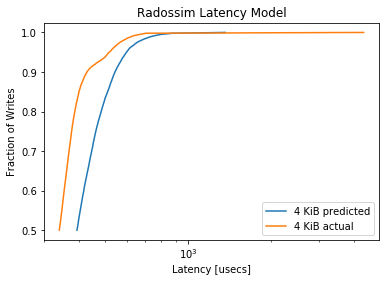

MainProcess pypet INFO     
 Finished single run #1358 of 1680 

MainProcess pypet INFO     
 Starting single run #1359 of 1680 



minimum predicted latency: 204.338778
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3339, pvalue=0.0)


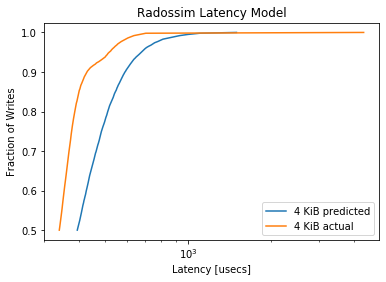

MainProcess pypet INFO     
 Finished single run #1359 of 1680 

MainProcess pypet INFO     
 Starting single run #1360 of 1680 



minimum predicted latency: 191.330680
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4716, pvalue=0.0)


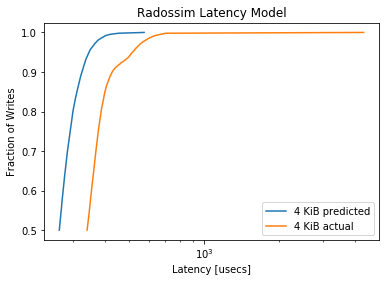

MainProcess pypet INFO     
 Finished single run #1360 of 1680 

MainProcess pypet INFO     
 Starting single run #1361 of 1680 



minimum predicted latency: 185.408689
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4129, pvalue=0.0)


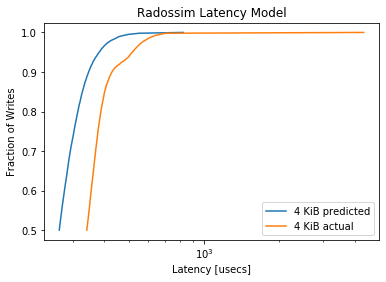

MainProcess pypet INFO     
 Finished single run #1361 of 1680 

MainProcess pypet INFO     
 Starting single run #1362 of 1680 



minimum predicted latency: 197.290355
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4186, pvalue=0.0)


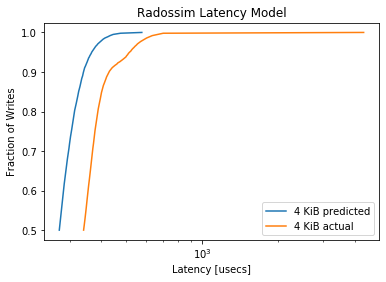

MainProcess pypet INFO     
 Finished single run #1362 of 1680 

MainProcess pypet INFO     
 Starting single run #1363 of 1680 



minimum predicted latency: 186.430410
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3679, pvalue=0.0)


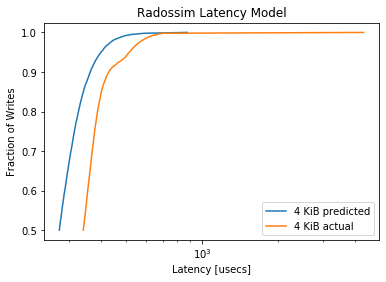

MainProcess pypet INFO     
 Finished single run #1363 of 1680 

MainProcess pypet INFO     
 Starting single run #1364 of 1680 



minimum predicted latency: 198.166545
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3606, pvalue=0.0)


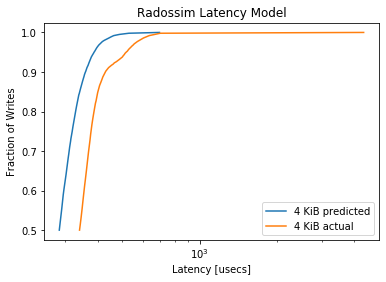

MainProcess pypet INFO     
 Finished single run #1364 of 1680 

MainProcess pypet INFO     
 Starting single run #1365 of 1680 



minimum predicted latency: 192.408774
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3158, pvalue=1e-323)


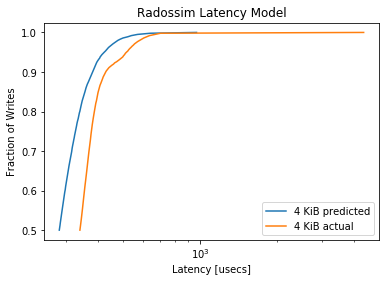

MainProcess pypet INFO     
 Finished single run #1365 of 1680 

MainProcess pypet INFO     
 Starting single run #1366 of 1680 



minimum predicted latency: 202.637126
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2869, pvalue=1e-323)


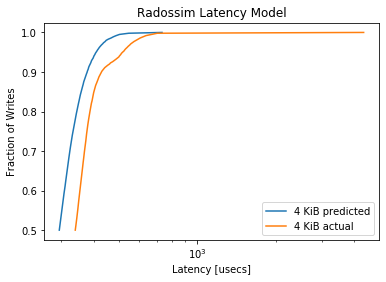

MainProcess pypet INFO     
 Finished single run #1366 of 1680 

MainProcess pypet INFO     
 Starting single run #1367 of 1680 



minimum predicted latency: 193.900480
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2459, pvalue=9.952191687537224e-266)


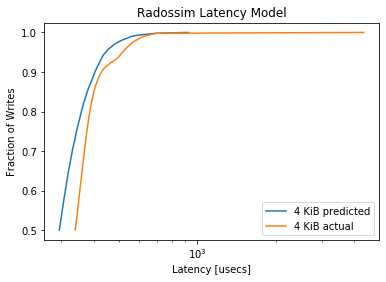

MainProcess pypet INFO     
 Finished single run #1367 of 1680 

MainProcess pypet INFO     
 Starting single run #1368 of 1680 



minimum predicted latency: 208.130850
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2082, pvalue=4.696594511979105e-190)


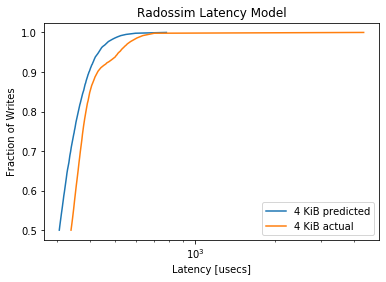

MainProcess pypet INFO     
 Finished single run #1368 of 1680 

MainProcess pypet INFO     
 Starting single run #1369 of 1680 



minimum predicted latency: 194.069960
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1749, pvalue=5.906183838732229e-134)


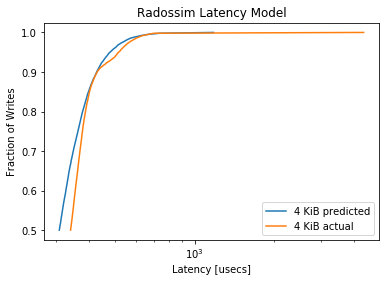

MainProcess pypet INFO     
 Finished single run #1369 of 1680 

MainProcess pypet INFO     
 Starting single run #1370 of 1680 



minimum predicted latency: 203.672005
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1214, pvalue=1.380234106156662e-64)


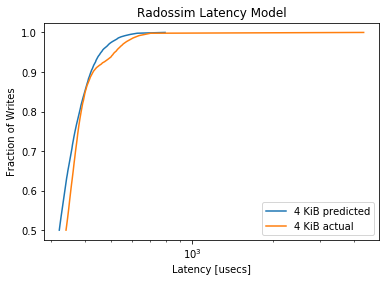

MainProcess pypet INFO     
 Finished single run #1370 of 1680 

MainProcess pypet INFO     
 Starting single run #1371 of 1680 



minimum predicted latency: 199.738666
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0958, pvalue=2.420226333205429e-40)


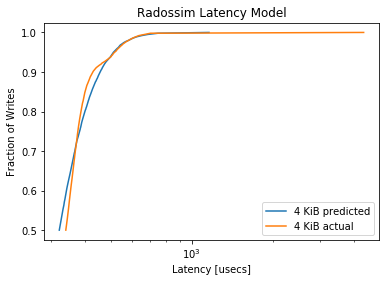

MainProcess pypet INFO     
 Finished single run #1371 of 1680 

MainProcess pypet INFO     
 Starting single run #1372 of 1680 



minimum predicted latency: 207.702449
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1008, pvalue=1.2621667926911265e-44)


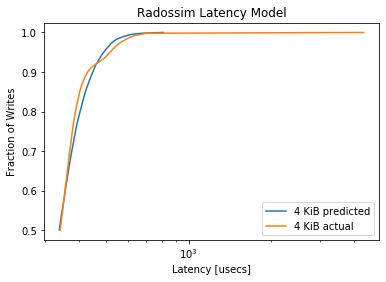

MainProcess pypet INFO     
 Finished single run #1372 of 1680 

MainProcess pypet INFO     
 Starting single run #1373 of 1680 



minimum predicted latency: 193.630154
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1088, pvalue=6.19951662437857e-52)


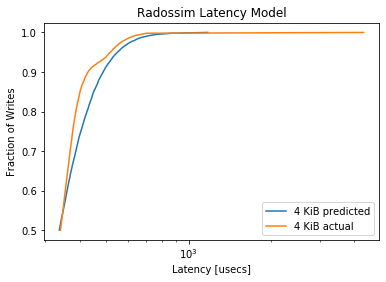

MainProcess pypet INFO     
 Finished single run #1373 of 1680 

MainProcess pypet INFO     
 Starting single run #1374 of 1680 



minimum predicted latency: 216.018069
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1635, pvalue=4.868119365120776e-117)


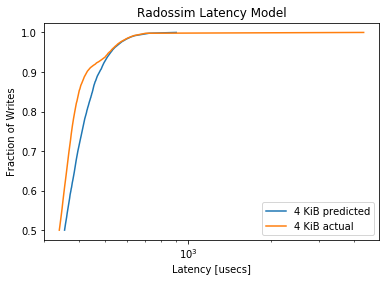

MainProcess pypet INFO     
 Finished single run #1374 of 1680 

MainProcess pypet INFO     
 Starting single run #1375 of 1680 



minimum predicted latency: 203.813187
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1764, pvalue=2.8769245998385956e-136)


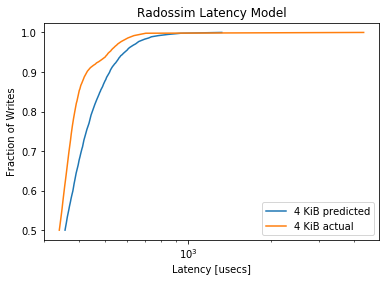

MainProcess pypet INFO     
 Finished single run #1375 of 1680 

MainProcess pypet INFO     
 Starting single run #1376 of 1680 



minimum predicted latency: 216.426126
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2402, pvalue=1.889453338237023e-253)


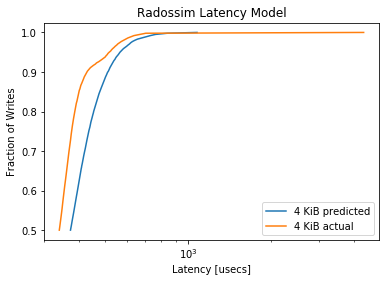

MainProcess pypet INFO     
 Finished single run #1376 of 1680 

MainProcess pypet INFO     
 Starting single run #1377 of 1680 



minimum predicted latency: 204.945747
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.258, pvalue=8.640619513491106e-293)


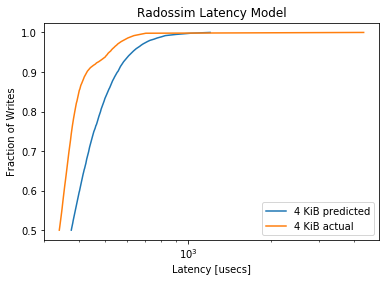

MainProcess pypet INFO     
 Finished single run #1377 of 1680 

MainProcess pypet INFO     
 Starting single run #1378 of 1680 



minimum predicted latency: 220.914067
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.335, pvalue=0.0)


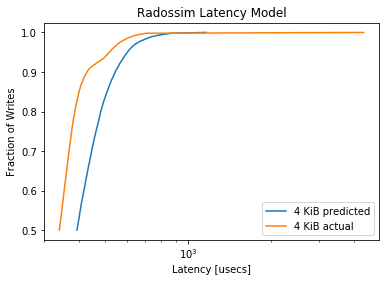

MainProcess pypet INFO     
 Finished single run #1378 of 1680 

MainProcess pypet INFO     
 Starting single run #1379 of 1680 



minimum predicted latency: 204.190497
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3348, pvalue=0.0)


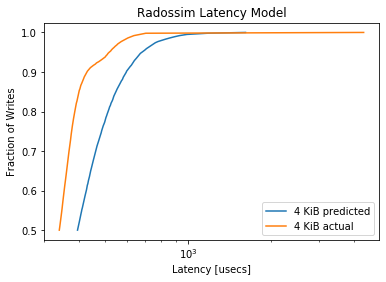

MainProcess pypet INFO     
 Finished single run #1379 of 1680 

MainProcess pypet INFO     
 Starting single run #1380 of 1680 



minimum predicted latency: 194.986862
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4724, pvalue=0.0)


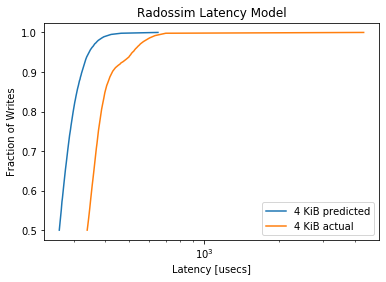

MainProcess pypet INFO     
 Finished single run #1380 of 1680 

MainProcess pypet INFO     
 Starting single run #1381 of 1680 



minimum predicted latency: 183.939537
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4236, pvalue=0.0)


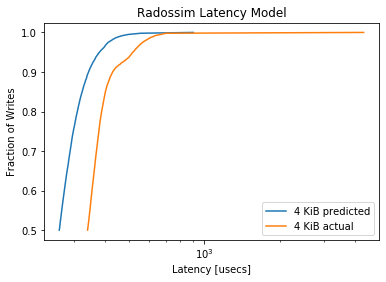

MainProcess pypet INFO     
 Finished single run #1381 of 1680 

MainProcess pypet INFO     
 Starting single run #1382 of 1680 



minimum predicted latency: 197.941133
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.427, pvalue=0.0)


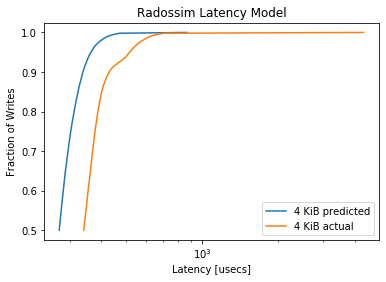

MainProcess pypet INFO     
 Finished single run #1382 of 1680 

MainProcess pypet INFO     
 Starting single run #1383 of 1680 



minimum predicted latency: 187.266641
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3722, pvalue=0.0)


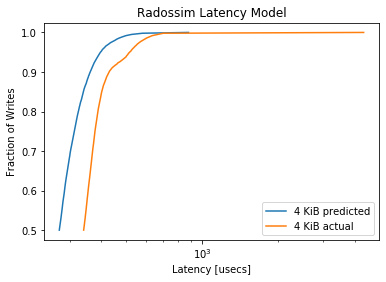

MainProcess pypet INFO     
 Finished single run #1383 of 1680 

MainProcess pypet INFO     
 Starting single run #1384 of 1680 



minimum predicted latency: 201.861077
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3682, pvalue=0.0)


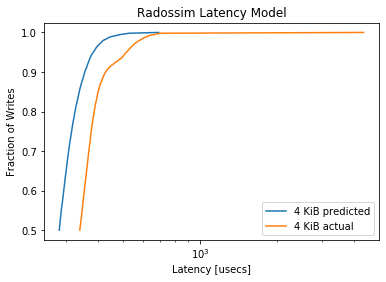

MainProcess pypet INFO     
 Finished single run #1384 of 1680 

MainProcess pypet INFO     
 Starting single run #1385 of 1680 



minimum predicted latency: 188.307167
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3147, pvalue=1e-323)


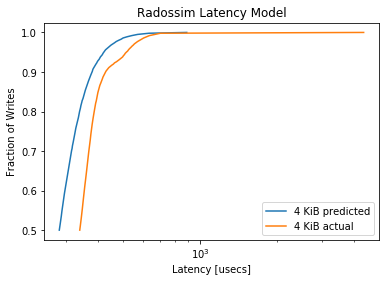

MainProcess pypet INFO     
 Finished single run #1385 of 1680 

MainProcess pypet INFO     
 Starting single run #1386 of 1680 



minimum predicted latency: 202.621634
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2932, pvalue=1e-323)


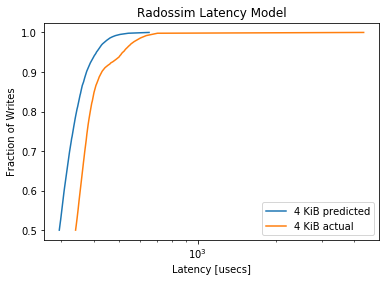

MainProcess pypet INFO     
 Finished single run #1386 of 1680 

MainProcess pypet INFO     
 Starting single run #1387 of 1680 



minimum predicted latency: 193.242518
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.245, pvalue=9.048180511446543e-264)


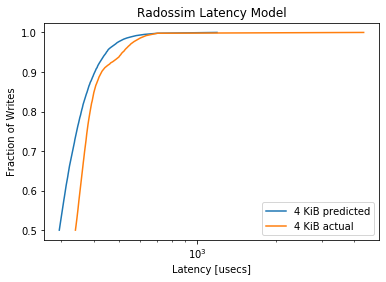

MainProcess pypet INFO     
 Finished single run #1387 of 1680 

MainProcess pypet INFO     
 Starting single run #1388 of 1680 



minimum predicted latency: 201.227957
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2122, pvalue=1.8136507629000206e-197)


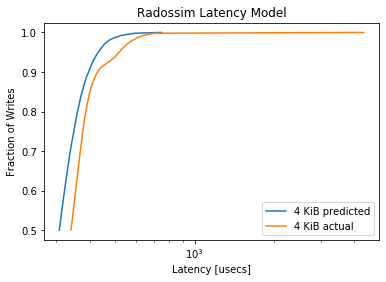

MainProcess pypet INFO     
 Finished single run #1388 of 1680 

MainProcess pypet INFO     
 Starting single run #1389 of 1680 



minimum predicted latency: 191.933538
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1816, pvalue=1.9339843353989674e-144)


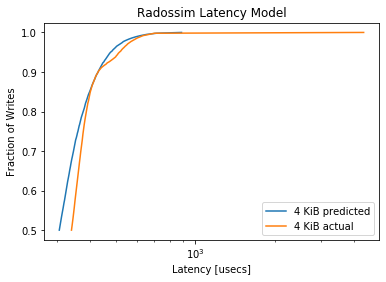

MainProcess pypet INFO     
 Finished single run #1389 of 1680 

MainProcess pypet INFO     
 Starting single run #1390 of 1680 



minimum predicted latency: 198.504397
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1205, pvalue=1.230435386264875e-63)


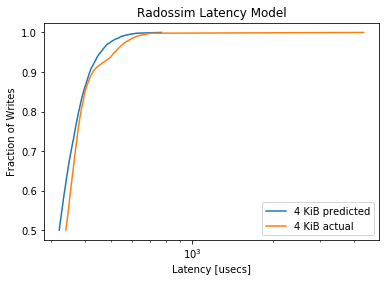

MainProcess pypet INFO     
 Finished single run #1390 of 1680 

MainProcess pypet INFO     
 Starting single run #1391 of 1680 



minimum predicted latency: 197.636171
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1013, pvalue=4.579113268482681e-45)


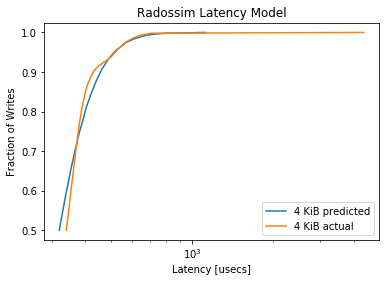

MainProcess pypet INFO     
 Finished single run #1391 of 1680 

MainProcess pypet INFO     
 Starting single run #1392 of 1680 



minimum predicted latency: 207.524025
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.084, pvalue=4.193819117691314e-31)


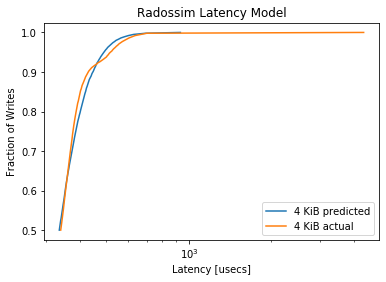

MainProcess pypet INFO     
 Finished single run #1392 of 1680 

MainProcess pypet INFO     
 Starting single run #1393 of 1680 



minimum predicted latency: 196.616118
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1151, pvalue=4.373541734564478e-58)


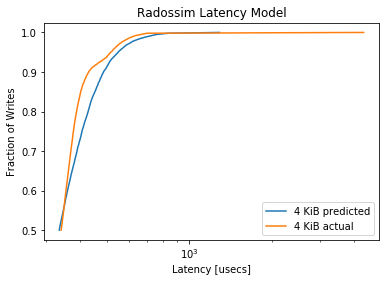

MainProcess pypet INFO     
 Finished single run #1393 of 1680 

MainProcess pypet INFO     
 Starting single run #1394 of 1680 



minimum predicted latency: 209.933615
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1604, pvalue=1.220629344259451e-112)


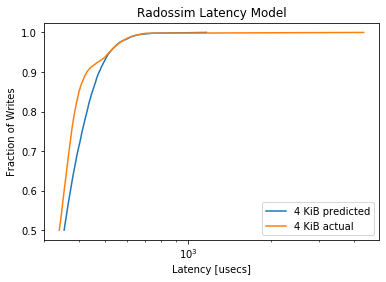

MainProcess pypet INFO     
 Finished single run #1394 of 1680 

MainProcess pypet INFO     
 Starting single run #1395 of 1680 



minimum predicted latency: 206.131118
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1705, pvalue=2.741762065470612e-127)


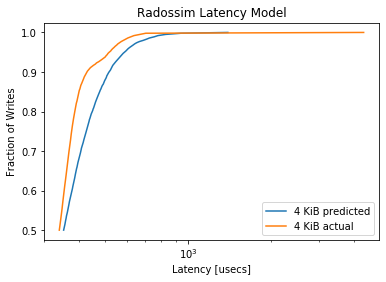

MainProcess pypet INFO     
 Finished single run #1395 of 1680 

MainProcess pypet INFO     
 Starting single run #1396 of 1680 



minimum predicted latency: 217.653269
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2323, pvalue=6.292507138282743e-237)


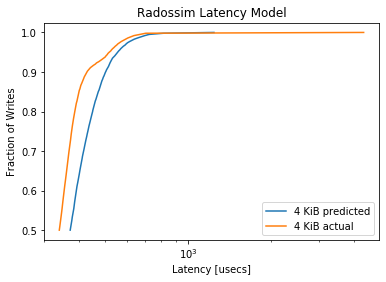

MainProcess pypet INFO     
 Finished single run #1396 of 1680 

MainProcess pypet INFO     
 Starting single run #1397 of 1680 



minimum predicted latency: 206.667414
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2409, pvalue=6.089871302676199e-255)


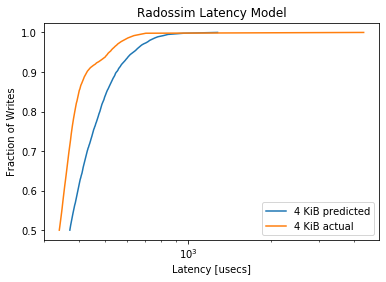

MainProcess pypet INFO     
 Finished single run #1397 of 1680 

MainProcess pypet INFO     
 Starting single run #1398 of 1680 



minimum predicted latency: 218.979632
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3325, pvalue=1e-323)


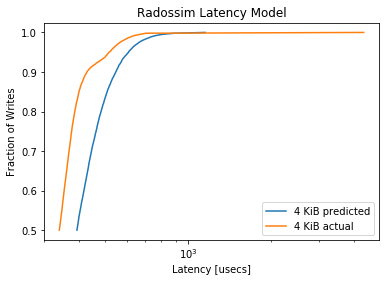

MainProcess pypet INFO     
 Finished single run #1398 of 1680 

MainProcess pypet INFO     
 Starting single run #1399 of 1680 



minimum predicted latency: 211.055480
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.328, pvalue=1e-323)


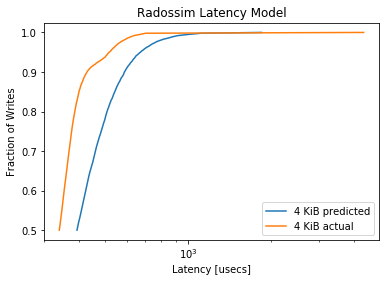

MainProcess pypet INFO     
 Finished single run #1399 of 1680 

MainProcess pypet INFO     
 Starting single run #1400 of 1680 



minimum predicted latency: 194.008616
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4716, pvalue=0.0)


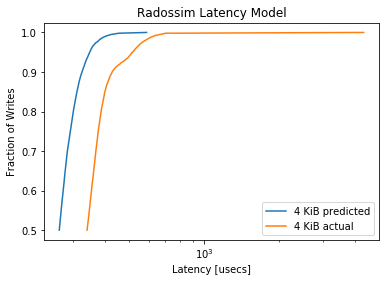

MainProcess pypet INFO     
 Finished single run #1400 of 1680 

MainProcess pypet INFO     
 Starting single run #1401 of 1680 



minimum predicted latency: 185.516249
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4292, pvalue=0.0)


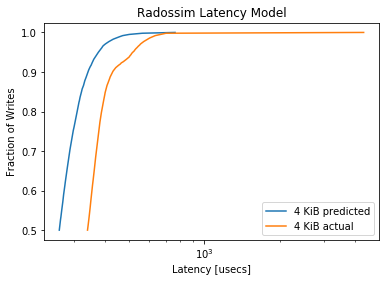

MainProcess pypet INFO     
 Finished single run #1401 of 1680 

MainProcess pypet INFO     
 Starting single run #1402 of 1680 



minimum predicted latency: 195.180766
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4287, pvalue=0.0)


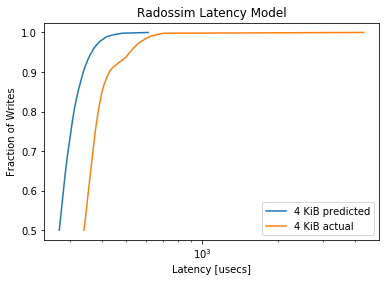

MainProcess pypet INFO     
 Finished single run #1402 of 1680 

MainProcess pypet INFO     
 Starting single run #1403 of 1680 



minimum predicted latency: 189.039067
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3683, pvalue=0.0)


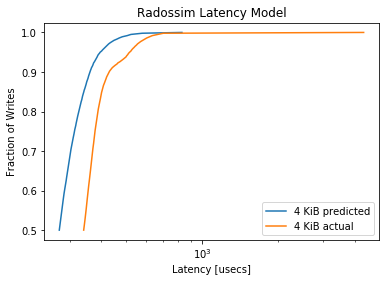

MainProcess pypet INFO     
 Finished single run #1403 of 1680 

MainProcess pypet INFO     
 Starting single run #1404 of 1680 



minimum predicted latency: 197.130937
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3685, pvalue=0.0)


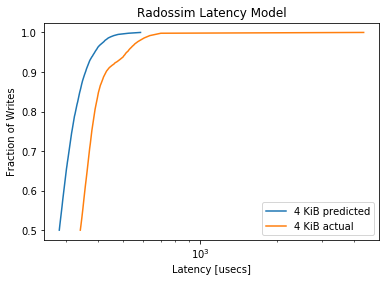

MainProcess pypet INFO     
 Finished single run #1404 of 1680 

MainProcess pypet INFO     
 Starting single run #1405 of 1680 



minimum predicted latency: 191.679002
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3139, pvalue=1e-323)


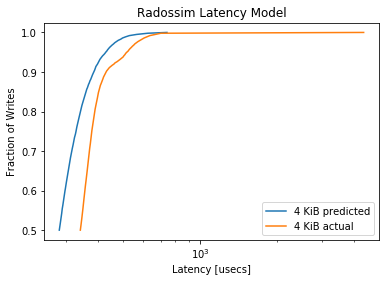

MainProcess pypet INFO     
 Finished single run #1405 of 1680 

MainProcess pypet INFO     
 Starting single run #1406 of 1680 



minimum predicted latency: 198.111821
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2872, pvalue=1e-323)


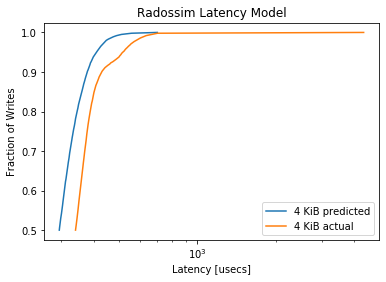

MainProcess pypet INFO     
 Finished single run #1406 of 1680 

MainProcess pypet INFO     
 Starting single run #1407 of 1680 



minimum predicted latency: 186.712219
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2475, pvalue=3.143377627726305e-269)


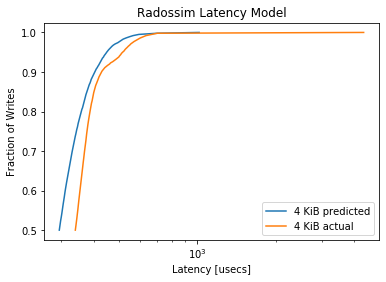

MainProcess pypet INFO     
 Finished single run #1407 of 1680 

MainProcess pypet INFO     
 Starting single run #1408 of 1680 



minimum predicted latency: 198.482109
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2104, pvalue=4.097316589282981e-194)


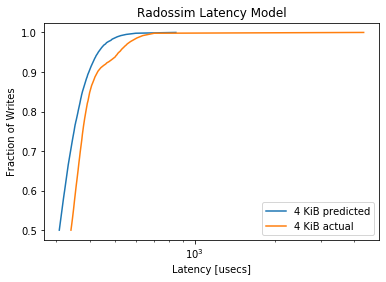

MainProcess pypet INFO     
 Finished single run #1408 of 1680 

MainProcess pypet INFO     
 Starting single run #1409 of 1680 



minimum predicted latency: 188.219861
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1699, pvalue=2.1562747611173453e-126)


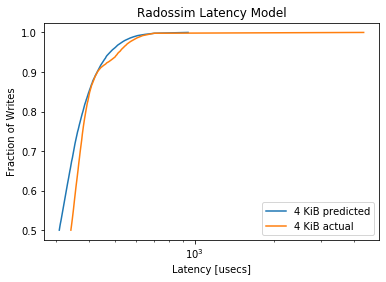

MainProcess pypet INFO     
 Finished single run #1409 of 1680 

MainProcess pypet INFO     
 Starting single run #1410 of 1680 



minimum predicted latency: 207.675725
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1201, pvalue=3.23620921283468e-63)


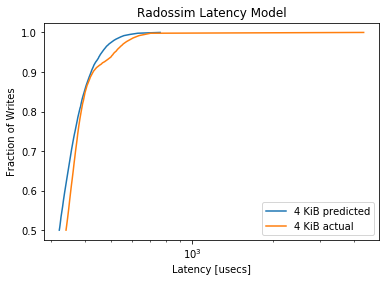

MainProcess pypet INFO     
 Finished single run #1410 of 1680 

MainProcess pypet INFO     
 Starting single run #1411 of 1680 



minimum predicted latency: 196.070512
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1108, pvalue=7.538954090289629e-54)


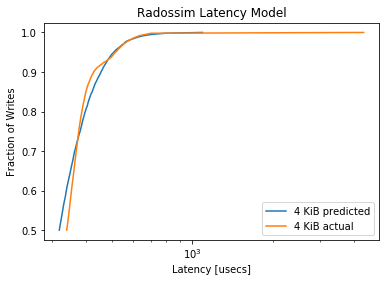

MainProcess pypet INFO     
 Finished single run #1411 of 1680 

MainProcess pypet INFO     
 Starting single run #1412 of 1680 



minimum predicted latency: 203.365899
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1012, pvalue=5.610789321962591e-45)


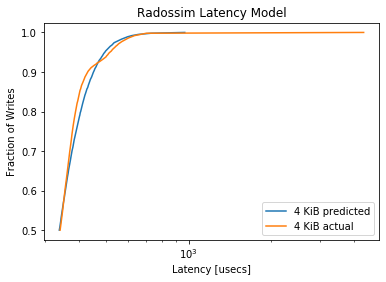

MainProcess pypet INFO     
 Finished single run #1412 of 1680 

MainProcess pypet INFO     
 Starting single run #1413 of 1680 



minimum predicted latency: 199.402052
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.112, pvalue=5.145181948464442e-55)


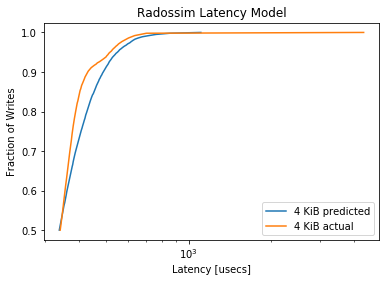

MainProcess pypet INFO     
 Finished single run #1413 of 1680 

MainProcess pypet INFO     
 Starting single run #1414 of 1680 



minimum predicted latency: 213.472043
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.159, pvalue=1.1097946158941226e-110)


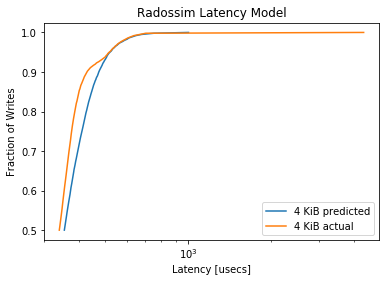

MainProcess pypet INFO     
 Finished single run #1414 of 1680 

MainProcess pypet INFO     
 Starting single run #1415 of 1680 



minimum predicted latency: 202.640720
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1767, pvalue=9.86353874534622e-137)


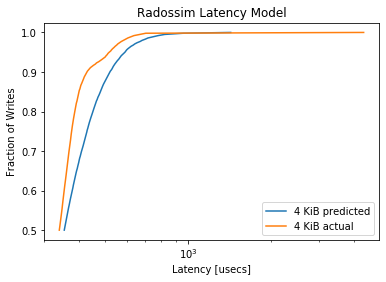

MainProcess pypet INFO     
 Finished single run #1415 of 1680 

MainProcess pypet INFO     
 Starting single run #1416 of 1680 



minimum predicted latency: 221.477918
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2301, pvalue=1.985763149302943e-232)


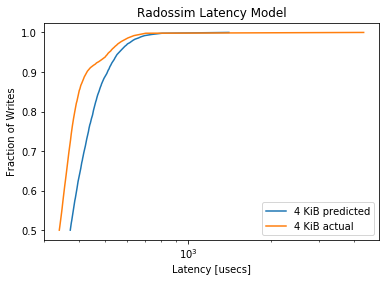

MainProcess pypet INFO     
 Finished single run #1416 of 1680 

MainProcess pypet INFO     
 Starting single run #1417 of 1680 



minimum predicted latency: 202.309002
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2443, pvalue=2.9838383186945055e-262)


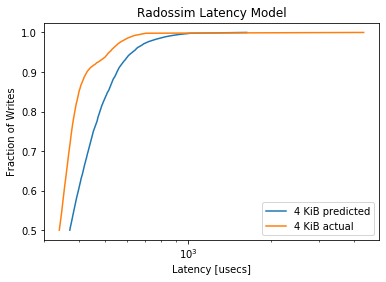

MainProcess pypet INFO     
 Finished single run #1417 of 1680 

MainProcess pypet INFO     
 Starting single run #1418 of 1680 



minimum predicted latency: 223.793933
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3385, pvalue=0.0)


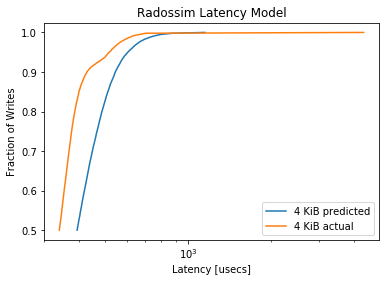

MainProcess pypet INFO     
 Finished single run #1418 of 1680 

MainProcess pypet INFO     
 Starting single run #1419 of 1680 



minimum predicted latency: 196.442896
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3233, pvalue=1e-323)


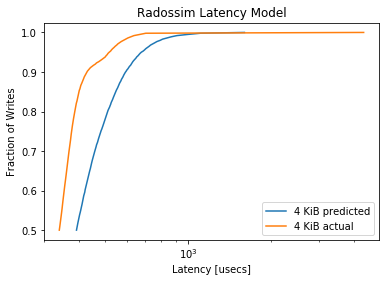

MainProcess pypet INFO     
 Finished single run #1419 of 1680 

MainProcess pypet INFO     
 Starting single run #1420 of 1680 



minimum predicted latency: 190.327668
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.469, pvalue=0.0)


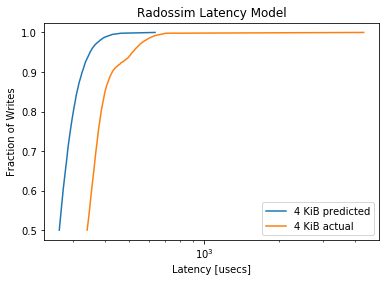

MainProcess pypet INFO     
 Finished single run #1420 of 1680 

MainProcess pypet INFO     
 Starting single run #1421 of 1680 



minimum predicted latency: 183.411748
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.428, pvalue=0.0)


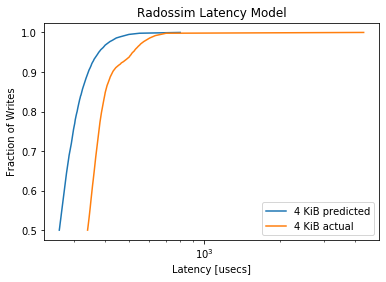

MainProcess pypet INFO     
 Finished single run #1421 of 1680 

MainProcess pypet INFO     
 Starting single run #1422 of 1680 



minimum predicted latency: 193.429583
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4232, pvalue=0.0)


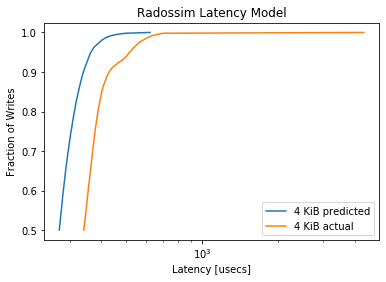

MainProcess pypet INFO     
 Finished single run #1422 of 1680 

MainProcess pypet INFO     
 Starting single run #1423 of 1680 



minimum predicted latency: 190.359113
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3727, pvalue=0.0)


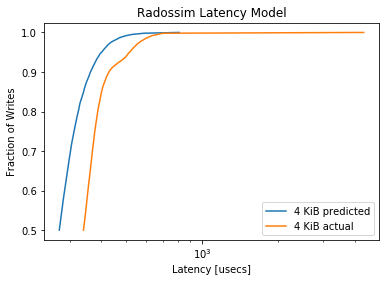

MainProcess pypet INFO     
 Finished single run #1423 of 1680 

MainProcess pypet INFO     
 Starting single run #1424 of 1680 



minimum predicted latency: 194.719635
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3673, pvalue=0.0)


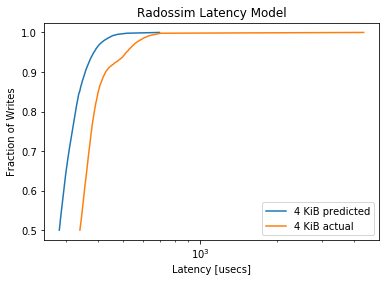

MainProcess pypet INFO     
 Finished single run #1424 of 1680 

MainProcess pypet INFO     
 Starting single run #1425 of 1680 



minimum predicted latency: 188.332912
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3162, pvalue=1e-323)


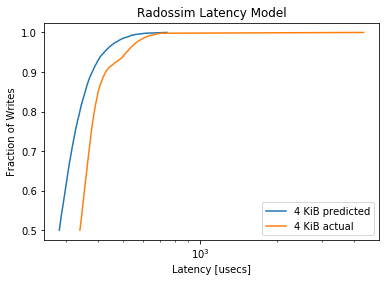

MainProcess pypet INFO     
 Finished single run #1425 of 1680 

MainProcess pypet INFO     
 Starting single run #1426 of 1680 



minimum predicted latency: 194.649291
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2962, pvalue=1e-323)


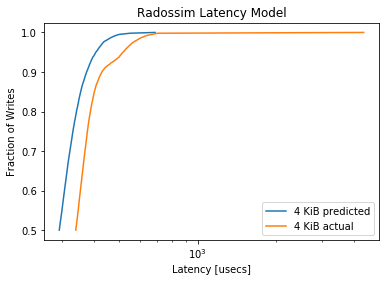

MainProcess pypet INFO     
 Finished single run #1426 of 1680 

MainProcess pypet INFO     
 Starting single run #1427 of 1680 



minimum predicted latency: 193.357705
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2478, pvalue=6.893065230785126e-270)


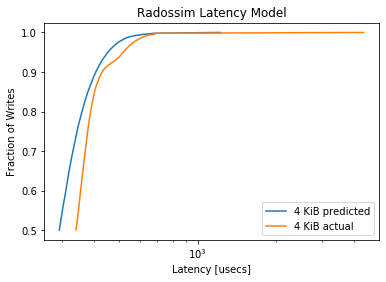

MainProcess pypet INFO     
 Finished single run #1427 of 1680 

MainProcess pypet INFO     PROGRESS: Finished 1428/1680 runs [=================   ] 85.0%, remaining: 0:01:31
MainProcess pypet INFO     
 Starting single run #1428 of 1680 



minimum predicted latency: 200.607287
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2131, pvalue=3.7199049008862096e-199)


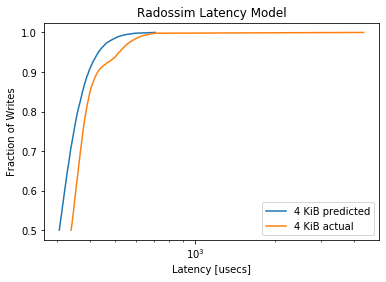

MainProcess pypet INFO     
 Finished single run #1428 of 1680 

MainProcess pypet INFO     
 Starting single run #1429 of 1680 



minimum predicted latency: 197.743660
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1807, pvalue=5.2274051049248315e-143)


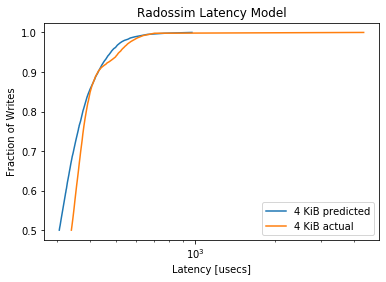

MainProcess pypet INFO     
 Finished single run #1429 of 1680 

MainProcess pypet INFO     
 Starting single run #1430 of 1680 



minimum predicted latency: 207.874670
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1243, pvalue=1.0713200084858182e-67)


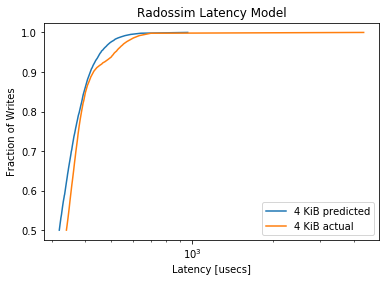

MainProcess pypet INFO     
 Finished single run #1430 of 1680 

MainProcess pypet INFO     
 Starting single run #1431 of 1680 



minimum predicted latency: 192.344828
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1081, pvalue=2.8465401865673404e-51)


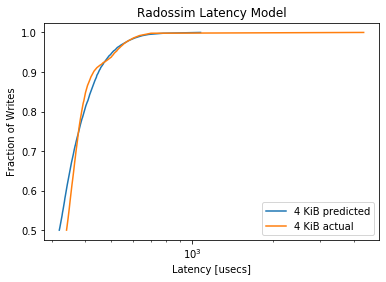

MainProcess pypet INFO     
 Finished single run #1431 of 1680 

MainProcess pypet INFO     
 Starting single run #1432 of 1680 



minimum predicted latency: 207.326077
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1016, pvalue=2.4861488259360158e-45)


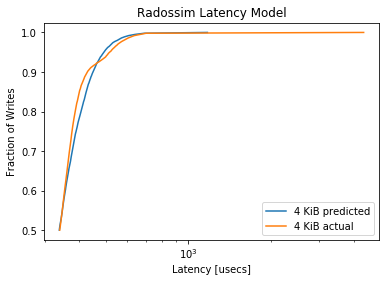

MainProcess pypet INFO     
 Finished single run #1432 of 1680 

MainProcess pypet INFO     
 Starting single run #1433 of 1680 



minimum predicted latency: 200.735436
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.107, pvalue=3.0608311306847284e-50)


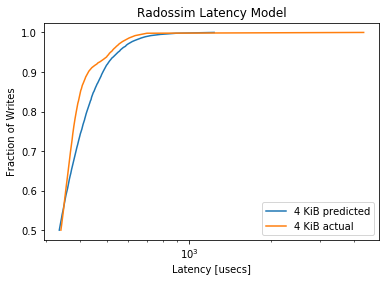

MainProcess pypet INFO     
 Finished single run #1433 of 1680 

MainProcess pypet INFO     
 Starting single run #1434 of 1680 



minimum predicted latency: 216.538955
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1727, pvalue=1.3376216259387205e-130)


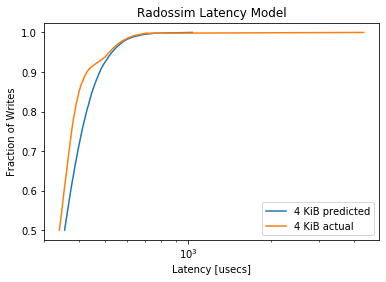

MainProcess pypet INFO     
 Finished single run #1434 of 1680 

MainProcess pypet INFO     
 Starting single run #1435 of 1680 



minimum predicted latency: 198.776344
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1829, pvalue=1.6047414119528493e-146)


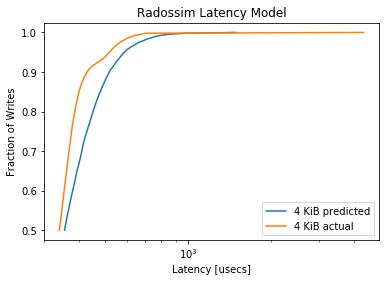

MainProcess pypet INFO     
 Finished single run #1435 of 1680 

MainProcess pypet INFO     
 Starting single run #1436 of 1680 



minimum predicted latency: 219.733945
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2389, pvalue=1.0831962218414765e-250)


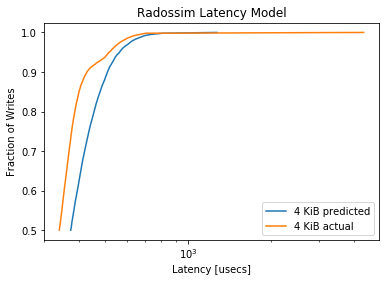

MainProcess pypet INFO     
 Finished single run #1436 of 1680 

MainProcess pypet INFO     
 Starting single run #1437 of 1680 



minimum predicted latency: 205.281927
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2499, pvalue=1.5929299724850305e-274)


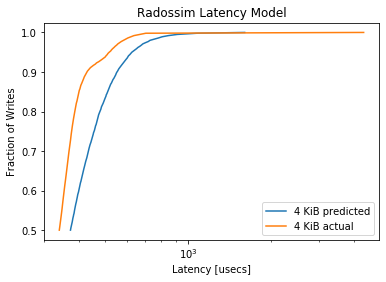

MainProcess pypet INFO     
 Finished single run #1437 of 1680 

MainProcess pypet INFO     
 Starting single run #1438 of 1680 



minimum predicted latency: 208.774287
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3453, pvalue=0.0)


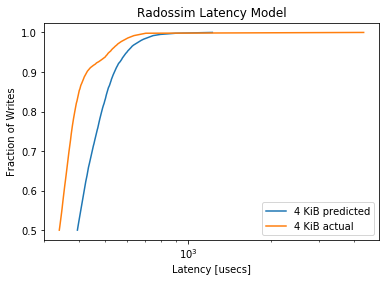

MainProcess pypet INFO     
 Finished single run #1438 of 1680 

MainProcess pypet INFO     
 Starting single run #1439 of 1680 



minimum predicted latency: 201.907492
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3329, pvalue=1e-323)


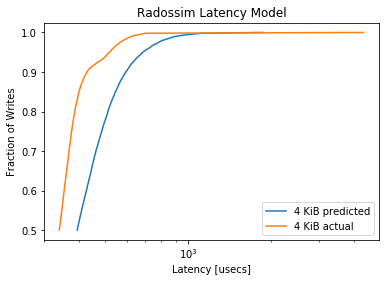

MainProcess pypet INFO     
 Finished single run #1439 of 1680 

MainProcess pypet INFO     
 Starting single run #1440 of 1680 



minimum predicted latency: 192.347688
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4738, pvalue=0.0)


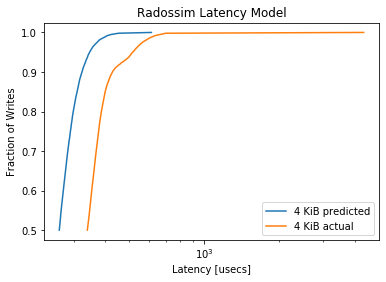

MainProcess pypet INFO     
 Finished single run #1440 of 1680 

MainProcess pypet INFO     
 Starting single run #1441 of 1680 



minimum predicted latency: 183.187134
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4255, pvalue=0.0)


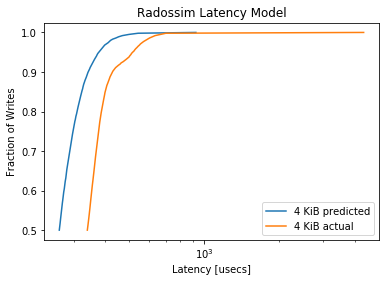

MainProcess pypet INFO     
 Finished single run #1441 of 1680 

MainProcess pypet INFO     
 Starting single run #1442 of 1680 



minimum predicted latency: 196.052143
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4325, pvalue=0.0)


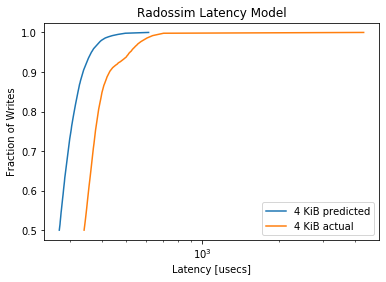

MainProcess pypet INFO     
 Finished single run #1442 of 1680 

MainProcess pypet INFO     
 Starting single run #1443 of 1680 



minimum predicted latency: 182.394500
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3723, pvalue=0.0)


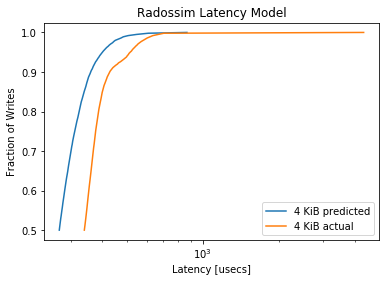

MainProcess pypet INFO     
 Finished single run #1443 of 1680 

MainProcess pypet INFO     
 Starting single run #1444 of 1680 



minimum predicted latency: 200.204274
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3709, pvalue=0.0)


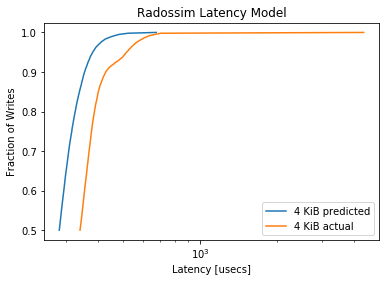

MainProcess pypet INFO     
 Finished single run #1444 of 1680 

MainProcess pypet INFO     
 Starting single run #1445 of 1680 



minimum predicted latency: 185.987066
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3219, pvalue=1e-323)


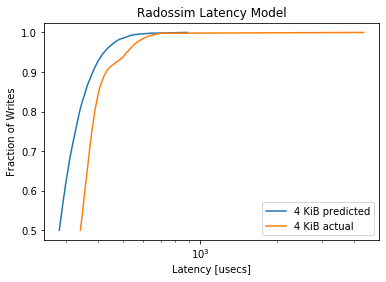

MainProcess pypet INFO     
 Finished single run #1445 of 1680 

MainProcess pypet INFO     
 Starting single run #1446 of 1680 



minimum predicted latency: 194.846138
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3012, pvalue=1e-323)


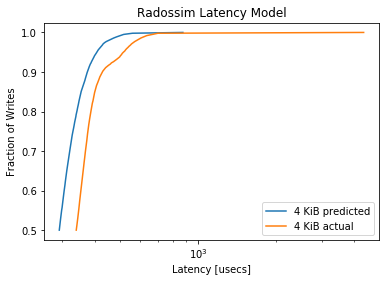

MainProcess pypet INFO     
 Finished single run #1446 of 1680 

MainProcess pypet INFO     
 Starting single run #1447 of 1680 



minimum predicted latency: 185.135665
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2493, pvalue=3.396225485777185e-273)


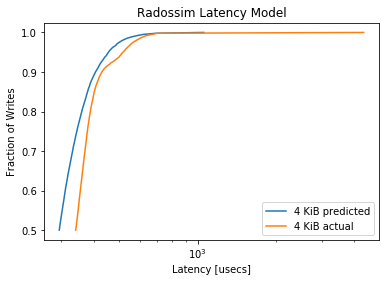

MainProcess pypet INFO     
 Finished single run #1447 of 1680 

MainProcess pypet INFO     
 Starting single run #1448 of 1680 



minimum predicted latency: 197.587357
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2291, pvalue=2.129600678930915e-230)


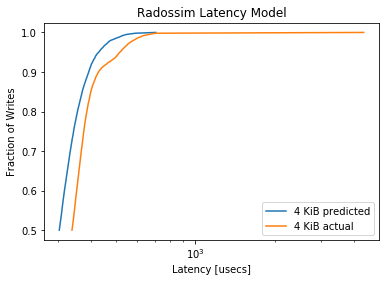

MainProcess pypet INFO     
 Finished single run #1448 of 1680 

MainProcess pypet INFO     
 Starting single run #1449 of 1680 



minimum predicted latency: 192.173017
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1801, pvalue=4.664457138438061e-142)


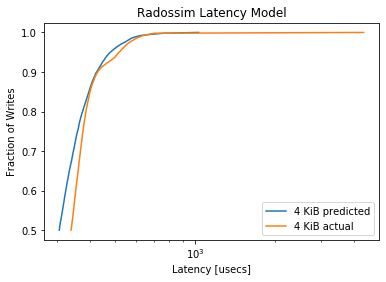

MainProcess pypet INFO     
 Finished single run #1449 of 1680 

MainProcess pypet INFO     
 Starting single run #1450 of 1680 



minimum predicted latency: 207.182889
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1231, pvalue=2.11750643807456e-66)


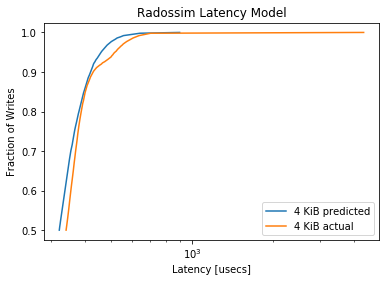

MainProcess pypet INFO     
 Finished single run #1450 of 1680 

MainProcess pypet INFO     
 Starting single run #1451 of 1680 



minimum predicted latency: 193.018717
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.112, pvalue=5.145181948464442e-55)


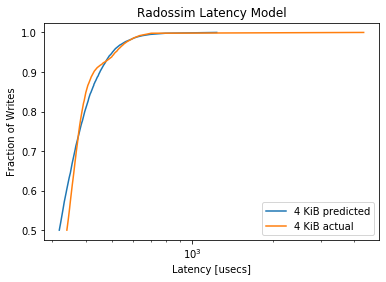

MainProcess pypet INFO     
 Finished single run #1451 of 1680 

MainProcess pypet INFO     
 Starting single run #1452 of 1680 



minimum predicted latency: 211.253592
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0876, pvalue=8.574949220310642e-34)


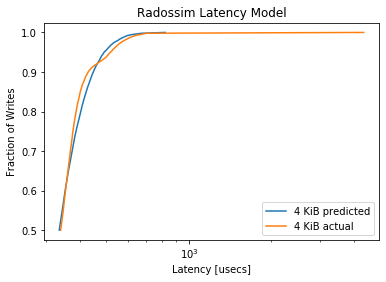

MainProcess pypet INFO     
 Finished single run #1452 of 1680 

MainProcess pypet INFO     
 Starting single run #1453 of 1680 



minimum predicted latency: 199.807963
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1116, pvalue=1.2631201963248458e-54)


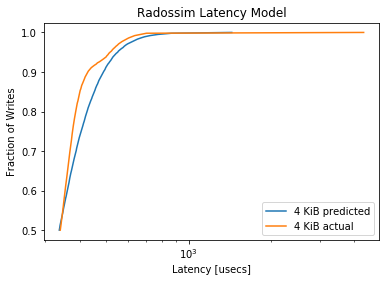

MainProcess pypet INFO     
 Finished single run #1453 of 1680 

MainProcess pypet INFO     
 Starting single run #1454 of 1680 



minimum predicted latency: 220.566933
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1574, pvalue=1.82946703018695e-108)


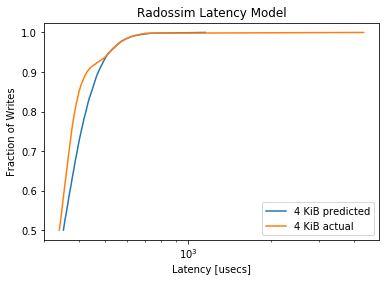

MainProcess pypet INFO     
 Finished single run #1454 of 1680 

MainProcess pypet INFO     
 Starting single run #1455 of 1680 



minimum predicted latency: 190.926107
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1722, pvalue=7.634755692616835e-130)


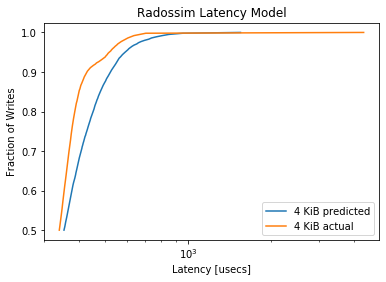

MainProcess pypet INFO     
 Finished single run #1455 of 1680 

MainProcess pypet INFO     
 Starting single run #1456 of 1680 



minimum predicted latency: 214.963757
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2262, pvalue=1.4606708825147575e-224)


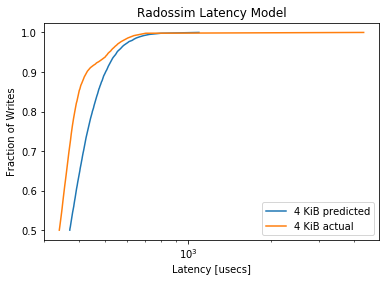

MainProcess pypet INFO     
 Finished single run #1456 of 1680 

MainProcess pypet INFO     
 Starting single run #1457 of 1680 



minimum predicted latency: 194.426421
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2412, pvalue=1.392878102579388e-255)


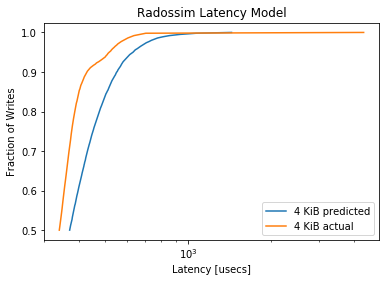

MainProcess pypet INFO     
 Finished single run #1457 of 1680 

MainProcess pypet INFO     
 Starting single run #1458 of 1680 



minimum predicted latency: 218.081611
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3347, pvalue=0.0)


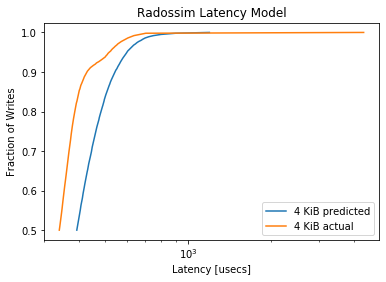

MainProcess pypet INFO     
 Finished single run #1458 of 1680 

MainProcess pypet INFO     
 Starting single run #1459 of 1680 



minimum predicted latency: 210.913370
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3193, pvalue=1e-323)


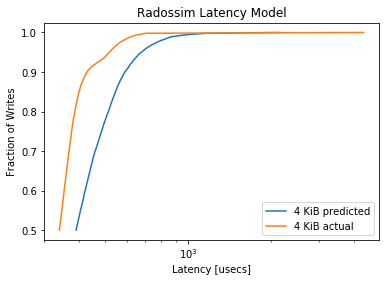

MainProcess pypet INFO     
 Finished single run #1459 of 1680 

MainProcess pypet INFO     
 Starting single run #1460 of 1680 



minimum predicted latency: 190.618265
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4786, pvalue=0.0)


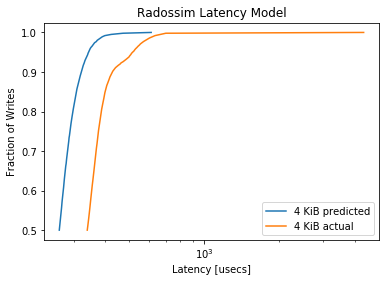

MainProcess pypet INFO     
 Finished single run #1460 of 1680 

MainProcess pypet INFO     
 Starting single run #1461 of 1680 



minimum predicted latency: 182.674714
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4234, pvalue=0.0)


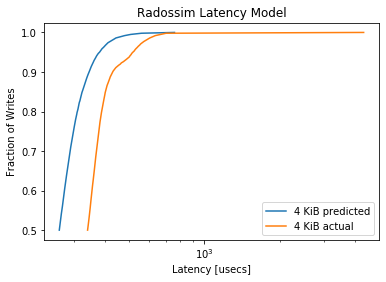

MainProcess pypet INFO     
 Finished single run #1461 of 1680 

MainProcess pypet INFO     
 Starting single run #1462 of 1680 



minimum predicted latency: 194.972567
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4268, pvalue=0.0)


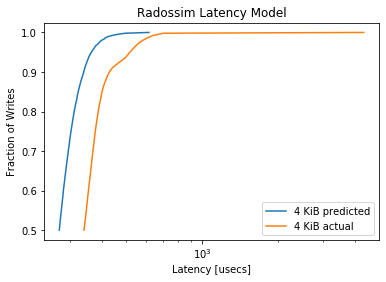

MainProcess pypet INFO     
 Finished single run #1462 of 1680 

MainProcess pypet INFO     
 Starting single run #1463 of 1680 



minimum predicted latency: 186.810510
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3759, pvalue=0.0)


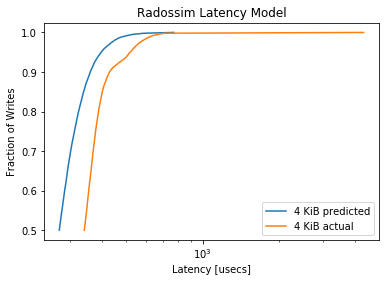

MainProcess pypet INFO     
 Finished single run #1463 of 1680 

MainProcess pypet INFO     
 Starting single run #1464 of 1680 



minimum predicted latency: 196.183977
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3693, pvalue=0.0)


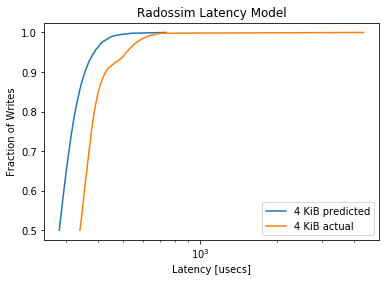

MainProcess pypet INFO     
 Finished single run #1464 of 1680 

MainProcess pypet INFO     
 Starting single run #1465 of 1680 



minimum predicted latency: 187.515047
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3144, pvalue=1e-323)


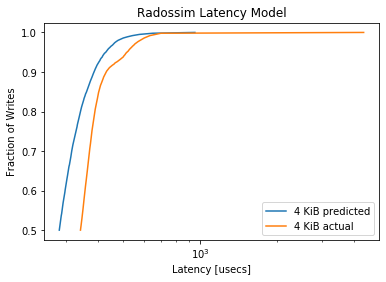

MainProcess pypet INFO     
 Finished single run #1465 of 1680 

MainProcess pypet INFO     
 Starting single run #1466 of 1680 



minimum predicted latency: 194.717603
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2978, pvalue=1e-323)


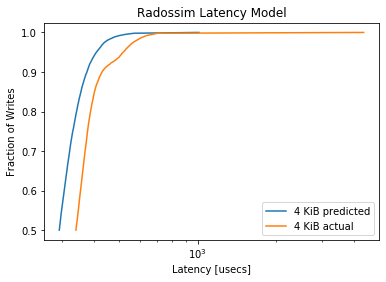

MainProcess pypet INFO     
 Finished single run #1466 of 1680 

MainProcess pypet INFO     
 Starting single run #1467 of 1680 



minimum predicted latency: 189.815434
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2574, pvalue=2.0438951131242388e-291)


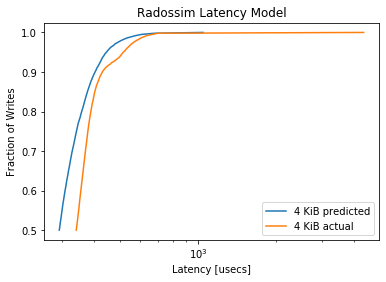

MainProcess pypet INFO     
 Finished single run #1467 of 1680 

MainProcess pypet INFO     
 Starting single run #1468 of 1680 



minimum predicted latency: 204.898710
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2183, pvalue=4.7110756681238793e-209)


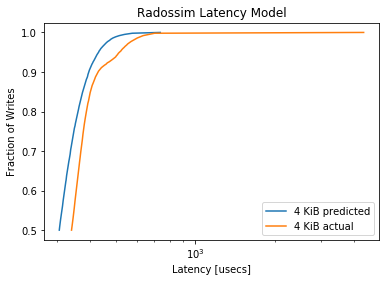

MainProcess pypet INFO     
 Finished single run #1468 of 1680 

MainProcess pypet INFO     
 Starting single run #1469 of 1680 



minimum predicted latency: 191.383596
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1763, pvalue=4.108794584496933e-136)


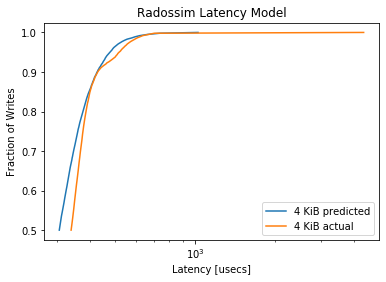

MainProcess pypet INFO     
 Finished single run #1469 of 1680 

MainProcess pypet INFO     
 Starting single run #1470 of 1680 



minimum predicted latency: 206.154911
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1289, pvalue=8.801674492710776e-73)


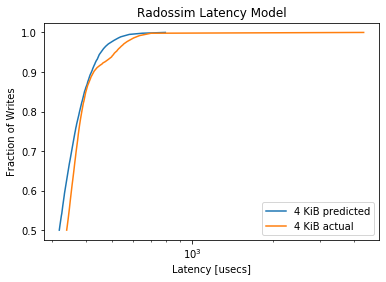

MainProcess pypet INFO     
 Finished single run #1470 of 1680 

MainProcess pypet INFO     
 Starting single run #1471 of 1680 



minimum predicted latency: 196.647266
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1074, pvalue=1.2941082951613566e-50)


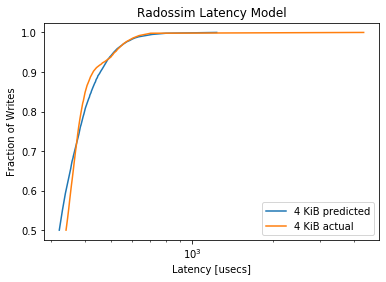

MainProcess pypet INFO     
 Finished single run #1471 of 1680 

MainProcess pypet INFO     
 Starting single run #1472 of 1680 



minimum predicted latency: 209.776834
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0898, pvalue=1.7135055745556546e-35)


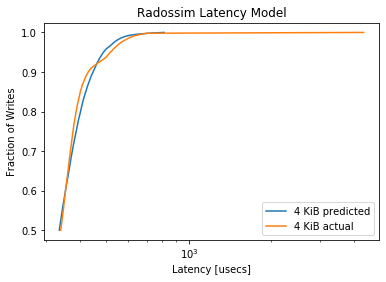

MainProcess pypet INFO     
 Finished single run #1472 of 1680 

MainProcess pypet INFO     
 Starting single run #1473 of 1680 



minimum predicted latency: 195.347313
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0986, pvalue=1.0292829299760363e-42)


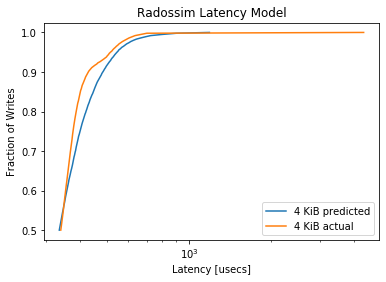

MainProcess pypet INFO     
 Finished single run #1473 of 1680 

MainProcess pypet INFO     
 Starting single run #1474 of 1680 



minimum predicted latency: 210.706679
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1609, pvalue=2.4145082506625753e-113)


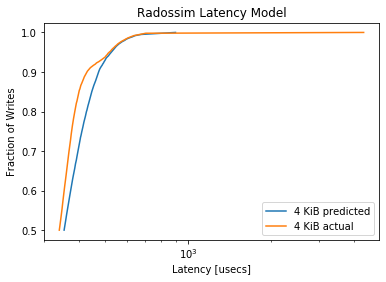

MainProcess pypet INFO     
 Finished single run #1474 of 1680 

MainProcess pypet INFO     
 Starting single run #1475 of 1680 



minimum predicted latency: 198.201545
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1743, pvalue=4.9047091197017545e-133)


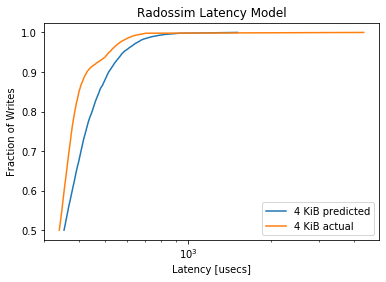

MainProcess pypet INFO     
 Finished single run #1475 of 1680 

MainProcess pypet INFO     
 Starting single run #1476 of 1680 



minimum predicted latency: 216.561088
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2289, pvalue=5.410933505655304e-230)


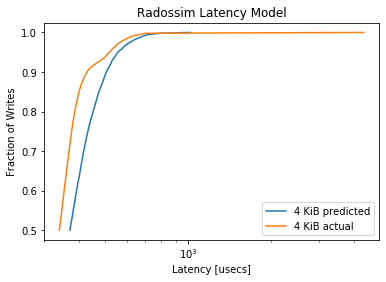

MainProcess pypet INFO     
 Finished single run #1476 of 1680 

MainProcess pypet INFO     
 Starting single run #1477 of 1680 



minimum predicted latency: 194.011184
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2428, pvalue=5.1624121156963856e-259)


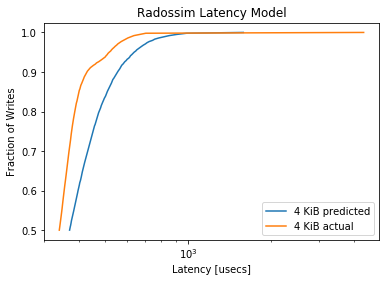

MainProcess pypet INFO     
 Finished single run #1477 of 1680 

MainProcess pypet INFO     
 Starting single run #1478 of 1680 



minimum predicted latency: 228.534643
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3244, pvalue=1e-323)


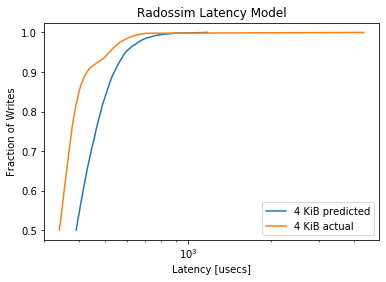

MainProcess pypet INFO     
 Finished single run #1478 of 1680 

MainProcess pypet INFO     
 Starting single run #1479 of 1680 



minimum predicted latency: 208.874757
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.317, pvalue=1e-323)


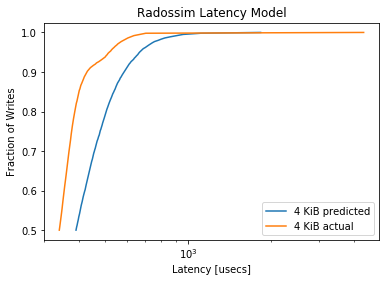

MainProcess pypet INFO     
 Finished single run #1479 of 1680 

MainProcess pypet INFO     
 Starting single run #1480 of 1680 



minimum predicted latency: 187.942887
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4752, pvalue=0.0)


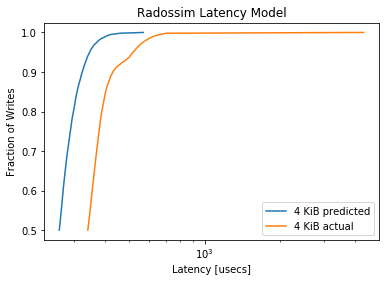

MainProcess pypet INFO     
 Finished single run #1480 of 1680 

MainProcess pypet INFO     
 Starting single run #1481 of 1680 



minimum predicted latency: 186.896432
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4281, pvalue=0.0)


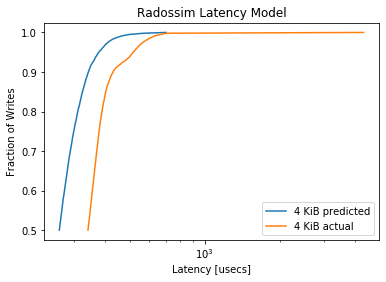

MainProcess pypet INFO     
 Finished single run #1481 of 1680 

MainProcess pypet INFO     
 Starting single run #1482 of 1680 



minimum predicted latency: 194.330115
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4335, pvalue=0.0)


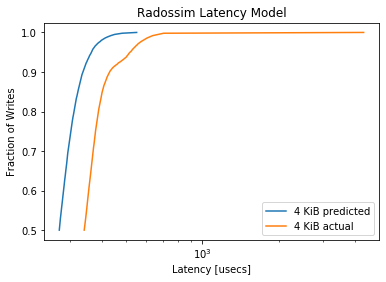

MainProcess pypet INFO     
 Finished single run #1482 of 1680 

MainProcess pypet INFO     
 Starting single run #1483 of 1680 



minimum predicted latency: 187.284100
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3731, pvalue=0.0)


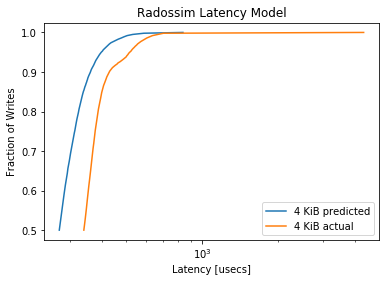

MainProcess pypet INFO     
 Finished single run #1483 of 1680 

MainProcess pypet INFO     
 Starting single run #1484 of 1680 



minimum predicted latency: 193.535719
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3683, pvalue=0.0)


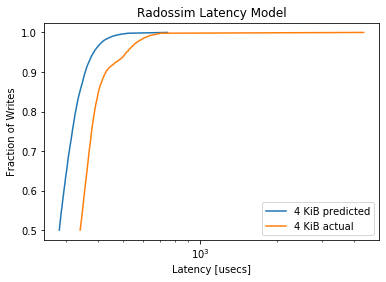

MainProcess pypet INFO     
 Finished single run #1484 of 1680 

MainProcess pypet INFO     
 Starting single run #1485 of 1680 



minimum predicted latency: 192.836516
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3171, pvalue=1e-323)


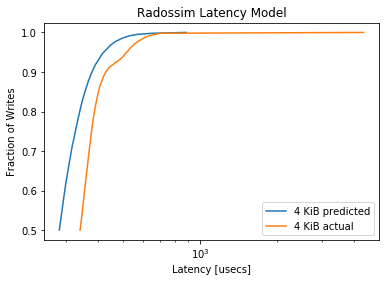

MainProcess pypet INFO     
 Finished single run #1485 of 1680 

MainProcess pypet INFO     
 Starting single run #1486 of 1680 



minimum predicted latency: 202.583760
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2972, pvalue=1e-323)


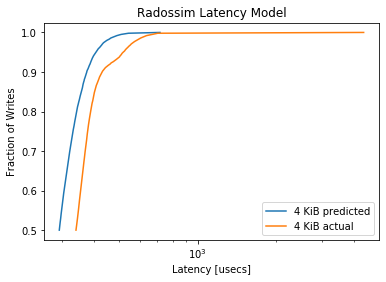

MainProcess pypet INFO     
 Finished single run #1486 of 1680 

MainProcess pypet INFO     
 Starting single run #1487 of 1680 



minimum predicted latency: 191.954129
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2561, pvalue=1.887059441114432e-288)


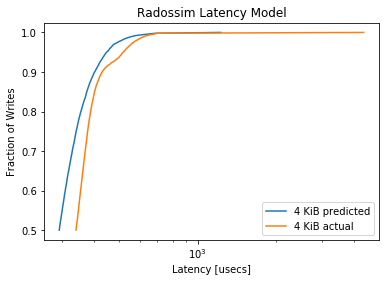

MainProcess pypet INFO     
 Finished single run #1487 of 1680 

MainProcess pypet INFO     
 Starting single run #1488 of 1680 



minimum predicted latency: 206.711431
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2087, pvalue=5.66341909108645e-191)


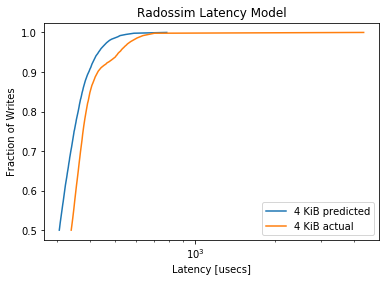

MainProcess pypet INFO     
 Finished single run #1488 of 1680 

MainProcess pypet INFO     
 Starting single run #1489 of 1680 



minimum predicted latency: 195.281064
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.181, pvalue=1.7450851279821908e-143)


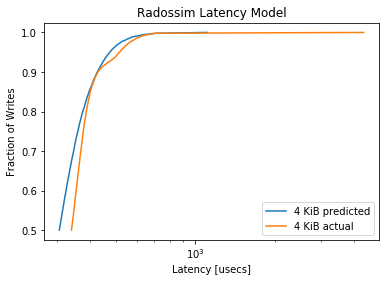

MainProcess pypet INFO     
 Finished single run #1489 of 1680 

MainProcess pypet INFO     
 Starting single run #1490 of 1680 



minimum predicted latency: 209.273508
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1185, pvalue=1.4991634323247672e-61)


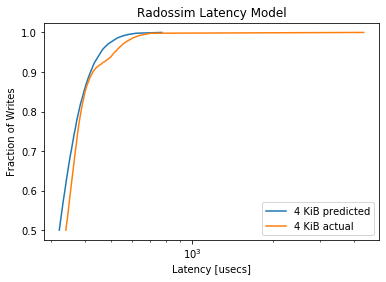

MainProcess pypet INFO     
 Finished single run #1490 of 1680 

MainProcess pypet INFO     
 Starting single run #1491 of 1680 



minimum predicted latency: 184.902332
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1091, pvalue=3.2161960894450104e-52)


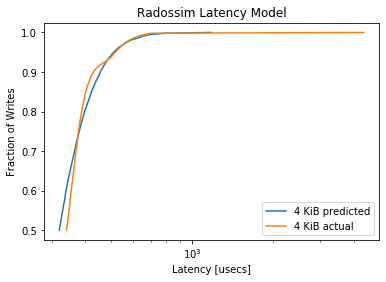

MainProcess pypet INFO     
 Finished single run #1491 of 1680 

MainProcess pypet INFO     
 Starting single run #1492 of 1680 



minimum predicted latency: 210.862573
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0877, pvalue=7.192960989805489e-34)


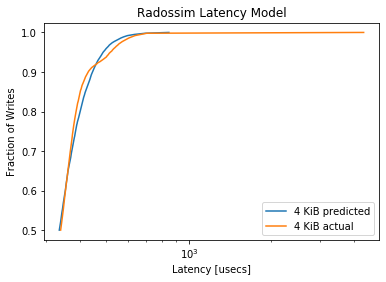

MainProcess pypet INFO     
 Finished single run #1492 of 1680 

MainProcess pypet INFO     
 Starting single run #1493 of 1680 



minimum predicted latency: 192.462024
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1057, pvalue=4.911394967593853e-49)


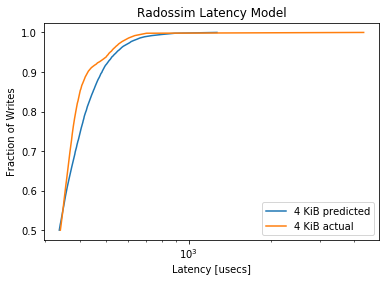

MainProcess pypet INFO     
 Finished single run #1493 of 1680 

MainProcess pypet INFO     
 Starting single run #1494 of 1680 



minimum predicted latency: 202.578280
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1569, pvalue=8.922497958950735e-108)


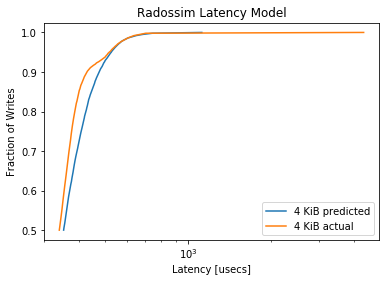

MainProcess pypet INFO     
 Finished single run #1494 of 1680 

MainProcess pypet INFO     
 Starting single run #1495 of 1680 



minimum predicted latency: 194.202077
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1639, pvalue=1.2985978514418983e-117)


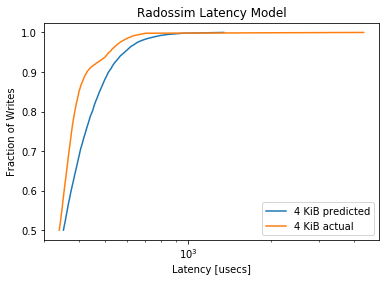

MainProcess pypet INFO     
 Finished single run #1495 of 1680 

MainProcess pypet INFO     
 Starting single run #1496 of 1680 



minimum predicted latency: 219.488253
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2298, pvalue=8.090985365265901e-232)


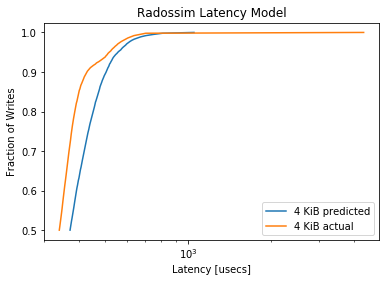

MainProcess pypet INFO     
 Finished single run #1496 of 1680 

MainProcess pypet INFO     
 Starting single run #1497 of 1680 



minimum predicted latency: 200.543630
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2428, pvalue=5.1624121156963856e-259)


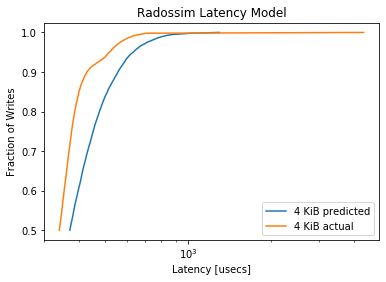

MainProcess pypet INFO     
 Finished single run #1497 of 1680 

MainProcess pypet INFO     
 Starting single run #1498 of 1680 



minimum predicted latency: 208.813357
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3296, pvalue=1e-323)


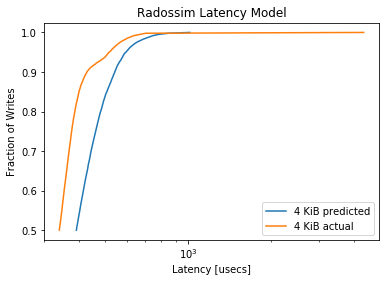

MainProcess pypet INFO     
 Finished single run #1498 of 1680 

MainProcess pypet INFO     
 Starting single run #1499 of 1680 



minimum predicted latency: 207.821059
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3207, pvalue=1e-323)


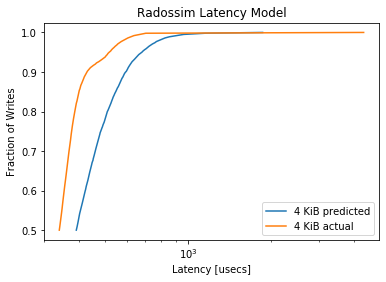

MainProcess pypet INFO     
 Finished single run #1499 of 1680 

MainProcess pypet INFO     
 Starting single run #1500 of 1680 



minimum predicted latency: 185.675618
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4774, pvalue=0.0)


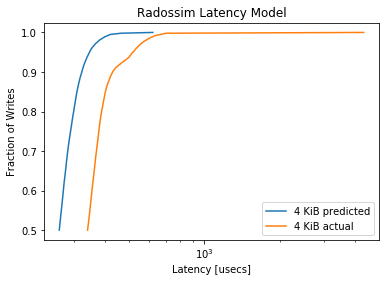

MainProcess pypet INFO     
 Finished single run #1500 of 1680 

MainProcess pypet INFO     
 Starting single run #1501 of 1680 



minimum predicted latency: 185.767989
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4286, pvalue=0.0)


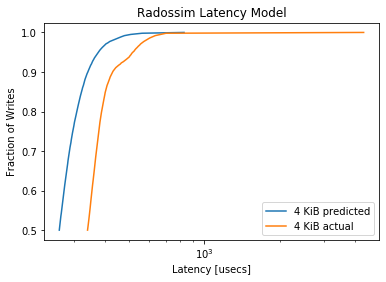

MainProcess pypet INFO     
 Finished single run #1501 of 1680 

MainProcess pypet INFO     
 Starting single run #1502 of 1680 



minimum predicted latency: 192.845787
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4318, pvalue=0.0)


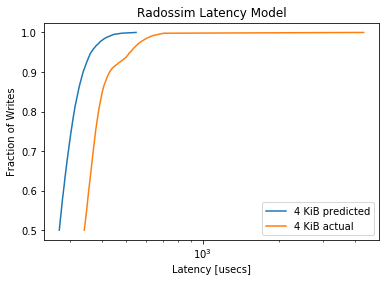

MainProcess pypet INFO     
 Finished single run #1502 of 1680 

MainProcess pypet INFO     
 Starting single run #1503 of 1680 



minimum predicted latency: 182.979264
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3723, pvalue=0.0)


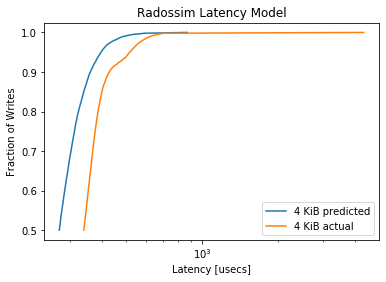

MainProcess pypet INFO     
 Finished single run #1503 of 1680 

MainProcess pypet INFO     
 Starting single run #1504 of 1680 



minimum predicted latency: 198.948866
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3695, pvalue=0.0)


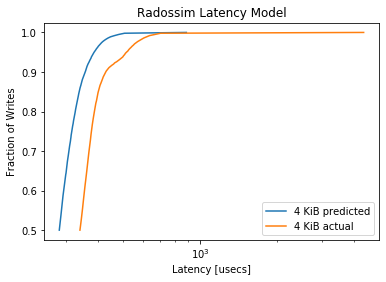

MainProcess pypet INFO     
 Finished single run #1504 of 1680 

MainProcess pypet INFO     
 Starting single run #1505 of 1680 



minimum predicted latency: 180.957746
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3202, pvalue=1e-323)


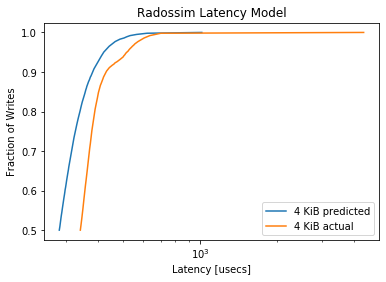

MainProcess pypet INFO     
 Finished single run #1505 of 1680 

MainProcess pypet INFO     
 Starting single run #1506 of 1680 



minimum predicted latency: 196.081339
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.297, pvalue=1e-323)


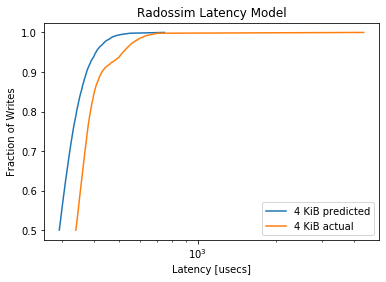

MainProcess pypet INFO     
 Finished single run #1506 of 1680 

MainProcess pypet INFO     
 Starting single run #1507 of 1680 



minimum predicted latency: 185.738709
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2591, pvalue=2.564497649780353e-295)


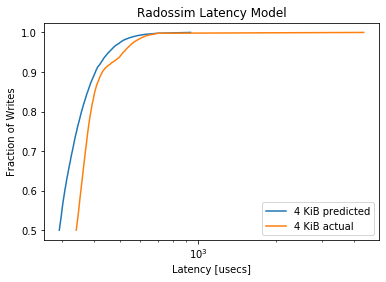

MainProcess pypet INFO     
 Finished single run #1507 of 1680 

MainProcess pypet INFO     
 Starting single run #1508 of 1680 



minimum predicted latency: 202.202265
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2165, pvalue=1.339753460536632e-205)


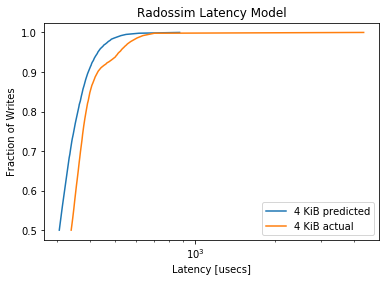

MainProcess pypet INFO     
 Finished single run #1508 of 1680 

MainProcess pypet INFO     
 Starting single run #1509 of 1680 



minimum predicted latency: 193.598120
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1813, pvalue=5.814855306609551e-144)


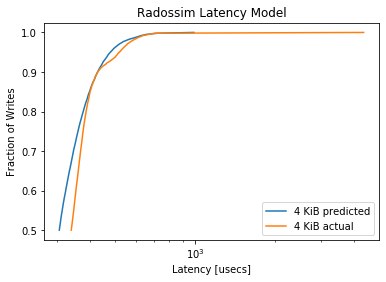

MainProcess pypet INFO     
 Finished single run #1509 of 1680 

MainProcess pypet INFO     
 Starting single run #1510 of 1680 



minimum predicted latency: 203.926468
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1303, pvalue=2.2896228987772207e-74)


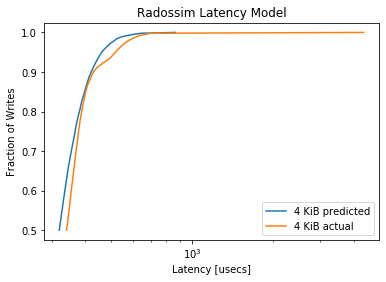

MainProcess pypet INFO     
 Finished single run #1510 of 1680 

MainProcess pypet INFO     
 Starting single run #1511 of 1680 



minimum predicted latency: 200.723485
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0975, pvalue=8.960324950620974e-42)


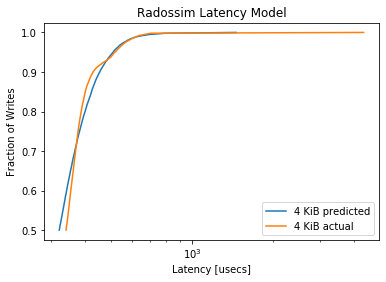

MainProcess pypet INFO     
 Finished single run #1511 of 1680 

MainProcess pypet INFO     PROGRESS: Finished 1512/1680 runs [==================  ] 90.0%, remaining: 0:01:00
MainProcess pypet INFO     
 Starting single run #1512 of 1680 



minimum predicted latency: 208.067278
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.082, pvalue=1.1687456592824363e-29)


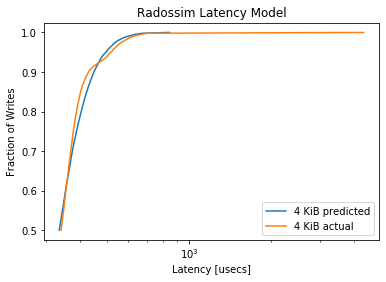

MainProcess pypet INFO     
 Finished single run #1512 of 1680 

MainProcess pypet INFO     
 Starting single run #1513 of 1680 



minimum predicted latency: 192.407510
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1035, pvalue=4.980116672451813e-47)


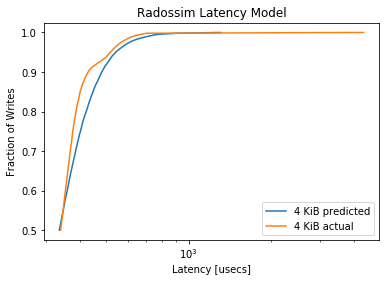

MainProcess pypet INFO     
 Finished single run #1513 of 1680 

MainProcess pypet INFO     
 Starting single run #1514 of 1680 



minimum predicted latency: 206.972307
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1536, pvalue=2.732368953909952e-103)


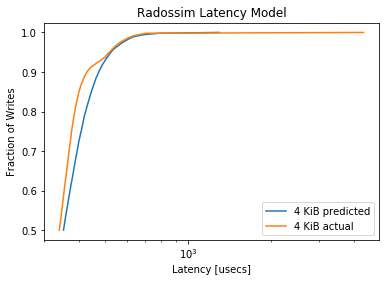

MainProcess pypet INFO     
 Finished single run #1514 of 1680 

MainProcess pypet INFO     
 Starting single run #1515 of 1680 



minimum predicted latency: 201.405275
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.168, pvalue=1.4085372408673205e-123)


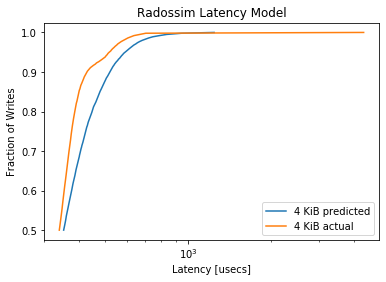

MainProcess pypet INFO     
 Finished single run #1515 of 1680 

MainProcess pypet INFO     
 Starting single run #1516 of 1680 



minimum predicted latency: 218.124996
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2269, pvalue=5.792336909931042e-226)


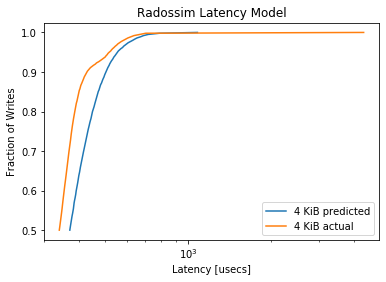

MainProcess pypet INFO     
 Finished single run #1516 of 1680 

MainProcess pypet INFO     
 Starting single run #1517 of 1680 



minimum predicted latency: 197.449393
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2577, pvalue=4.206495106503754e-292)


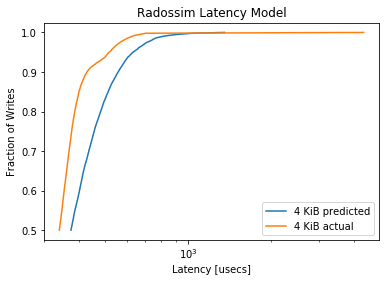

MainProcess pypet INFO     
 Finished single run #1517 of 1680 

MainProcess pypet INFO     
 Starting single run #1518 of 1680 



minimum predicted latency: 223.640831
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3292, pvalue=1e-323)


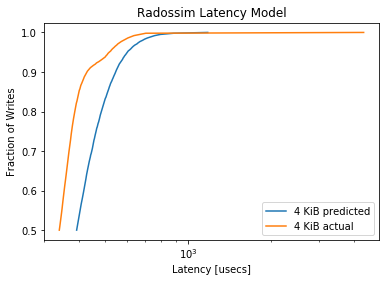

MainProcess pypet INFO     
 Finished single run #1518 of 1680 

MainProcess pypet INFO     
 Starting single run #1519 of 1680 



minimum predicted latency: 201.004667
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3253, pvalue=1e-323)


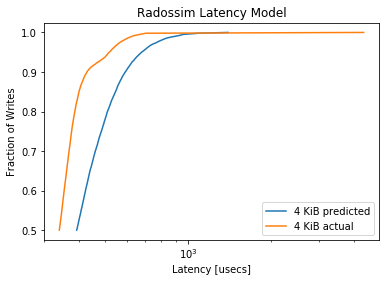

MainProcess pypet INFO     
 Finished single run #1519 of 1680 

MainProcess pypet INFO     
 Starting single run #1520 of 1680 



minimum predicted latency: 192.088698
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4825, pvalue=0.0)


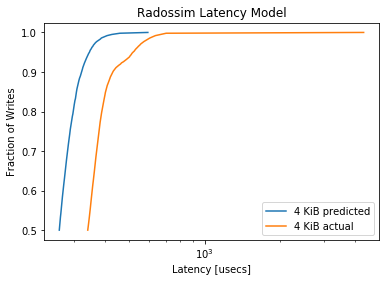

MainProcess pypet INFO     
 Finished single run #1520 of 1680 

MainProcess pypet INFO     
 Starting single run #1521 of 1680 



minimum predicted latency: 186.128737
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4312, pvalue=0.0)


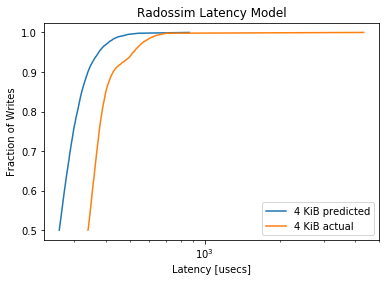

MainProcess pypet INFO     
 Finished single run #1521 of 1680 

MainProcess pypet INFO     
 Starting single run #1522 of 1680 



minimum predicted latency: 194.976480
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4304, pvalue=0.0)


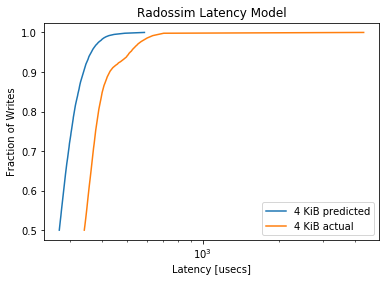

MainProcess pypet INFO     
 Finished single run #1522 of 1680 

MainProcess pypet INFO     
 Starting single run #1523 of 1680 



minimum predicted latency: 189.219828
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3835, pvalue=0.0)


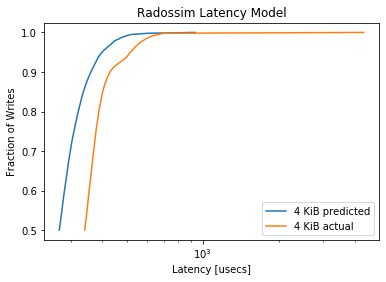

MainProcess pypet INFO     
 Finished single run #1523 of 1680 

MainProcess pypet INFO     
 Starting single run #1524 of 1680 



minimum predicted latency: 188.273861
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3743, pvalue=0.0)


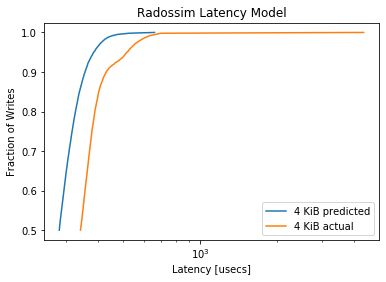

MainProcess pypet INFO     
 Finished single run #1524 of 1680 

MainProcess pypet INFO     
 Starting single run #1525 of 1680 



minimum predicted latency: 187.888521
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3241, pvalue=1e-323)


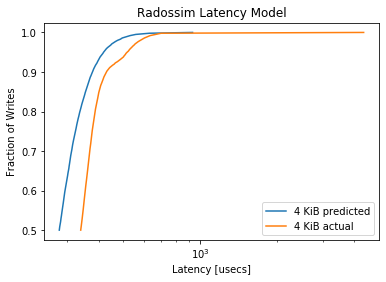

MainProcess pypet INFO     
 Finished single run #1525 of 1680 

MainProcess pypet INFO     
 Starting single run #1526 of 1680 



minimum predicted latency: 198.831202
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3007, pvalue=1e-323)


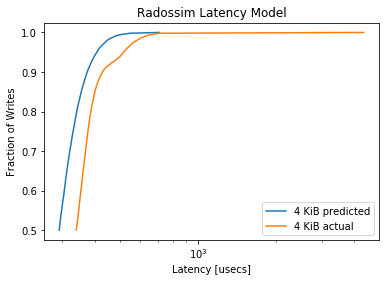

MainProcess pypet INFO     
 Finished single run #1526 of 1680 

MainProcess pypet INFO     
 Starting single run #1527 of 1680 



minimum predicted latency: 192.904666
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2644, pvalue=1.1825353103140979e-307)


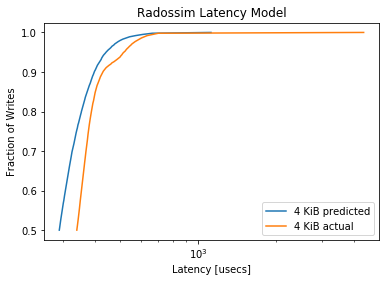

MainProcess pypet INFO     
 Finished single run #1527 of 1680 

MainProcess pypet INFO     
 Starting single run #1528 of 1680 



minimum predicted latency: 198.635942
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2235, pvalue=3.381437981027169e-219)


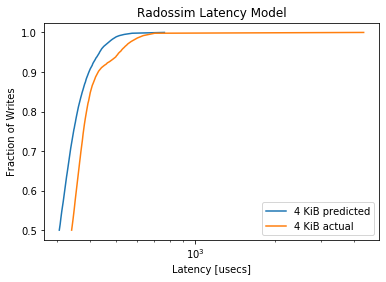

MainProcess pypet INFO     
 Finished single run #1528 of 1680 

MainProcess pypet INFO     
 Starting single run #1529 of 1680 



minimum predicted latency: 190.797697
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1818, pvalue=9.274273578228564e-145)


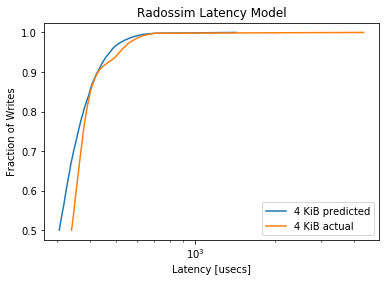

MainProcess pypet INFO     
 Finished single run #1529 of 1680 

MainProcess pypet INFO     
 Starting single run #1530 of 1680 



minimum predicted latency: 208.935450
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1292, pvalue=4.040383080185128e-73)


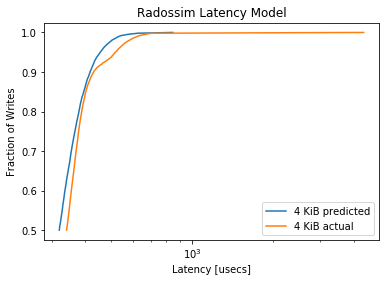

MainProcess pypet INFO     
 Finished single run #1530 of 1680 

MainProcess pypet INFO     
 Starting single run #1531 of 1680 



minimum predicted latency: 195.763779
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1069, pvalue=3.793908925840325e-50)


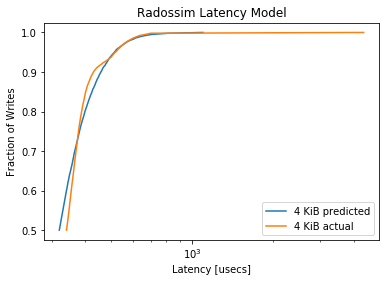

MainProcess pypet INFO     
 Finished single run #1531 of 1680 

MainProcess pypet INFO     
 Starting single run #1532 of 1680 



minimum predicted latency: 208.058275
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0843, pvalue=2.528282868108328e-31)


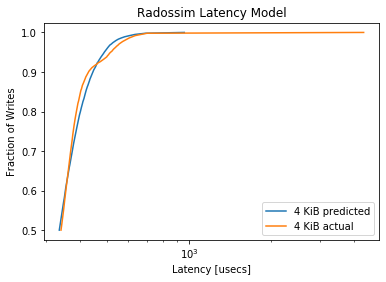

MainProcess pypet INFO     
 Finished single run #1532 of 1680 

MainProcess pypet INFO     
 Starting single run #1533 of 1680 



minimum predicted latency: 199.034196
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0987, pvalue=8.444485601896779e-43)


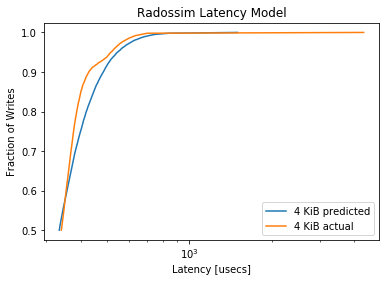

MainProcess pypet INFO     
 Finished single run #1533 of 1680 

MainProcess pypet INFO     
 Starting single run #1534 of 1680 



minimum predicted latency: 206.059085
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1566, pvalue=2.303111686363836e-107)


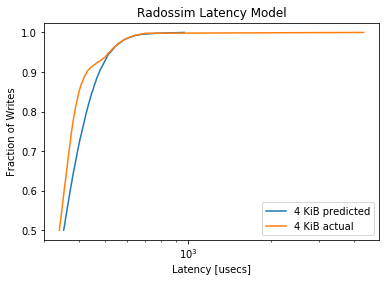

MainProcess pypet INFO     
 Finished single run #1534 of 1680 

MainProcess pypet INFO     
 Starting single run #1535 of 1680 



minimum predicted latency: 197.191312
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1714, pvalue=1.2259700183545722e-128)


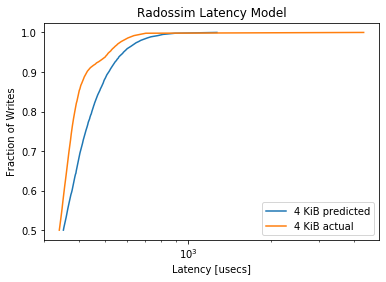

MainProcess pypet INFO     
 Finished single run #1535 of 1680 

MainProcess pypet INFO     
 Starting single run #1536 of 1680 



minimum predicted latency: 211.650113
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2174, pvalue=2.53375474278646e-207)


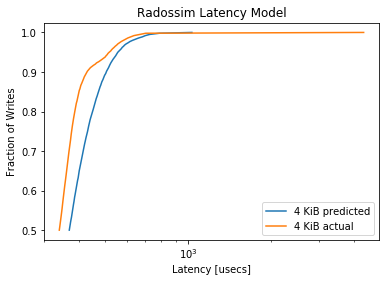

MainProcess pypet INFO     
 Finished single run #1536 of 1680 

MainProcess pypet INFO     
 Starting single run #1537 of 1680 



minimum predicted latency: 204.515488
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2356, pvalue=9.264818179445026e-244)


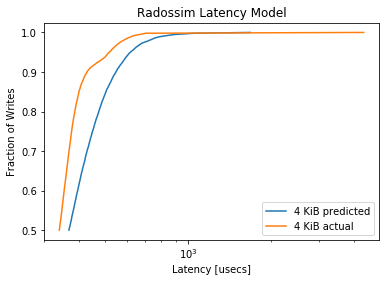

MainProcess pypet INFO     
 Finished single run #1537 of 1680 

MainProcess pypet INFO     
 Starting single run #1538 of 1680 



minimum predicted latency: 212.910904
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3251, pvalue=1e-323)


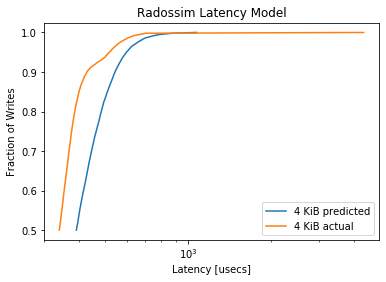

MainProcess pypet INFO     
 Finished single run #1538 of 1680 

MainProcess pypet INFO     
 Starting single run #1539 of 1680 



minimum predicted latency: 203.210891
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3282, pvalue=1e-323)


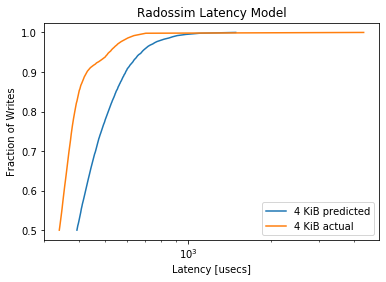

MainProcess pypet INFO     
 Finished single run #1539 of 1680 

MainProcess pypet INFO     
 Starting single run #1540 of 1680 



minimum predicted latency: 186.780065
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4837, pvalue=0.0)


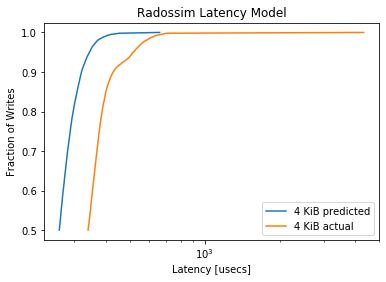

MainProcess pypet INFO     
 Finished single run #1540 of 1680 

MainProcess pypet INFO     
 Starting single run #1541 of 1680 



minimum predicted latency: 184.399962
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4351, pvalue=0.0)


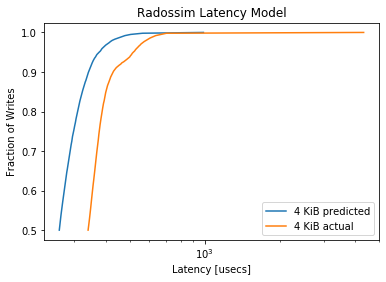

MainProcess pypet INFO     
 Finished single run #1541 of 1680 

MainProcess pypet INFO     
 Starting single run #1542 of 1680 



minimum predicted latency: 190.514353
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.437, pvalue=0.0)


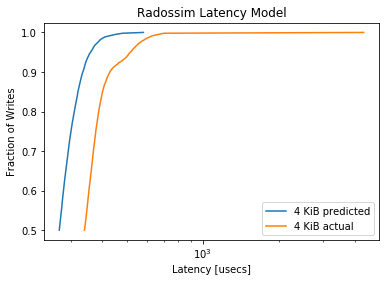

MainProcess pypet INFO     
 Finished single run #1542 of 1680 

MainProcess pypet INFO     
 Starting single run #1543 of 1680 



minimum predicted latency: 183.680966
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3828, pvalue=0.0)


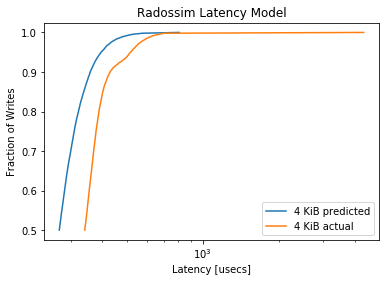

MainProcess pypet INFO     
 Finished single run #1543 of 1680 

MainProcess pypet INFO     
 Starting single run #1544 of 1680 



minimum predicted latency: 195.249042
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3772, pvalue=0.0)


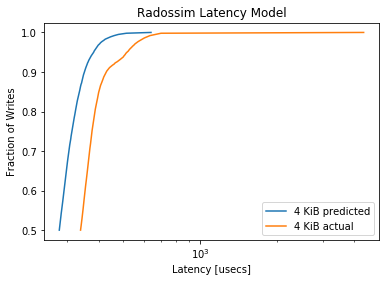

MainProcess pypet INFO     
 Finished single run #1544 of 1680 

MainProcess pypet INFO     
 Starting single run #1545 of 1680 



minimum predicted latency: 185.857551
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3264, pvalue=1e-323)


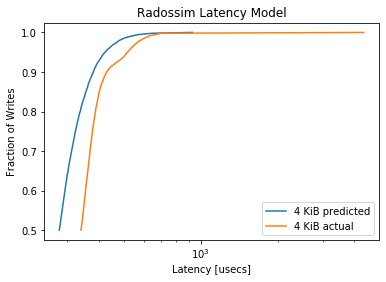

MainProcess pypet INFO     
 Finished single run #1545 of 1680 

MainProcess pypet INFO     
 Starting single run #1546 of 1680 



minimum predicted latency: 201.305192
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3008, pvalue=1e-323)


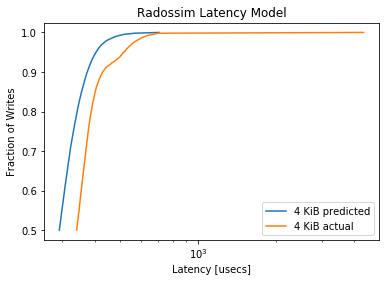

MainProcess pypet INFO     
 Finished single run #1546 of 1680 

MainProcess pypet INFO     
 Starting single run #1547 of 1680 



minimum predicted latency: 191.875310
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2596, pvalue=1.804660687969792e-296)


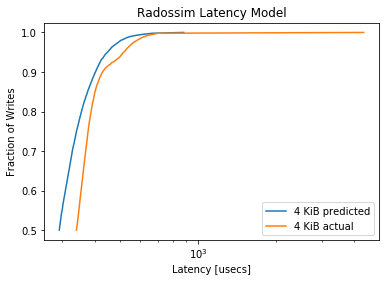

MainProcess pypet INFO     
 Finished single run #1547 of 1680 

MainProcess pypet INFO     
 Starting single run #1548 of 1680 



minimum predicted latency: 199.157824
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2225, pvalue=3.1553974864468496e-217)


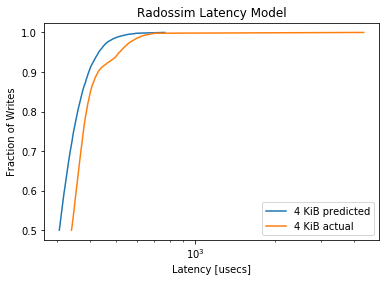

MainProcess pypet INFO     
 Finished single run #1548 of 1680 

MainProcess pypet INFO     
 Starting single run #1549 of 1680 



minimum predicted latency: 193.597951
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1889, pvalue=2.533125796328862e-156)


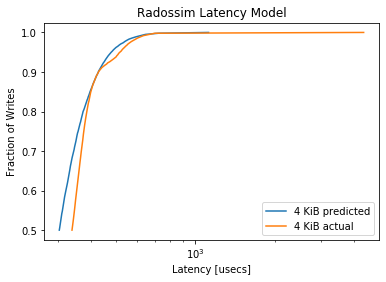

MainProcess pypet INFO     
 Finished single run #1549 of 1680 

MainProcess pypet INFO     
 Starting single run #1550 of 1680 



minimum predicted latency: 205.179149
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1298, pvalue=8.467439125406339e-74)


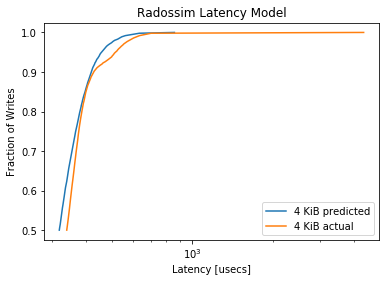

MainProcess pypet INFO     
 Finished single run #1550 of 1680 

MainProcess pypet INFO     
 Starting single run #1551 of 1680 



minimum predicted latency: 197.188298
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1141, pvalue=4.370973165867622e-57)


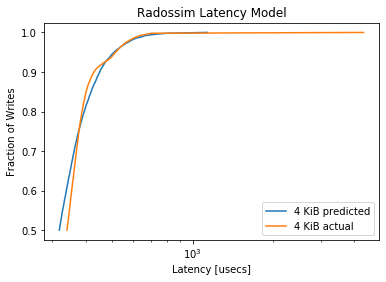

MainProcess pypet INFO     
 Finished single run #1551 of 1680 

MainProcess pypet INFO     
 Starting single run #1552 of 1680 



minimum predicted latency: 204.826049
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0804, pvalue=1.5798806018606984e-28)


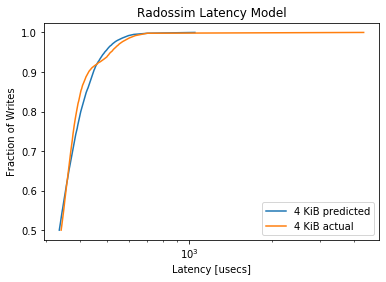

MainProcess pypet INFO     
 Finished single run #1552 of 1680 

MainProcess pypet INFO     
 Starting single run #1553 of 1680 



minimum predicted latency: 195.001389
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0987, pvalue=8.444485601896779e-43)


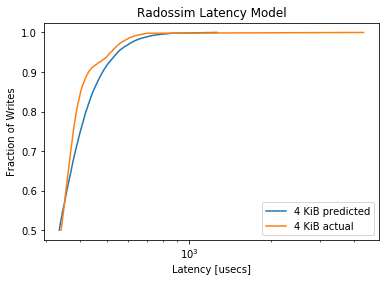

MainProcess pypet INFO     
 Finished single run #1553 of 1680 

MainProcess pypet INFO     
 Starting single run #1554 of 1680 



minimum predicted latency: 206.137337
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1502, pvalue=9.061844307365734e-99)


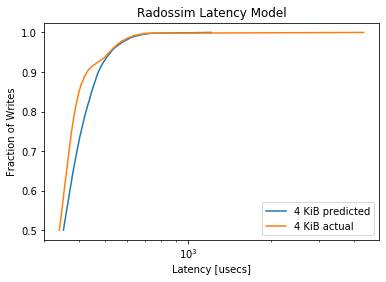

MainProcess pypet INFO     
 Finished single run #1554 of 1680 

MainProcess pypet INFO     
 Starting single run #1555 of 1680 



minimum predicted latency: 197.172937
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1703, pvalue=5.4568958003521304e-127)


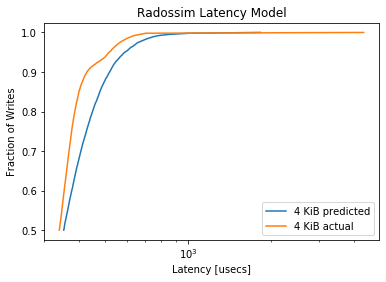

MainProcess pypet INFO     
 Finished single run #1555 of 1680 

MainProcess pypet INFO     
 Starting single run #1556 of 1680 



minimum predicted latency: 212.376083
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2227, pvalue=1.2758355687206396e-217)


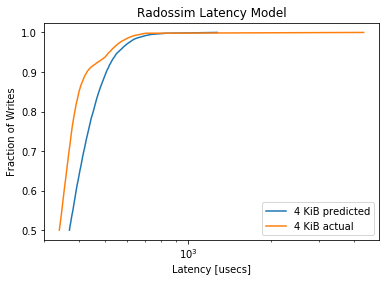

MainProcess pypet INFO     
 Finished single run #1556 of 1680 

MainProcess pypet INFO     
 Starting single run #1557 of 1680 



minimum predicted latency: 197.855312
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2482, pvalue=9.088062394299249e-271)


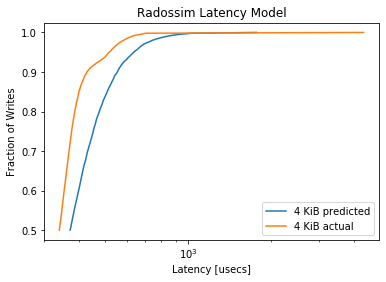

MainProcess pypet INFO     
 Finished single run #1557 of 1680 

MainProcess pypet INFO     
 Starting single run #1558 of 1680 



minimum predicted latency: 217.623484
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3253, pvalue=1e-323)


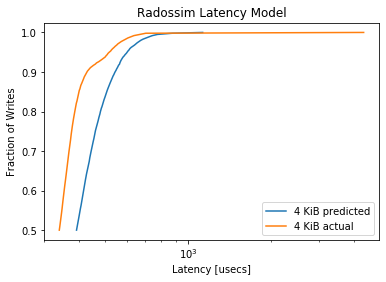

MainProcess pypet INFO     
 Finished single run #1558 of 1680 

MainProcess pypet INFO     
 Starting single run #1559 of 1680 



minimum predicted latency: 210.265411
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3158, pvalue=1e-323)


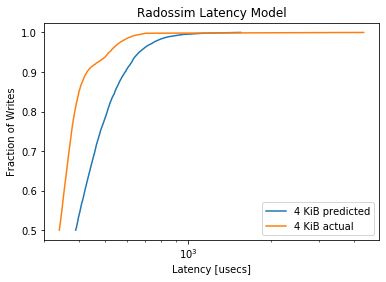

MainProcess pypet INFO     
 Finished single run #1559 of 1680 

MainProcess pypet INFO     
 Starting single run #1560 of 1680 



minimum predicted latency: 191.006907
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4779, pvalue=0.0)


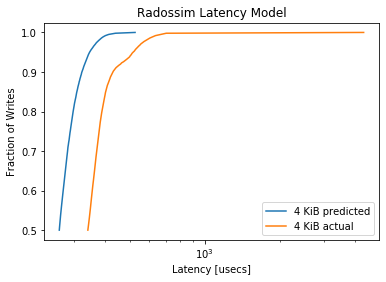

MainProcess pypet INFO     
 Finished single run #1560 of 1680 

MainProcess pypet INFO     
 Starting single run #1561 of 1680 



minimum predicted latency: 183.527449
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4361, pvalue=0.0)


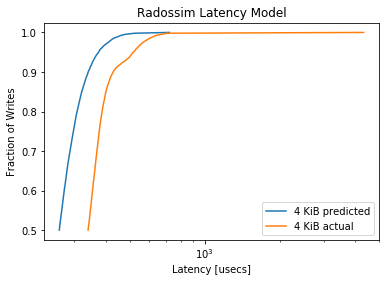

MainProcess pypet INFO     
 Finished single run #1561 of 1680 

MainProcess pypet INFO     
 Starting single run #1562 of 1680 



minimum predicted latency: 191.449308
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4335, pvalue=0.0)


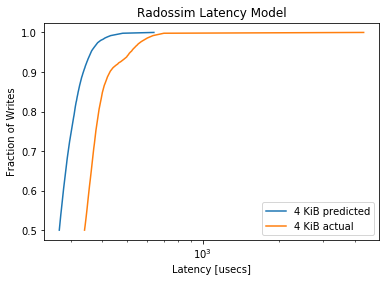

MainProcess pypet INFO     
 Finished single run #1562 of 1680 

MainProcess pypet INFO     
 Starting single run #1563 of 1680 



minimum predicted latency: 178.581039
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3774, pvalue=0.0)


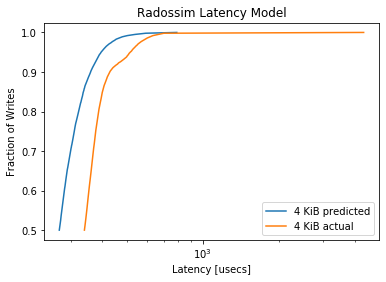

MainProcess pypet INFO     
 Finished single run #1563 of 1680 

MainProcess pypet INFO     
 Starting single run #1564 of 1680 



minimum predicted latency: 197.327431
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3746, pvalue=0.0)


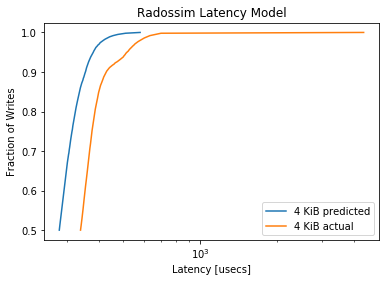

MainProcess pypet INFO     
 Finished single run #1564 of 1680 

MainProcess pypet INFO     
 Starting single run #1565 of 1680 



minimum predicted latency: 179.497453
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3244, pvalue=1e-323)


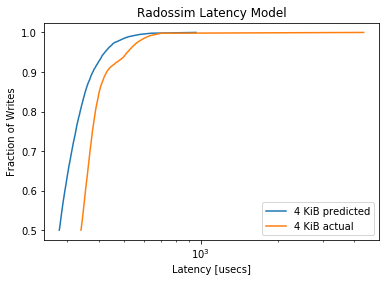

MainProcess pypet INFO     
 Finished single run #1565 of 1680 

MainProcess pypet INFO     
 Starting single run #1566 of 1680 



minimum predicted latency: 198.336351
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3041, pvalue=1e-323)


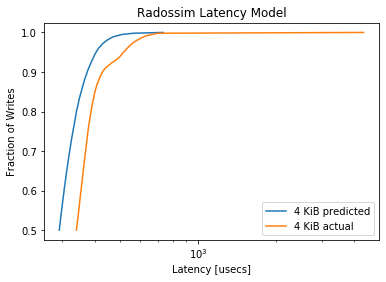

MainProcess pypet INFO     
 Finished single run #1566 of 1680 

MainProcess pypet INFO     
 Starting single run #1567 of 1680 



minimum predicted latency: 192.629859
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2551, pvalue=3.516547251060014e-286)


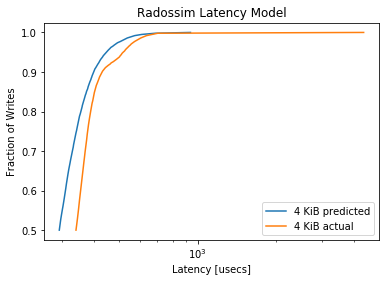

MainProcess pypet INFO     
 Finished single run #1567 of 1680 

MainProcess pypet INFO     
 Starting single run #1568 of 1680 



minimum predicted latency: 198.381561
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2194, pvalue=3.5306574402118234e-211)


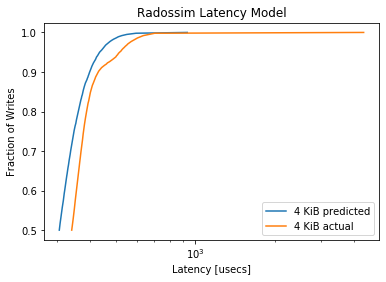

MainProcess pypet INFO     
 Finished single run #1568 of 1680 

MainProcess pypet INFO     
 Starting single run #1569 of 1680 



minimum predicted latency: 191.988929
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1894, pvalue=3.734381985672426e-157)


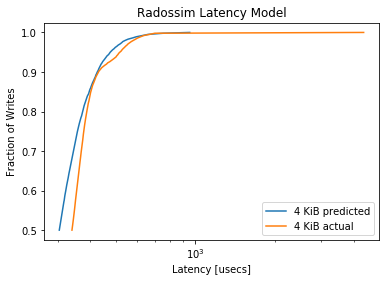

MainProcess pypet INFO     
 Finished single run #1569 of 1680 

MainProcess pypet INFO     
 Starting single run #1570 of 1680 



minimum predicted latency: 201.181964
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.138, pvalue=2.155914086507327e-83)


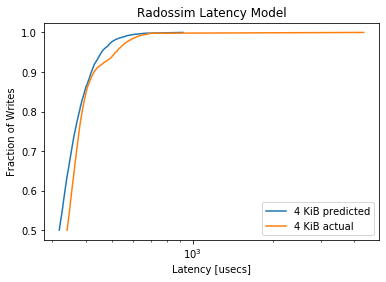

MainProcess pypet INFO     
 Finished single run #1570 of 1680 

MainProcess pypet INFO     
 Starting single run #1571 of 1680 



minimum predicted latency: 195.642499
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1092, pvalue=2.5832213271606204e-52)


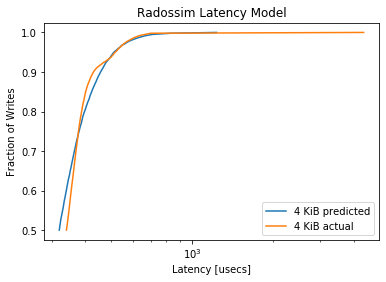

MainProcess pypet INFO     
 Finished single run #1571 of 1680 

MainProcess pypet INFO     
 Starting single run #1572 of 1680 



minimum predicted latency: 210.169789
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0777, pvalue=1.1383638313332442e-26)


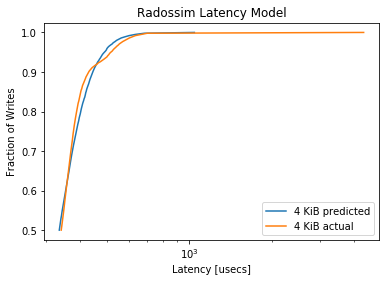

MainProcess pypet INFO     
 Finished single run #1572 of 1680 

MainProcess pypet INFO     
 Starting single run #1573 of 1680 



minimum predicted latency: 196.761402
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1132, pvalue=3.4105502412376176e-56)


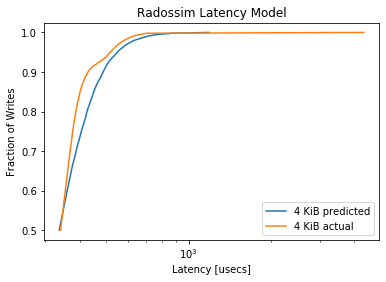

MainProcess pypet INFO     
 Finished single run #1573 of 1680 

MainProcess pypet INFO     
 Starting single run #1574 of 1680 



minimum predicted latency: 213.537155
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1455, pvalue=1.0895995750776009e-92)


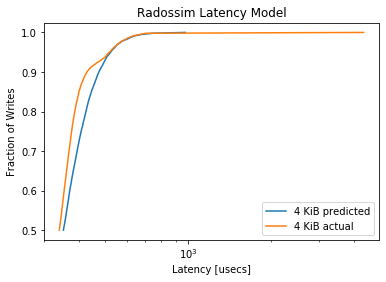

MainProcess pypet INFO     
 Finished single run #1574 of 1680 

MainProcess pypet INFO     
 Starting single run #1575 of 1680 



minimum predicted latency: 189.929813
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1748, pvalue=8.409083121820766e-134)


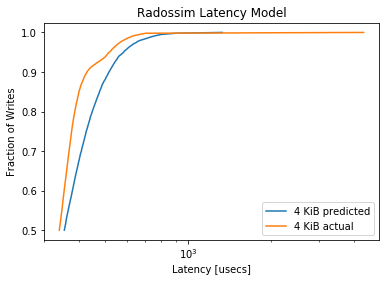

MainProcess pypet INFO     
 Finished single run #1575 of 1680 

MainProcess pypet INFO     
 Starting single run #1576 of 1680 



minimum predicted latency: 219.343597
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2197, pvalue=9.253841430653853e-212)


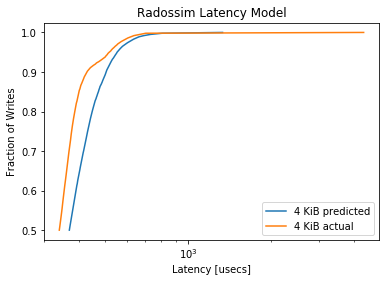

MainProcess pypet INFO     
 Finished single run #1576 of 1680 

MainProcess pypet INFO     
 Starting single run #1577 of 1680 



minimum predicted latency: 200.186574
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2371, pvalue=6.734311005568024e-247)


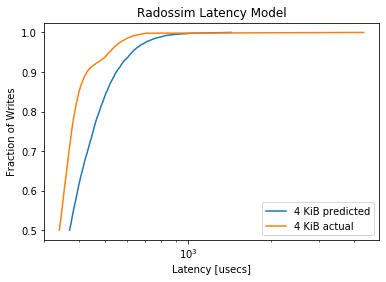

MainProcess pypet INFO     
 Finished single run #1577 of 1680 

MainProcess pypet INFO     
 Starting single run #1578 of 1680 



minimum predicted latency: 213.724506
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3288, pvalue=1e-323)


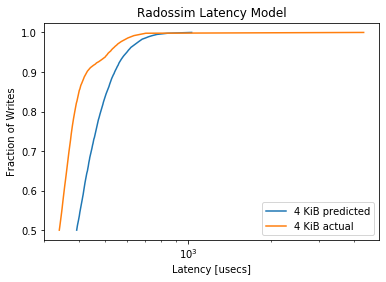

MainProcess pypet INFO     
 Finished single run #1578 of 1680 

MainProcess pypet INFO     
 Starting single run #1579 of 1680 



minimum predicted latency: 200.179974
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3233, pvalue=1e-323)


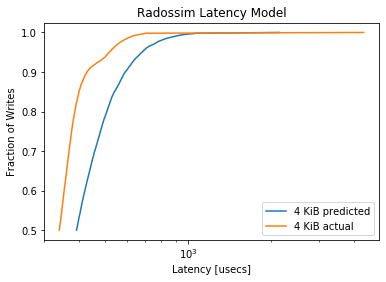

MainProcess pypet INFO     
 Finished single run #1579 of 1680 

MainProcess pypet INFO     
 Starting single run #1580 of 1680 



minimum predicted latency: 189.133674
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4804, pvalue=0.0)


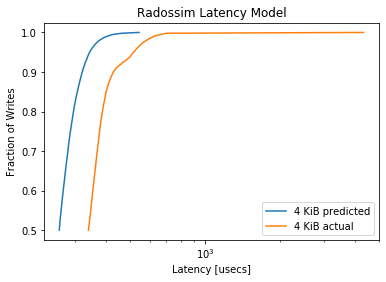

MainProcess pypet INFO     
 Finished single run #1580 of 1680 

MainProcess pypet INFO     
 Starting single run #1581 of 1680 



minimum predicted latency: 187.267122
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4493, pvalue=0.0)


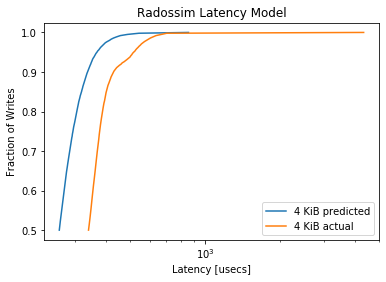

MainProcess pypet INFO     
 Finished single run #1581 of 1680 

MainProcess pypet INFO     
 Starting single run #1582 of 1680 



minimum predicted latency: 193.957328
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4336, pvalue=0.0)


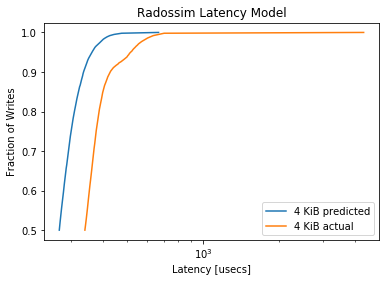

MainProcess pypet INFO     
 Finished single run #1582 of 1680 

MainProcess pypet INFO     
 Starting single run #1583 of 1680 



minimum predicted latency: 188.335208
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3797, pvalue=0.0)


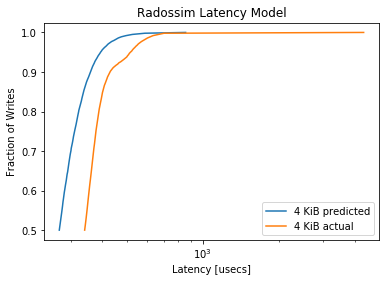

MainProcess pypet INFO     
 Finished single run #1583 of 1680 

MainProcess pypet INFO     
 Starting single run #1584 of 1680 



minimum predicted latency: 190.887145
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3743, pvalue=0.0)


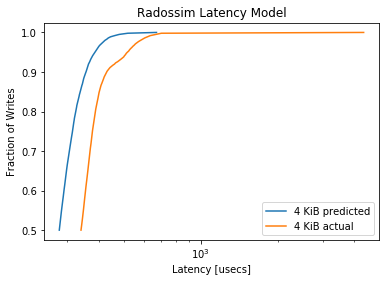

MainProcess pypet INFO     
 Finished single run #1584 of 1680 

MainProcess pypet INFO     
 Starting single run #1585 of 1680 



minimum predicted latency: 186.636868
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3246, pvalue=1e-323)


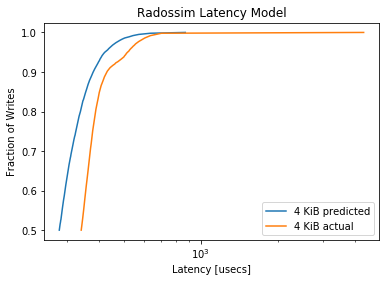

MainProcess pypet INFO     
 Finished single run #1585 of 1680 

MainProcess pypet INFO     
 Starting single run #1586 of 1680 



minimum predicted latency: 195.448375
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.306, pvalue=1e-323)


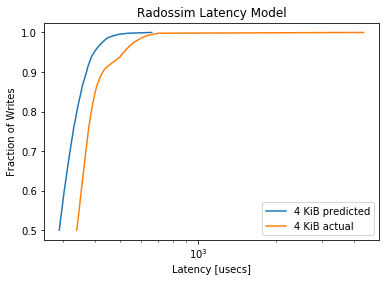

MainProcess pypet INFO     
 Finished single run #1586 of 1680 

MainProcess pypet INFO     
 Starting single run #1587 of 1680 



minimum predicted latency: 191.254654
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2515, pvalue=4.3895807492127764e-278)


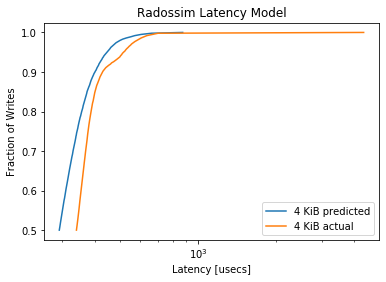

MainProcess pypet INFO     
 Finished single run #1587 of 1680 

MainProcess pypet INFO     
 Starting single run #1588 of 1680 



minimum predicted latency: 199.882673
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2351, pvalue=1.0195756567141838e-242)


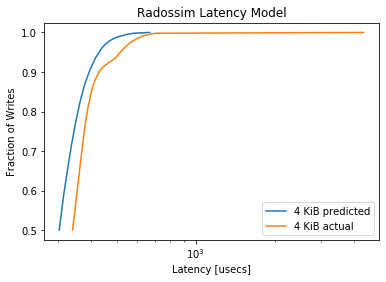

MainProcess pypet INFO     
 Finished single run #1588 of 1680 

MainProcess pypet INFO     
 Starting single run #1589 of 1680 



minimum predicted latency: 194.149834
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1907, pvalue=2.5115321617812634e-159)


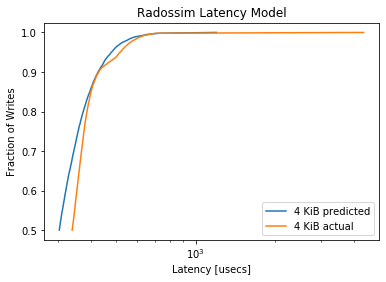

MainProcess pypet INFO     
 Finished single run #1589 of 1680 

MainProcess pypet INFO     
 Starting single run #1590 of 1680 



minimum predicted latency: 207.057456
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1305, pvalue=1.355034165354274e-74)


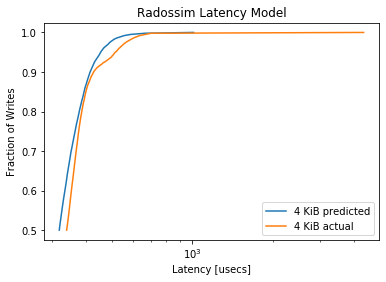

MainProcess pypet INFO     
 Finished single run #1590 of 1680 

MainProcess pypet INFO     
 Starting single run #1591 of 1680 



minimum predicted latency: 195.869319
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1262, pvalue=8.955446227978754e-70)


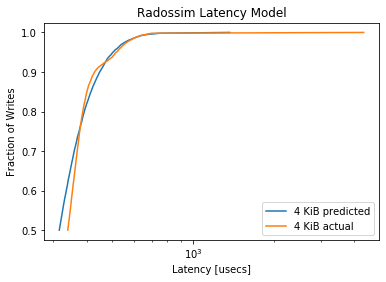

MainProcess pypet INFO     
 Finished single run #1591 of 1680 

MainProcess pypet INFO     
 Starting single run #1592 of 1680 



minimum predicted latency: 203.883185
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0774, pvalue=1.814490562463752e-26)


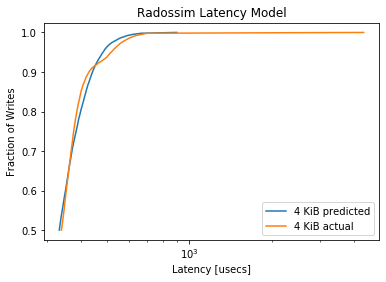

MainProcess pypet INFO     
 Finished single run #1592 of 1680 

MainProcess pypet INFO     
 Starting single run #1593 of 1680 



minimum predicted latency: 202.598684
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0985, pvalue=1.2543208284766207e-42)


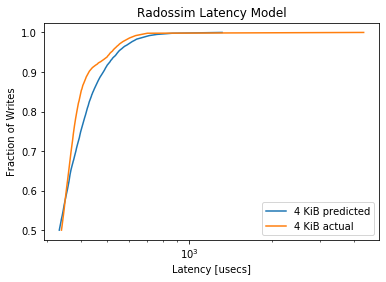

MainProcess pypet INFO     
 Finished single run #1593 of 1680 

MainProcess pypet INFO     
 Starting single run #1594 of 1680 



minimum predicted latency: 215.425466
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1393, pvalue=5.7276085726523e-85)


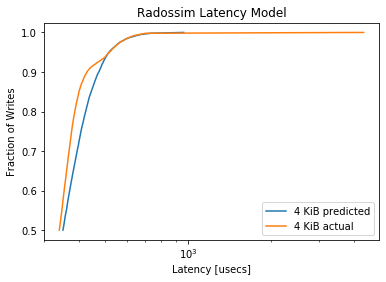

MainProcess pypet INFO     
 Finished single run #1594 of 1680 

MainProcess pypet INFO     
 Starting single run #1595 of 1680 



minimum predicted latency: 196.613213
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.169, pvalue=4.69006527892648e-125)


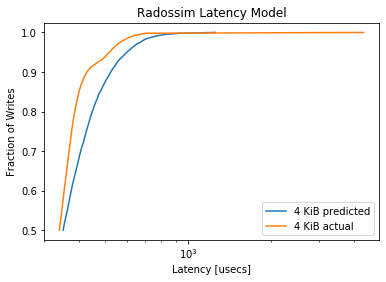

MainProcess pypet INFO     
 Finished single run #1595 of 1680 

MainProcess pypet INFO     PROGRESS: Finished 1596/1680 runs [=================== ] 95.0%, remaining: 0:00:30
MainProcess pypet INFO     
 Starting single run #1596 of 1680 



minimum predicted latency: 214.956477
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2117, pvalue=1.5601276888955846e-196)


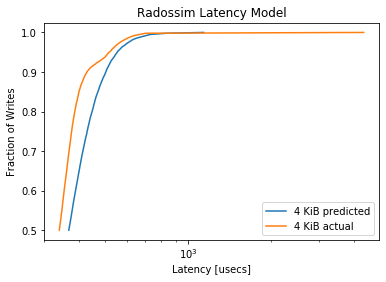

MainProcess pypet INFO     
 Finished single run #1596 of 1680 

MainProcess pypet INFO     
 Starting single run #1597 of 1680 



minimum predicted latency: 198.828145
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2379, pvalue=1.399386368739167e-248)


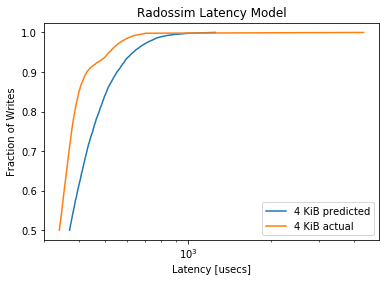

MainProcess pypet INFO     
 Finished single run #1597 of 1680 

MainProcess pypet INFO     
 Starting single run #1598 of 1680 



minimum predicted latency: 218.118503
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3217, pvalue=1e-323)


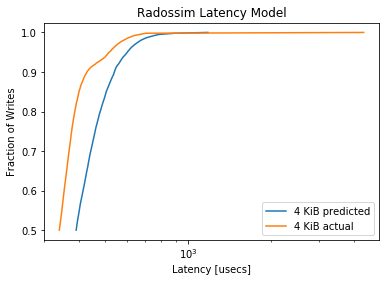

MainProcess pypet INFO     
 Finished single run #1598 of 1680 

MainProcess pypet INFO     
 Starting single run #1599 of 1680 



minimum predicted latency: 195.114235
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3186, pvalue=1e-323)


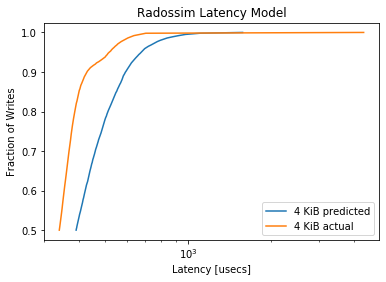

MainProcess pypet INFO     
 Finished single run #1599 of 1680 

MainProcess pypet INFO     
 Starting single run #1600 of 1680 



minimum predicted latency: 190.719141
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.489, pvalue=0.0)


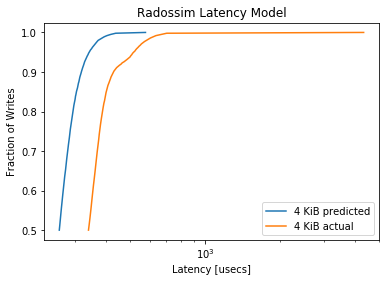

MainProcess pypet INFO     
 Finished single run #1600 of 1680 

MainProcess pypet INFO     
 Starting single run #1601 of 1680 



minimum predicted latency: 184.911921
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4441, pvalue=0.0)


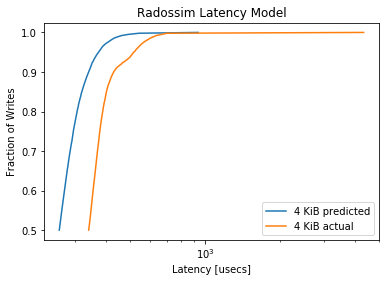

MainProcess pypet INFO     
 Finished single run #1601 of 1680 

MainProcess pypet INFO     
 Starting single run #1602 of 1680 



minimum predicted latency: 191.331955
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4295, pvalue=0.0)


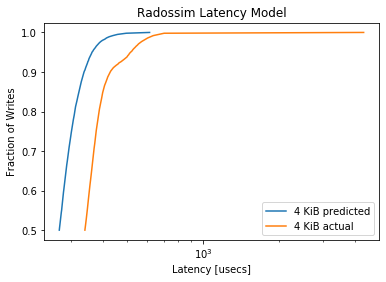

MainProcess pypet INFO     
 Finished single run #1602 of 1680 

MainProcess pypet INFO     
 Starting single run #1603 of 1680 



minimum predicted latency: 186.665065
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3823, pvalue=0.0)


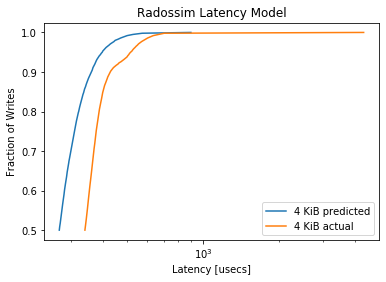

MainProcess pypet INFO     
 Finished single run #1603 of 1680 

MainProcess pypet INFO     
 Starting single run #1604 of 1680 



minimum predicted latency: 196.530774
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3774, pvalue=0.0)


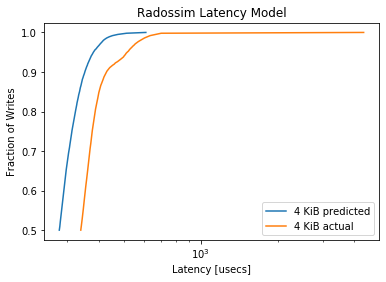

MainProcess pypet INFO     
 Finished single run #1604 of 1680 

MainProcess pypet INFO     
 Starting single run #1605 of 1680 



minimum predicted latency: 187.458151
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3269, pvalue=1e-323)


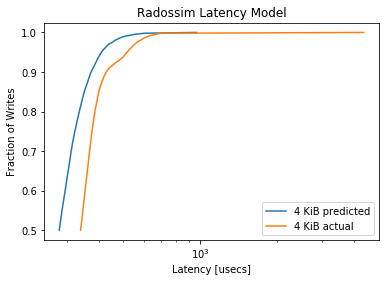

MainProcess pypet INFO     
 Finished single run #1605 of 1680 

MainProcess pypet INFO     
 Starting single run #1606 of 1680 



minimum predicted latency: 194.652552
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3124, pvalue=1e-323)


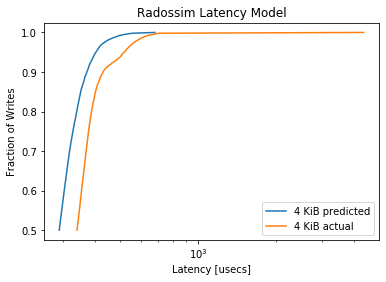

MainProcess pypet INFO     
 Finished single run #1606 of 1680 

MainProcess pypet INFO     
 Starting single run #1607 of 1680 



minimum predicted latency: 192.686692
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2674, pvalue=9.41576495e-315)


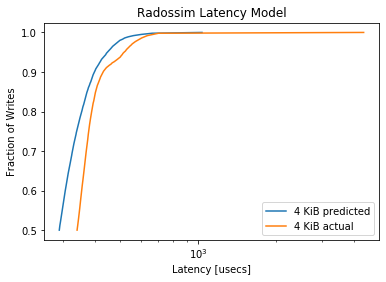

MainProcess pypet INFO     
 Finished single run #1607 of 1680 

MainProcess pypet INFO     
 Starting single run #1608 of 1680 



minimum predicted latency: 202.805024
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2293, pvalue=8.374473160598733e-231)


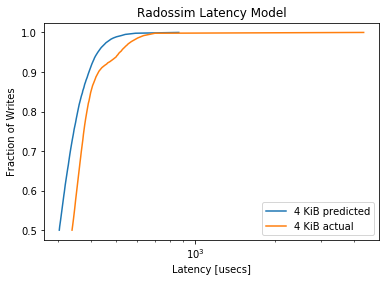

MainProcess pypet INFO     
 Finished single run #1608 of 1680 

MainProcess pypet INFO     
 Starting single run #1609 of 1680 



minimum predicted latency: 193.396396
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1798, pvalue=1.3894620716615462e-141)


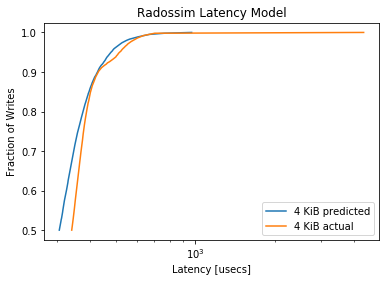

MainProcess pypet INFO     
 Finished single run #1609 of 1680 

MainProcess pypet INFO     
 Starting single run #1610 of 1680 



minimum predicted latency: 206.238019
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1425, pvalue=6.54102895113697e-89)


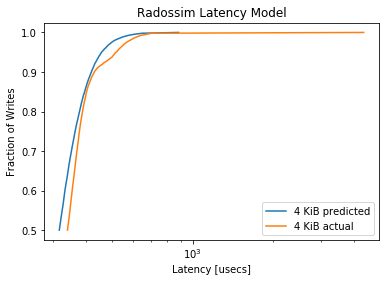

MainProcess pypet INFO     
 Finished single run #1610 of 1680 

MainProcess pypet INFO     
 Starting single run #1611 of 1680 



minimum predicted latency: 189.243501
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1176, pvalue=1.2675281251956457e-60)


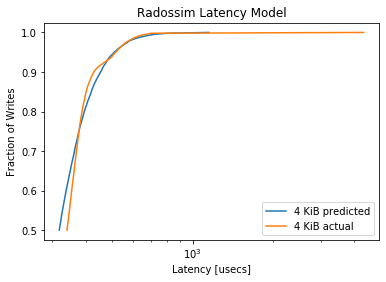

MainProcess pypet INFO     
 Finished single run #1611 of 1680 

MainProcess pypet INFO     
 Starting single run #1612 of 1680 



minimum predicted latency: 200.021095
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0744, pvalue=1.7387809507752027e-24)


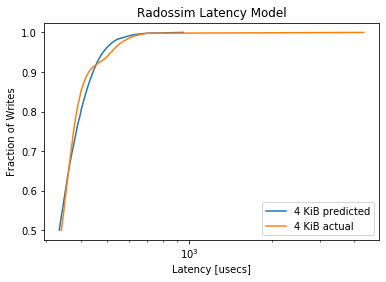

MainProcess pypet INFO     
 Finished single run #1612 of 1680 

MainProcess pypet INFO     
 Starting single run #1613 of 1680 



minimum predicted latency: 194.237726
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0958, pvalue=2.420226333205429e-40)


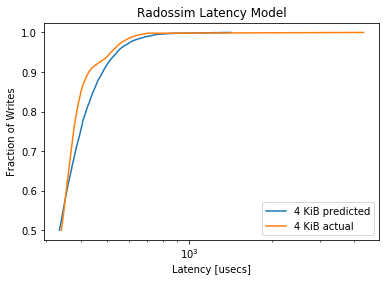

MainProcess pypet INFO     
 Finished single run #1613 of 1680 

MainProcess pypet INFO     
 Starting single run #1614 of 1680 



minimum predicted latency: 210.442668
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1551, pvalue=2.567078419730507e-105)


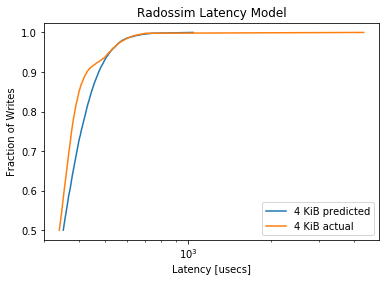

MainProcess pypet INFO     
 Finished single run #1614 of 1680 

MainProcess pypet INFO     
 Starting single run #1615 of 1680 



minimum predicted latency: 199.305630
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1654, pvalue=8.885465579752271e-120)


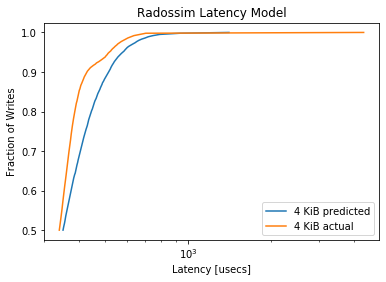

MainProcess pypet INFO     
 Finished single run #1615 of 1680 

MainProcess pypet INFO     
 Starting single run #1616 of 1680 



minimum predicted latency: 207.995533
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2205, pvalue=2.5795875364505895e-213)


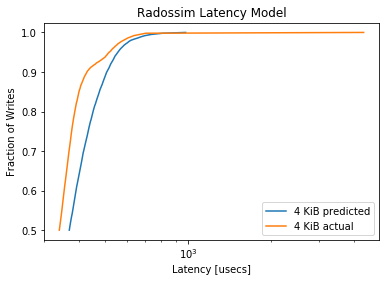

MainProcess pypet INFO     
 Finished single run #1616 of 1680 

MainProcess pypet INFO     
 Starting single run #1617 of 1680 



minimum predicted latency: 197.193502
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2364, pvalue=1.9747982476110128e-245)


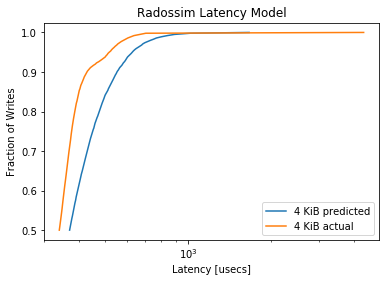

MainProcess pypet INFO     
 Finished single run #1617 of 1680 

MainProcess pypet INFO     
 Starting single run #1618 of 1680 



minimum predicted latency: 221.538414
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3198, pvalue=1e-323)


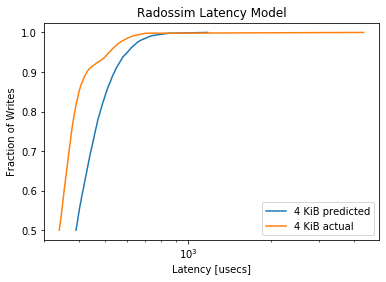

MainProcess pypet INFO     
 Finished single run #1618 of 1680 

MainProcess pypet INFO     
 Starting single run #1619 of 1680 



minimum predicted latency: 195.747226
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3118, pvalue=1e-323)


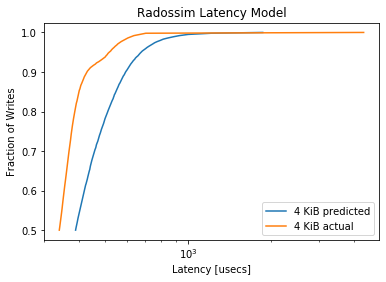

MainProcess pypet INFO     
 Finished single run #1619 of 1680 

MainProcess pypet INFO     
 Starting single run #1620 of 1680 



minimum predicted latency: 193.751394
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4811, pvalue=0.0)


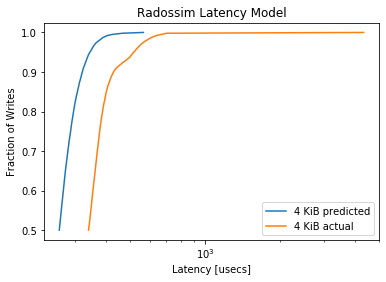

MainProcess pypet INFO     
 Finished single run #1620 of 1680 

MainProcess pypet INFO     
 Starting single run #1621 of 1680 



minimum predicted latency: 181.100824
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.442, pvalue=0.0)


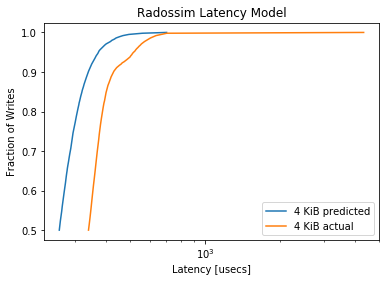

MainProcess pypet INFO     
 Finished single run #1621 of 1680 

MainProcess pypet INFO     
 Starting single run #1622 of 1680 



minimum predicted latency: 190.199054
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4395, pvalue=0.0)


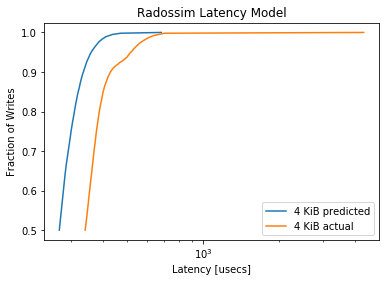

MainProcess pypet INFO     
 Finished single run #1622 of 1680 

MainProcess pypet INFO     
 Starting single run #1623 of 1680 



minimum predicted latency: 186.870055
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3811, pvalue=0.0)


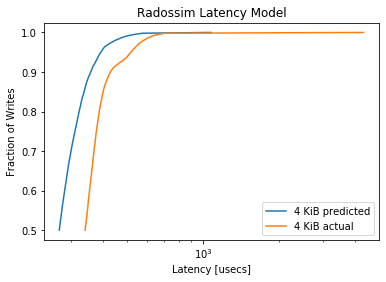

MainProcess pypet INFO     
 Finished single run #1623 of 1680 

MainProcess pypet INFO     
 Starting single run #1624 of 1680 



minimum predicted latency: 195.318005
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3761, pvalue=0.0)


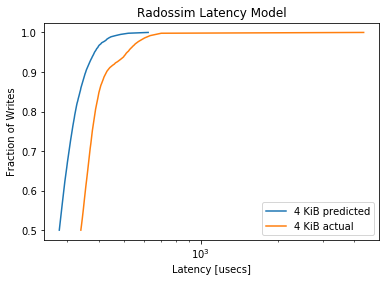

MainProcess pypet INFO     
 Finished single run #1624 of 1680 

MainProcess pypet INFO     
 Starting single run #1625 of 1680 



minimum predicted latency: 184.809389
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3268, pvalue=1e-323)


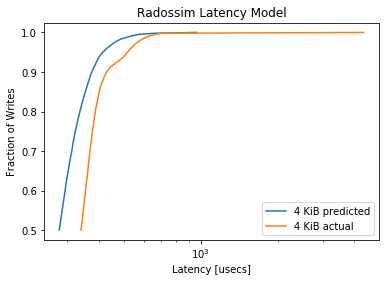

MainProcess pypet INFO     
 Finished single run #1625 of 1680 

MainProcess pypet INFO     
 Starting single run #1626 of 1680 



minimum predicted latency: 197.045546
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3116, pvalue=1e-323)


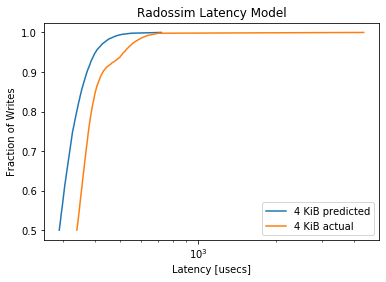

MainProcess pypet INFO     
 Finished single run #1626 of 1680 

MainProcess pypet INFO     
 Starting single run #1627 of 1680 



minimum predicted latency: 189.101214
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2618, pvalue=1.4363406723943175e-301)


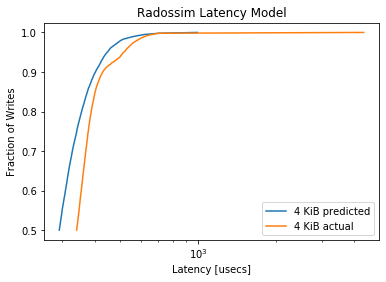

MainProcess pypet INFO     
 Finished single run #1627 of 1680 

MainProcess pypet INFO     
 Starting single run #1628 of 1680 



minimum predicted latency: 201.411430
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2287, pvalue=1.373661073952488e-229)


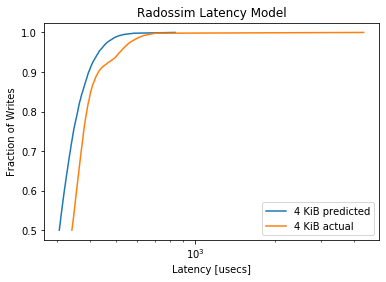

MainProcess pypet INFO     
 Finished single run #1628 of 1680 

MainProcess pypet INFO     
 Starting single run #1629 of 1680 



minimum predicted latency: 188.233071
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1957, pvalue=7.9981198411812205e-168)


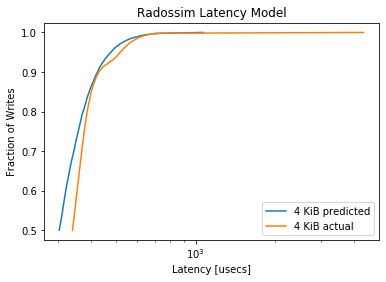

MainProcess pypet INFO     
 Finished single run #1629 of 1680 

MainProcess pypet INFO     
 Starting single run #1630 of 1680 



minimum predicted latency: 204.800582
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.136, pvalue=5.351855570510697e-81)


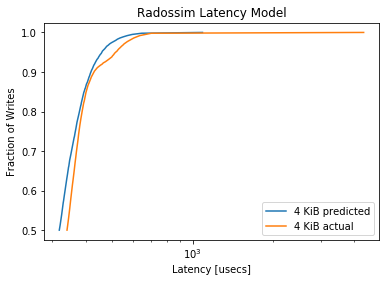

MainProcess pypet INFO     
 Finished single run #1630 of 1680 

MainProcess pypet INFO     
 Starting single run #1631 of 1680 



minimum predicted latency: 193.859176
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.115, pvalue=5.510662585551242e-58)


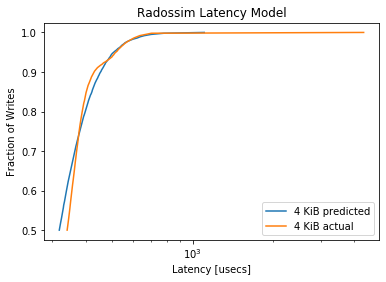

MainProcess pypet INFO     
 Finished single run #1631 of 1680 

MainProcess pypet INFO     
 Starting single run #1632 of 1680 



minimum predicted latency: 202.448453
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0759, pvalue=1.8168854409745134e-25)


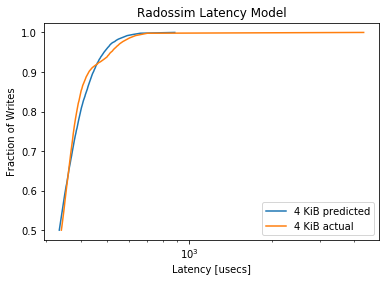

MainProcess pypet INFO     
 Finished single run #1632 of 1680 

MainProcess pypet INFO     
 Starting single run #1633 of 1680 



minimum predicted latency: 192.795718
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0986, pvalue=1.0292829299760363e-42)


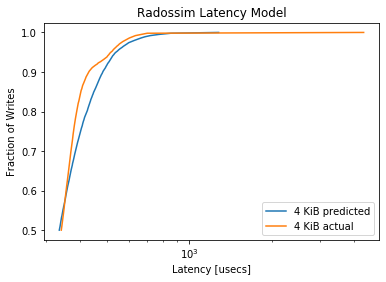

MainProcess pypet INFO     
 Finished single run #1633 of 1680 

MainProcess pypet INFO     
 Starting single run #1634 of 1680 



minimum predicted latency: 203.655533
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1469, pvalue=1.7648097754333257e-94)


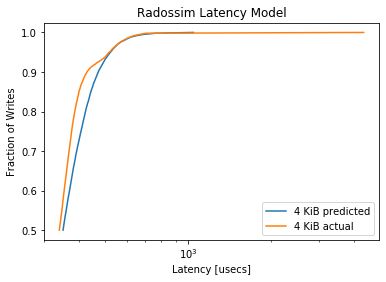

MainProcess pypet INFO     
 Finished single run #1634 of 1680 

MainProcess pypet INFO     
 Starting single run #1635 of 1680 



minimum predicted latency: 195.247329
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1735, pvalue=8.153402218979191e-132)


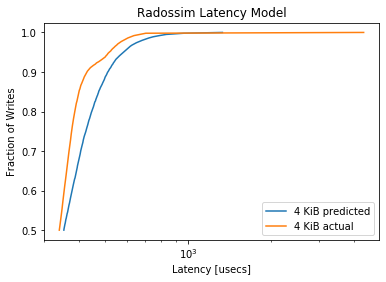

MainProcess pypet INFO     
 Finished single run #1635 of 1680 

MainProcess pypet INFO     
 Starting single run #1636 of 1680 



minimum predicted latency: 207.095112
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2109, pvalue=4.82839065038022e-195)


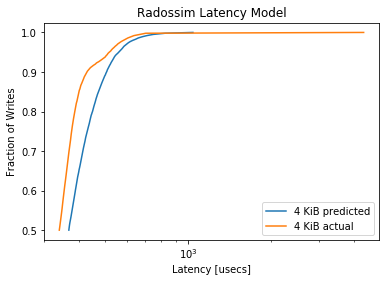

MainProcess pypet INFO     
 Finished single run #1636 of 1680 

MainProcess pypet INFO     
 Starting single run #1637 of 1680 



minimum predicted latency: 195.331779
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2409, pvalue=6.089871302676199e-255)


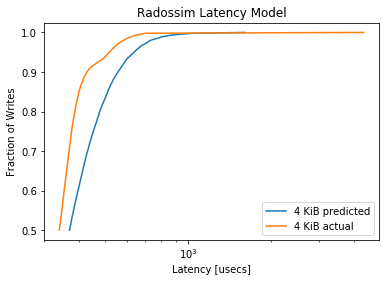

MainProcess pypet INFO     
 Finished single run #1637 of 1680 

MainProcess pypet INFO     
 Starting single run #1638 of 1680 



minimum predicted latency: 210.903118
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3132, pvalue=1e-323)


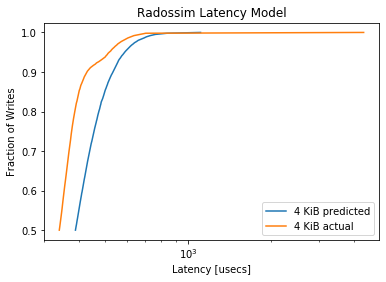

MainProcess pypet INFO     
 Finished single run #1638 of 1680 

MainProcess pypet INFO     
 Starting single run #1639 of 1680 



minimum predicted latency: 196.992469
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.321, pvalue=1e-323)


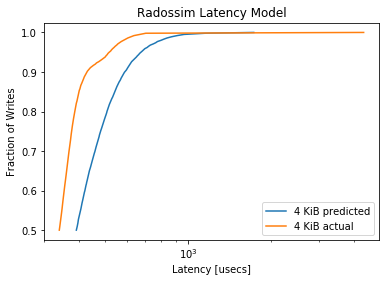

MainProcess pypet INFO     
 Finished single run #1639 of 1680 

MainProcess pypet INFO     
 Starting single run #1640 of 1680 



minimum predicted latency: 188.729070
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4815, pvalue=0.0)


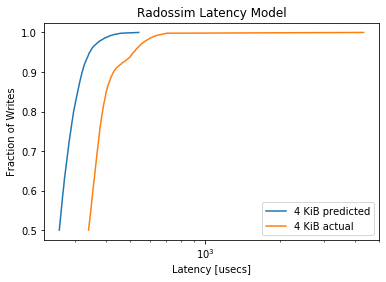

MainProcess pypet INFO     
 Finished single run #1640 of 1680 

MainProcess pypet INFO     
 Starting single run #1641 of 1680 



minimum predicted latency: 185.662233
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4427, pvalue=0.0)


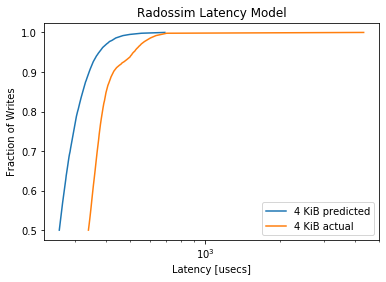

MainProcess pypet INFO     
 Finished single run #1641 of 1680 

MainProcess pypet INFO     
 Starting single run #1642 of 1680 



minimum predicted latency: 188.692622
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4365, pvalue=0.0)


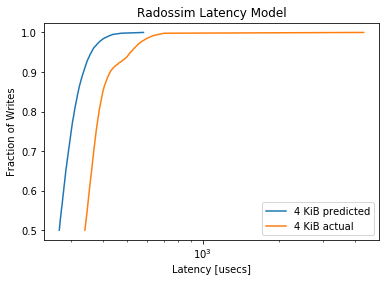

MainProcess pypet INFO     
 Finished single run #1642 of 1680 

MainProcess pypet INFO     
 Starting single run #1643 of 1680 



minimum predicted latency: 186.385076
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3767, pvalue=0.0)


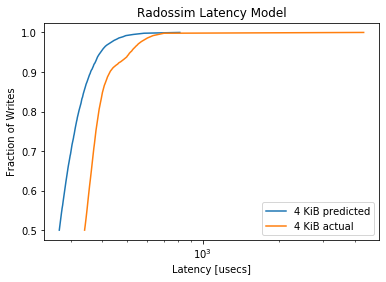

MainProcess pypet INFO     
 Finished single run #1643 of 1680 

MainProcess pypet INFO     
 Starting single run #1644 of 1680 



minimum predicted latency: 190.794301
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3801, pvalue=0.0)


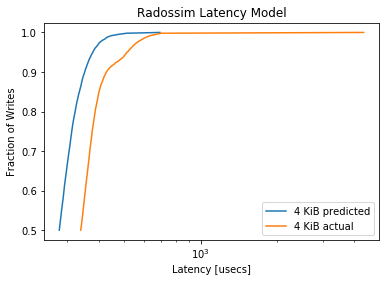

MainProcess pypet INFO     
 Finished single run #1644 of 1680 

MainProcess pypet INFO     
 Starting single run #1645 of 1680 



minimum predicted latency: 183.007608
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3278, pvalue=1e-323)


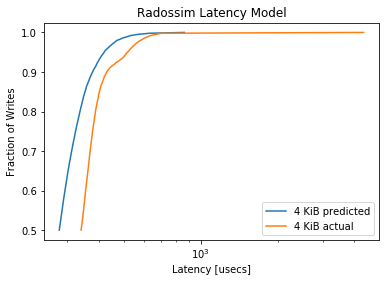

MainProcess pypet INFO     
 Finished single run #1645 of 1680 

MainProcess pypet INFO     
 Starting single run #1646 of 1680 



minimum predicted latency: 194.242455
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3049, pvalue=1e-323)


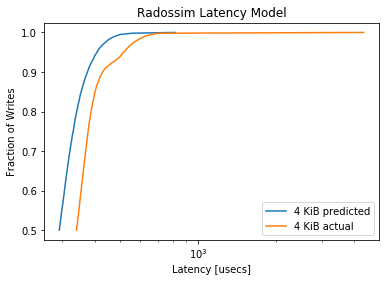

MainProcess pypet INFO     
 Finished single run #1646 of 1680 

MainProcess pypet INFO     
 Starting single run #1647 of 1680 



minimum predicted latency: 189.249981
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2588, pvalue=1.2573293720676752e-294)


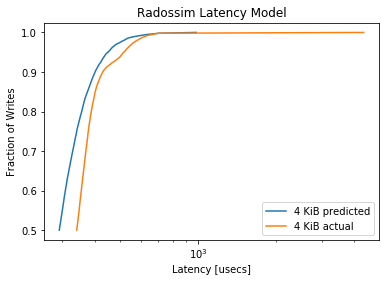

MainProcess pypet INFO     
 Finished single run #1647 of 1680 

MainProcess pypet INFO     
 Starting single run #1648 of 1680 



minimum predicted latency: 195.716740
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2384, pvalue=1.2344499471403768e-249)


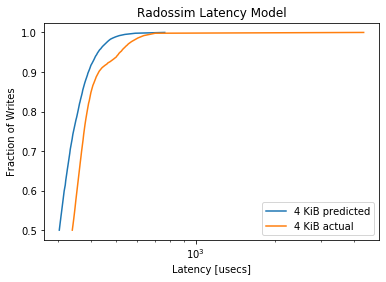

MainProcess pypet INFO     
 Finished single run #1648 of 1680 

MainProcess pypet INFO     
 Starting single run #1649 of 1680 



minimum predicted latency: 191.124294
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1968, pvalue=1.007800558521119e-169)


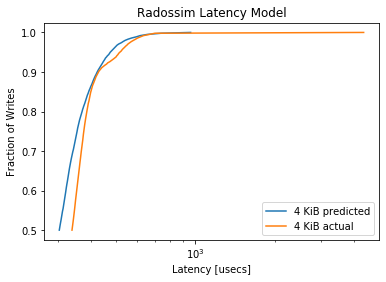

MainProcess pypet INFO     
 Finished single run #1649 of 1680 

MainProcess pypet INFO     
 Starting single run #1650 of 1680 



minimum predicted latency: 205.791952
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1393, pvalue=5.7276085726523e-85)


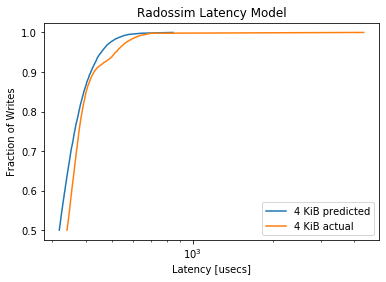

MainProcess pypet INFO     
 Finished single run #1650 of 1680 

MainProcess pypet INFO     
 Starting single run #1651 of 1680 



minimum predicted latency: 192.695704
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1177, pvalue=1.000686067524951e-60)


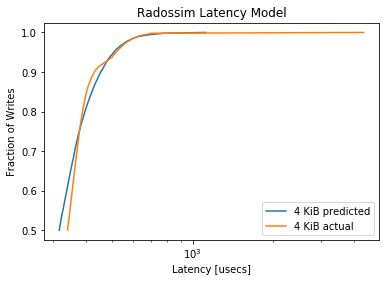

MainProcess pypet INFO     
 Finished single run #1651 of 1680 

MainProcess pypet INFO     
 Starting single run #1652 of 1680 



minimum predicted latency: 207.448496
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0744, pvalue=1.7387809507752027e-24)


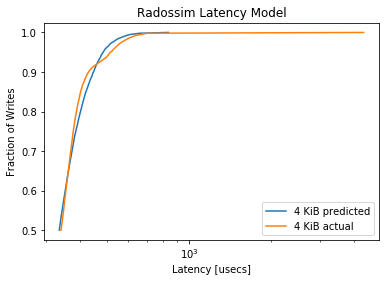

MainProcess pypet INFO     
 Finished single run #1652 of 1680 

MainProcess pypet INFO     
 Starting single run #1653 of 1680 



minimum predicted latency: 201.617641
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0999, pvalue=7.730232465171774e-44)


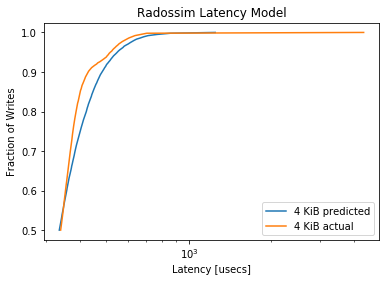

MainProcess pypet INFO     
 Finished single run #1653 of 1680 

MainProcess pypet INFO     
 Starting single run #1654 of 1680 



minimum predicted latency: 207.233875
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1486, pvalue=1.1195510718685207e-96)


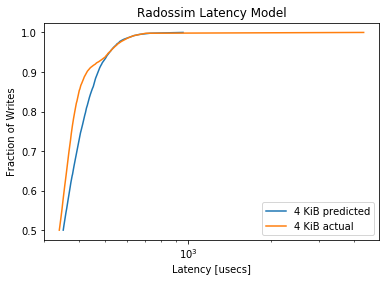

MainProcess pypet INFO     
 Finished single run #1654 of 1680 

MainProcess pypet INFO     
 Starting single run #1655 of 1680 



minimum predicted latency: 197.372145
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1762, pvalue=5.866927737003814e-136)


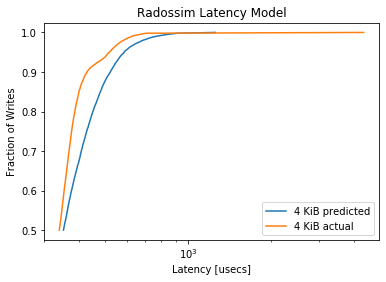

MainProcess pypet INFO     
 Finished single run #1655 of 1680 

MainProcess pypet INFO     
 Starting single run #1656 of 1680 



minimum predicted latency: 210.030555
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2171, pvalue=9.528071201348462e-207)


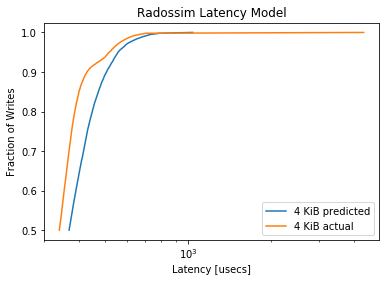

MainProcess pypet INFO     
 Finished single run #1656 of 1680 

MainProcess pypet INFO     
 Starting single run #1657 of 1680 



minimum predicted latency: 207.249372
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2357, pvalue=5.731186385342541e-244)


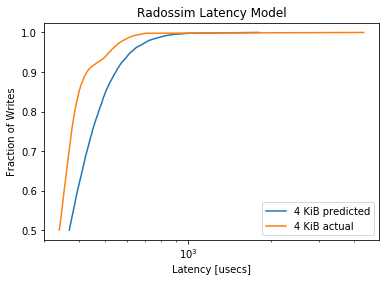

MainProcess pypet INFO     
 Finished single run #1657 of 1680 

MainProcess pypet INFO     
 Starting single run #1658 of 1680 



minimum predicted latency: 218.443661
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3154, pvalue=1e-323)


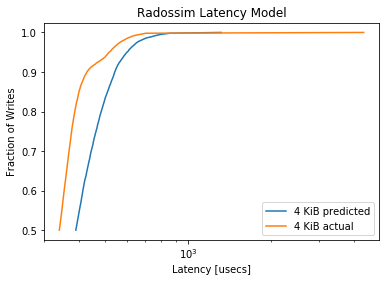

MainProcess pypet INFO     
 Finished single run #1658 of 1680 

MainProcess pypet INFO     
 Starting single run #1659 of 1680 



minimum predicted latency: 209.993100
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3106, pvalue=1e-323)


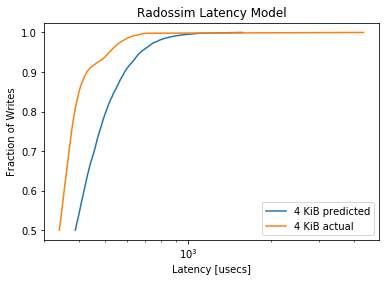

MainProcess pypet INFO     
 Finished single run #1659 of 1680 

MainProcess pypet INFO     
 Starting single run #1660 of 1680 



minimum predicted latency: 188.759891
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4893, pvalue=0.0)


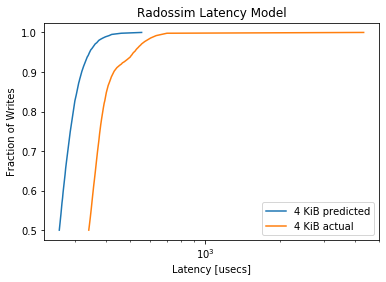

MainProcess pypet INFO     
 Finished single run #1660 of 1680 

MainProcess pypet INFO     
 Starting single run #1661 of 1680 



minimum predicted latency: 182.333731
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4426, pvalue=0.0)


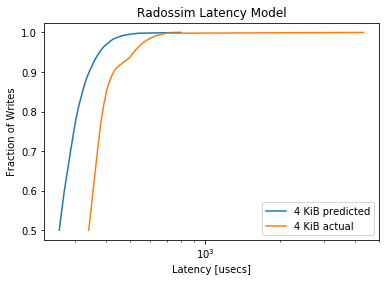

MainProcess pypet INFO     
 Finished single run #1661 of 1680 

MainProcess pypet INFO     
 Starting single run #1662 of 1680 



minimum predicted latency: 189.644292
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.4408, pvalue=0.0)


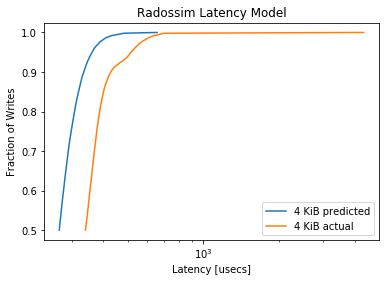

MainProcess pypet INFO     
 Finished single run #1662 of 1680 

MainProcess pypet INFO     
 Starting single run #1663 of 1680 



minimum predicted latency: 184.998553
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3846, pvalue=0.0)


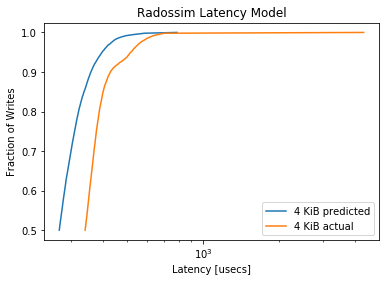

MainProcess pypet INFO     
 Finished single run #1663 of 1680 

MainProcess pypet INFO     
 Starting single run #1664 of 1680 



minimum predicted latency: 190.662974
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3822, pvalue=0.0)


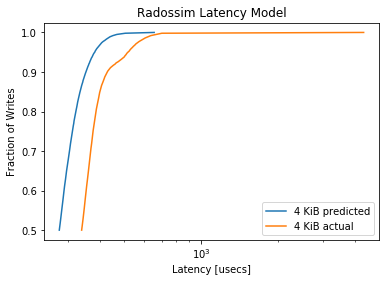

MainProcess pypet INFO     
 Finished single run #1664 of 1680 

MainProcess pypet INFO     
 Starting single run #1665 of 1680 



minimum predicted latency: 183.423221
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3267, pvalue=1e-323)


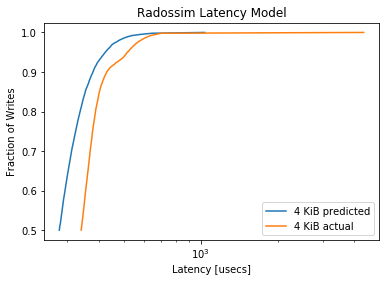

MainProcess pypet INFO     
 Finished single run #1665 of 1680 

MainProcess pypet INFO     
 Starting single run #1666 of 1680 



minimum predicted latency: 195.881341
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3082, pvalue=1e-323)


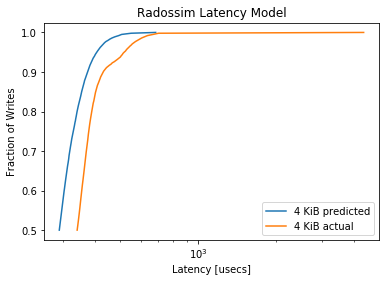

MainProcess pypet INFO     
 Finished single run #1666 of 1680 

MainProcess pypet INFO     
 Starting single run #1667 of 1680 



minimum predicted latency: 187.100685
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2733, pvalue=1e-323)


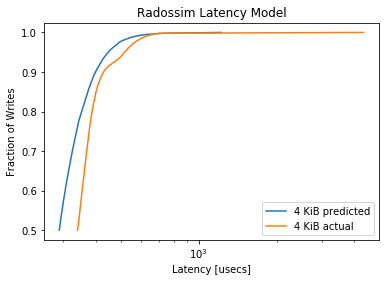

MainProcess pypet INFO     
 Finished single run #1667 of 1680 

MainProcess pypet INFO     
 Starting single run #1668 of 1680 



minimum predicted latency: 192.639538
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2367, pvalue=4.64795726396826e-246)


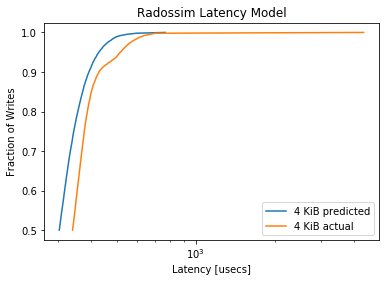

MainProcess pypet INFO     
 Finished single run #1668 of 1680 

MainProcess pypet INFO     
 Starting single run #1669 of 1680 



minimum predicted latency: 191.972293
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1928, pvalue=7.222549281627775e-163)


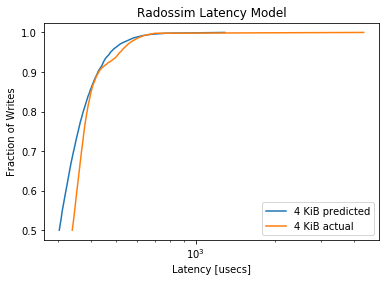

MainProcess pypet INFO     
 Finished single run #1669 of 1680 

MainProcess pypet INFO     
 Starting single run #1670 of 1680 



minimum predicted latency: 206.280577
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1393, pvalue=5.7276085726523e-85)


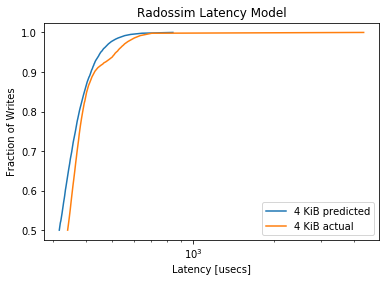

MainProcess pypet INFO     
 Finished single run #1670 of 1680 

MainProcess pypet INFO     
 Starting single run #1671 of 1680 



minimum predicted latency: 192.492180
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1179, pvalue=6.233243953439834e-61)


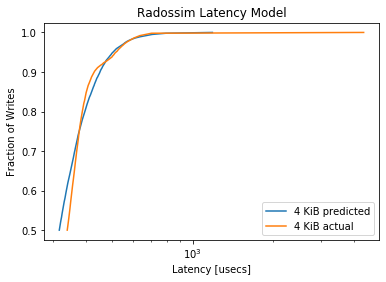

MainProcess pypet INFO     
 Finished single run #1671 of 1680 

MainProcess pypet INFO     
 Starting single run #1672 of 1680 



minimum predicted latency: 203.013137
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0629, pvalue=1.2825442697208656e-17)


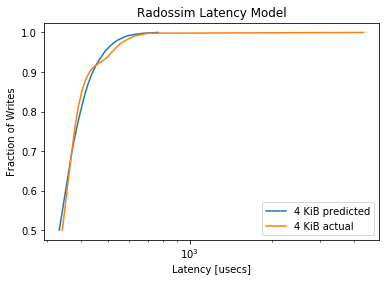

MainProcess pypet INFO     
 Finished single run #1672 of 1680 

MainProcess pypet INFO     
 Starting single run #1673 of 1680 



minimum predicted latency: 196.559531
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.0898, pvalue=1.7135055745556546e-35)


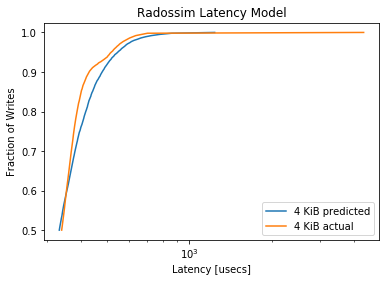

MainProcess pypet INFO     
 Finished single run #1673 of 1680 

MainProcess pypet INFO     
 Starting single run #1674 of 1680 



minimum predicted latency: 204.690869
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.137, pvalue=3.4315766593075114e-82)


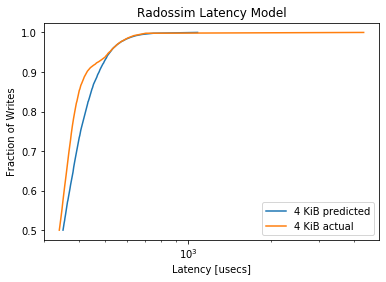

MainProcess pypet INFO     
 Finished single run #1674 of 1680 

MainProcess pypet INFO     
 Starting single run #1675 of 1680 



minimum predicted latency: 189.461472
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1624, pvalue=1.8121222112207562e-115)


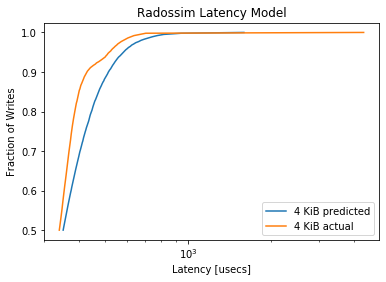

MainProcess pypet INFO     
 Finished single run #1675 of 1680 

MainProcess pypet INFO     
 Starting single run #1676 of 1680 



minimum predicted latency: 208.682614
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2117, pvalue=1.5601276888955846e-196)


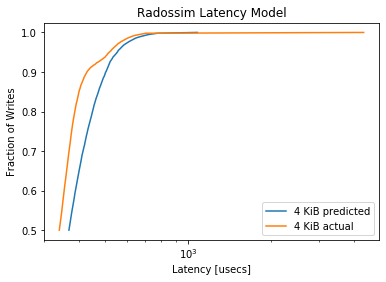

MainProcess pypet INFO     
 Finished single run #1676 of 1680 

MainProcess pypet INFO     
 Starting single run #1677 of 1680 



minimum predicted latency: 191.994009
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.2315, pvalue=2.7542298911981596e-235)


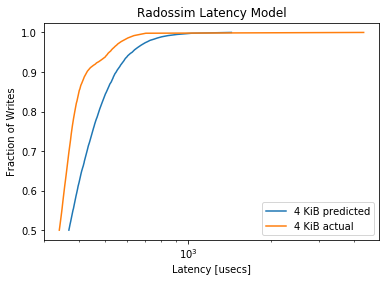

MainProcess pypet INFO     
 Finished single run #1677 of 1680 

MainProcess pypet INFO     
 Starting single run #1678 of 1680 



minimum predicted latency: 215.577707
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3168, pvalue=1e-323)


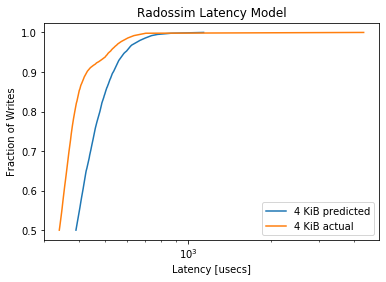

MainProcess pypet INFO     
 Finished single run #1678 of 1680 

MainProcess pypet INFO     
 Starting single run #1679 of 1680 



minimum predicted latency: 197.910833
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.3131, pvalue=1e-323)


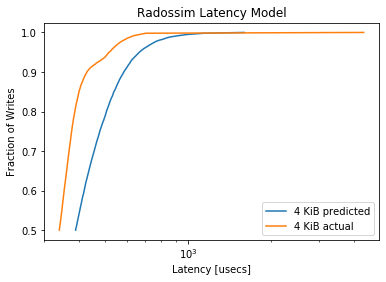

MainProcess pypet INFO     
 Finished single run #1679 of 1680 

MainProcess pypet INFO     PROGRESS: Finished 1680/1680 runs [====================]100.0%
MainProcess pypet.storageservice.HDF5StorageService INFO     Initialising storage or updating meta data of Trajectory `ks-test`.
MainProcess pypet.storageservice.HDF5StorageService INFO     Finished init or meta data update for `ks-test`.
MainProcess pypet.environment.Environment INFO     
************************************************************
FINISHED all runs of trajectory
`ks-test`.
************************************************************

MainProcess pypet.environment.Environment INFO     
************************************************************
STARTING FINAL STORING of trajectory
`ks-test`
************************************************************

MainProcess pypet.storageservice.HDF5StorageService INFO     Start storing Trajectory `ks-test`.
MainProcess pypet.storageservice.HDF5StorageService INFO     Storing 

In [36]:
import matplotlib
import matplotlib.pyplot as plt
from scipy.stats import ks_2samp
import math
from pypet import Environment, cartesian_product
from numpy import arange

# Add path for modules in scripts/ so this notebook works
# without the context created by main.workflow
import sys
sys.path.append('../..')

import scripts.radossim as sim

def validateMod(reqSize, lgMult, lgAdd, smMult, smAdd, mu, sigma, start=500):
    
    # Create 10,000 latModel latency predictions for size = 4KiB 
    pred_samples = []
    for j in range(10000):
        pred_samples.append(sim.latModel(reqSize, lgMult, lgAdd, smMult, smAdd, mu, sigma))
    pred_samples.sort()
    pred_min = pred_samples[0]
    print('minimum predicted latency: %f' % pred_min)

    # Create percentile curve for latency predictions
    pred_x = []
    y = []
    for i in range(start, 1000, 3):
        pred_x.append(pred_samples[int(i/1000. * len(msmts))])
        y.append(i/1000.)
    pred_x.append(pred_samples[-1])
    y.append(1.0)

    # Create percentile curve for actual latency measurements
    fd = open('BlueStore/batch01/dump_kv_sync_lat_vec-%d.csv' % reqSize)

    # Skip the title and the first 1000 measurements
    for i in range(1001):
        fd.readline()
    
    # Collect 10000 measurements
    act_samples = []
    for i in range(10000):
        lat = fd.readline()
        try:
            lat = float(lat.strip())
        except ValueError:
            continue
        # assume these are seconds -- convert to microseconds
        act_samples.append(lat * 10**6)
    act_samples.sort()
    act_min = act_samples[0]
    print('minimum actual latency: %f' % act_min)

    act_x = []
    for i in range(start, 1000, 3):
        act_x.append(act_samples[int(i/1000. * len(msmts))])
    act_x.append(act_samples[-1])
    
    # KS test
    ks_test = ks_2samp(pred_samples, act_samples)
    print('KS Test:', ks_test)
    '''print('critical values (alpha, value):', 
          (0.05, 1.358 * math.sqrt((2 * 10000)/(10000**2))),
          (0.01, 1.628 * math.sqrt((2 * 10000)/(10000**2))))
    '''

    # Plot both curves
    fig, ax = plt.subplots()
    ax.set_xscale('log')
    ax.plot(pred_x, y, label='%d KiB predicted' % (reqSize / 1024))
    ax.plot(act_x, y, label='%d KiB actual' % (reqSize / 1024))

    ax.set(xlabel='Latency [usecs]', ylabel='Fraction of Writes', title='Radossim Latency Model')
    plt.legend()
    plt.show()
    
    return ks_test[0]

def exploreVal(traj):
    z = validateMod(4096, lgMult, lgAdd, traj.smMult, traj.smAdd, traj.mu, traj.sigma)
    if z < 0.08:
        traj.f_add_result('z',z, comment="fitting result")
    
env = Environment(trajectory='ks-test',filename='./HDF/ks-test.hdf5',
                  file_title='ks-test',
                  comment='ks-test',
                  large_overview_tables=True,overwrite_file=True)

traj = env.trajectory
traj.f_add_parameter('smMult', smMult, comment="smMult")
traj.f_add_parameter('smAdd', smAdd, comment="smAdd")                     
traj.f_add_parameter('mu', mu, comment="mu")
traj.f_add_parameter('sigma', sigma, comment="sigma")                   

traj.f_explore(cartesian_product({'smMult':[62.36], 'smAdd':arange(4998.0,5831.0,10.0).tolist(), 'mu':arange(4.5,5.5,0.1).tolist(), 'sigma':arange(0.4,0.6, 0.1).tolist()}))
env.run(exploreVal)
env.disable_logging()
#(pred_min, act_min, ks_test) = validateMod(4096, lgMult, lgAdd, smMult, smAdd, mu, sigma)

minimum predicted latency: 192.610360
minimum actual latency: 200.787000
KS Test: Ks_2sampResult(statistic=0.1089, pvalue=4.9824233164813615e-52)


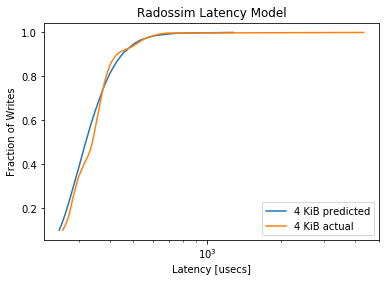

0.1089

In [34]:
validateMod(4096, lgMult, lgAdd, smMult, smAdd * 692, 5, .5, start=100)